# RTML | A4 Self-Supervised Learning - Masking

----------------
### Ulugbek Shernazarov - st125457

### Masked Auto-Encoder
Inspired by the advancement of transformers BERT, facebookresearch team applied nlp techniques to cv and developed Masked Auto-Encoder technique for representation learning using masking technique. The core idea is to randomly mask some patches and learn these from the remaining un-masked patches. There are several tricks used like deleting masked tokens to make the encoder lightweight and pre-train it in certain way.

I will utilize the code written by [FaceBook team](https://github.com/facebookresearch/mae) for this assignment session.

The core-concept of SimMIM and MAE is the same. The only change is that masked patches are replaced with a trainable mask token at the input itself for SimMIM. For MAE, this is efficiently added directly to the decoder. This according to the paper improves the training time by 3x.

The idea is simple!



<img src="img/MAE.png" title="MAE - Original" style="width: 1080px;" />



### Lets set up

In [1]:
import random
import torch
import timm
import numpy as np

from einops import repeat, rearrange
from einops.layers.torch import Rearrange

from timm.models.layers import trunc_normal_
from timm.models.vision_transformer import Block

import os
import argparse
import math
import torchvision
from torch.utils.tensorboard import SummaryWriter
from torchvision.transforms import ToTensor, Compose, Normalize
from tqdm import tqdm


/home/jupyter-st125457/.local/lib/python3.12/site-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)


In [2]:
def setup_seed(seed=42):
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    np.random.seed(seed)
    random.seed(seed)
    torch.backends.cudnn.deterministic = True

def denormalize(tensor):
    return tensor * 0.5 + 0.5  # Assuming normalization was (x - 0.5) / 0.5

## Patchify

### Input Preparation
1) Patching:
Imagine cutting an image into small squares, like tiles. Each tile (patch) is a small part of the image.
For example, if the image is 224x224 pixels, and each patch is 16x16 pixels, you get 196 patches (Like Vision Transformer in the previous lesson!)
Each patch carries a portion of the image’s information, like a zoomed-in section. 

### Masking
Now, randomly hide most of the patches – about 75%.
Only 25% of the patches are kept and passed to the next stage.
The hidden patches are completely ignored during this step.
This forces the model to learn how to "fill in the blanks" based on the small portion it can still see.



In [3]:
def random_indexes(size : int):
    forward_indexes = np.arange(size)
    np.random.shuffle(forward_indexes)
    backward_indexes = np.argsort(forward_indexes)
    return forward_indexes, backward_indexes

def take_indexes(sequences, indexes):
    return torch.gather(sequences, 0, repeat(indexes, 't b -> t b c', c=sequences.shape[-1]))

class PatchShuffle(torch.nn.Module):
    def __init__(self, ratio) -> None:
        super().__init__()
        self.ratio = ratio

    def forward(self, patches : torch.Tensor):
        T, B, C = patches.shape
        remain_T = int(T * (1 - self.ratio))

        indexes = [random_indexes(T) for _ in range(B)]
        forward_indexes = torch.as_tensor(np.stack([i[0] for i in indexes], axis=-1), dtype=torch.long).to(patches.device)
        backward_indexes = torch.as_tensor(np.stack([i[1] for i in indexes], axis=-1), dtype=torch.long).to(patches.device)

        patches = take_indexes(patches, forward_indexes)
        patches = patches[:remain_T]

        return patches, forward_indexes, backward_indexes

## Encoder

The encoder only works with the visible patches. The hidden ones are not even seen by the encoder.
It treats the patches like "words" in a sentence. By looking at the pieces of the image, the encoder tries to understand what the overall image might represent.

To help the encoder keep track of the patch locations, a positional tag is added to each visible patch, like labeling each tile with its original position.

### Latent Space
After the encoder finishes processing, it produces a compressed version of the input.
This compressed version captures the key details from the visible patches, even though much of the image is missing.
Think of it like getting the gist of a puzzle just by looking at a few pieces.

In [4]:
class MAE_Encoder(torch.nn.Module):
    def __init__(self,
                 image_size=32,
                 patch_size=2,
                 emb_dim=192,
                 num_layer=12,
                 num_head=3,
                 mask_ratio=0.5,
                 ) -> None:
        super().__init__()

        self.cls_token = torch.nn.Parameter(torch.zeros(1, 1, emb_dim))
        
        self.pos_embedding = torch.nn.Parameter(torch.zeros((image_size // patch_size) ** 2, 1, emb_dim))

        self.shuffle = PatchShuffle(mask_ratio)

        self.patchify = torch.nn.Conv2d(1, emb_dim, patch_size, patch_size)

        self.transformer = torch.nn.Sequential(*[Block(emb_dim, num_head) for _ in range(num_layer)])

        self.layer_norm = torch.nn.LayerNorm(emb_dim)

        self.init_weight()

    def init_weight(self):
        trunc_normal_(self.cls_token, std=.02)
        trunc_normal_(self.pos_embedding, std=.02)

    def forward(self, img):
        # print(img.size())
        patches = self.patchify(img)
        # print(patches.size())
        patches = rearrange(patches, 'b c h w -> (h w) b c')
        # print(patches.size(), self.pos_embedding.size())
        patches = patches + self.pos_embedding

        patches, forward_indexes, backward_indexes = self.shuffle(patches)

        patches = torch.cat([self.cls_token.expand(-1, patches.shape[1], -1), patches], dim=0)
        patches = rearrange(patches, 't b c -> b t c')
        features = self.layer_norm(self.transformer(patches))
        features = rearrange(features, 'b t c -> t b c')

        return features, backward_indexes


## Decoder

The decoder takes the summary created by the encoder and attempts to reconstruct the entire image, filling in the missing patches.

To do this, the model uses a learned "placeholder" for the masked patches, and the decoder gradually tries to replace them with real content.

The model learns by comparing the reconstructed image to the original, and its goal is to minimize the difference between the two.

In [5]:
class MAE_Decoder(torch.nn.Module):
    def __init__(self,
                 image_size=32,
                 patch_size=2,
                 emb_dim=192,
                 num_layer=4,
                 num_head=3,
                 ) -> None:
        super().__init__()

        self.mask_token = torch.nn.Parameter(torch.zeros(1, 1, emb_dim))
        self.pos_embedding = torch.nn.Parameter(torch.zeros((image_size // patch_size) ** 2 + 1, 1, emb_dim)) 

        self.transformer = torch.nn.Sequential(*[Block(emb_dim, num_head) for _ in range(num_layer)])

        self.head = torch.nn.Linear(emb_dim, 1 * patch_size ** 2) #3
        self.patch2img = Rearrange('(h w) b (c p1 p2) -> b c (h p1) (w p2)', p1=patch_size, p2=patch_size, h=image_size//patch_size)

        self.init_weight()

    def init_weight(self):
        trunc_normal_(self.mask_token, std=.02)
        trunc_normal_(self.pos_embedding, std=.02)

    def forward(self, features, backward_indexes):
        T = features.shape[0]
        backward_indexes = torch.cat([torch.zeros(1, backward_indexes.shape[1]).to(backward_indexes), backward_indexes + 1], dim=0)
        features = torch.cat([features, self.mask_token.expand(backward_indexes.shape[0] - features.shape[0], features.shape[1], -1)], dim=0)
        features = take_indexes(features, backward_indexes)
        features = features + self.pos_embedding

        features = rearrange(features, 't b c -> b t c')
        features = self.transformer(features)
        features = rearrange(features, 'b t c -> t b c')
        features = features[1:] # remove global feature

        patches = self.head(features)
        mask = torch.zeros_like(patches)
        mask[T-1:] = 1
        mask = take_indexes(mask, backward_indexes[1:] - 1)
        img = self.patch2img(patches)
        mask = self.patch2img(mask)

        return img, mask

## Masked Auto-Encoder

In [6]:
class MAE_ViT(torch.nn.Module):
    def __init__(self,
                 image_size=32,
                 patch_size=2+2,
                 emb_dim=192,
                 encoder_layer=12,
                 encoder_head=3,
                 decoder_layer=4,
                 decoder_head=3,
                 mask_ratio=0.75,
                 ) -> None:
        super().__init__()
        
        self.encoder = MAE_Encoder(image_size, patch_size, emb_dim, encoder_layer, encoder_head, mask_ratio)
        self.decoder = MAE_Decoder(image_size, patch_size, emb_dim, decoder_layer, decoder_head)

    def forward(self, img):
        features, backward_indexes = self.encoder(img)
        predicted_img, mask = self.decoder(features,  backward_indexes)
        return predicted_img, mask


## Set up parameters

In [7]:
import time

seed = 42
batch_size = 1024
max_device_batch_size = 2048
base_learning_rate = 1.5e-4
weight_decay = 0.05
mask_ratio = 0.8
total_epoch = 1000
warmup_epoch = 200
model_path = f'saved/vit-t-mae-mnist-lab_{time.asctime()}.pt'

setup_seed(seed)

## Prepare data and model

In [12]:
from torch.utils.data import random_split
batch_size = batch_size
load_batch_size = min(max_device_batch_size, batch_size)

assert batch_size % load_batch_size == 0
steps_per_update = batch_size // load_batch_size

# train_dataset = torchvision.datasets.CIFAR10('data', train=True, download=False, transform=Compose([ToTensor(), Normalize(0.5, 0.5)]))
# val_dataset = torchvision.datasets.CIFAR10('data', train=False, download=False, transform=Compose([ToTensor(), Normalize(0.5, 0.5)]))
dataset = torchvision.datasets.MNIST('data', train=True, download=True, transform=Compose([ToTensor(), Normalize(0.5, 0.5)]))
# val_dataset = torchvision.datasets.MNIST('data', train=false, download=True, transform=Compose([ToTensor(), Normalize(0.5, 0.5)]))

# Split into train, validation, and test sets
train_size = int(0.8 * len(dataset))
val_size = int(0.2 * len(dataset))

train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

dataloader = torch.utils.data.DataLoader(train_dataset, load_batch_size, shuffle=True, num_workers=4)
writer = SummaryWriter(os.path.join('logs', 'cifar10', 'mae-pretrain'))
device = 'cuda:2' if torch.cuda.is_available() else 'cpu'

model = MAE_ViT(image_size = 28, patch_size = 4, mask_ratio=mask_ratio).to(device)
optim = torch.optim.AdamW(model.parameters(), lr=base_learning_rate * batch_size / 256, betas=(0.9, 0.95), weight_decay=weight_decay)
lr_func = lambda epoch: min((epoch + 1) / (warmup_epoch + 1e-8), 0.5 * (math.cos(epoch / total_epoch * math.pi) + 1))
lr_scheduler = torch.optim.lr_scheduler.LambdaLR(optim, lr_lambda=lr_func, verbose=True)

/home/jupyter-st125457/.local/lib/python3.12/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


## Let's train!

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 0, average traning loss is 0.553684486353651.
=================== EPOCH:  1  ===================


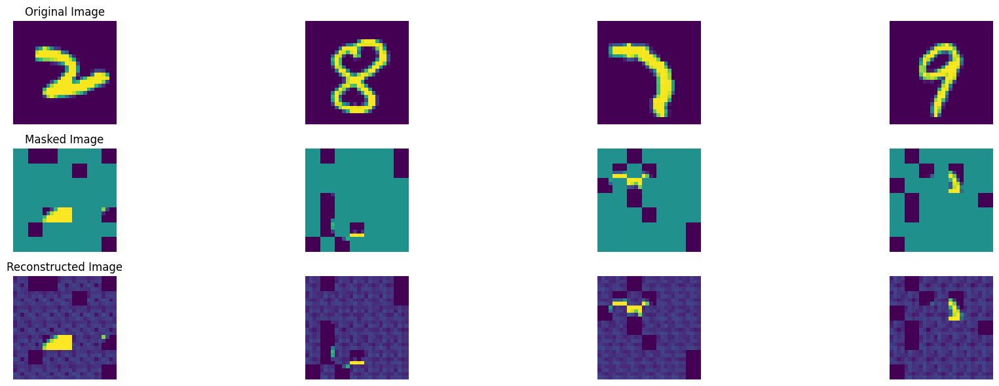

100%|██████████| 47/47 [00:08<00:00,  5.64it/s]


In epoch 1, average traning loss is 0.38943542698596384.
=================== EPOCH:  2  ===================


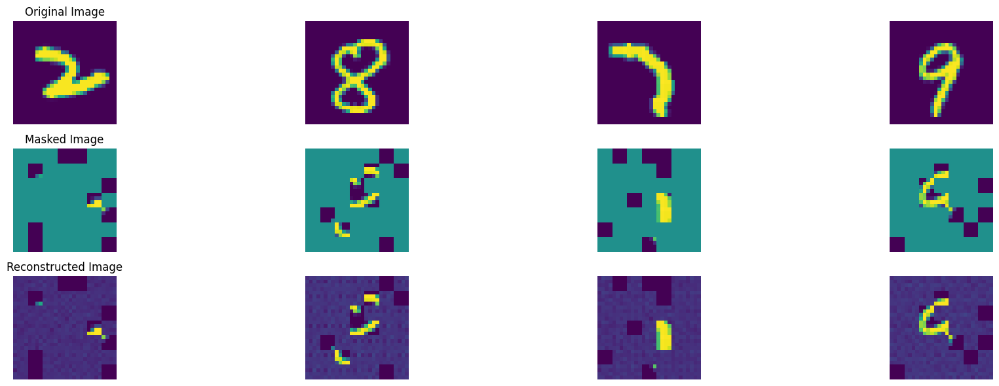

100%|██████████| 47/47 [00:08<00:00,  5.63it/s]


In epoch 2, average traning loss is 0.3780865789727962.
=================== EPOCH:  3  ===================


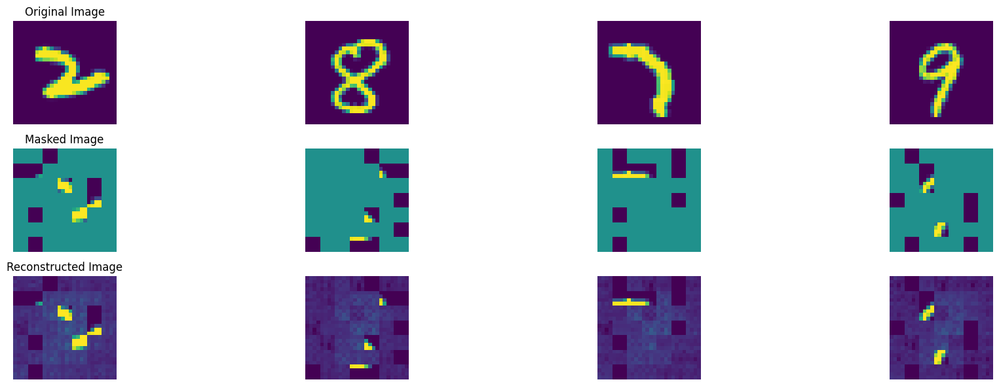

100%|██████████| 47/47 [00:08<00:00,  5.61it/s]


In epoch 3, average traning loss is 0.3088381791368444.
=================== EPOCH:  4  ===================


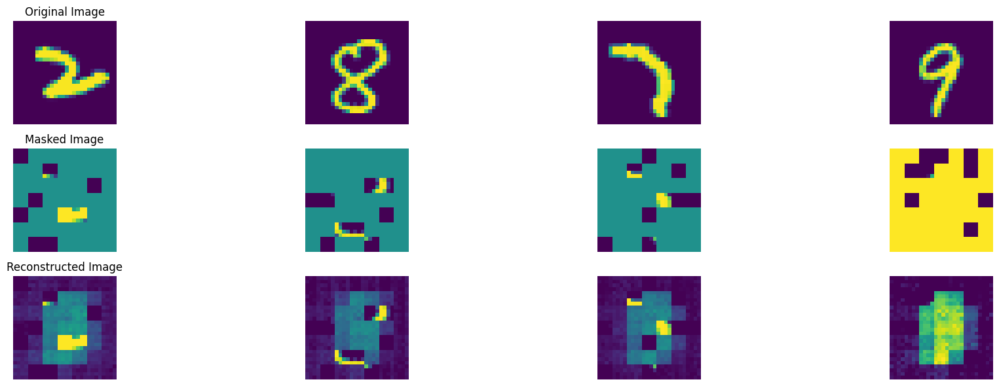

100%|██████████| 47/47 [00:08<00:00,  5.55it/s]


In epoch 4, average traning loss is 0.2797406943554574.
=================== EPOCH:  5  ===================


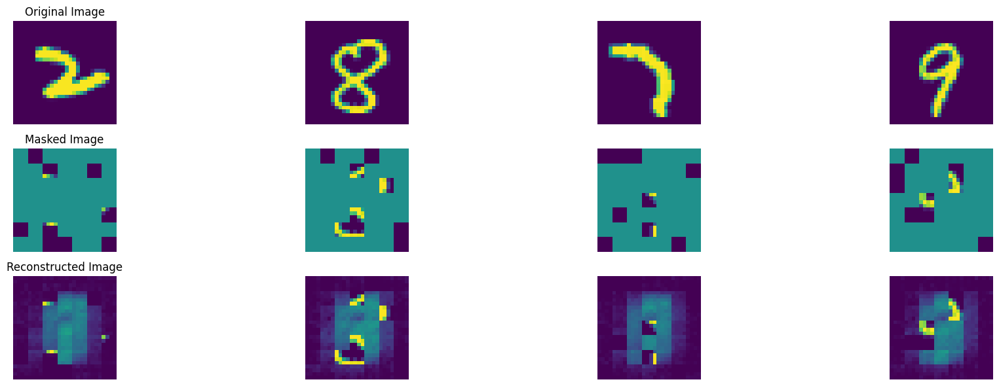

100%|██████████| 47/47 [00:08<00:00,  5.56it/s]


In epoch 5, average traning loss is 0.2735003854366059.
=================== EPOCH:  6  ===================


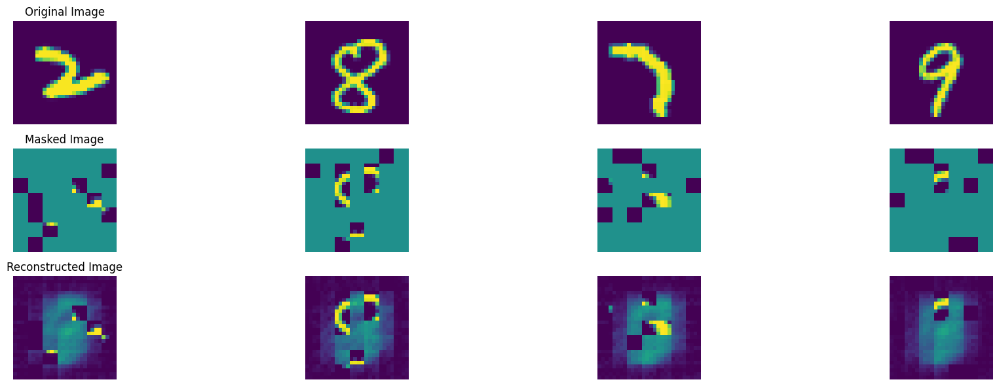

100%|██████████| 47/47 [00:08<00:00,  5.57it/s]


In epoch 6, average traning loss is 0.2695965475224434.
=================== EPOCH:  7  ===================


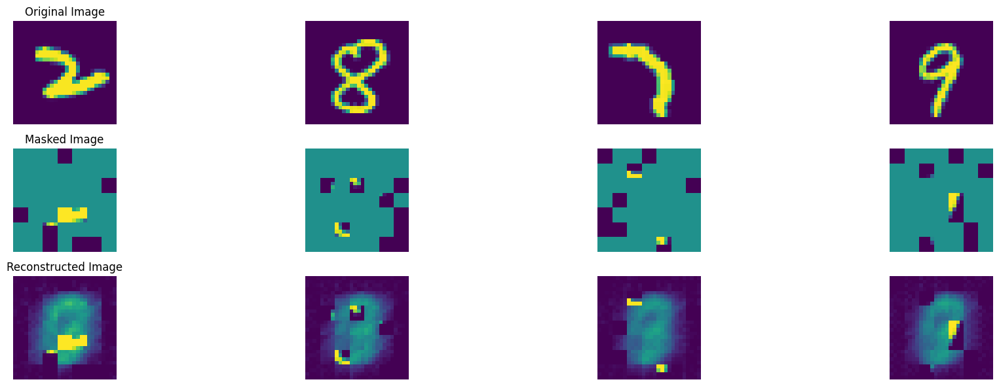

100%|██████████| 47/47 [00:08<00:00,  5.52it/s]


In epoch 7, average traning loss is 0.2671134459211471.
=================== EPOCH:  8  ===================


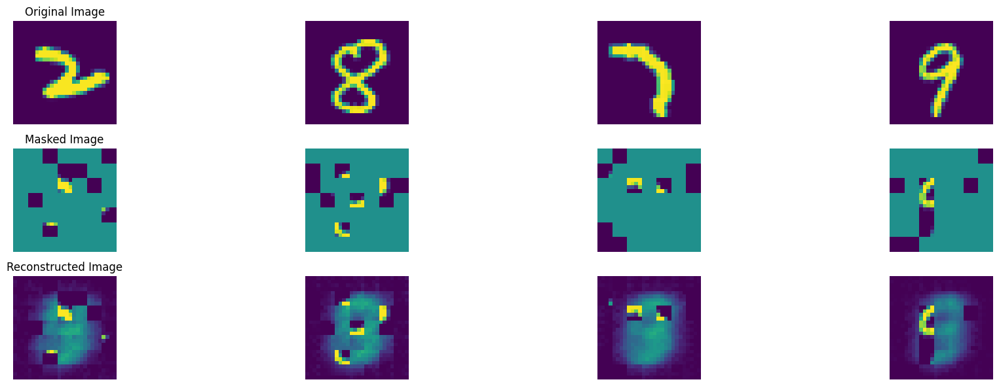

100%|██████████| 47/47 [00:08<00:00,  5.53it/s]


In epoch 8, average traning loss is 0.26604200106986026.
=================== EPOCH:  9  ===================


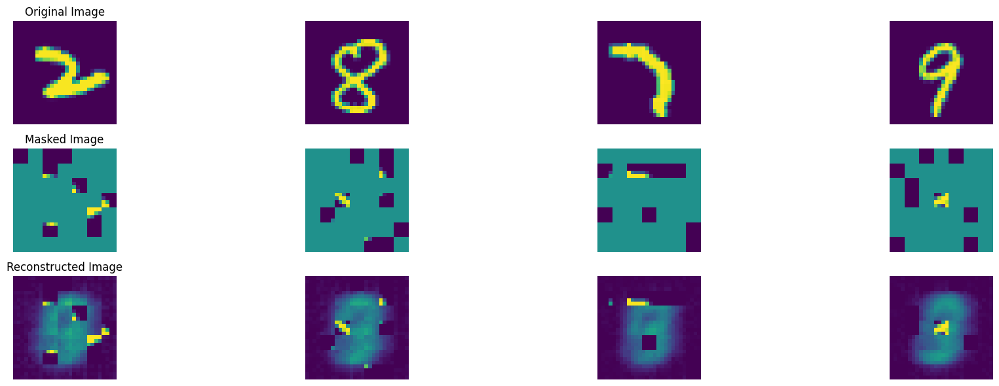

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 9, average traning loss is 0.2649487314072061.
=================== EPOCH:  10  ===================


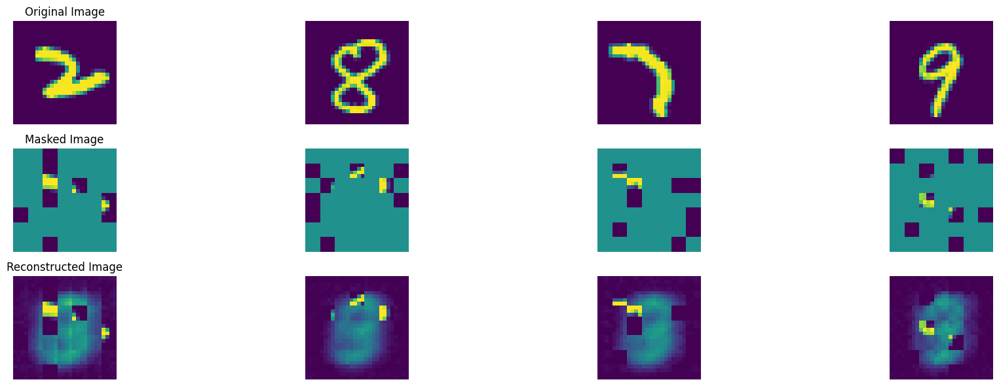

100%|██████████| 47/47 [00:08<00:00,  5.25it/s]


In epoch 10, average traning loss is 0.26418163548124596.
=================== EPOCH:  11  ===================


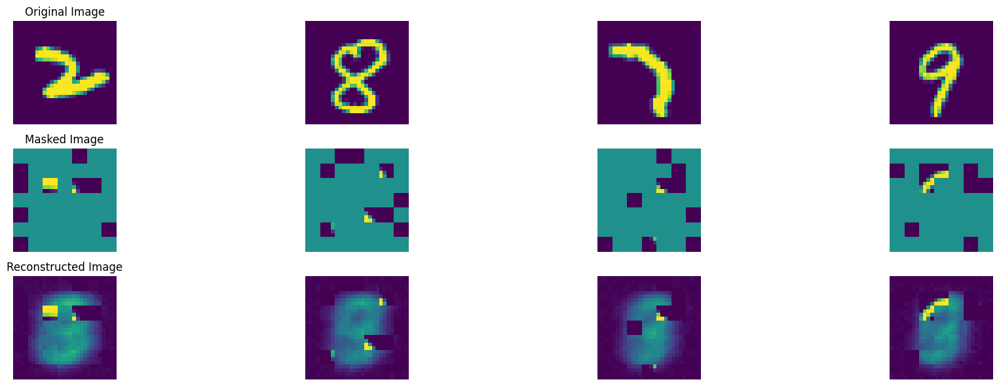

100%|██████████| 47/47 [00:09<00:00,  5.20it/s]


In epoch 11, average traning loss is 0.26271079385534246.
=================== EPOCH:  12  ===================


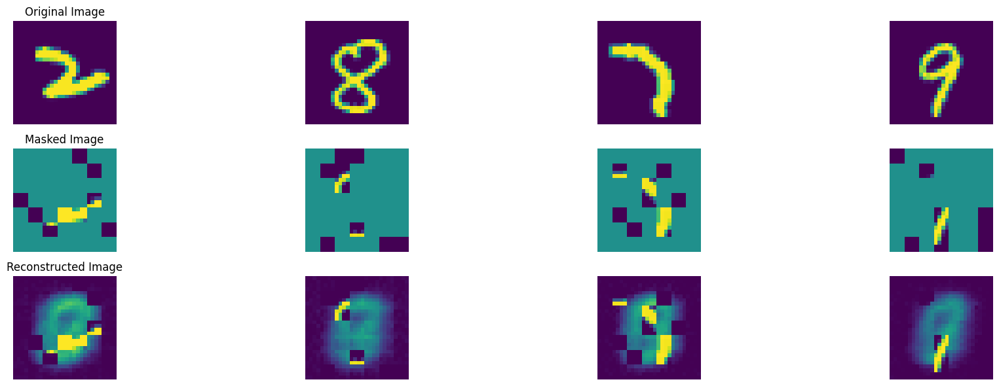

100%|██████████| 47/47 [00:09<00:00,  5.09it/s]


In epoch 12, average traning loss is 0.2617332187104732.
=================== EPOCH:  13  ===================


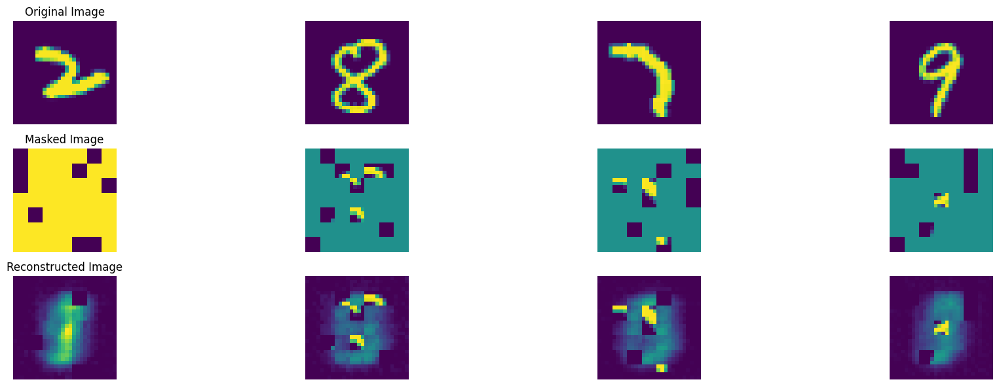

100%|██████████| 47/47 [00:09<00:00,  5.14it/s]


In epoch 13, average traning loss is 0.25995310443512937.
=================== EPOCH:  14  ===================


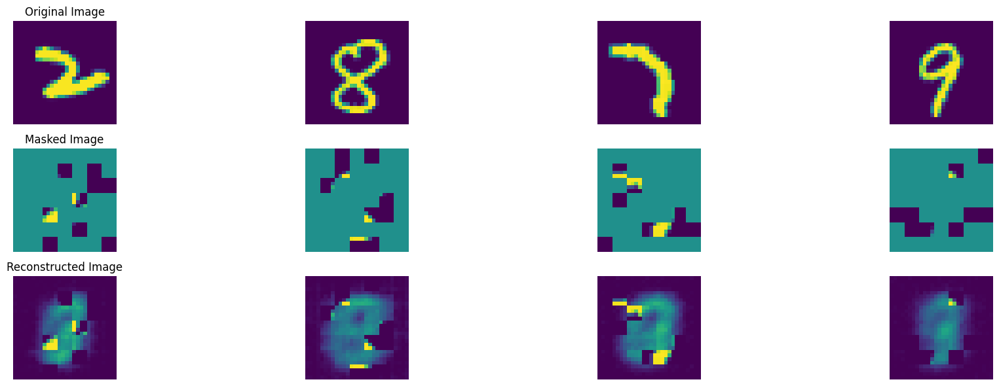

100%|██████████| 47/47 [00:08<00:00,  5.30it/s]


In epoch 14, average traning loss is 0.2593181678589354.
=================== EPOCH:  15  ===================


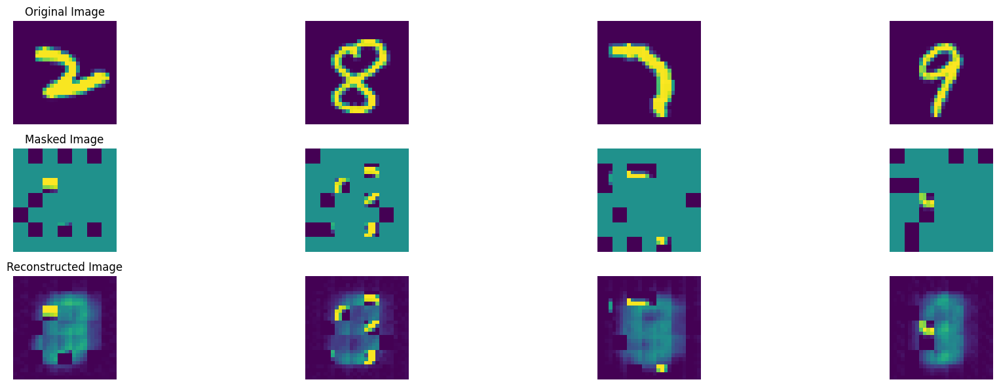

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 15, average traning loss is 0.2581948733076136.
=================== EPOCH:  16  ===================


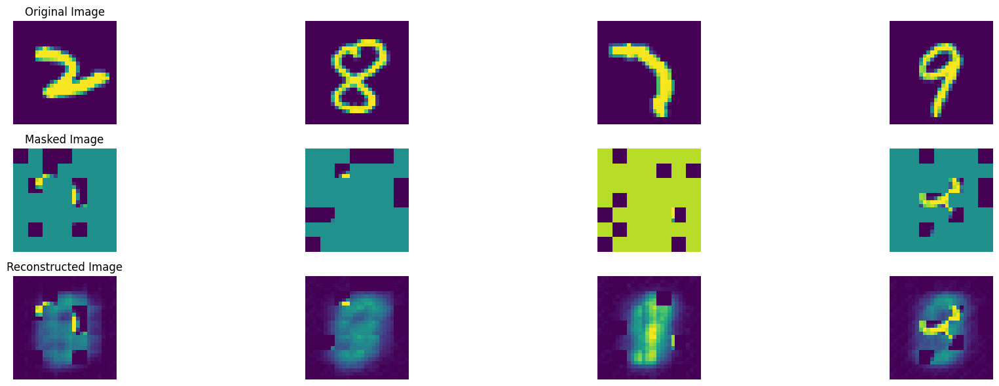

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 16, average traning loss is 0.25760290533938307.
=================== EPOCH:  17  ===================


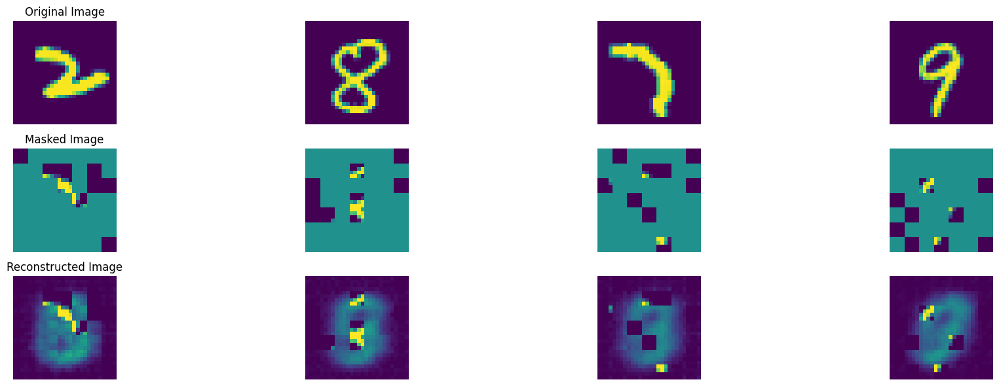

100%|██████████| 47/47 [00:08<00:00,  5.29it/s]


In epoch 17, average traning loss is 0.25588284908457004.
=================== EPOCH:  18  ===================


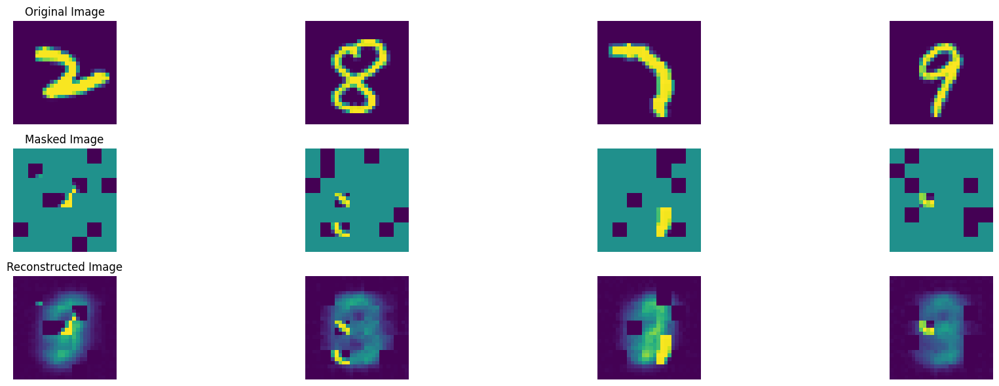

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 18, average traning loss is 0.2536908825661274.
=================== EPOCH:  19  ===================


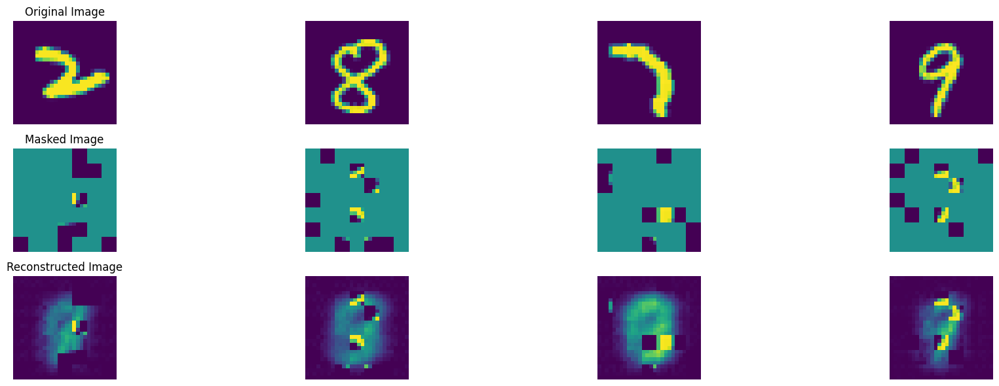

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 19, average traning loss is 0.25363590552451765.
=================== EPOCH:  20  ===================


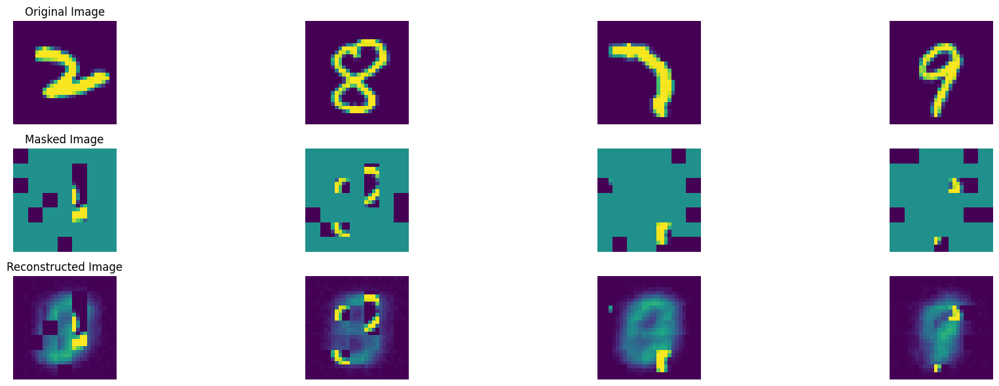

100%|██████████| 47/47 [00:08<00:00,  5.26it/s]


In epoch 20, average traning loss is 0.2522066035803328.
=================== EPOCH:  21  ===================


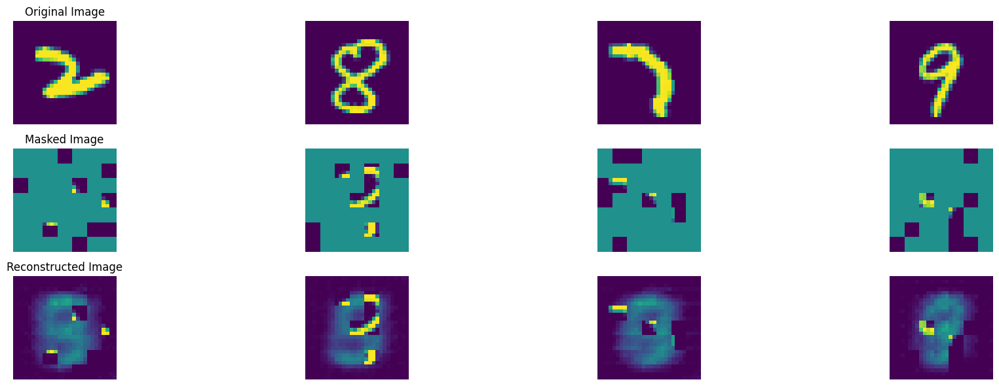

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 21, average traning loss is 0.2501399361706795.
=================== EPOCH:  22  ===================


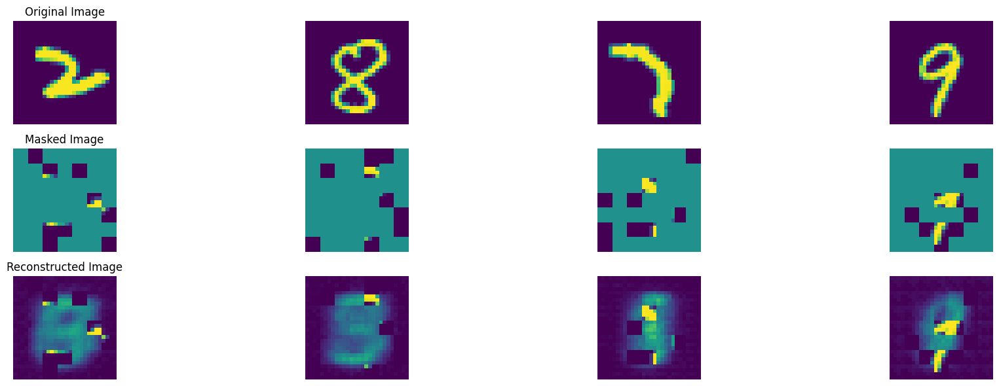

100%|██████████| 47/47 [00:08<00:00,  5.24it/s]


In epoch 22, average traning loss is 0.24792085524569166.
=================== EPOCH:  23  ===================


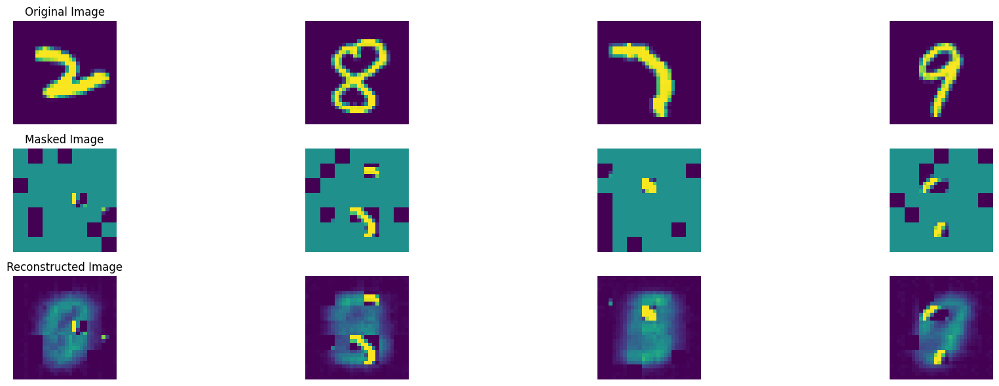

100%|██████████| 47/47 [00:08<00:00,  5.26it/s]


In epoch 23, average traning loss is 0.24751337062805256.
=================== EPOCH:  24  ===================


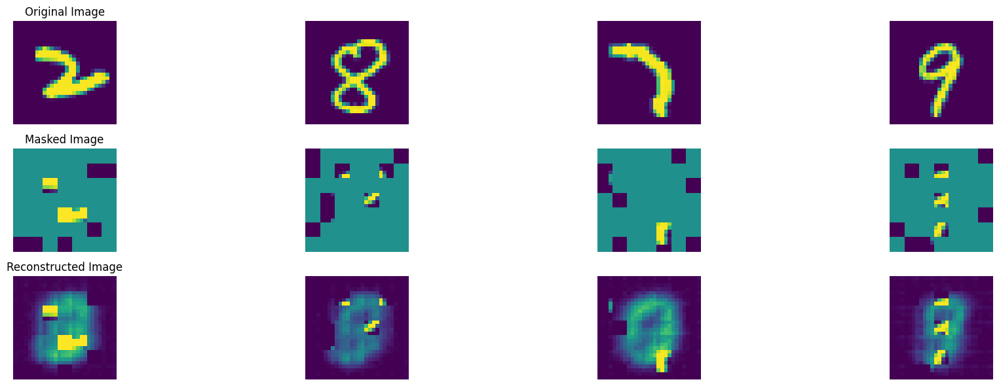

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 24, average traning loss is 0.24495600385868804.
=================== EPOCH:  25  ===================


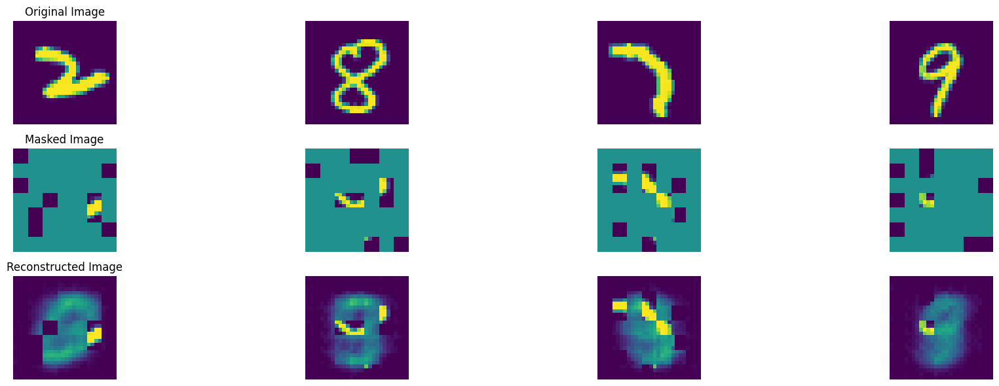

100%|██████████| 47/47 [00:08<00:00,  5.30it/s]


In epoch 25, average traning loss is 0.242373951255007.
=================== EPOCH:  26  ===================


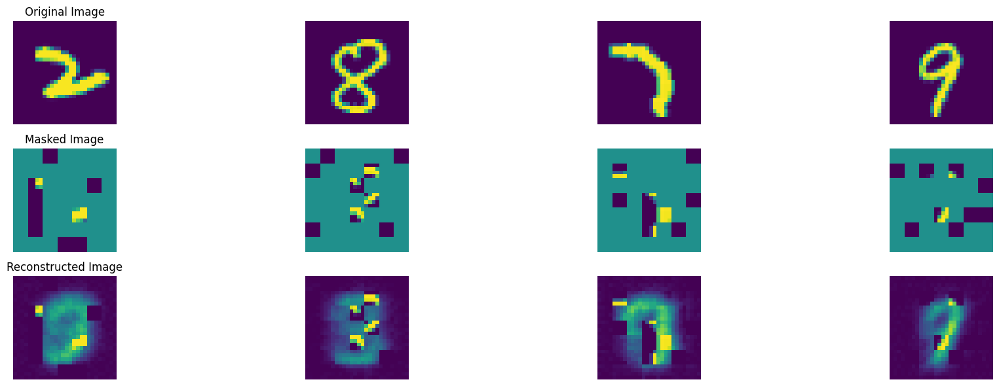

100%|██████████| 47/47 [00:09<00:00,  5.13it/s]


In epoch 26, average traning loss is 0.2402455654550106.
=================== EPOCH:  27  ===================


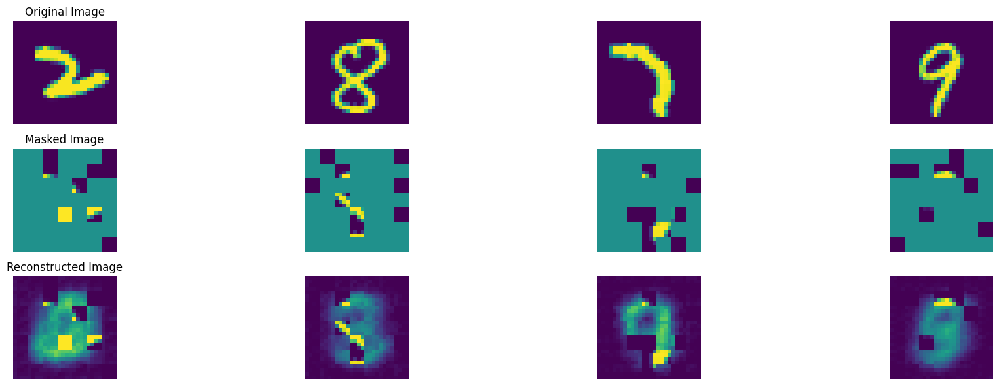

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 27, average traning loss is 0.23791491731684258.
=================== EPOCH:  28  ===================


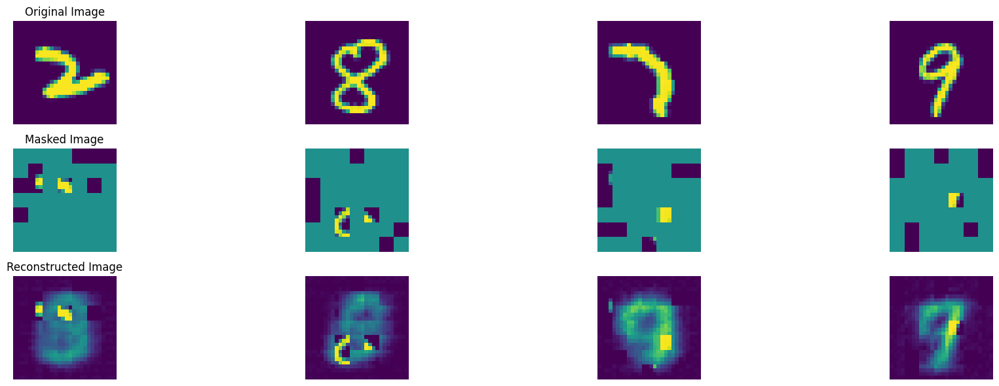

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 28, average traning loss is 0.23625604586398347.
=================== EPOCH:  29  ===================


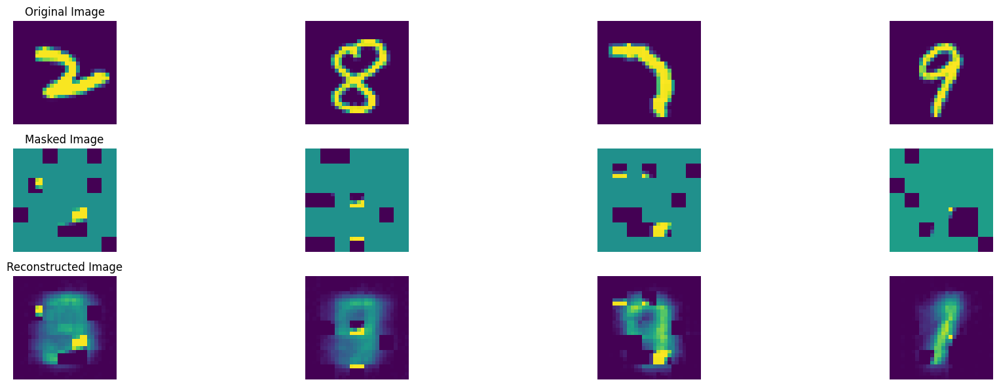

100%|██████████| 47/47 [00:08<00:00,  5.31it/s]


In epoch 29, average traning loss is 0.23464137093817933.
=================== EPOCH:  30  ===================


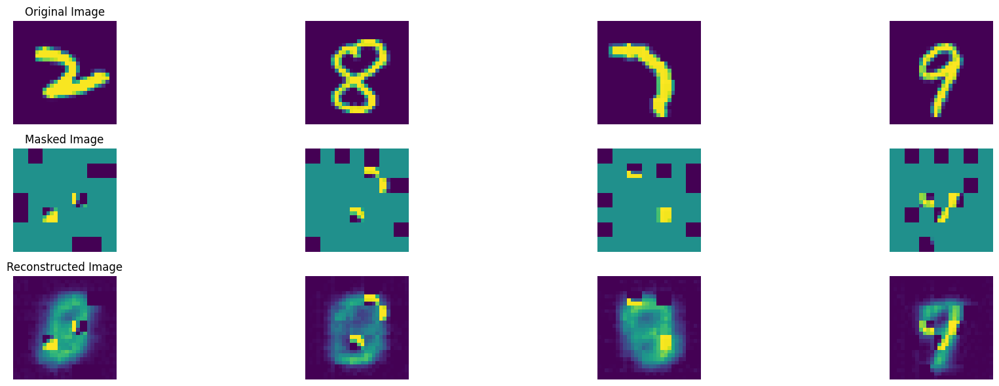

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 30, average traning loss is 0.23135303626669215.
=================== EPOCH:  31  ===================


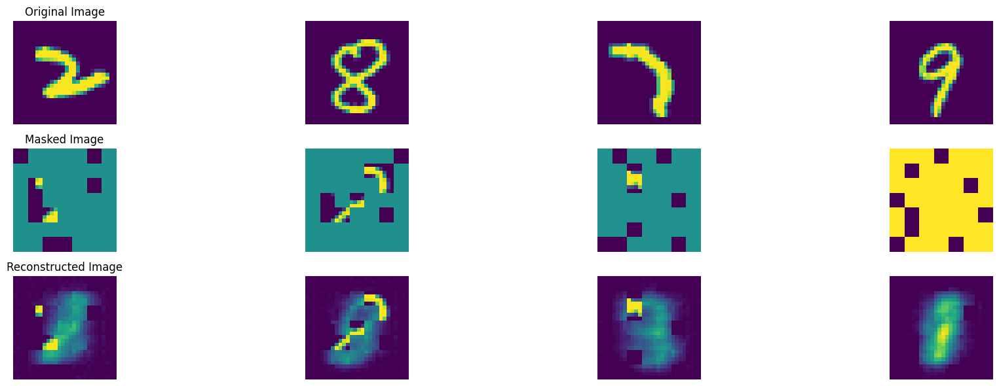

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 31, average traning loss is 0.22828174651937283.
=================== EPOCH:  32  ===================


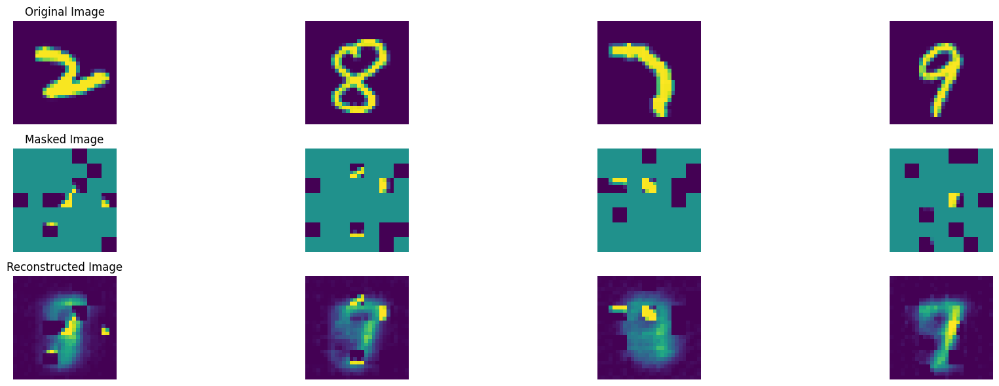

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 32, average traning loss is 0.22544433556972665.
=================== EPOCH:  33  ===================


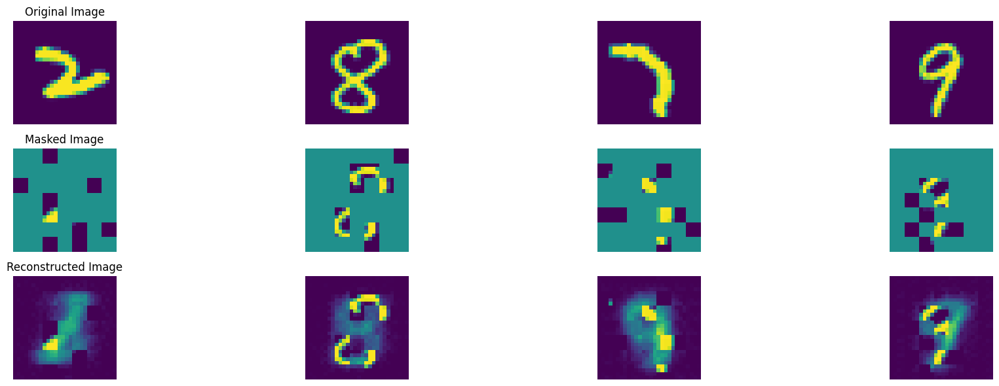

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 33, average traning loss is 0.22213945426839463.
=================== EPOCH:  34  ===================


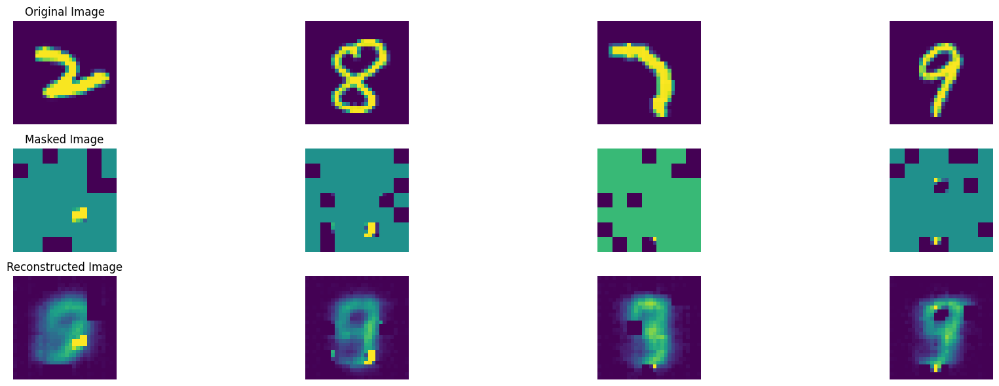

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 34, average traning loss is 0.21897825852353522.
=================== EPOCH:  35  ===================


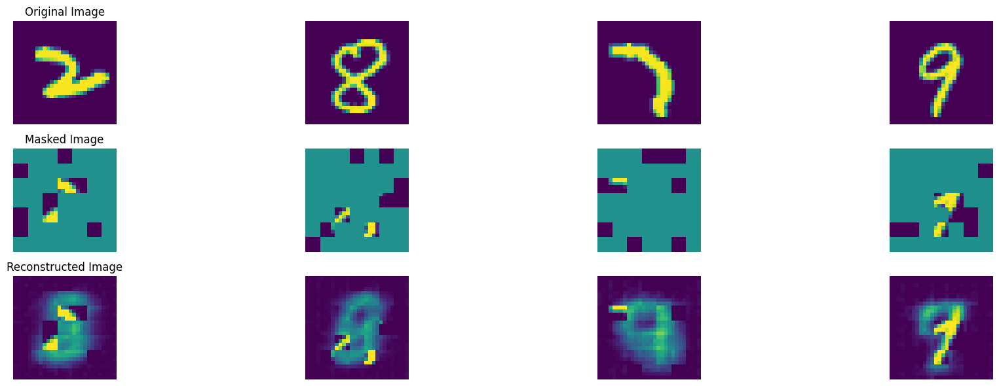

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 35, average traning loss is 0.21681040810777785.
=================== EPOCH:  36  ===================


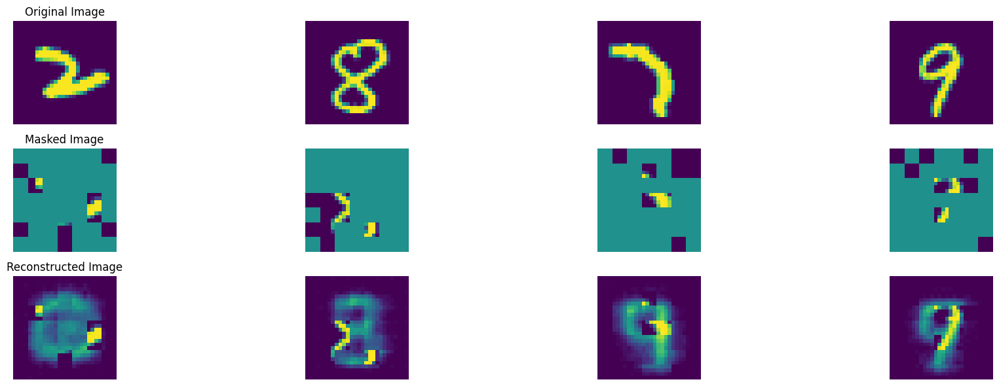

100%|██████████| 47/47 [00:08<00:00,  5.30it/s]


In epoch 36, average traning loss is 0.21308368476147346.
=================== EPOCH:  37  ===================


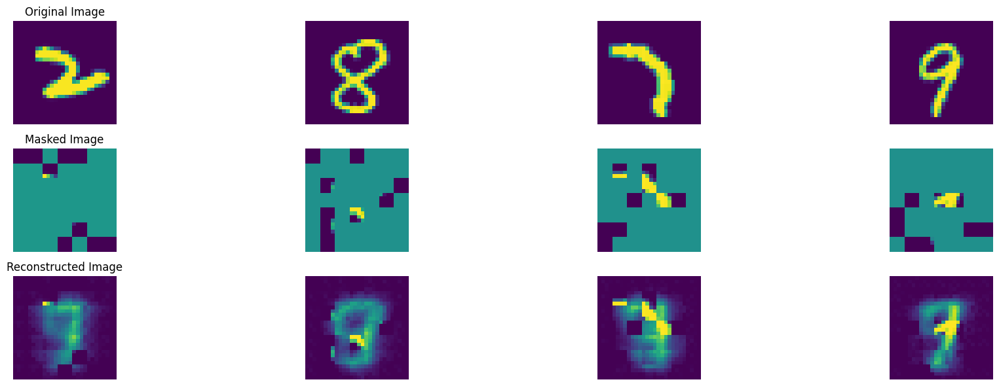

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 37, average traning loss is 0.21077783183848603.
=================== EPOCH:  38  ===================


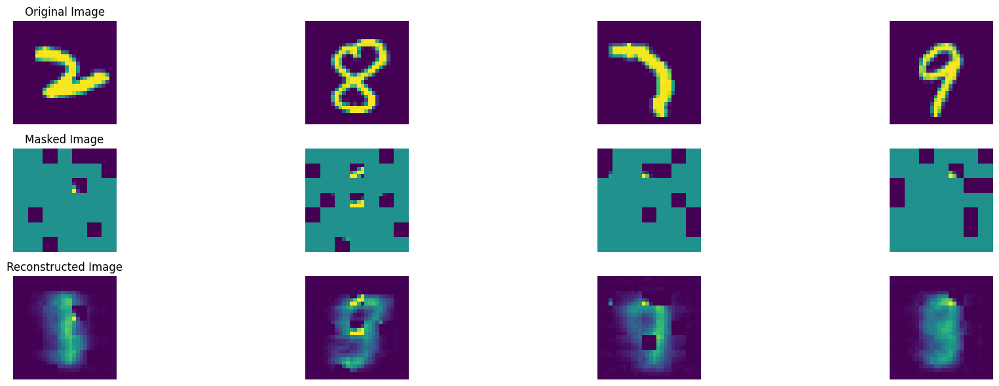

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 38, average traning loss is 0.20721792382128695.
=================== EPOCH:  39  ===================


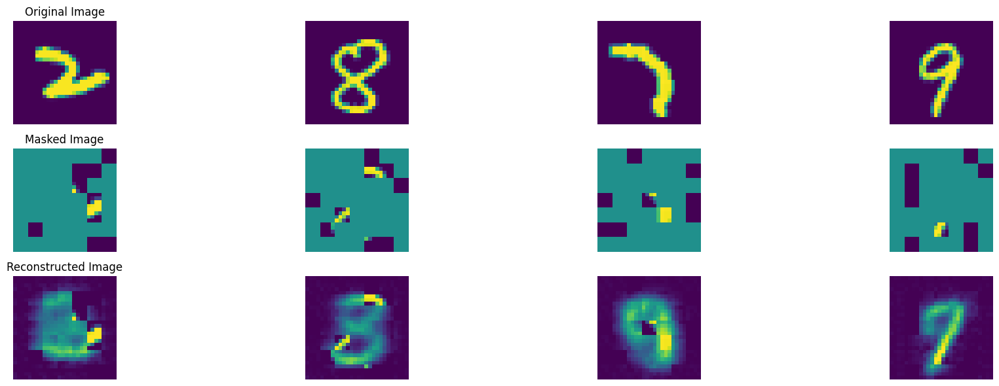

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 39, average traning loss is 0.20368549100896147.
=================== EPOCH:  40  ===================


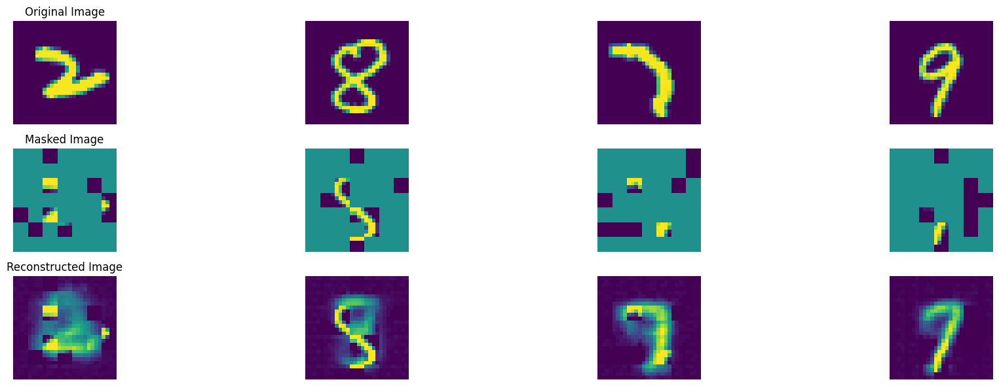

100%|██████████| 47/47 [00:09<00:00,  5.21it/s]


In epoch 40, average traning loss is 0.20141829264924882.
=================== EPOCH:  41  ===================


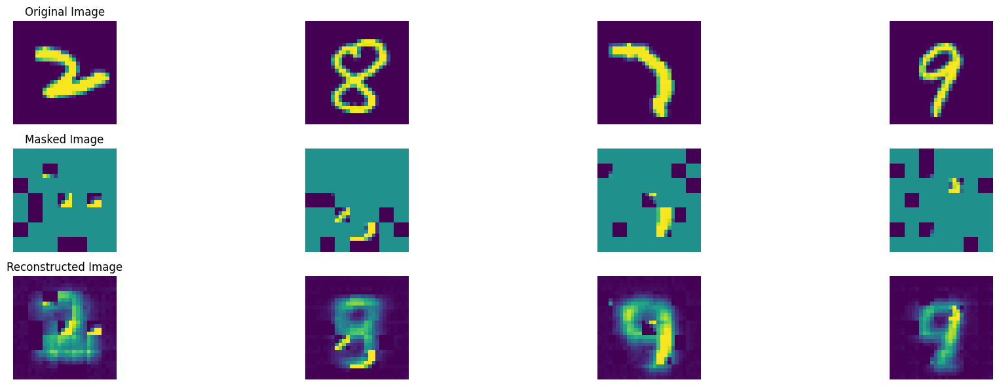

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 41, average traning loss is 0.19949855861511637.
=================== EPOCH:  42  ===================


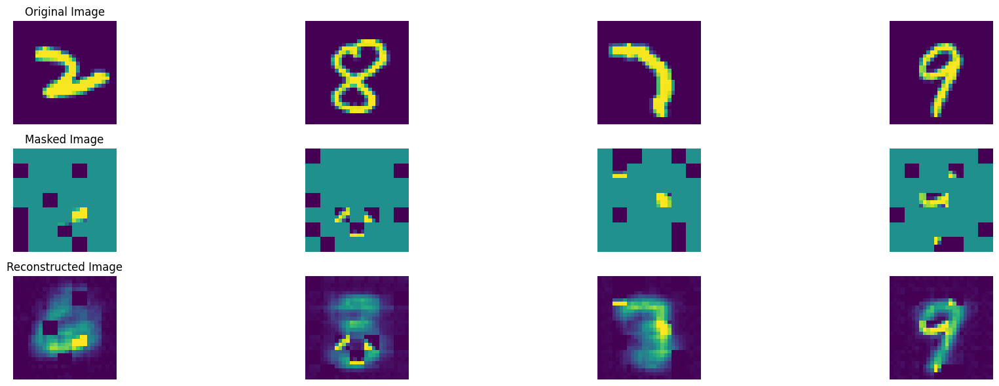

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 42, average traning loss is 0.1967589966160186.
=================== EPOCH:  43  ===================


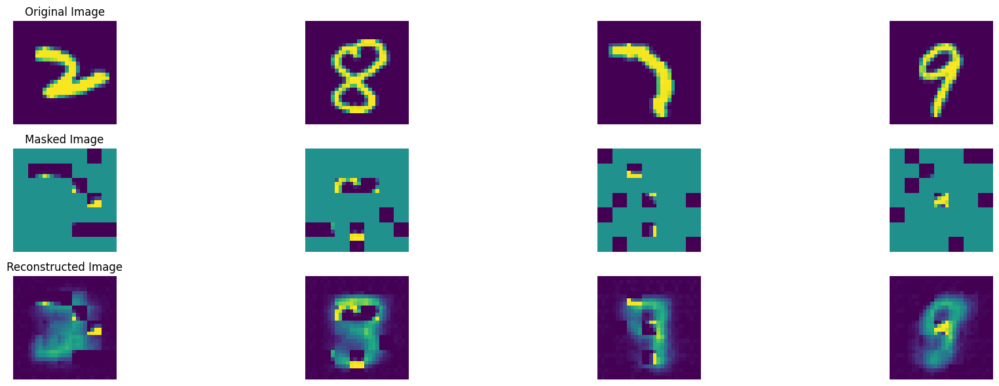

100%|██████████| 47/47 [00:08<00:00,  5.31it/s]


In epoch 43, average traning loss is 0.19375896041697643.
=================== EPOCH:  44  ===================


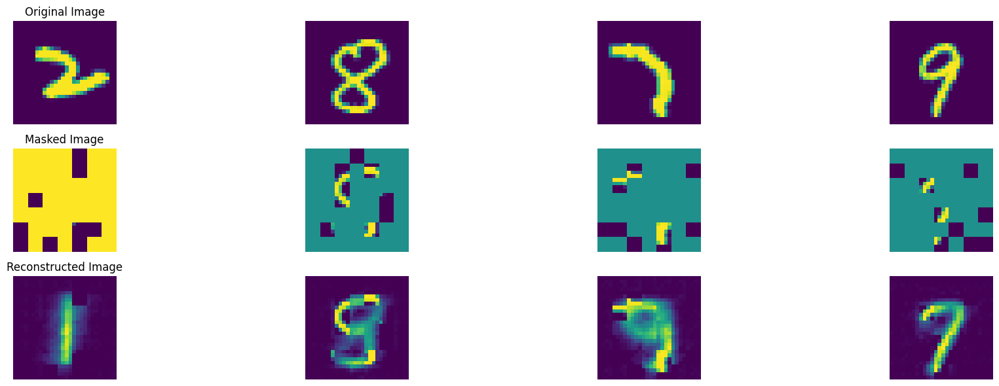

100%|██████████| 47/47 [00:08<00:00,  5.30it/s]


In epoch 44, average traning loss is 0.19185179281742015.
=================== EPOCH:  45  ===================


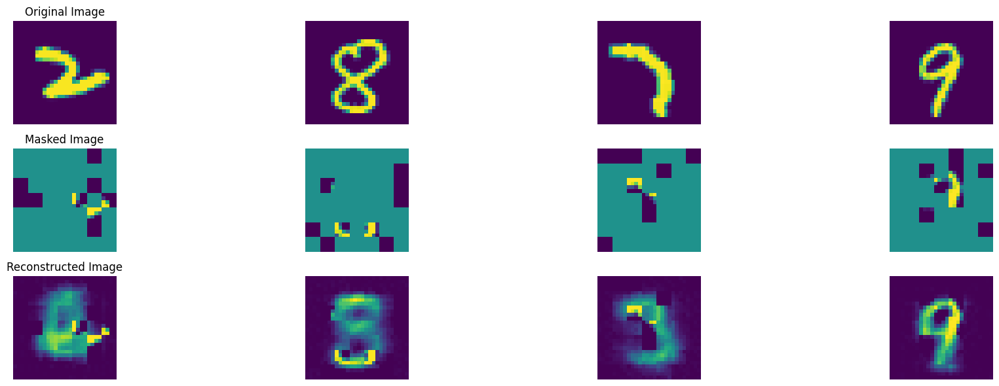

100%|██████████| 47/47 [00:08<00:00,  5.30it/s]


In epoch 45, average traning loss is 0.18863899625362235.
=================== EPOCH:  46  ===================


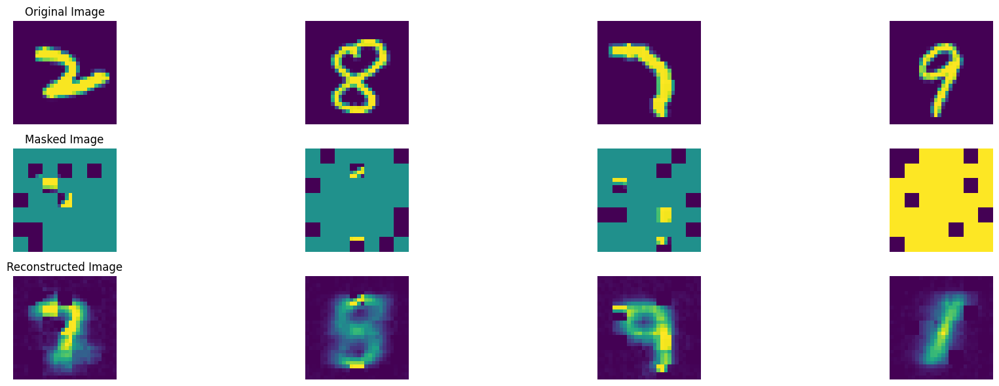

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 46, average traning loss is 0.18662351972245156.
=================== EPOCH:  47  ===================


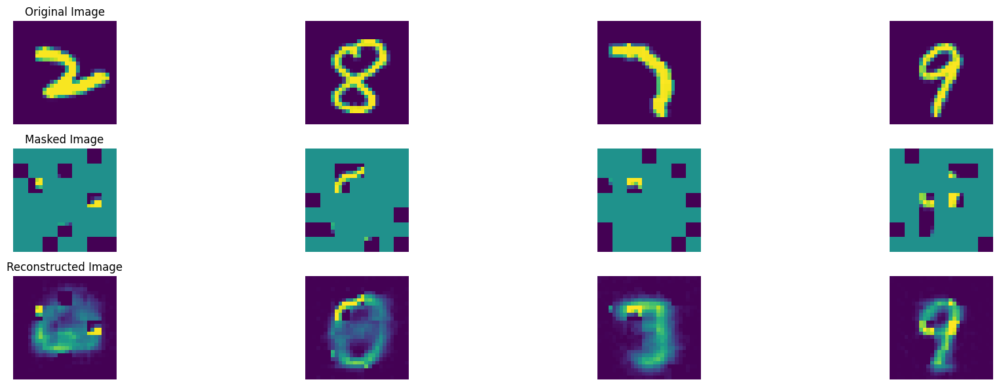

100%|██████████| 47/47 [00:09<00:00,  5.03it/s]


In epoch 47, average traning loss is 0.1848468025948139.
=================== EPOCH:  48  ===================


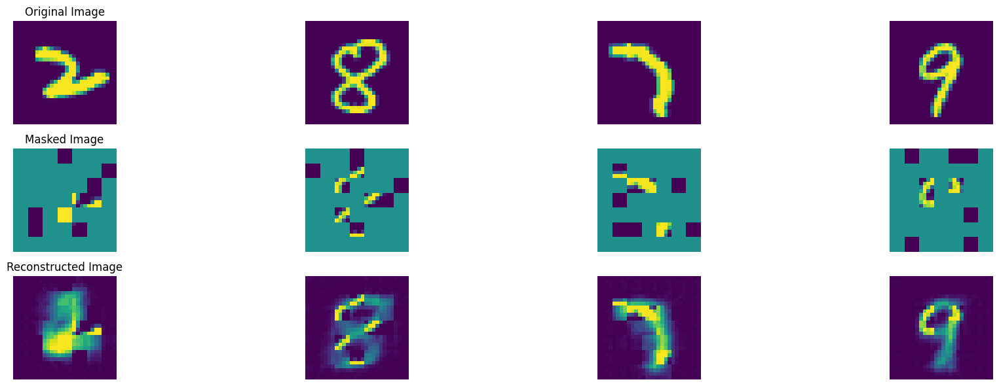

100%|██████████| 47/47 [00:08<00:00,  5.30it/s]


In epoch 48, average traning loss is 0.1813149724869018.
=================== EPOCH:  49  ===================


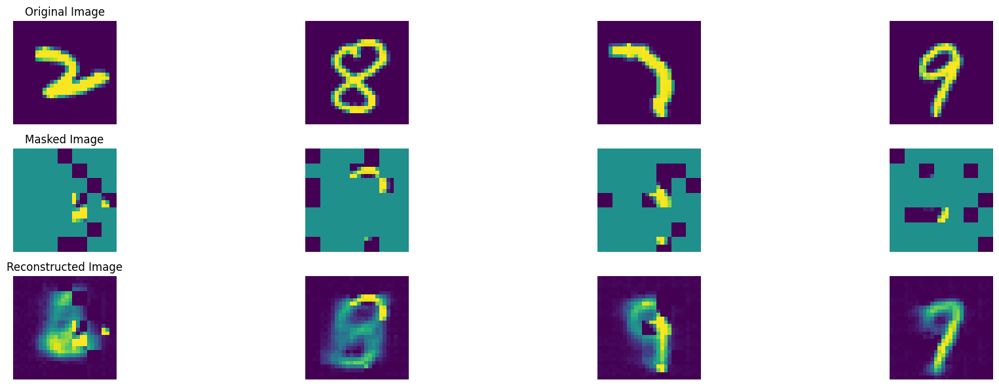

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 49, average traning loss is 0.18015267018308032.
=================== EPOCH:  50  ===================


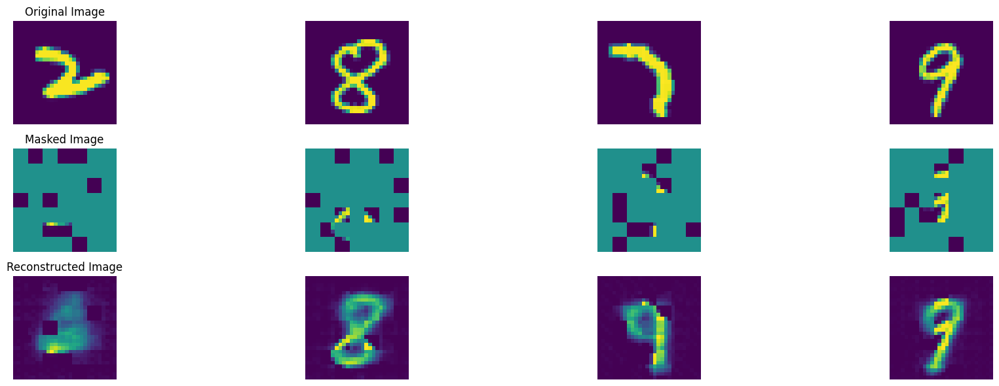

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 50, average traning loss is 0.17761404495289984.
=================== EPOCH:  51  ===================


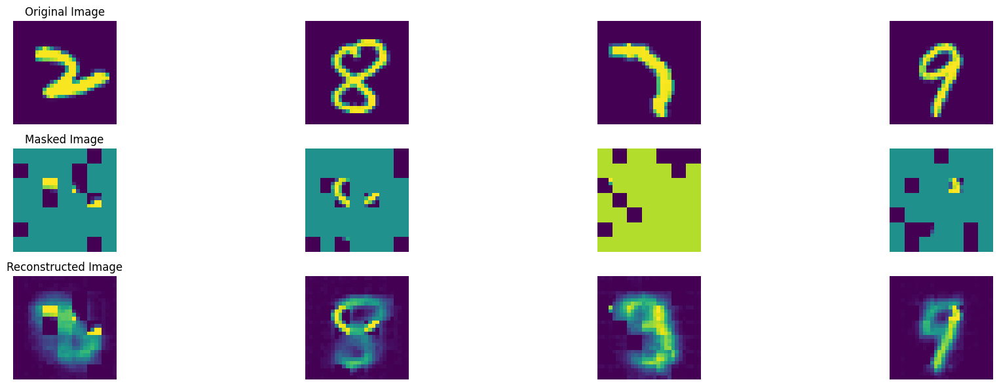

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 51, average traning loss is 0.17590208668658075.
=================== EPOCH:  52  ===================


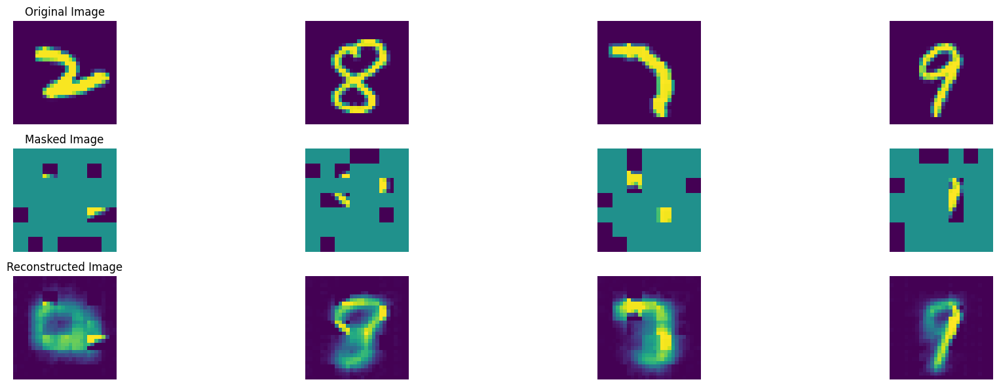

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 52, average traning loss is 0.1738801154684513.
=================== EPOCH:  53  ===================


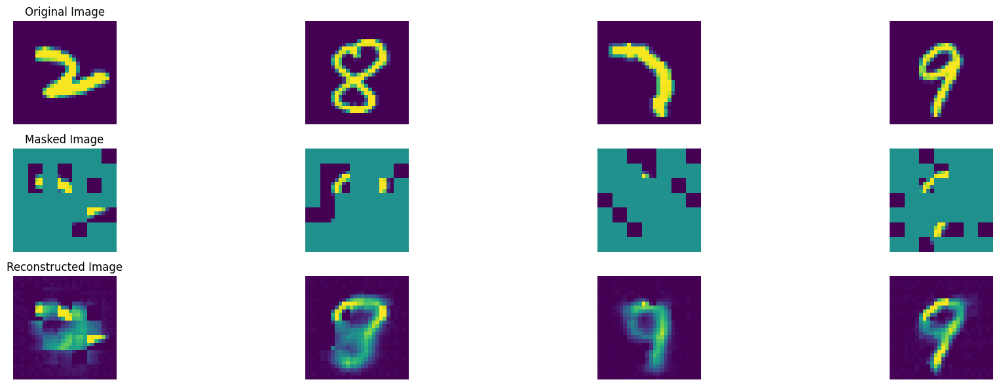

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 53, average traning loss is 0.171599639222977.
=================== EPOCH:  54  ===================


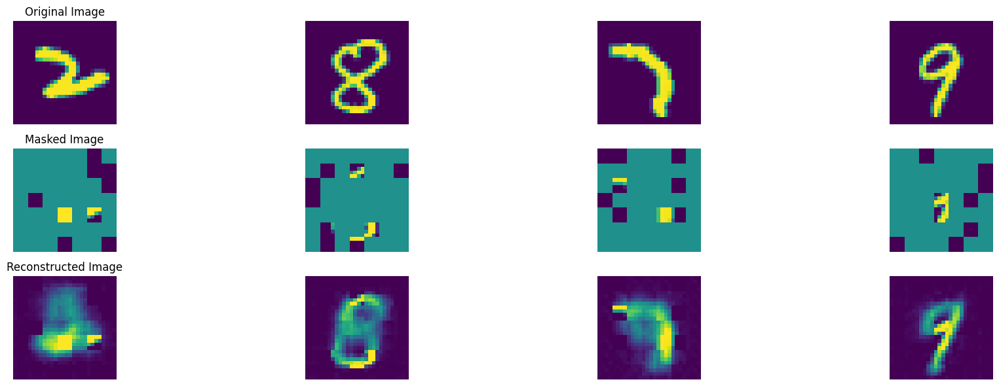

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 54, average traning loss is 0.1703645054330217.
=================== EPOCH:  55  ===================


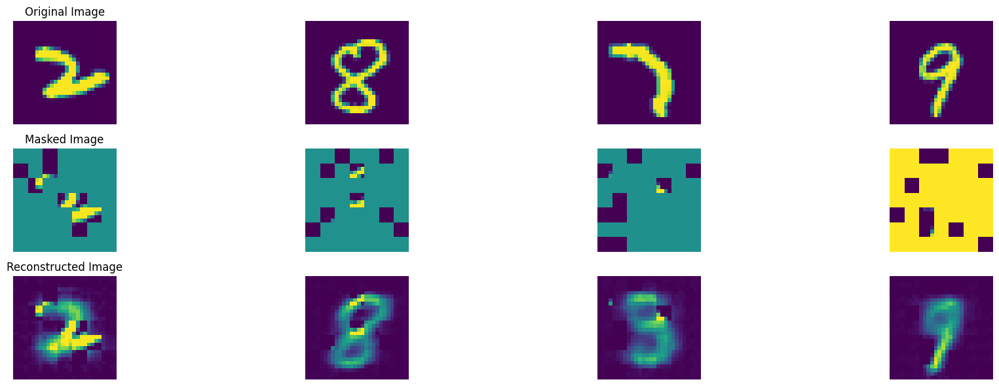

100%|██████████| 47/47 [00:08<00:00,  5.31it/s]


In epoch 55, average traning loss is 0.1673331802829783.
=================== EPOCH:  56  ===================


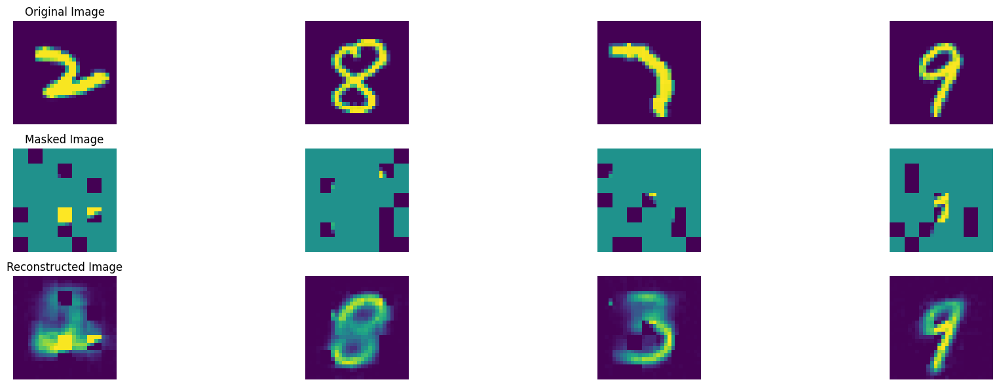

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 56, average traning loss is 0.16733410764247814.
=================== EPOCH:  57  ===================


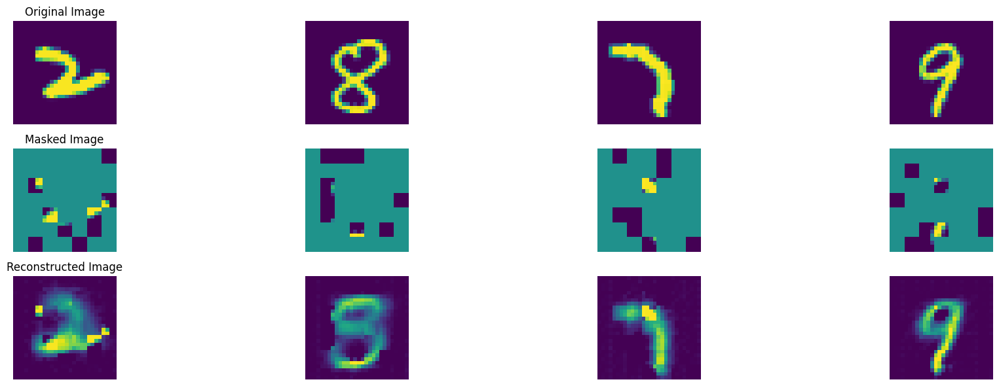

100%|██████████| 47/47 [00:08<00:00,  5.27it/s]


In epoch 57, average traning loss is 0.16416297821288414.
=================== EPOCH:  58  ===================


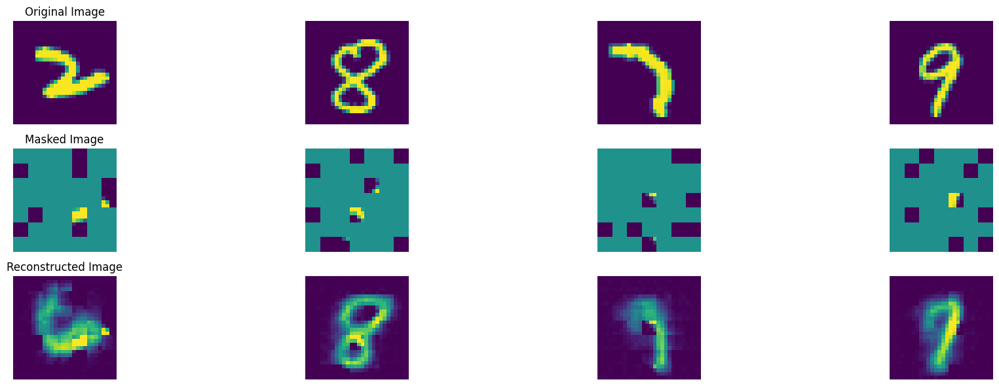

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 58, average traning loss is 0.1639644424331949.
=================== EPOCH:  59  ===================


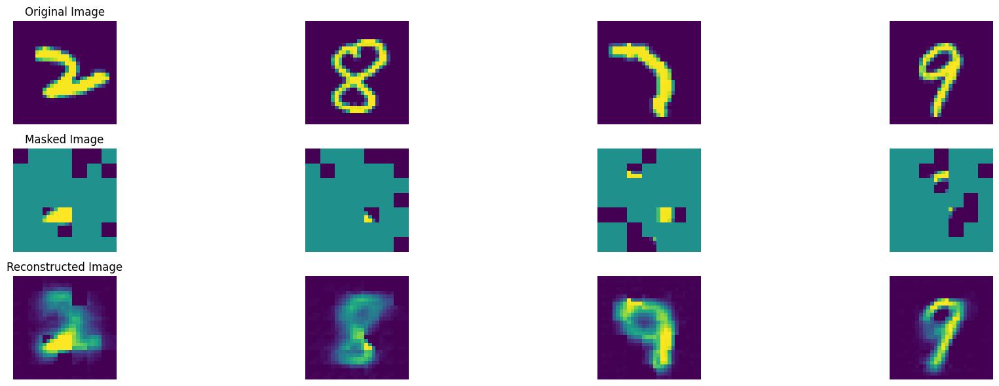

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 59, average traning loss is 0.16239708059645713.
=================== EPOCH:  60  ===================


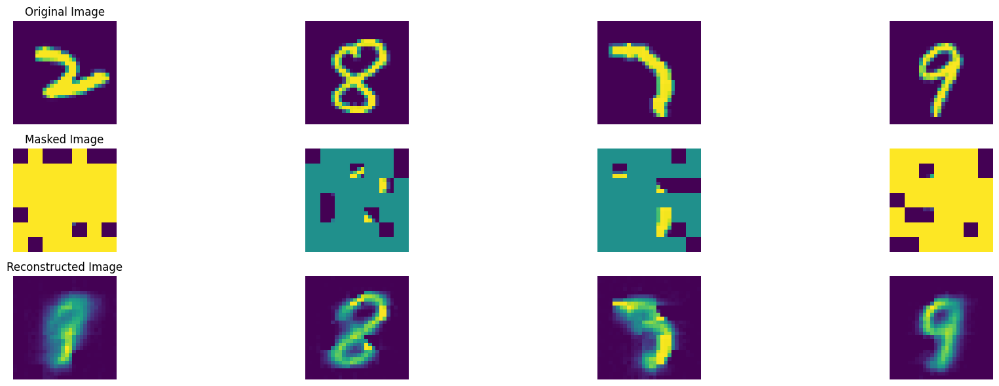

100%|██████████| 47/47 [00:08<00:00,  5.29it/s]


In epoch 60, average traning loss is 0.1615358144044876.
=================== EPOCH:  61  ===================


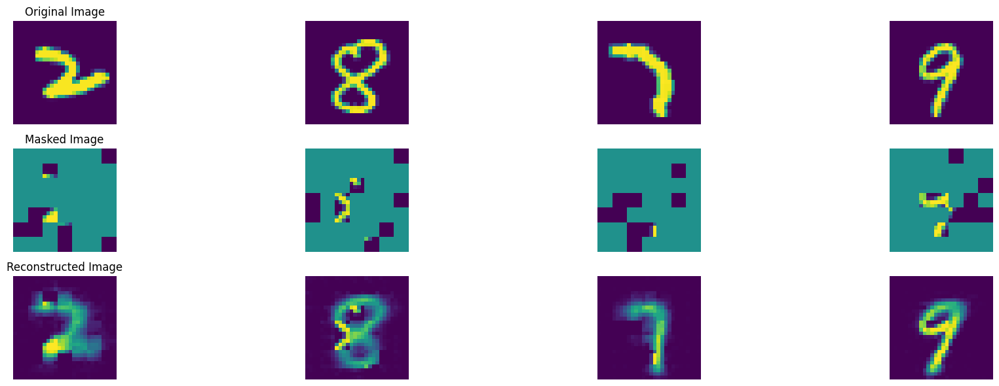

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 61, average traning loss is 0.15920193937230617.
=================== EPOCH:  62  ===================


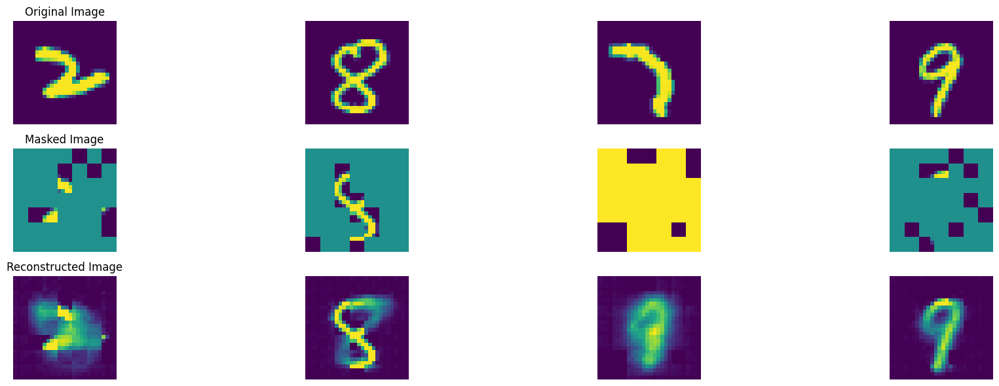

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 62, average traning loss is 0.1578230008165887.
=================== EPOCH:  63  ===================


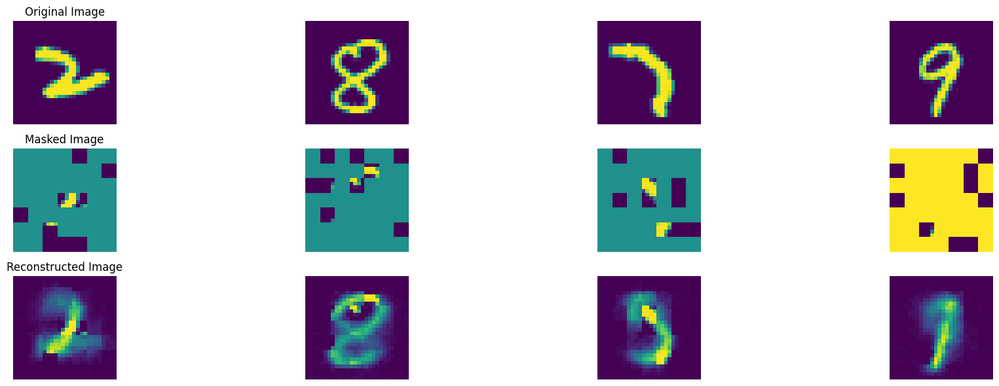

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 63, average traning loss is 0.15728461710696526.
=================== EPOCH:  64  ===================


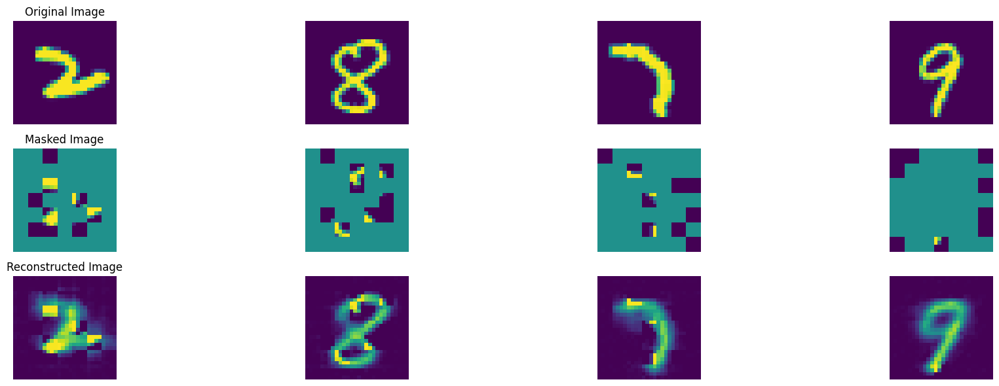

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 64, average traning loss is 0.15544802774774266.
=================== EPOCH:  65  ===================


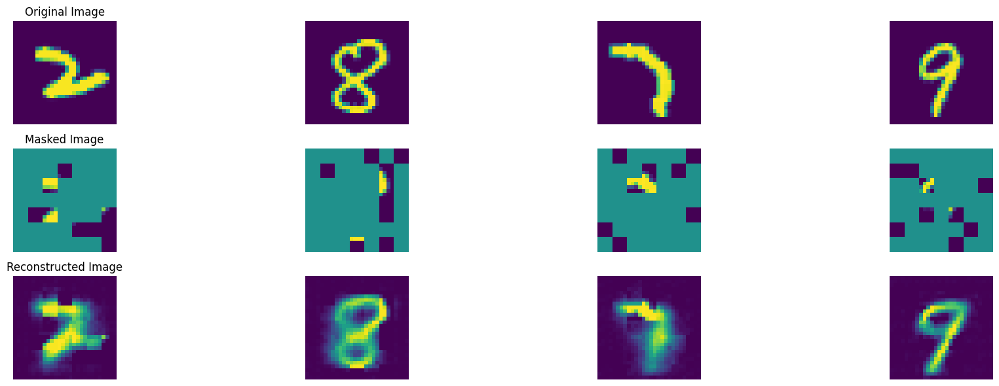

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 65, average traning loss is 0.15492000161333286.
=================== EPOCH:  66  ===================


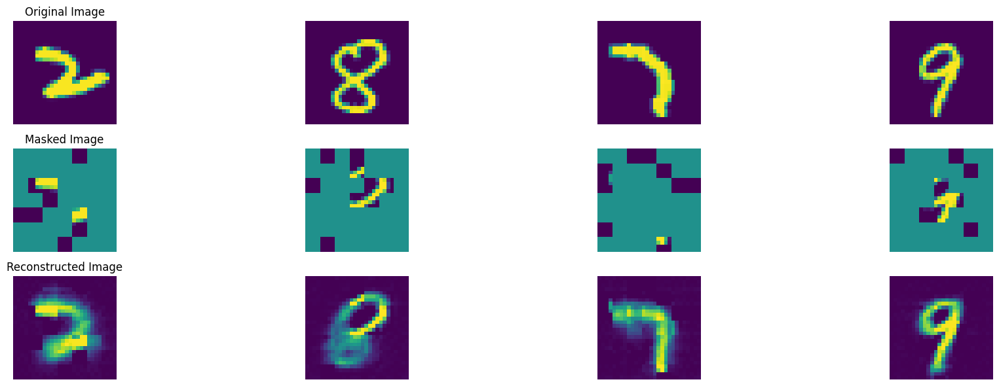

100%|██████████| 47/47 [00:08<00:00,  5.27it/s]


In epoch 66, average traning loss is 0.15356659508766013.
=================== EPOCH:  67  ===================


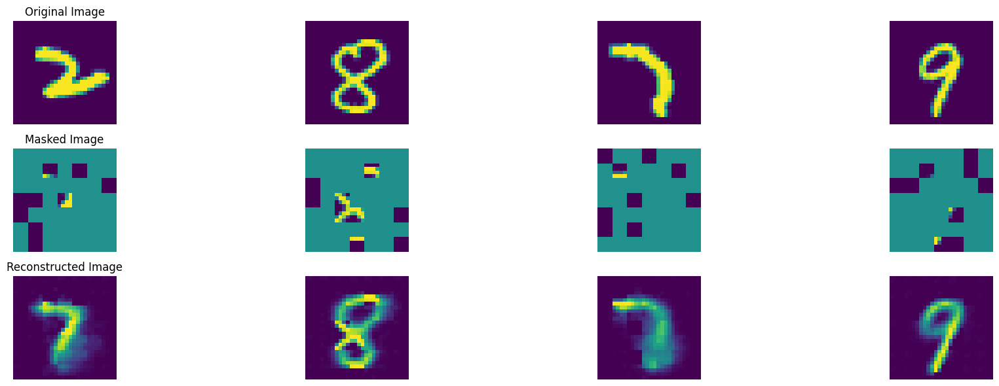

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 67, average traning loss is 0.1523331933199091.
=================== EPOCH:  68  ===================


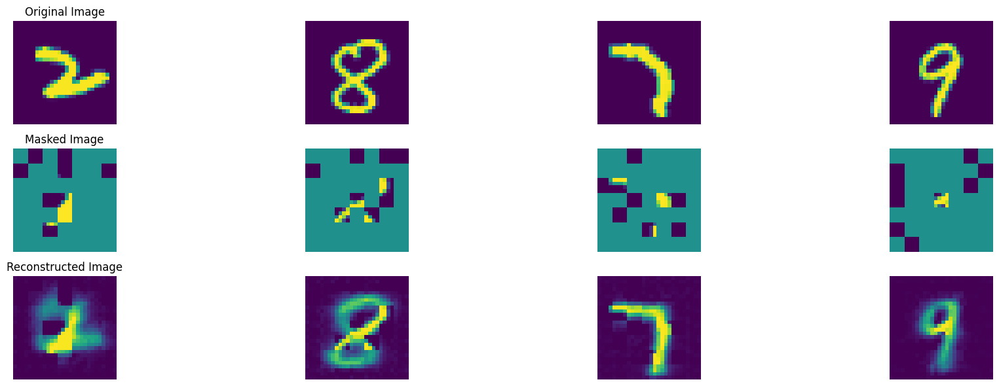

100%|██████████| 47/47 [00:08<00:00,  5.23it/s]


In epoch 68, average traning loss is 0.15163205944477243.
=================== EPOCH:  69  ===================


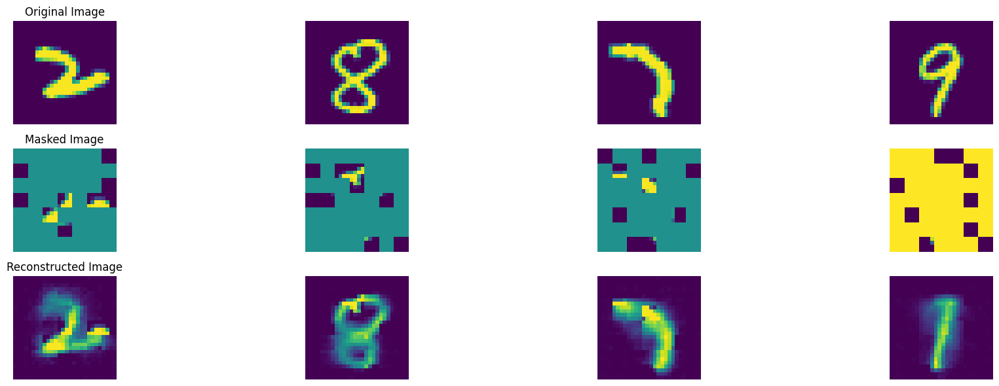

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 69, average traning loss is 0.1498132424151644.
=================== EPOCH:  70  ===================


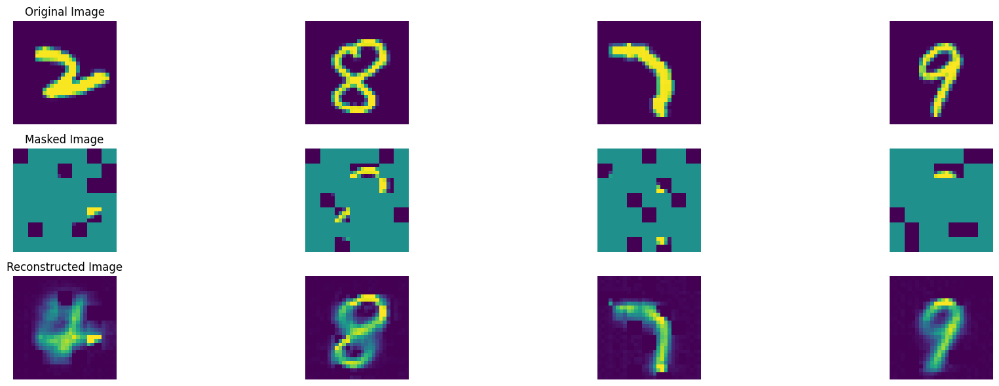

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 70, average traning loss is 0.15007440048329374.
=================== EPOCH:  71  ===================


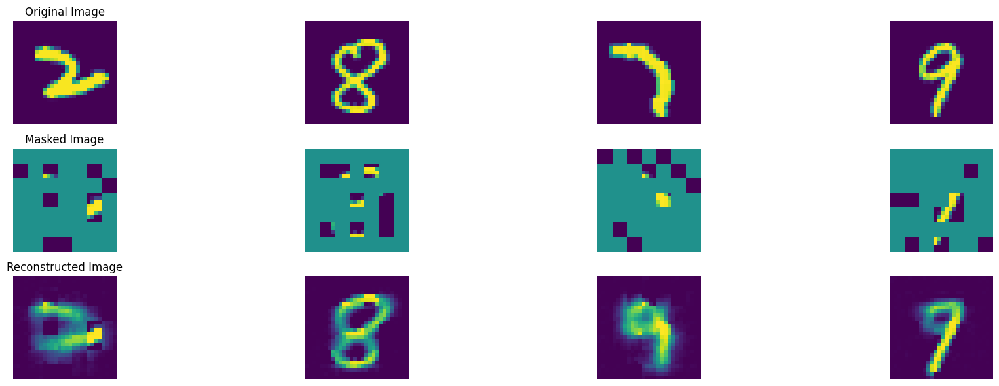

100%|██████████| 47/47 [00:08<00:00,  5.27it/s]


In epoch 71, average traning loss is 0.1484054574306975.
=================== EPOCH:  72  ===================


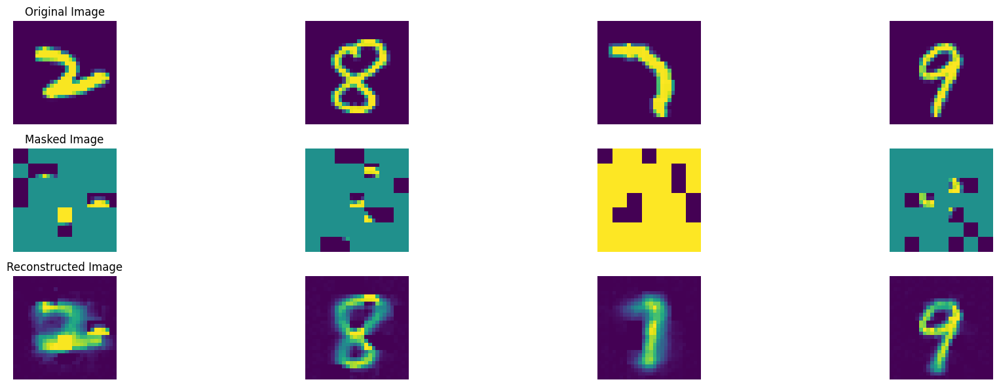

100%|██████████| 47/47 [00:08<00:00,  5.25it/s]


In epoch 72, average traning loss is 0.14828644470965607.
=================== EPOCH:  73  ===================


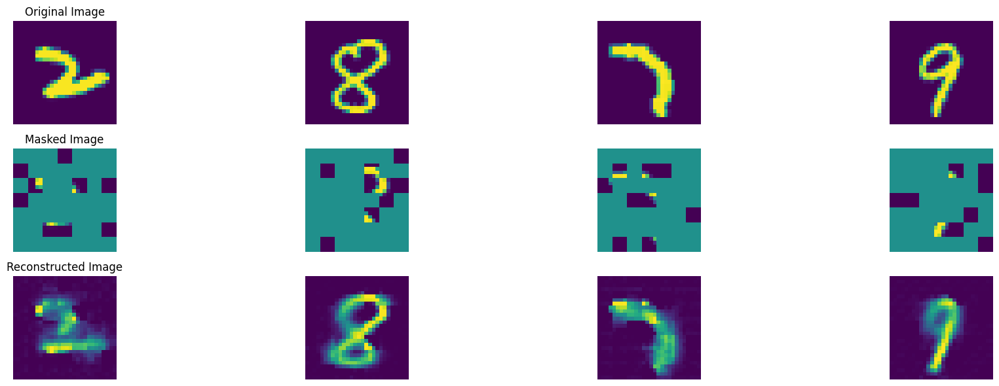

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 73, average traning loss is 0.14692120761313338.
=================== EPOCH:  74  ===================


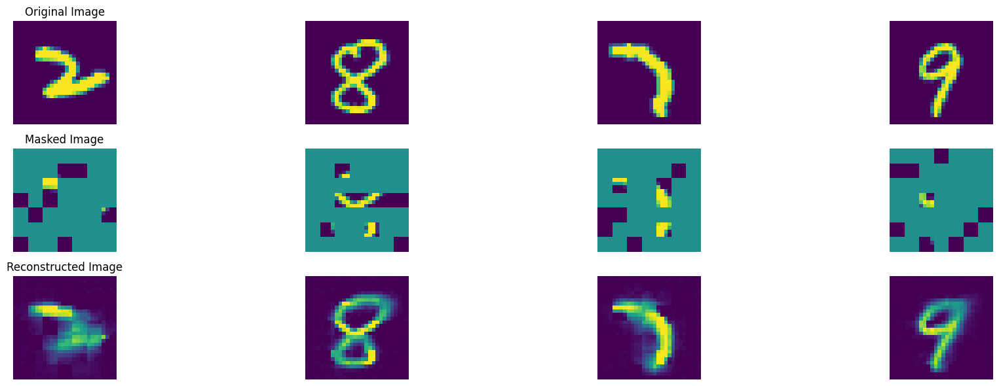

100%|██████████| 47/47 [00:09<00:00,  5.19it/s]


In epoch 74, average traning loss is 0.14627156422493306.
=================== EPOCH:  75  ===================


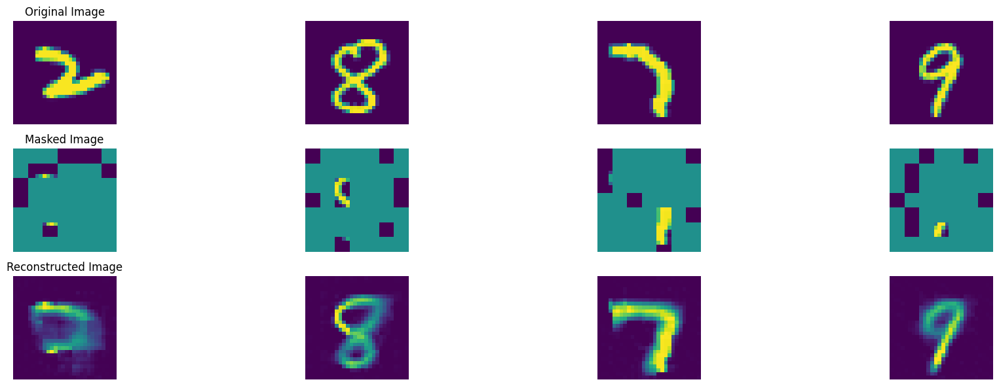

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 75, average traning loss is 0.1458312837367362.
=================== EPOCH:  76  ===================


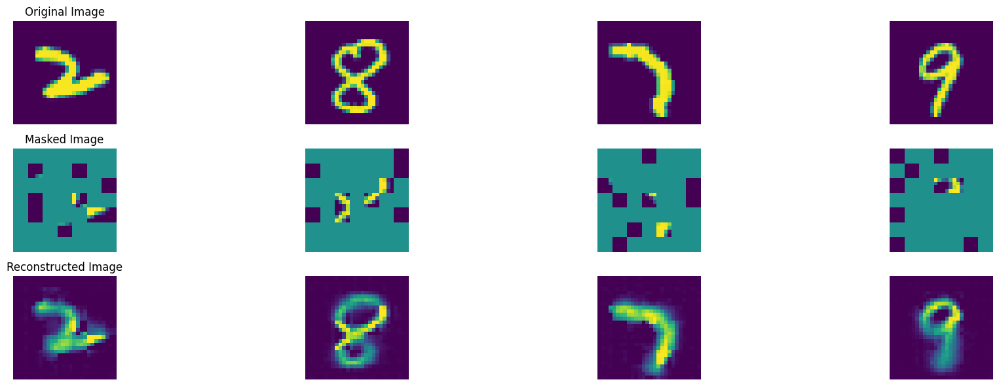

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 76, average traning loss is 0.14475077834535152.
=================== EPOCH:  77  ===================


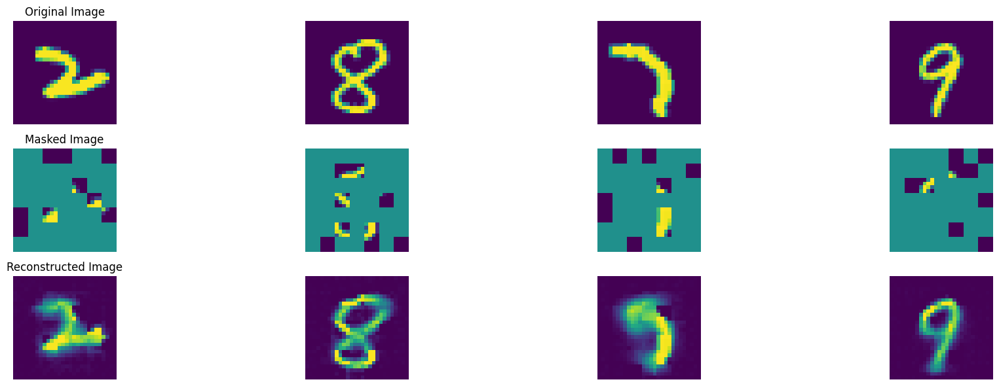

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 77, average traning loss is 0.14428376707624882.
=================== EPOCH:  78  ===================


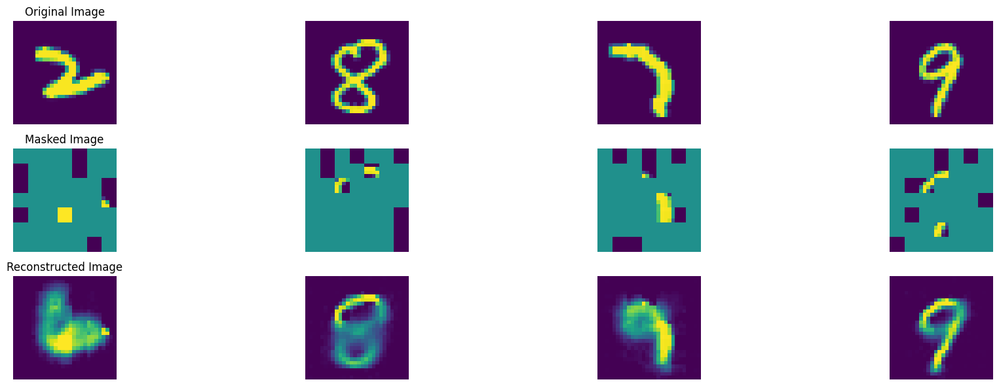

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 78, average traning loss is 0.14316985074509966.
=================== EPOCH:  79  ===================


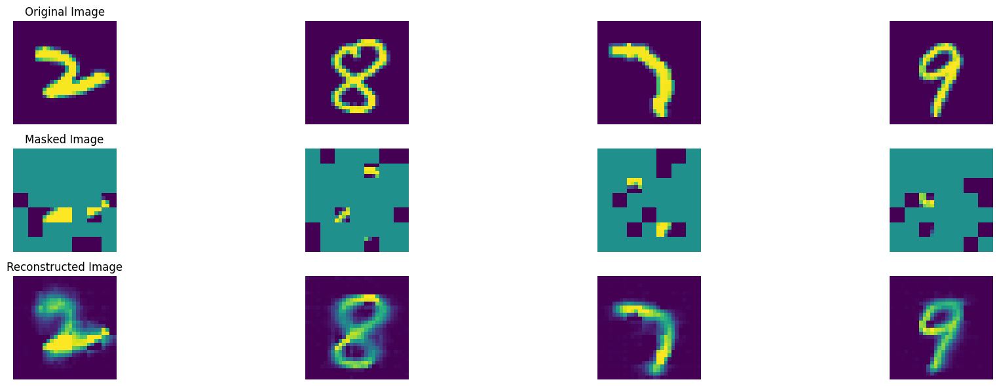

100%|██████████| 47/47 [00:08<00:00,  5.26it/s]


In epoch 79, average traning loss is 0.14308721080739448.
=================== EPOCH:  80  ===================


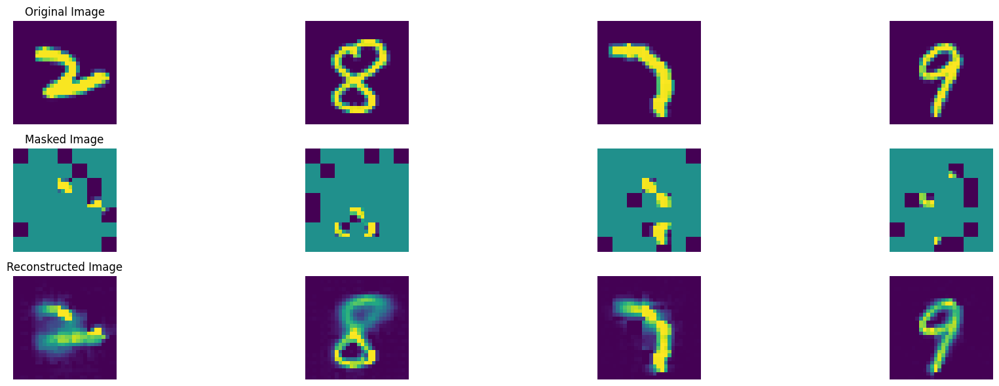

100%|██████████| 47/47 [00:09<00:00,  4.80it/s]


In epoch 80, average traning loss is 0.14203084402895988.
=================== EPOCH:  81  ===================


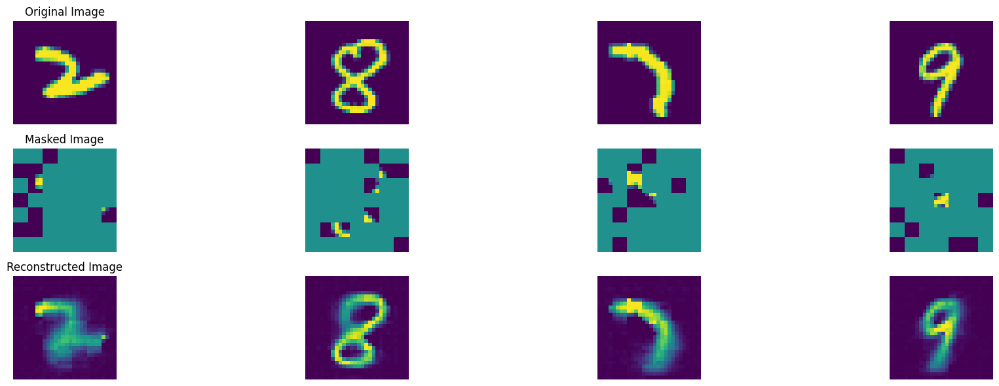

100%|██████████| 47/47 [00:08<00:00,  5.29it/s]


In epoch 81, average traning loss is 0.1417194516100782.
=================== EPOCH:  82  ===================


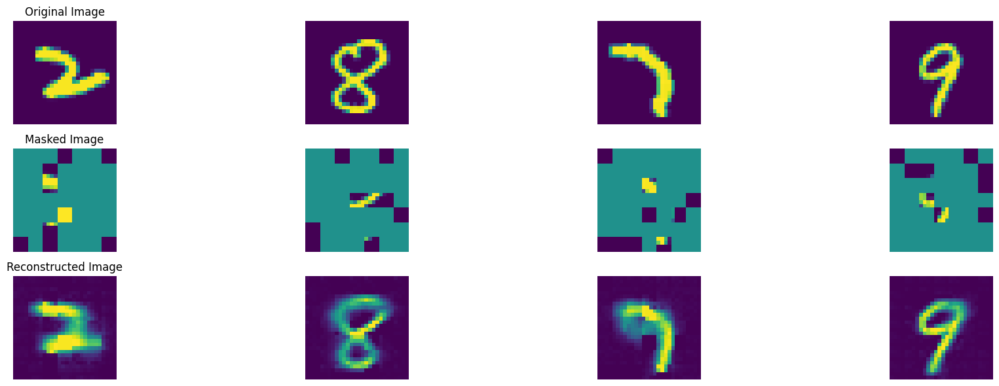

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 82, average traning loss is 0.14074184888220848.
=================== EPOCH:  83  ===================


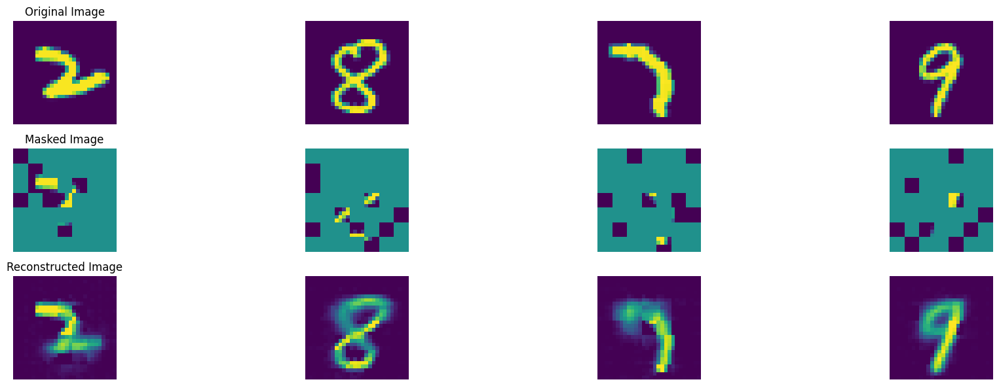

100%|██████████| 47/47 [00:08<00:00,  5.29it/s]


In epoch 83, average traning loss is 0.14024894922337633.
=================== EPOCH:  84  ===================


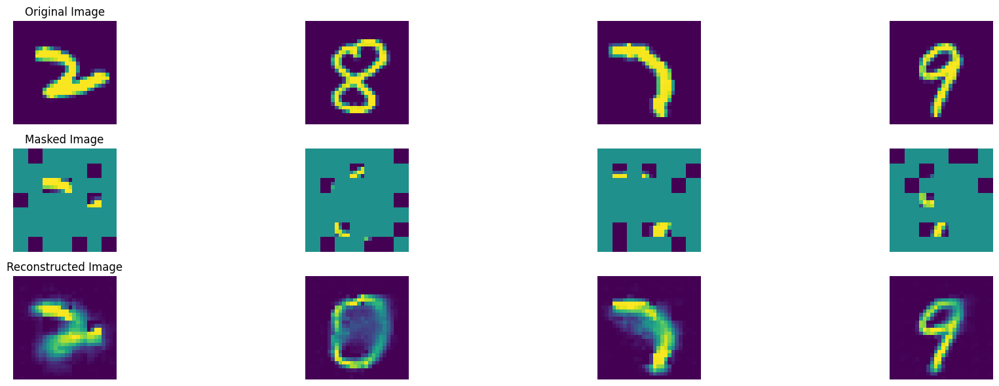

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 84, average traning loss is 0.13951902503662922.
=================== EPOCH:  85  ===================


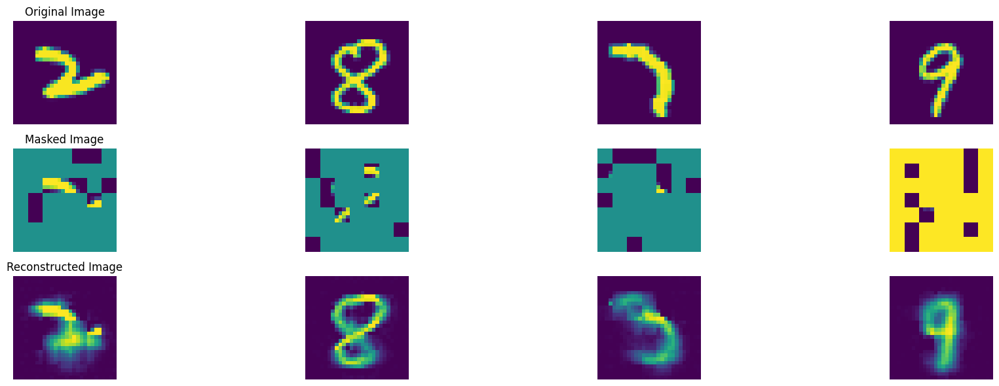

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 85, average traning loss is 0.1390569882189974.
=================== EPOCH:  86  ===================


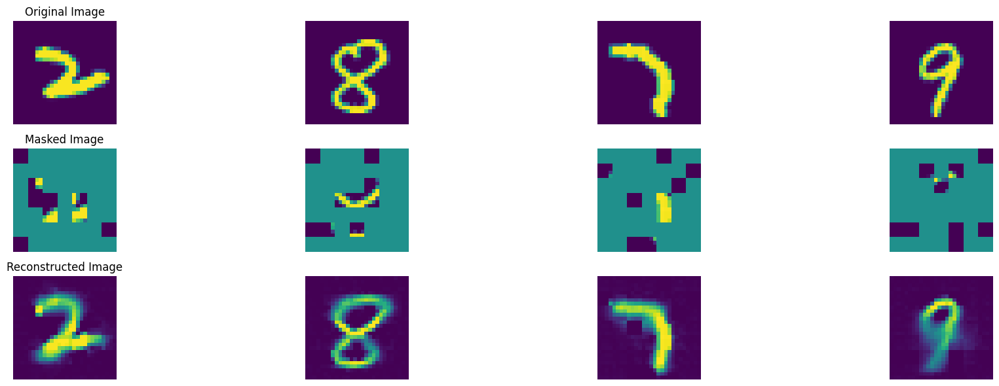

100%|██████████| 47/47 [00:09<00:00,  5.15it/s]


In epoch 86, average traning loss is 0.13876147663339655.
=================== EPOCH:  87  ===================


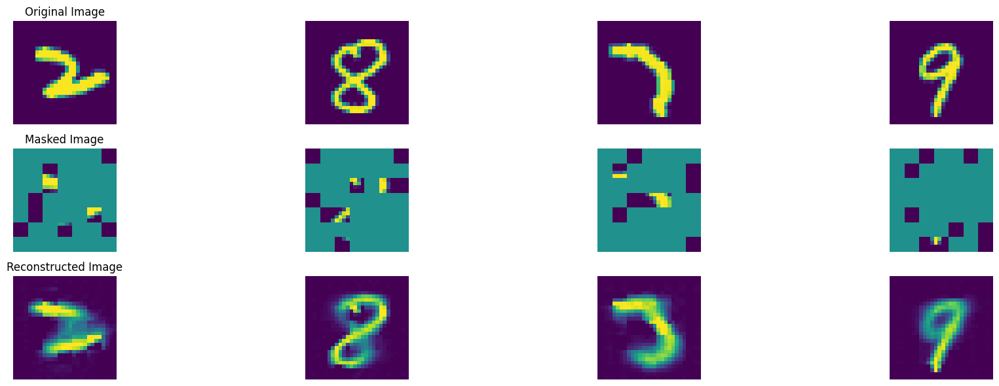

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 87, average traning loss is 0.13838646671873459.
=================== EPOCH:  88  ===================


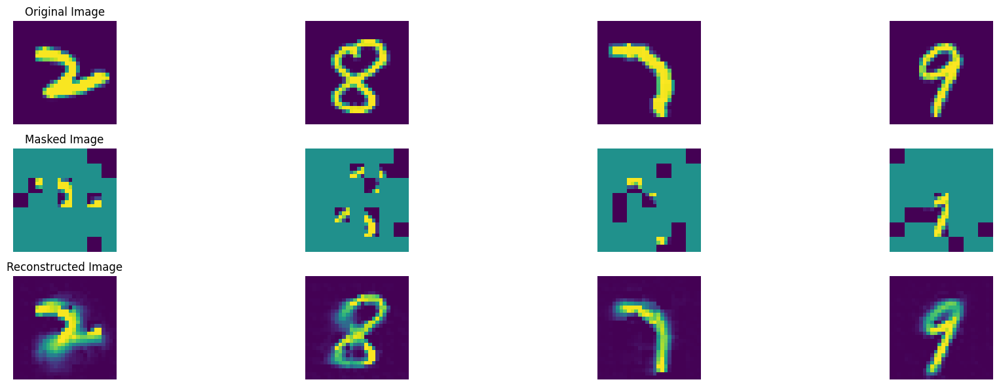

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 88, average traning loss is 0.13707908449020792.
=================== EPOCH:  89  ===================


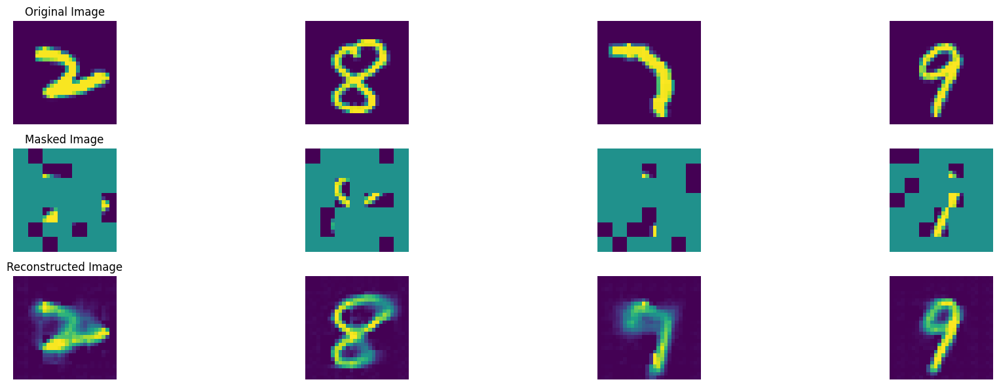

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 89, average traning loss is 0.13743097129020285.
=================== EPOCH:  90  ===================


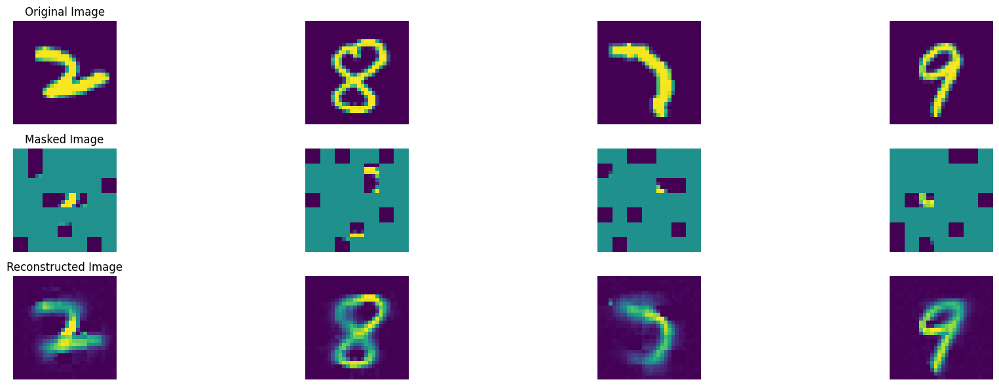

100%|██████████| 47/47 [00:08<00:00,  5.31it/s]


In epoch 90, average traning loss is 0.13672662003243224.
=================== EPOCH:  91  ===================


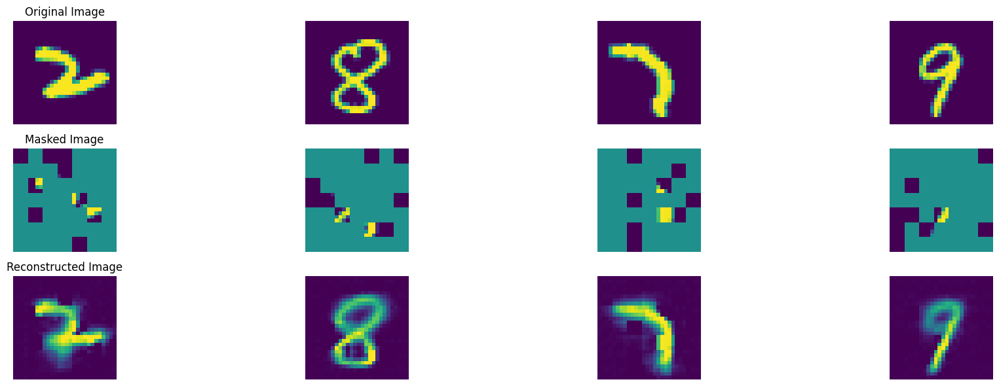

100%|██████████| 47/47 [00:08<00:00,  5.29it/s]


In epoch 91, average traning loss is 0.13615676855787318.
=================== EPOCH:  92  ===================


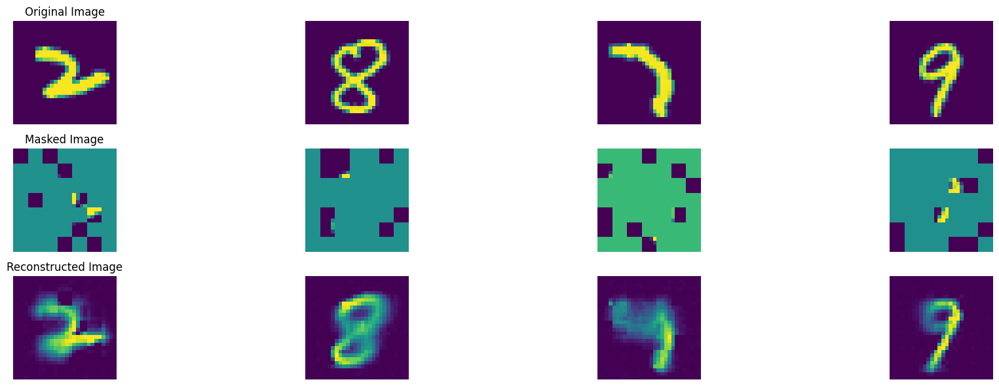

100%|██████████| 47/47 [00:09<00:00,  5.18it/s]


In epoch 92, average traning loss is 0.1359020303538505.
=================== EPOCH:  93  ===================


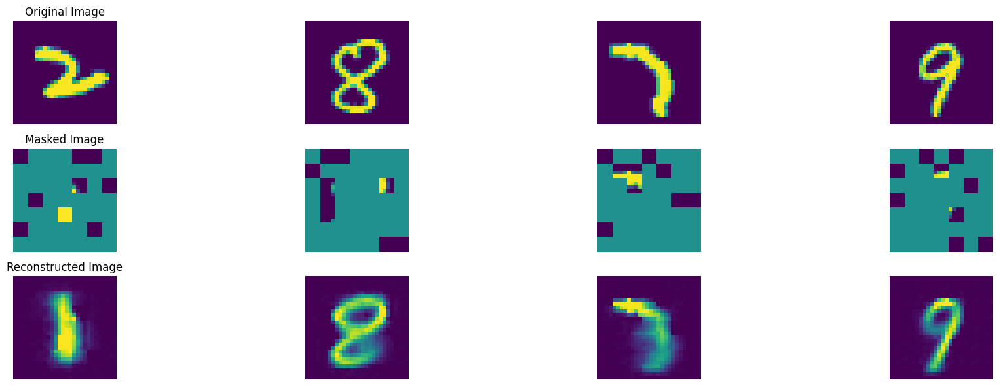

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 93, average traning loss is 0.1351730817175926.
=================== EPOCH:  94  ===================


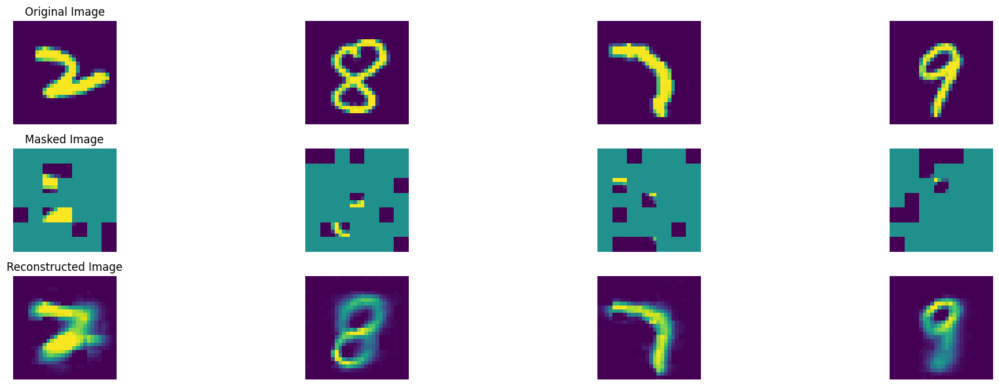

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 94, average traning loss is 0.1349169542180731.
=================== EPOCH:  95  ===================


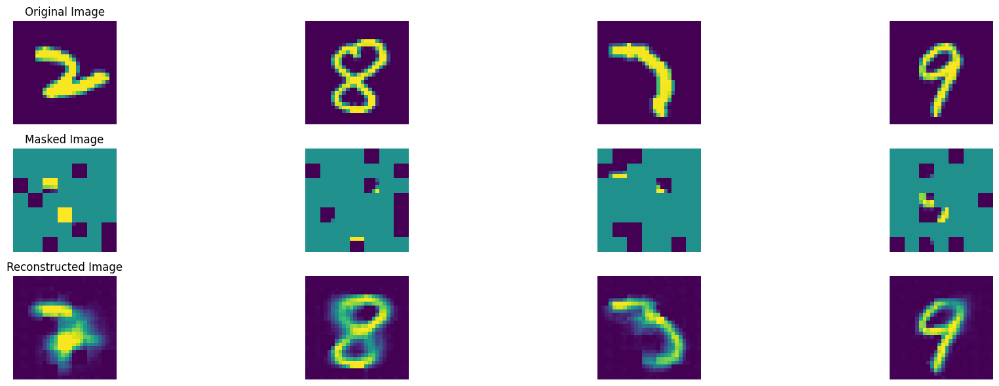

100%|██████████| 47/47 [00:08<00:00,  5.27it/s]


In epoch 95, average traning loss is 0.1347028083623724.
=================== EPOCH:  96  ===================


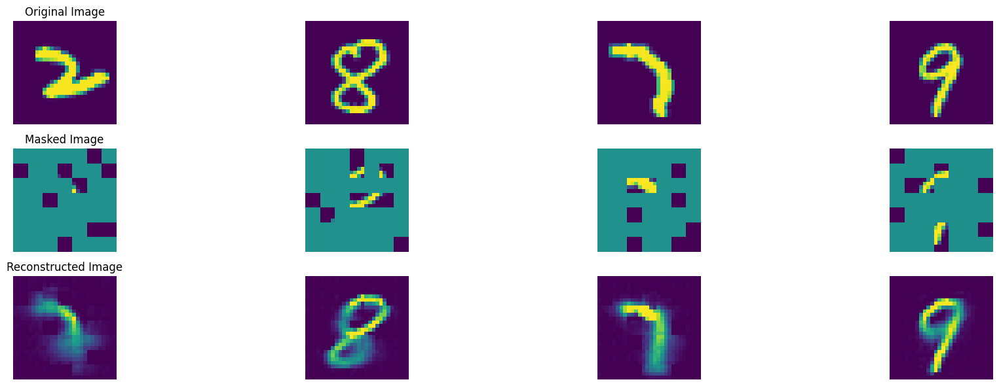

100%|██████████| 47/47 [00:09<00:00,  5.16it/s]


In epoch 96, average traning loss is 0.1339383397964721.
=================== EPOCH:  97  ===================


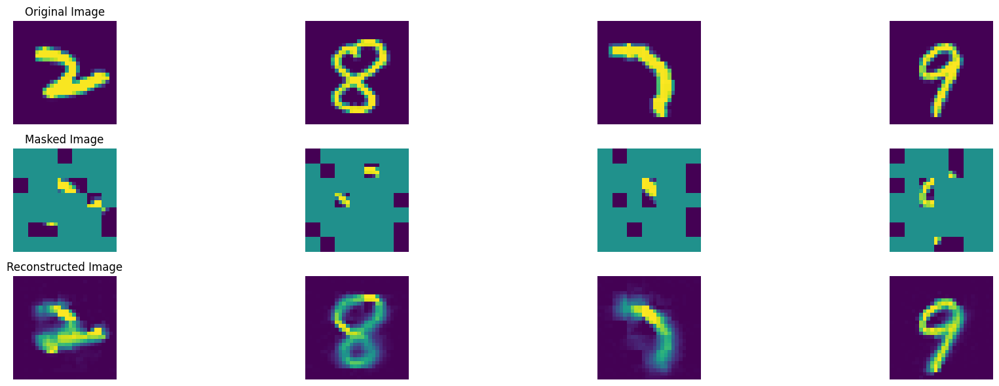

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 97, average traning loss is 0.13400808071836512.
=================== EPOCH:  98  ===================


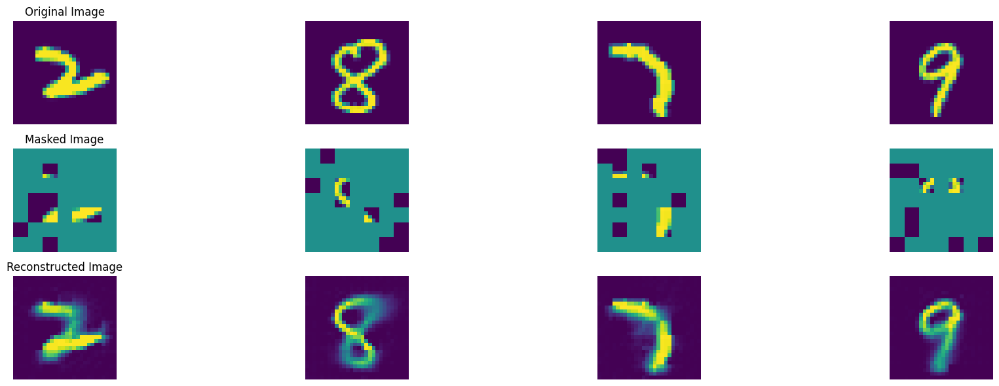

100%|██████████| 47/47 [00:09<00:00,  4.95it/s]


In epoch 98, average traning loss is 0.13326134738769937.
=================== EPOCH:  99  ===================


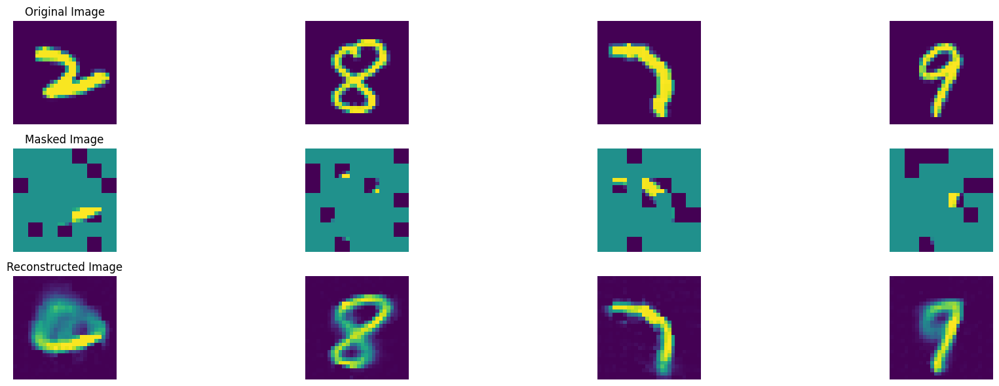

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 99, average traning loss is 0.1330386403393238.
=================== EPOCH:  100  ===================


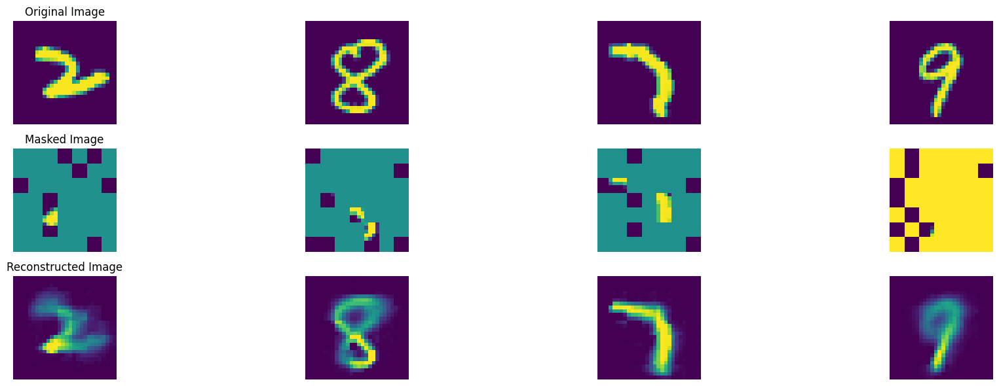

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 100, average traning loss is 0.13263932694780065.
=================== EPOCH:  101  ===================


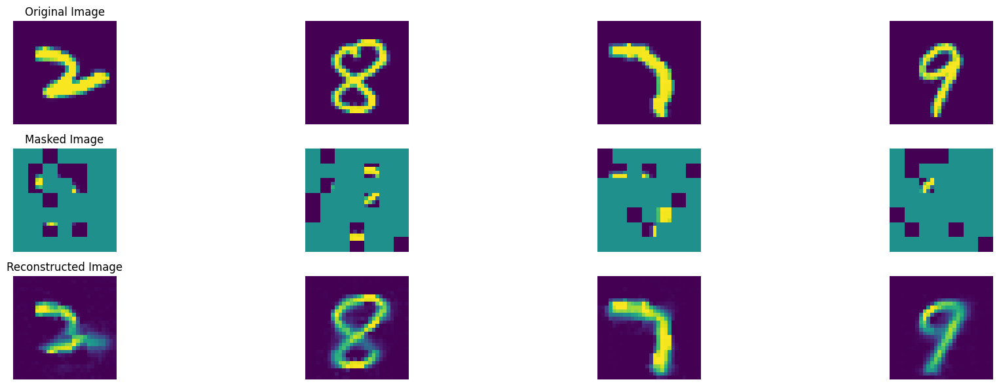

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 101, average traning loss is 0.13164654469236414.
=================== EPOCH:  102  ===================


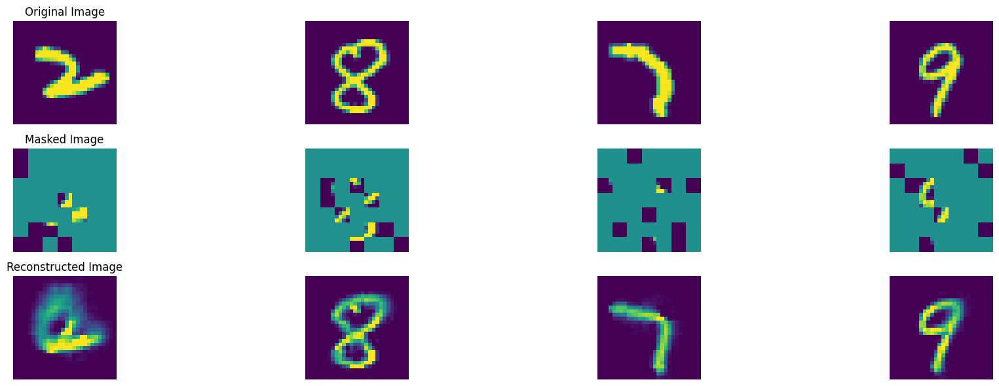

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 102, average traning loss is 0.13167238869565598.
=================== EPOCH:  103  ===================


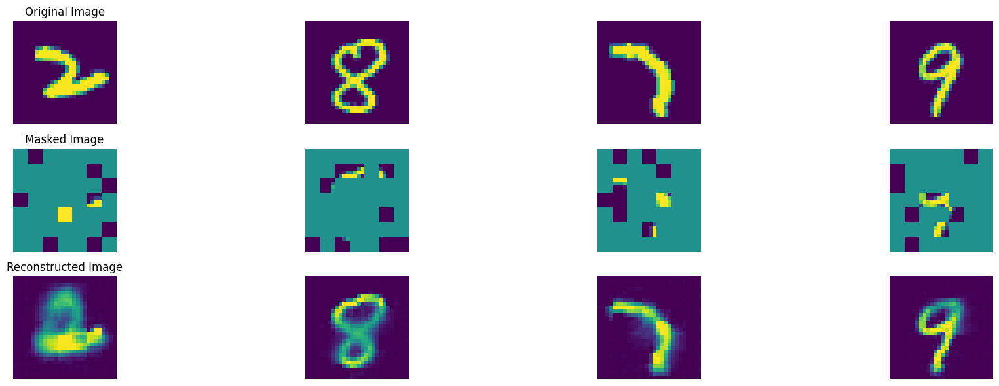

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 103, average traning loss is 0.13218056204471182.
=================== EPOCH:  104  ===================


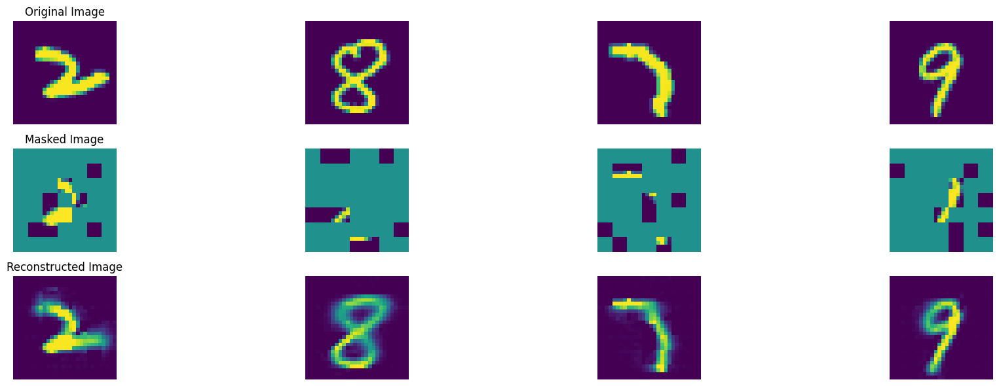

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 104, average traning loss is 0.13112461883971033.
=================== EPOCH:  105  ===================


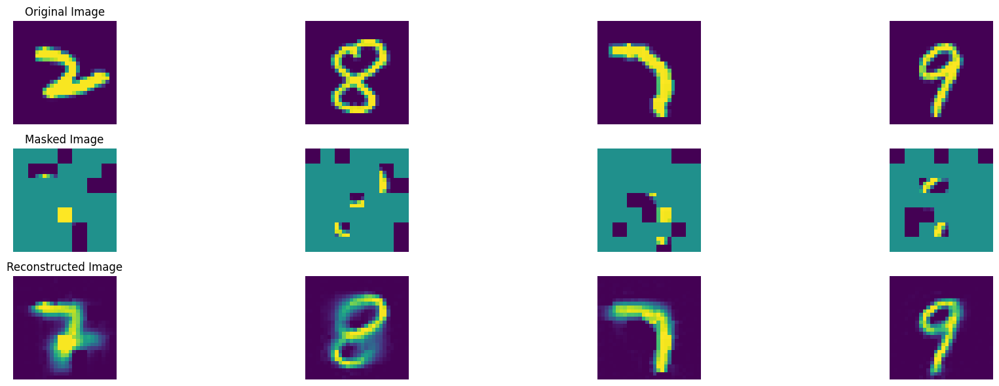

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 105, average traning loss is 0.13113946483490316.
=================== EPOCH:  106  ===================


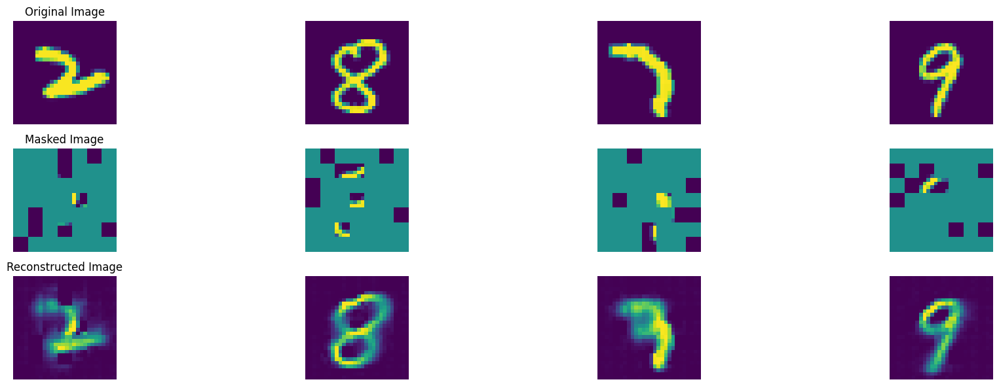

100%|██████████| 47/47 [00:08<00:00,  5.30it/s]


In epoch 106, average traning loss is 0.13054303745640086.
=================== EPOCH:  107  ===================


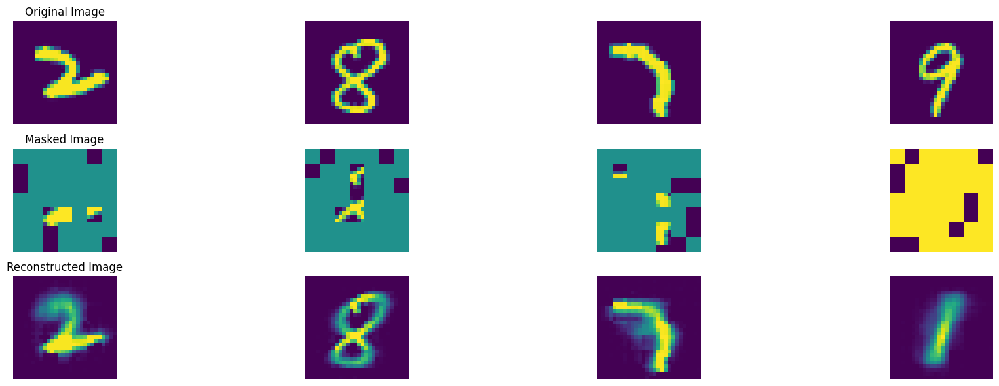

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 107, average traning loss is 0.13027769549095886.
=================== EPOCH:  108  ===================


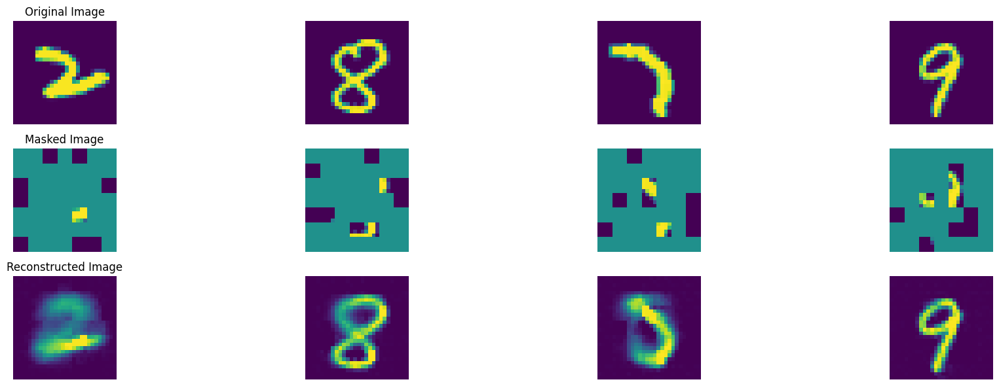

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 108, average traning loss is 0.12986680643355591.
=================== EPOCH:  109  ===================


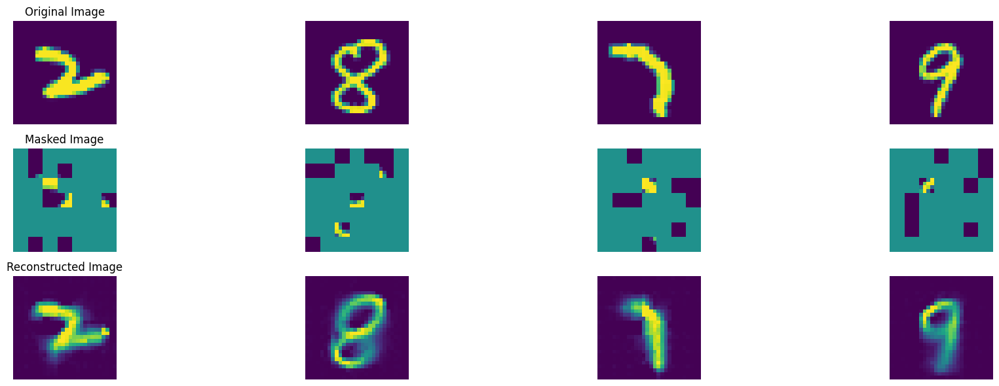

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 109, average traning loss is 0.13035361817542543.
=================== EPOCH:  110  ===================


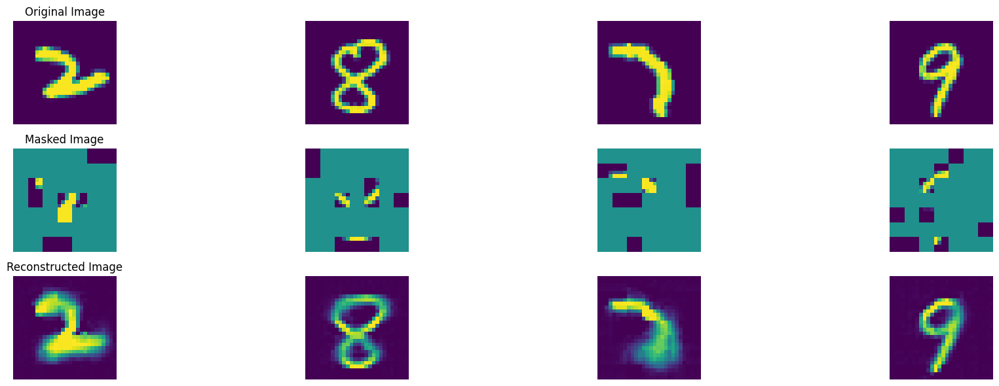

100%|██████████| 47/47 [00:08<00:00,  5.27it/s]


In epoch 110, average traning loss is 0.12947008489294254.
=================== EPOCH:  111  ===================


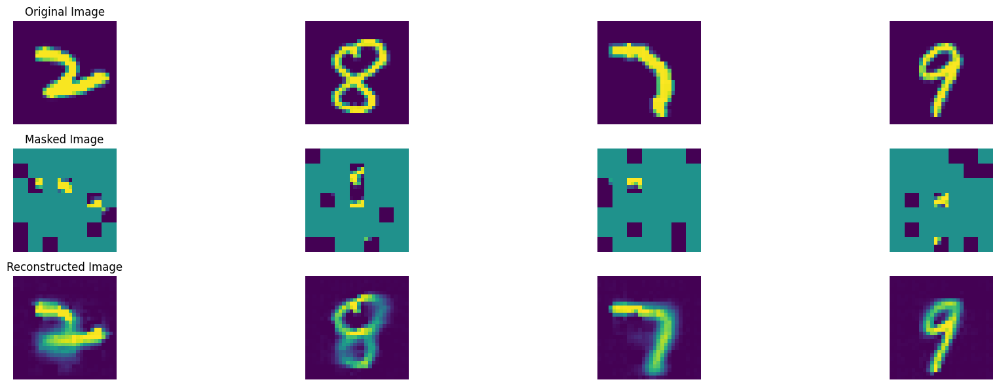

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 111, average traning loss is 0.1296418604064495.
=================== EPOCH:  112  ===================


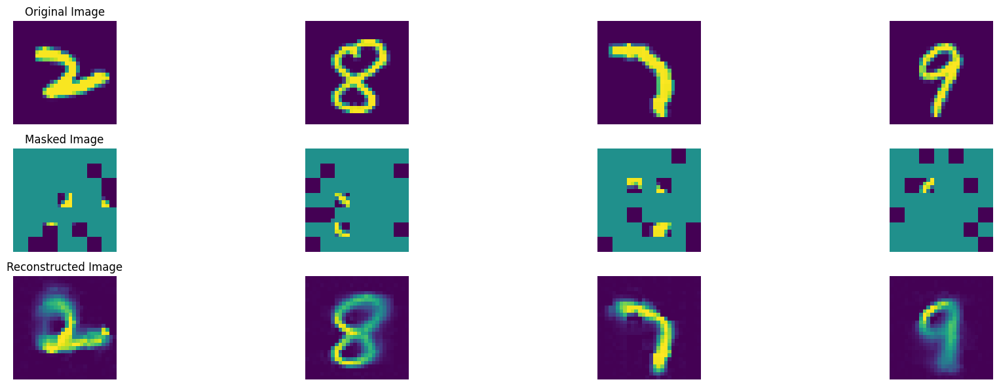

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 112, average traning loss is 0.1287363869078616.
=================== EPOCH:  113  ===================


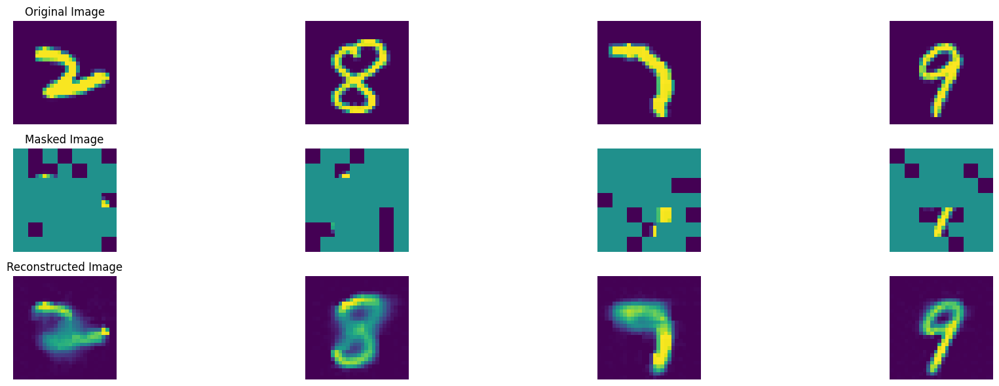

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 113, average traning loss is 0.129262350024061.
=================== EPOCH:  114  ===================


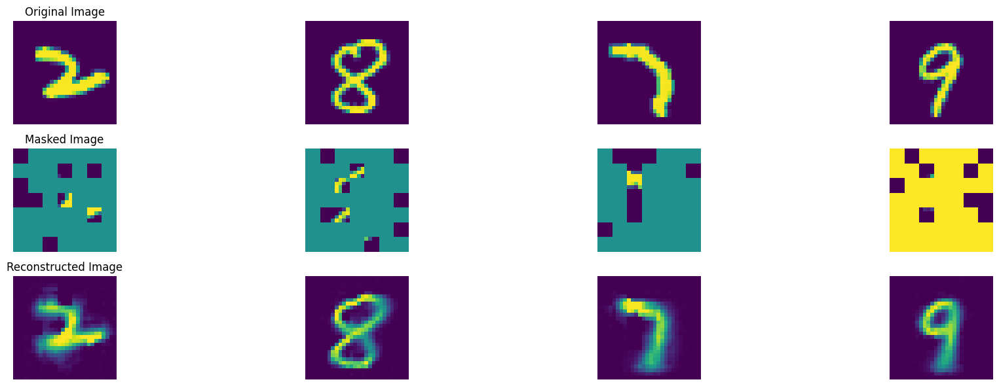

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 114, average traning loss is 0.128727839506687.
=================== EPOCH:  115  ===================


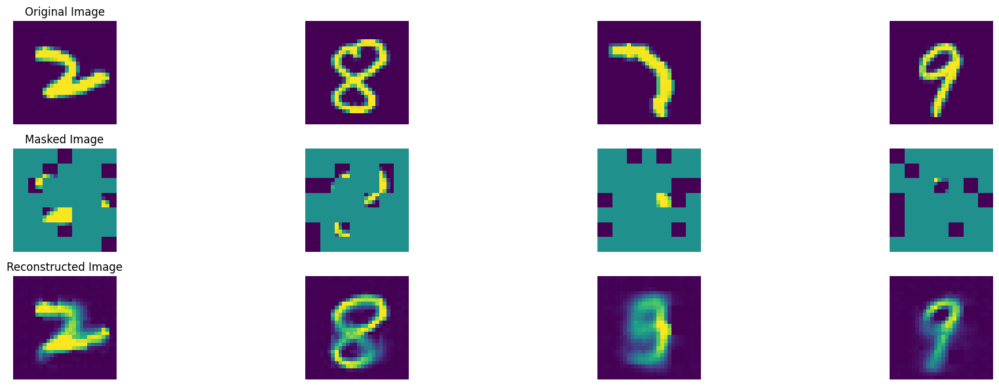

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 115, average traning loss is 0.1281559259650555.
=================== EPOCH:  116  ===================


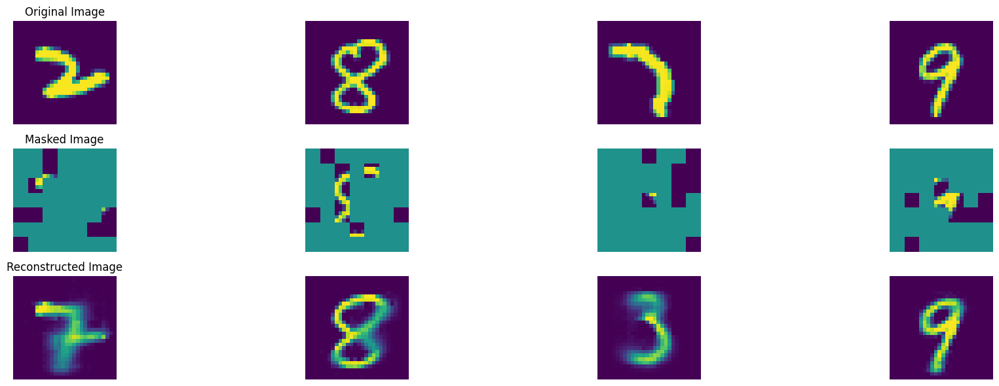

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 116, average traning loss is 0.12803909198400823.
=================== EPOCH:  117  ===================


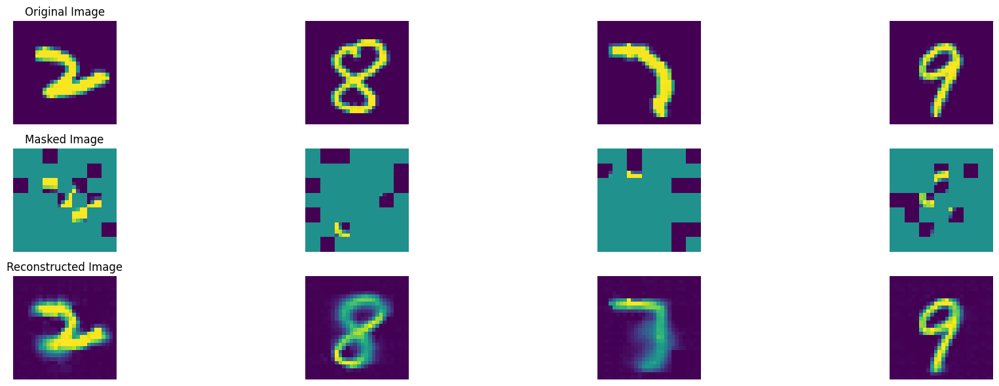

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 117, average traning loss is 0.12771889329590697.
=================== EPOCH:  118  ===================


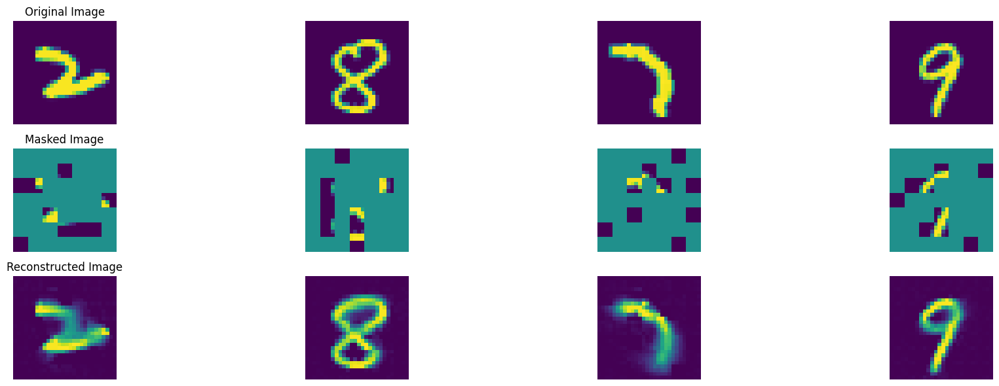

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 118, average traning loss is 0.1276338463451.
=================== EPOCH:  119  ===================


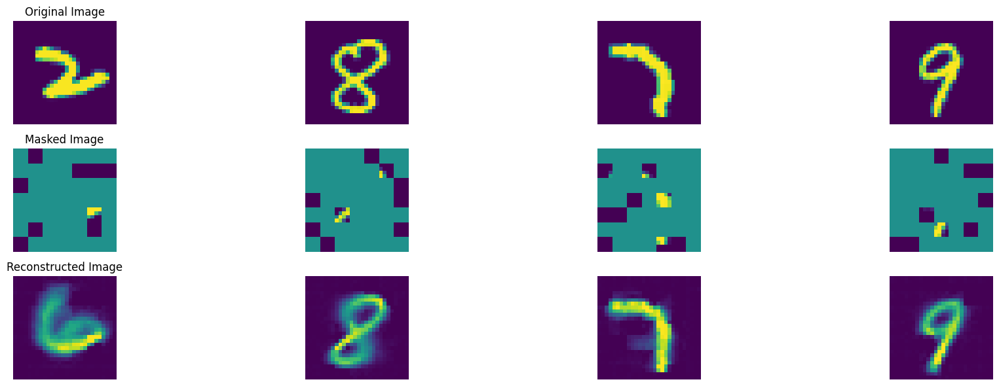

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 119, average traning loss is 0.12815983419088608.
=================== EPOCH:  120  ===================


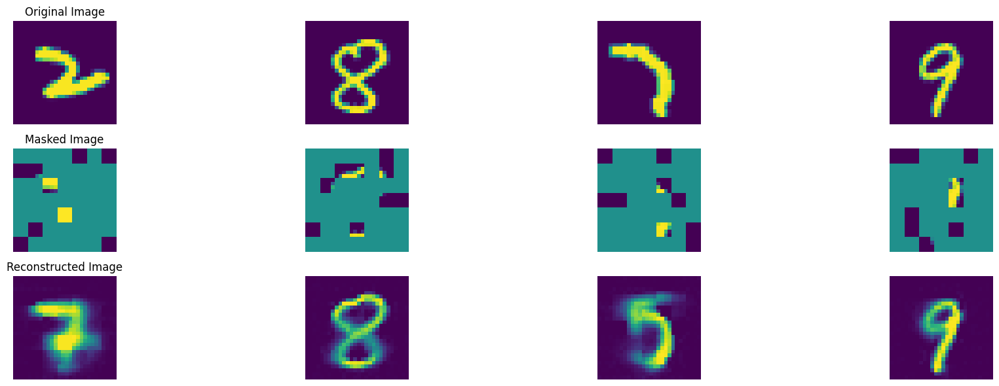

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 120, average traning loss is 0.12693288161399516.
=================== EPOCH:  121  ===================


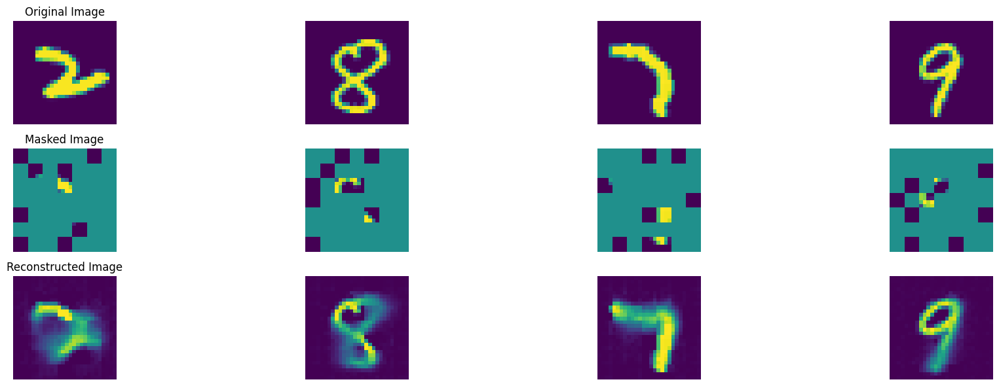

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 121, average traning loss is 0.12664327976551462.
=================== EPOCH:  122  ===================


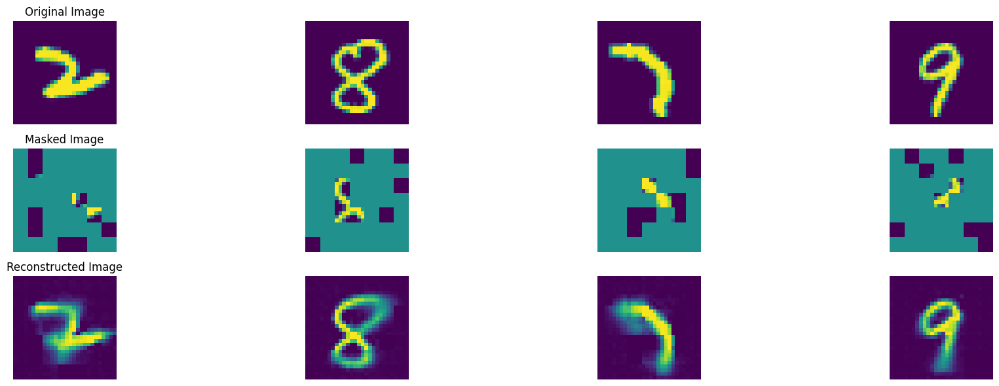

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 122, average traning loss is 0.12635512713422167.
=================== EPOCH:  123  ===================


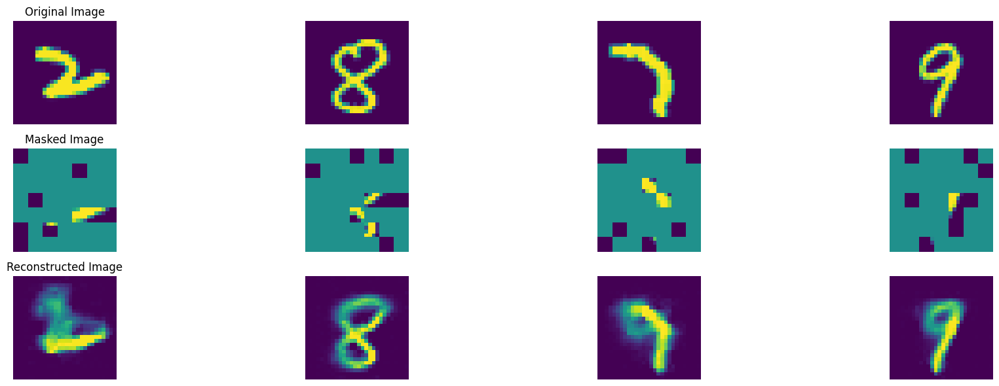

100%|██████████| 47/47 [00:09<00:00,  5.10it/s]


In epoch 123, average traning loss is 0.1262531597563561.
=================== EPOCH:  124  ===================


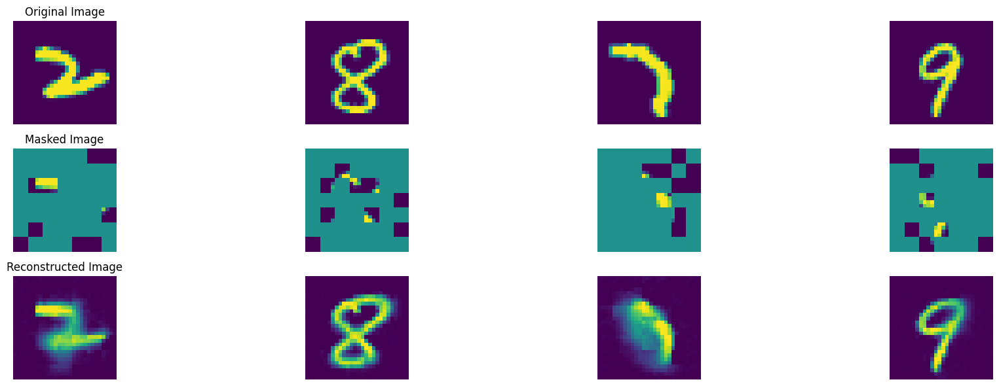

100%|██████████| 47/47 [00:08<00:00,  5.27it/s]


In epoch 124, average traning loss is 0.12593406185190728.
=================== EPOCH:  125  ===================


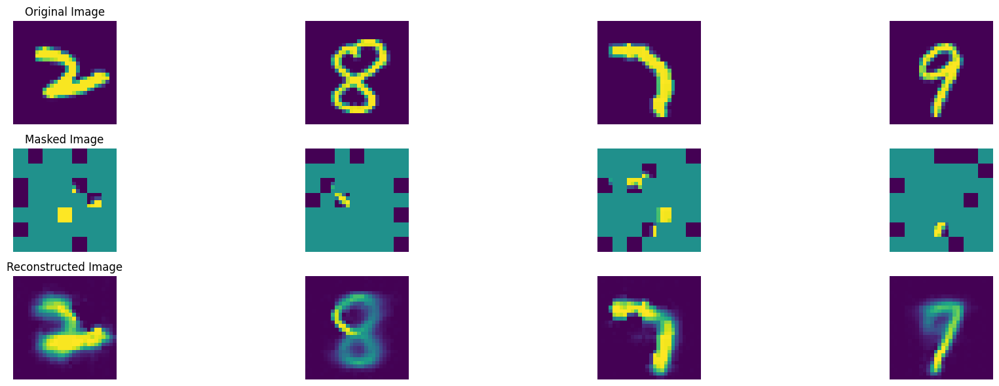

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 125, average traning loss is 0.1263509838187948.
=================== EPOCH:  126  ===================


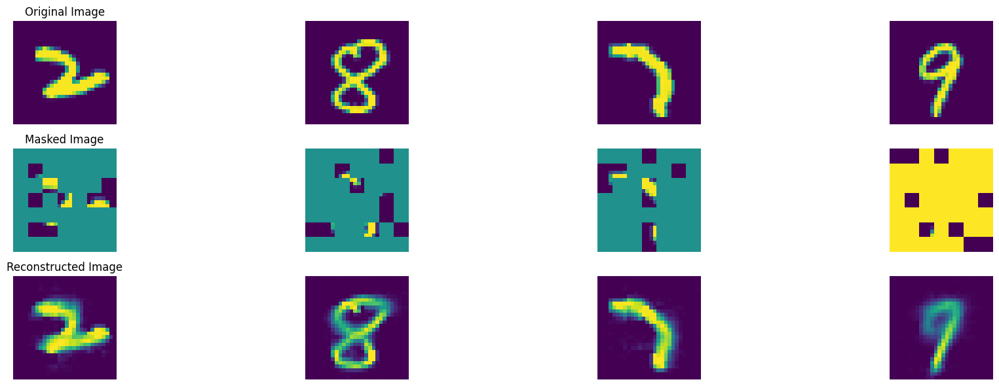

100%|██████████| 47/47 [00:08<00:00,  5.31it/s]


In epoch 126, average traning loss is 0.12637351041144512.
=================== EPOCH:  127  ===================


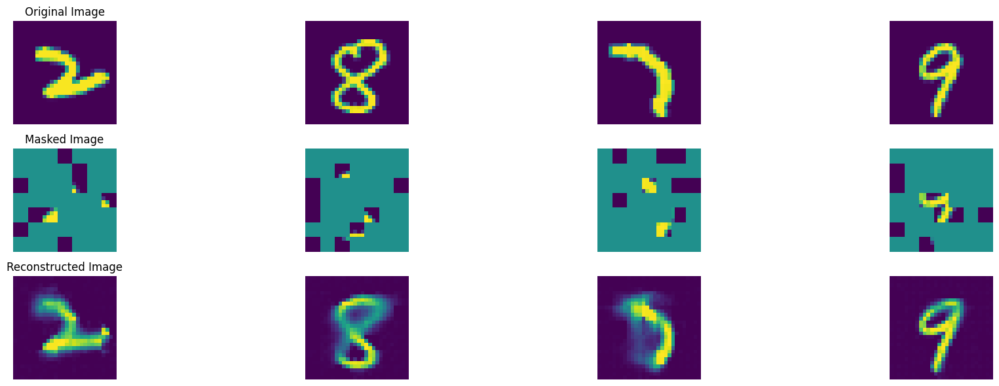

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 127, average traning loss is 0.1258347731955508.
=================== EPOCH:  128  ===================


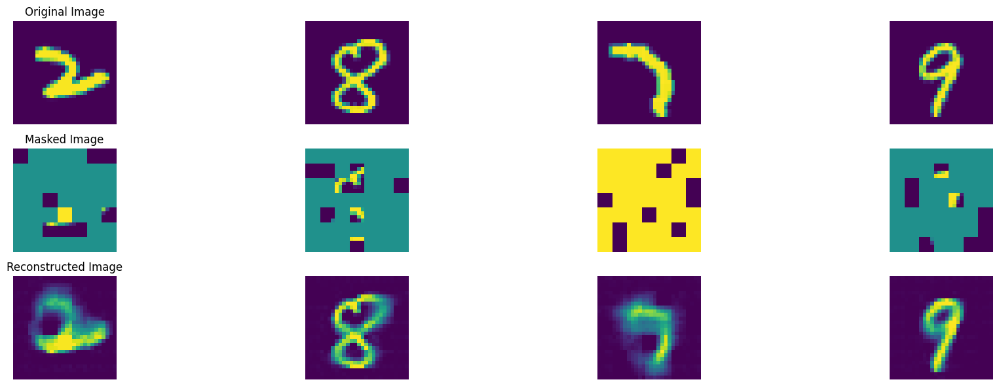

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 128, average traning loss is 0.1263367879263898.
=================== EPOCH:  129  ===================


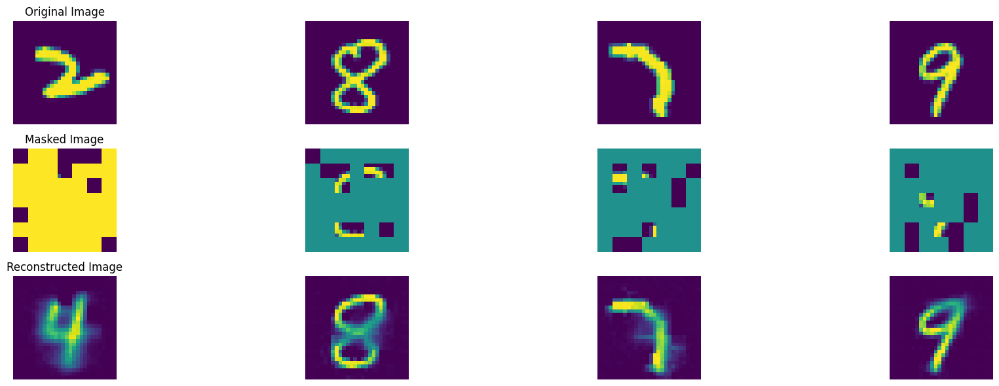

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 129, average traning loss is 0.12564133821015663.
=================== EPOCH:  130  ===================


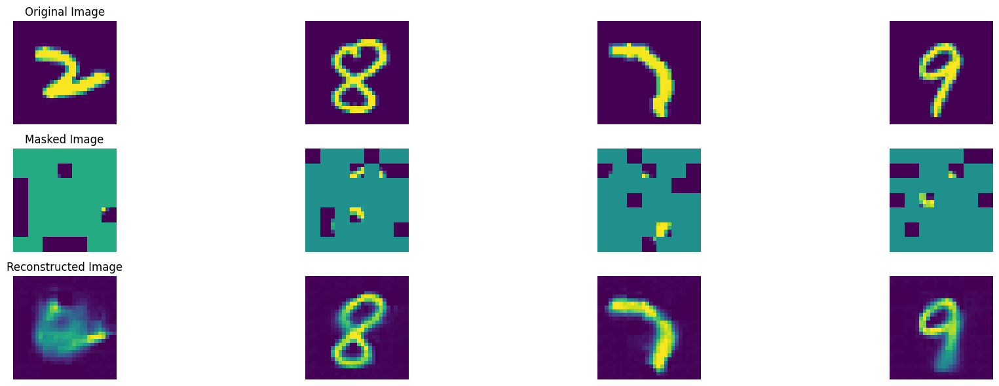

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 130, average traning loss is 0.12523418585670756.
=================== EPOCH:  131  ===================


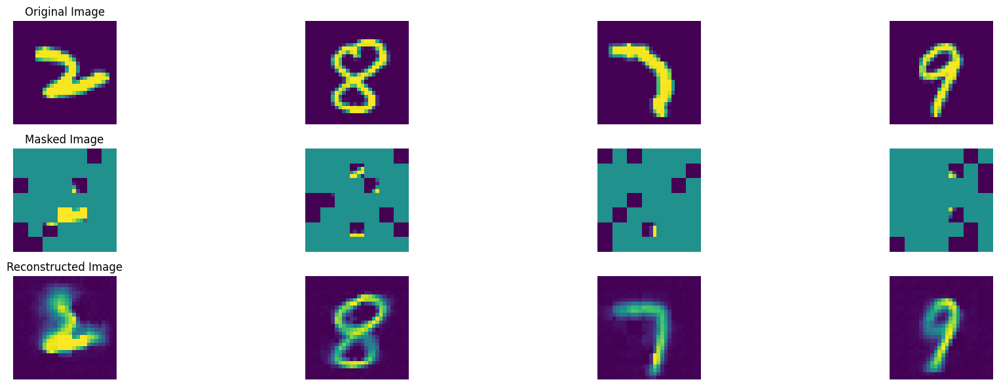

100%|██████████| 47/47 [00:08<00:00,  5.27it/s]


In epoch 131, average traning loss is 0.12485569033851014.
=================== EPOCH:  132  ===================


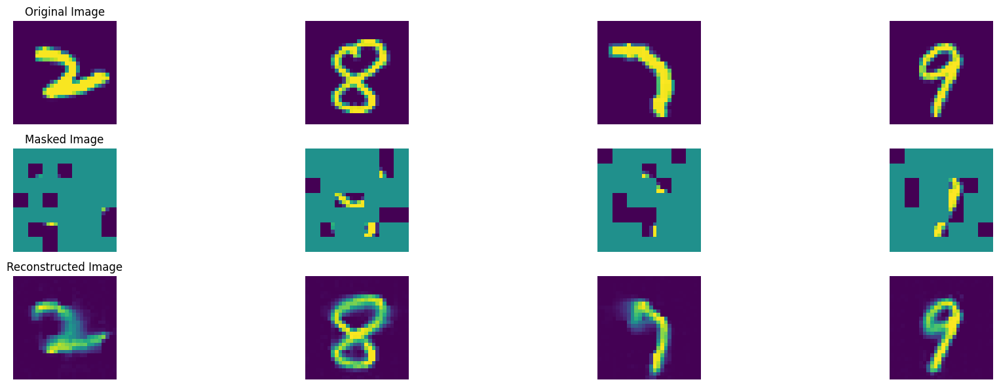

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 132, average traning loss is 0.12510521551395984.
=================== EPOCH:  133  ===================


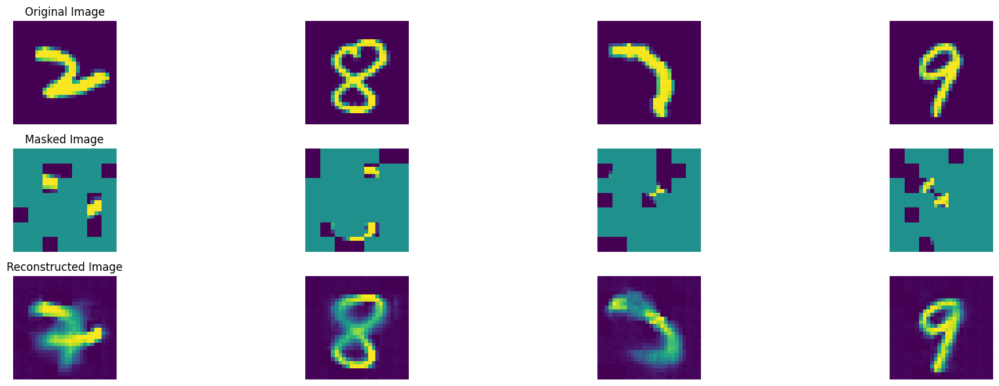

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 133, average traning loss is 0.1248194581650673.
=================== EPOCH:  134  ===================


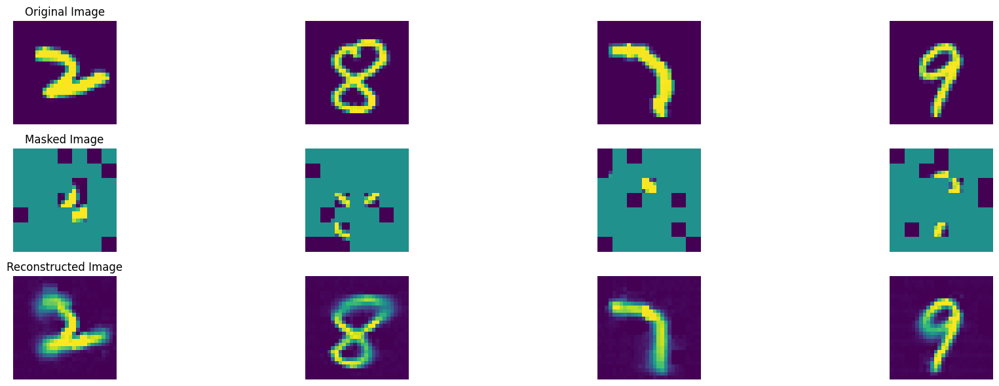

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 134, average traning loss is 0.124458169683497.
=================== EPOCH:  135  ===================


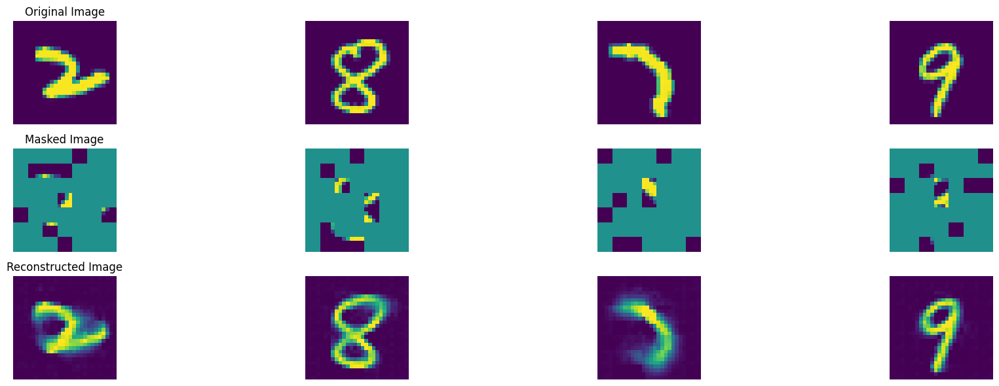

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 135, average traning loss is 0.12434842675290209.
=================== EPOCH:  136  ===================


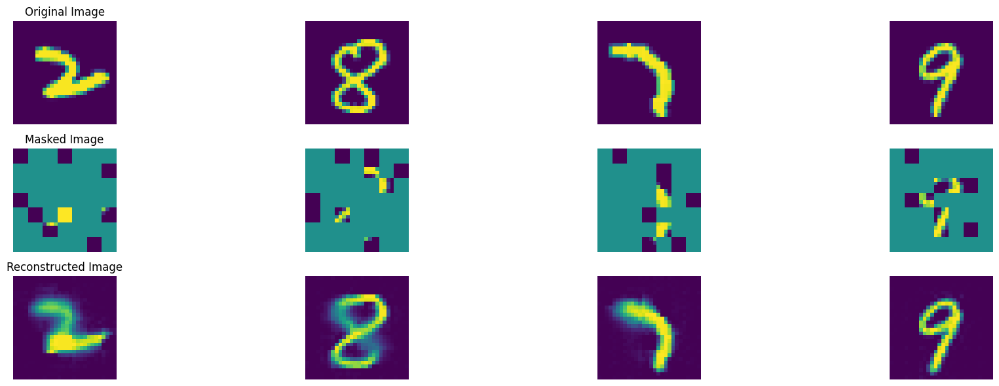

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 136, average traning loss is 0.12401325350746195.
=================== EPOCH:  137  ===================


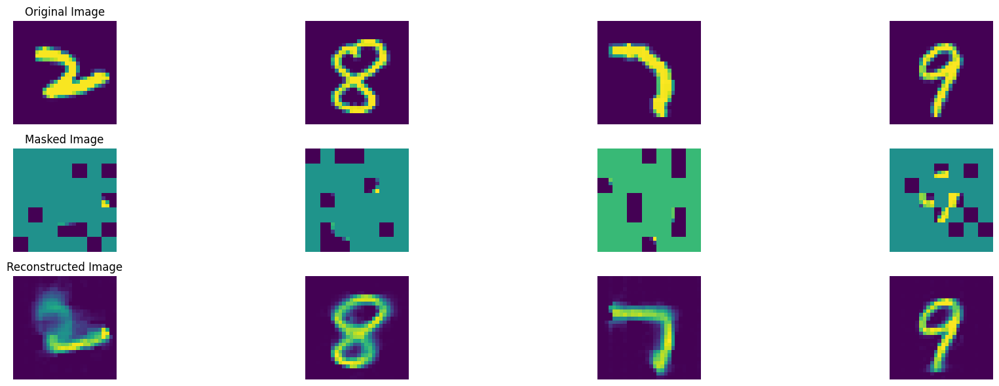

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 137, average traning loss is 0.12450753834019317.
=================== EPOCH:  138  ===================


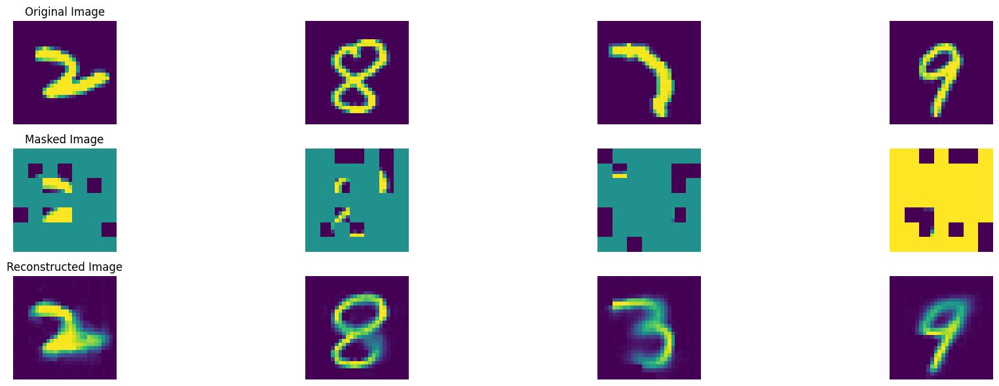

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 138, average traning loss is 0.12395845464569458.
=================== EPOCH:  139  ===================


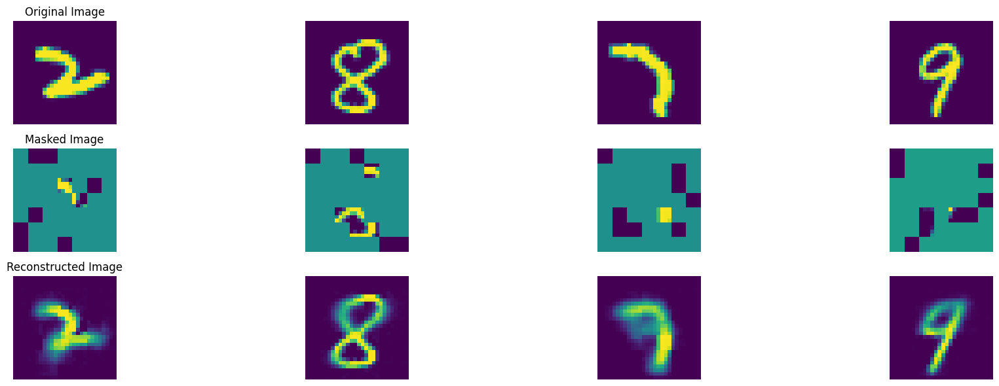

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 139, average traning loss is 0.12327232275237428.
=================== EPOCH:  140  ===================


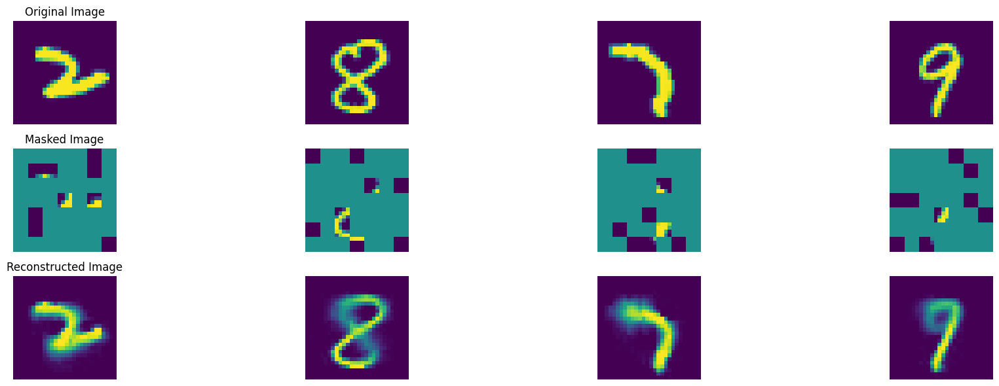

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 140, average traning loss is 0.12323840342937632.
=================== EPOCH:  141  ===================


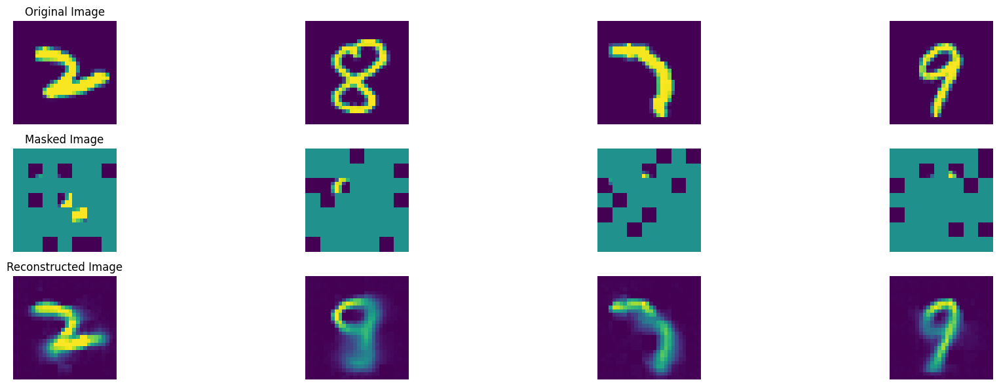

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 141, average traning loss is 0.12329874076741806.
=================== EPOCH:  142  ===================


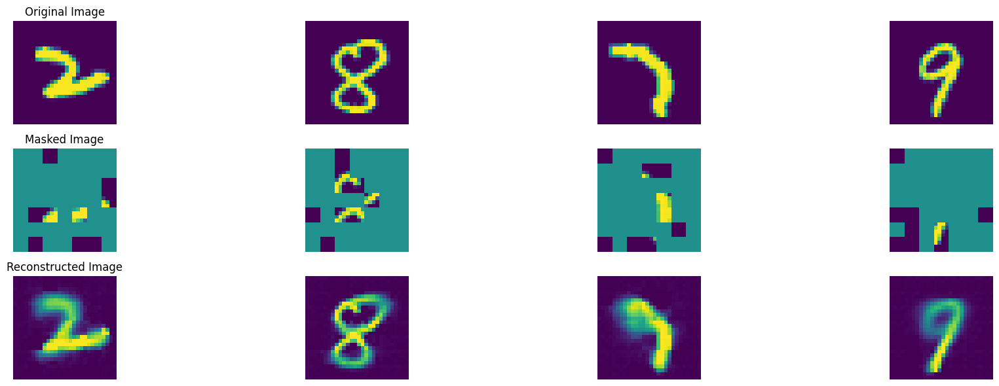

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 142, average traning loss is 0.12341282627684005.
=================== EPOCH:  143  ===================


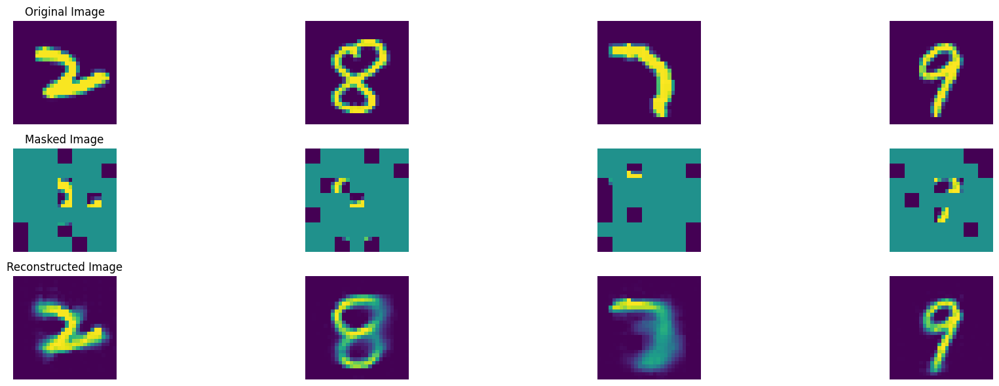

100%|██████████| 47/47 [00:08<00:00,  5.30it/s]


In epoch 143, average traning loss is 0.12261082342964538.
=================== EPOCH:  144  ===================


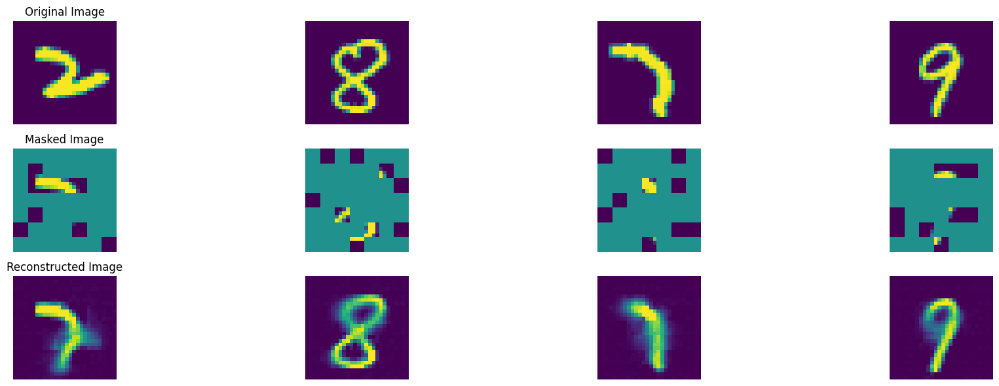

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 144, average traning loss is 0.123035784255951.
=================== EPOCH:  145  ===================


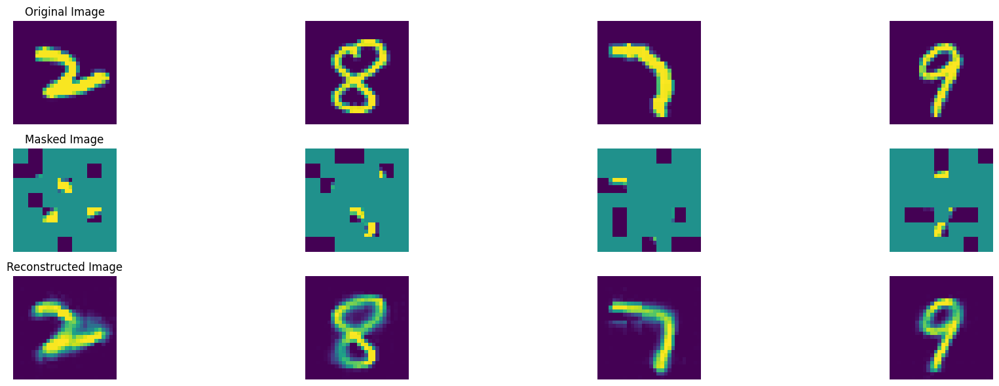

100%|██████████| 47/47 [00:08<00:00,  5.29it/s]


In epoch 145, average traning loss is 0.12215750759586375.
=================== EPOCH:  146  ===================


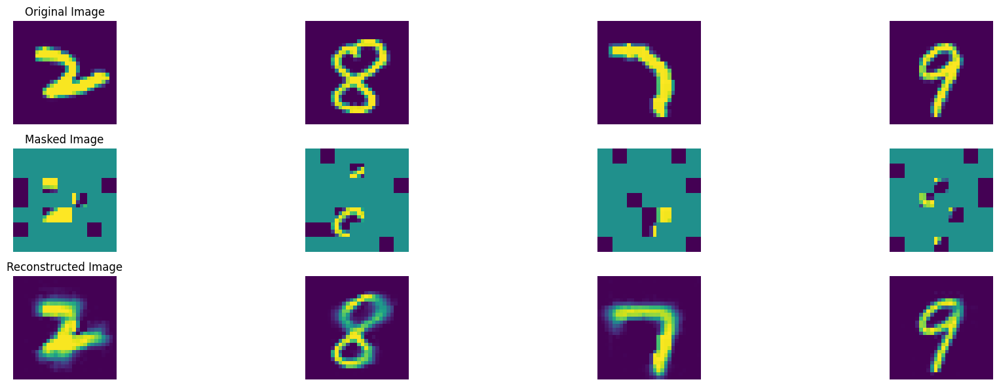

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 146, average traning loss is 0.12243304322374628.
=================== EPOCH:  147  ===================


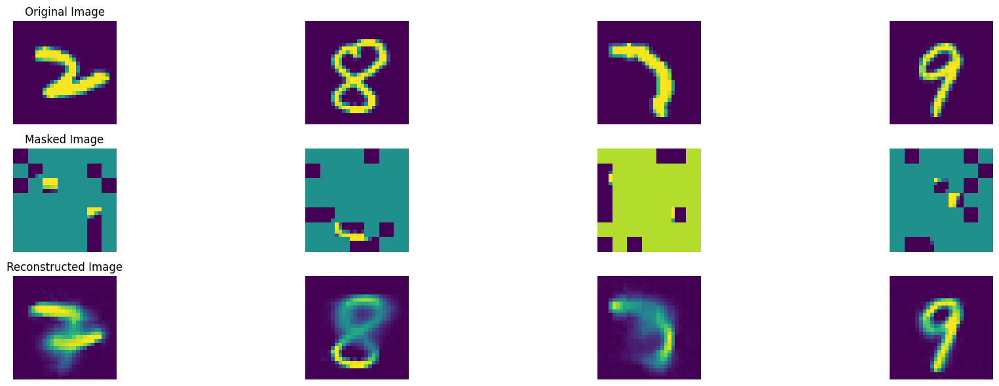

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 147, average traning loss is 0.12251045221978045.
=================== EPOCH:  148  ===================


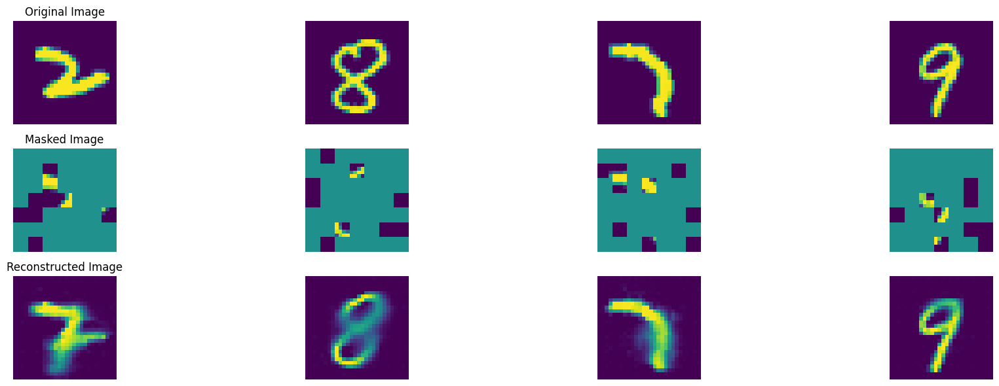

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 148, average traning loss is 0.12217028550011047.
=================== EPOCH:  149  ===================


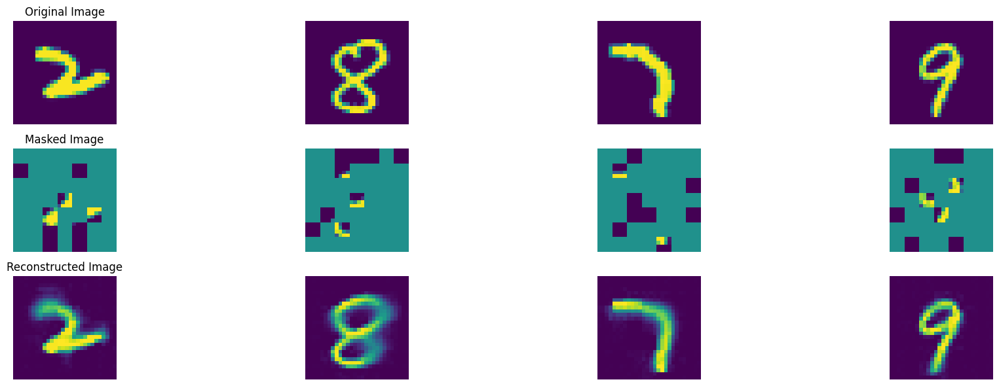

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 149, average traning loss is 0.12233730389716778.
=================== EPOCH:  150  ===================


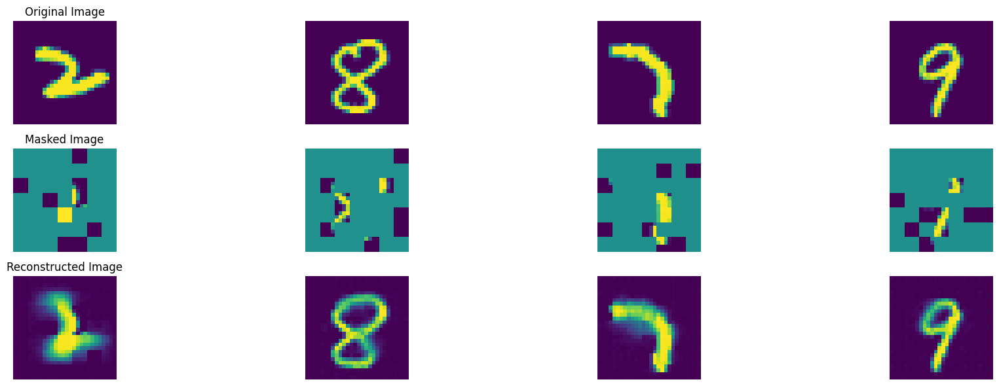

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 150, average traning loss is 0.1219324176298811.
=================== EPOCH:  151  ===================


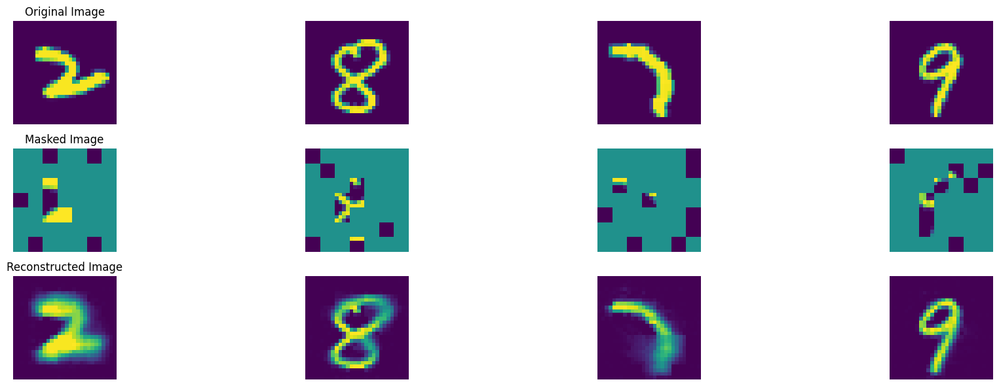

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 151, average traning loss is 0.12186886068988353.
=================== EPOCH:  152  ===================


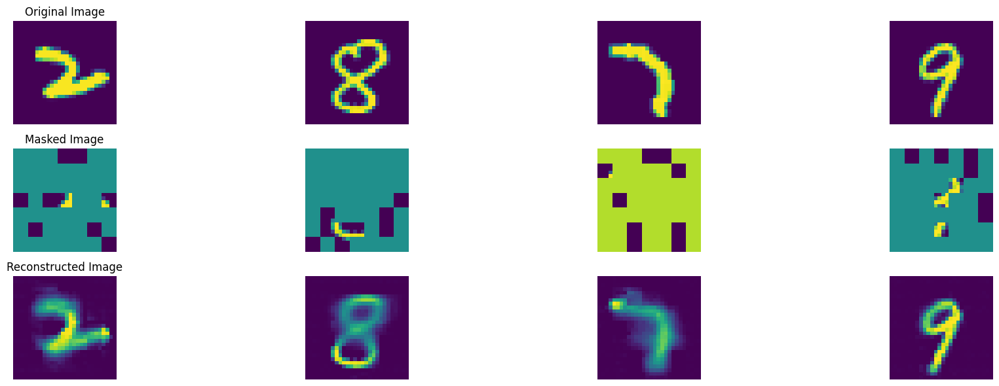

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 152, average traning loss is 0.1219361812827435.
=================== EPOCH:  153  ===================


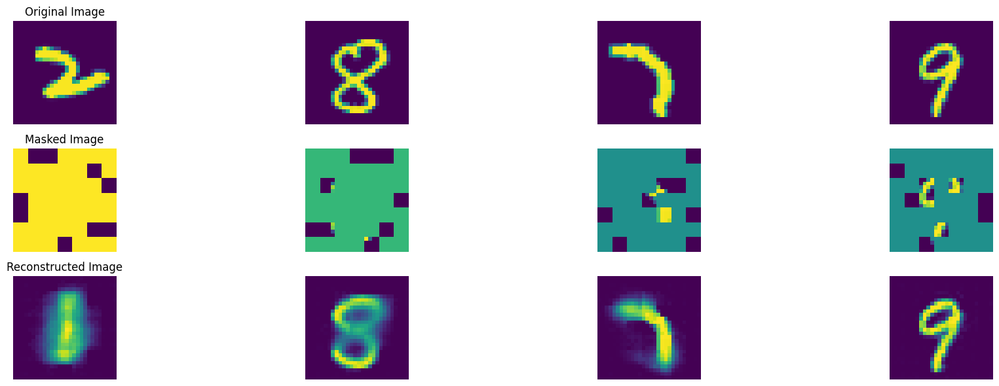

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 153, average traning loss is 0.122123861566503.
=================== EPOCH:  154  ===================


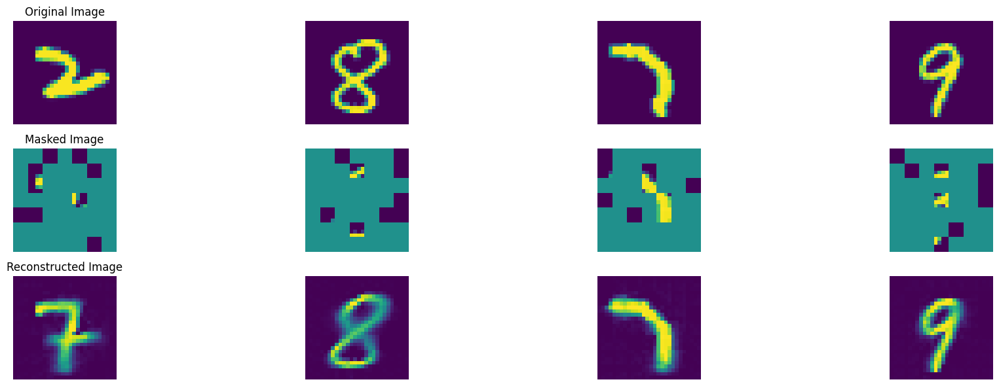

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 154, average traning loss is 0.12132490331188162.
=================== EPOCH:  155  ===================


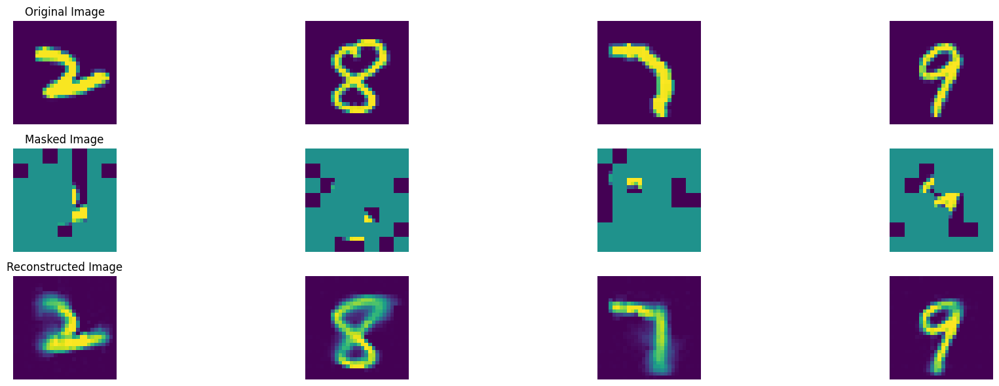

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 155, average traning loss is 0.12146781701990898.
=================== EPOCH:  156  ===================


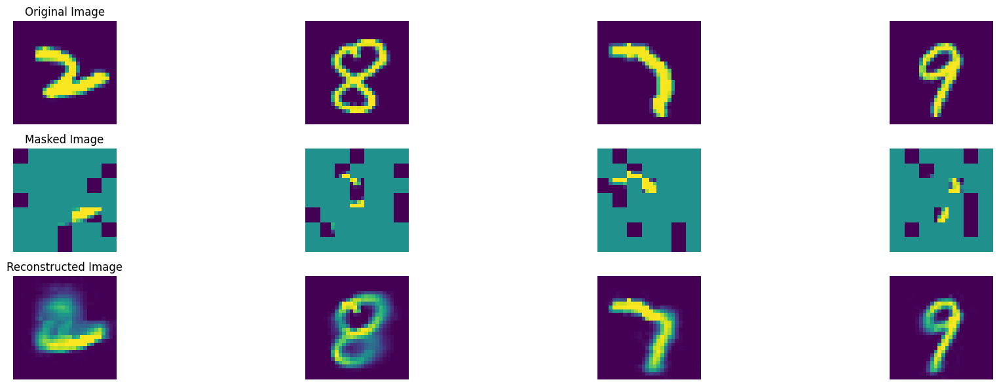

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 156, average traning loss is 0.12187867627498951.
=================== EPOCH:  157  ===================


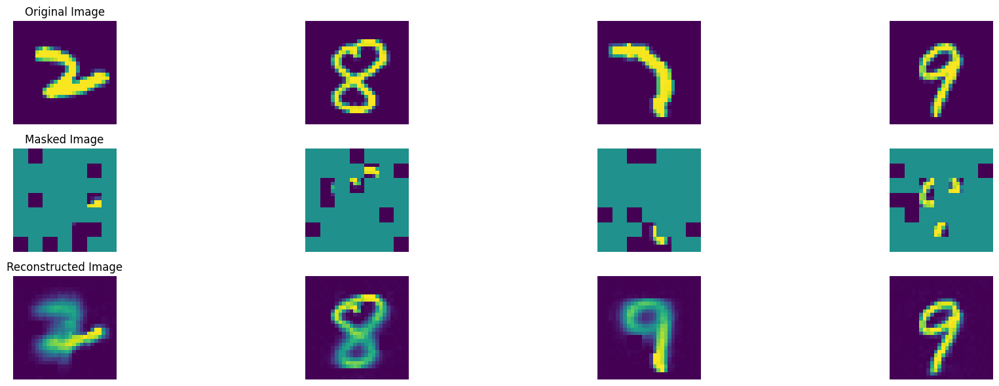

100%|██████████| 47/47 [00:08<00:00,  5.28it/s]


In epoch 157, average traning loss is 0.1208003559645186.
=================== EPOCH:  158  ===================


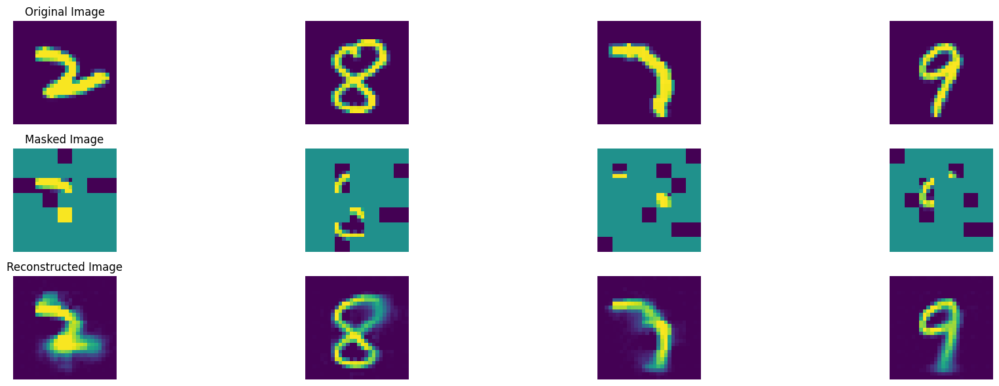

100%|██████████| 47/47 [00:09<00:00,  5.14it/s]


In epoch 158, average traning loss is 0.1213261255241455.
=================== EPOCH:  159  ===================


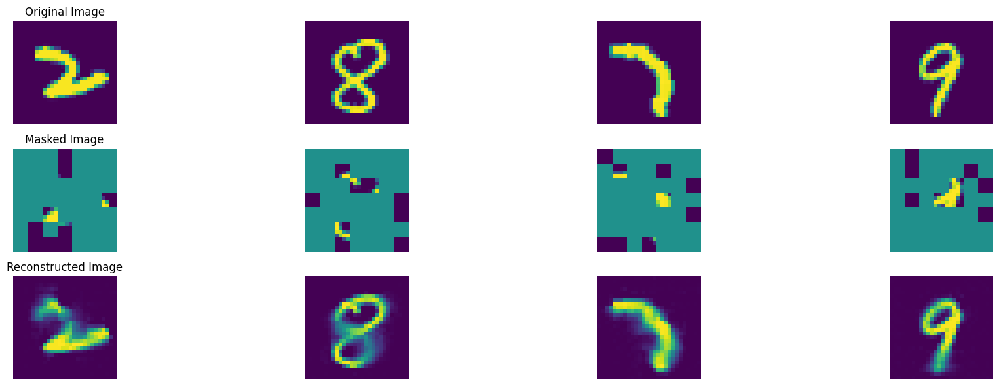

100%|██████████| 47/47 [00:09<00:00,  5.11it/s]


In epoch 159, average traning loss is 0.12044614965611315.
=================== EPOCH:  160  ===================


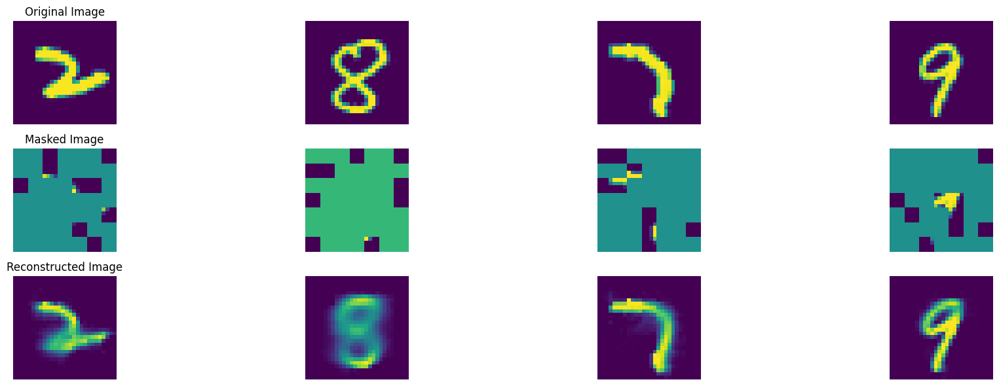

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 160, average traning loss is 0.12120596890119796.
=================== EPOCH:  161  ===================


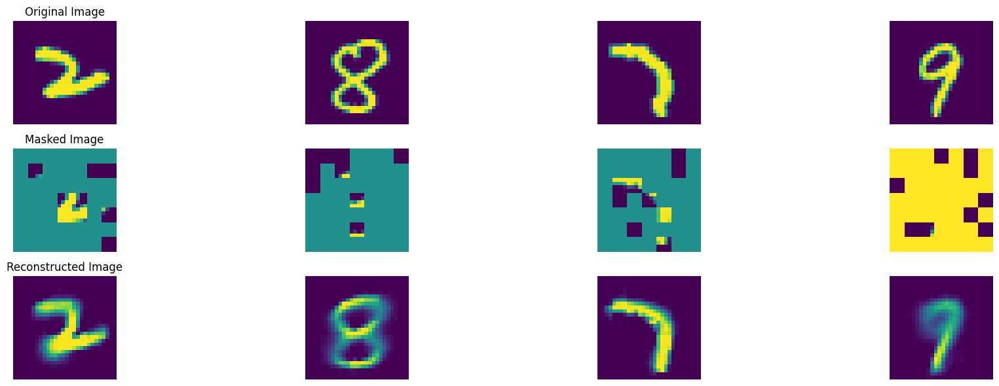

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 161, average traning loss is 0.12126206670035707.
=================== EPOCH:  162  ===================


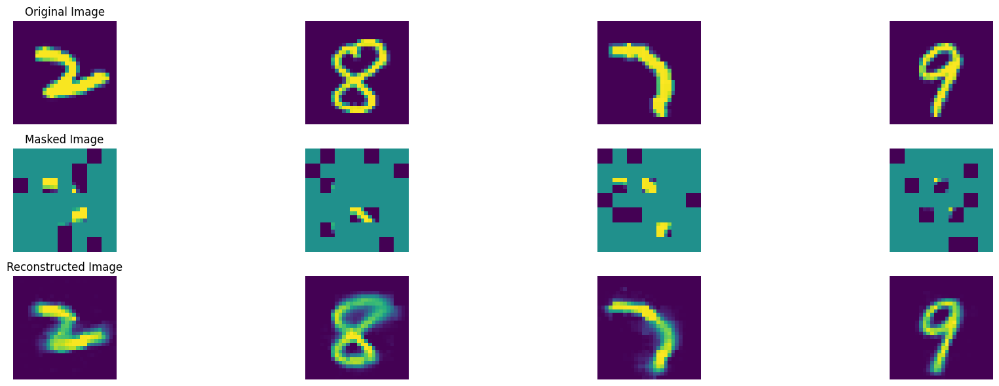

100%|██████████| 47/47 [00:08<00:00,  5.31it/s]


In epoch 162, average traning loss is 0.12075526235585517.
=================== EPOCH:  163  ===================


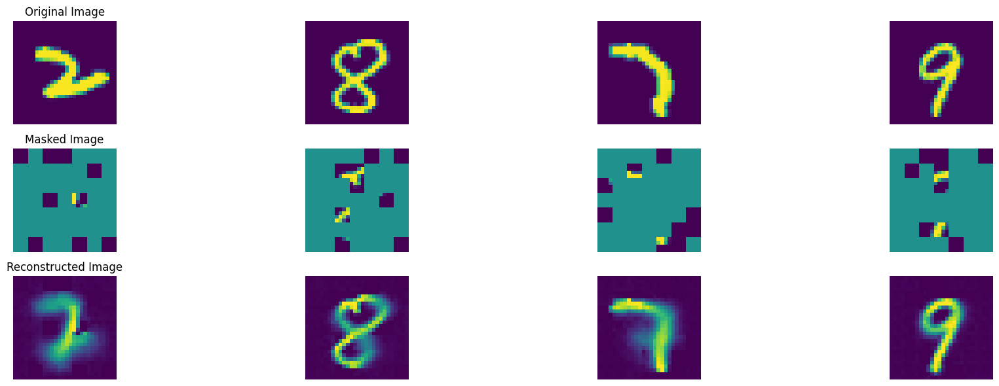

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 163, average traning loss is 0.12020375214992686.
=================== EPOCH:  164  ===================


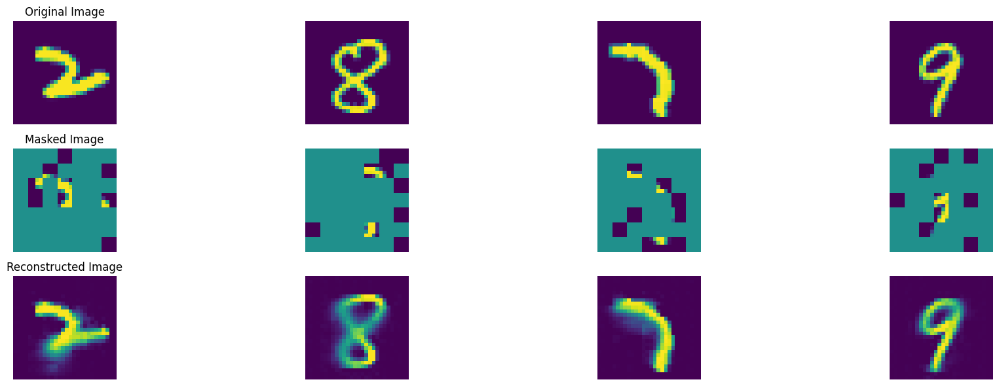

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 164, average traning loss is 0.12087451191024577.
=================== EPOCH:  165  ===================


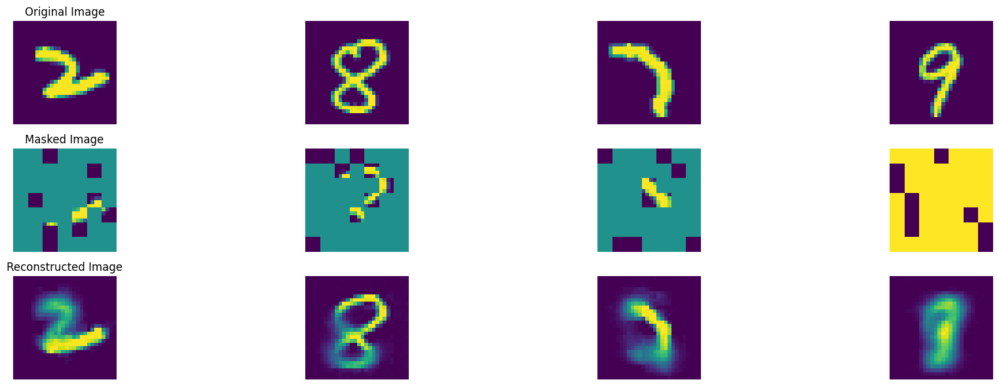

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 165, average traning loss is 0.12007284798520676.
=================== EPOCH:  166  ===================


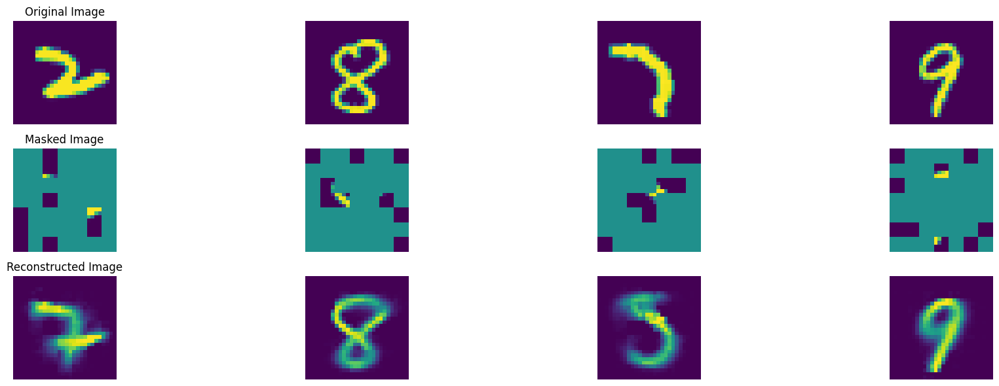

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 166, average traning loss is 0.12003148267877863.
=================== EPOCH:  167  ===================


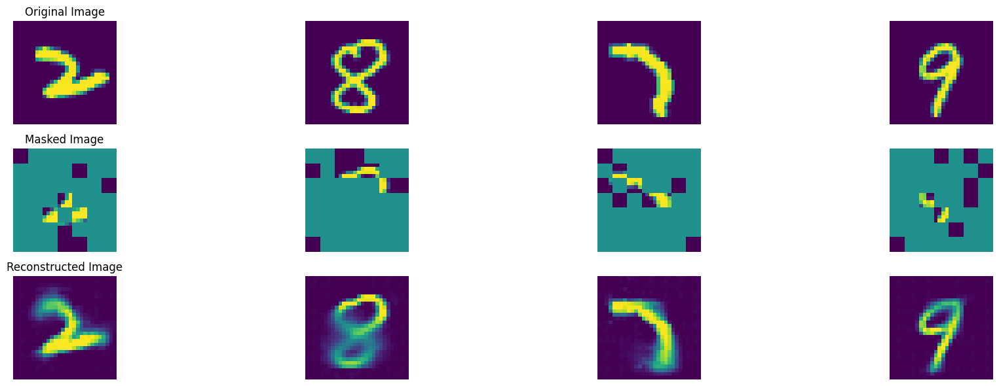

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 167, average traning loss is 0.12014567741054169.
=================== EPOCH:  168  ===================


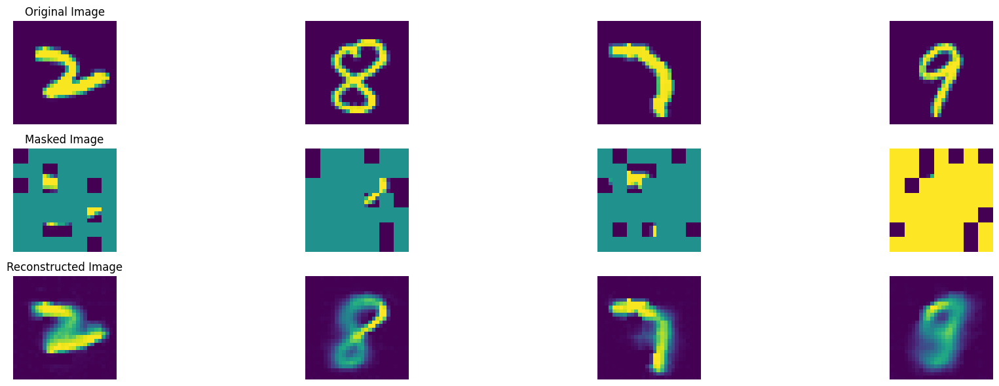

100%|██████████| 47/47 [00:08<00:00,  5.30it/s]


In epoch 168, average traning loss is 0.12006795136852468.
=================== EPOCH:  169  ===================


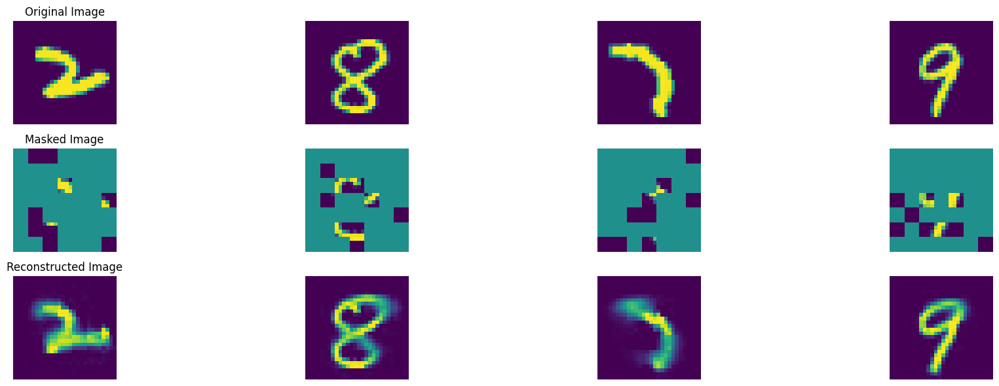

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 169, average traning loss is 0.11971297035826013.
=================== EPOCH:  170  ===================


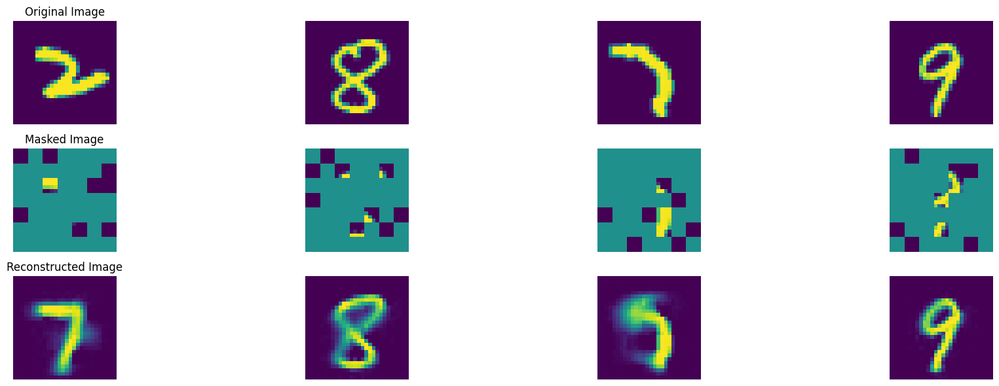

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 170, average traning loss is 0.12048366237828072.
=================== EPOCH:  171  ===================


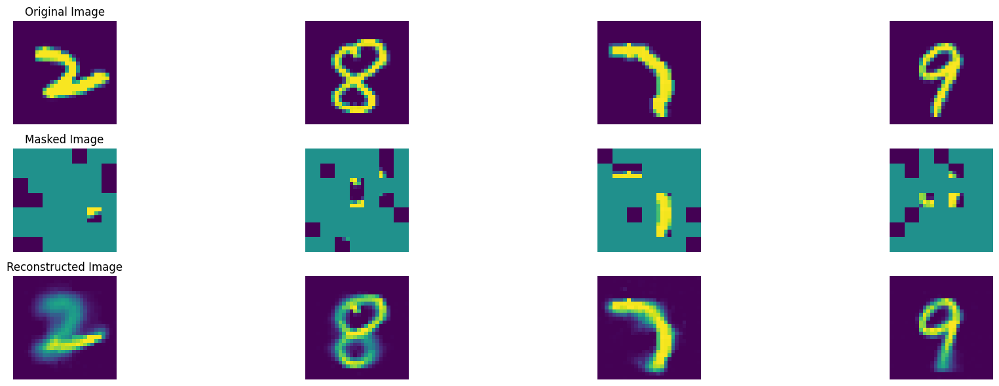

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 171, average traning loss is 0.11975325105038095.
=================== EPOCH:  172  ===================


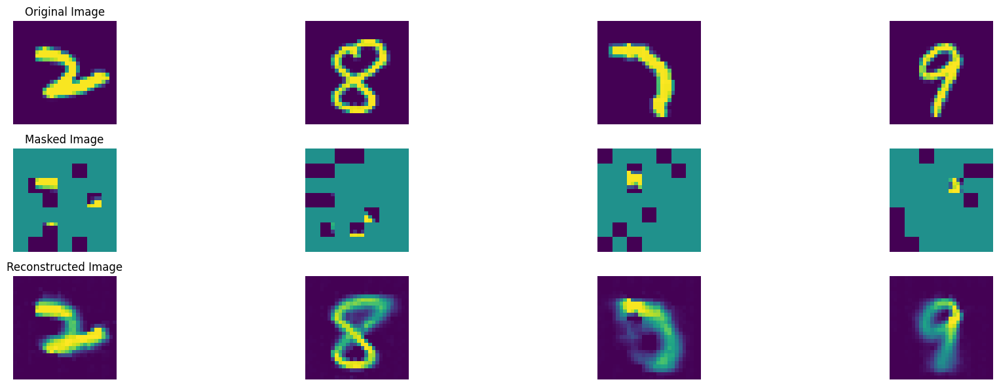

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 172, average traning loss is 0.11964294631430443.
=================== EPOCH:  173  ===================


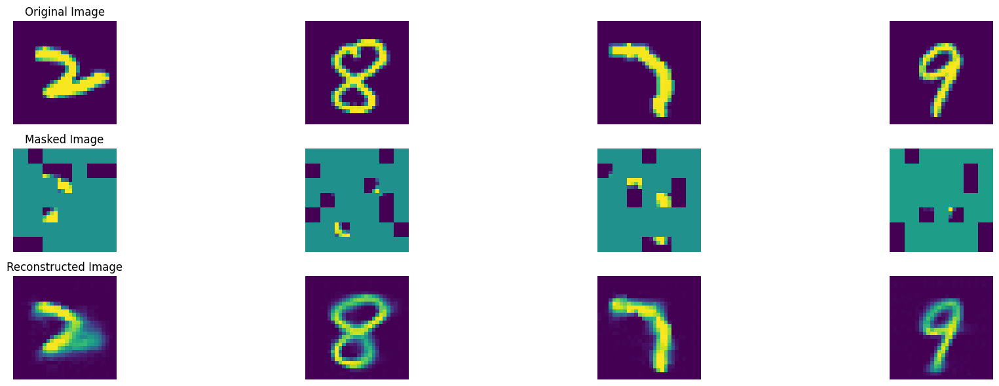

100%|██████████| 47/47 [00:08<00:00,  5.31it/s]


In epoch 173, average traning loss is 0.11915776529844771.
=================== EPOCH:  174  ===================


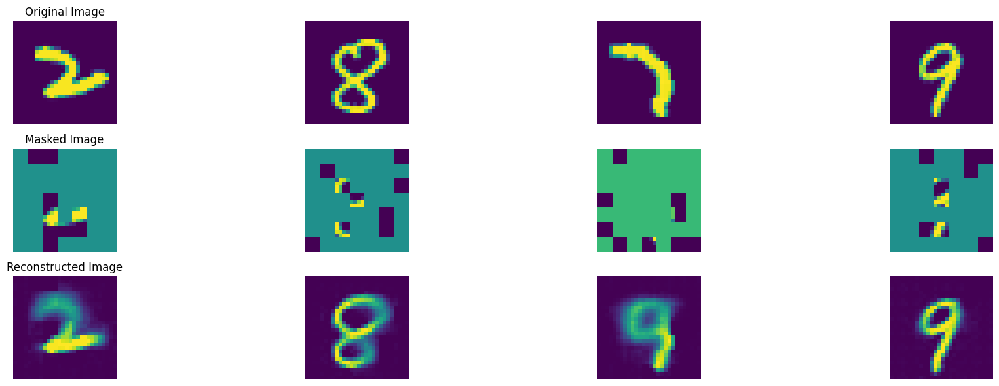

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 174, average traning loss is 0.11905223020213715.
=================== EPOCH:  175  ===================


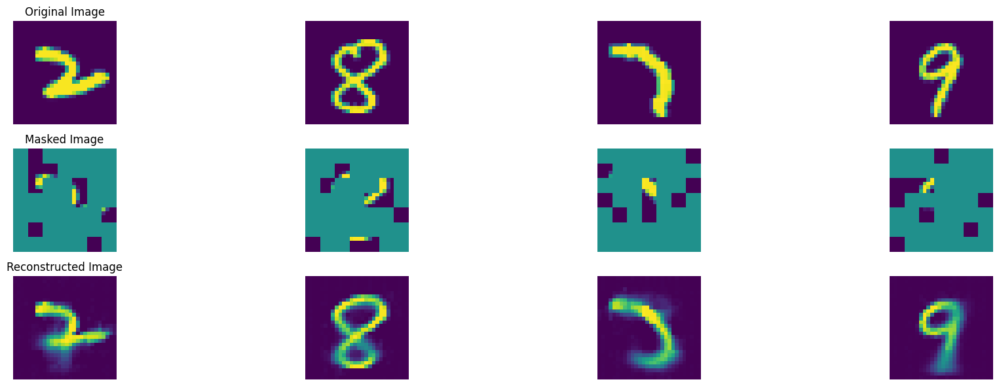

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 175, average traning loss is 0.11921050399541855.
=================== EPOCH:  176  ===================


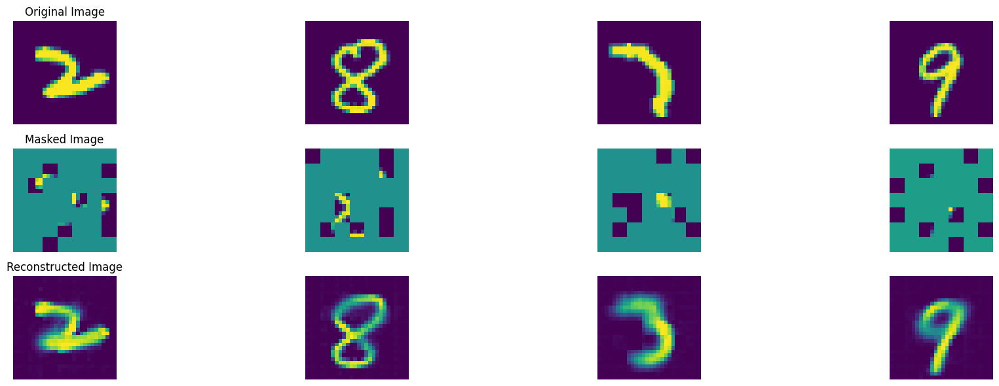

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 176, average traning loss is 0.11890264093241792.
=================== EPOCH:  177  ===================


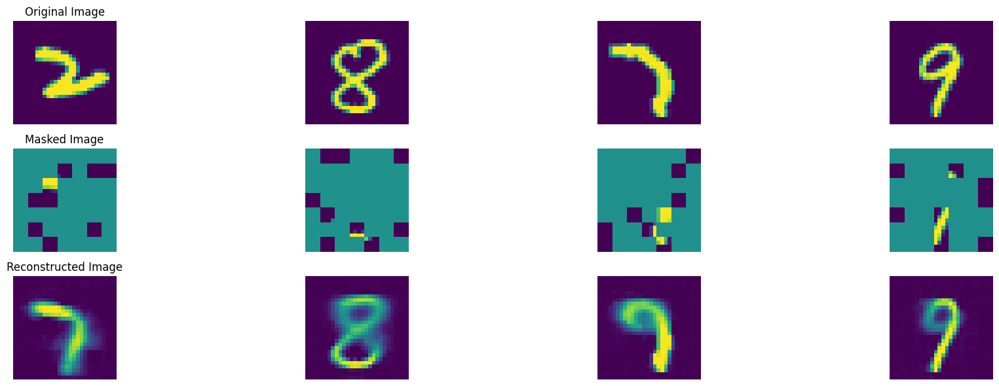

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 177, average traning loss is 0.11945728038219695.
=================== EPOCH:  178  ===================


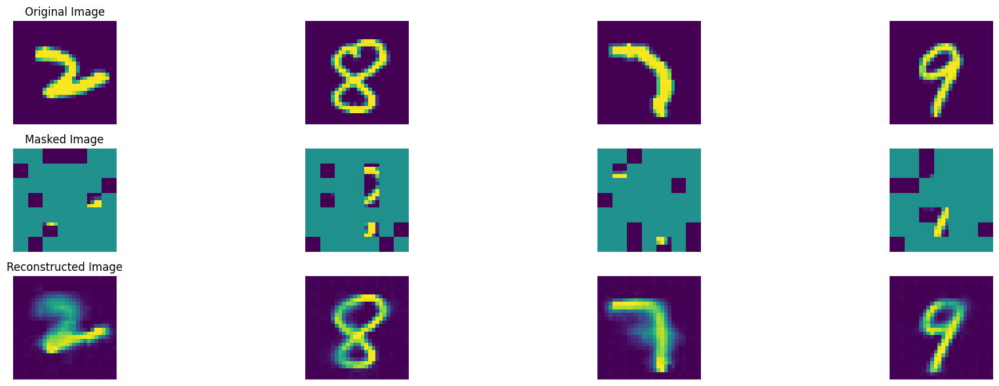

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 178, average traning loss is 0.11882546417256619.
=================== EPOCH:  179  ===================


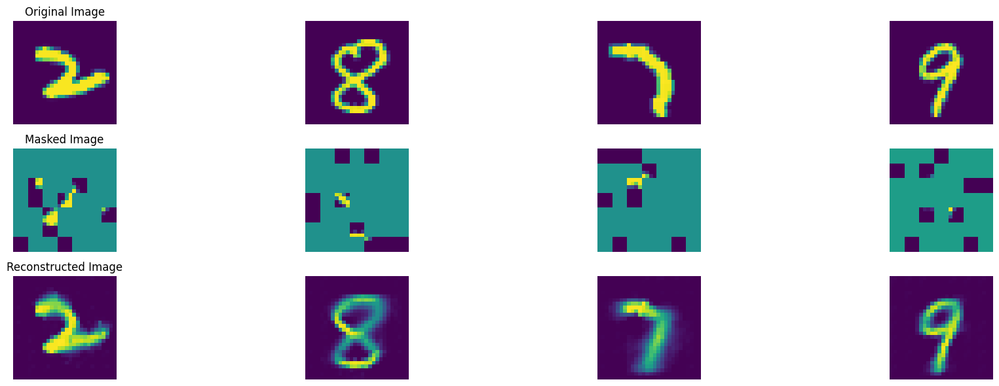

100%|██████████| 47/47 [00:08<00:00,  5.52it/s]


In epoch 179, average traning loss is 0.11873124523999844.
=================== EPOCH:  180  ===================


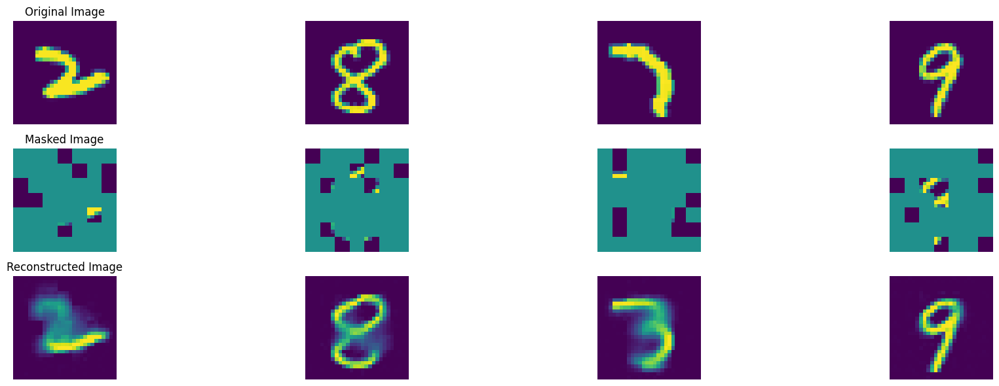

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 180, average traning loss is 0.11896868351292103.
=================== EPOCH:  181  ===================


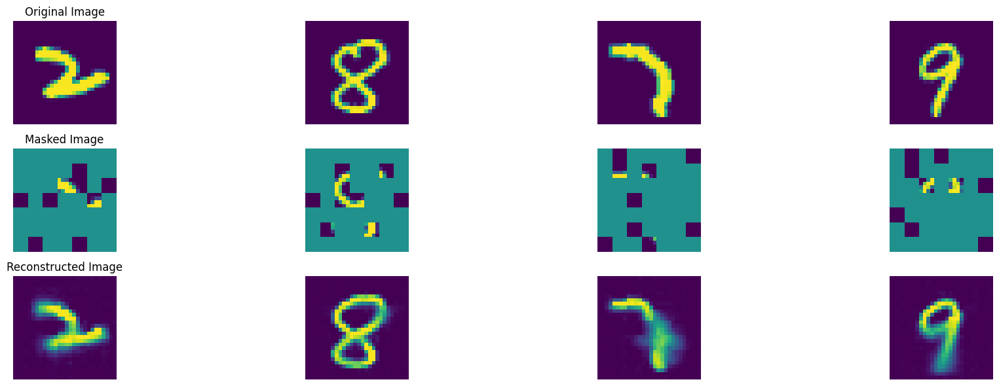

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 181, average traning loss is 0.11857942729554277.
=================== EPOCH:  182  ===================


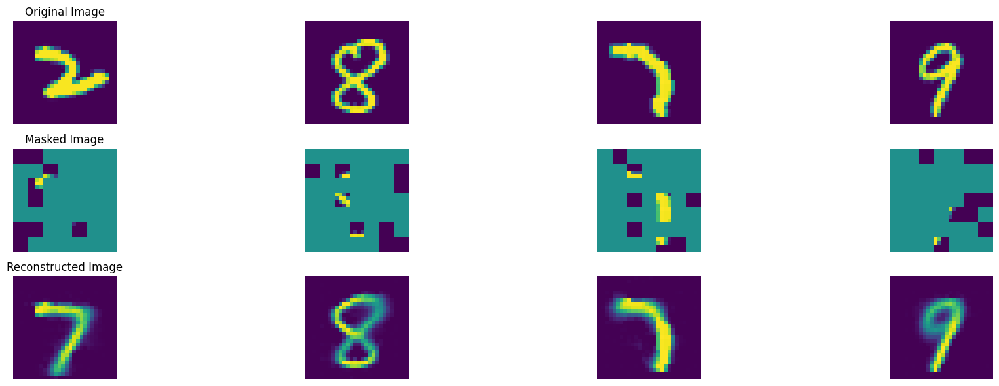

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 182, average traning loss is 0.11890516636219431.
=================== EPOCH:  183  ===================


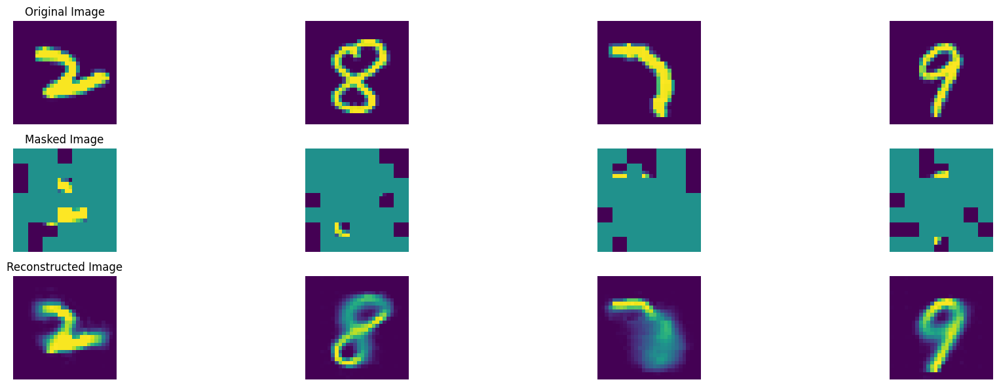

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 183, average traning loss is 0.11774748722289471.
=================== EPOCH:  184  ===================


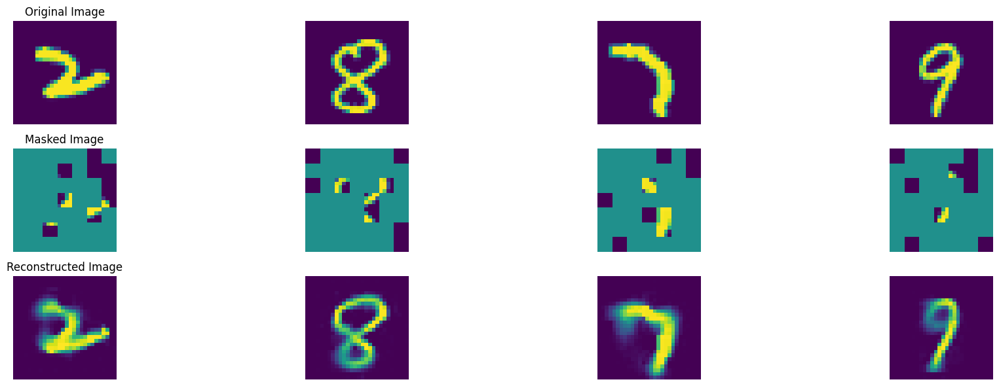

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 184, average traning loss is 0.11820224624999026.
=================== EPOCH:  185  ===================


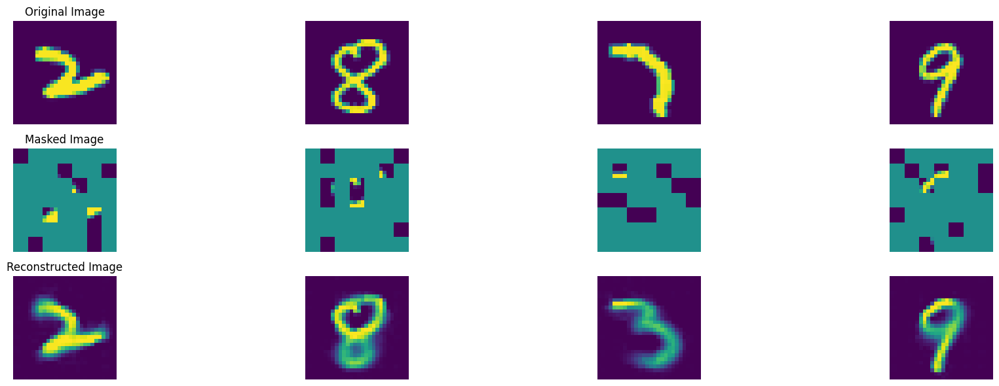

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 185, average traning loss is 0.11803164808674062.
=================== EPOCH:  186  ===================


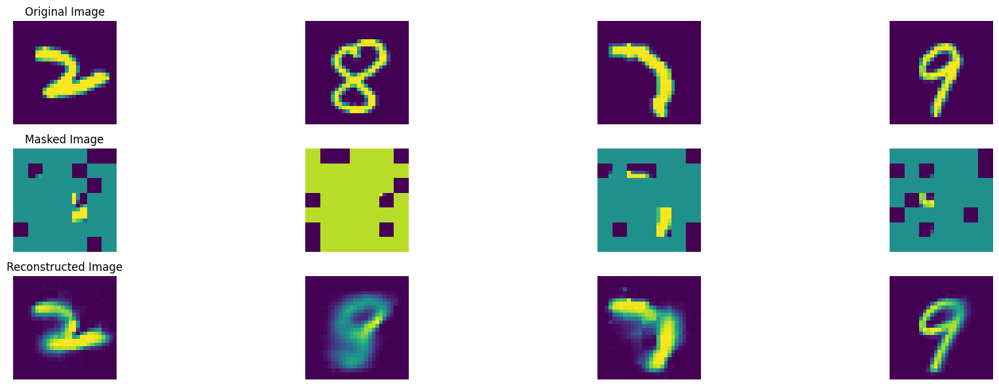

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 186, average traning loss is 0.11849965503875245.
=================== EPOCH:  187  ===================


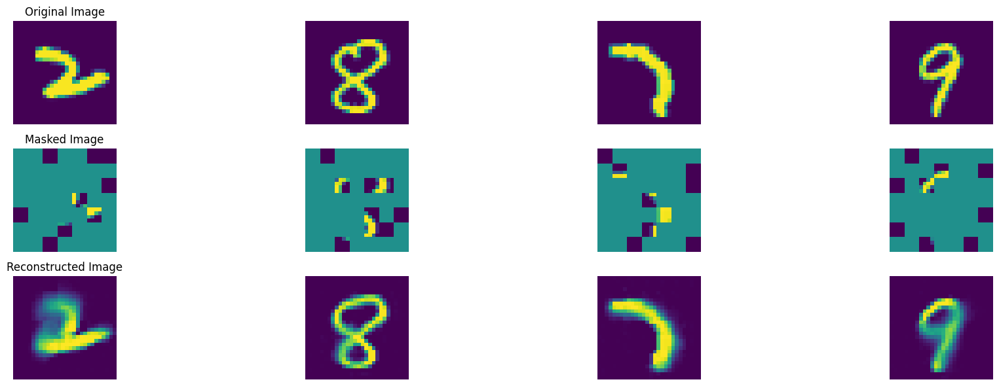

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 187, average traning loss is 0.11743759855310967.
=================== EPOCH:  188  ===================


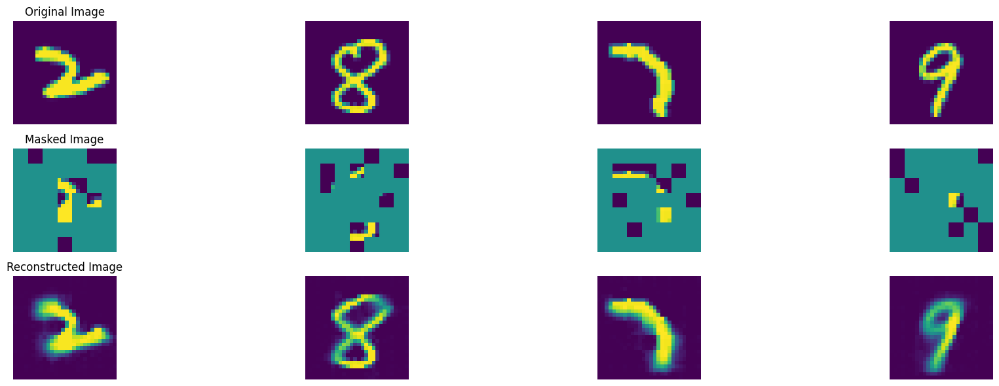

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 188, average traning loss is 0.11812466240309655.
=================== EPOCH:  189  ===================


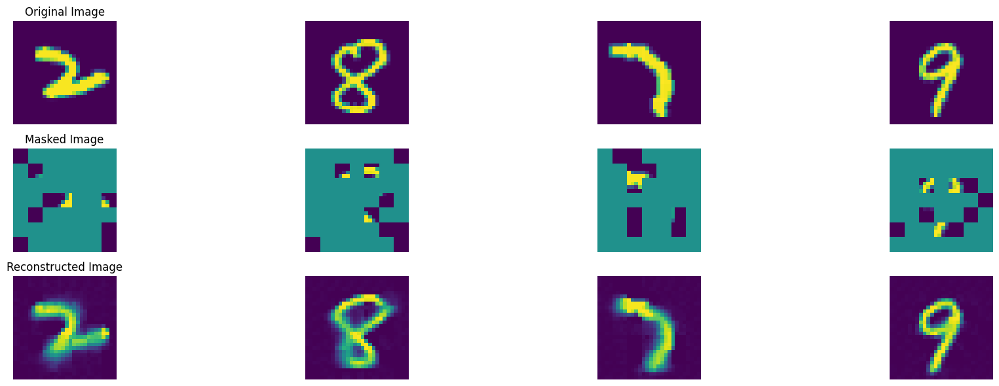

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 189, average traning loss is 0.1175049584596715.
=================== EPOCH:  190  ===================


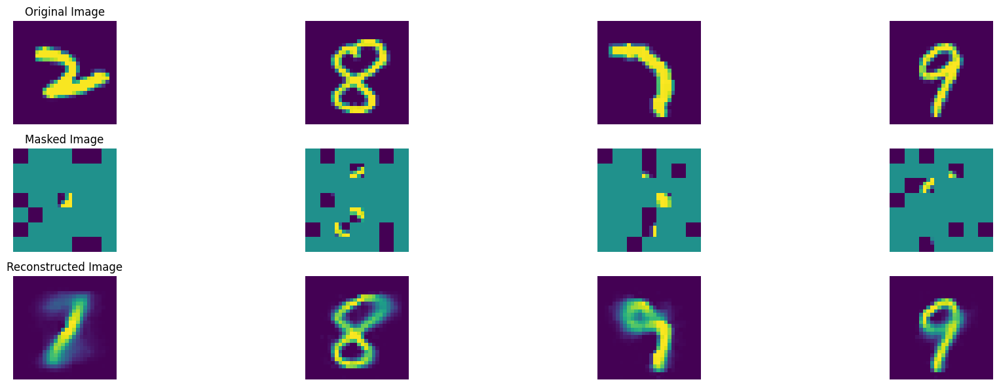

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 190, average traning loss is 0.11726678448154572.
=================== EPOCH:  191  ===================


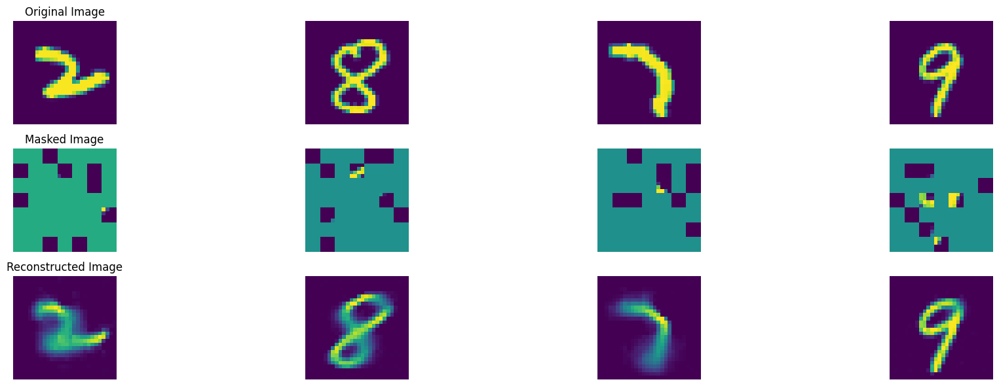

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 191, average traning loss is 0.11708760927332208.
=================== EPOCH:  192  ===================


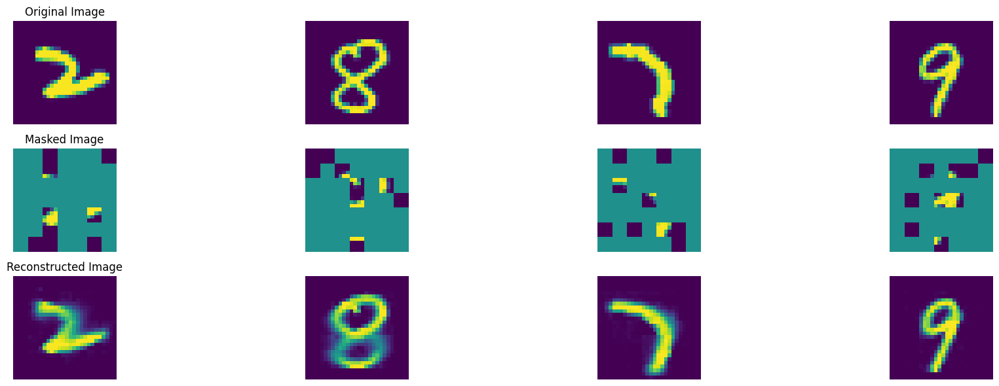

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 192, average traning loss is 0.11732564517792235.
=================== EPOCH:  193  ===================


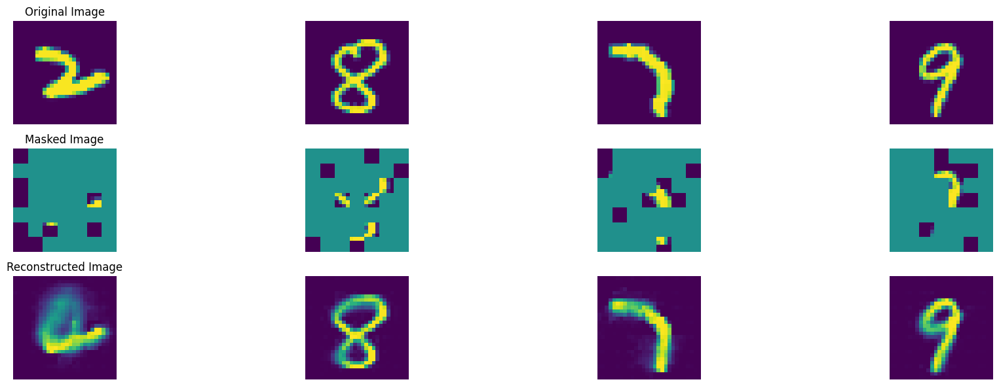

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 193, average traning loss is 0.11732931292437493.
=================== EPOCH:  194  ===================


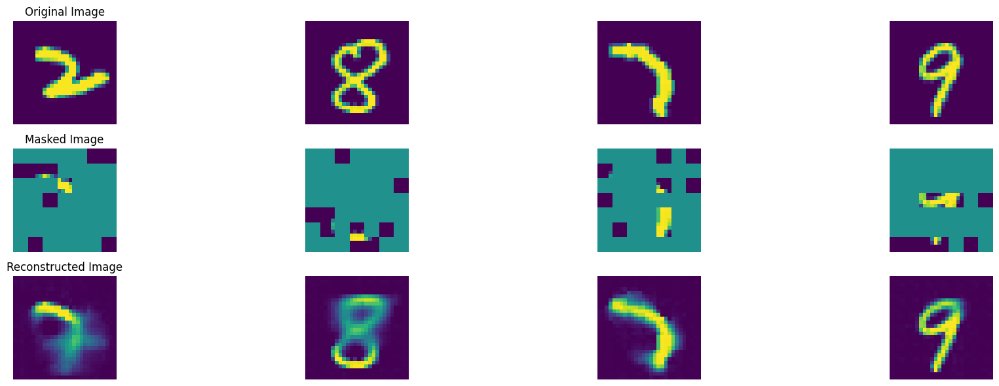

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 194, average traning loss is 0.11709577606079426.
=================== EPOCH:  195  ===================


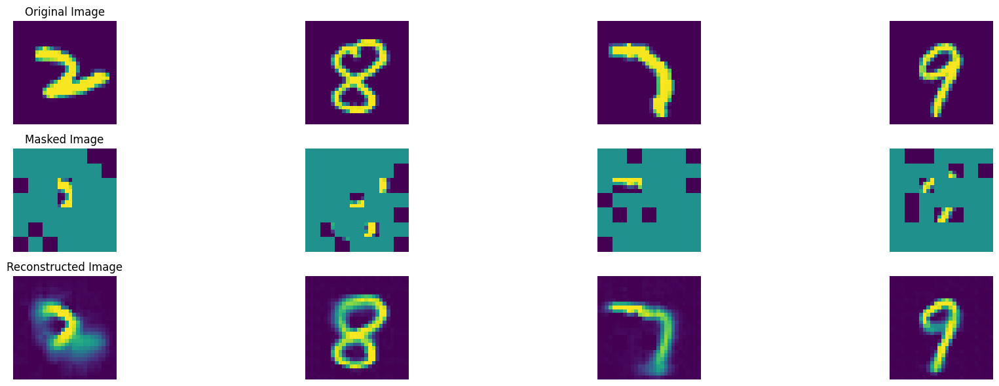

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 195, average traning loss is 0.11684626990810354.
=================== EPOCH:  196  ===================


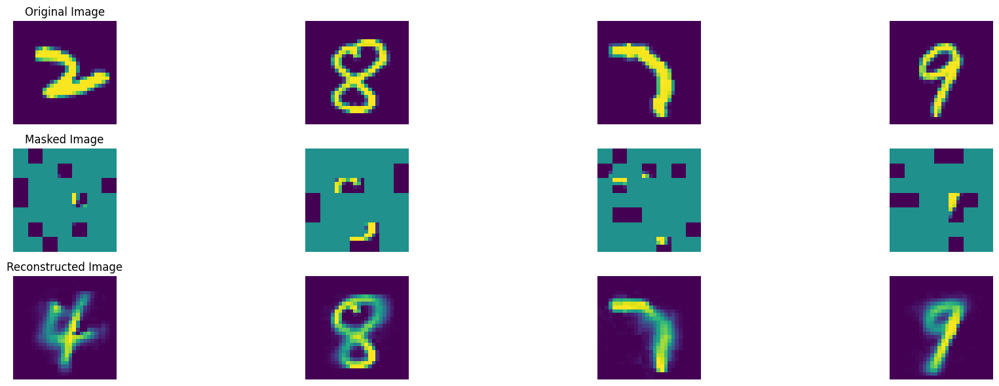

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 196, average traning loss is 0.11625804308247059.
=================== EPOCH:  197  ===================


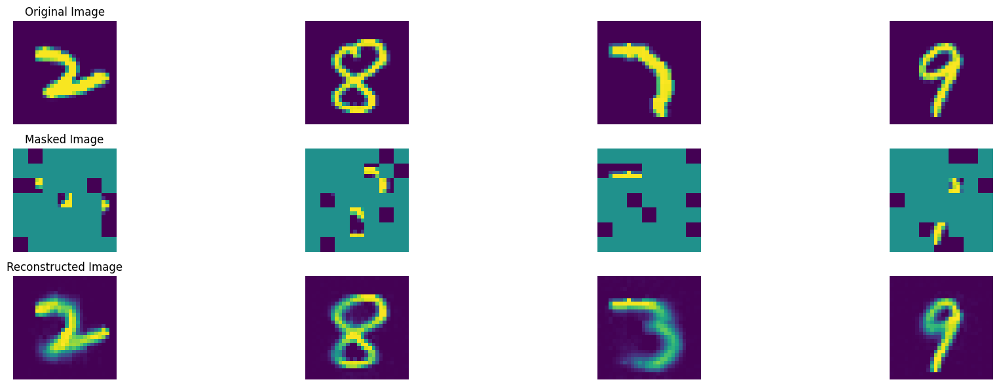

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 197, average traning loss is 0.11639872177484188.
=================== EPOCH:  198  ===================


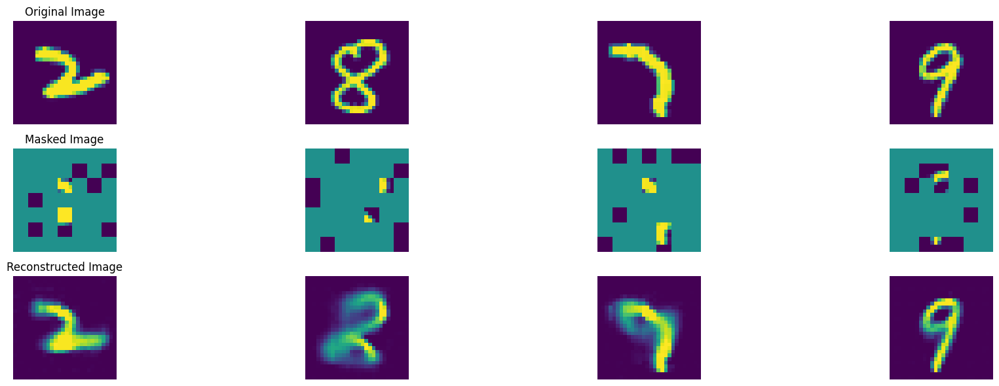

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 198, average traning loss is 0.1162187582317819.
=================== EPOCH:  199  ===================


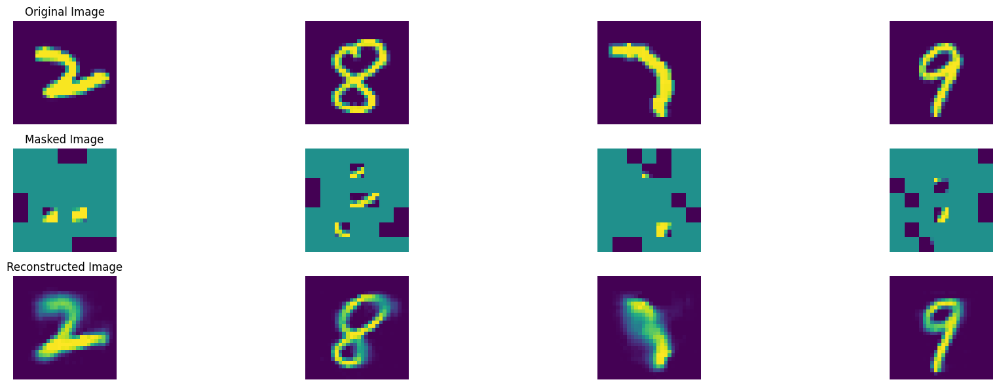

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 199, average traning loss is 0.11616084788073884.
=================== EPOCH:  200  ===================


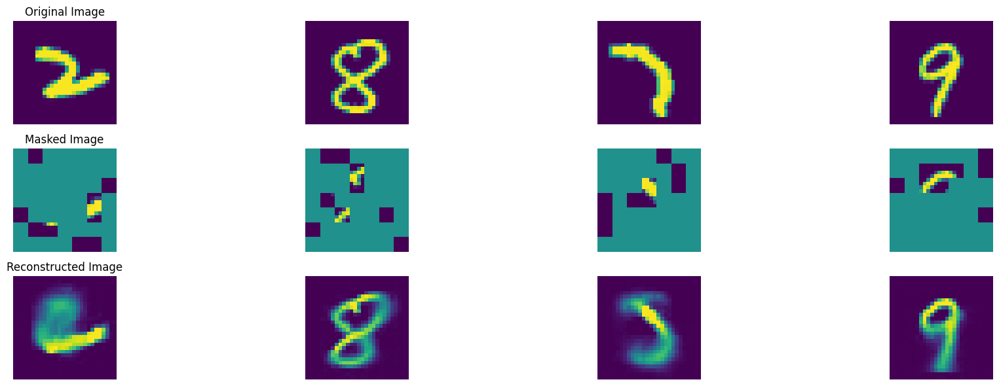

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 200, average traning loss is 0.11633333262610943.
=================== EPOCH:  201  ===================


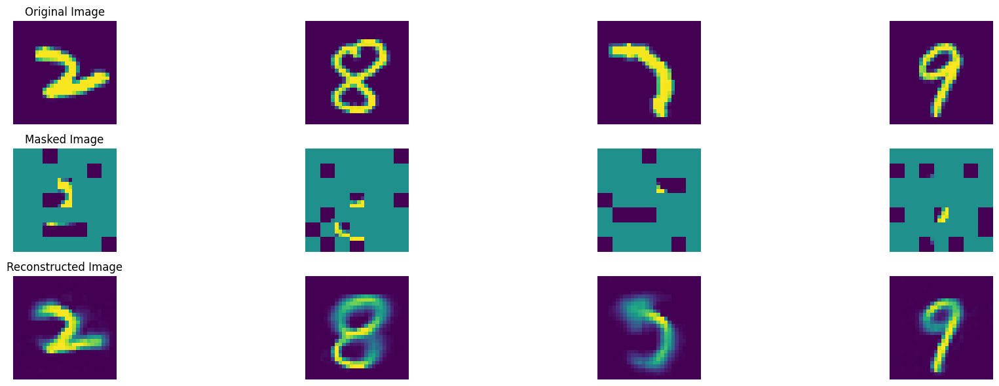

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 201, average traning loss is 0.11601461089671926.
=================== EPOCH:  202  ===================


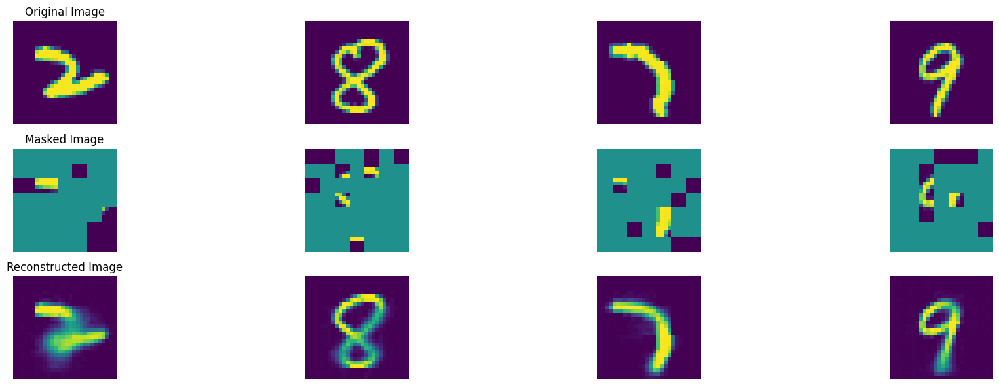

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 202, average traning loss is 0.11585738953757793.
=================== EPOCH:  203  ===================


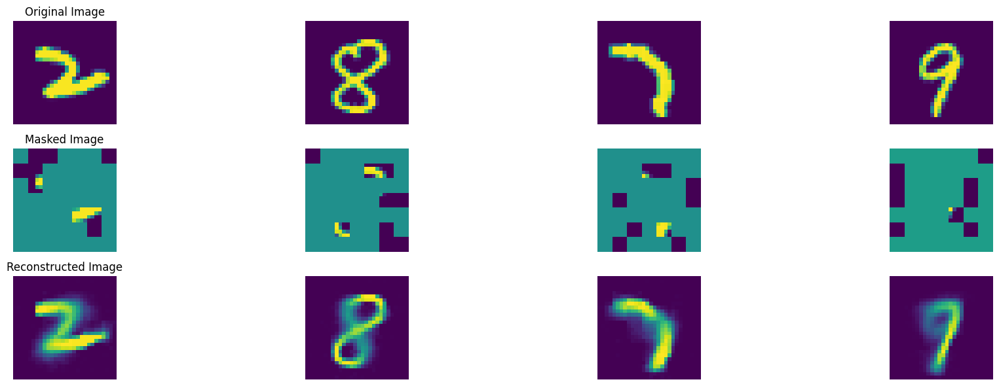

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 203, average traning loss is 0.11577270909192715.
=================== EPOCH:  204  ===================


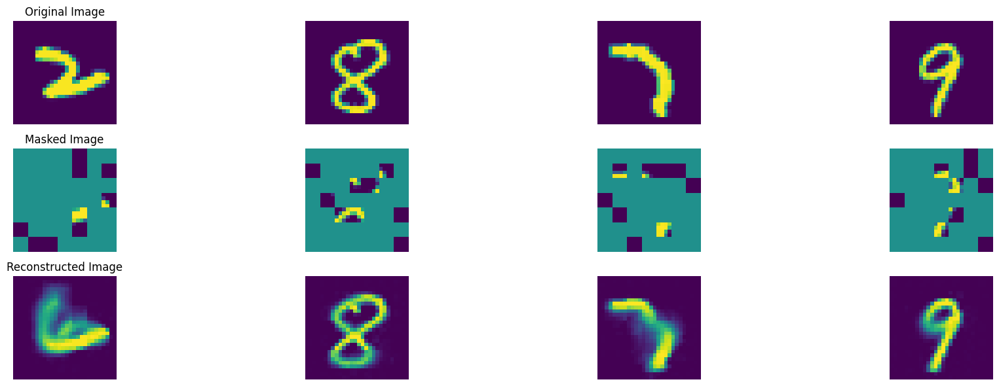

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 204, average traning loss is 0.11588516641170421.
=================== EPOCH:  205  ===================


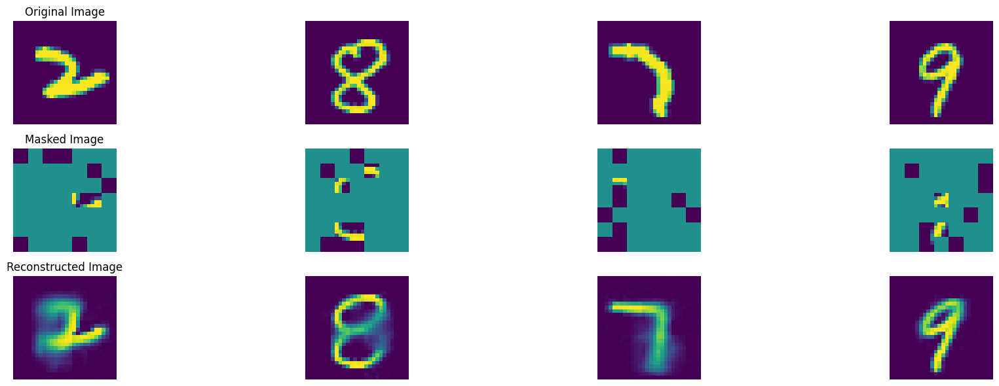

100%|██████████| 47/47 [00:08<00:00,  5.29it/s]


In epoch 205, average traning loss is 0.11593326529923906.
=================== EPOCH:  206  ===================


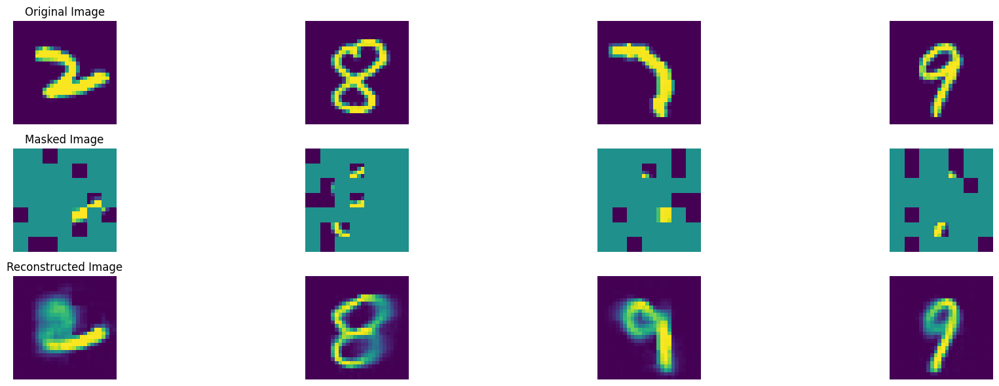

100%|██████████| 47/47 [00:08<00:00,  5.26it/s]


In epoch 206, average traning loss is 0.11537775238777728.
=================== EPOCH:  207  ===================


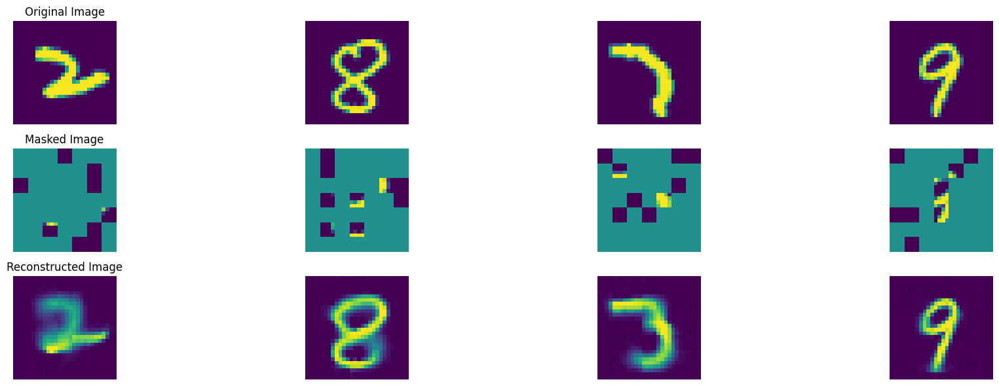

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 207, average traning loss is 0.11565741341798863.
=================== EPOCH:  208  ===================


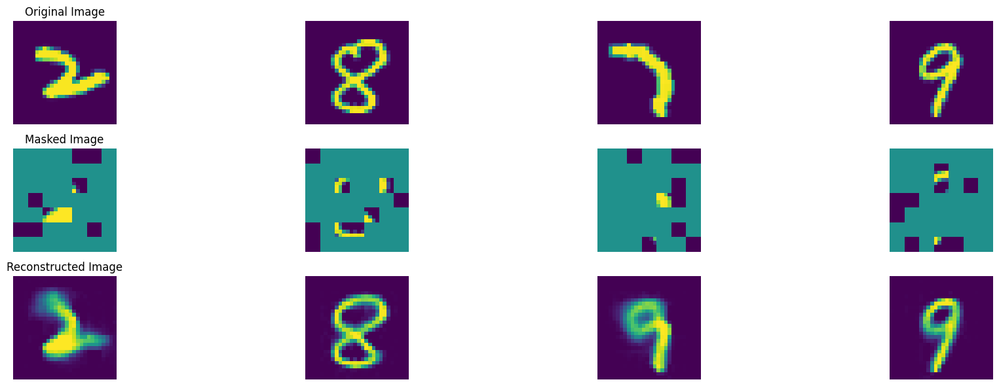

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 208, average traning loss is 0.1153841034529057.
=================== EPOCH:  209  ===================


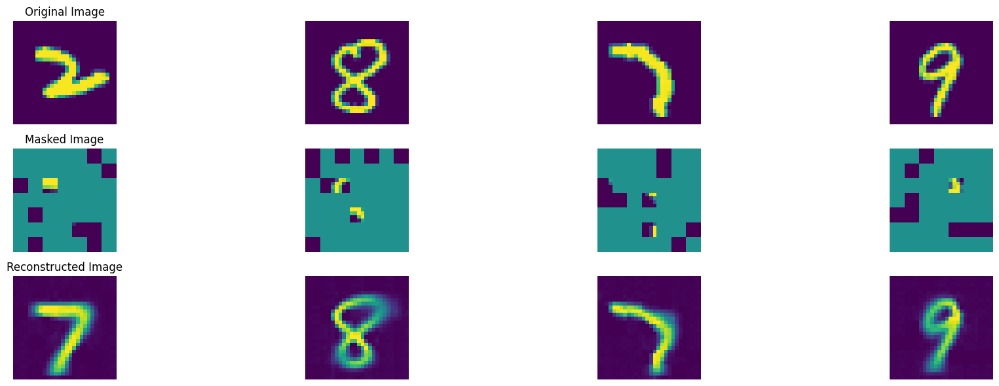

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 209, average traning loss is 0.11483420019454145.
=================== EPOCH:  210  ===================


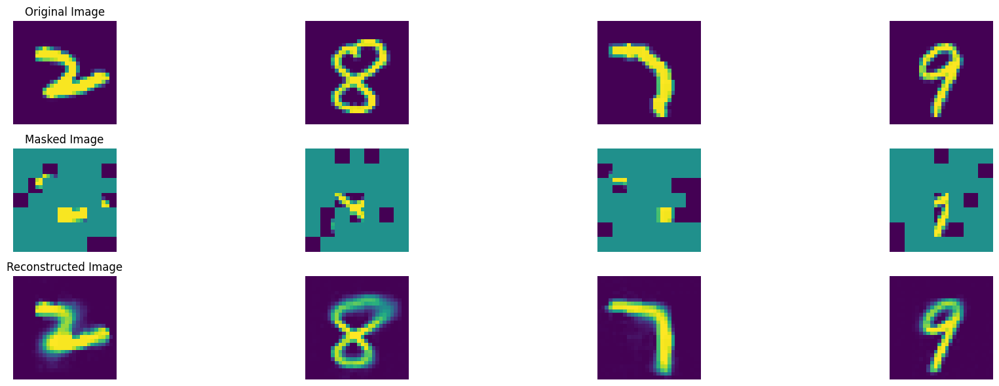

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 210, average traning loss is 0.1150935209812002.
=================== EPOCH:  211  ===================


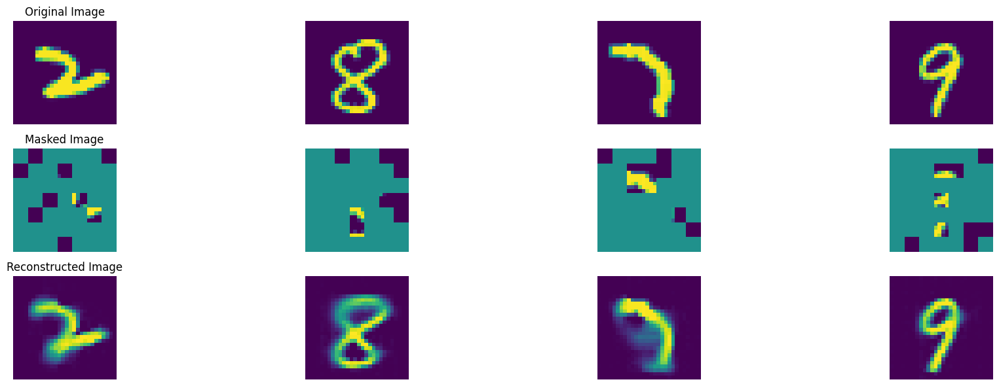

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 211, average traning loss is 0.11550628060990191.
=================== EPOCH:  212  ===================


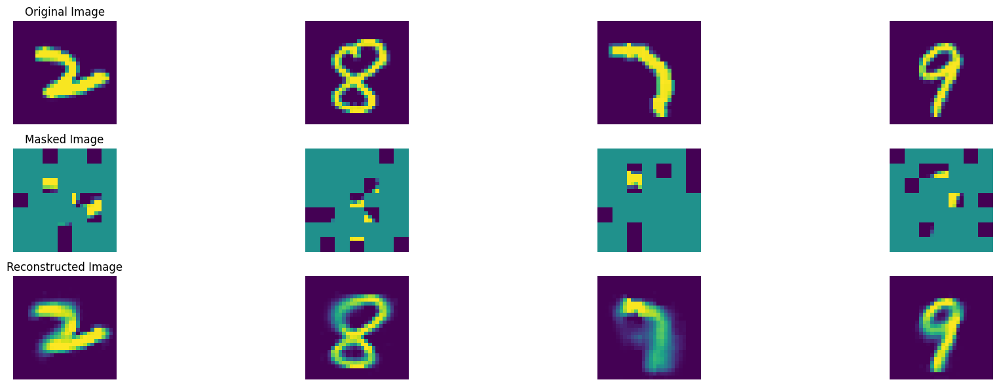

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 212, average traning loss is 0.11462725746504804.
=================== EPOCH:  213  ===================


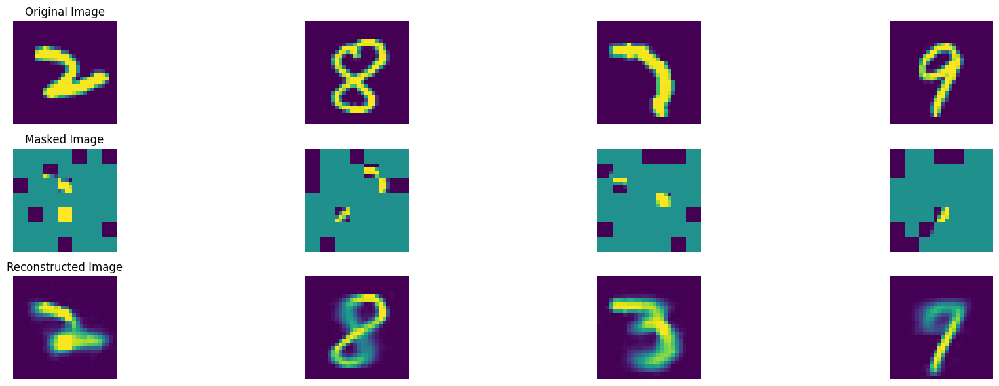

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 213, average traning loss is 0.11470513648175179.
=================== EPOCH:  214  ===================


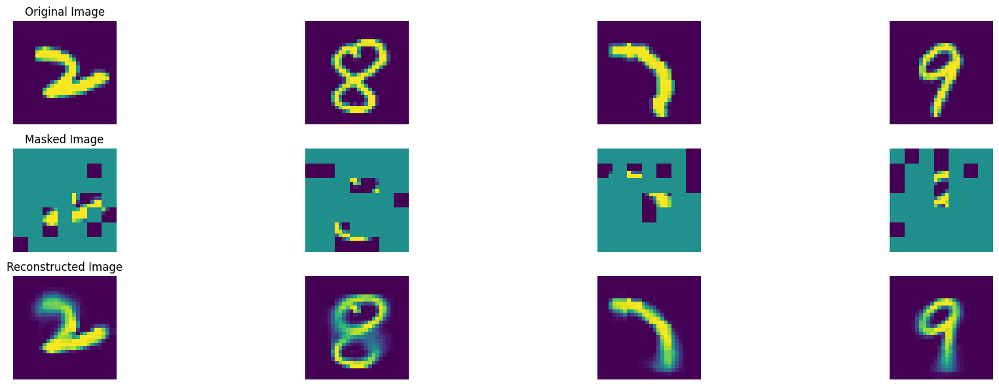

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 214, average traning loss is 0.11498990956139057.
=================== EPOCH:  215  ===================


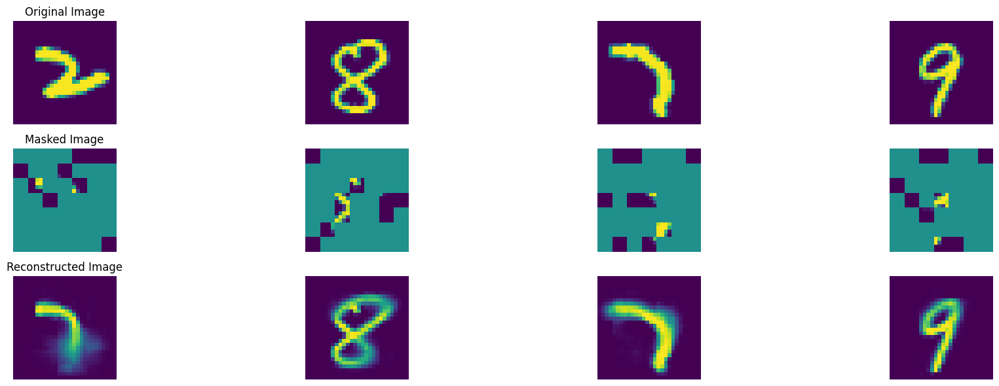

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 215, average traning loss is 0.11435512627692933.
=================== EPOCH:  216  ===================


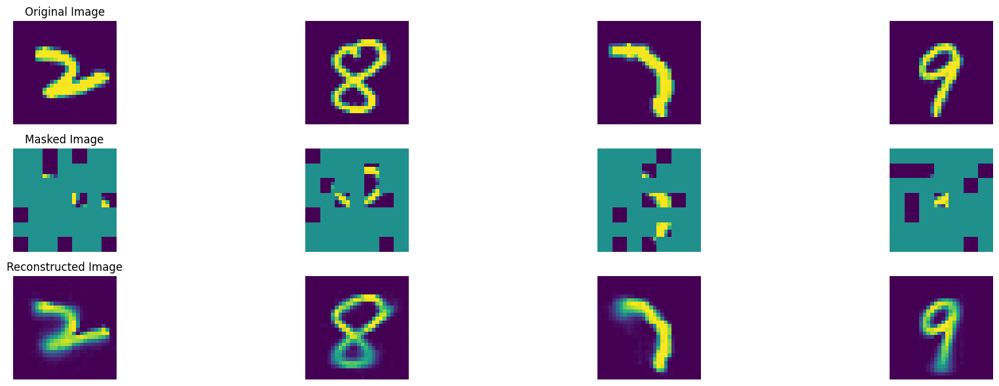

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 216, average traning loss is 0.11425711341360782.
=================== EPOCH:  217  ===================


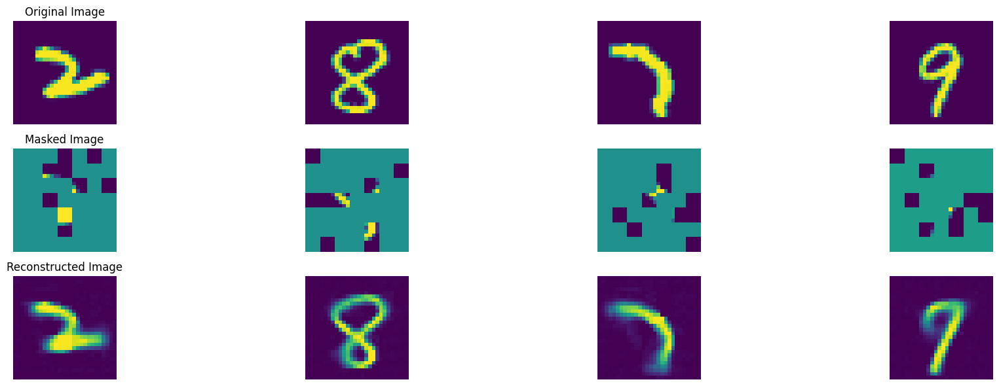

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 217, average traning loss is 0.11428919862559501.
=================== EPOCH:  218  ===================


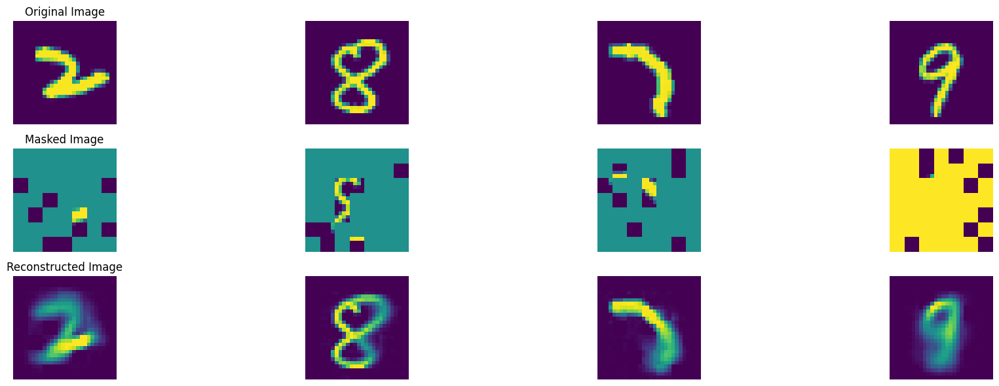

IOPub message rate exceeded.7<00:01,  5.54it/s]
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 392, average traning loss is 0.10464084639828256.
=================== EPOCH:  393  ===================


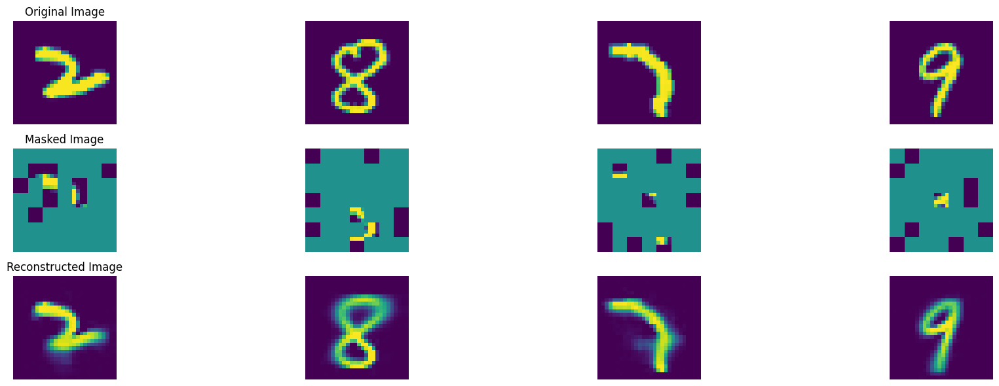

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 393, average traning loss is 0.10449595606707512.
=================== EPOCH:  394  ===================


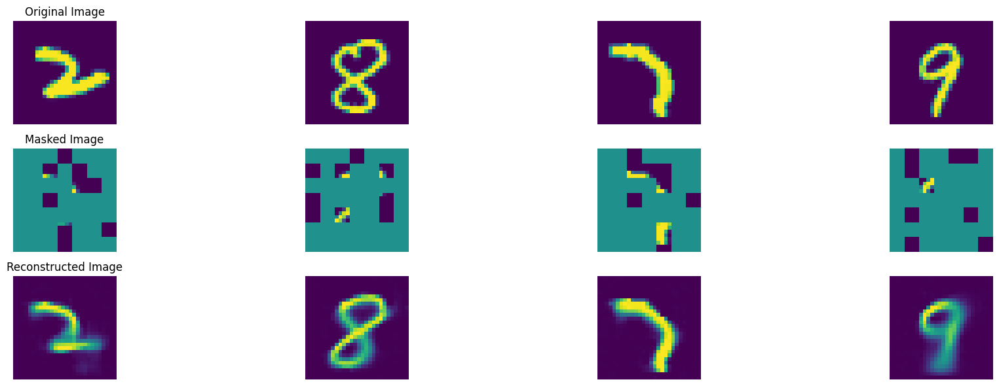

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 394, average traning loss is 0.10423182299796571.
=================== EPOCH:  395  ===================


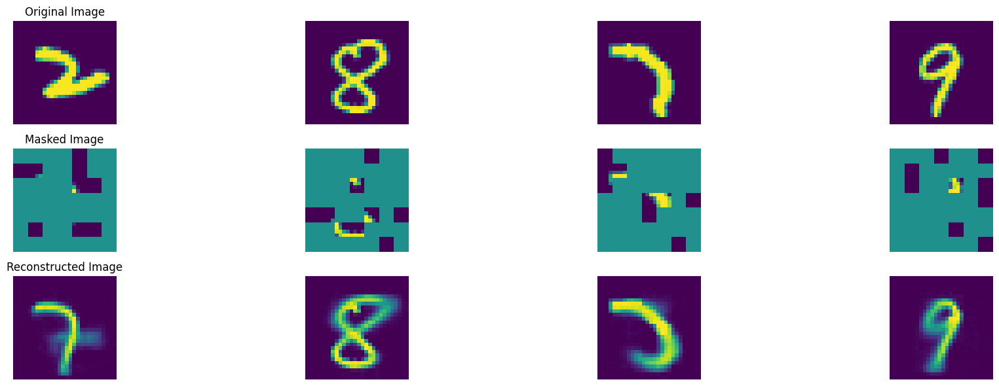

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 395, average traning loss is 0.10495933034318558.
=================== EPOCH:  396  ===================


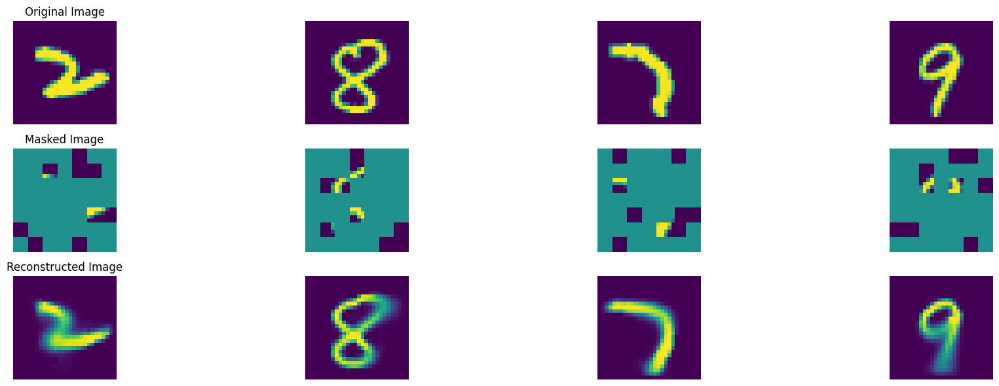

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 396, average traning loss is 0.10478968442754542.
=================== EPOCH:  397  ===================


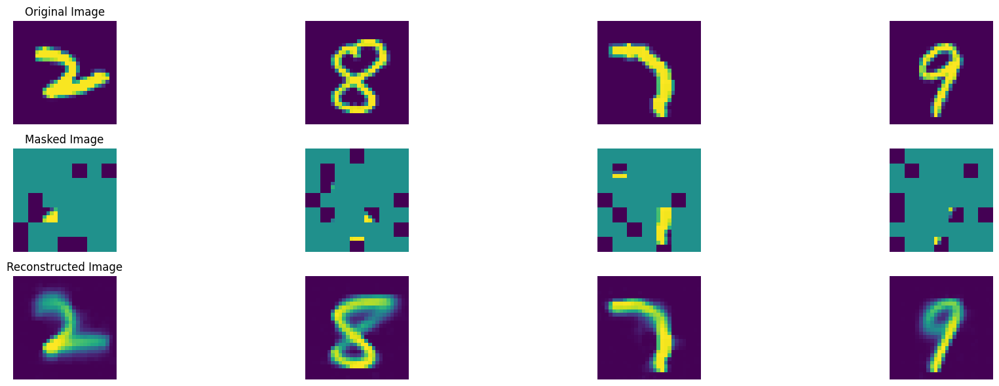

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 397, average traning loss is 0.10476470611830975.
=================== EPOCH:  398  ===================


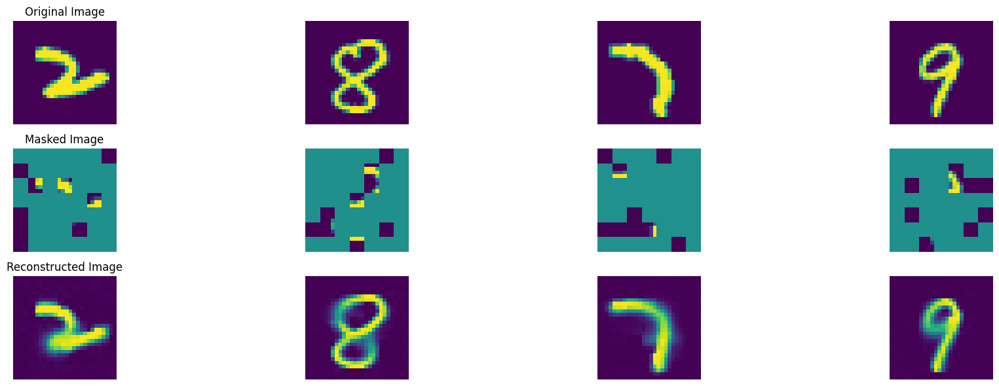

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 398, average traning loss is 0.10399960615533463.
=================== EPOCH:  399  ===================


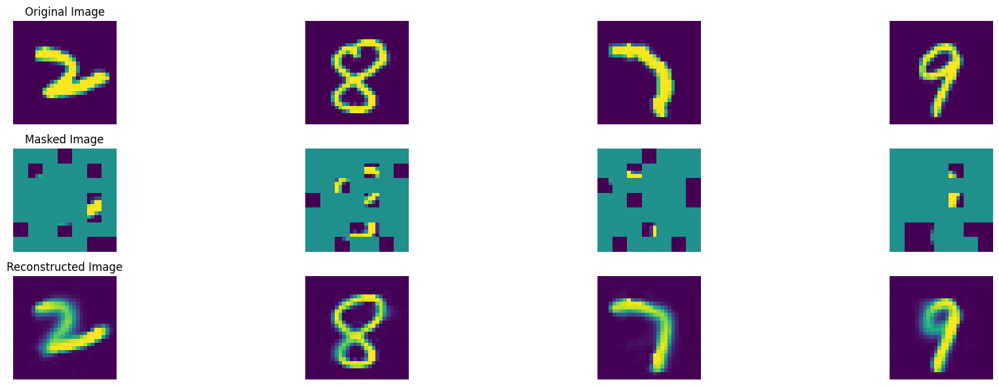

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 399, average traning loss is 0.10396291394817068.
=================== EPOCH:  400  ===================


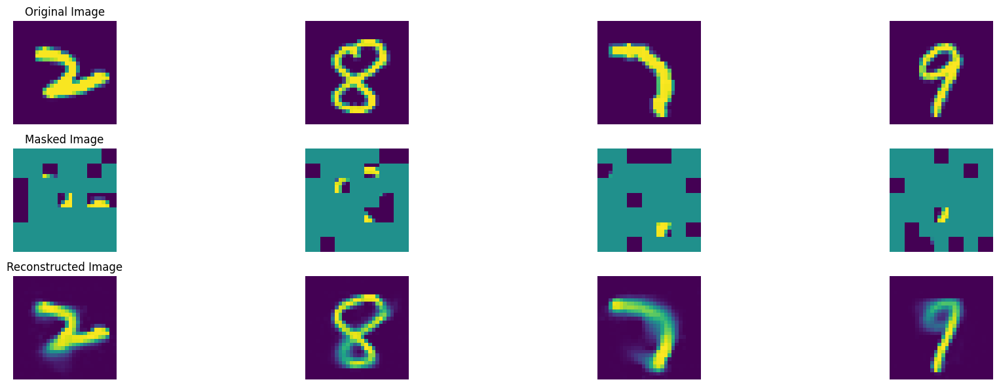

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 400, average traning loss is 0.10453455292798103.
=================== EPOCH:  401  ===================


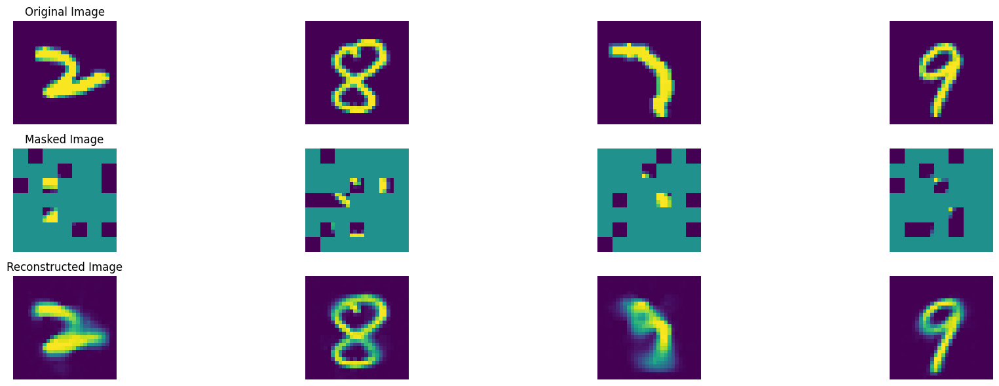

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 401, average traning loss is 0.10429573391980314.
=================== EPOCH:  402  ===================


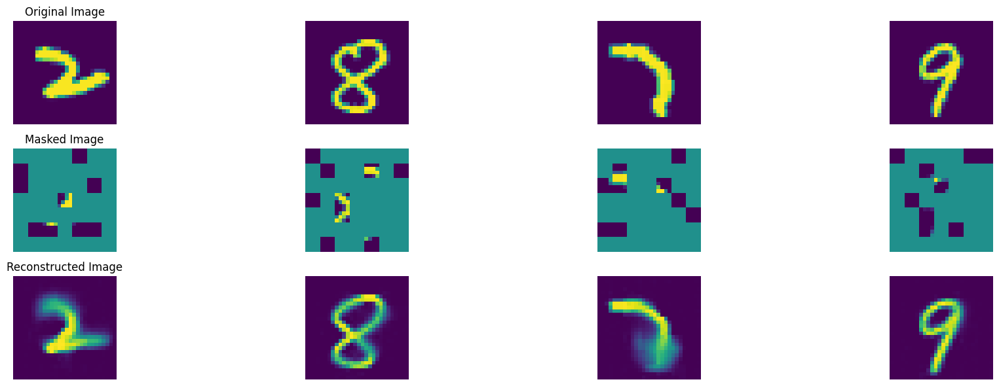

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 402, average traning loss is 0.10414725161613302.
=================== EPOCH:  403  ===================


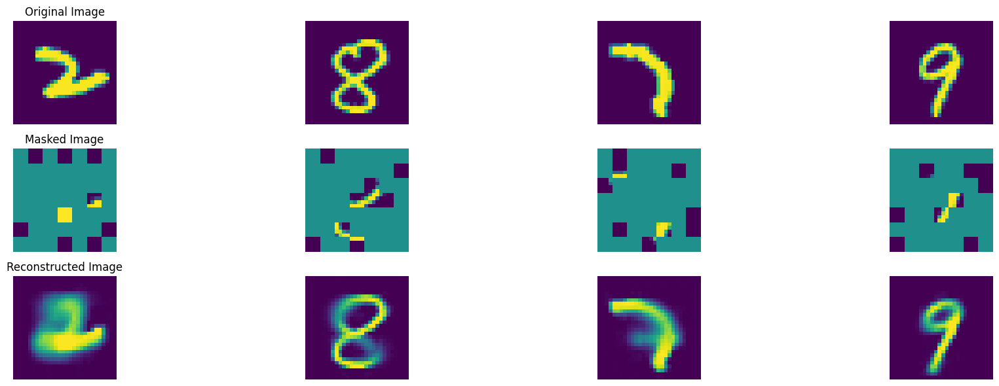

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 403, average traning loss is 0.10367470155370996.
=================== EPOCH:  404  ===================


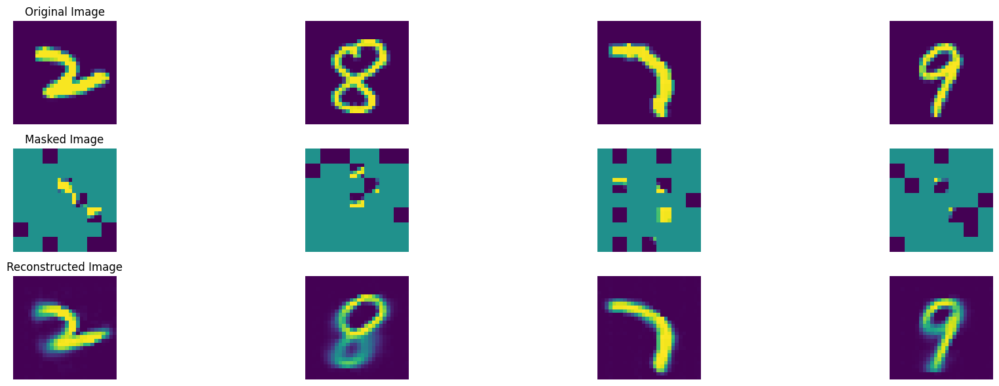

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 404, average traning loss is 0.10420913138288132.
=================== EPOCH:  405  ===================


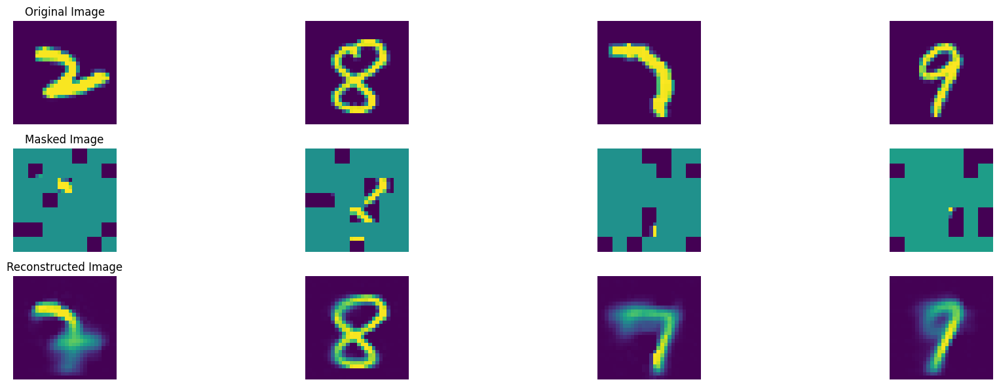

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 405, average traning loss is 0.10393282390655355.
=================== EPOCH:  406  ===================


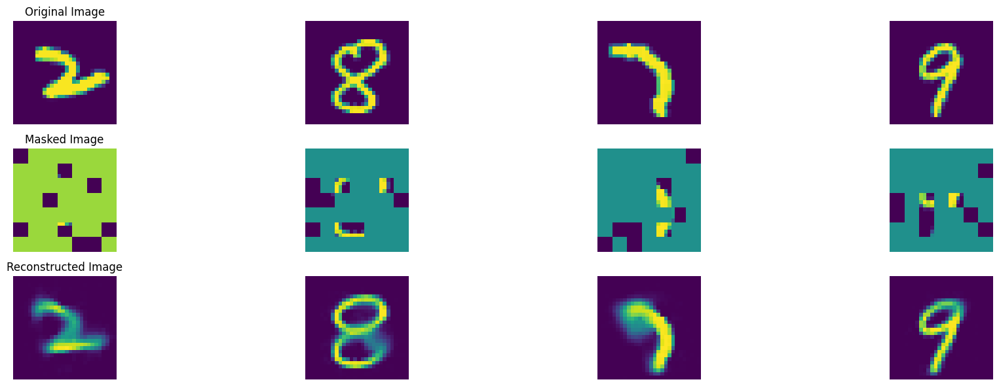

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 406, average traning loss is 0.10441630127582144.
=================== EPOCH:  407  ===================


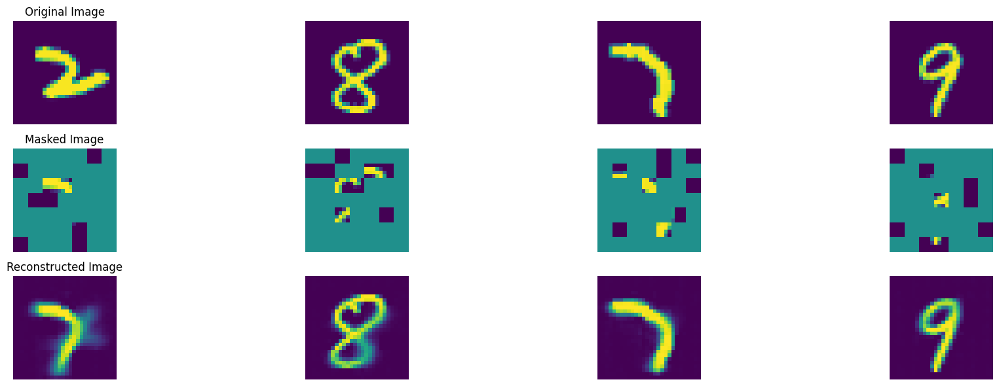

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 407, average traning loss is 0.10417220963442579.
=================== EPOCH:  408  ===================


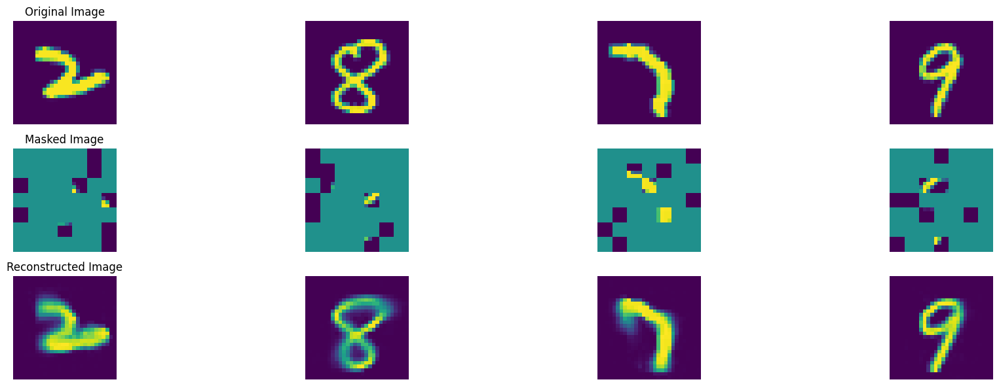

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 408, average traning loss is 0.10442818431778157.
=================== EPOCH:  409  ===================


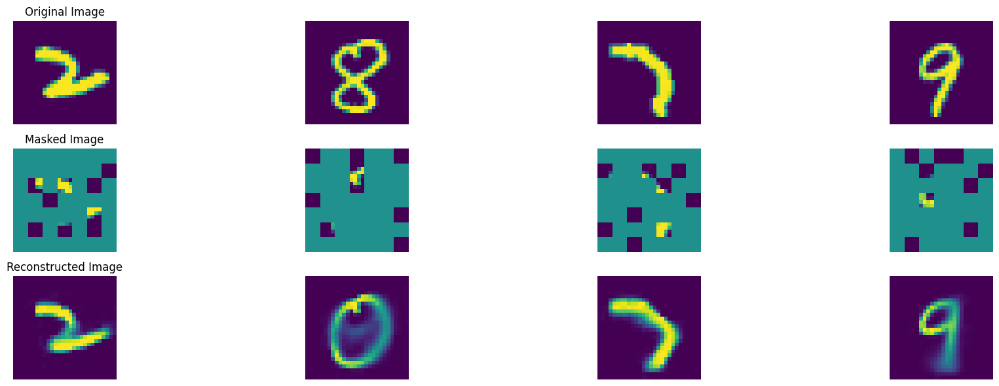

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 409, average traning loss is 0.10443736089670912.
=================== EPOCH:  410  ===================


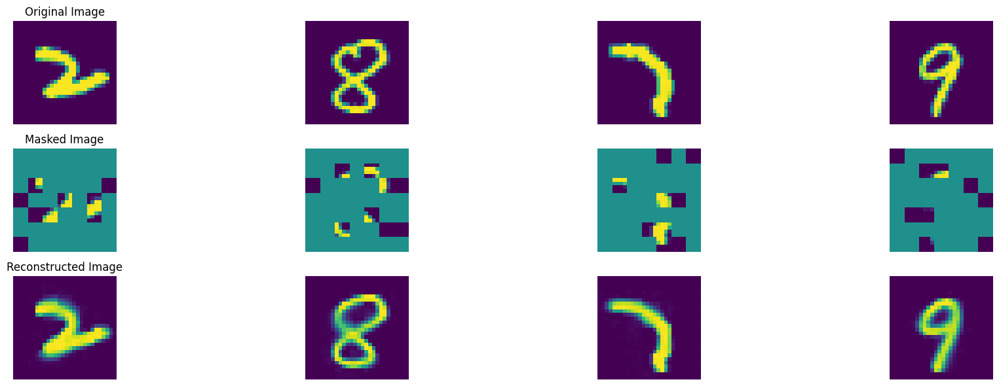

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 410, average traning loss is 0.10398619669549009.
=================== EPOCH:  411  ===================


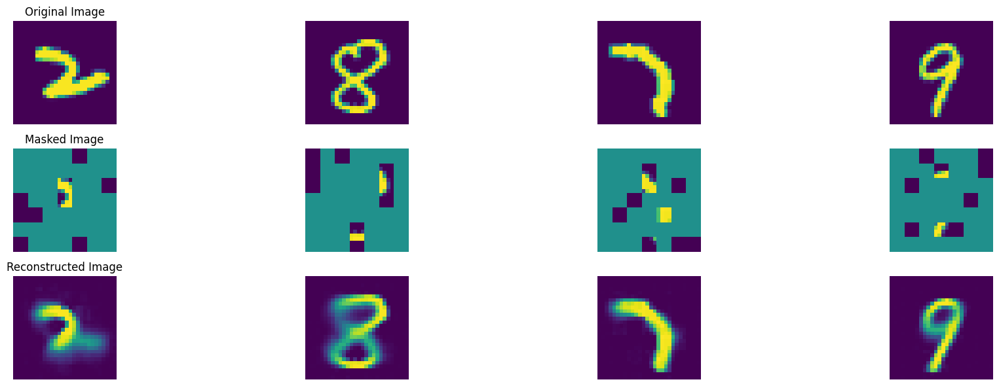

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 411, average traning loss is 0.1042498454768607.
=================== EPOCH:  412  ===================


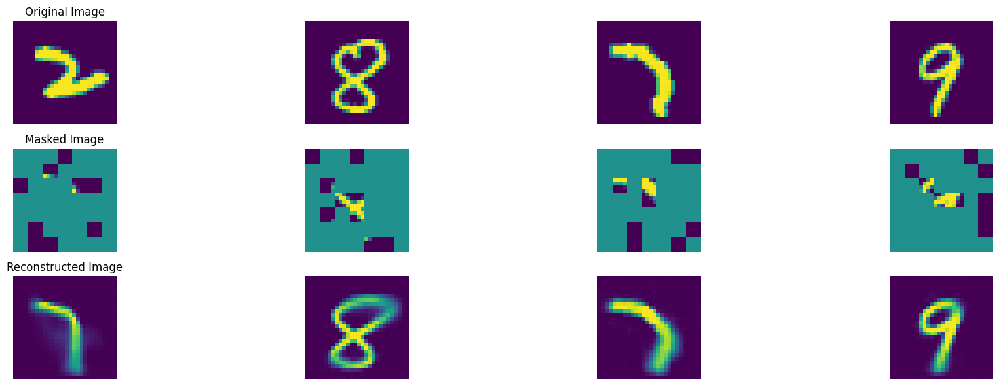

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 412, average traning loss is 0.10445889830589294.
=================== EPOCH:  413  ===================


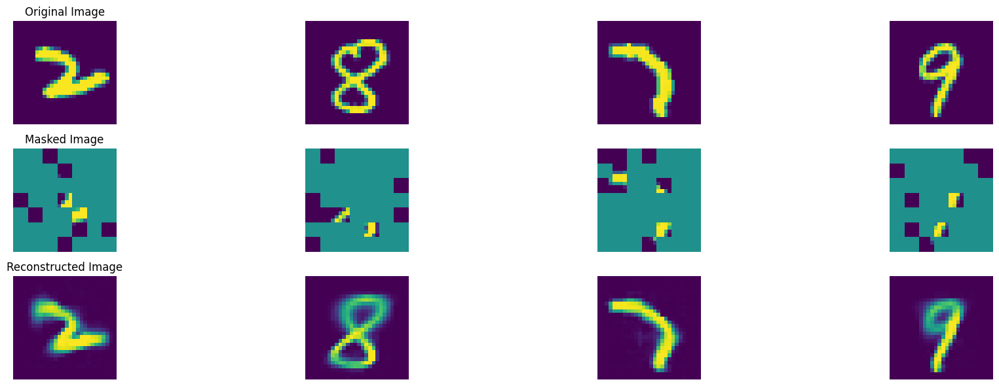

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 413, average traning loss is 0.10400704104215541.
=================== EPOCH:  414  ===================


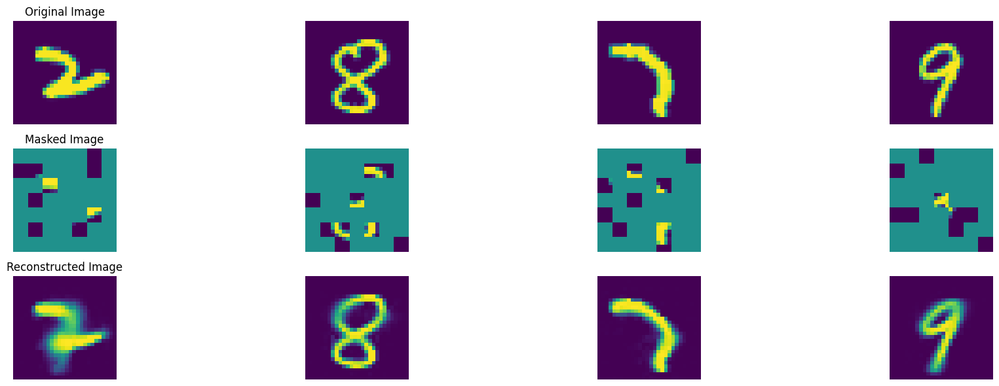

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 414, average traning loss is 0.10429869338553002.
=================== EPOCH:  415  ===================


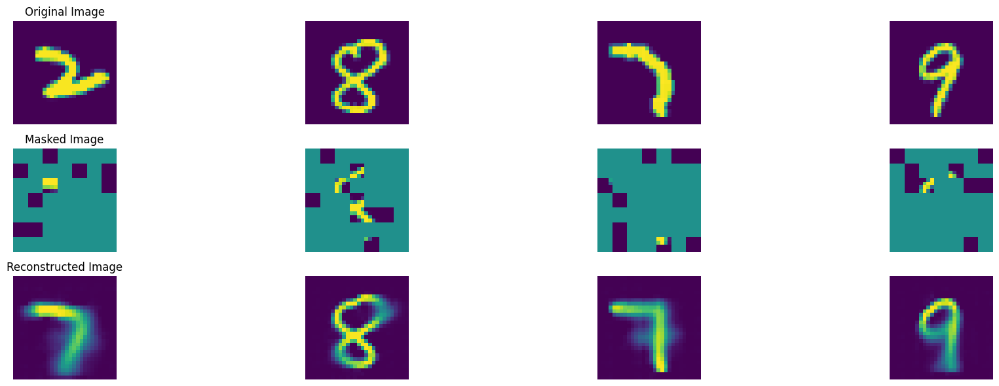

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 415, average traning loss is 0.10428043771931465.
=================== EPOCH:  416  ===================


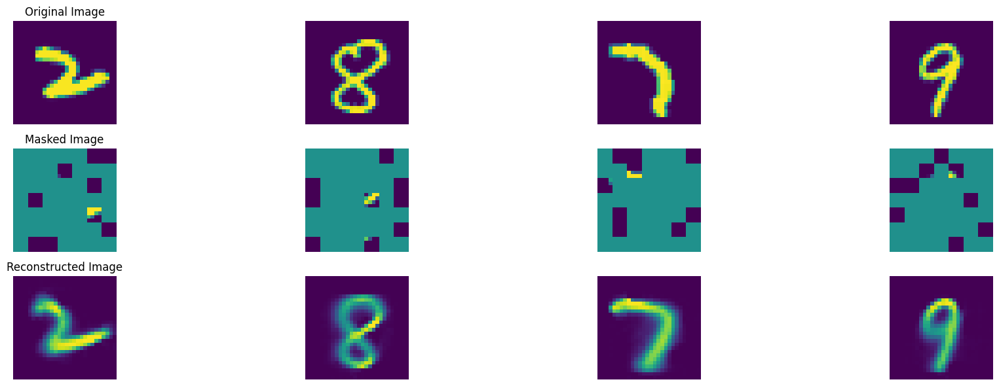

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 416, average traning loss is 0.10385325852226704.
=================== EPOCH:  417  ===================


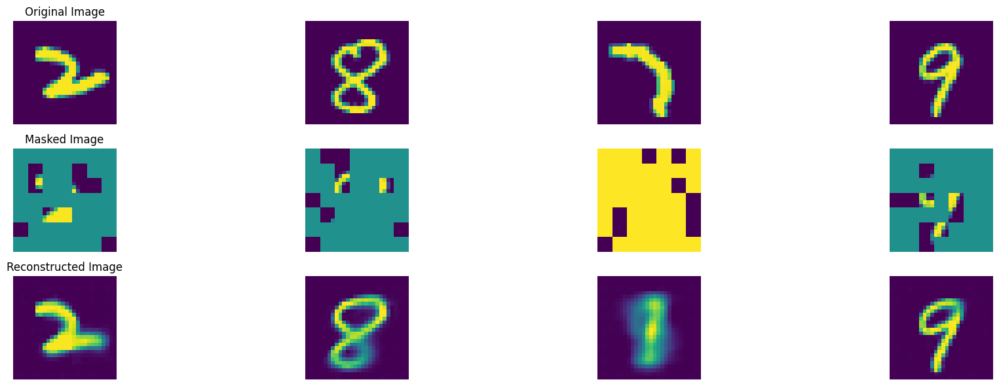

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 417, average traning loss is 0.10350008927127148.
=================== EPOCH:  418  ===================


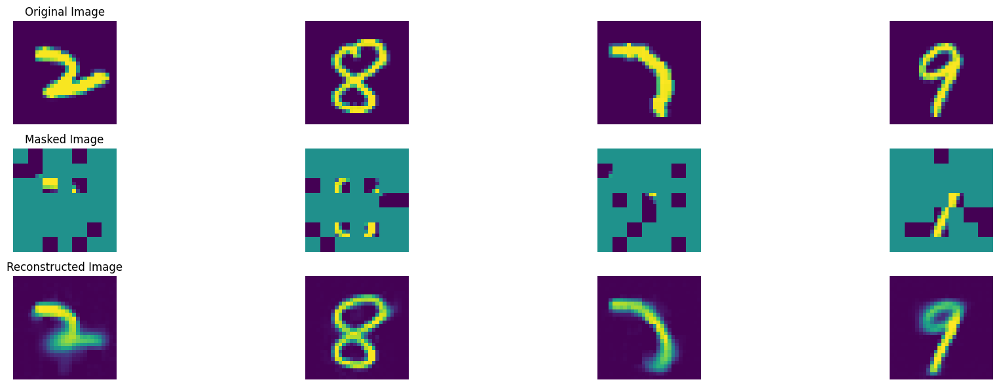

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 418, average traning loss is 0.10391977714731339.
=================== EPOCH:  419  ===================


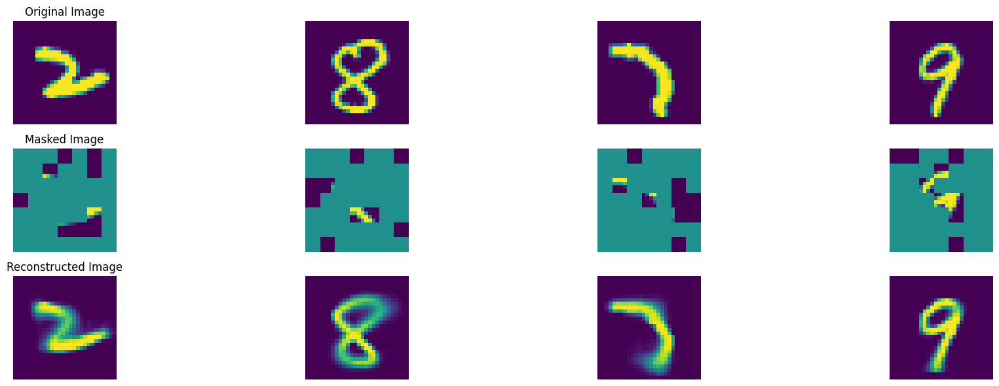

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 419, average traning loss is 0.10360924392304521.
=================== EPOCH:  420  ===================


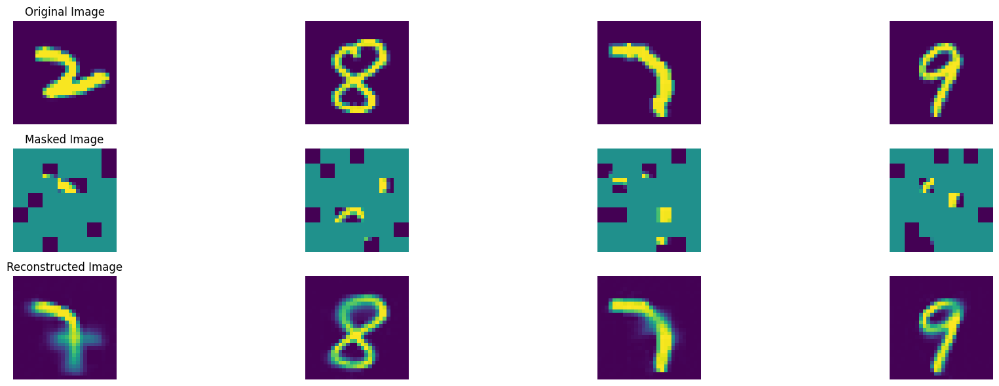

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 420, average traning loss is 0.1037808412567098.
=================== EPOCH:  421  ===================


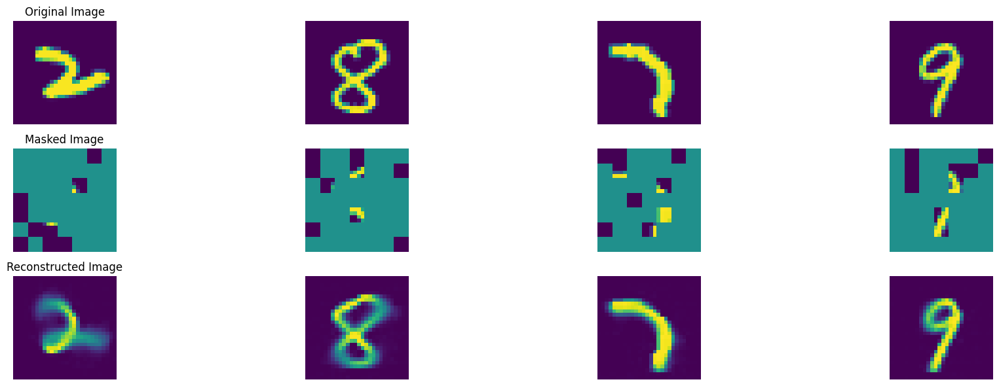

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 421, average traning loss is 0.10331501272764612.
=================== EPOCH:  422  ===================


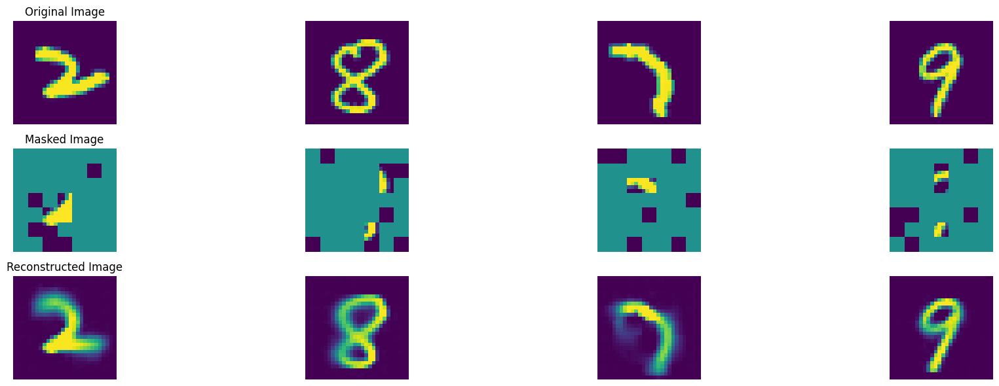

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 422, average traning loss is 0.10386494895879259.
=================== EPOCH:  423  ===================


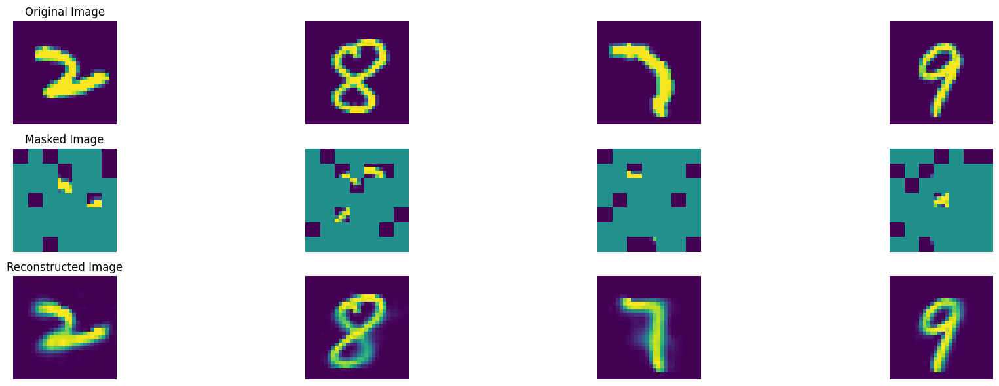

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 423, average traning loss is 0.10395930136771912.
=================== EPOCH:  424  ===================


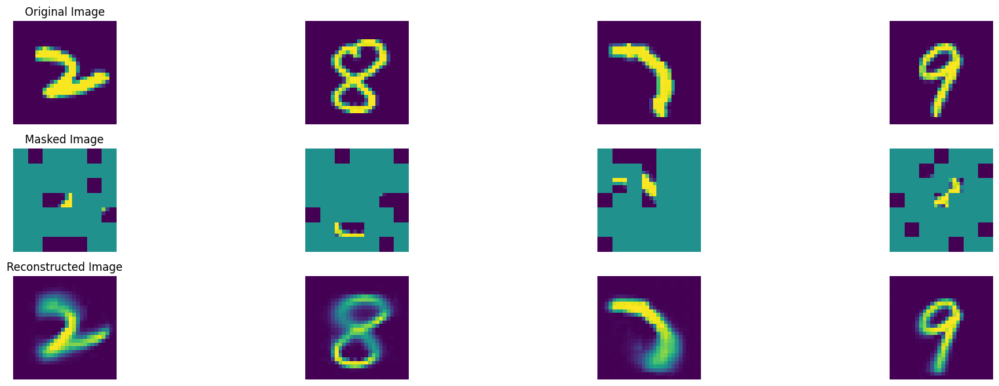

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 424, average traning loss is 0.10336463391146761.
=================== EPOCH:  425  ===================


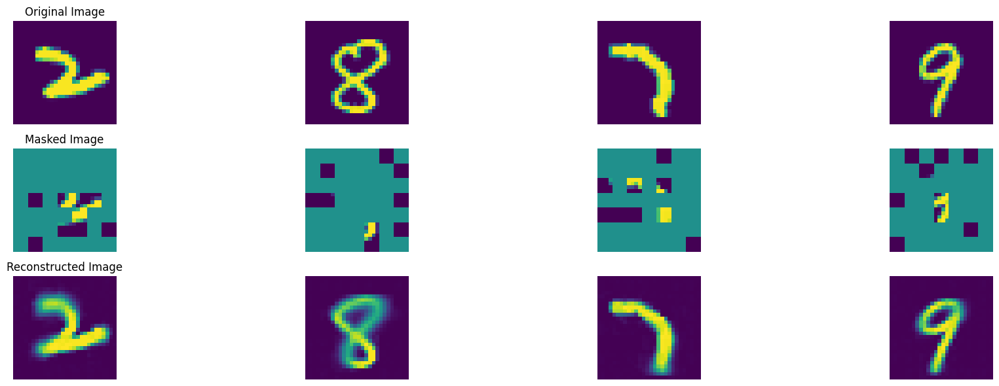

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 425, average traning loss is 0.10308154434599776.
=================== EPOCH:  426  ===================


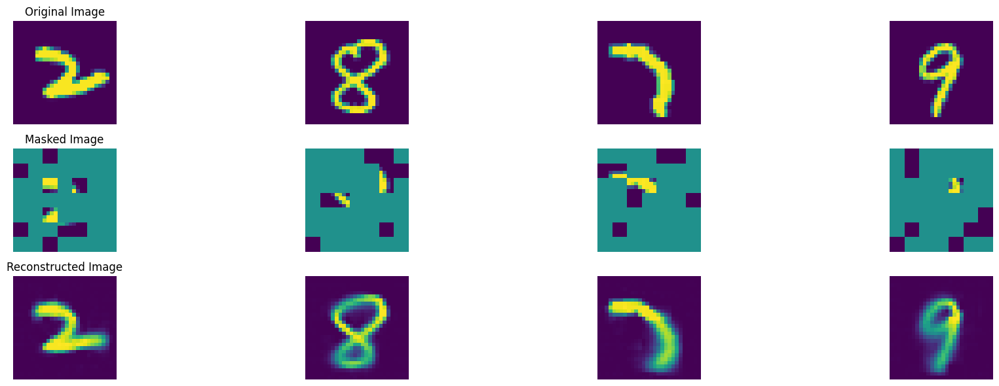

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 426, average traning loss is 0.10325431506684486.
=================== EPOCH:  427  ===================


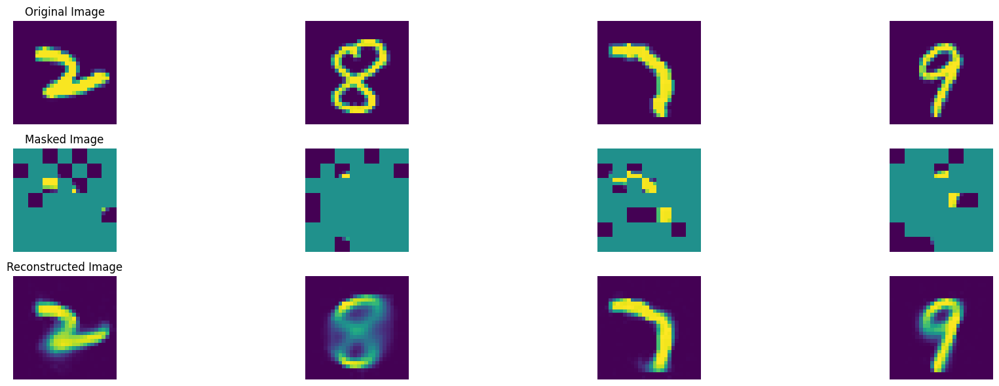

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 427, average traning loss is 0.1033602440927891.
=================== EPOCH:  428  ===================


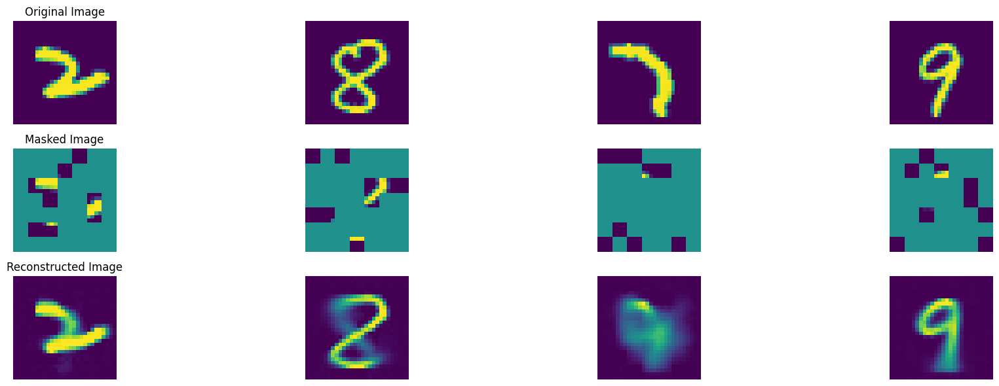

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 428, average traning loss is 0.10287463332110262.
=================== EPOCH:  429  ===================


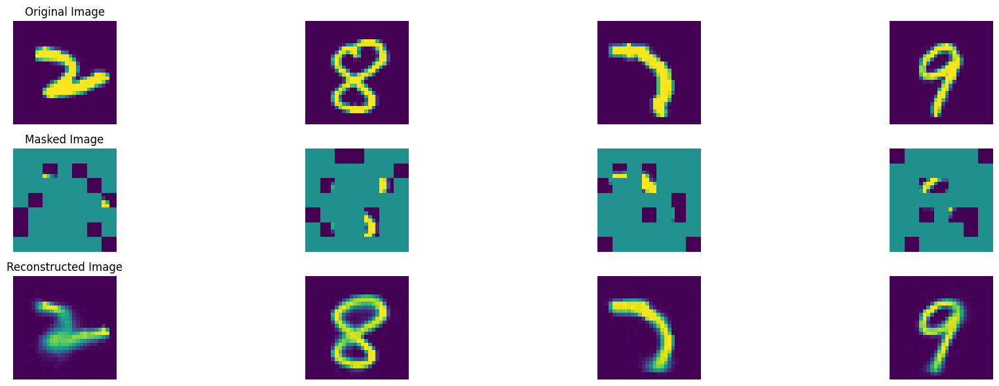

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 429, average traning loss is 0.10303677317309887.
=================== EPOCH:  430  ===================


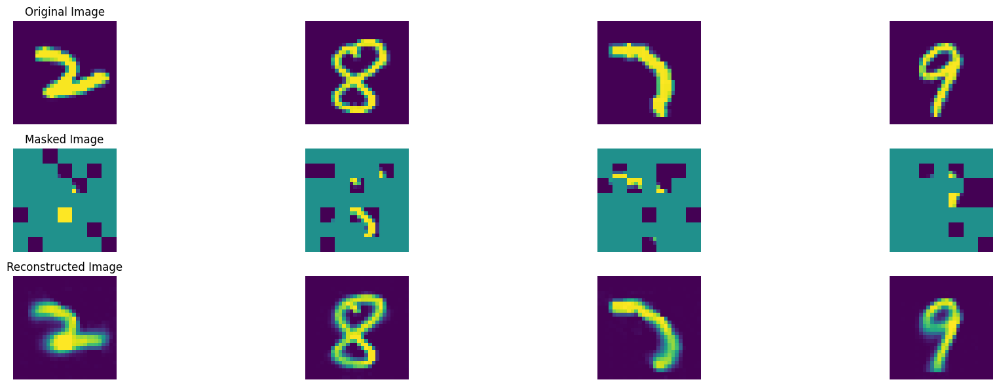

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 430, average traning loss is 0.10304733968161522.
=================== EPOCH:  431  ===================


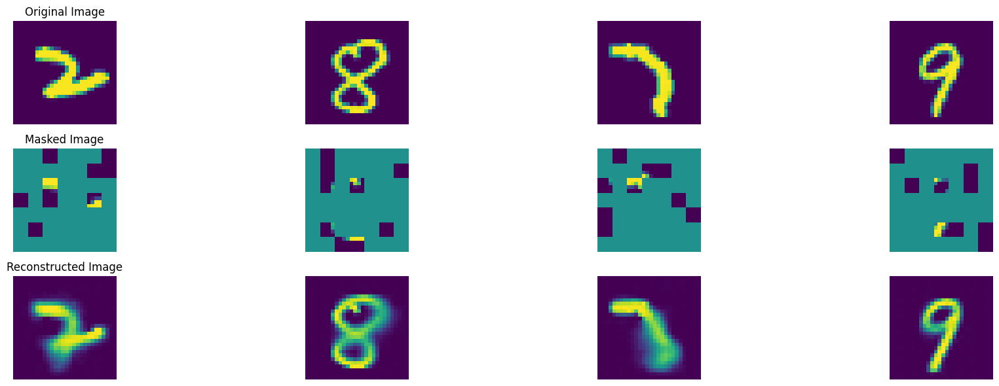

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 431, average traning loss is 0.10309203080040344.
=================== EPOCH:  432  ===================


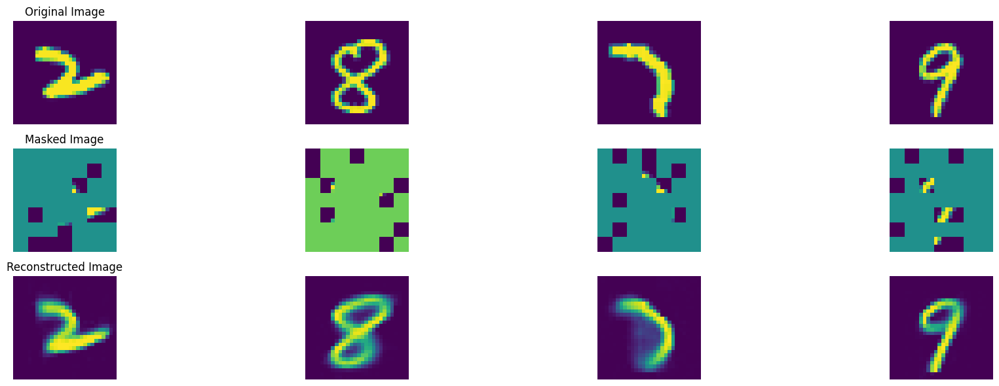

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 432, average traning loss is 0.10306884871518358.
=================== EPOCH:  433  ===================


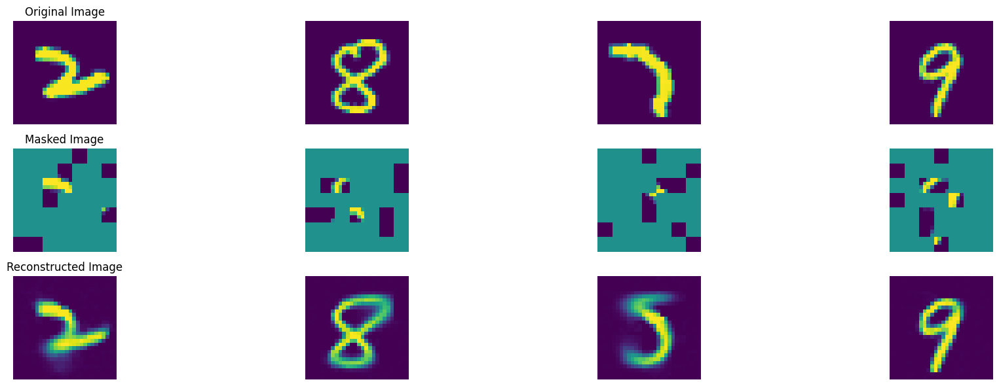

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 433, average traning loss is 0.10310703056289795.
=================== EPOCH:  434  ===================


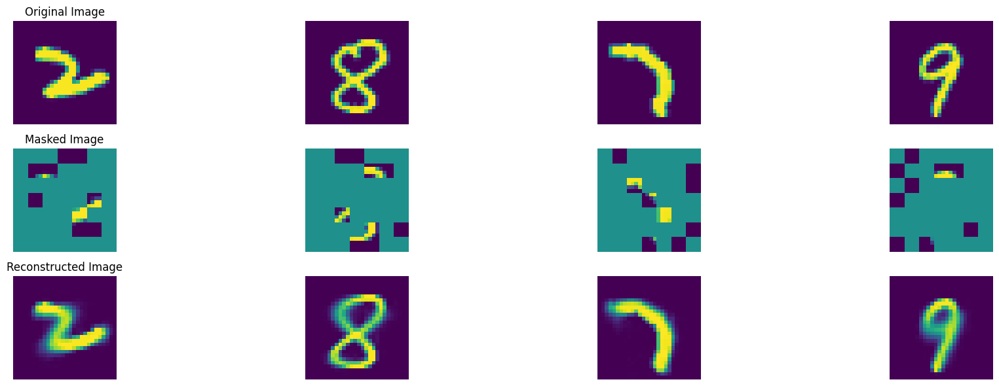

100%|██████████| 47/47 [00:08<00:00,  5.50it/s]


In epoch 434, average traning loss is 0.10311195777451738.
=================== EPOCH:  435  ===================


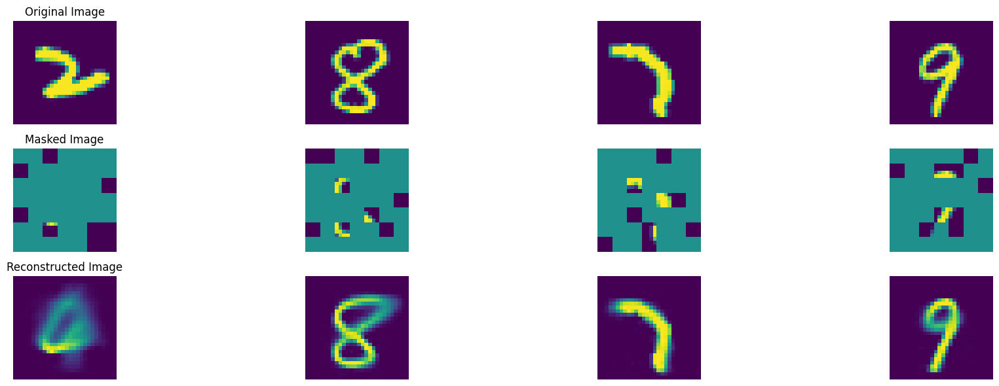

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 435, average traning loss is 0.10374127439361938.
=================== EPOCH:  436  ===================


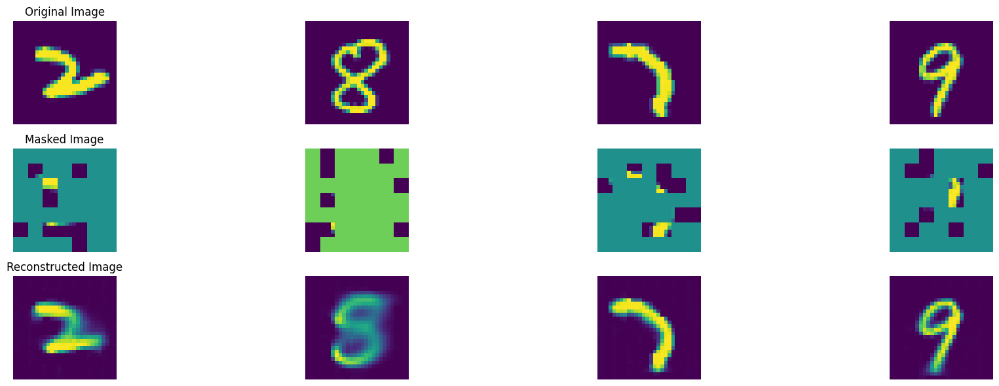

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 436, average traning loss is 0.10312492780862971.
=================== EPOCH:  437  ===================


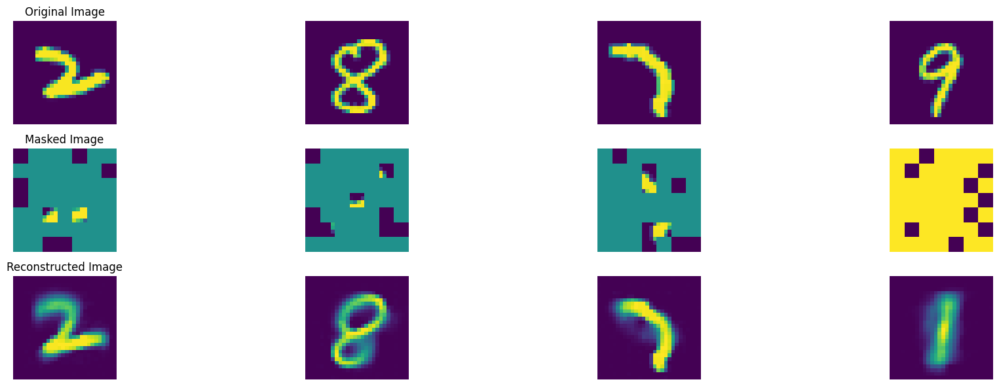

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 437, average traning loss is 0.10271695953734378.
=================== EPOCH:  438  ===================


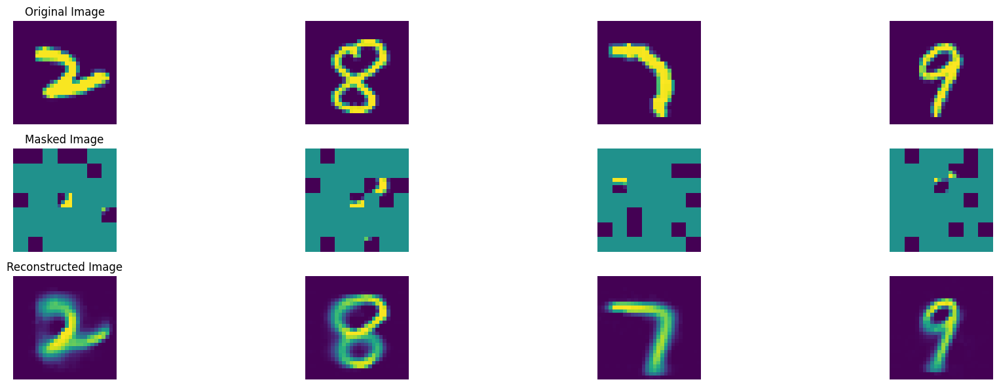

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 438, average traning loss is 0.10350695204861621.
=================== EPOCH:  439  ===================


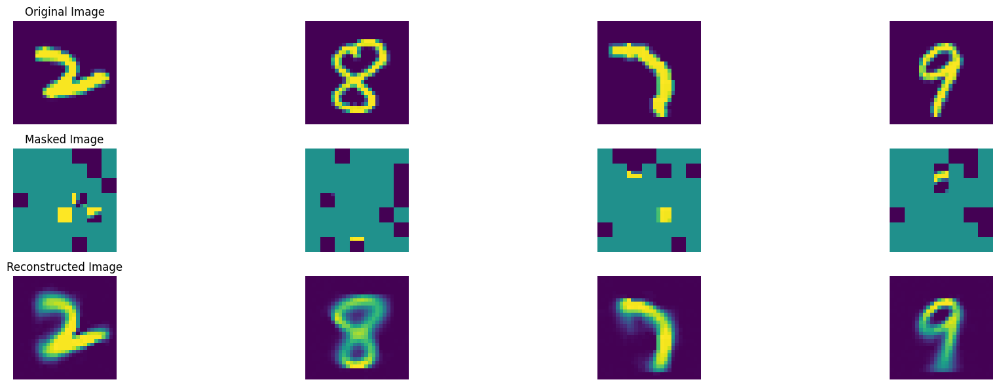

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 439, average traning loss is 0.10298974273052622.
=================== EPOCH:  440  ===================


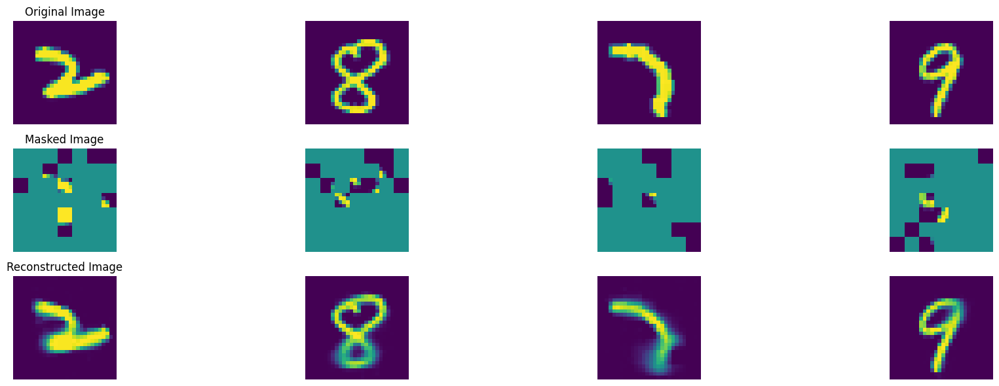

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 440, average traning loss is 0.10276114116323755.
=================== EPOCH:  441  ===================


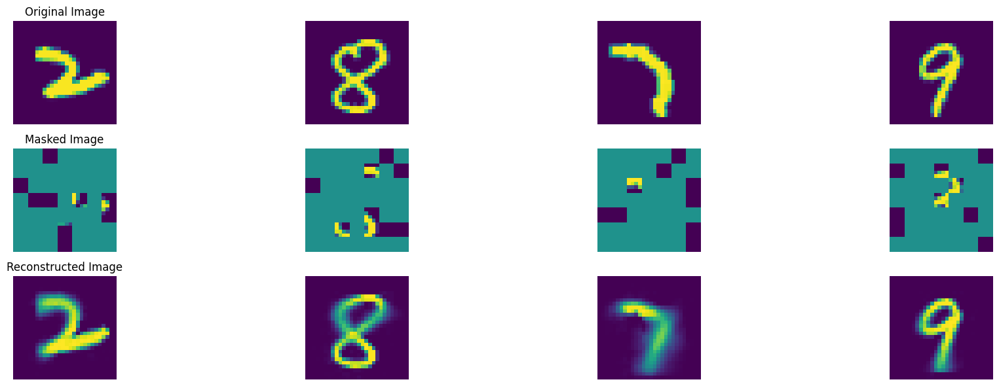

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 441, average traning loss is 0.10345858922030063.
=================== EPOCH:  442  ===================


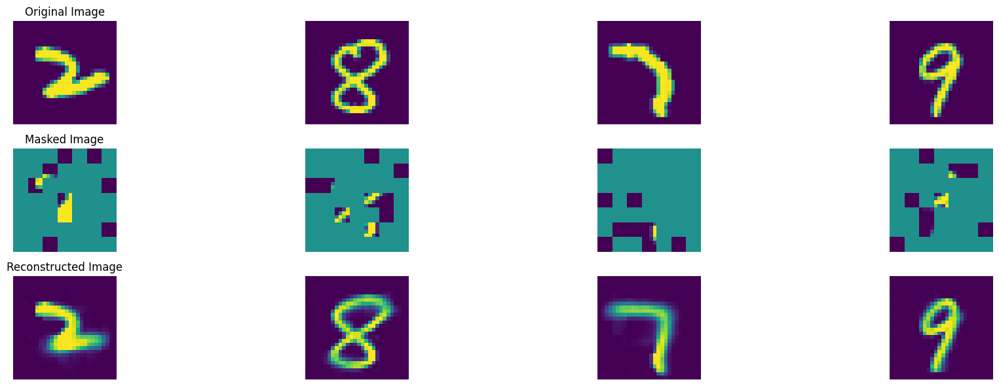

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 442, average traning loss is 0.10286564633567283.
=================== EPOCH:  443  ===================


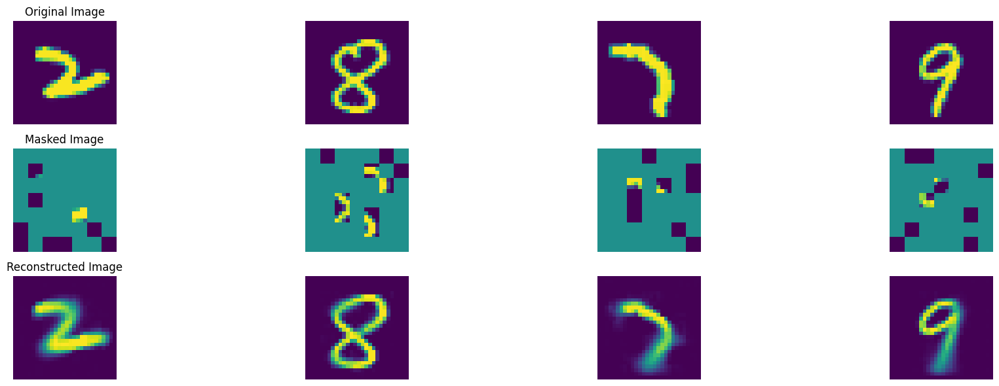

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 443, average traning loss is 0.1027076467871666.
=================== EPOCH:  444  ===================


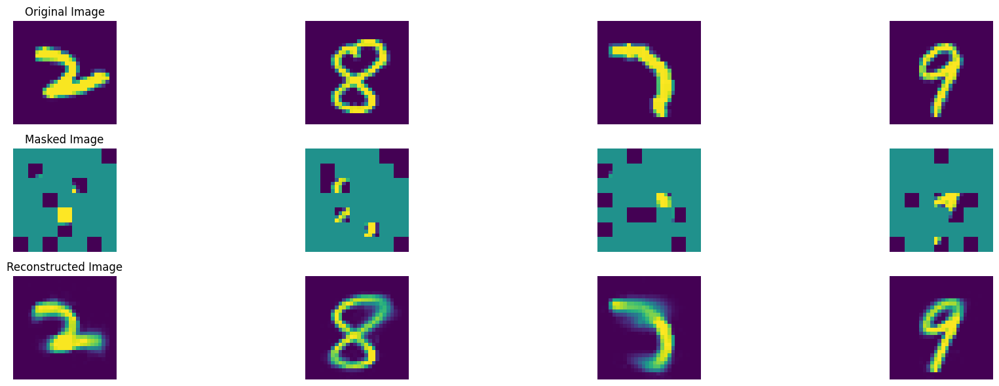

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 444, average traning loss is 0.10255402818005135.
=================== EPOCH:  445  ===================


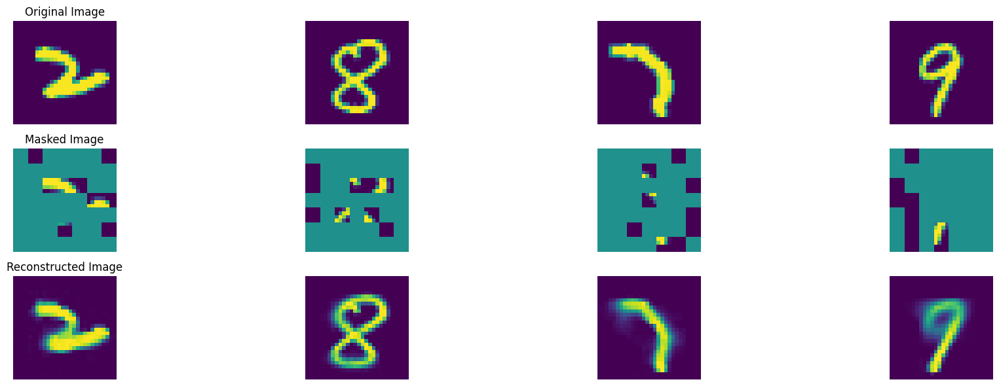

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 445, average traning loss is 0.10337291404287866.
=================== EPOCH:  446  ===================


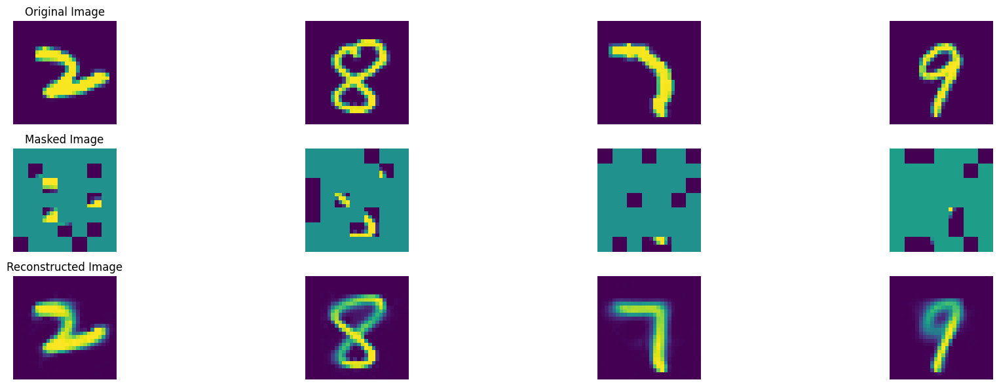

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 446, average traning loss is 0.10245863855519194.
=================== EPOCH:  447  ===================


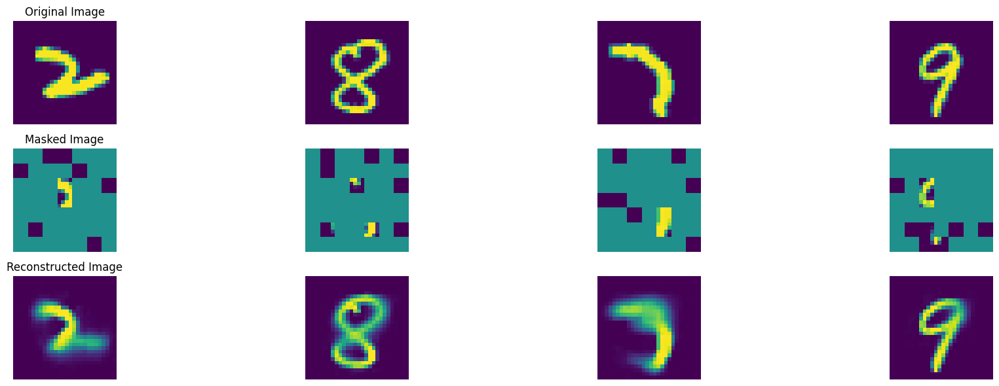

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 447, average traning loss is 0.10305045751181055.
=================== EPOCH:  448  ===================


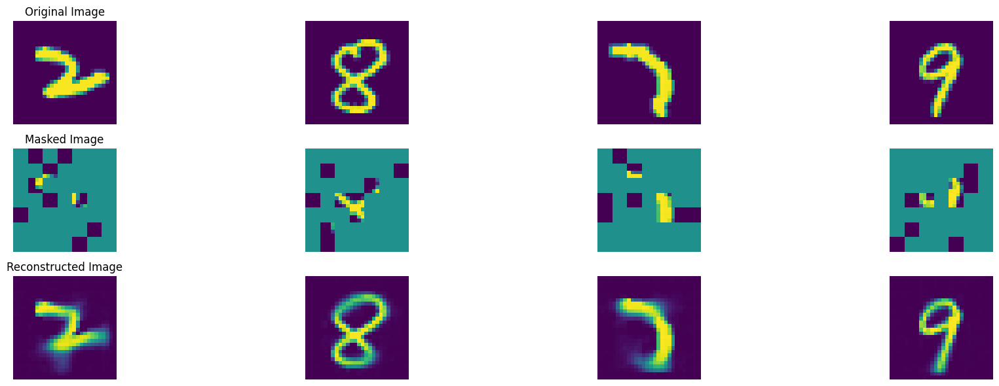

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 448, average traning loss is 0.10281831993067518.
=================== EPOCH:  449  ===================


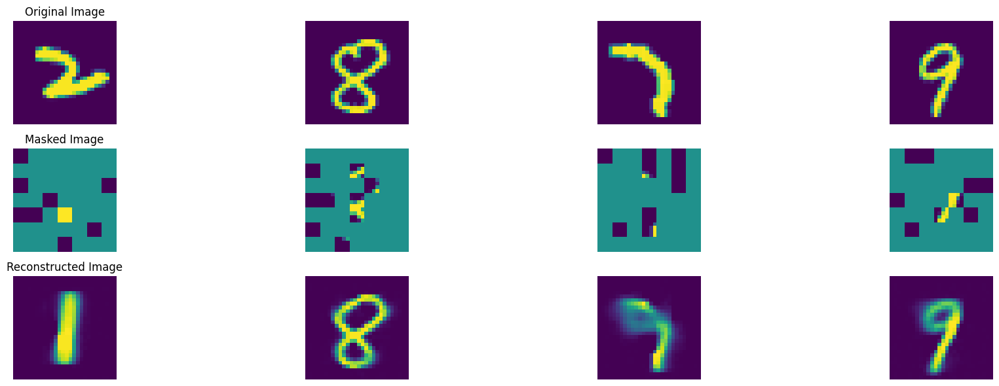

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 449, average traning loss is 0.10260259185699706.
=================== EPOCH:  450  ===================


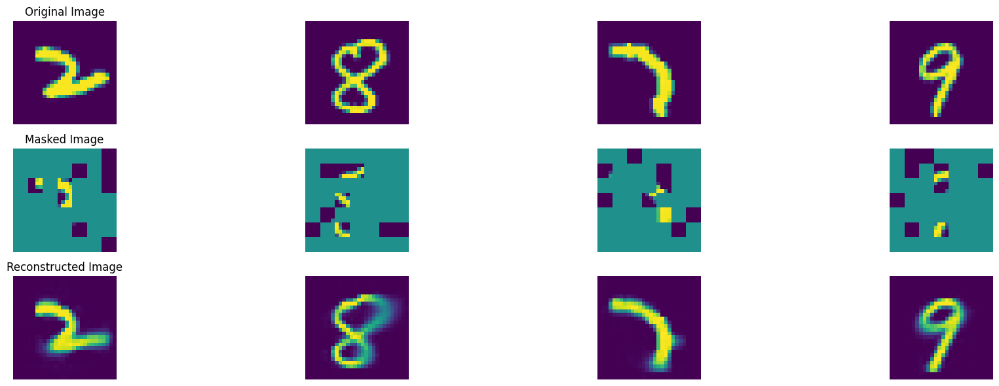

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 450, average traning loss is 0.10291704757416502.
=================== EPOCH:  451  ===================


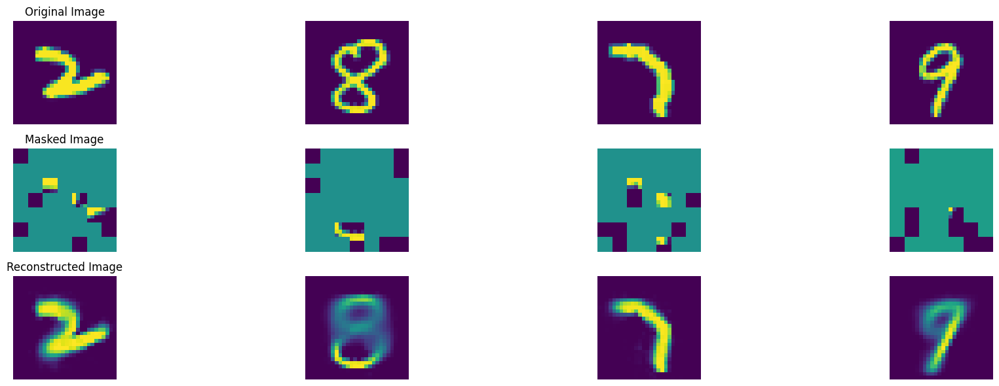

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 451, average traning loss is 0.10238578947300607.
=================== EPOCH:  452  ===================


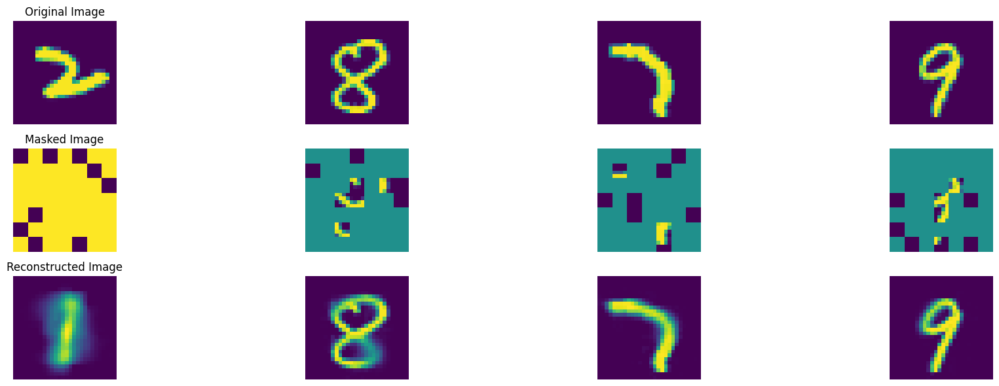

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 452, average traning loss is 0.10226956834184363.
=================== EPOCH:  453  ===================


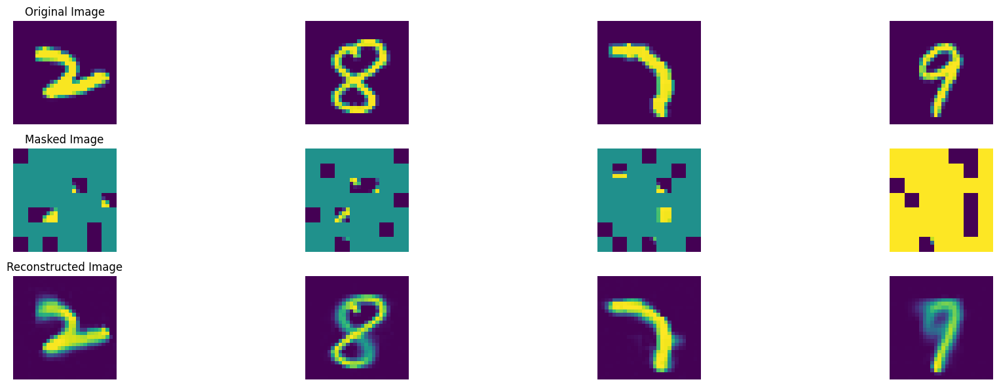

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 453, average traning loss is 0.10202948638099305.
=================== EPOCH:  454  ===================


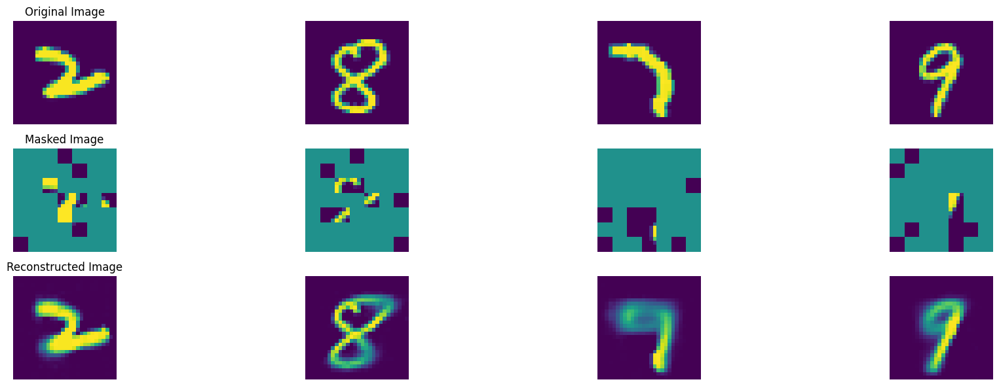

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 454, average traning loss is 0.1024369440497236.
=================== EPOCH:  455  ===================


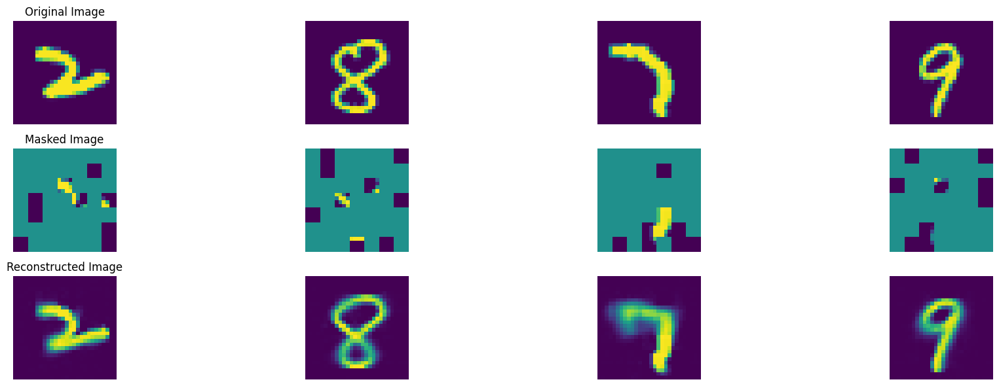

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 455, average traning loss is 0.10212462997816979.
=================== EPOCH:  456  ===================


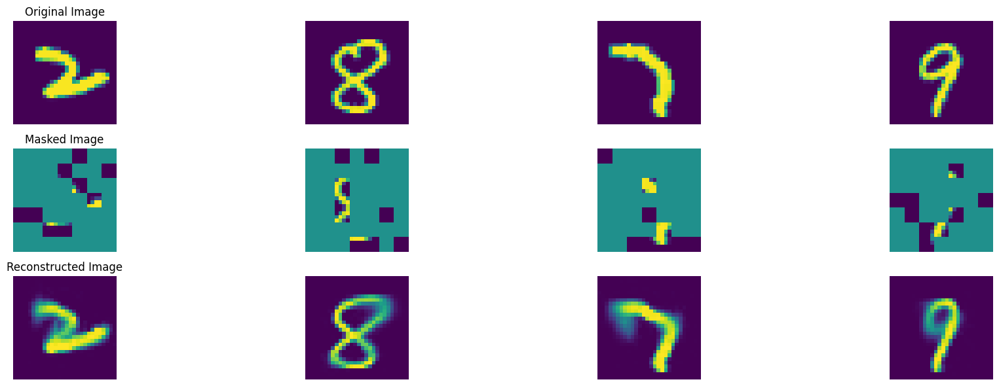

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 456, average traning loss is 0.10267119284005875.
=================== EPOCH:  457  ===================


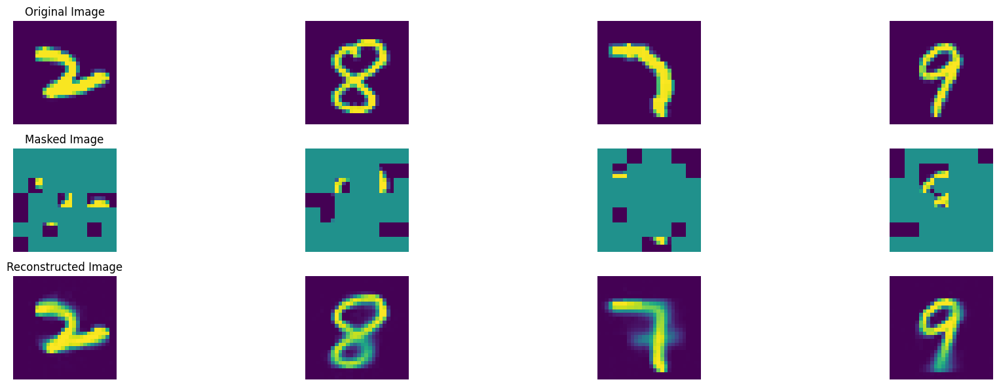

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 457, average traning loss is 0.10225660258785207.
=================== EPOCH:  458  ===================


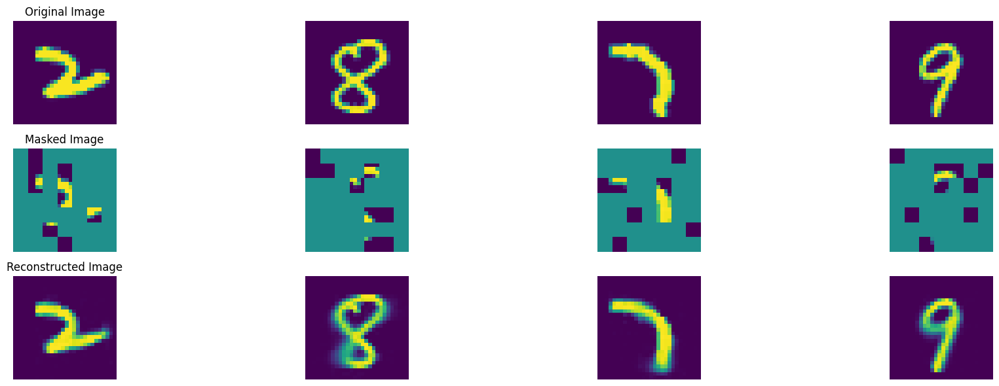

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 458, average traning loss is 0.1021371345887793.
=================== EPOCH:  459  ===================


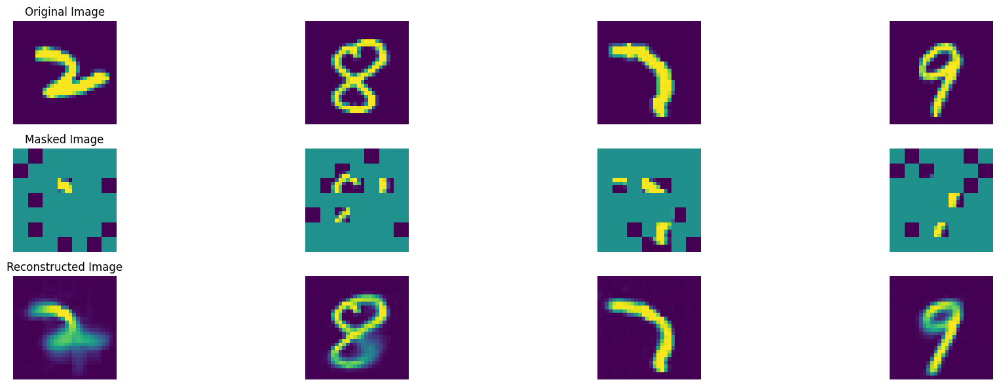

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 459, average traning loss is 0.10266837858139201.
=================== EPOCH:  460  ===================


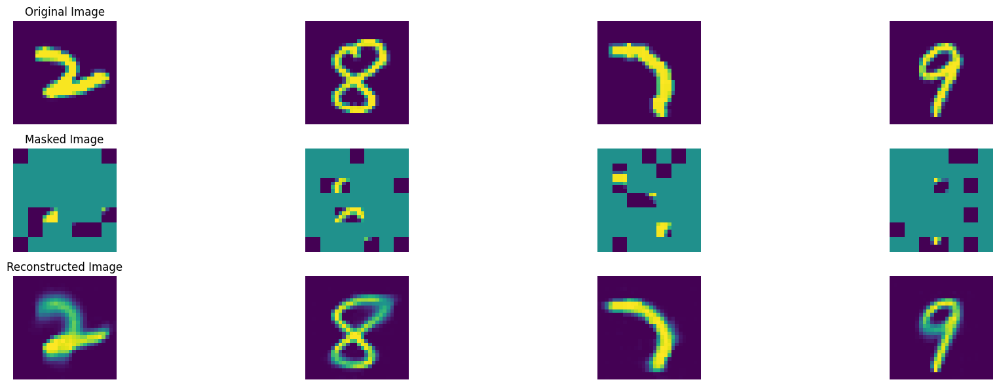

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 460, average traning loss is 0.10267248083936407.
=================== EPOCH:  461  ===================


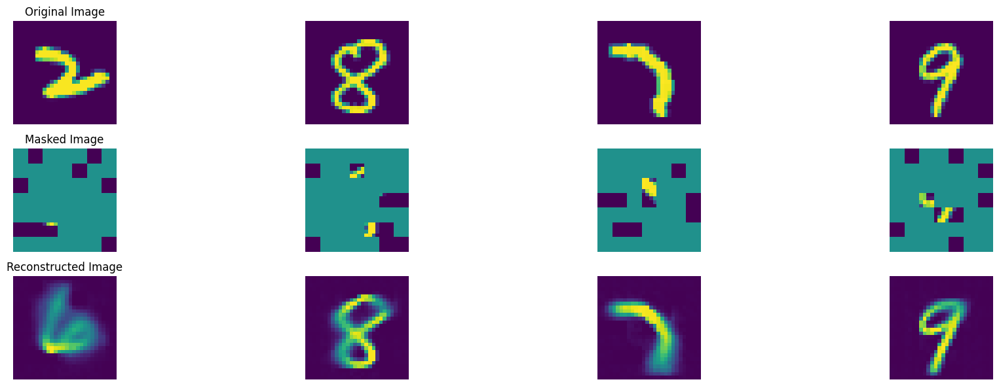

100%|██████████| 47/47 [00:08<00:00,  5.29it/s]


In epoch 461, average traning loss is 0.10296030532806477.
=================== EPOCH:  462  ===================


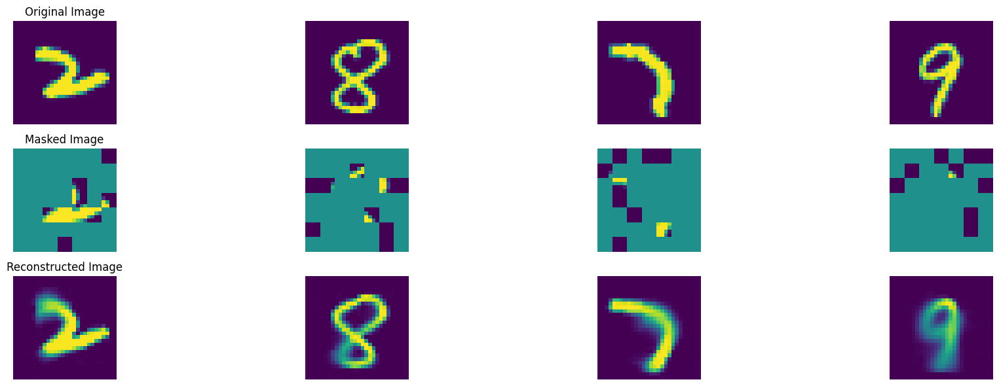

100%|██████████| 47/47 [00:09<00:00,  5.21it/s]


In epoch 462, average traning loss is 0.10217301721902604.
=================== EPOCH:  463  ===================


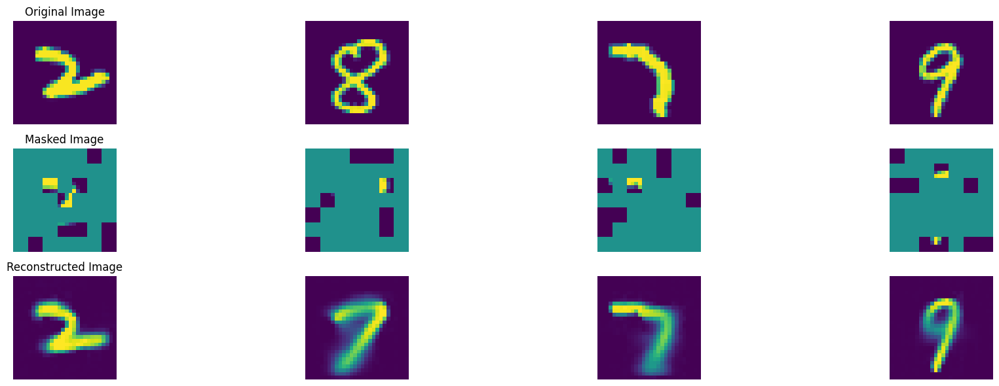

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 463, average traning loss is 0.1020377516112429.
=================== EPOCH:  464  ===================


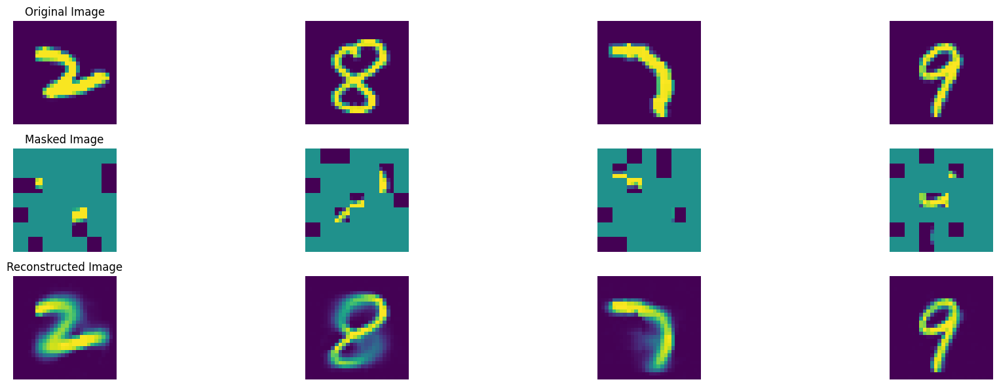

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 464, average traning loss is 0.10242019514454172.
=================== EPOCH:  465  ===================


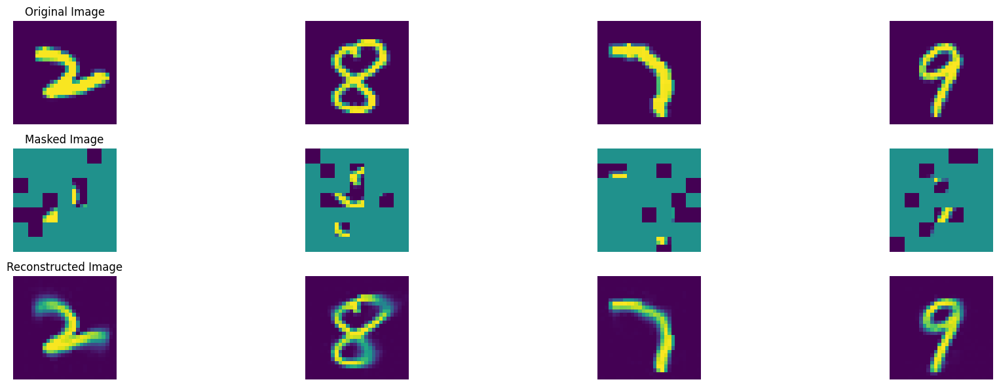

100%|██████████| 47/47 [00:08<00:00,  5.27it/s]


In epoch 465, average traning loss is 0.10185924077287634.
=================== EPOCH:  466  ===================


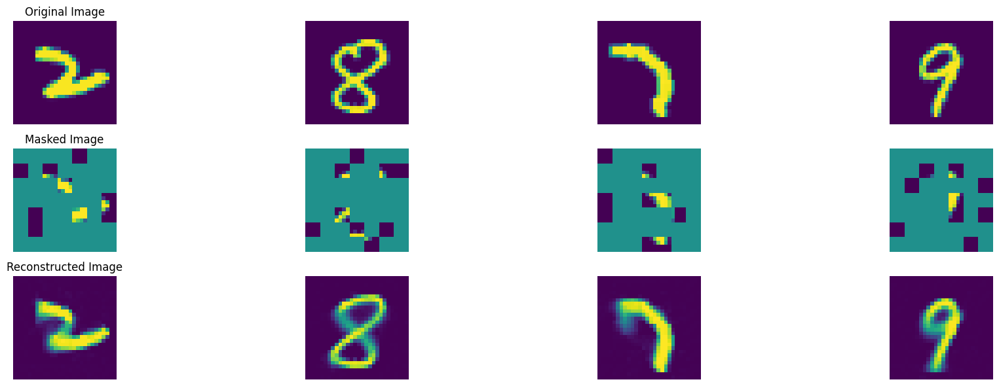

100%|██████████| 47/47 [00:08<00:00,  5.25it/s]


In epoch 466, average traning loss is 0.10194537852038728.
=================== EPOCH:  467  ===================


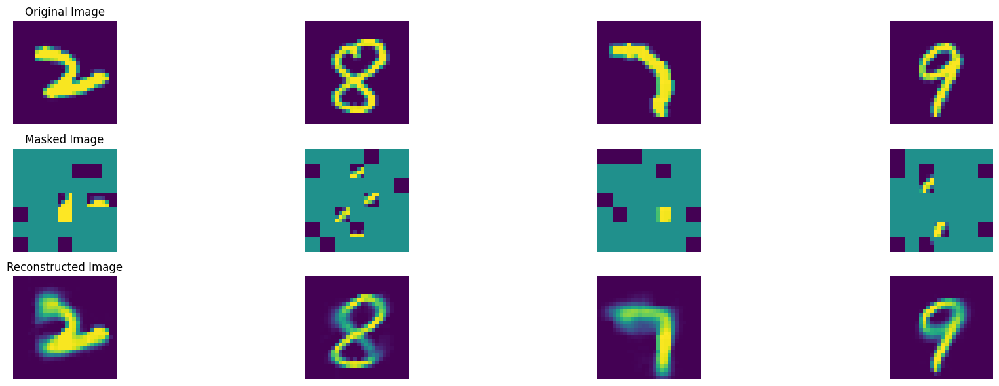

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 467, average traning loss is 0.10209345437110738.
=================== EPOCH:  468  ===================


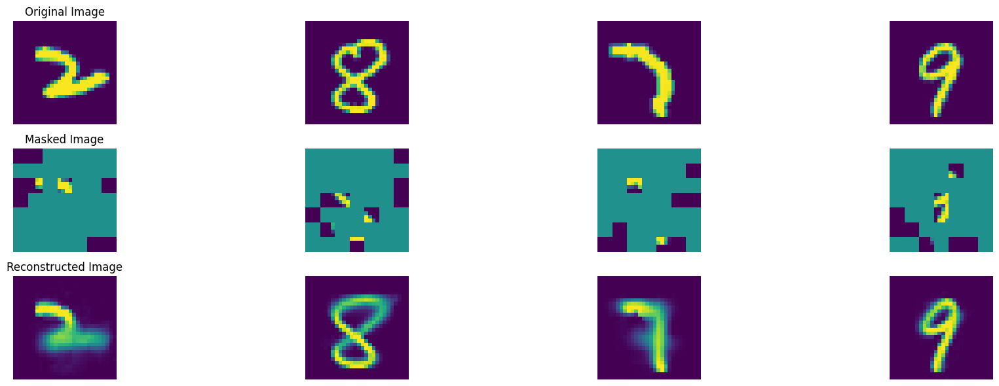

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 468, average traning loss is 0.10208262851897706.
=================== EPOCH:  469  ===================


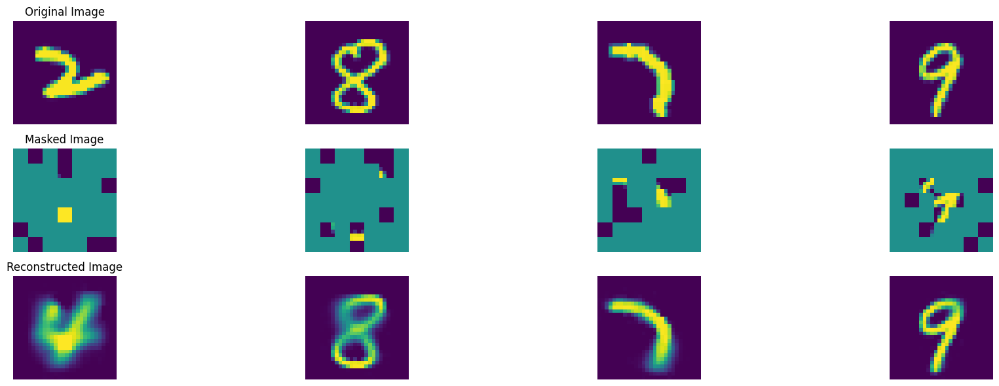

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 469, average traning loss is 0.10163676310726937.
=================== EPOCH:  470  ===================


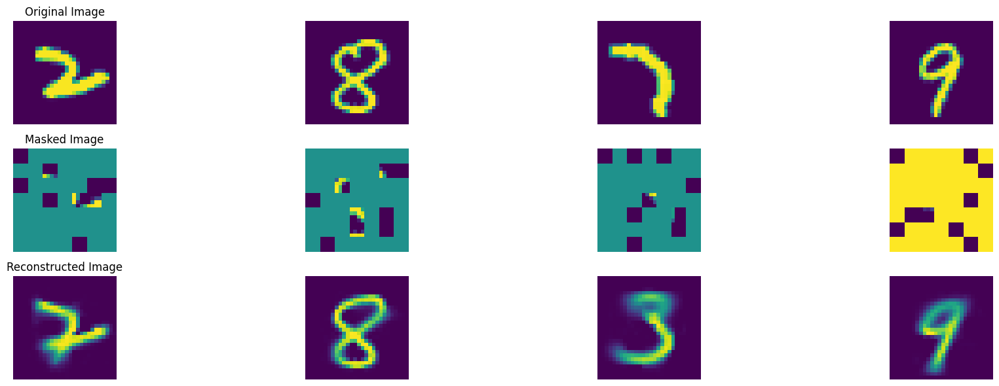

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 470, average traning loss is 0.10179268774834085.
=================== EPOCH:  471  ===================


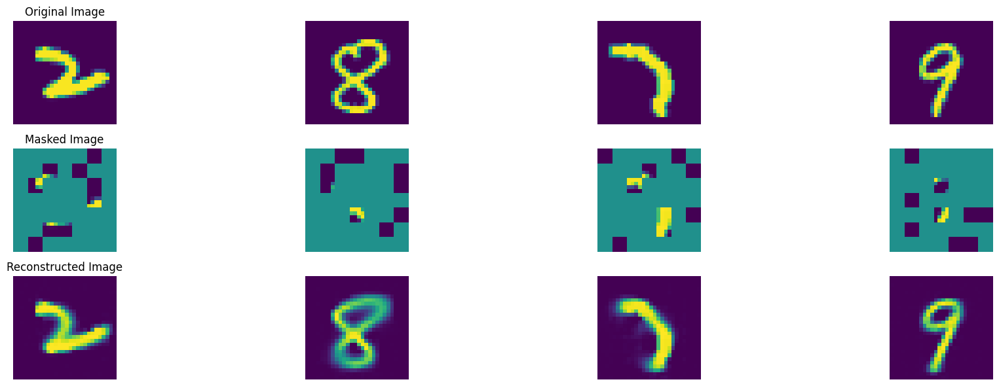

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 471, average traning loss is 0.10162029716562718.
=================== EPOCH:  472  ===================


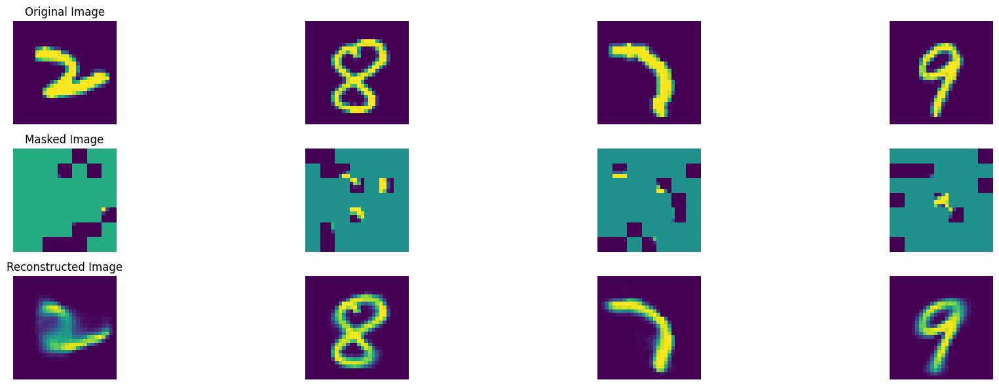

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 472, average traning loss is 0.10152004088493104.
=================== EPOCH:  473  ===================


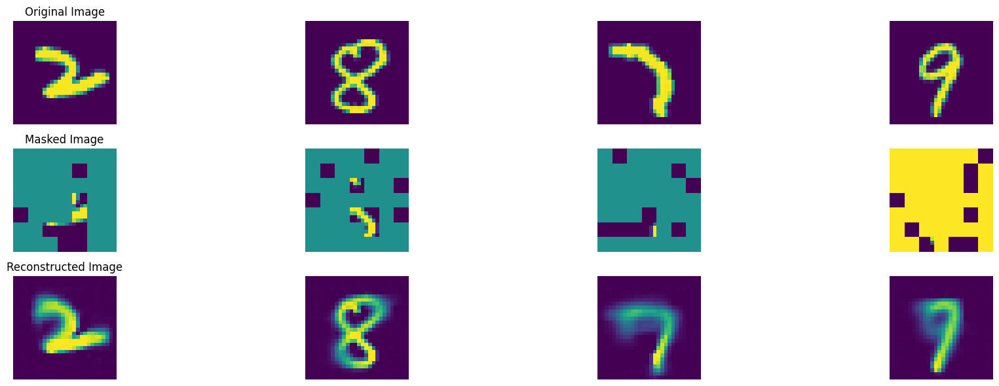

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 473, average traning loss is 0.10133818521144543.
=================== EPOCH:  474  ===================


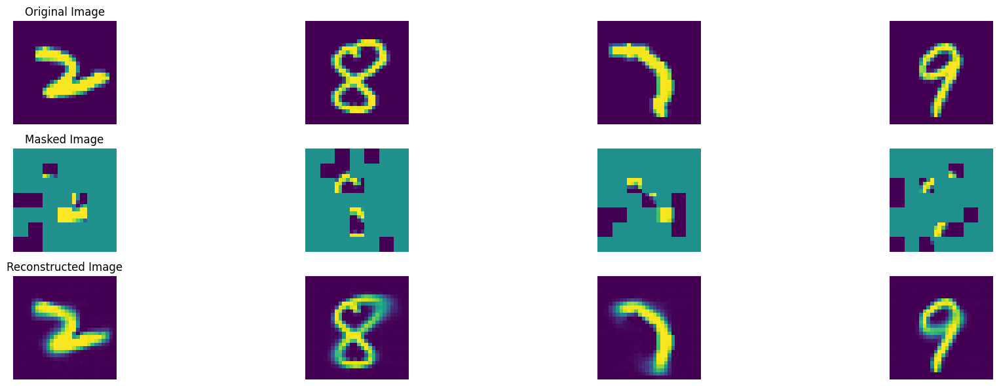

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 474, average traning loss is 0.10085701561988668.
=================== EPOCH:  475  ===================


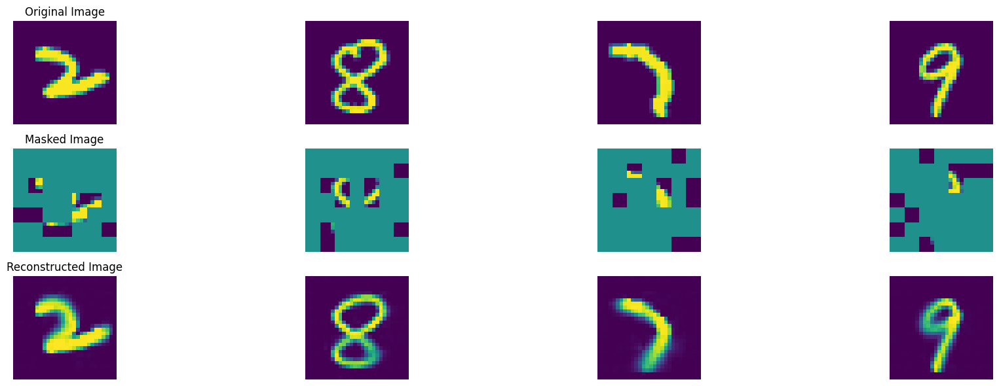

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 475, average traning loss is 0.10155430610509629.
=================== EPOCH:  476  ===================


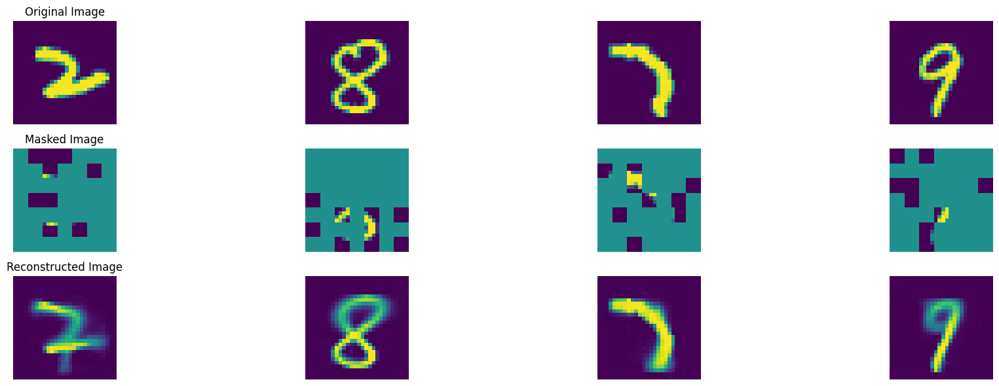

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 476, average traning loss is 0.10131232266096359.
=================== EPOCH:  477  ===================


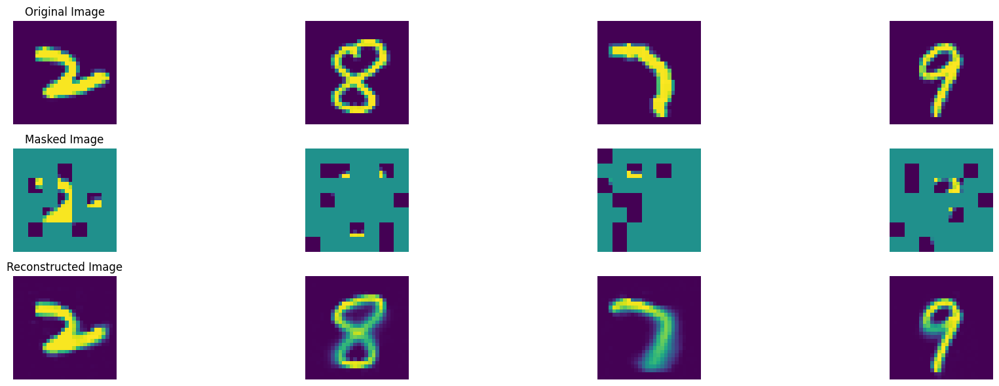

100%|██████████| 47/47 [00:08<00:00,  5.50it/s]


In epoch 477, average traning loss is 0.10160587601205136.
=================== EPOCH:  478  ===================


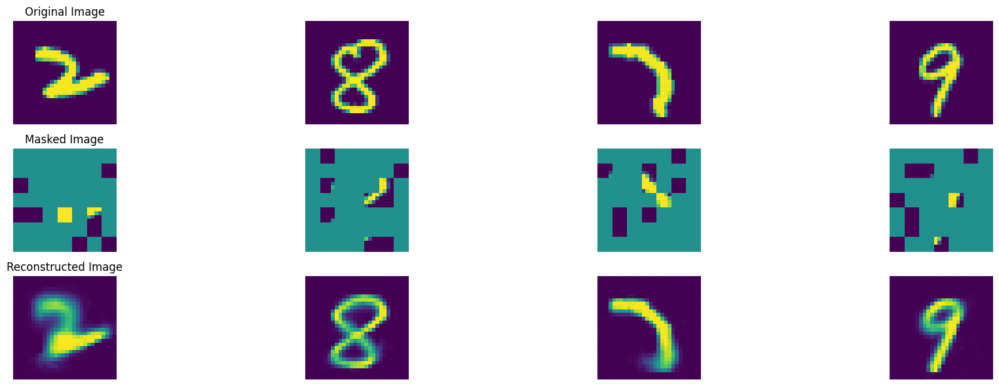

100%|██████████| 47/47 [00:08<00:00,  5.27it/s]


In epoch 478, average traning loss is 0.10140517052817852.
=================== EPOCH:  479  ===================


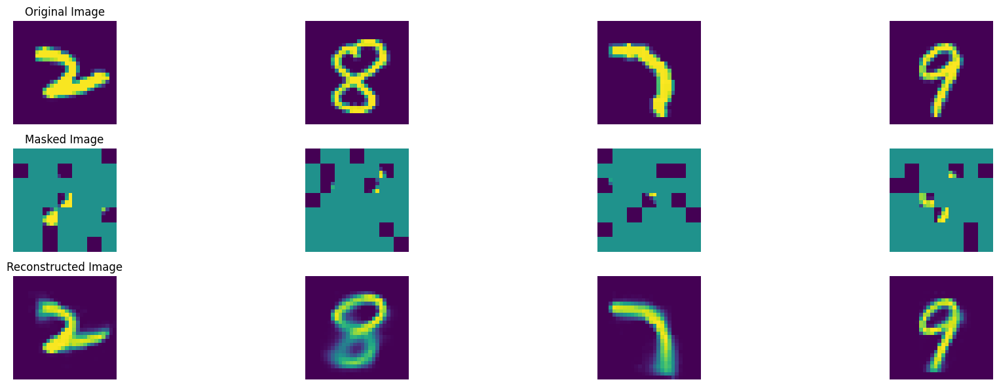

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 479, average traning loss is 0.10125512360258306.
=================== EPOCH:  480  ===================


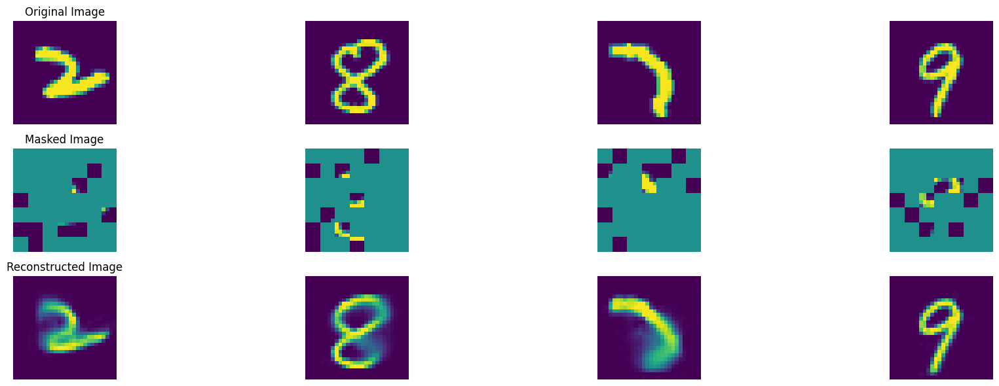

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 480, average traning loss is 0.10142795963490263.
=================== EPOCH:  481  ===================


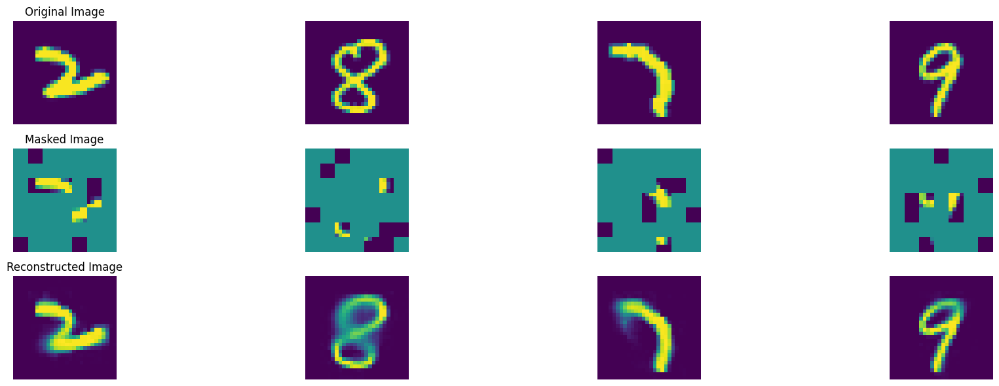

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 481, average traning loss is 0.10107803804443237.
=================== EPOCH:  482  ===================


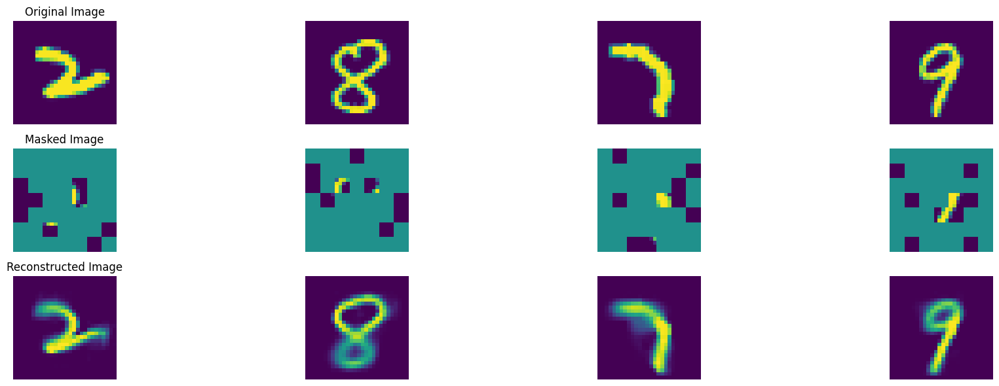

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 482, average traning loss is 0.10156033013729339.
=================== EPOCH:  483  ===================


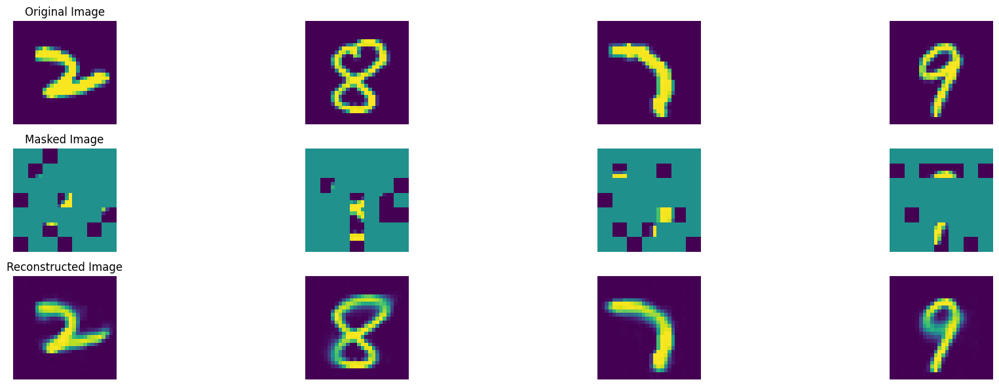

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 483, average traning loss is 0.1010150966492105.
=================== EPOCH:  484  ===================


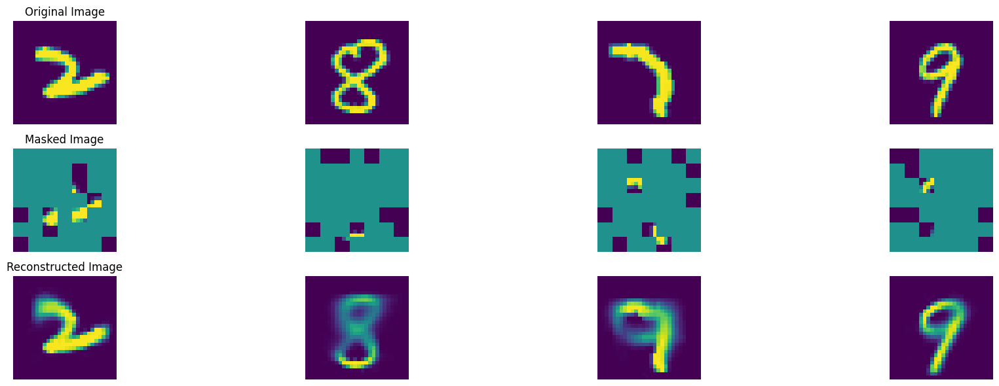

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 484, average traning loss is 0.10107563943304915.
=================== EPOCH:  485  ===================


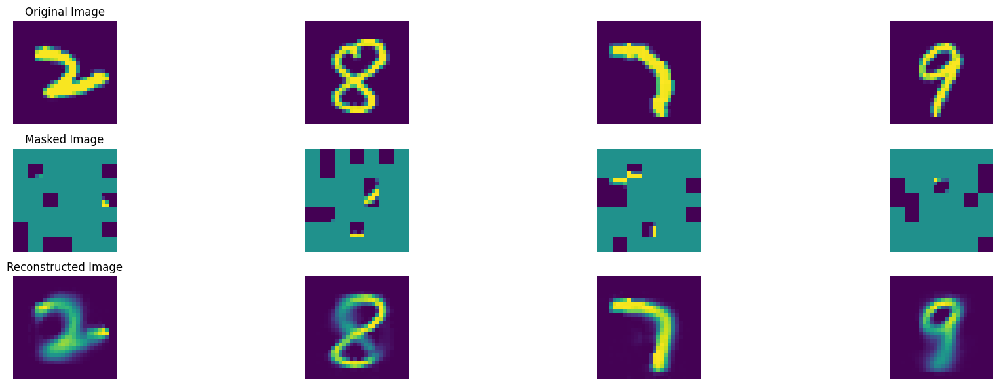

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 485, average traning loss is 0.1016236163200216.
=================== EPOCH:  486  ===================


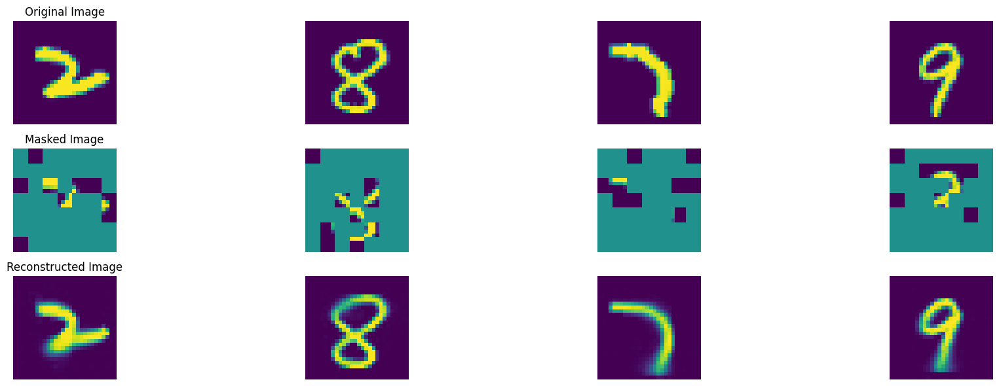

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 486, average traning loss is 0.10142447197056831.
=================== EPOCH:  487  ===================


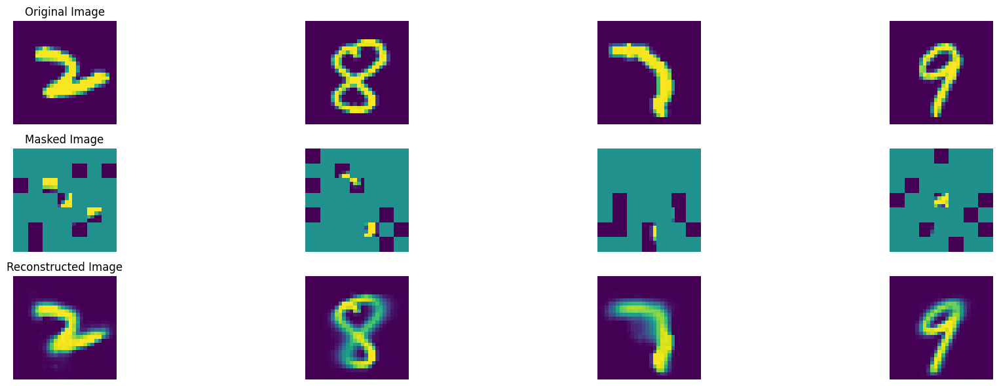

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 487, average traning loss is 0.10082483672081156.
=================== EPOCH:  488  ===================


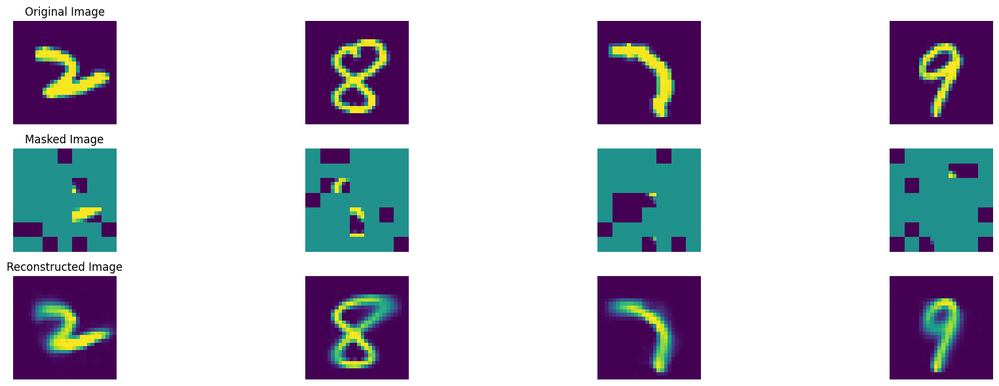

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 488, average traning loss is 0.10072881474773934.
=================== EPOCH:  489  ===================


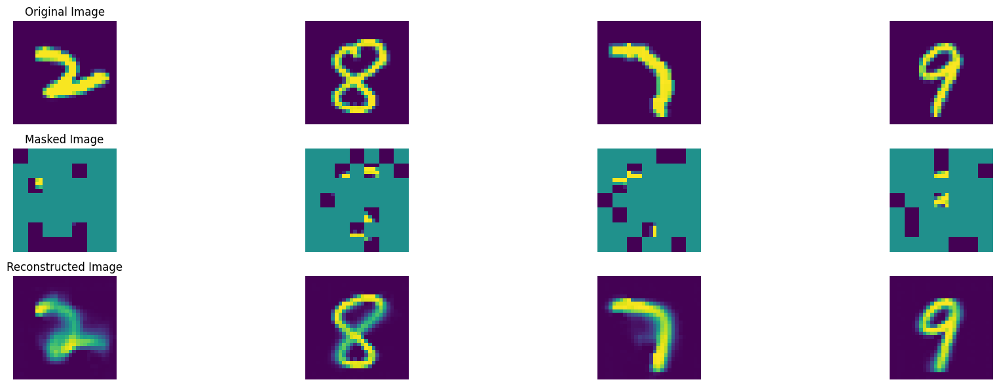

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 489, average traning loss is 0.10128611151842361.
=================== EPOCH:  490  ===================


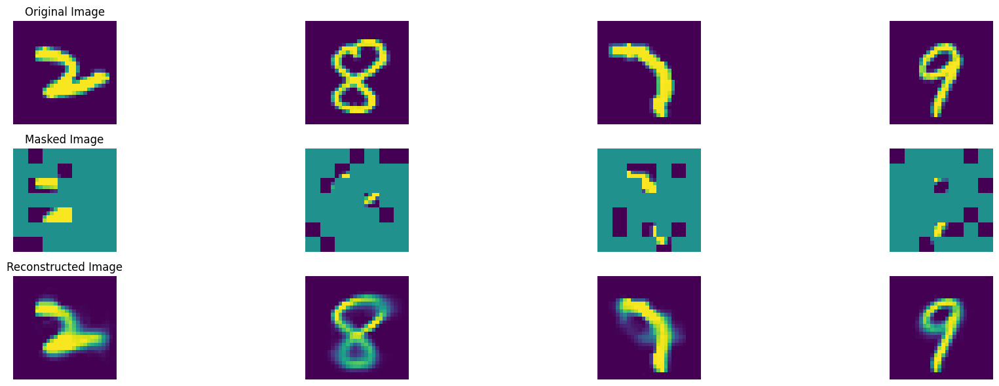

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 490, average traning loss is 0.10079251594365911.
=================== EPOCH:  491  ===================


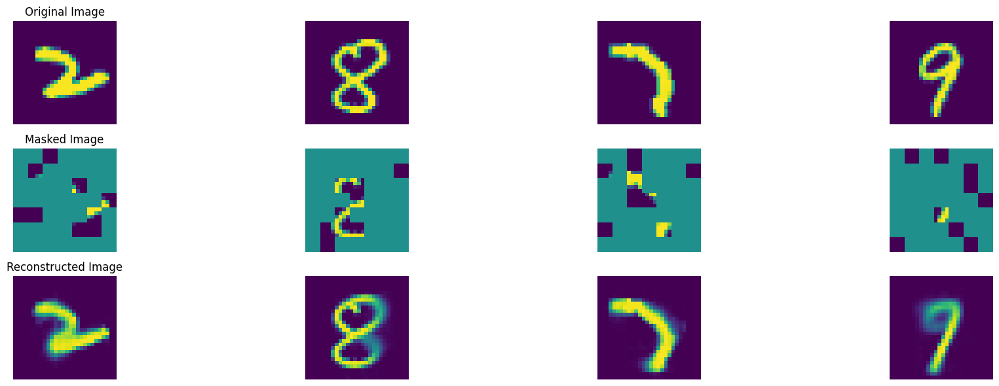

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 491, average traning loss is 0.10128521348567719.
=================== EPOCH:  492  ===================


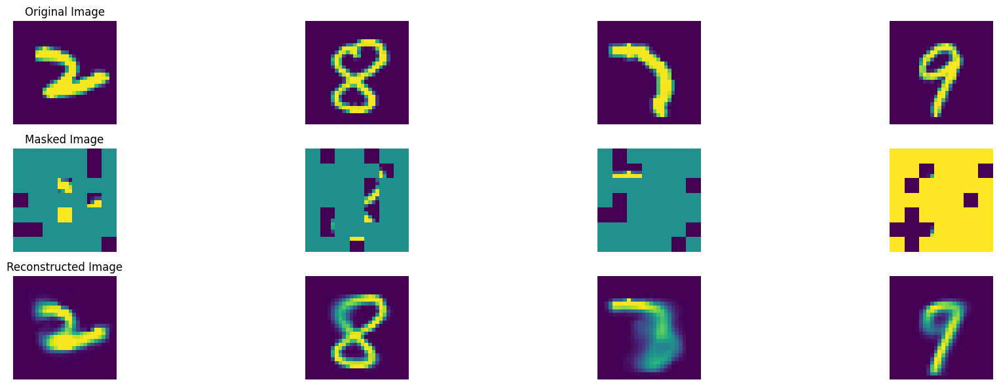

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 492, average traning loss is 0.10121641038580144.
=================== EPOCH:  493  ===================


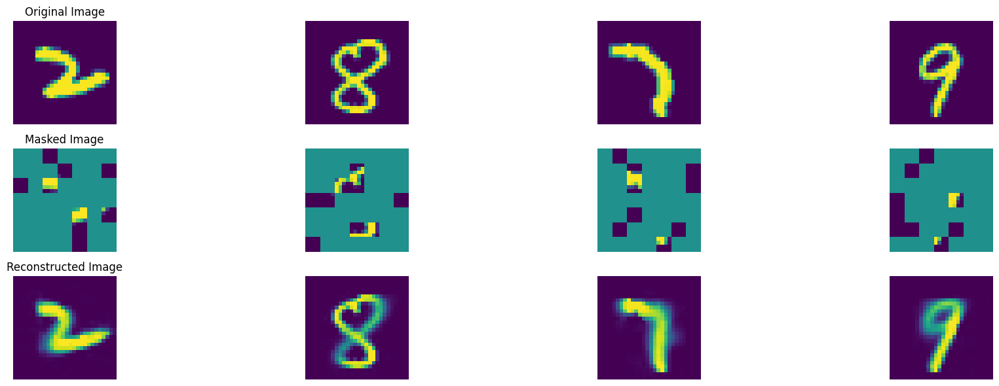

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 493, average traning loss is 0.10077569712983801.
=================== EPOCH:  494  ===================


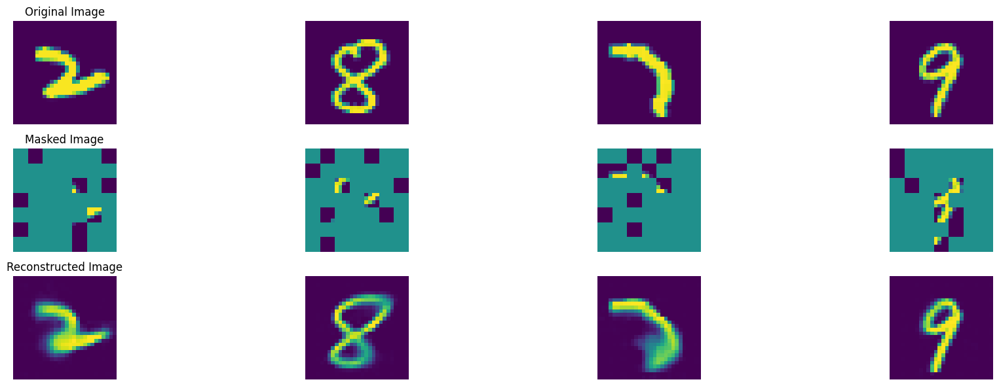

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 494, average traning loss is 0.10146444909116055.
=================== EPOCH:  495  ===================


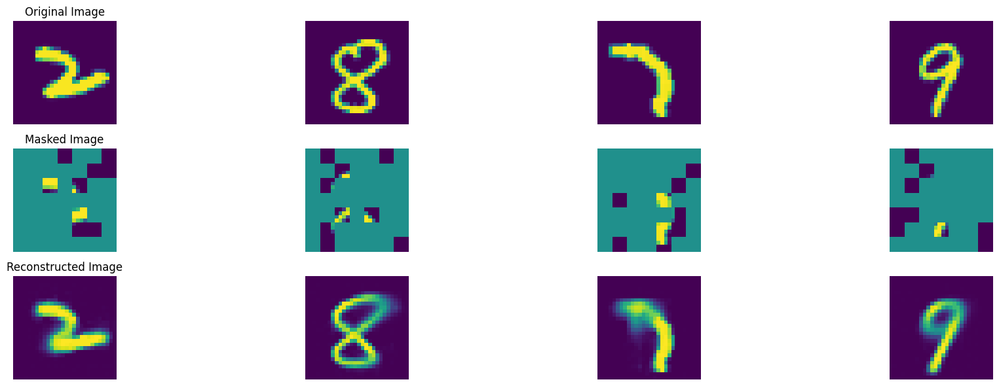

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 495, average traning loss is 0.10110578131168446.
=================== EPOCH:  496  ===================


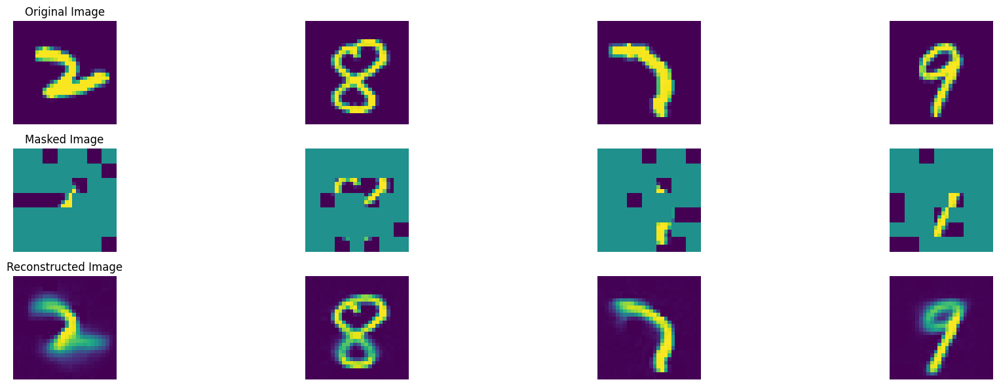

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 496, average traning loss is 0.10023631472536858.
=================== EPOCH:  497  ===================


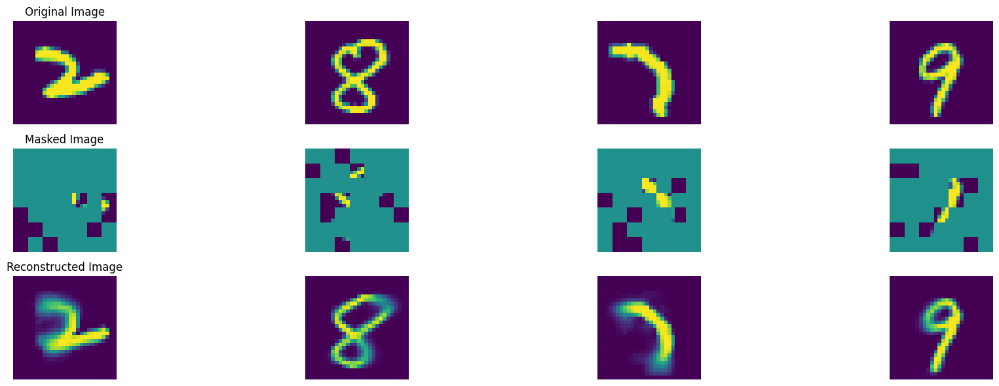

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 497, average traning loss is 0.10091687960827604.
=================== EPOCH:  498  ===================


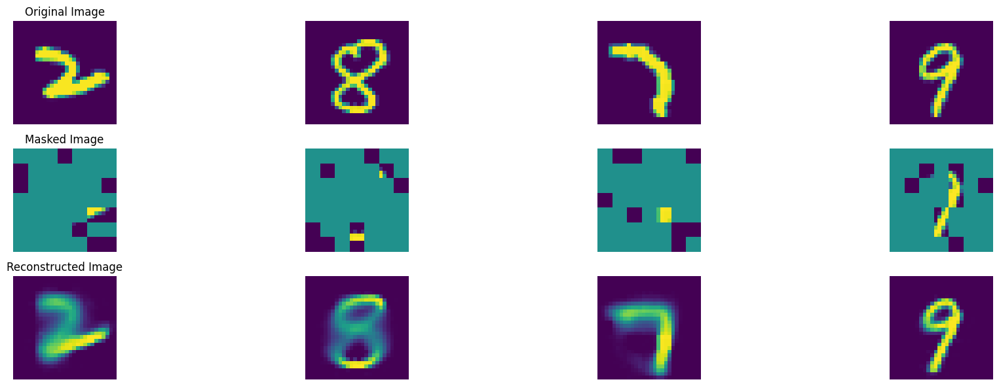

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 498, average traning loss is 0.10061697741138174.
=================== EPOCH:  499  ===================


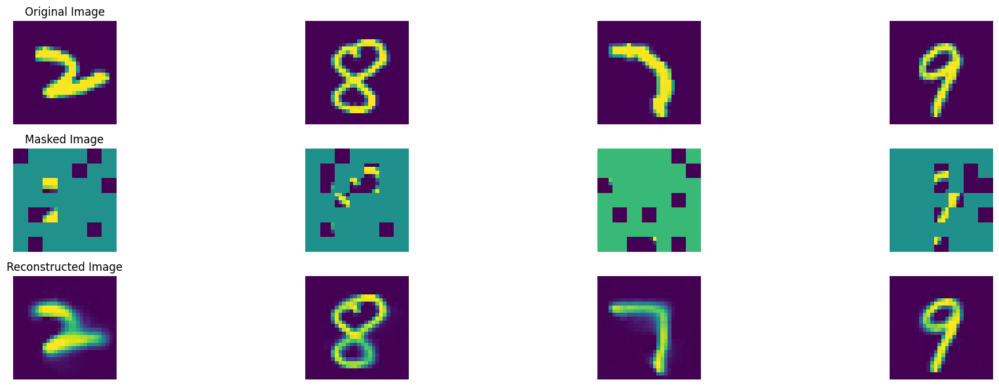

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 499, average traning loss is 0.10086171091236967.
=================== EPOCH:  500  ===================


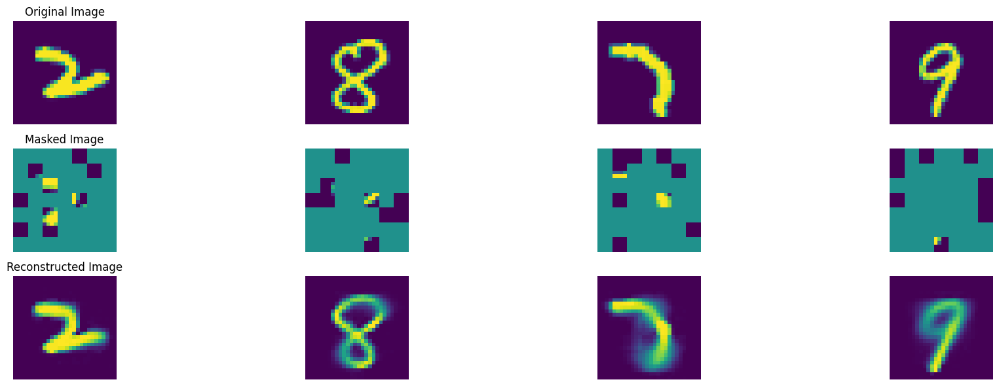

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 500, average traning loss is 0.100542480958269.
=================== EPOCH:  501  ===================


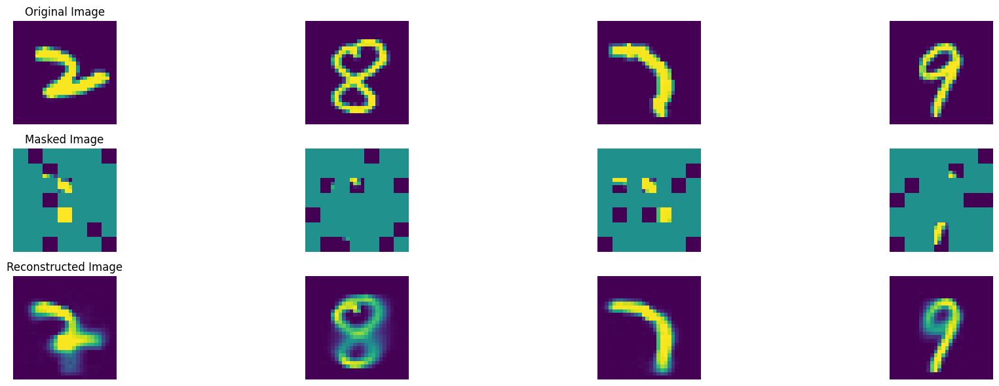

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 501, average traning loss is 0.10121941376239696.
=================== EPOCH:  502  ===================


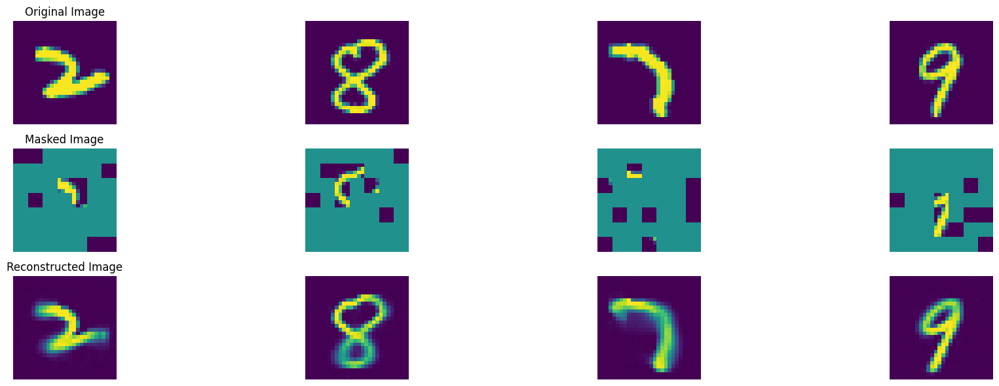

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 502, average traning loss is 0.10045696240156254.
=================== EPOCH:  503  ===================


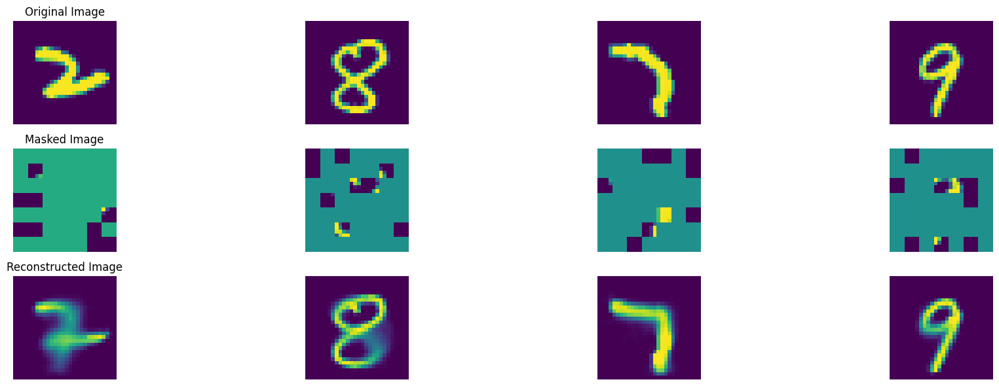

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 503, average traning loss is 0.1004085973539251.
=================== EPOCH:  504  ===================


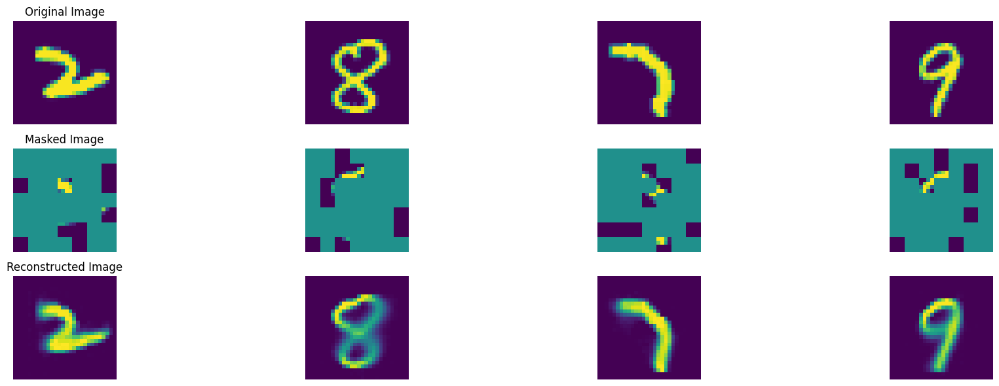

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 504, average traning loss is 0.10016033861865388.
=================== EPOCH:  505  ===================


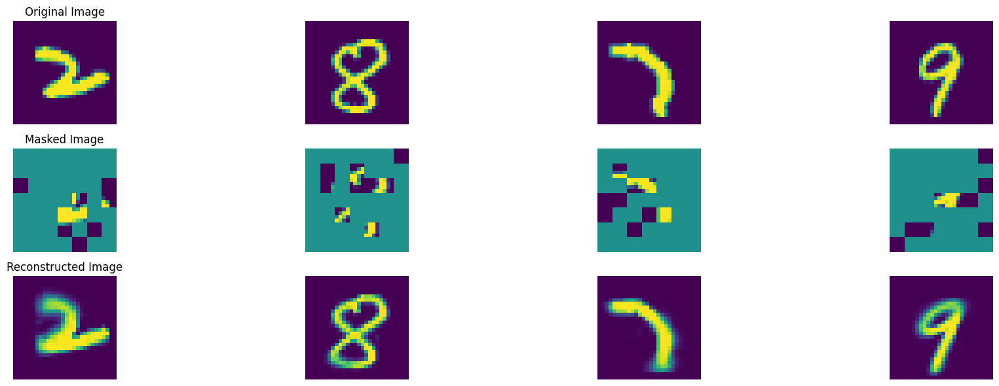

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 505, average traning loss is 0.1006139337699464.
=================== EPOCH:  506  ===================


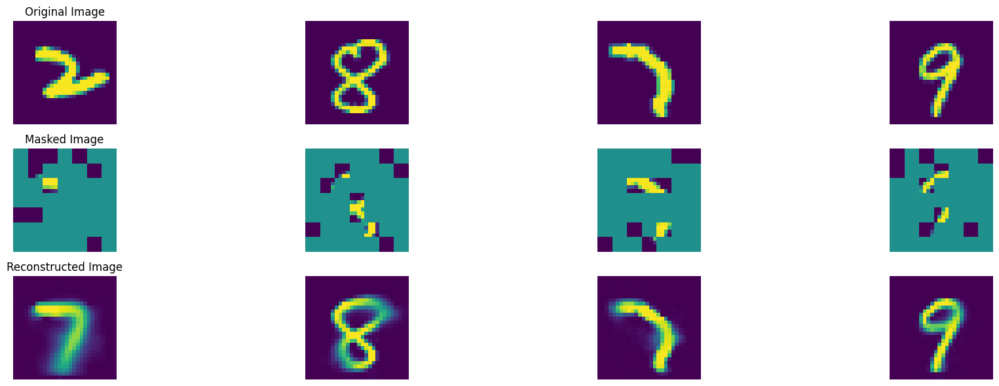

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 506, average traning loss is 0.1001104400195974.
=================== EPOCH:  507  ===================


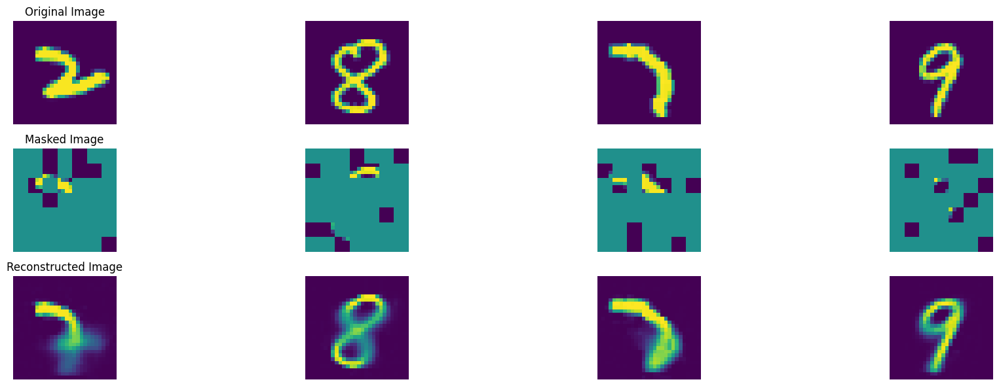

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 507, average traning loss is 0.1003498541230851.
=================== EPOCH:  508  ===================


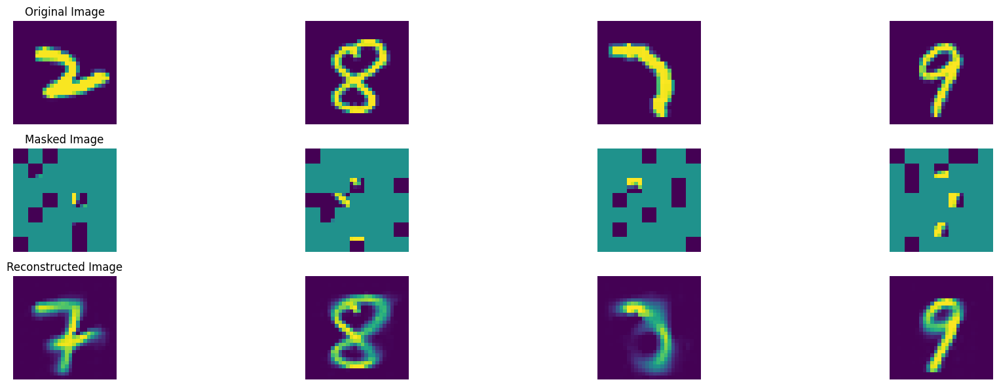

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 508, average traning loss is 0.10034429472177586.
=================== EPOCH:  509  ===================


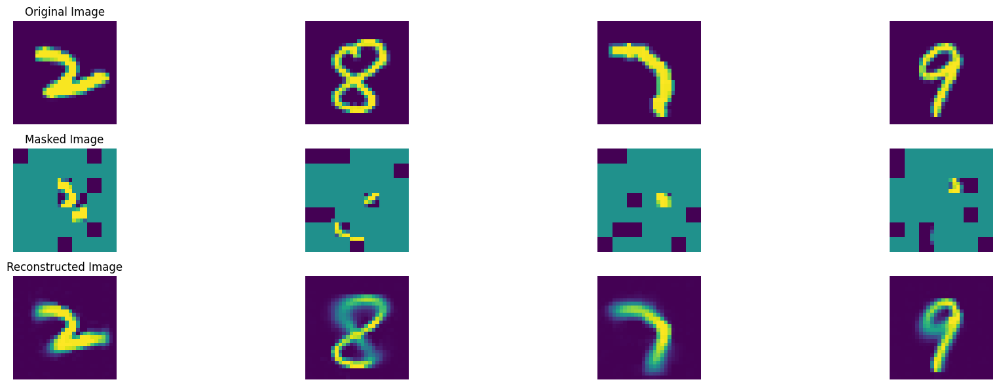

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 509, average traning loss is 0.100128950115214.
=================== EPOCH:  510  ===================


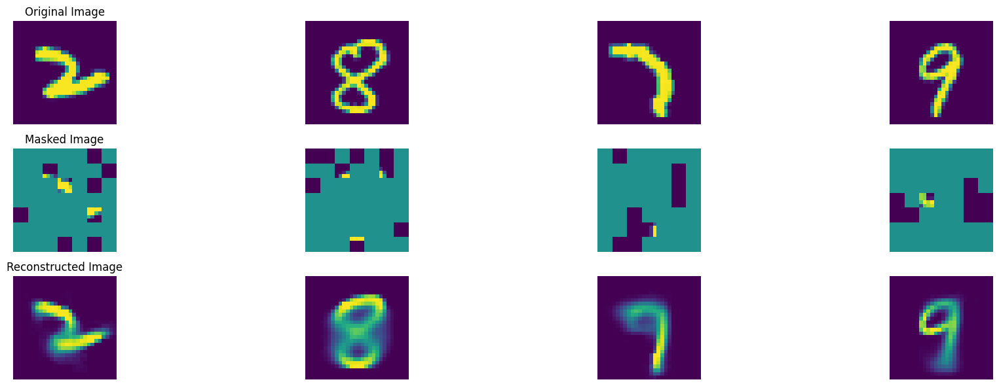

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 510, average traning loss is 0.10023981190108239.
=================== EPOCH:  511  ===================


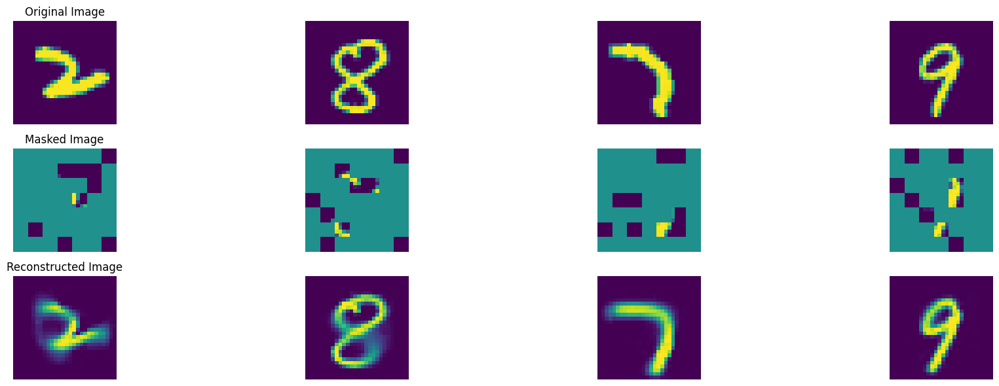

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 511, average traning loss is 0.10066187318335189.
=================== EPOCH:  512  ===================


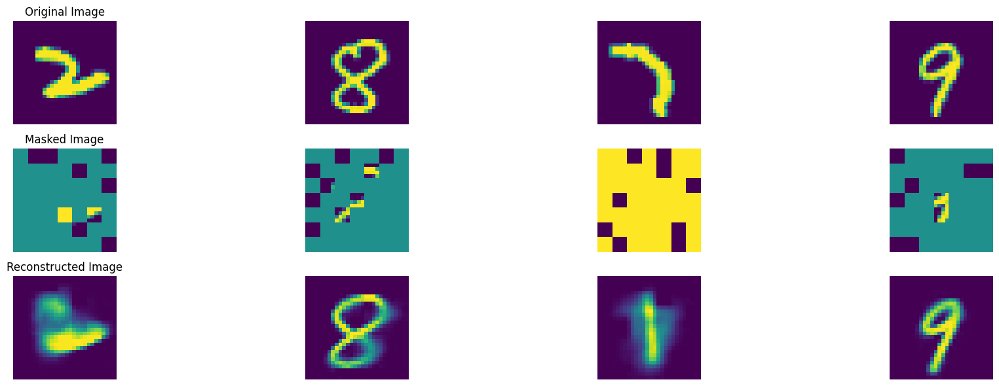

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 512, average traning loss is 0.09986307725627372.
=================== EPOCH:  513  ===================


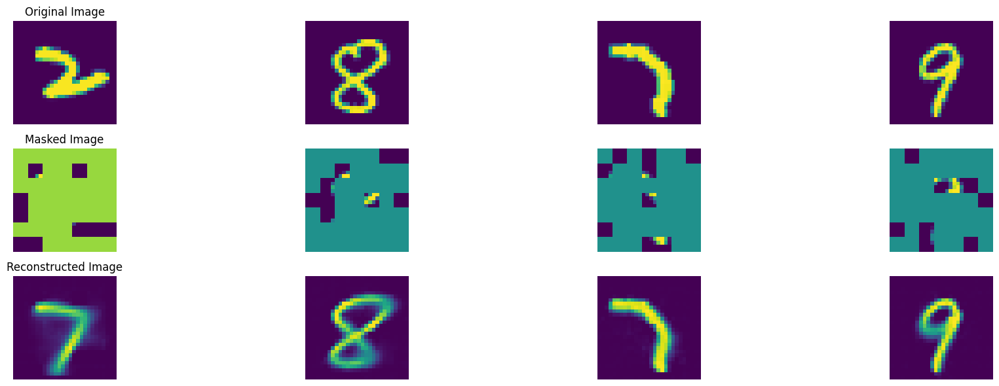

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 513, average traning loss is 0.1004367765594036.
=================== EPOCH:  514  ===================


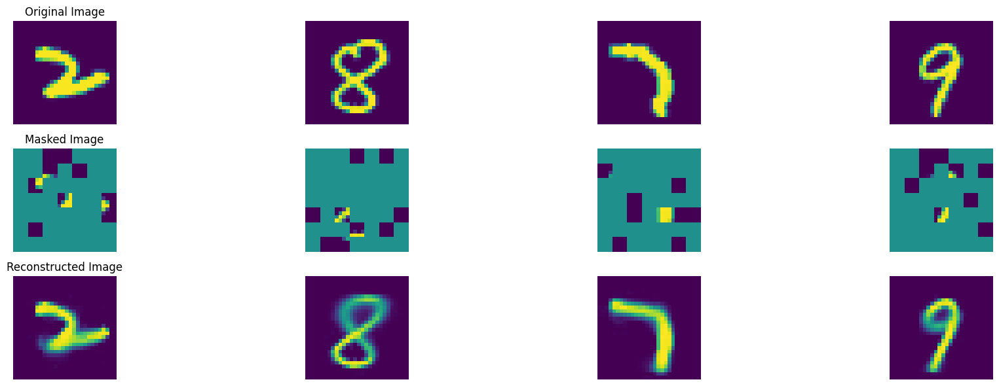

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 514, average traning loss is 0.10058480945039303.
=================== EPOCH:  515  ===================


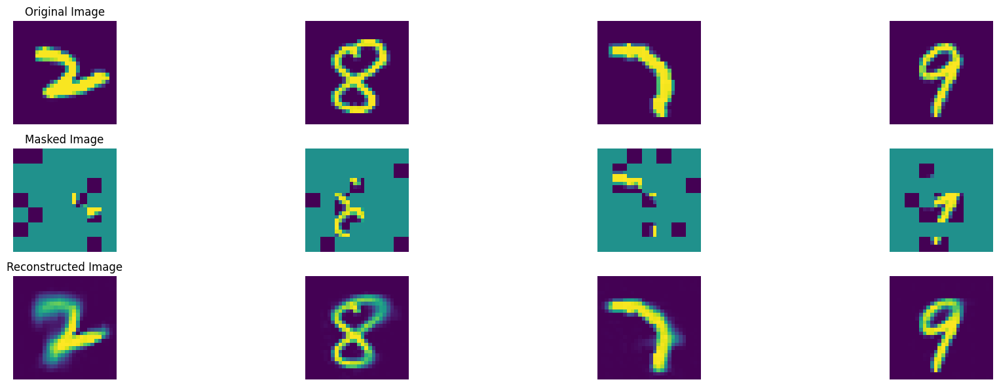

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 515, average traning loss is 0.0999220906102911.
=================== EPOCH:  516  ===================


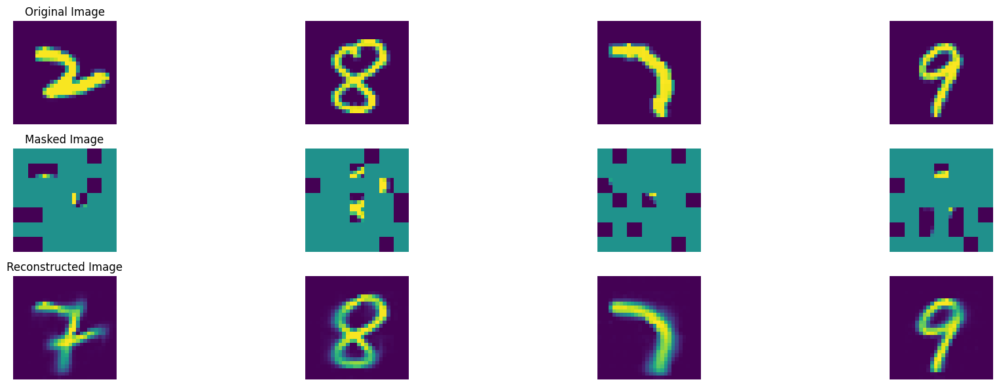

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 516, average traning loss is 0.10023013359688698.
=================== EPOCH:  517  ===================


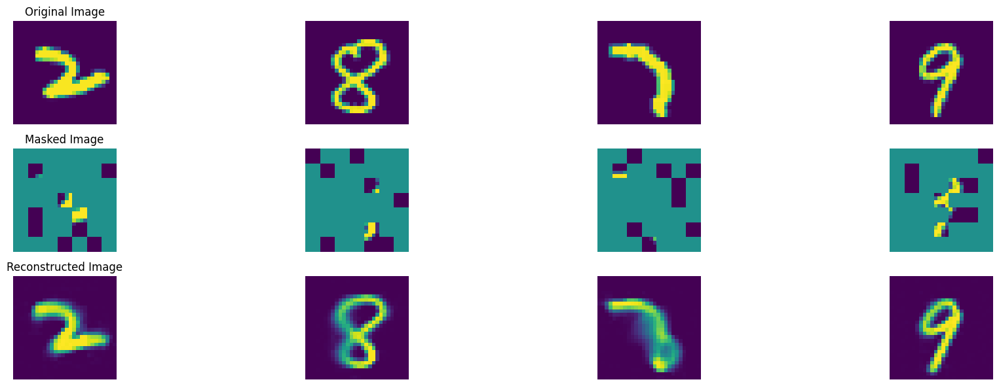

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 517, average traning loss is 0.09990482222526631.
=================== EPOCH:  518  ===================


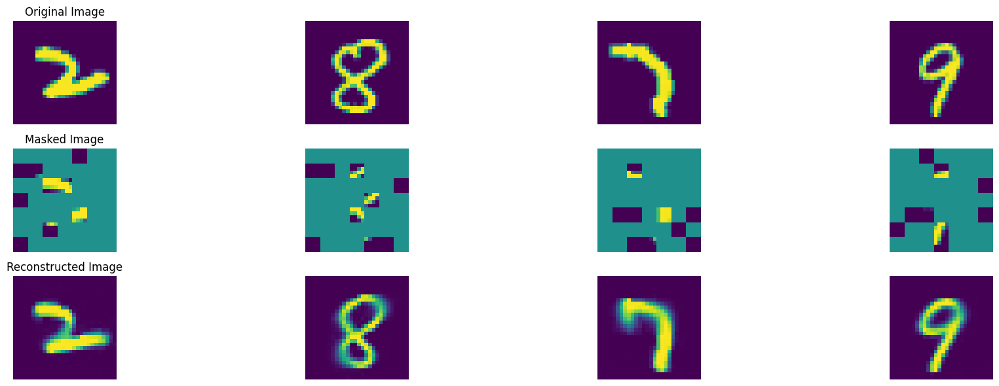

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 518, average traning loss is 0.10060467840509212.
=================== EPOCH:  519  ===================


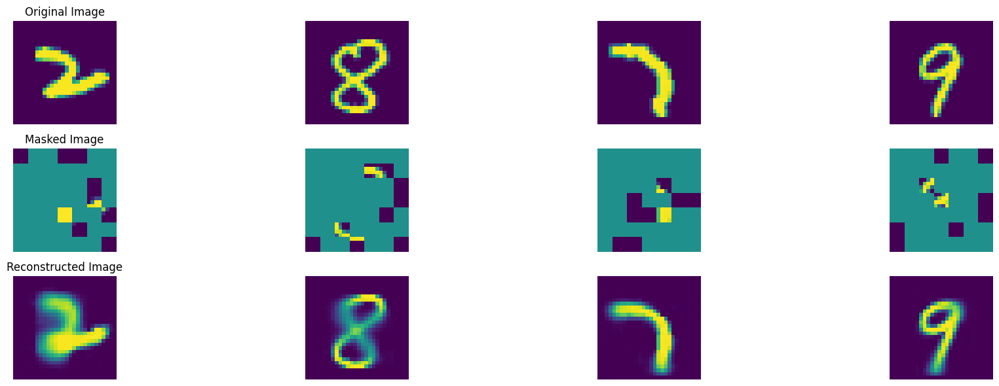

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 519, average traning loss is 0.09996118713566597.
=================== EPOCH:  520  ===================


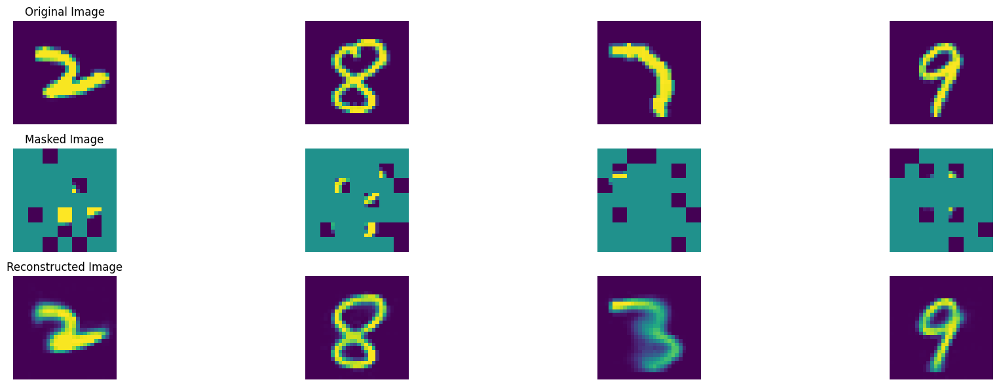

100%|██████████| 47/47 [00:08<00:00,  5.27it/s]


In epoch 520, average traning loss is 0.10040858181867193.
=================== EPOCH:  521  ===================


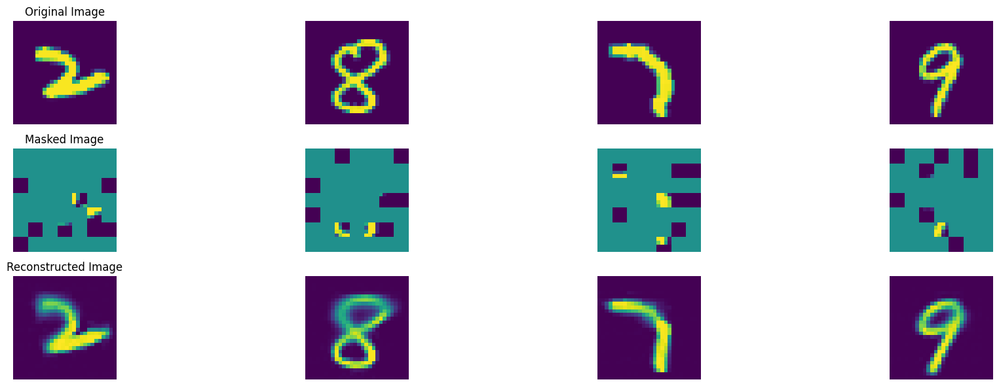

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 521, average traning loss is 0.09995748118517246.
=================== EPOCH:  522  ===================


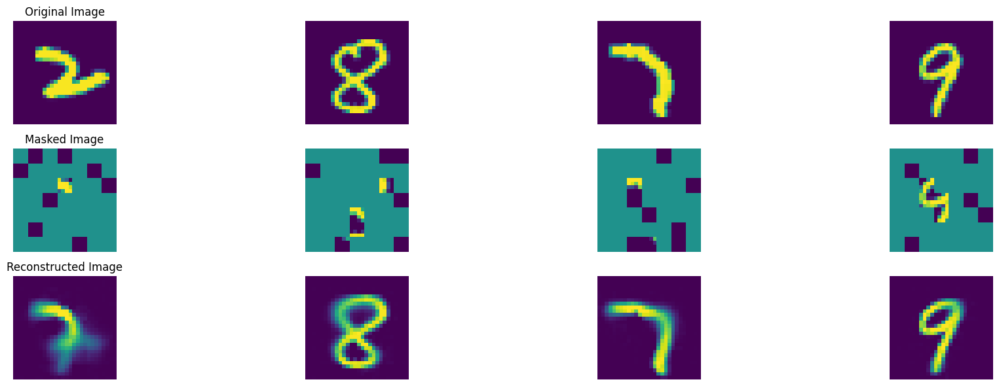

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 522, average traning loss is 0.10012873468246866.
=================== EPOCH:  523  ===================


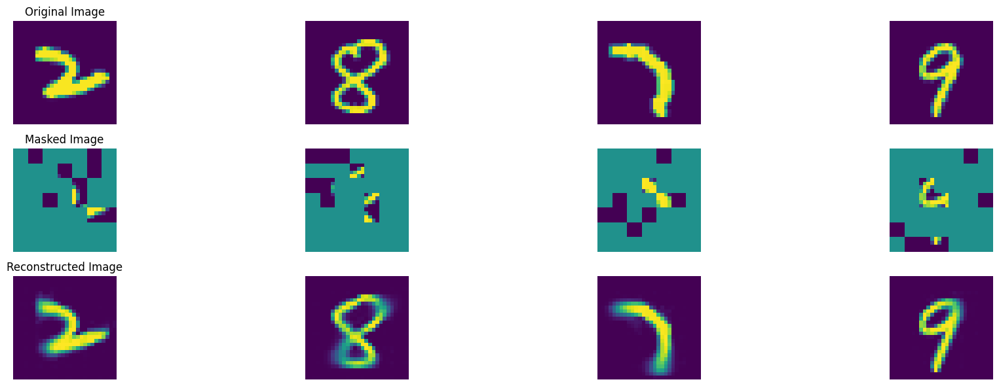

100%|██████████| 47/47 [00:08<00:00,  5.51it/s]


In epoch 523, average traning loss is 0.09969505414049676.
=================== EPOCH:  524  ===================


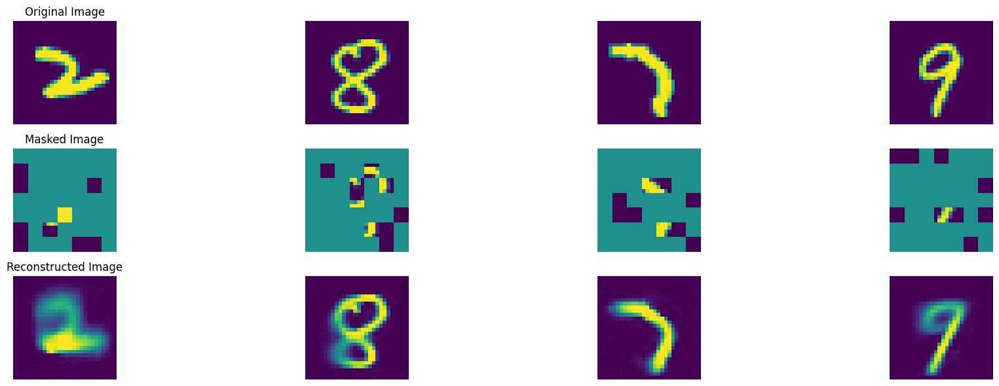

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 524, average traning loss is 0.09994790227489268.
=================== EPOCH:  525  ===================


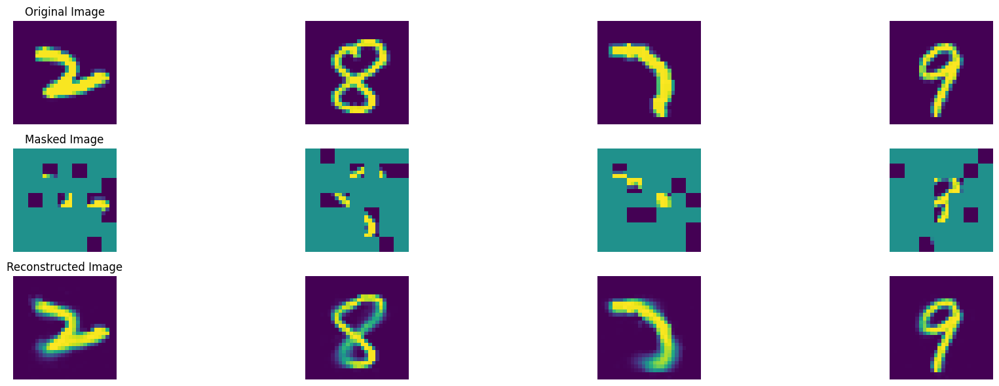

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 525, average traning loss is 0.1001315343570202.
=================== EPOCH:  526  ===================


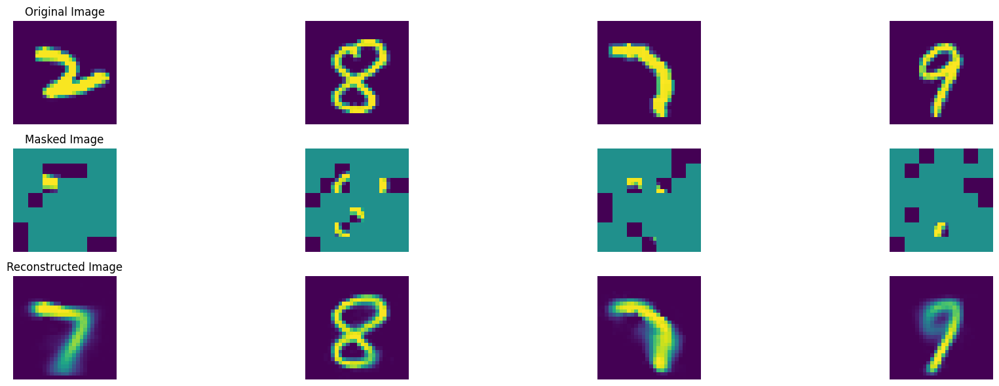

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 526, average traning loss is 0.09976645685890888.
=================== EPOCH:  527  ===================


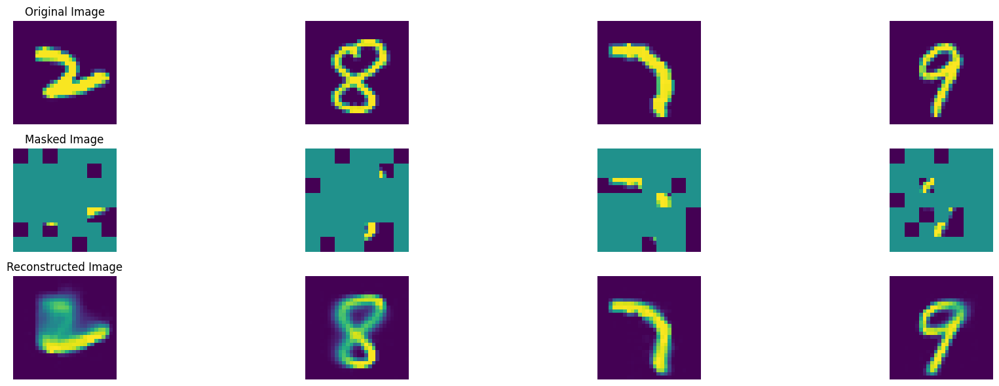

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 527, average traning loss is 0.09992398163105579.
=================== EPOCH:  528  ===================


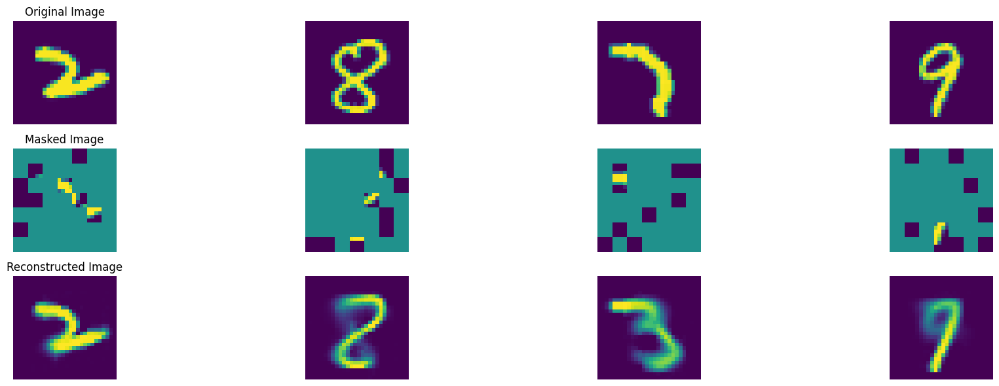

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 528, average traning loss is 0.0999443827474371.
=================== EPOCH:  529  ===================


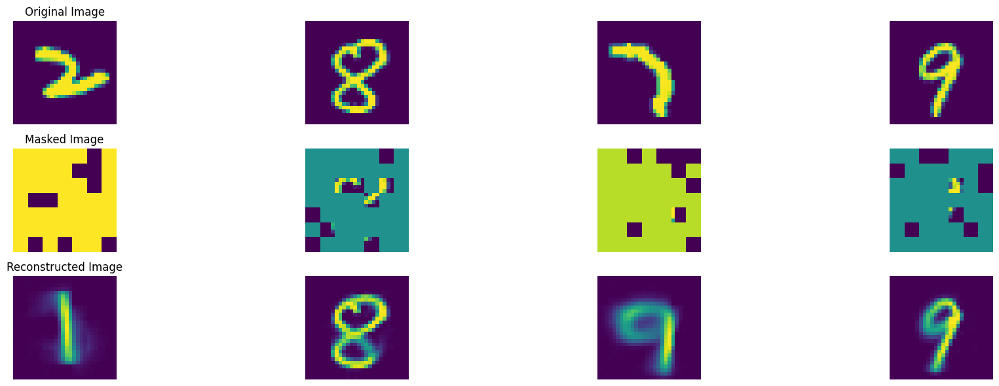

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 529, average traning loss is 0.0999029407158811.
=================== EPOCH:  530  ===================


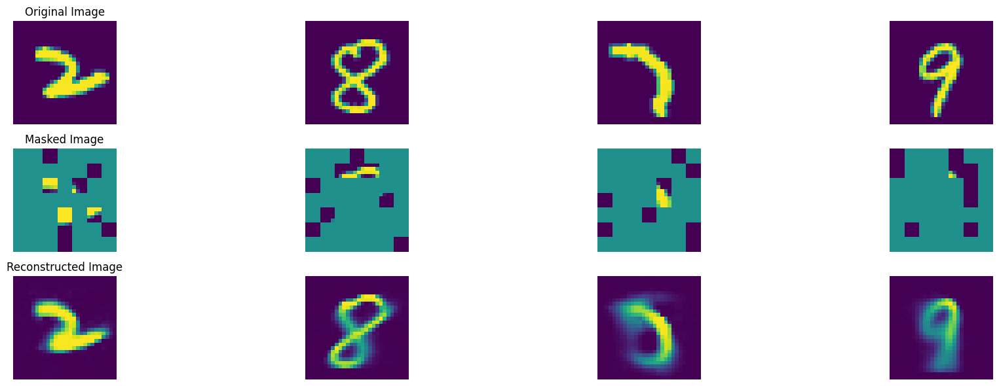

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 530, average traning loss is 0.09942054431489174.
=================== EPOCH:  531  ===================


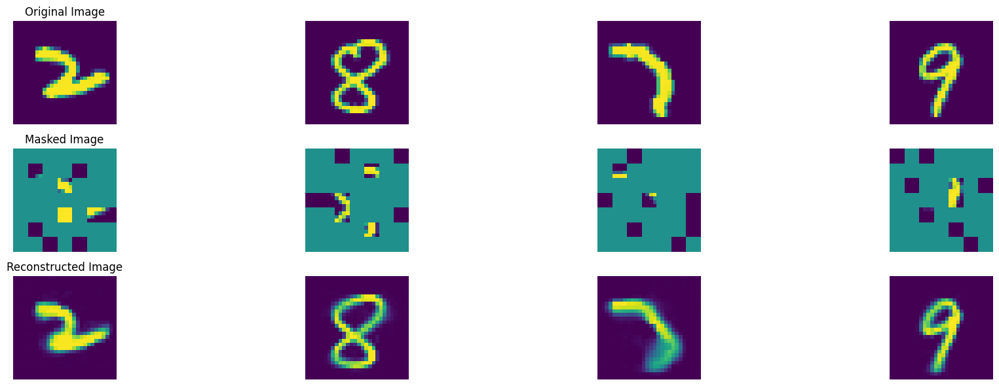

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 531, average traning loss is 0.09950182127191666.
=================== EPOCH:  532  ===================


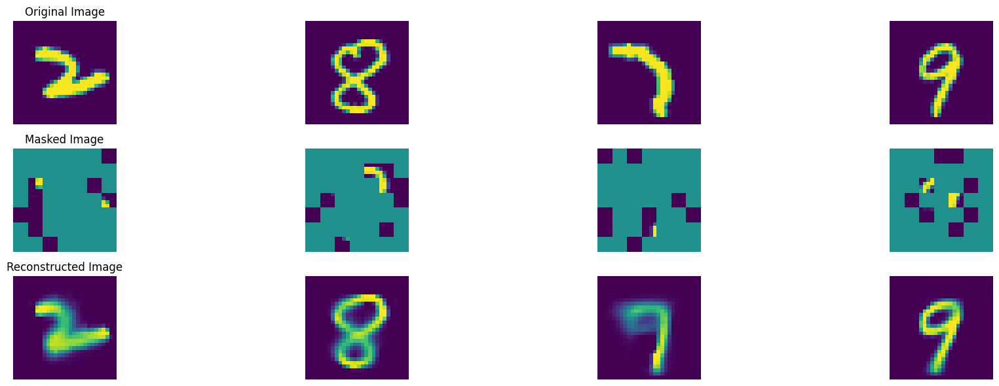

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 532, average traning loss is 0.09958974620763292.
=================== EPOCH:  533  ===================


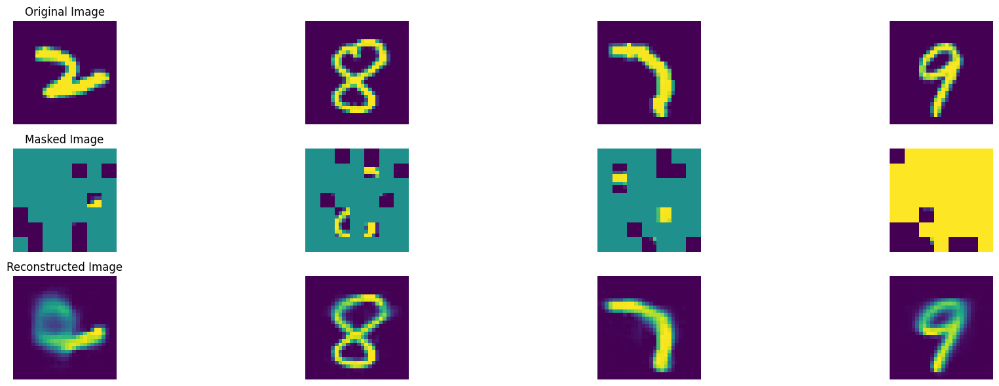

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 533, average traning loss is 0.10005978177836601.
=================== EPOCH:  534  ===================


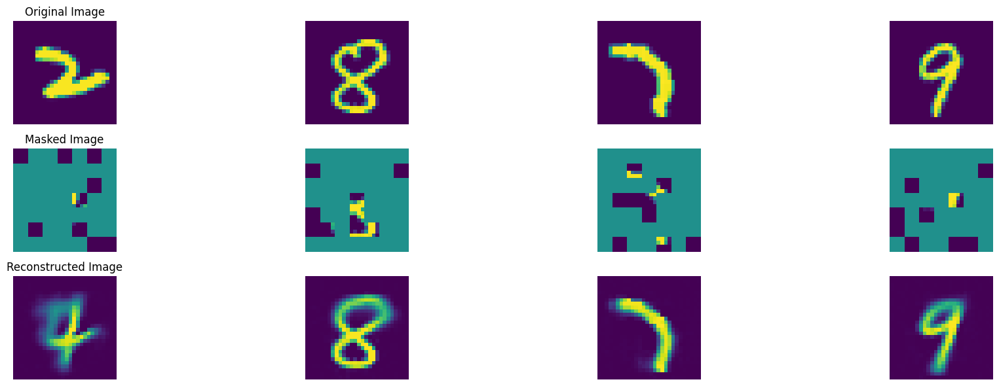

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 534, average traning loss is 0.09928037543246086.
=================== EPOCH:  535  ===================


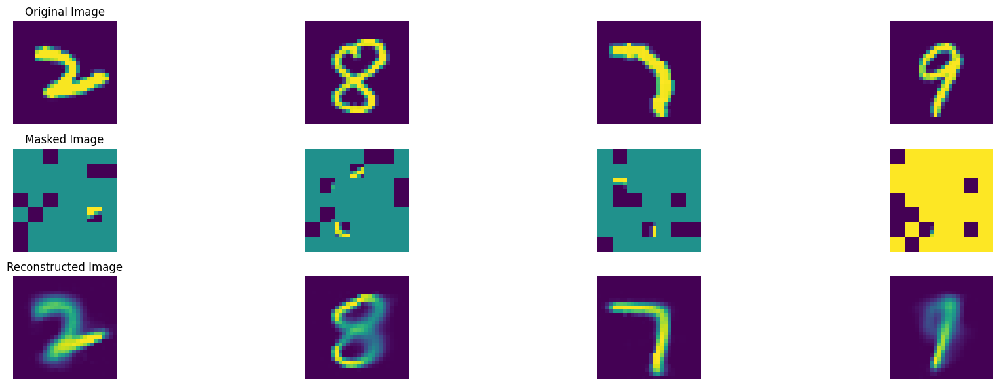

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 535, average traning loss is 0.09956051821404314.
=================== EPOCH:  536  ===================


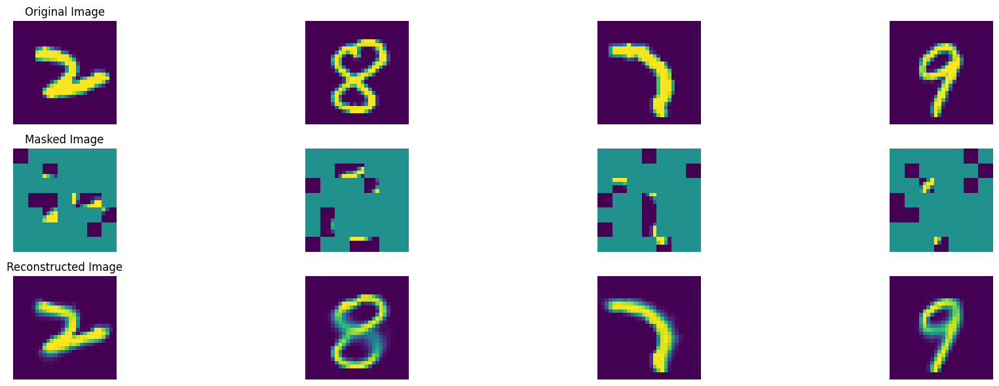

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 536, average traning loss is 0.09931573541240489.
=================== EPOCH:  537  ===================


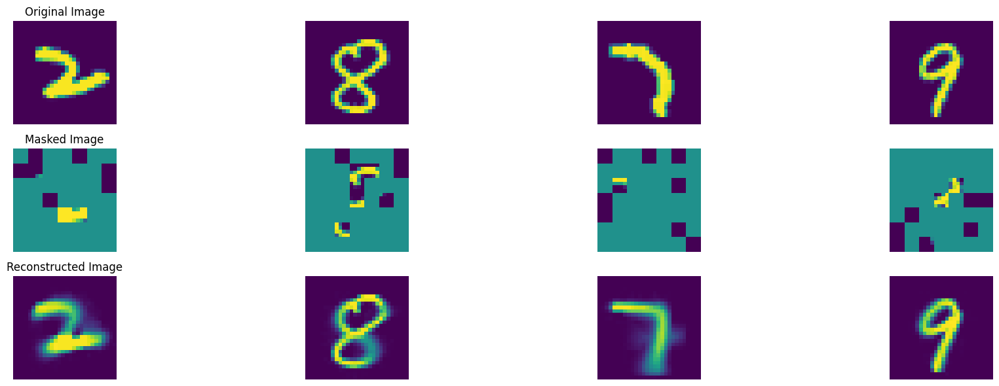

100%|██████████| 47/47 [00:08<00:00,  5.31it/s]


In epoch 537, average traning loss is 0.09950639212385137.
=================== EPOCH:  538  ===================


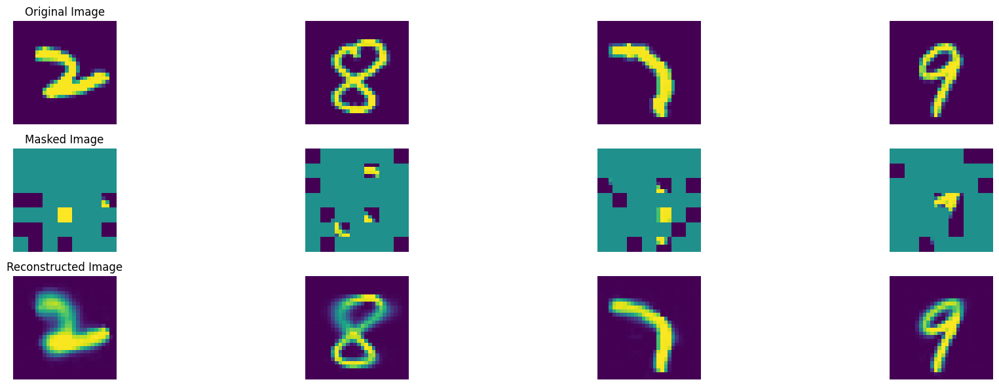

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 538, average traning loss is 0.09895653610533857.
=================== EPOCH:  539  ===================


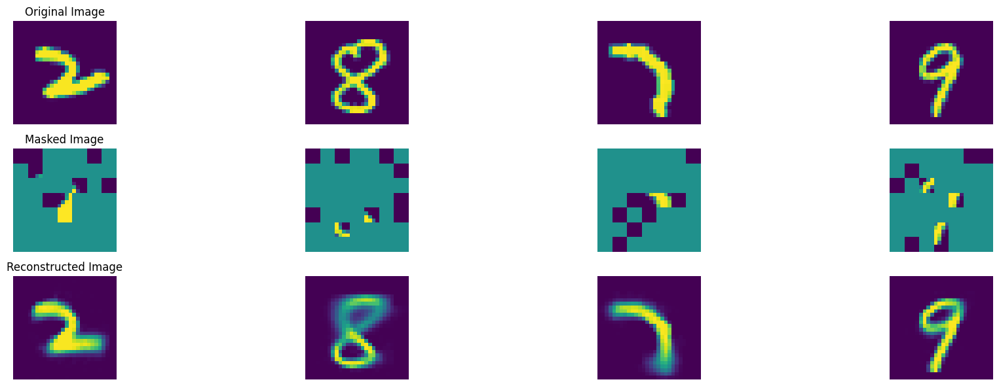

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 539, average traning loss is 0.0993434542671163.
=================== EPOCH:  540  ===================


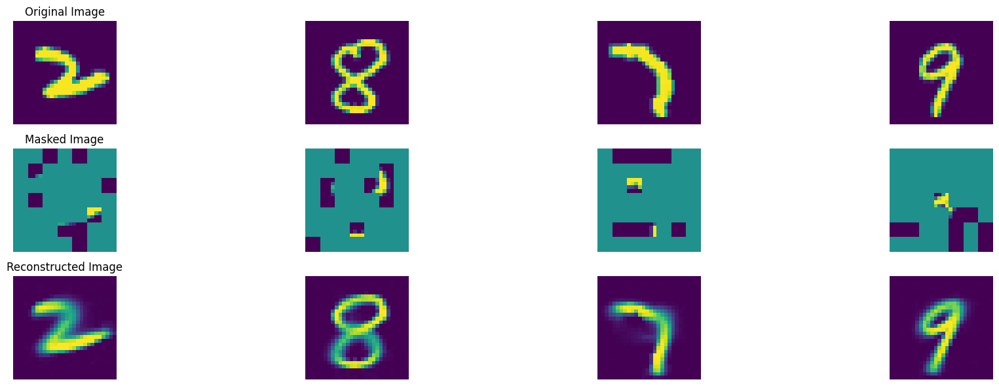

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 540, average traning loss is 0.09890064232526942.
=================== EPOCH:  541  ===================


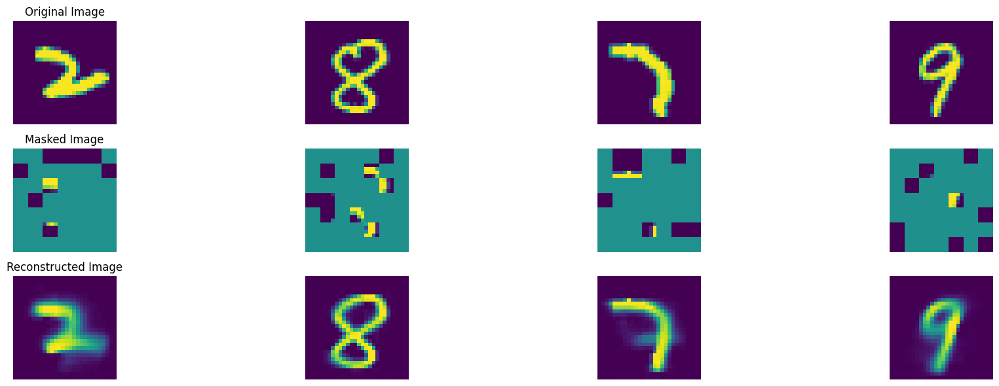

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 541, average traning loss is 0.09930430368540134.
=================== EPOCH:  542  ===================


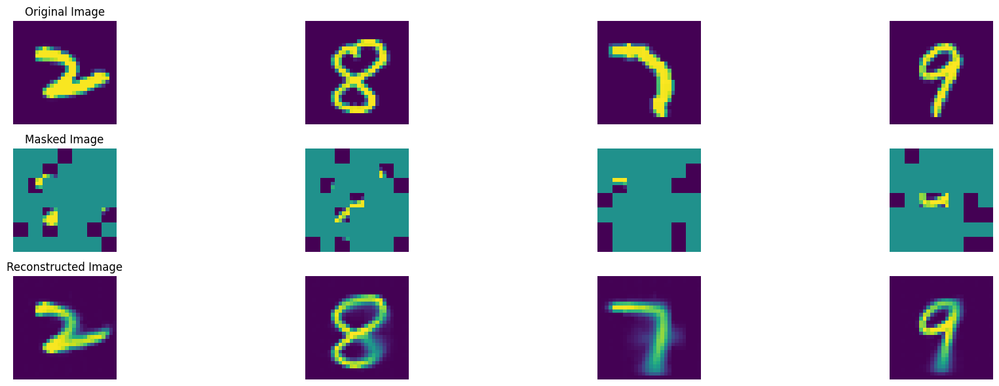

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 542, average traning loss is 0.09897176604321663.
=================== EPOCH:  543  ===================


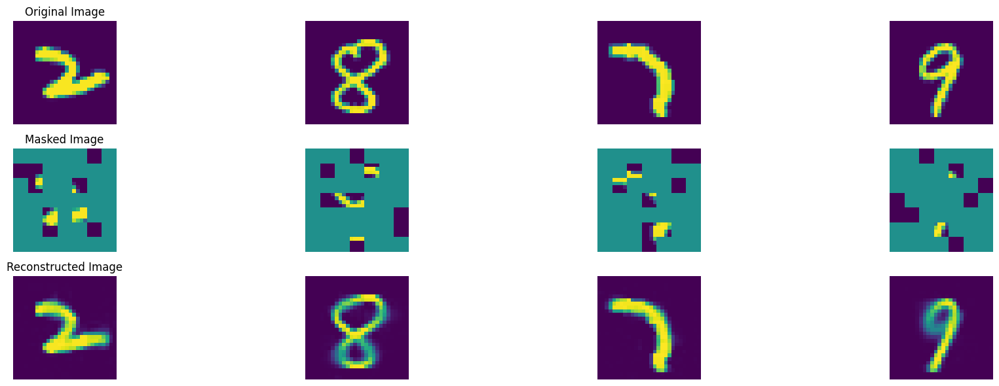

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 543, average traning loss is 0.09967094374463913.
=================== EPOCH:  544  ===================


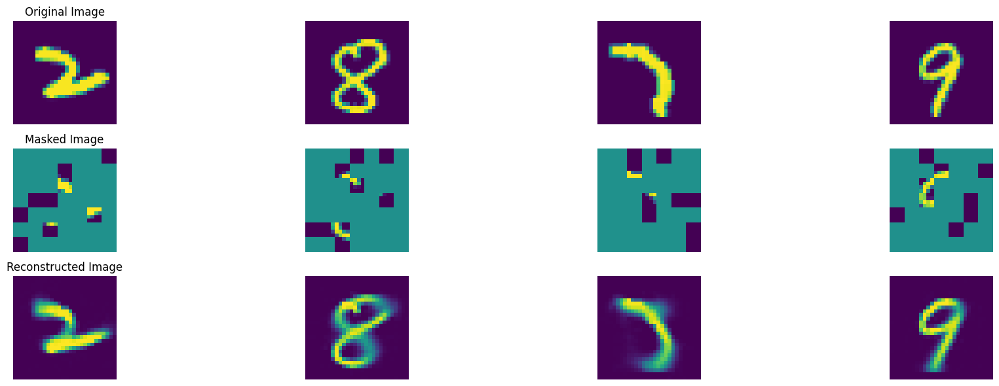

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 544, average traning loss is 0.0991880660678478.
=================== EPOCH:  545  ===================


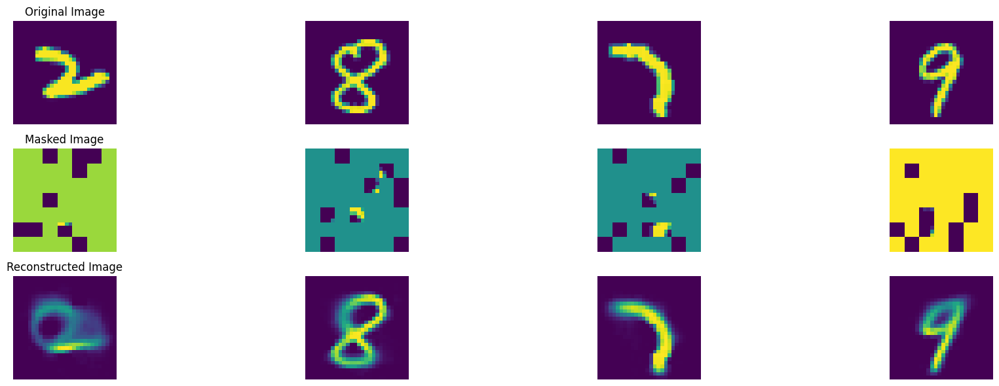

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 545, average traning loss is 0.09938154052546684.
=================== EPOCH:  546  ===================


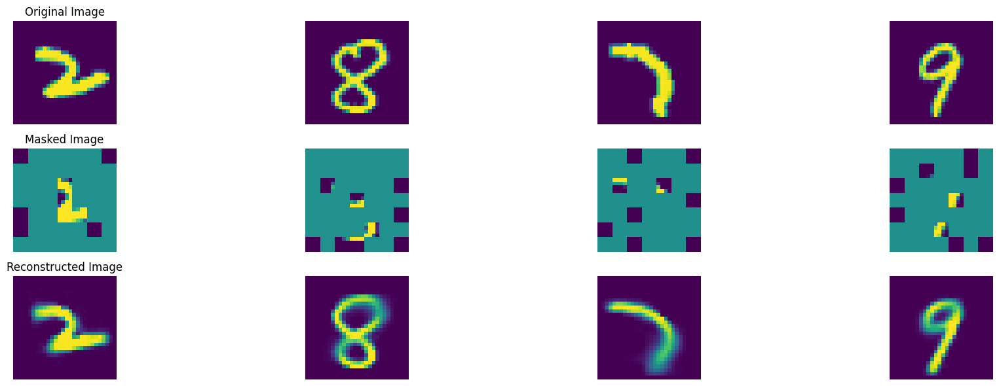

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 546, average traning loss is 0.09871412670992791.
=================== EPOCH:  547  ===================


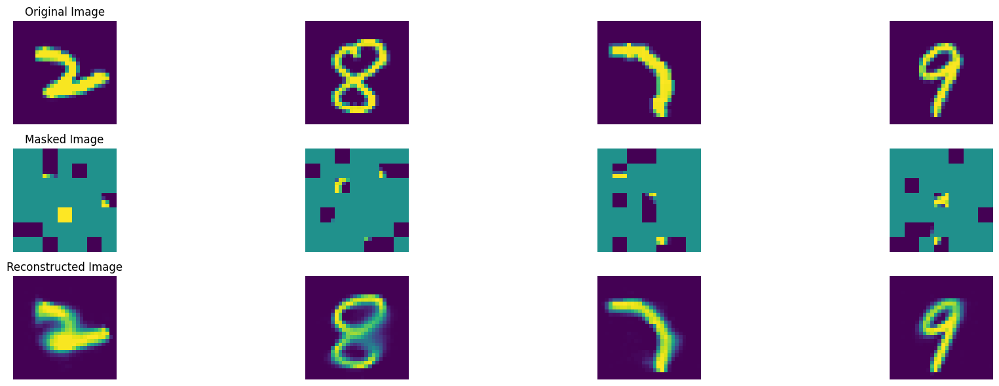

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 547, average traning loss is 0.0984488714565622.
=================== EPOCH:  548  ===================


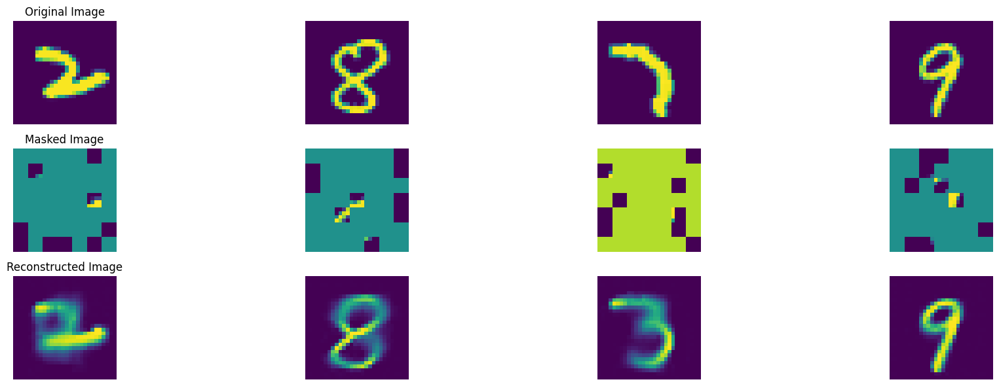

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 548, average traning loss is 0.09891022614976193.
=================== EPOCH:  549  ===================


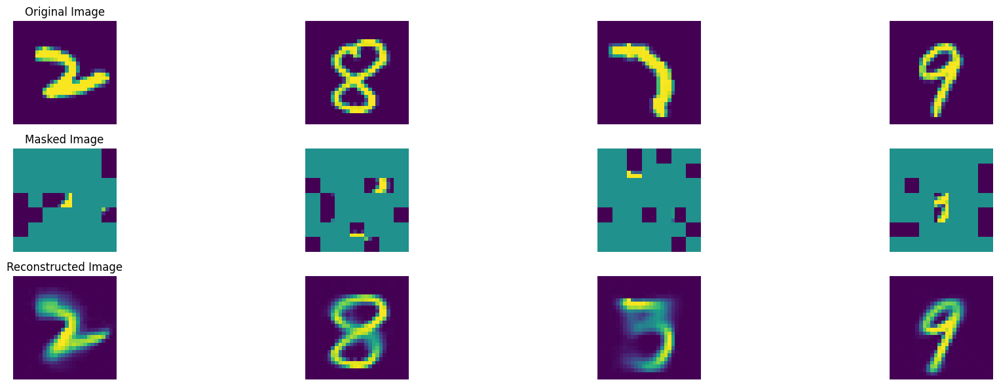

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 549, average traning loss is 0.0984831506267507.
=================== EPOCH:  550  ===================


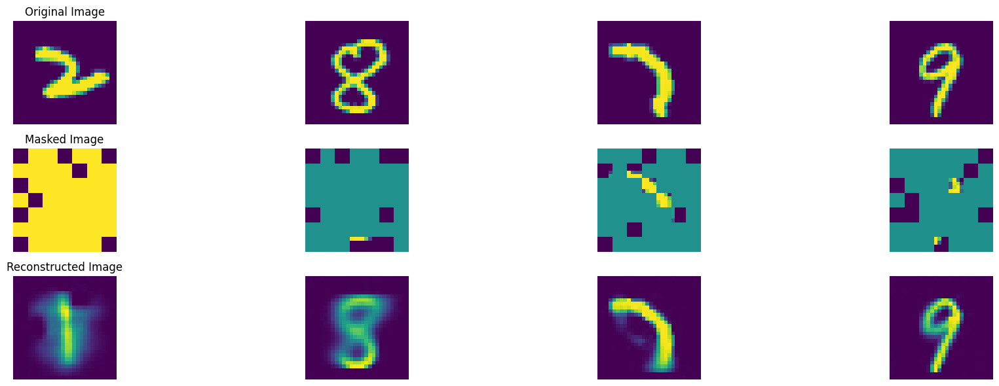

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 550, average traning loss is 0.09909757575456132.
=================== EPOCH:  551  ===================


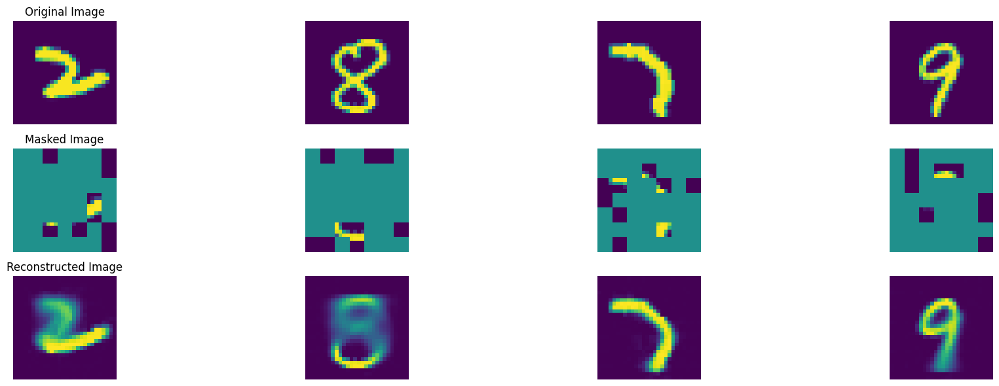

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 551, average traning loss is 0.09917759197823545.
=================== EPOCH:  552  ===================


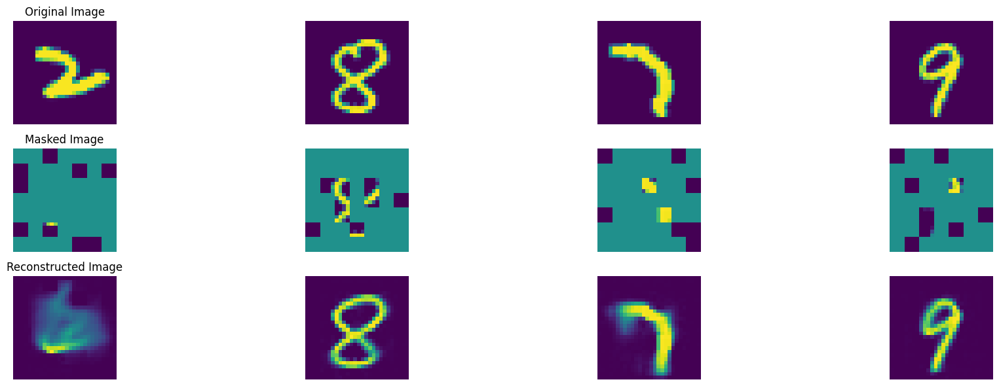

100%|██████████| 47/47 [00:08<00:00,  5.31it/s]


In epoch 552, average traning loss is 0.09876447170972824.
=================== EPOCH:  553  ===================


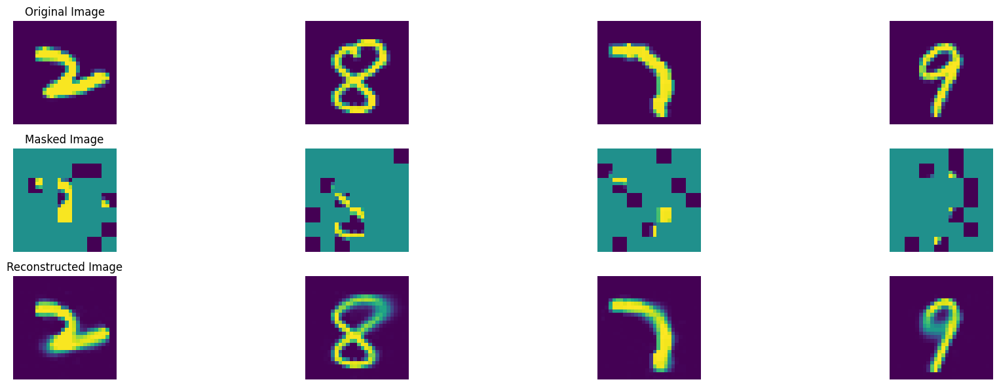

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 553, average traning loss is 0.0991741474321548.
=================== EPOCH:  554  ===================


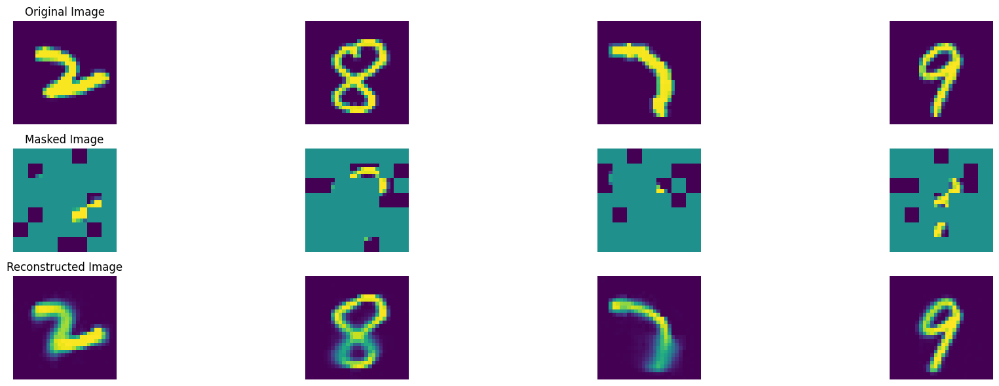

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 554, average traning loss is 0.09957704851601987.
=================== EPOCH:  555  ===================


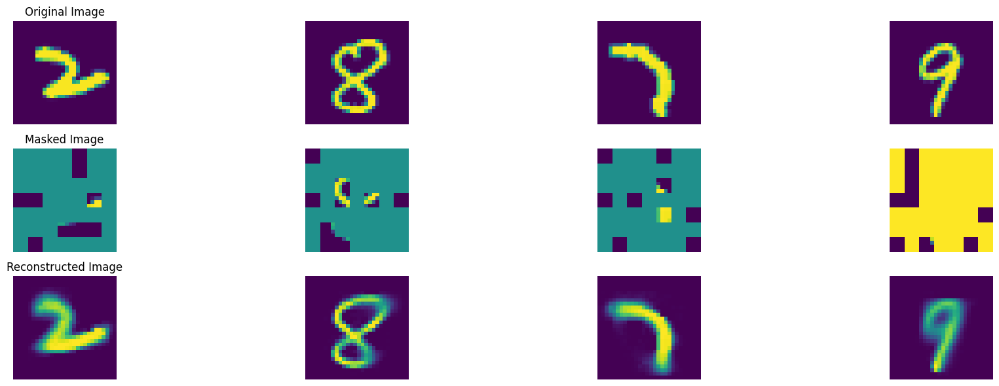

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 555, average traning loss is 0.09892531991639036.
=================== EPOCH:  556  ===================


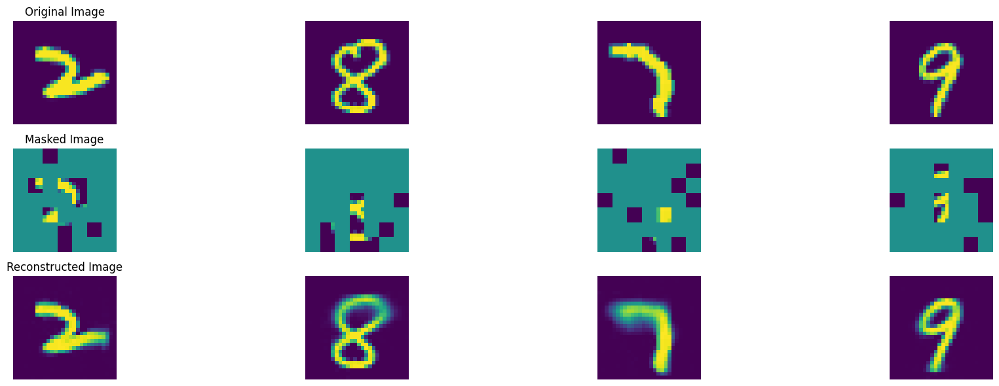

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 556, average traning loss is 0.09860319533246628.
=================== EPOCH:  557  ===================


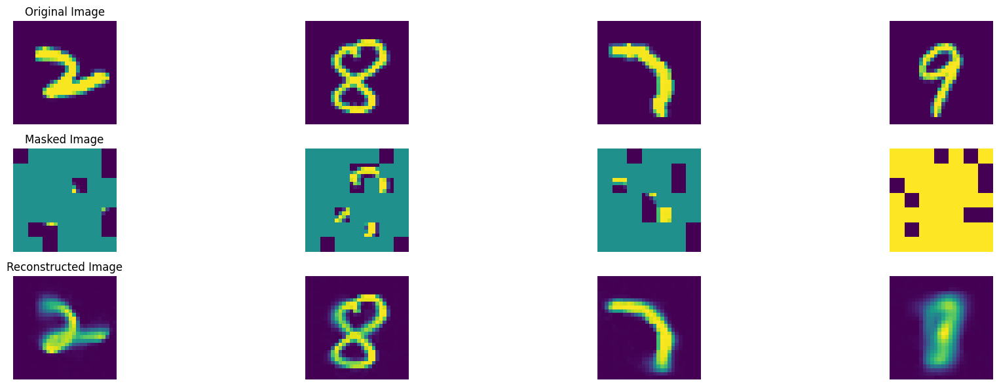

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 557, average traning loss is 0.0985462356438028.
=================== EPOCH:  558  ===================


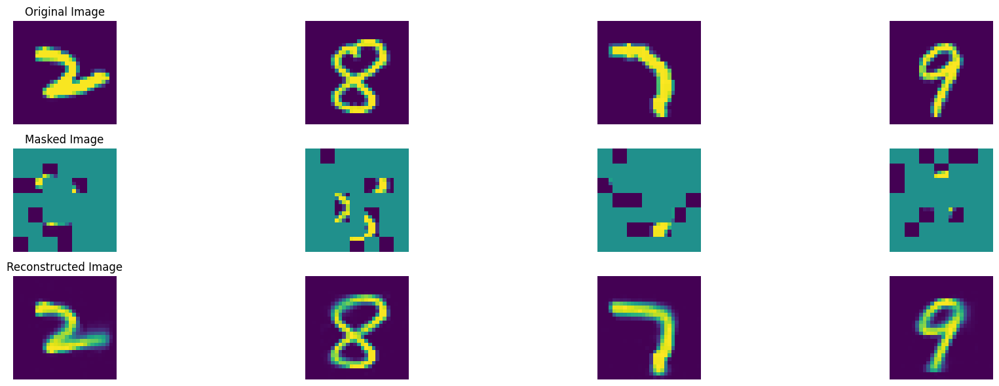

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 558, average traning loss is 0.09899010953116924.
=================== EPOCH:  559  ===================


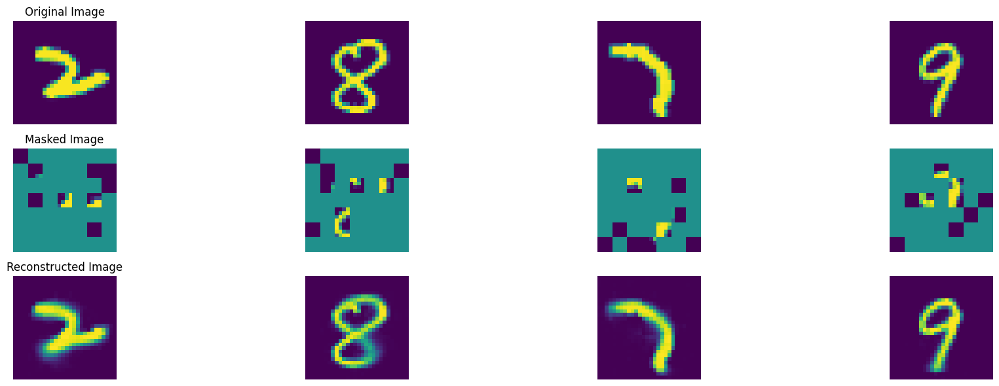

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 559, average traning loss is 0.09859457516923864.
=================== EPOCH:  560  ===================


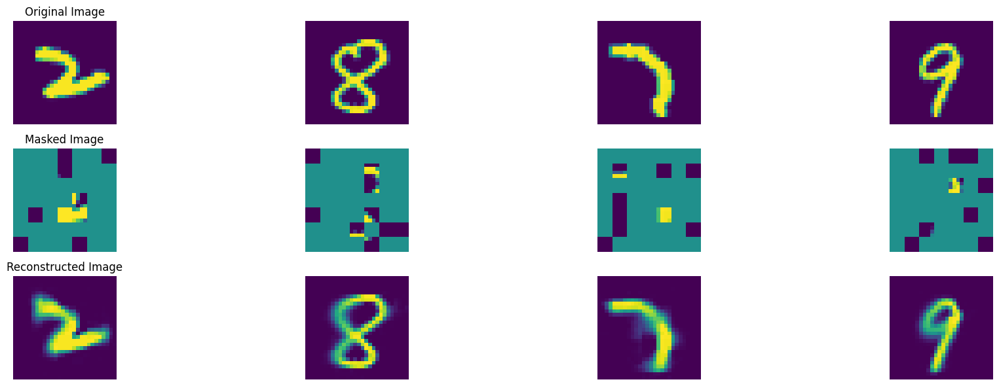

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 560, average traning loss is 0.09877524778563926.
=================== EPOCH:  561  ===================


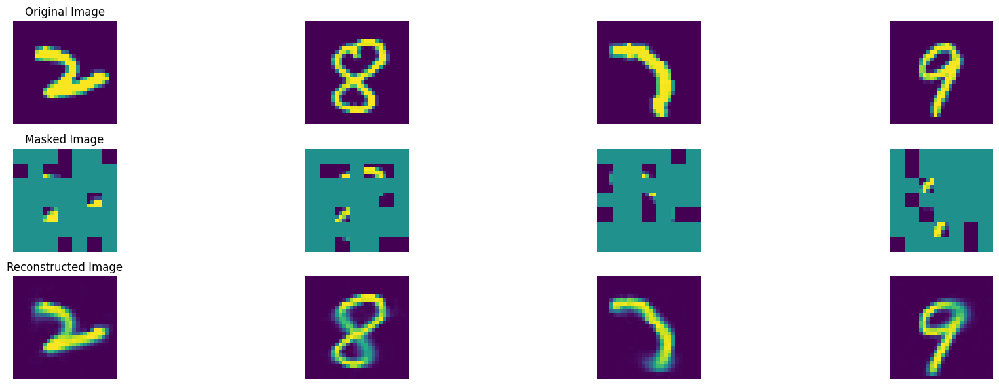

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 561, average traning loss is 0.09864089606290168.
=================== EPOCH:  562  ===================


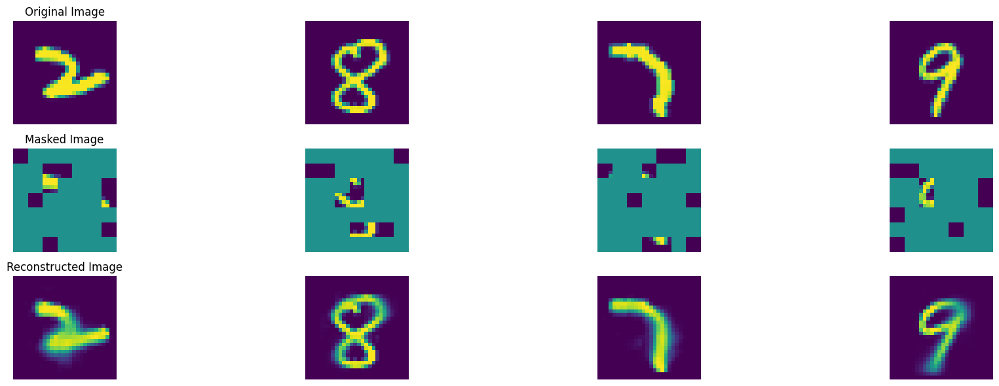

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 562, average traning loss is 0.09842932890070245.
=================== EPOCH:  563  ===================


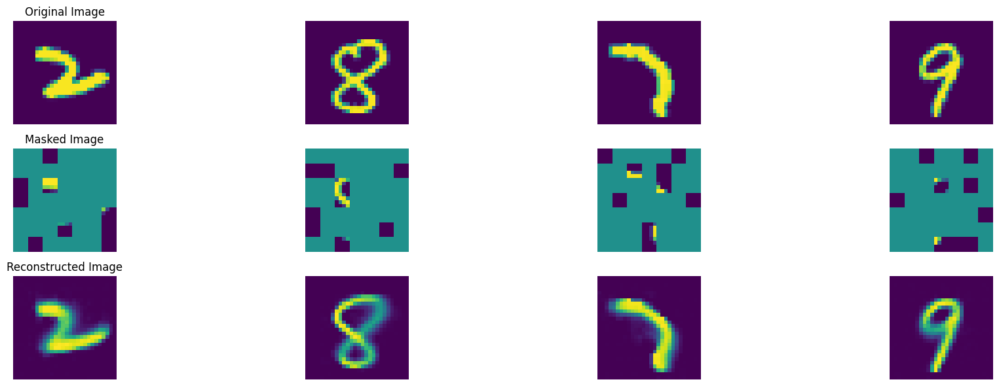

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 563, average traning loss is 0.09842346148922089.
=================== EPOCH:  564  ===================


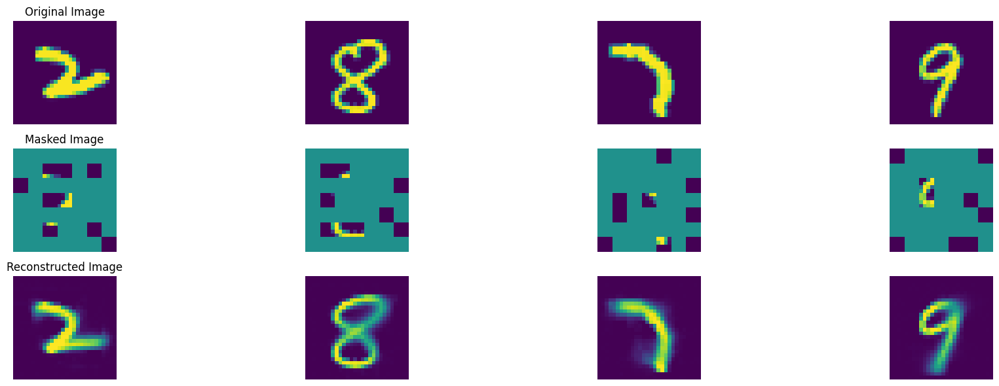

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 564, average traning loss is 0.09874673790120064.
=================== EPOCH:  565  ===================


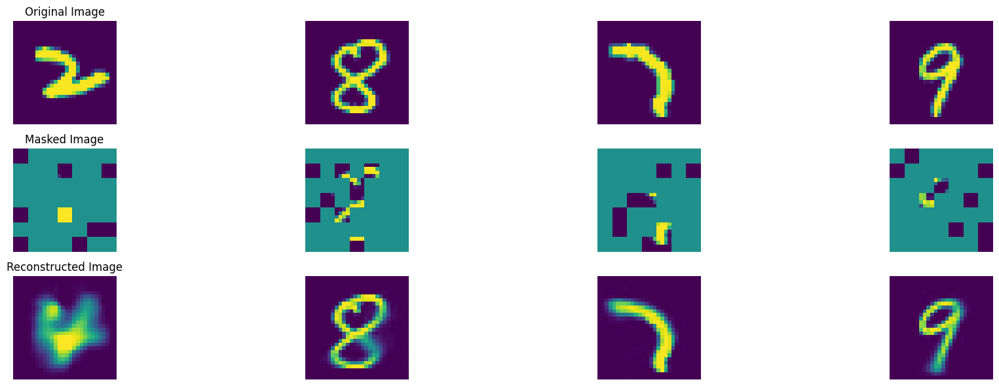

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 565, average traning loss is 0.09819971151808475.
=================== EPOCH:  566  ===================


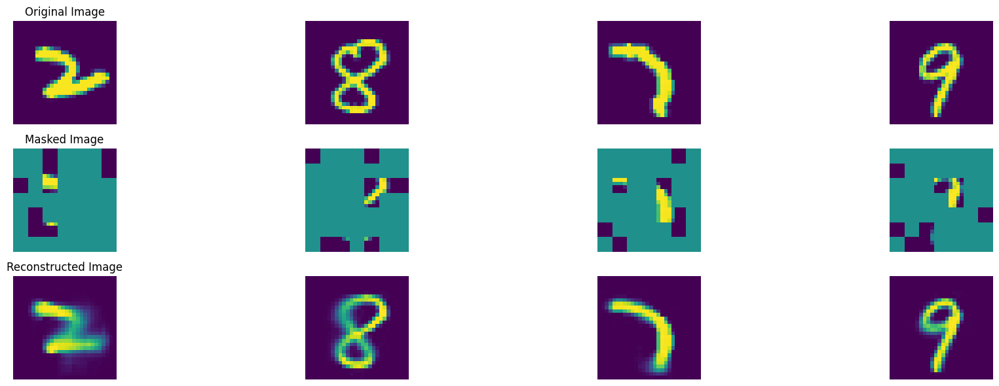

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 566, average traning loss is 0.09818397018503636.
=================== EPOCH:  567  ===================


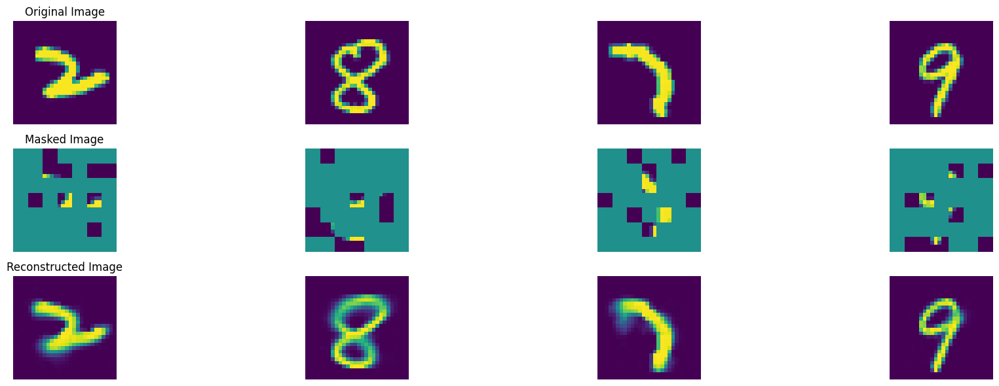

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 567, average traning loss is 0.09815623547802581.
=================== EPOCH:  568  ===================


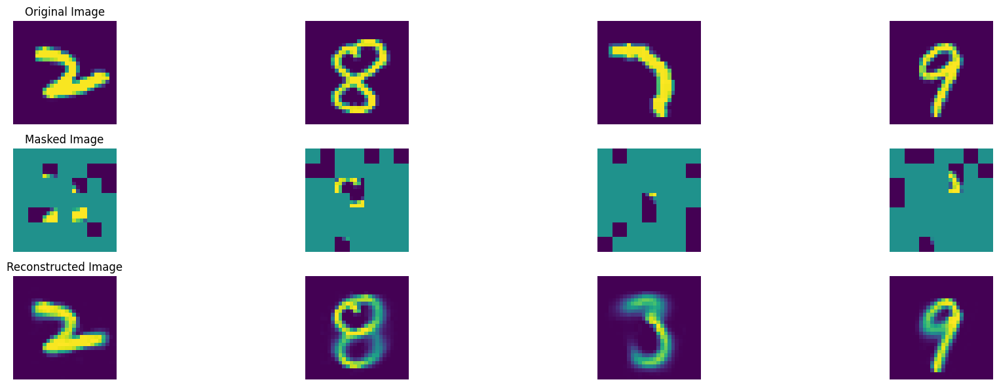

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 568, average traning loss is 0.09808085446662092.
=================== EPOCH:  569  ===================


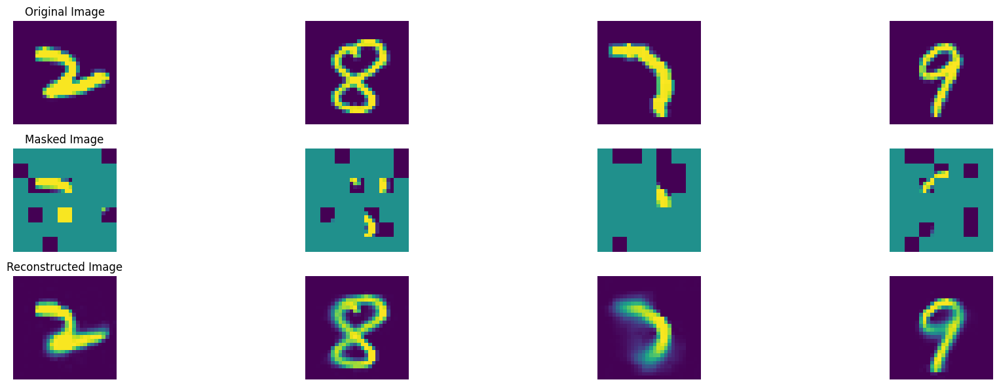

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 569, average traning loss is 0.09890677637242257.
=================== EPOCH:  570  ===================


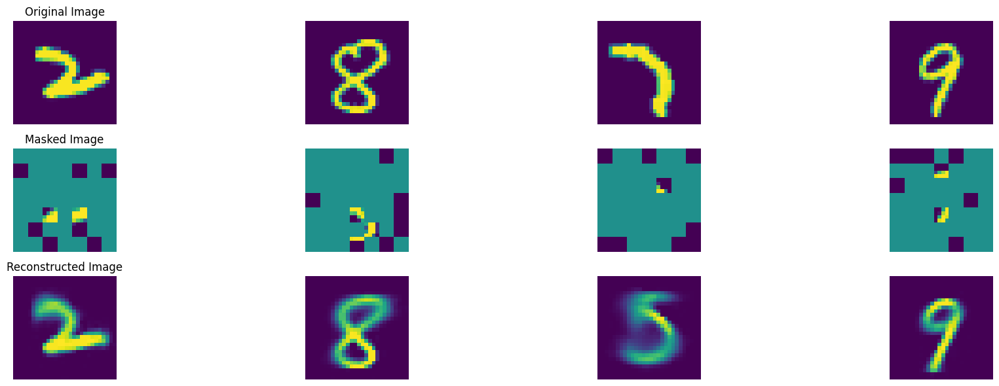

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 570, average traning loss is 0.09945164589171714.
=================== EPOCH:  571  ===================


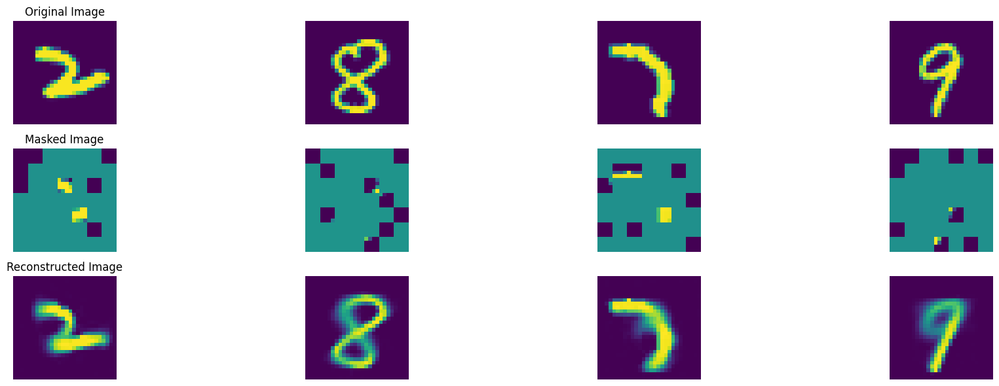

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 571, average traning loss is 0.09788249385483722.
=================== EPOCH:  572  ===================


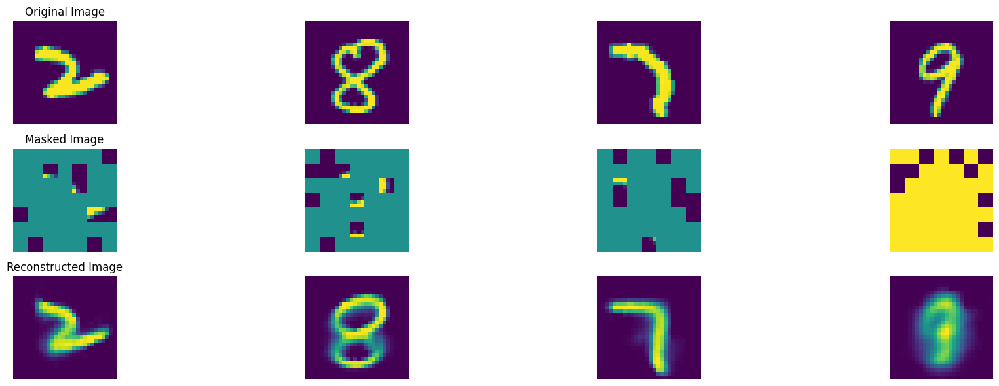

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 572, average traning loss is 0.09832619923226377.
=================== EPOCH:  573  ===================


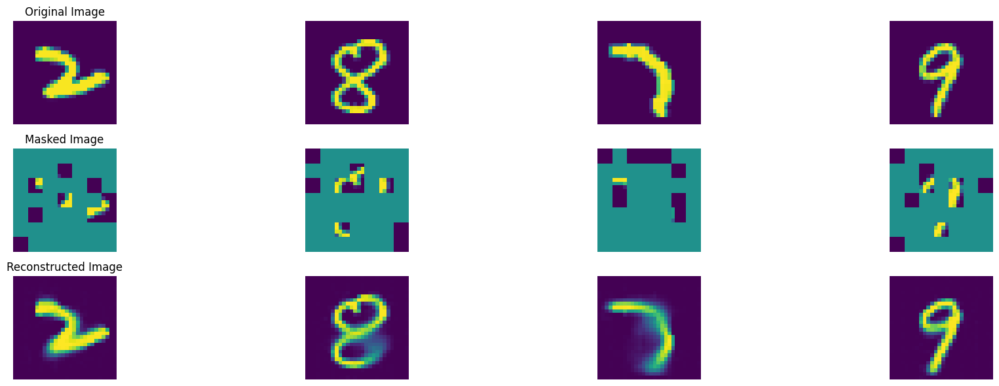

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 573, average traning loss is 0.09846901782649628.
=================== EPOCH:  574  ===================


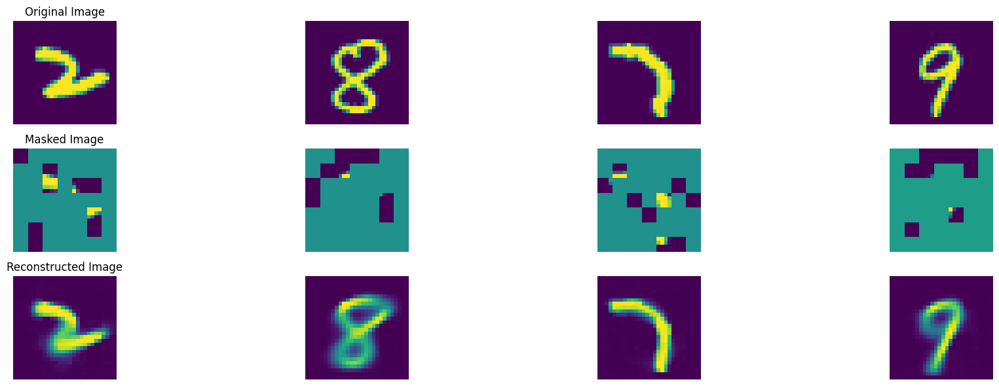

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 574, average traning loss is 0.09808889744763678.
=================== EPOCH:  575  ===================


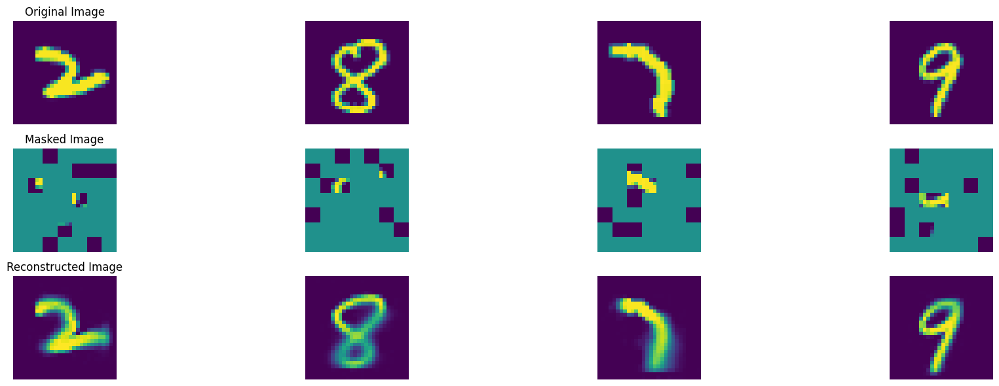

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 575, average traning loss is 0.09779558172251315.
=================== EPOCH:  576  ===================


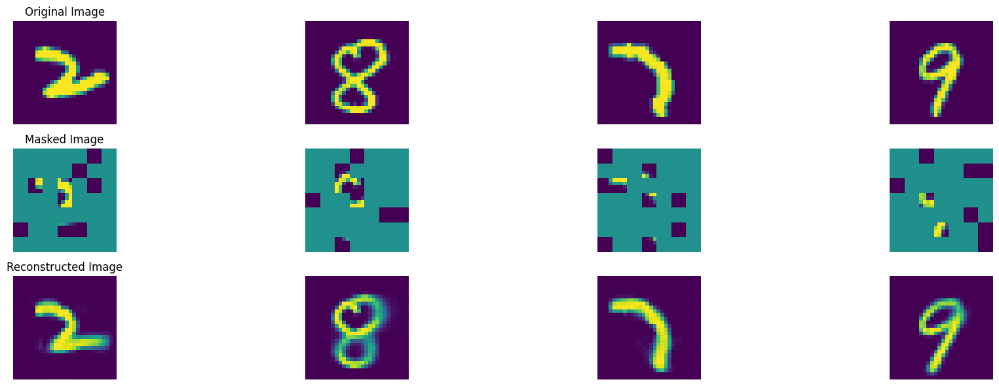

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 576, average traning loss is 0.09844345123843944.
=================== EPOCH:  577  ===================


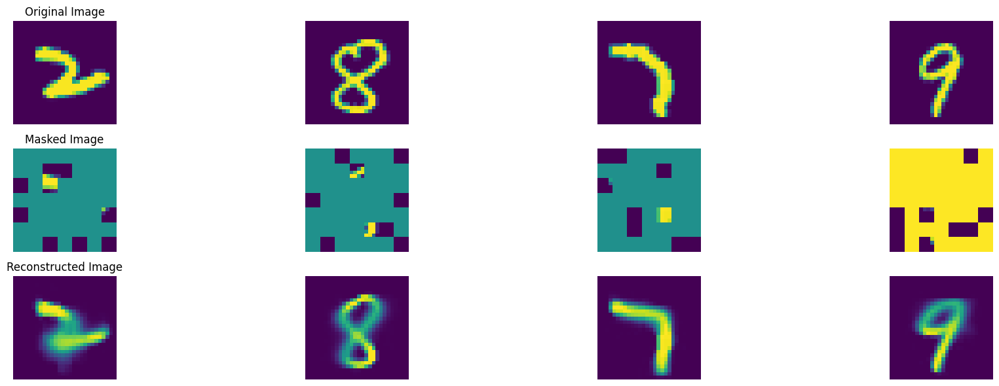

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 577, average traning loss is 0.09740195518478434.
=================== EPOCH:  578  ===================


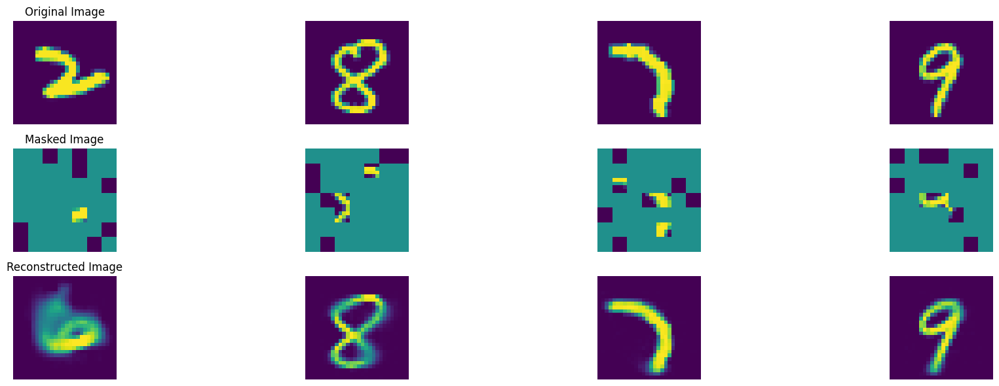

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 578, average traning loss is 0.09741974304965202.
=================== EPOCH:  579  ===================


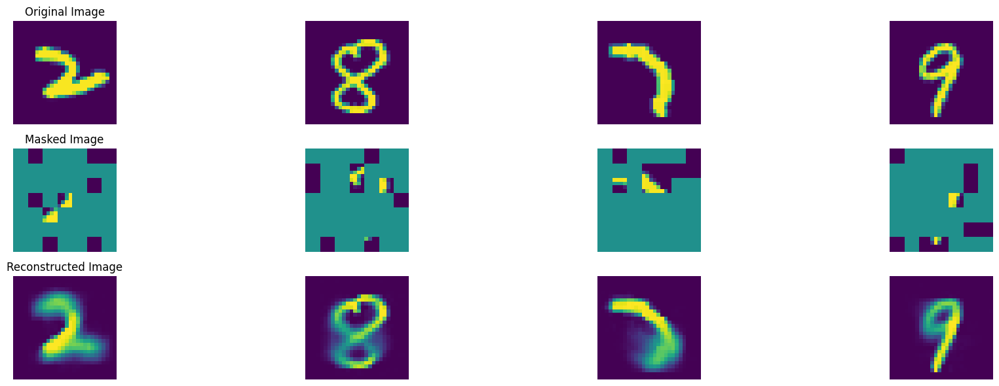

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 579, average traning loss is 0.09753602774853402.
=================== EPOCH:  580  ===================


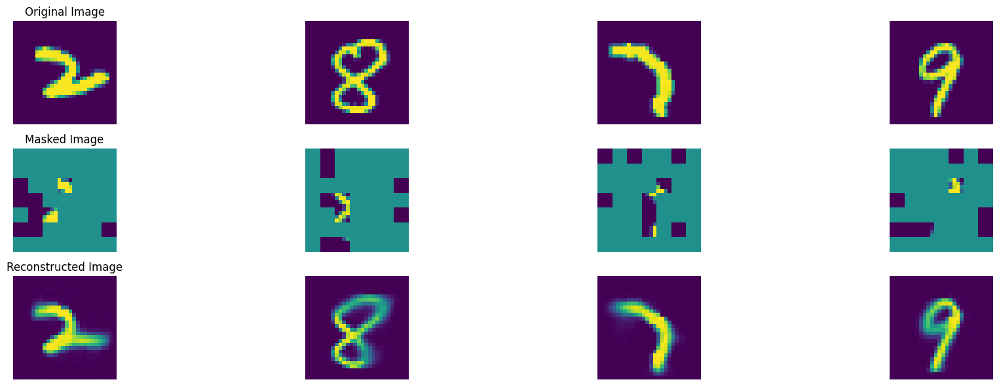

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 580, average traning loss is 0.09746984027801676.
=================== EPOCH:  581  ===================


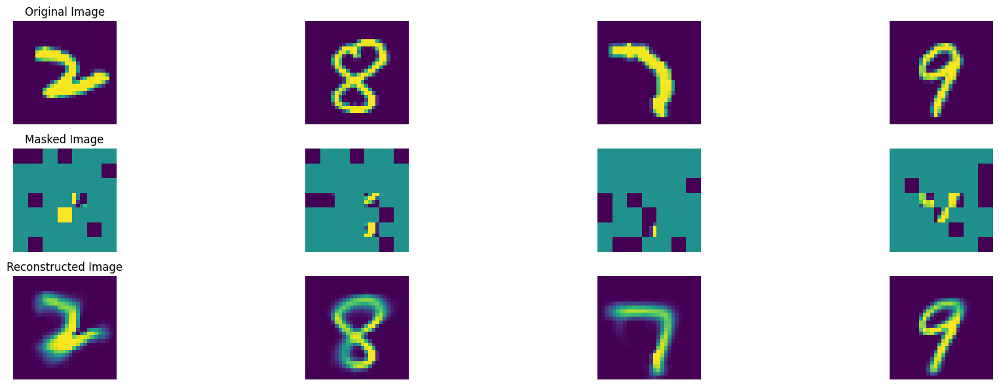

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 581, average traning loss is 0.09749265490694249.
=================== EPOCH:  582  ===================


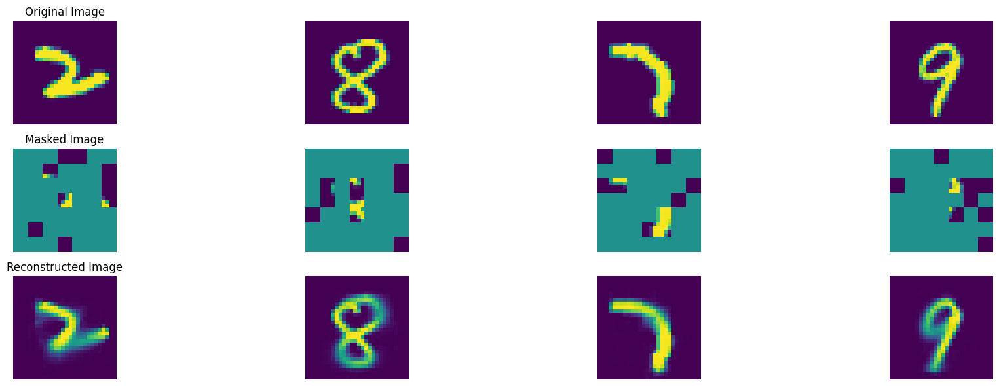

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 582, average traning loss is 0.09775026158449497.
=================== EPOCH:  583  ===================


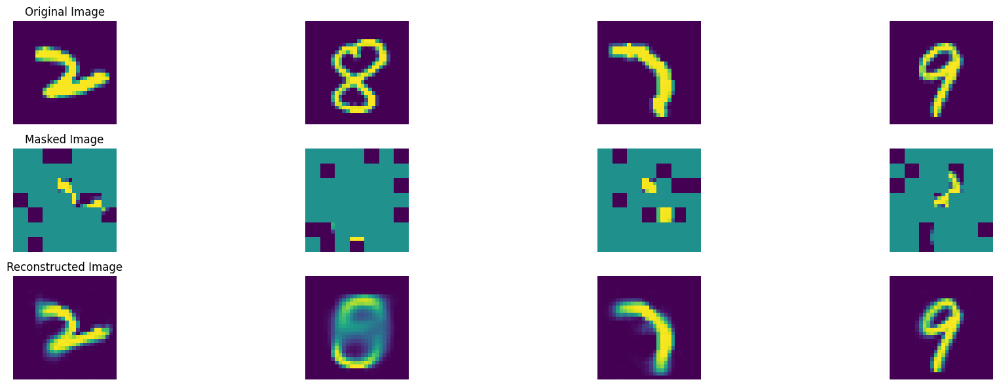

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 583, average traning loss is 0.09747476463622236.
=================== EPOCH:  584  ===================


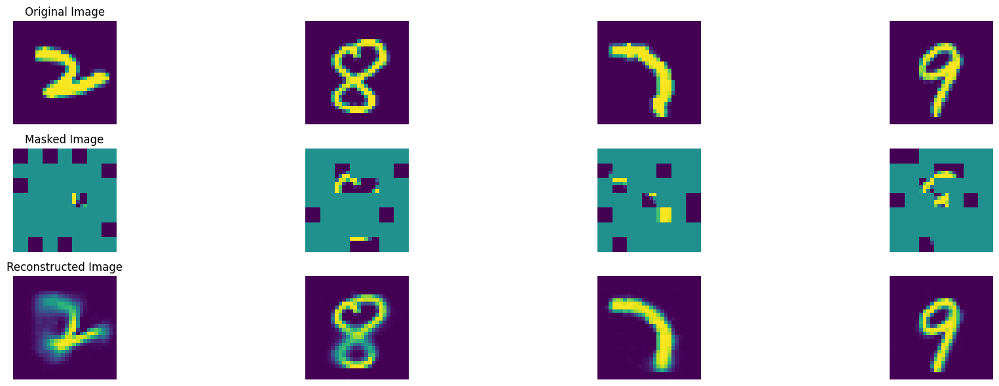

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 584, average traning loss is 0.0981024407008861.
=================== EPOCH:  585  ===================


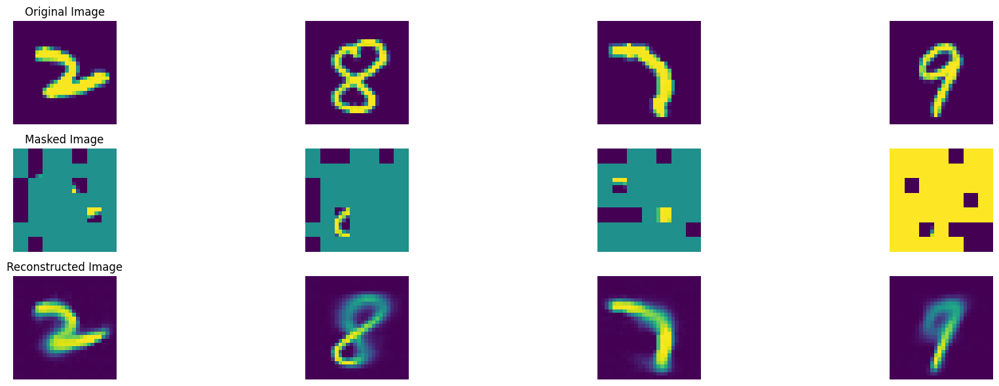

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 585, average traning loss is 0.09804771396707981.
=================== EPOCH:  586  ===================


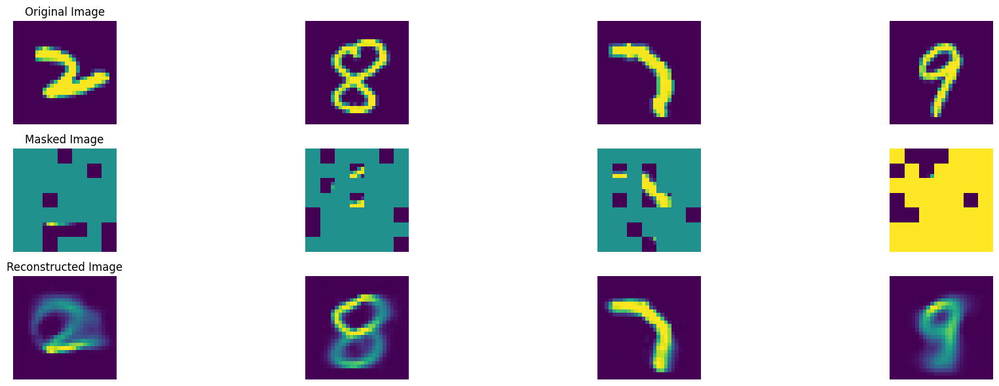

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 586, average traning loss is 0.09773619885140276.
=================== EPOCH:  587  ===================


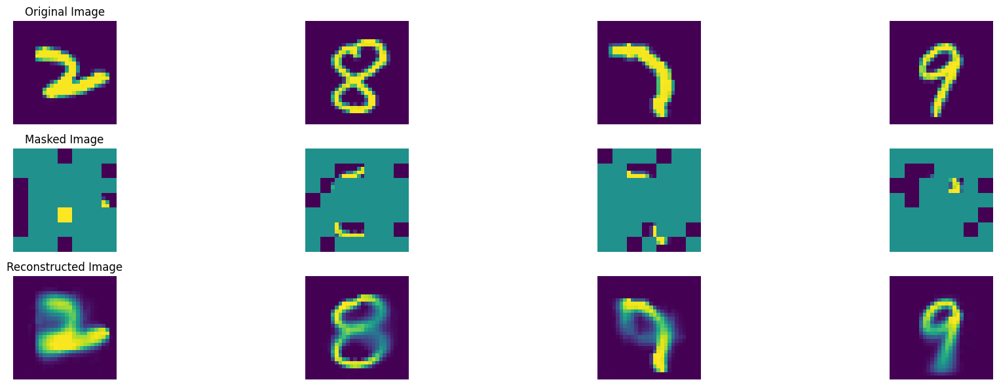

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 587, average traning loss is 0.09744485340853955.
=================== EPOCH:  588  ===================


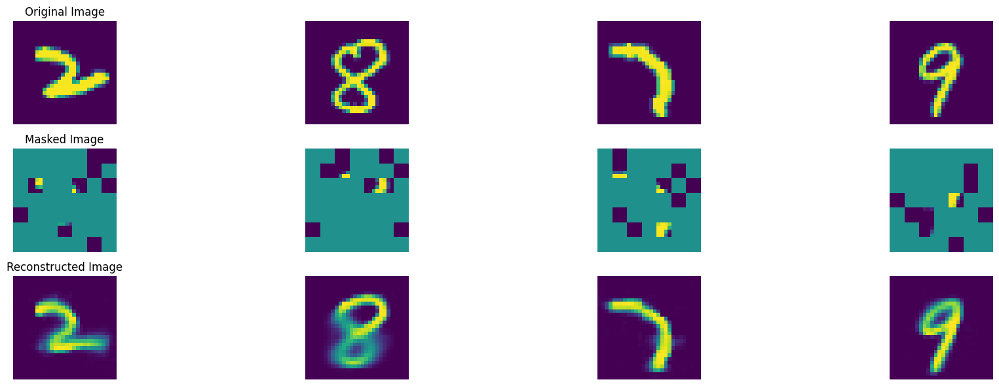

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 588, average traning loss is 0.0980438972090153.
=================== EPOCH:  589  ===================


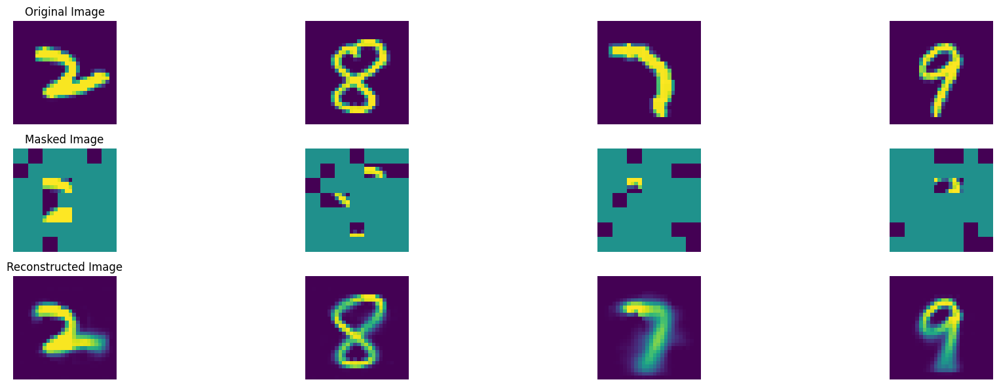

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 589, average traning loss is 0.09790104976359834.
=================== EPOCH:  590  ===================


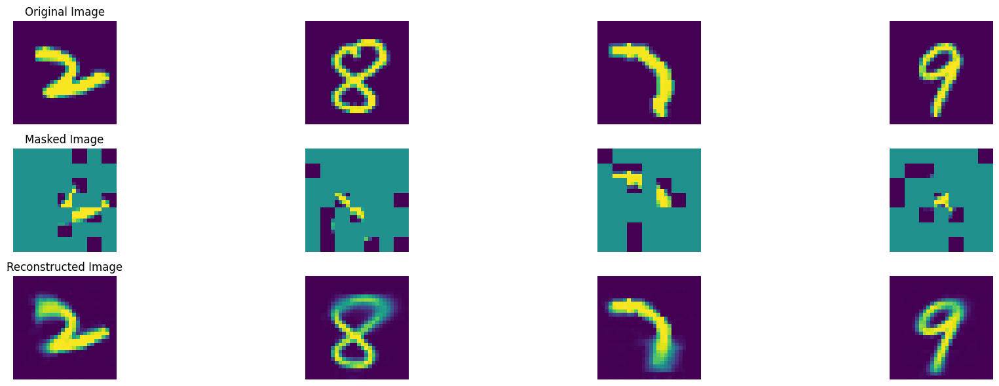

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 590, average traning loss is 0.09763789620805294.
=================== EPOCH:  591  ===================


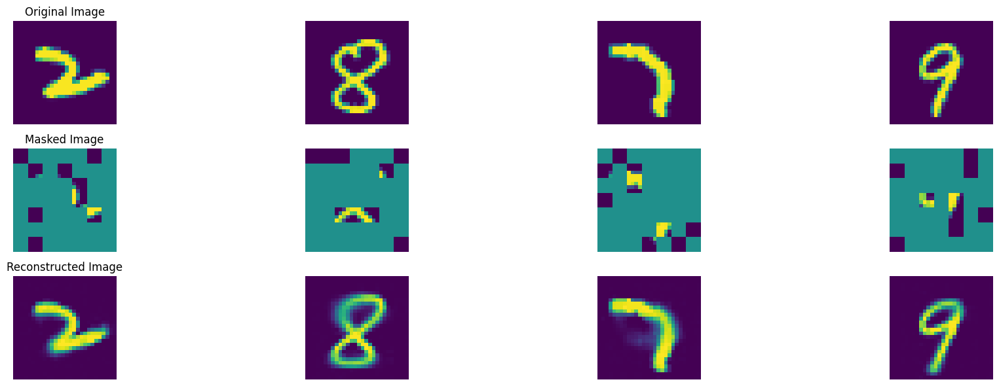

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 591, average traning loss is 0.0969082423030062.
=================== EPOCH:  592  ===================


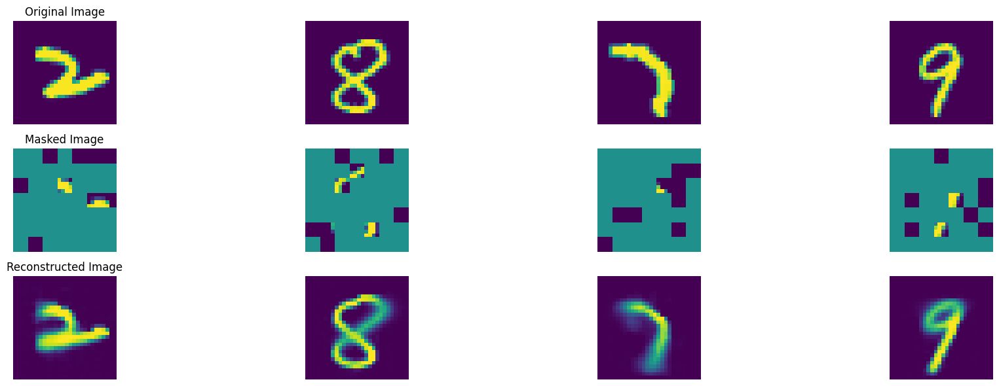

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 592, average traning loss is 0.09796819344479987.
=================== EPOCH:  593  ===================


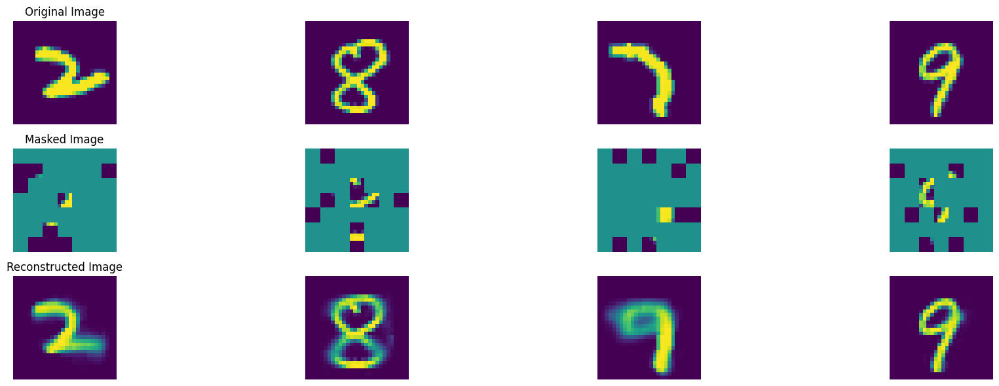

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 593, average traning loss is 0.09736946748292193.
=================== EPOCH:  594  ===================


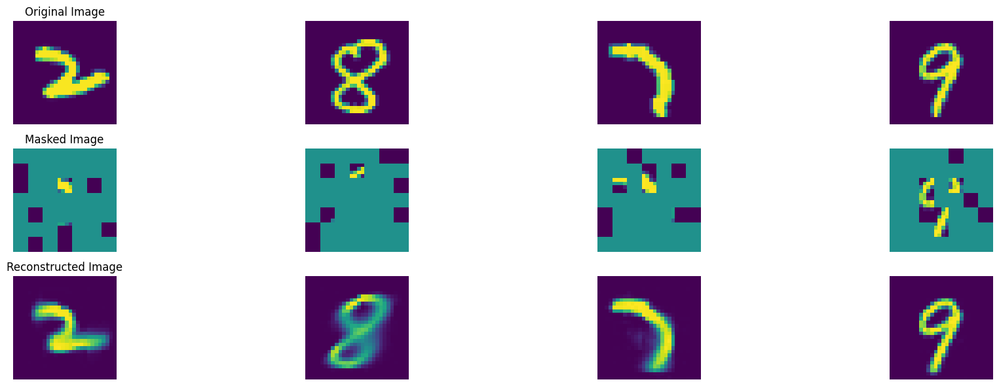

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 594, average traning loss is 0.09722499153081407.
=================== EPOCH:  595  ===================


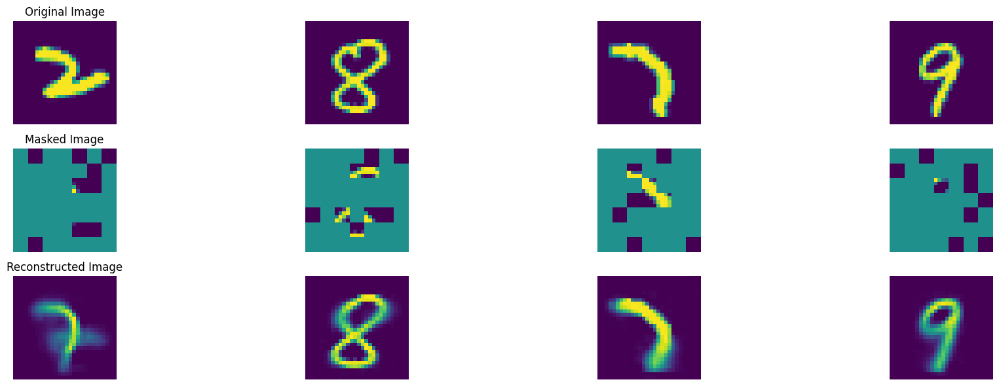

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 595, average traning loss is 0.09717318843653862.
=================== EPOCH:  596  ===================


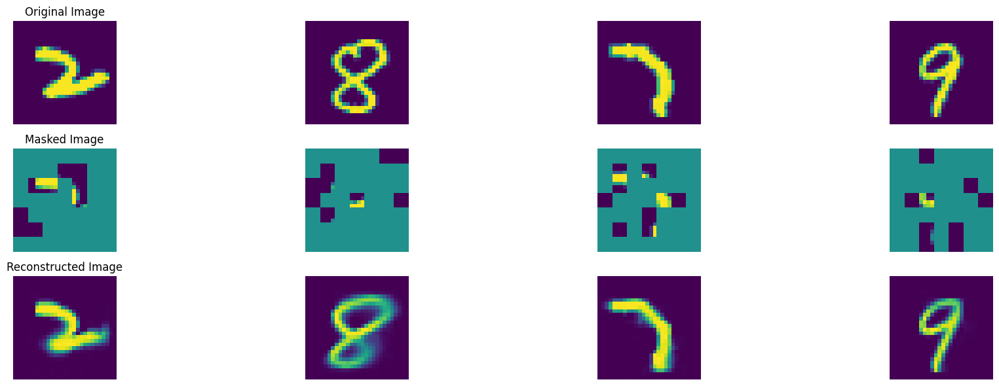

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 596, average traning loss is 0.09700312053269529.
=================== EPOCH:  597  ===================


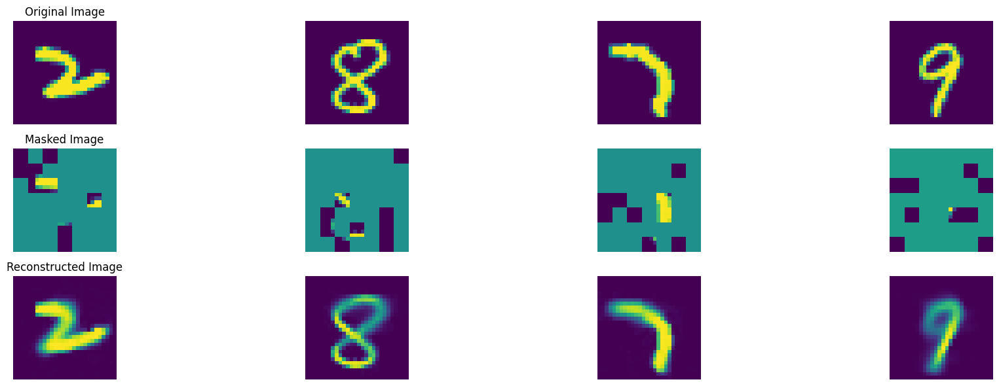

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 597, average traning loss is 0.09765821536804767.
=================== EPOCH:  598  ===================


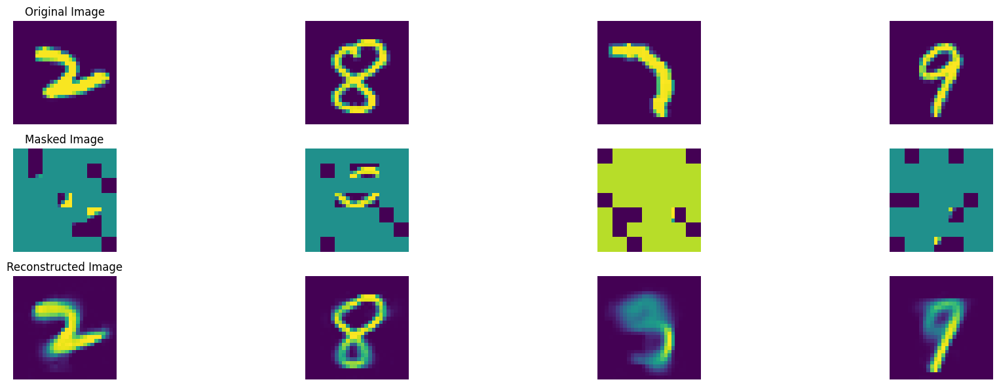

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 598, average traning loss is 0.09673245869418408.
=================== EPOCH:  599  ===================


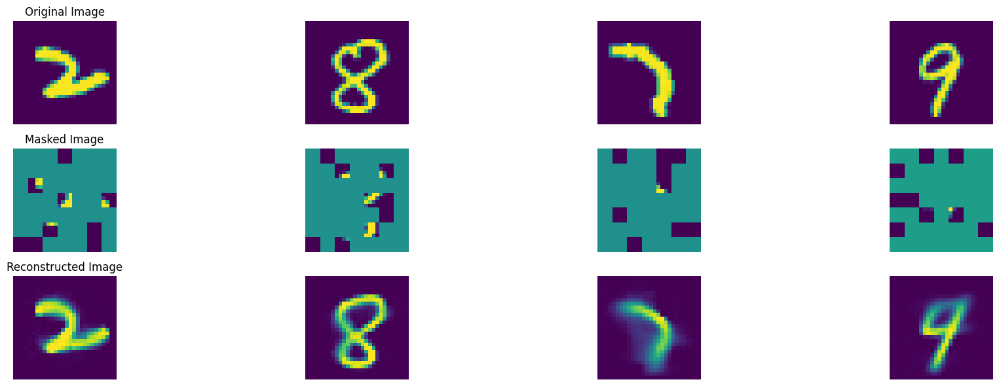

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 599, average traning loss is 0.0967624344407244.
=================== EPOCH:  600  ===================


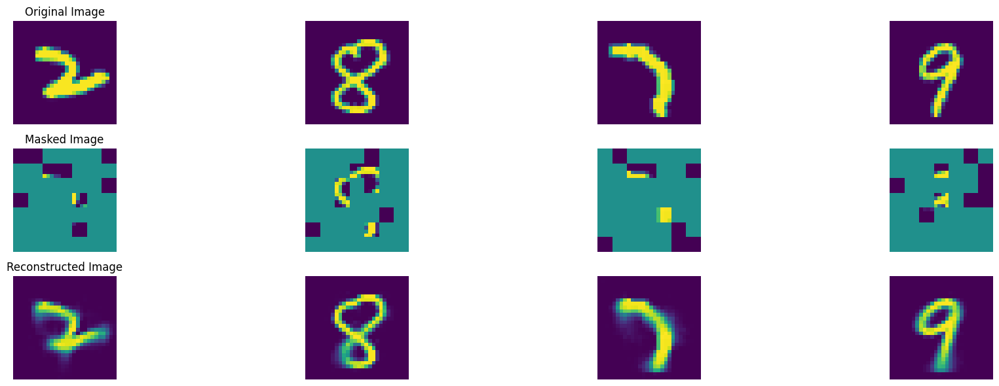

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 600, average traning loss is 0.09757809150726238.
=================== EPOCH:  601  ===================


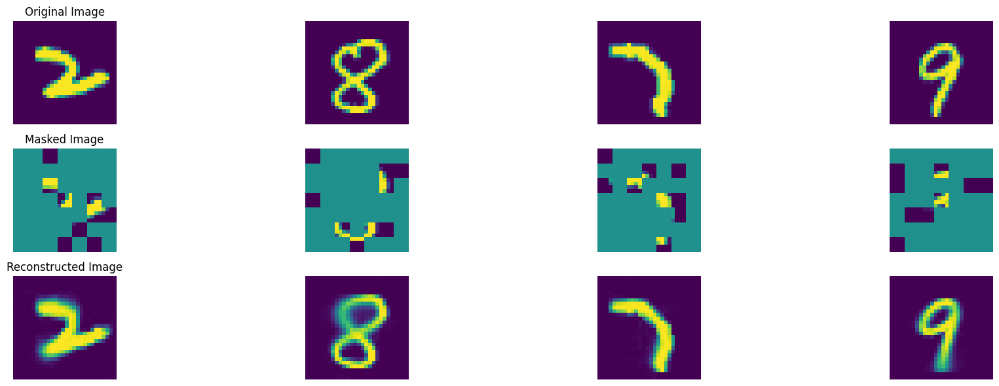

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 601, average traning loss is 0.09686169741635627.
=================== EPOCH:  602  ===================


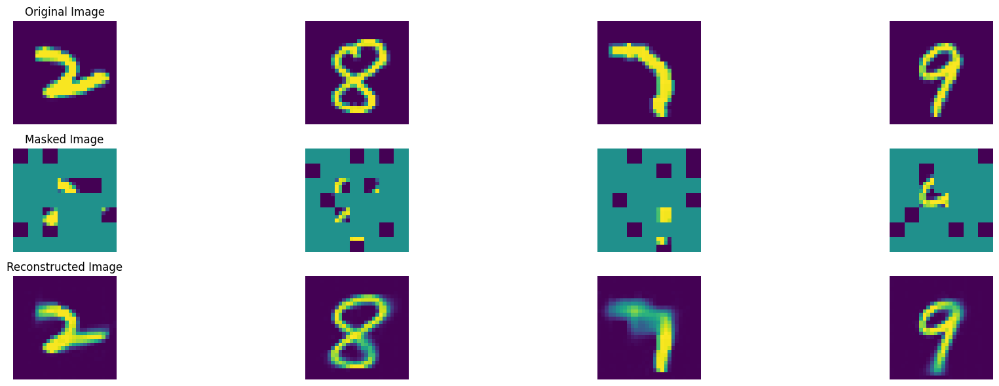

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 602, average traning loss is 0.09698699985412841.
=================== EPOCH:  603  ===================


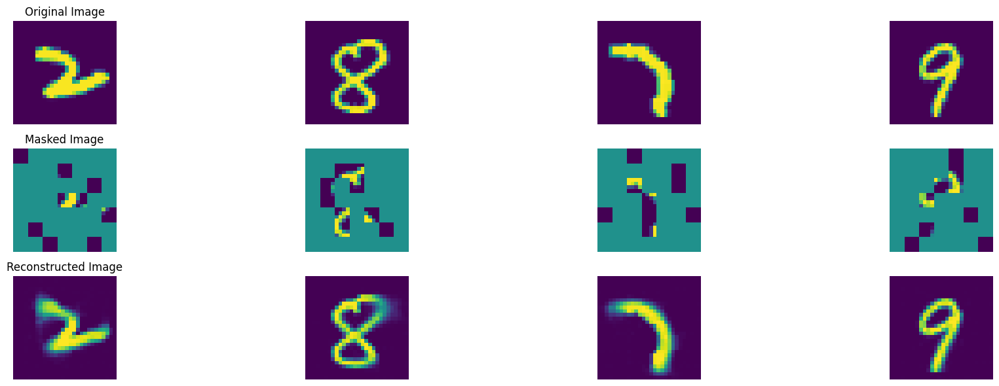

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 603, average traning loss is 0.09706824510655504.
=================== EPOCH:  604  ===================


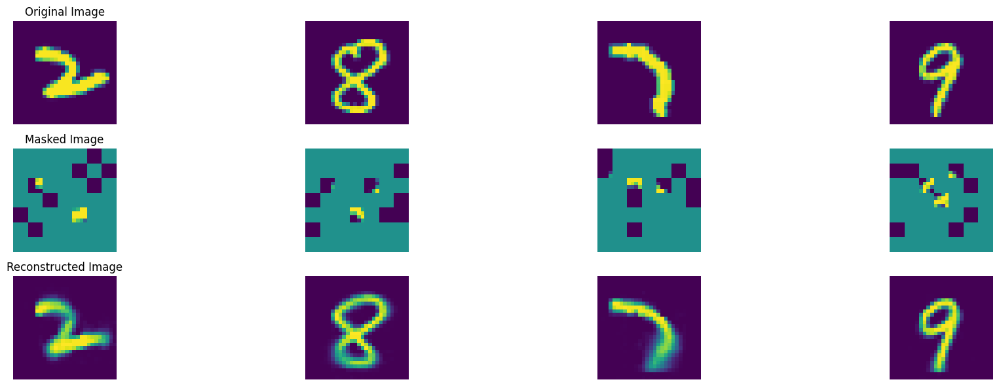

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 604, average traning loss is 0.09698603429058765.
=================== EPOCH:  605  ===================


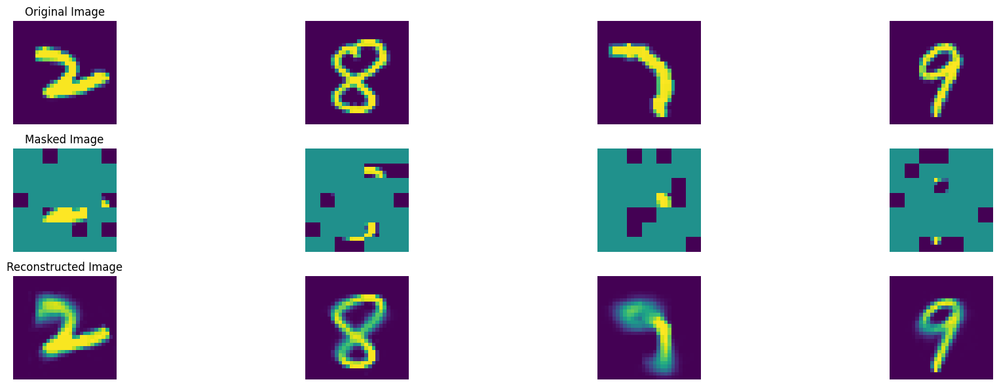

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 605, average traning loss is 0.09741433963496635.
=================== EPOCH:  606  ===================


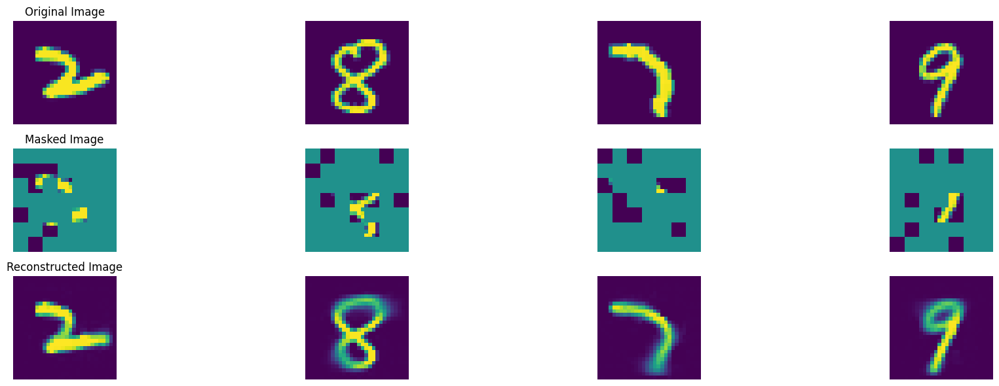

100%|██████████| 47/47 [00:08<00:00,  5.29it/s]


In epoch 606, average traning loss is 0.09700779442457443.
=================== EPOCH:  607  ===================


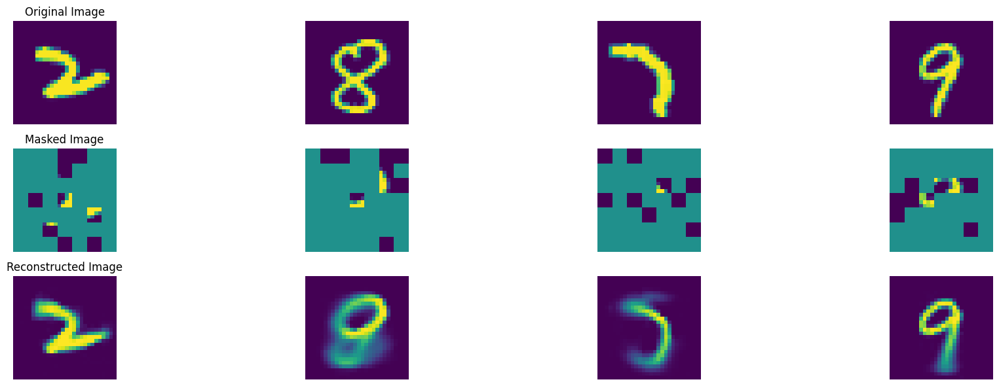

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 607, average traning loss is 0.09673249119139732.
=================== EPOCH:  608  ===================


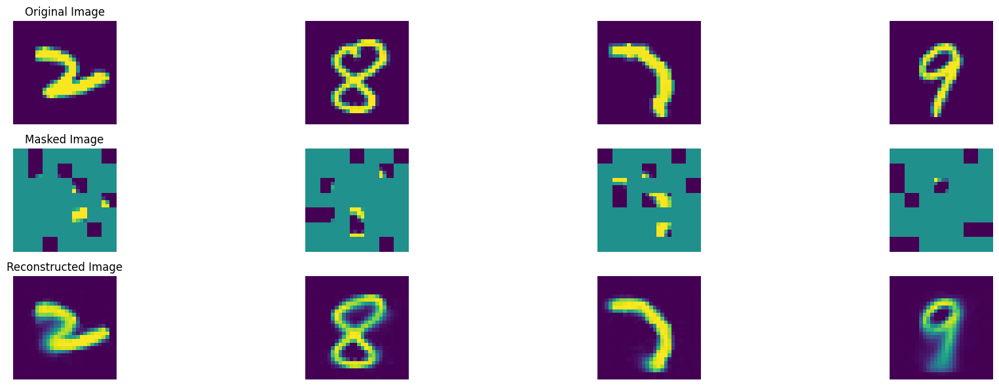

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 608, average traning loss is 0.09654991788432953.
=================== EPOCH:  609  ===================


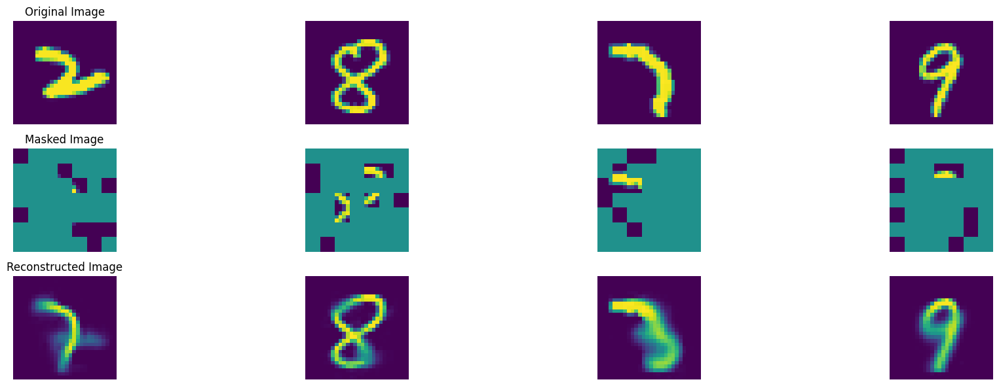

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 609, average traning loss is 0.09663655830824629.
=================== EPOCH:  610  ===================


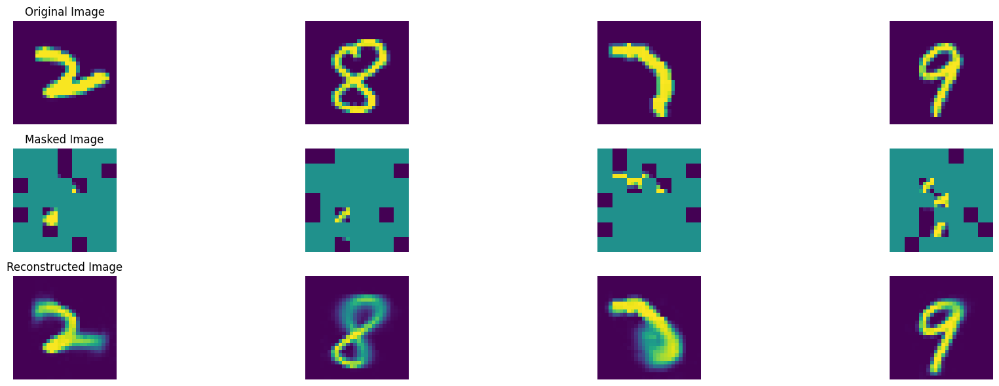

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 610, average traning loss is 0.09639172097469897.
=================== EPOCH:  611  ===================


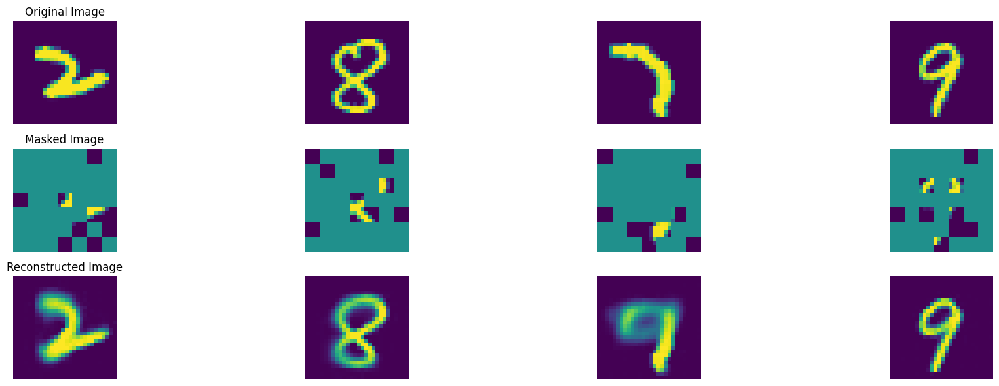

100%|██████████| 47/47 [00:08<00:00,  5.52it/s]


In epoch 611, average traning loss is 0.0963067206296515.
=================== EPOCH:  612  ===================


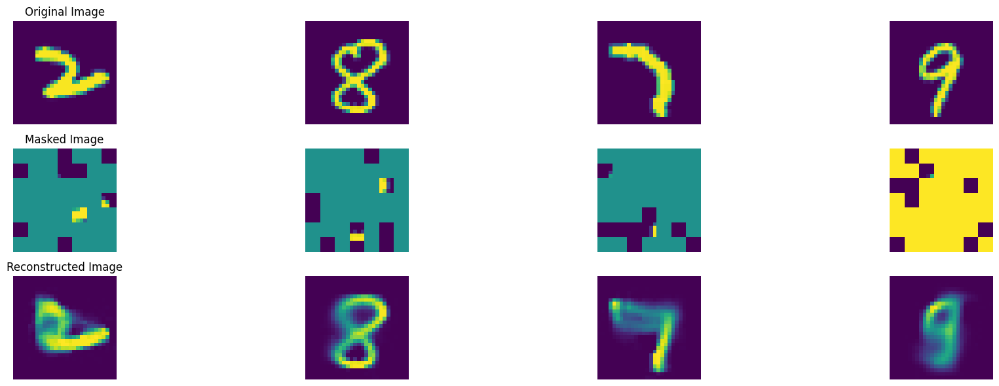

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 612, average traning loss is 0.09637728365177804.
=================== EPOCH:  613  ===================


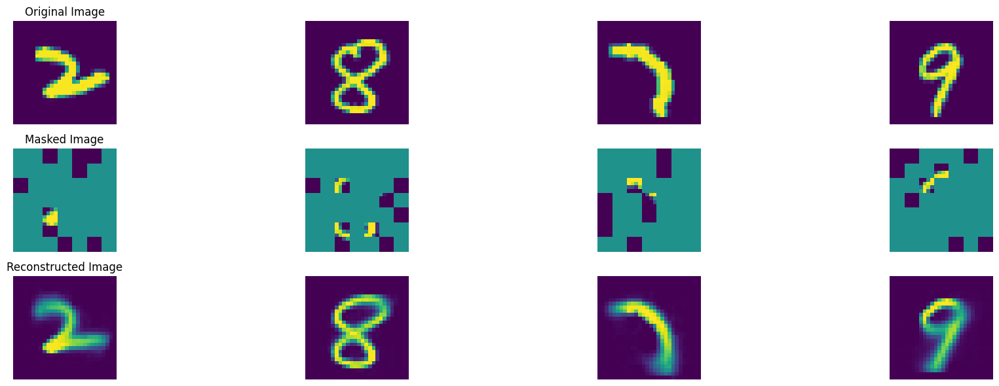

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 613, average traning loss is 0.0965547834305053.
=================== EPOCH:  614  ===================


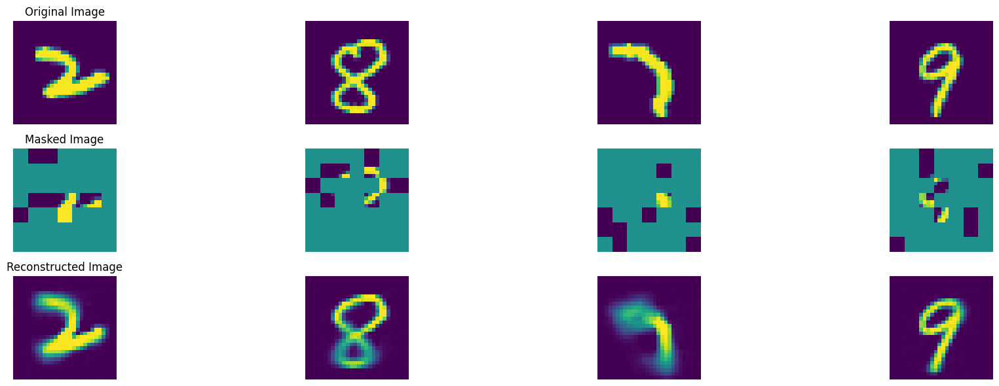

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 614, average traning loss is 0.09725399568993995.
=================== EPOCH:  615  ===================


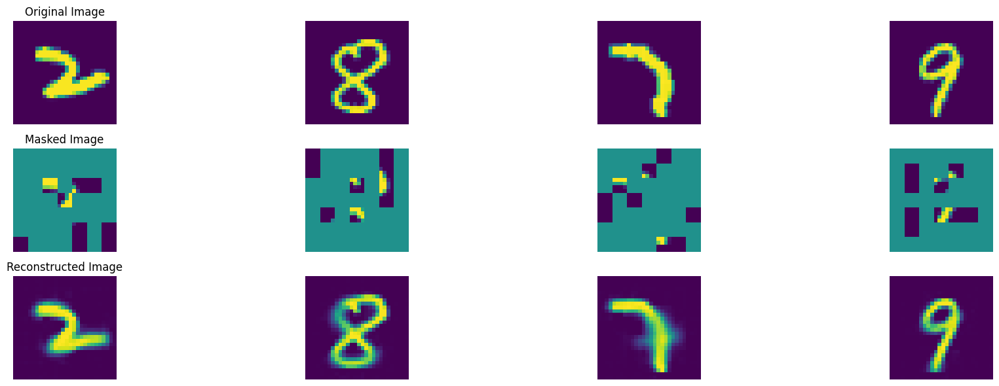

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 615, average traning loss is 0.09685369184676637.
=================== EPOCH:  616  ===================


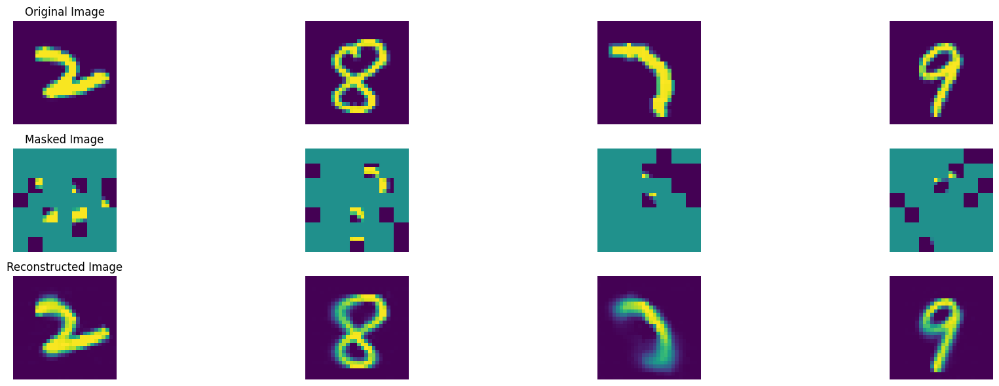

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 616, average traning loss is 0.09630646509058932.
=================== EPOCH:  617  ===================


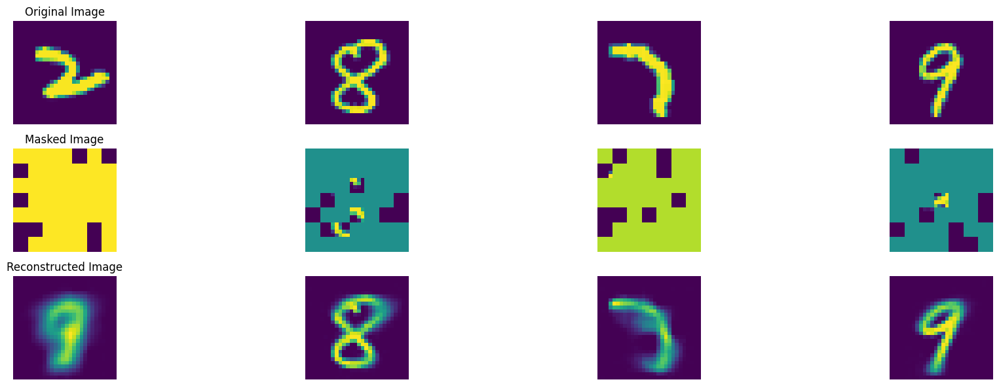

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 617, average traning loss is 0.09653929874618003.
=================== EPOCH:  618  ===================


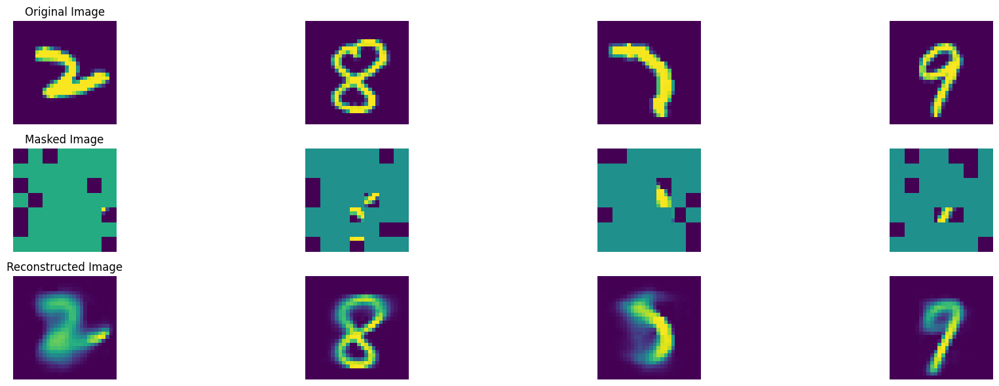

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 618, average traning loss is 0.09649098125544.
=================== EPOCH:  619  ===================


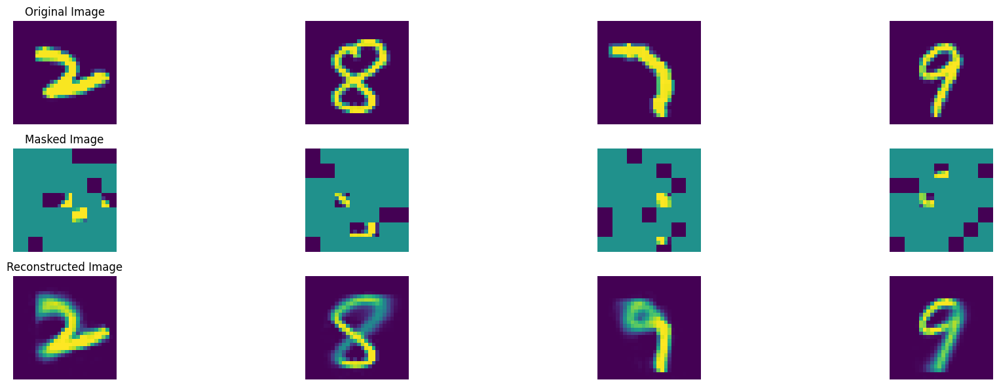

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 619, average traning loss is 0.09598598153667247.
=================== EPOCH:  620  ===================


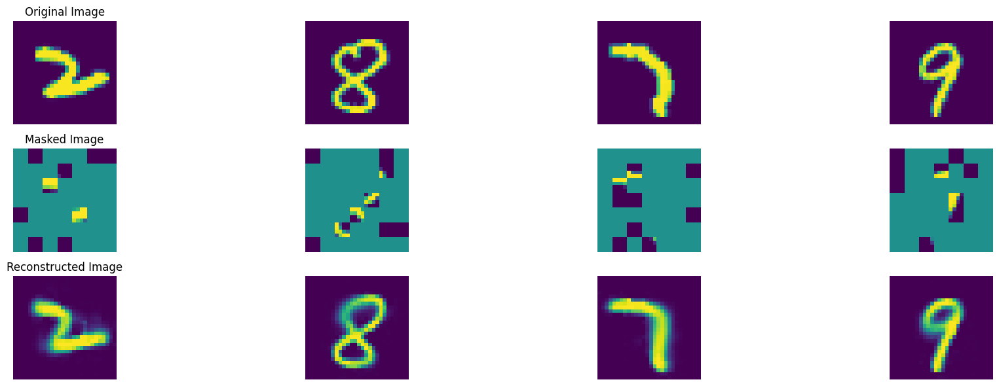

100%|██████████| 47/47 [00:08<00:00,  5.31it/s]


In epoch 620, average traning loss is 0.0962555189716055.
=================== EPOCH:  621  ===================


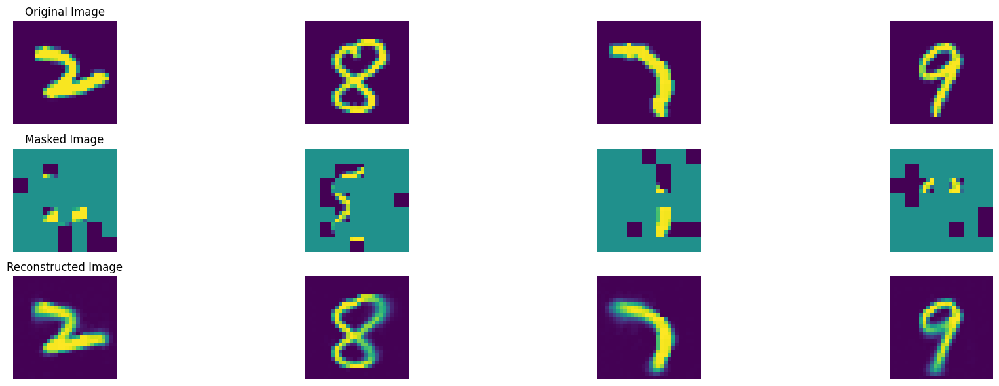

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 621, average traning loss is 0.0958584800679633.
=================== EPOCH:  622  ===================


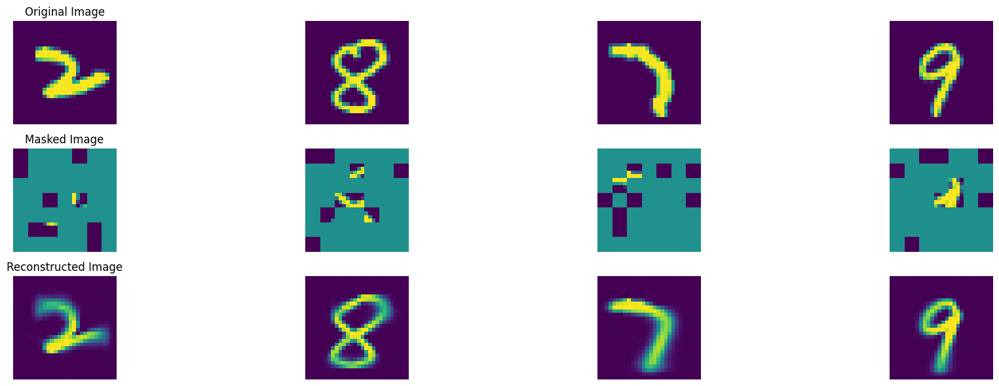

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 622, average traning loss is 0.09633807806258506.
=================== EPOCH:  623  ===================


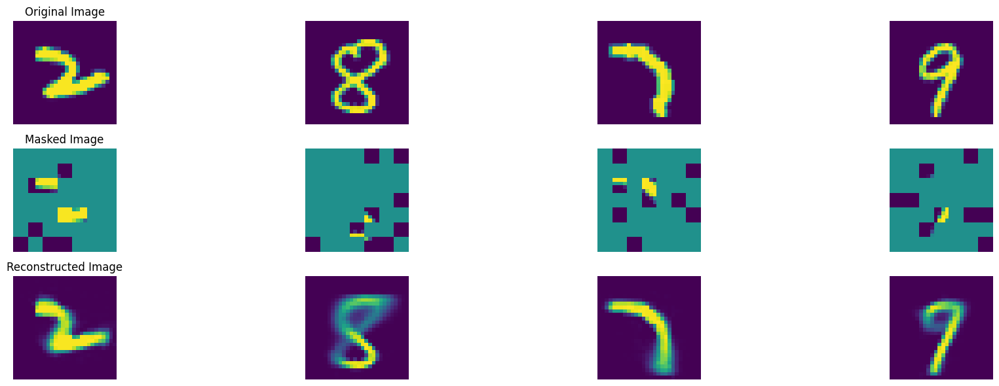

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 623, average traning loss is 0.09628314271252206.
=================== EPOCH:  624  ===================


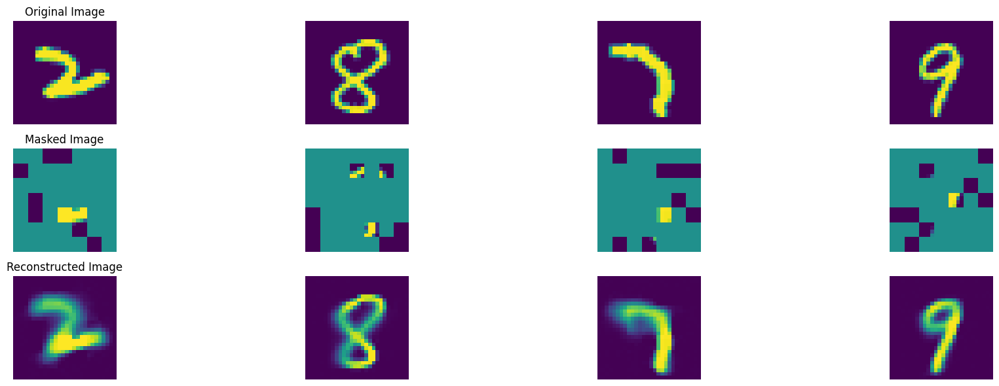

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 624, average traning loss is 0.09611237984388432.
=================== EPOCH:  625  ===================


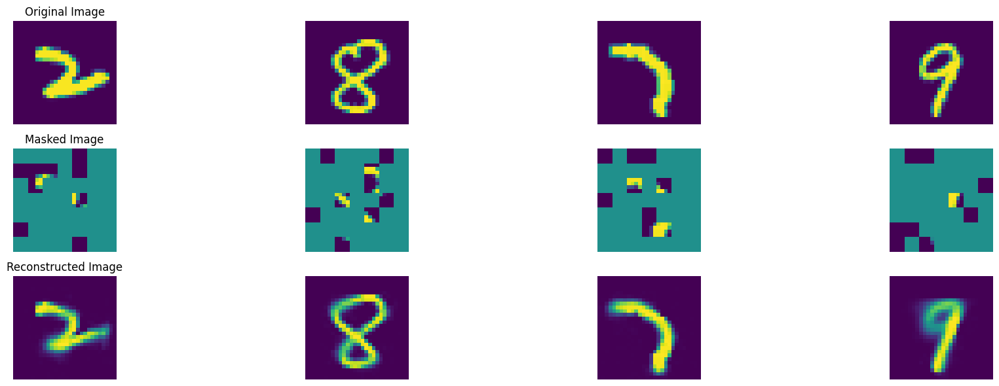

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 625, average traning loss is 0.09628469814011391.
=================== EPOCH:  626  ===================


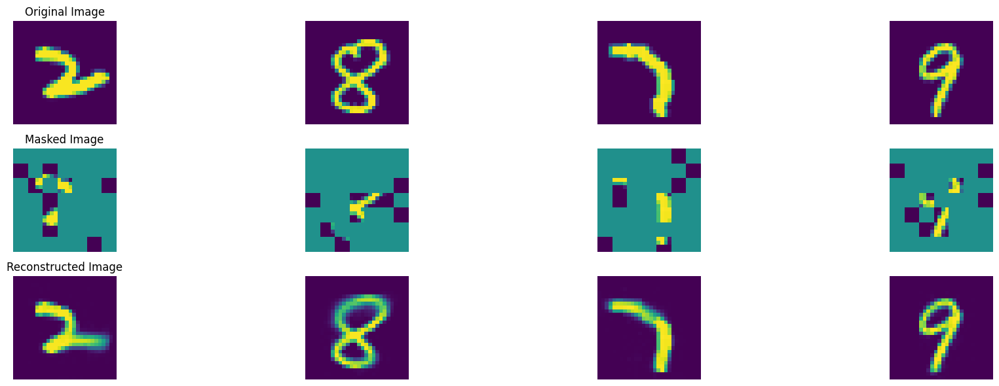

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 626, average traning loss is 0.09591915997418951.
=================== EPOCH:  627  ===================


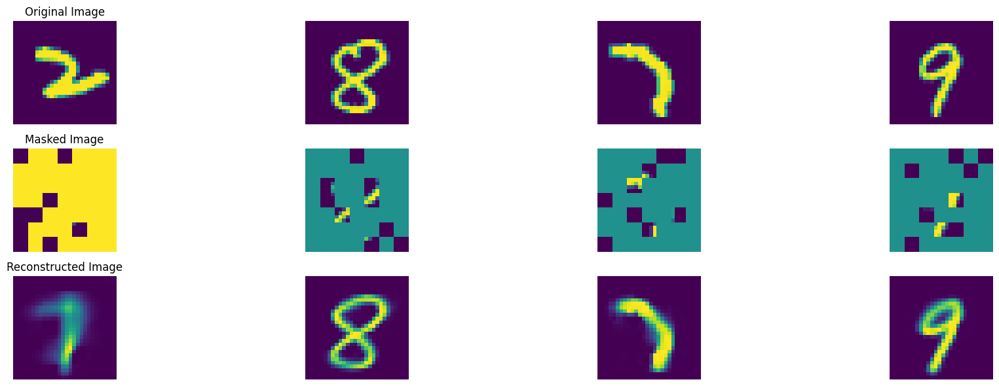

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 627, average traning loss is 0.09594684110042896.
=================== EPOCH:  628  ===================


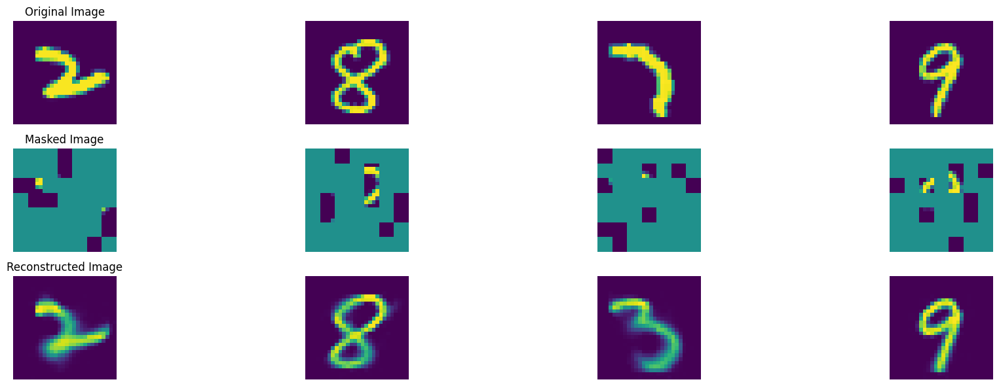

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 628, average traning loss is 0.09594202992763926.
=================== EPOCH:  629  ===================


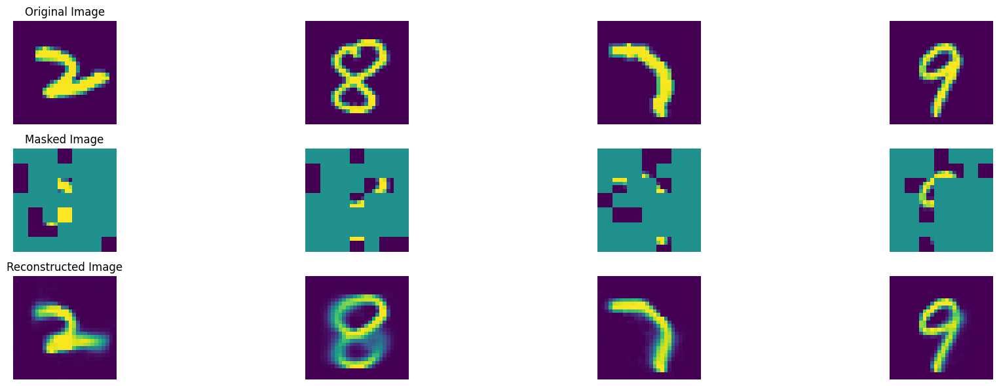

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 629, average traning loss is 0.09595535743109723.
=================== EPOCH:  630  ===================


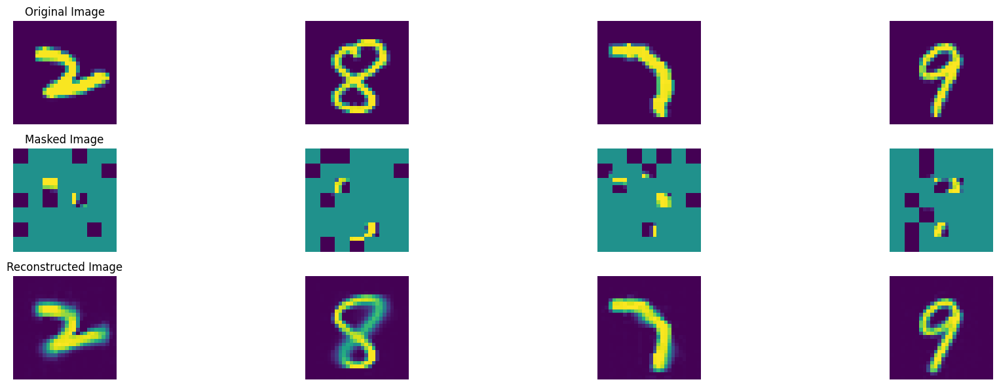

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 630, average traning loss is 0.09594111303065686.
=================== EPOCH:  631  ===================


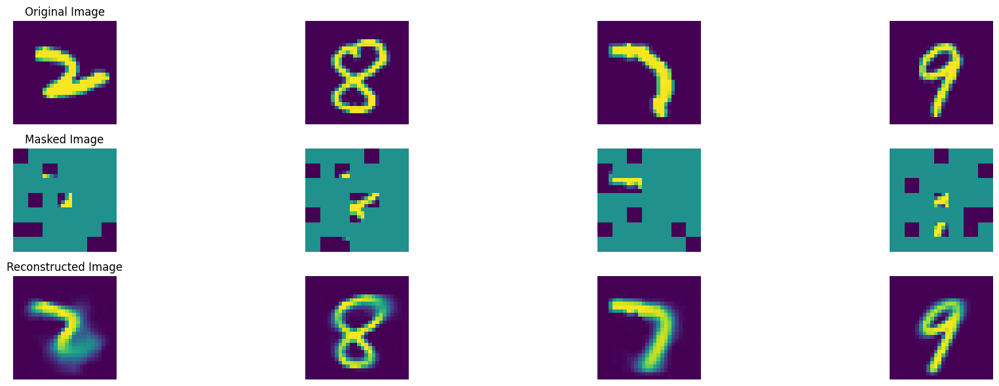

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 631, average traning loss is 0.09607823541823854.
=================== EPOCH:  632  ===================


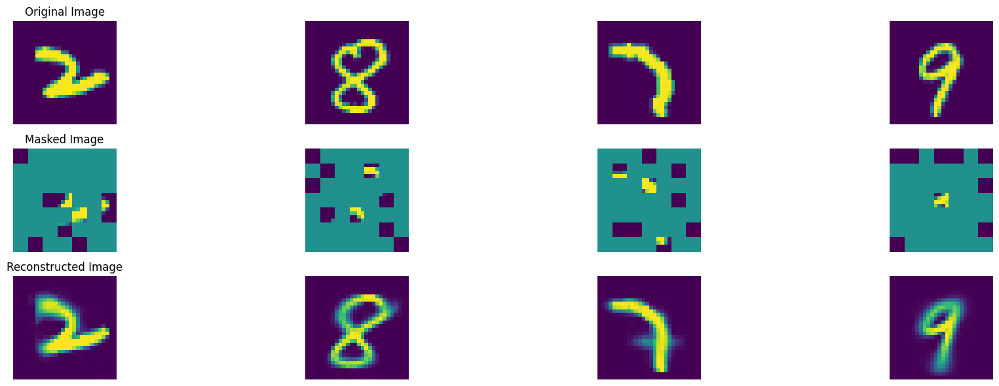

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 632, average traning loss is 0.09561921339085762.
=================== EPOCH:  633  ===================


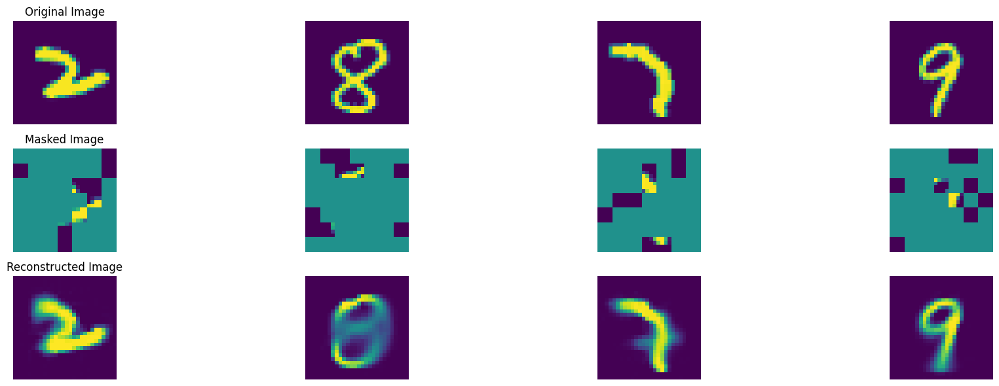

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 633, average traning loss is 0.095431331782899.
=================== EPOCH:  634  ===================


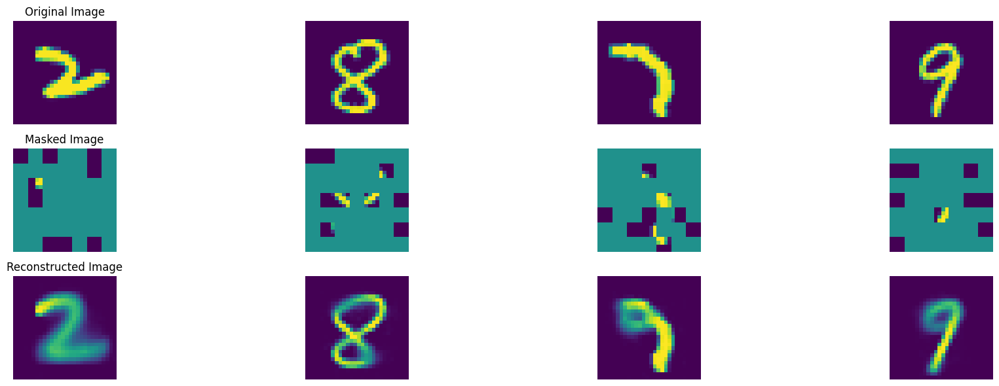

100%|██████████| 47/47 [00:08<00:00,  5.50it/s]


In epoch 634, average traning loss is 0.09622110632505823.
=================== EPOCH:  635  ===================


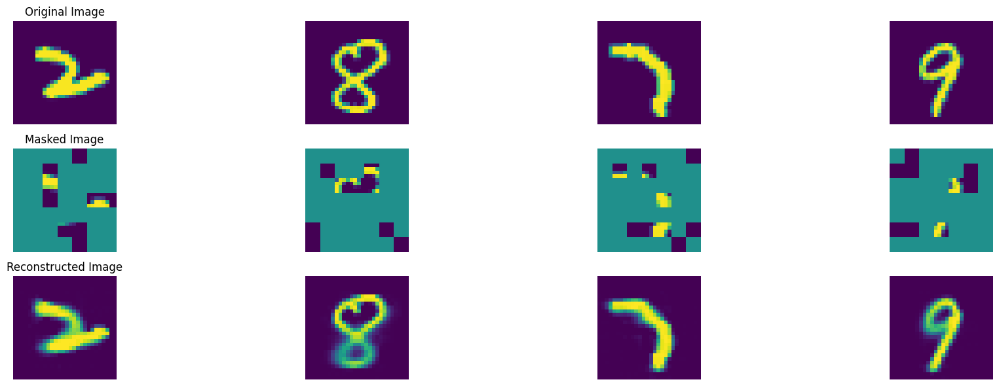

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 635, average traning loss is 0.09584262015971731.
=================== EPOCH:  636  ===================


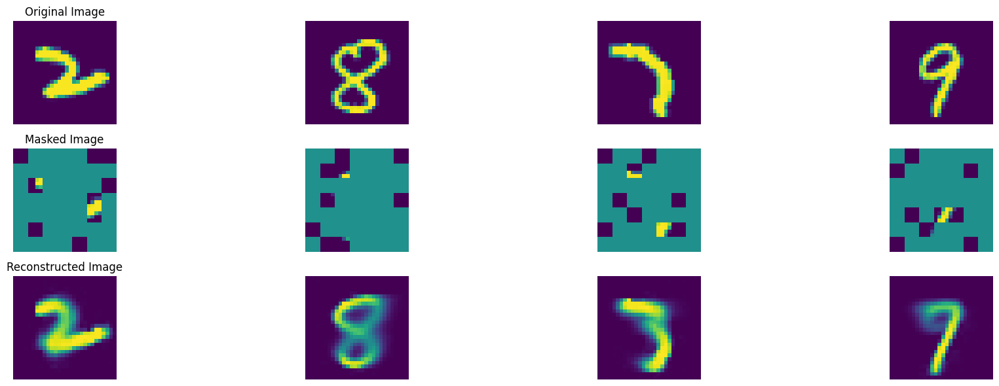

100%|██████████| 47/47 [00:08<00:00,  5.51it/s]


In epoch 636, average traning loss is 0.0961863286000617.
=================== EPOCH:  637  ===================


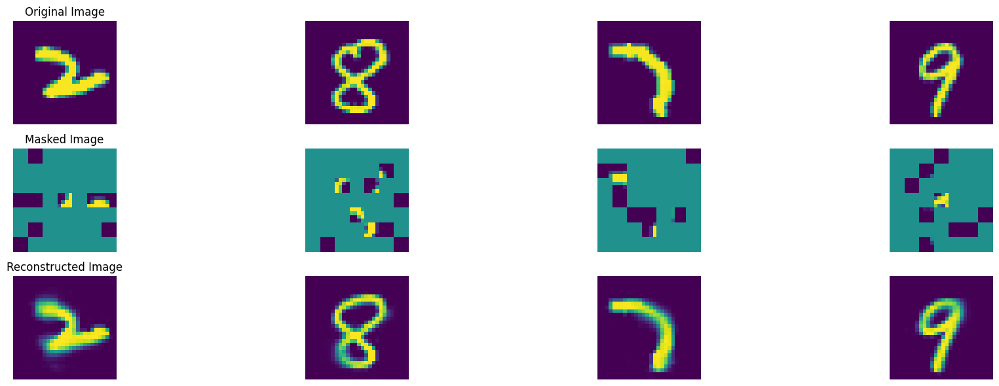

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 637, average traning loss is 0.09533700616435802.
=================== EPOCH:  638  ===================


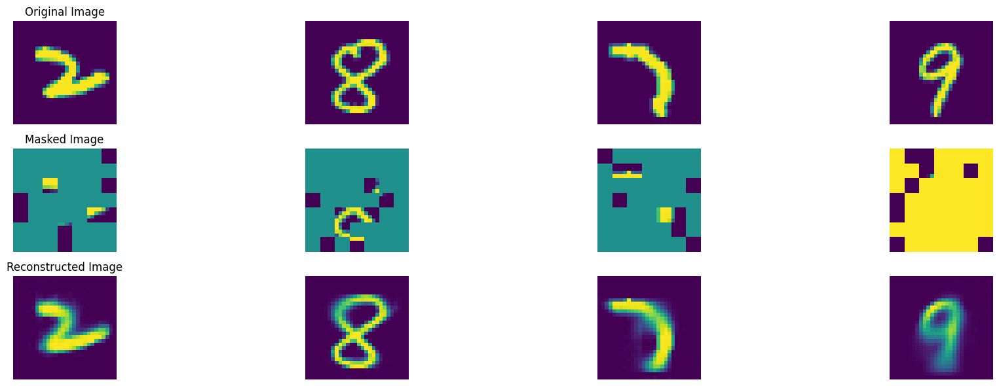

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 638, average traning loss is 0.09562466404539474.
=================== EPOCH:  639  ===================


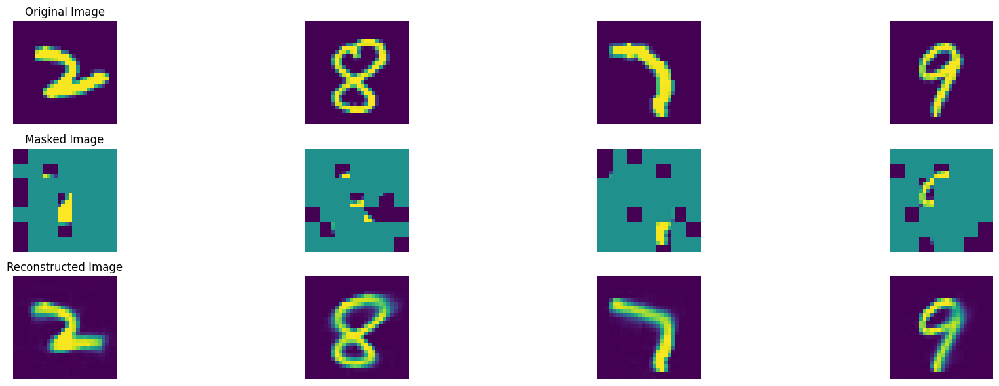

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 639, average traning loss is 0.09550457733108643.
=================== EPOCH:  640  ===================


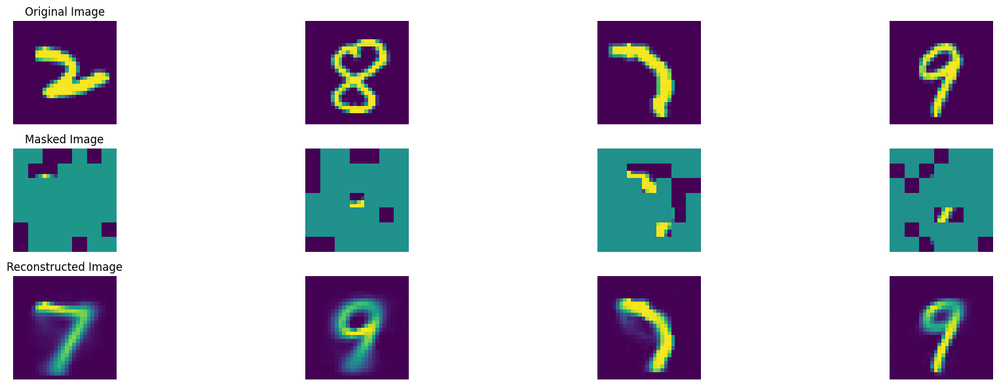

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 640, average traning loss is 0.09544134250980743.
=================== EPOCH:  641  ===================


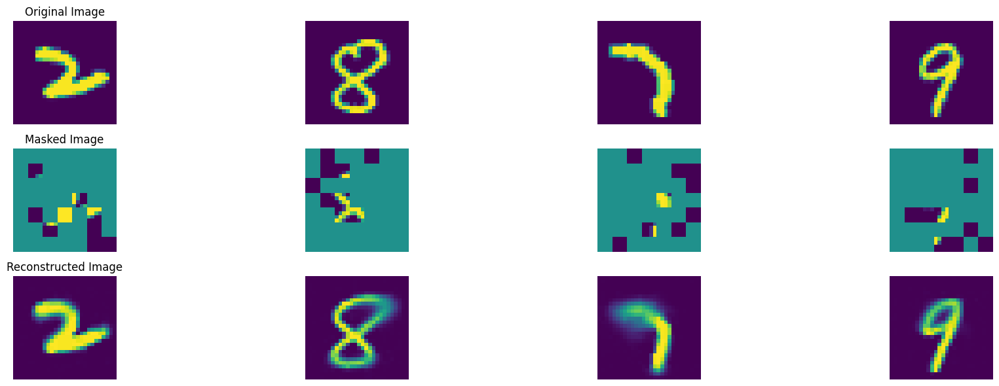

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 641, average traning loss is 0.09524560228307197.
=================== EPOCH:  642  ===================


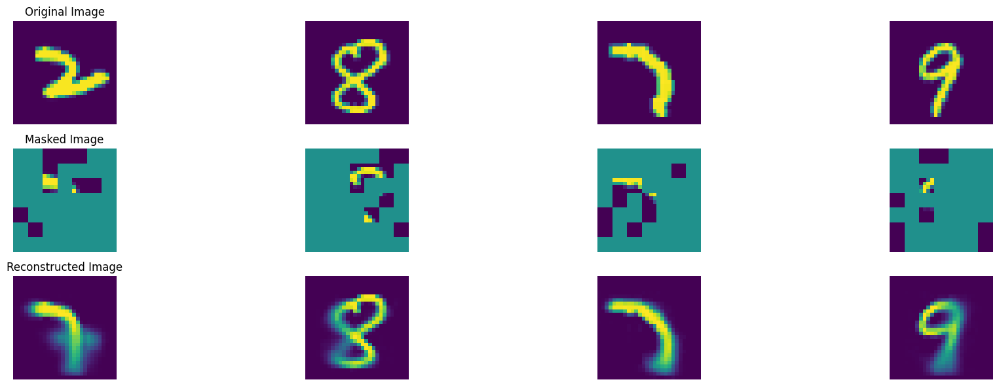

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 642, average traning loss is 0.09547016690386102.
=================== EPOCH:  643  ===================


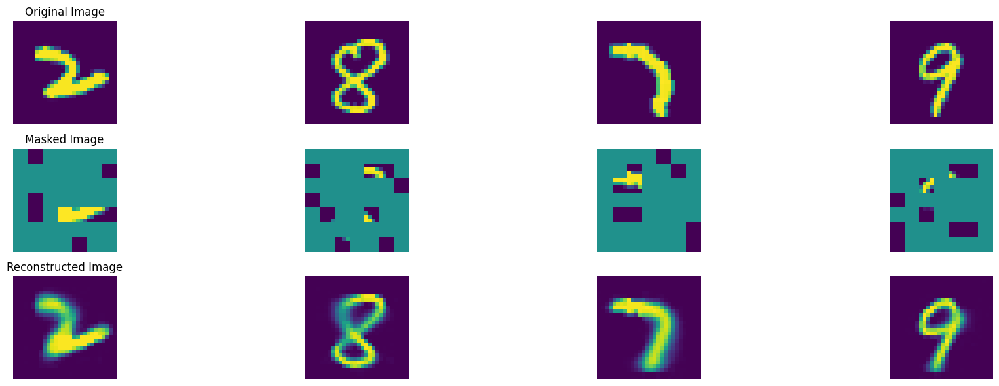

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 643, average traning loss is 0.09515308557038611.
=================== EPOCH:  644  ===================


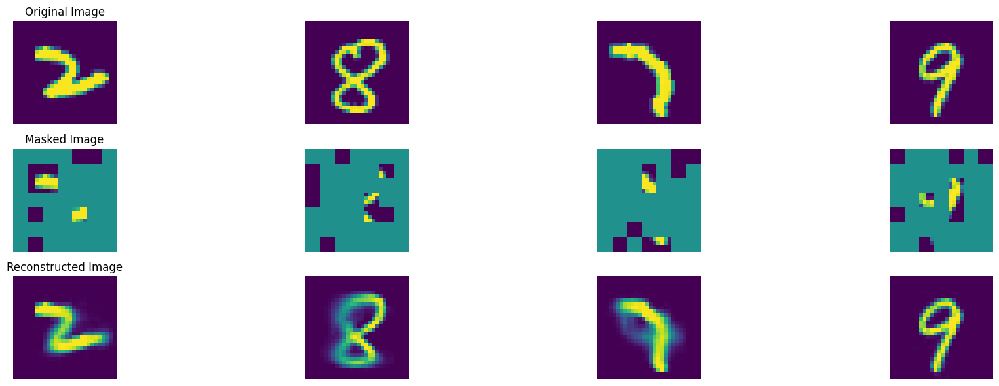

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 644, average traning loss is 0.09554412231800403.
=================== EPOCH:  645  ===================


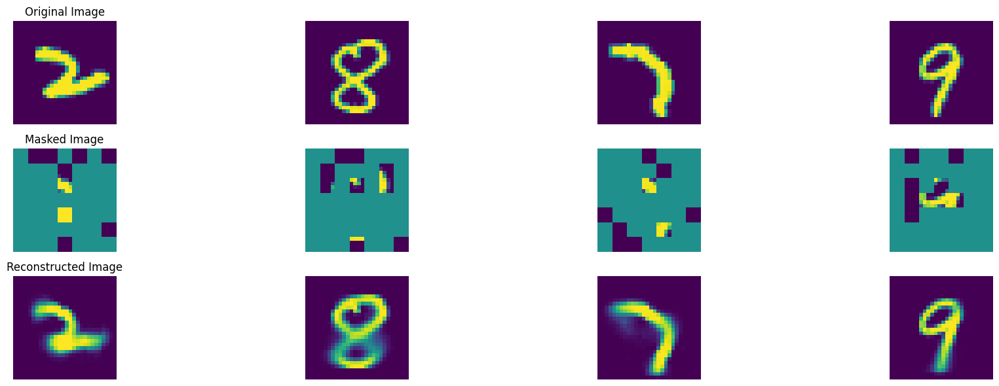

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 645, average traning loss is 0.0954993631928525.
=================== EPOCH:  646  ===================


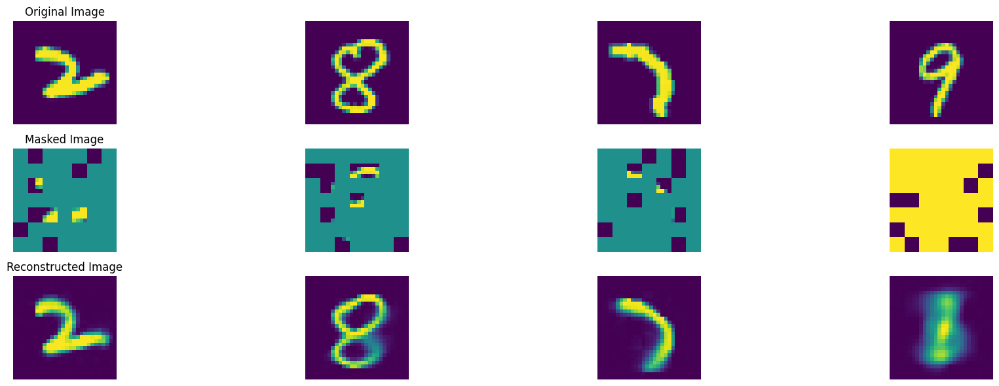

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 646, average traning loss is 0.09536801357852652.
=================== EPOCH:  647  ===================


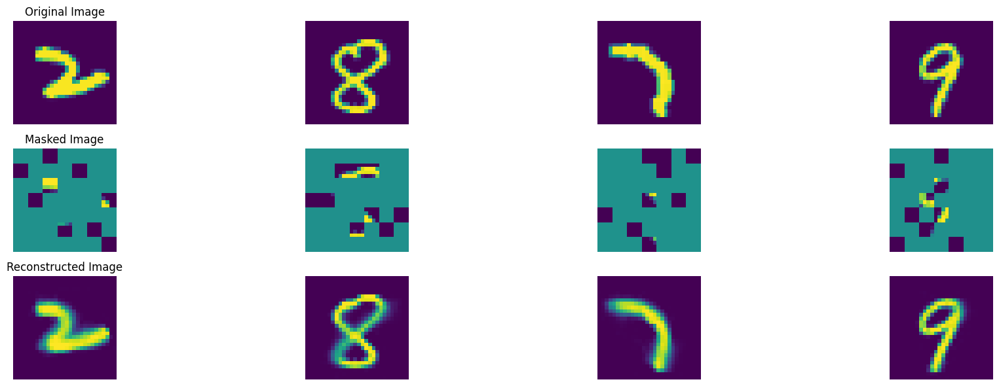

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 647, average traning loss is 0.09539133437136386.
=================== EPOCH:  648  ===================


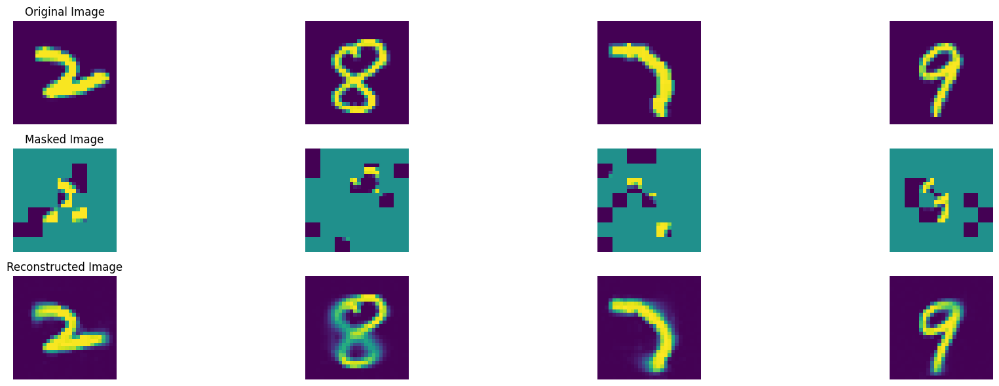

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 648, average traning loss is 0.0958036149435855.
=================== EPOCH:  649  ===================


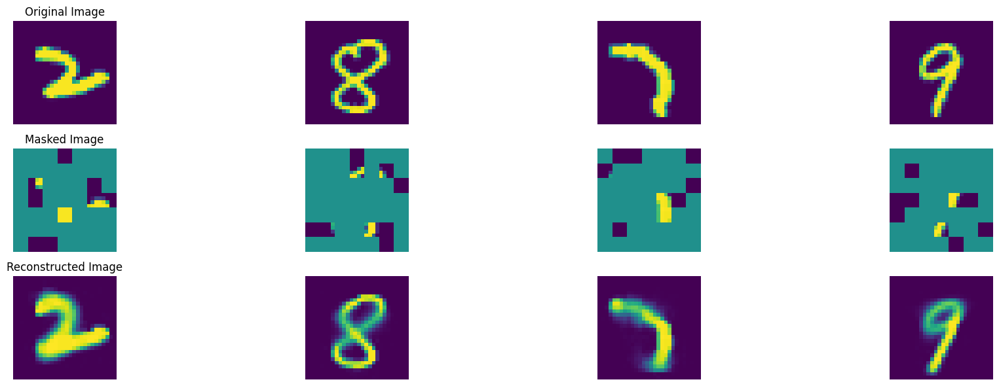

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 649, average traning loss is 0.09522641164825317.
=================== EPOCH:  650  ===================


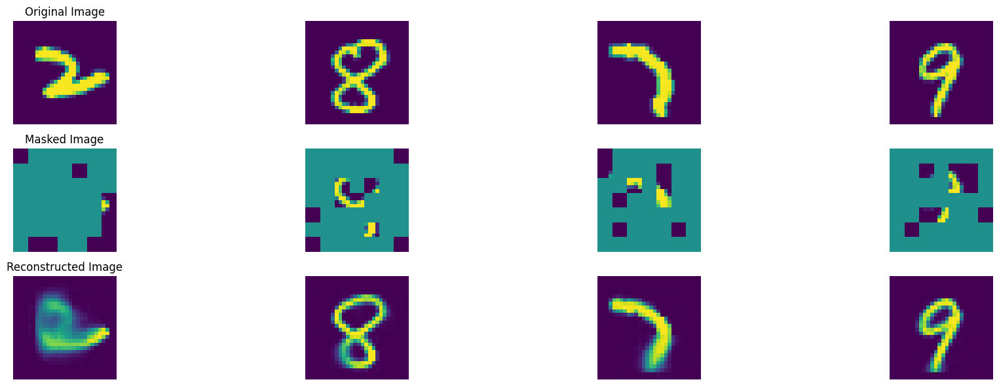

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 650, average traning loss is 0.094954917564037.
=================== EPOCH:  651  ===================


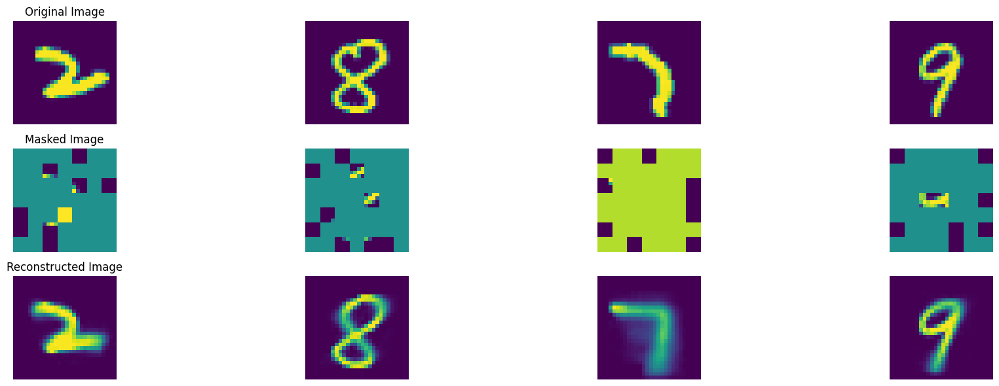

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 651, average traning loss is 0.0953479271302832.
=================== EPOCH:  652  ===================


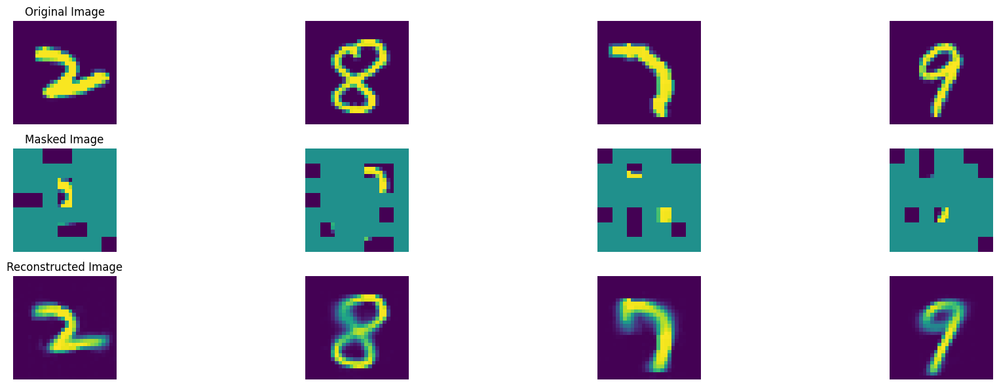

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 652, average traning loss is 0.09483837938689171.
=================== EPOCH:  653  ===================


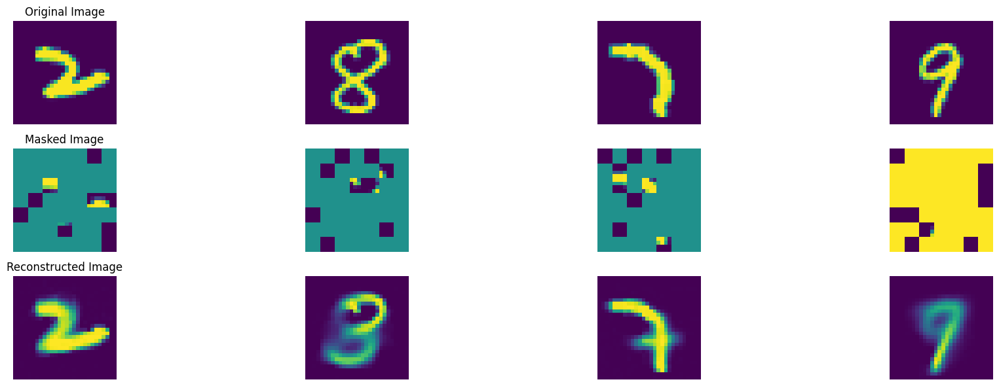

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 653, average traning loss is 0.095286969491776.
=================== EPOCH:  654  ===================


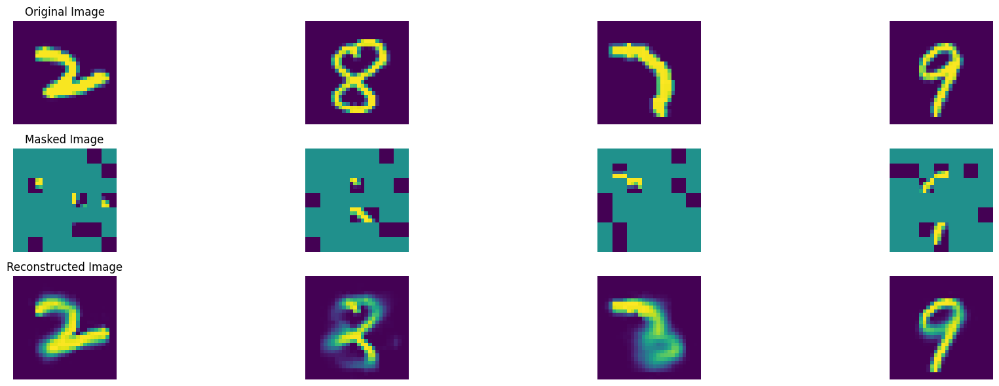

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 654, average traning loss is 0.09536711776510198.
=================== EPOCH:  655  ===================


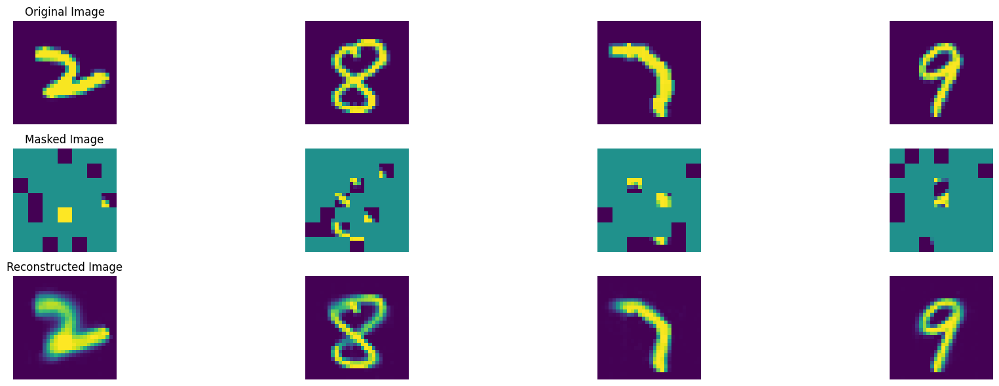

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 655, average traning loss is 0.09481178731360335.
=================== EPOCH:  656  ===================


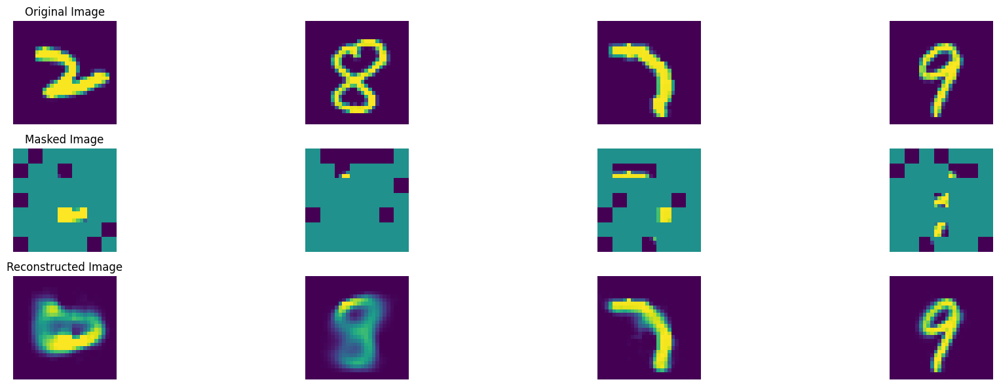

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 656, average traning loss is 0.09490555429712255.
=================== EPOCH:  657  ===================


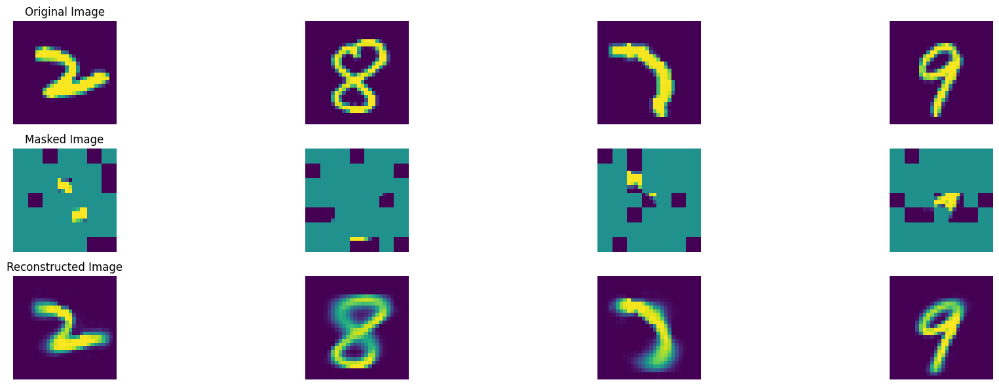

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 657, average traning loss is 0.09499366930190553.
=================== EPOCH:  658  ===================


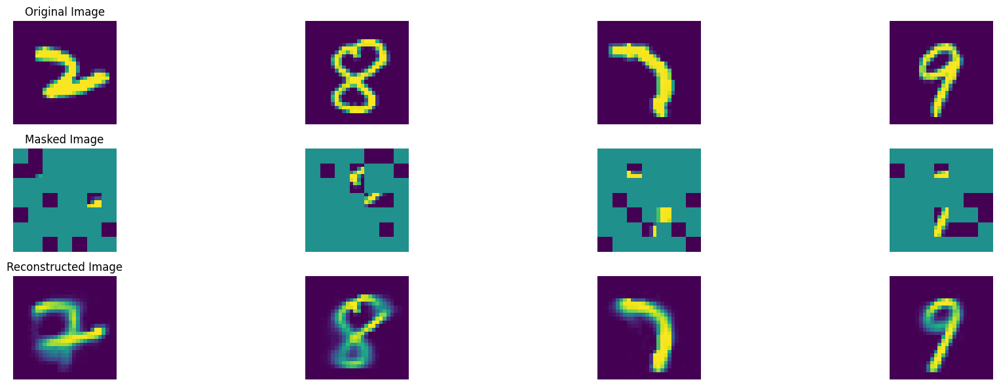

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 658, average traning loss is 0.0945722611343607.
=================== EPOCH:  659  ===================


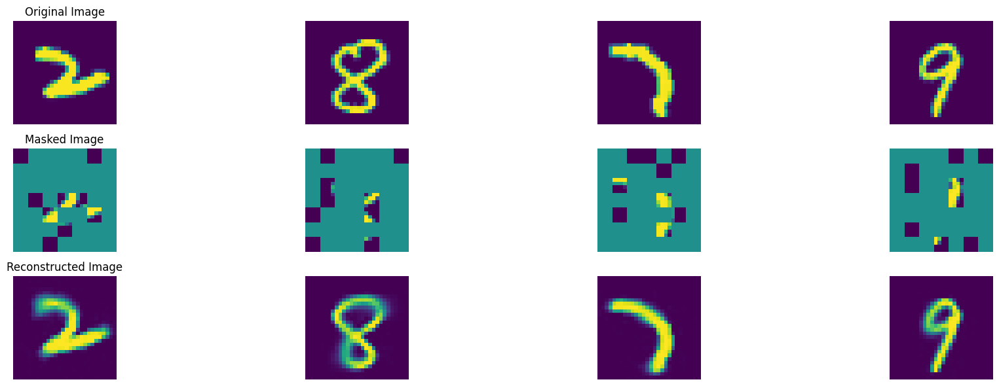

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 659, average traning loss is 0.09455183195940992.
=================== EPOCH:  660  ===================


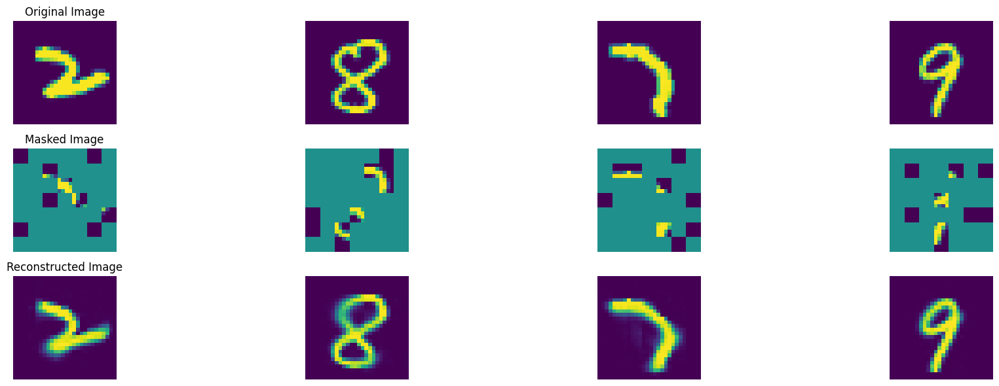

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 660, average traning loss is 0.0948865145761916.
=================== EPOCH:  661  ===================


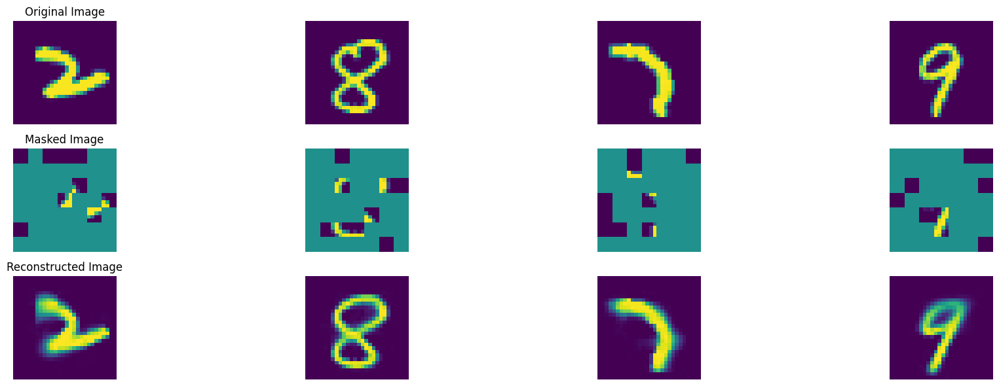

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 661, average traning loss is 0.09451584327728191.
=================== EPOCH:  662  ===================


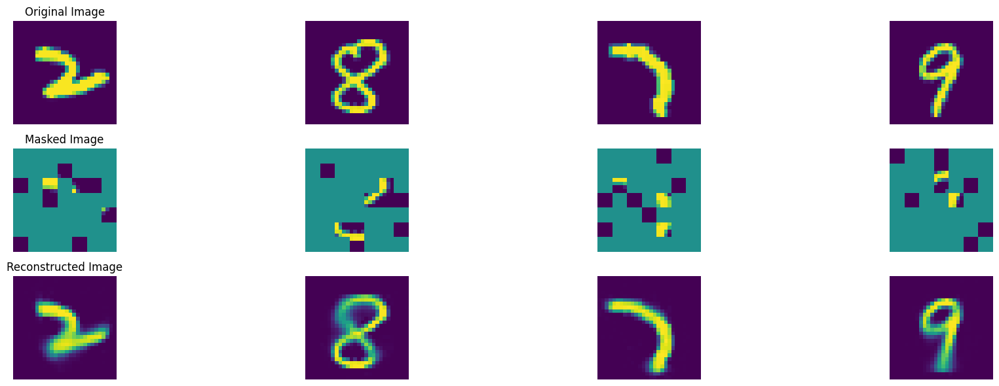

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 662, average traning loss is 0.09452951968984401.
=================== EPOCH:  663  ===================


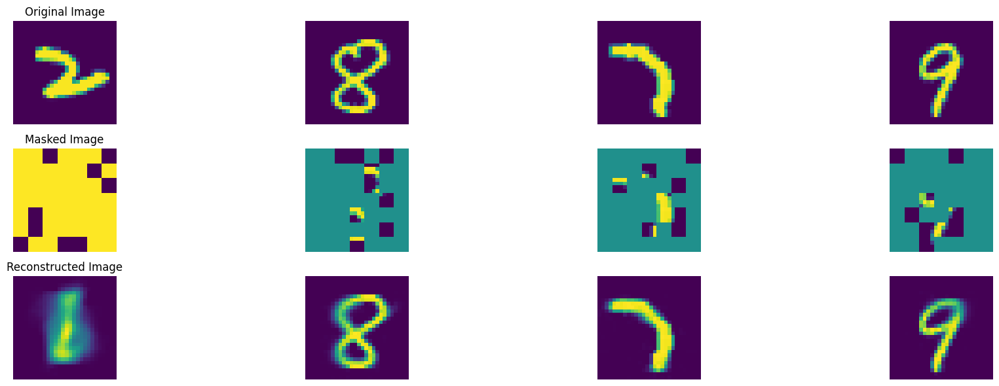

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 663, average traning loss is 0.09403348698260937.
=================== EPOCH:  664  ===================


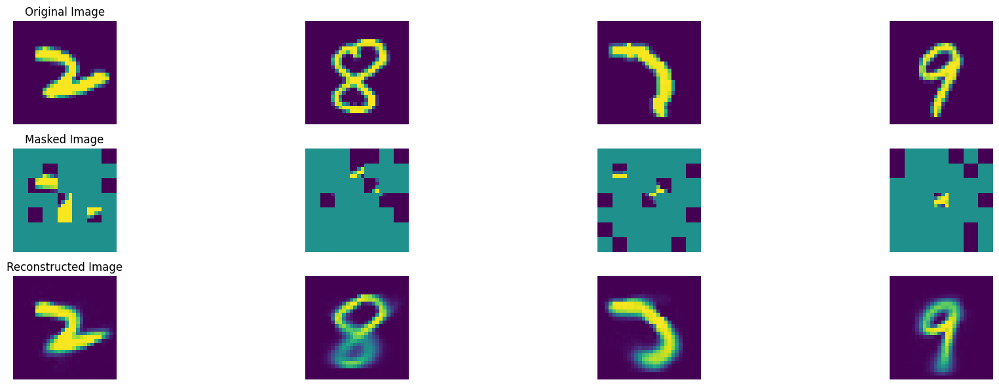

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 664, average traning loss is 0.09435273643503798.
=================== EPOCH:  665  ===================


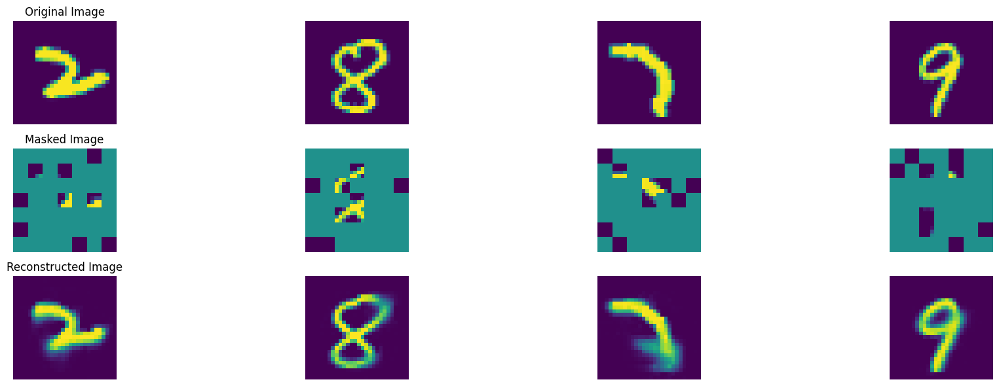

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 665, average traning loss is 0.09477947049952568.
=================== EPOCH:  666  ===================


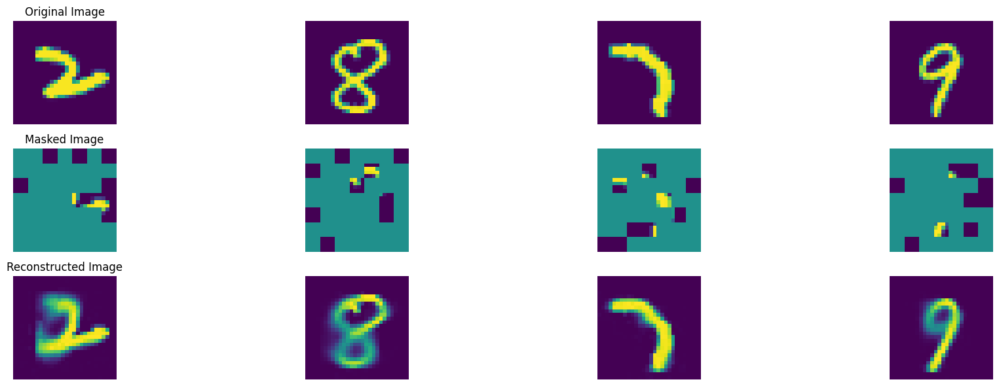

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 666, average traning loss is 0.0947007159603403.
=================== EPOCH:  667  ===================


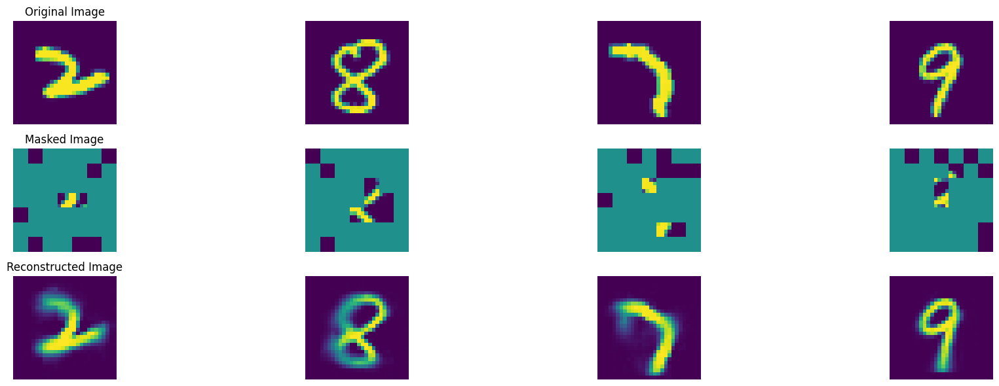

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 667, average traning loss is 0.0948833666266279.
=================== EPOCH:  668  ===================


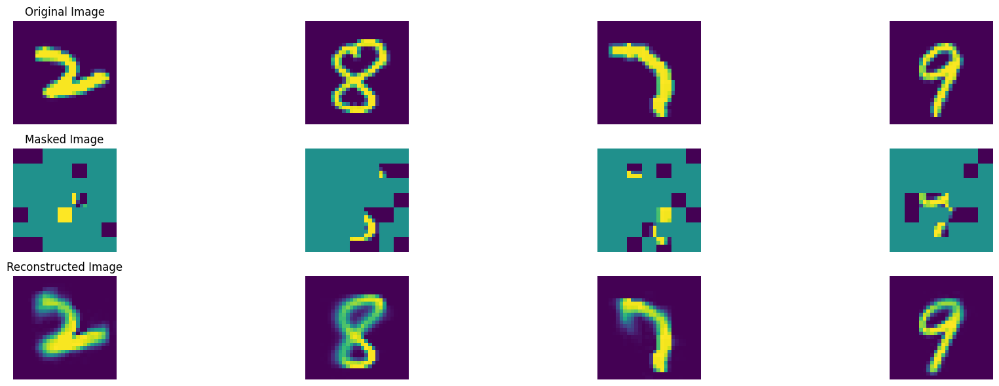

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 668, average traning loss is 0.09499808305755575.
=================== EPOCH:  669  ===================


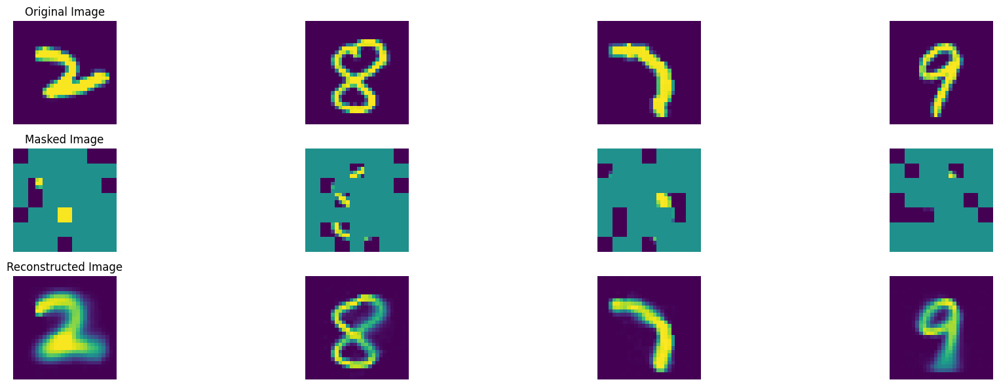

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 669, average traning loss is 0.09441718142083351.
=================== EPOCH:  670  ===================


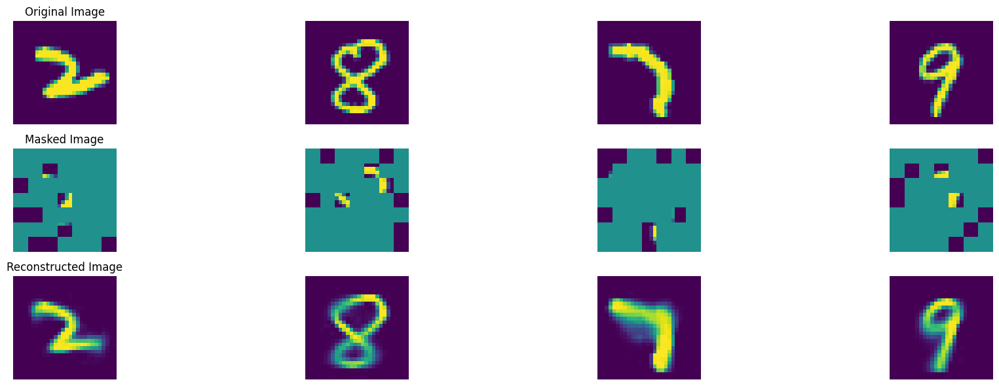

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 670, average traning loss is 0.09460353090408001.
=================== EPOCH:  671  ===================


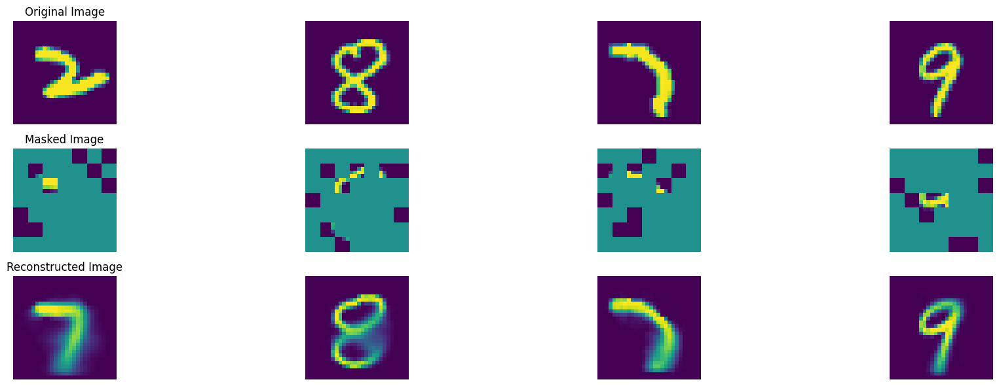

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 671, average traning loss is 0.09415069793133025.
=================== EPOCH:  672  ===================


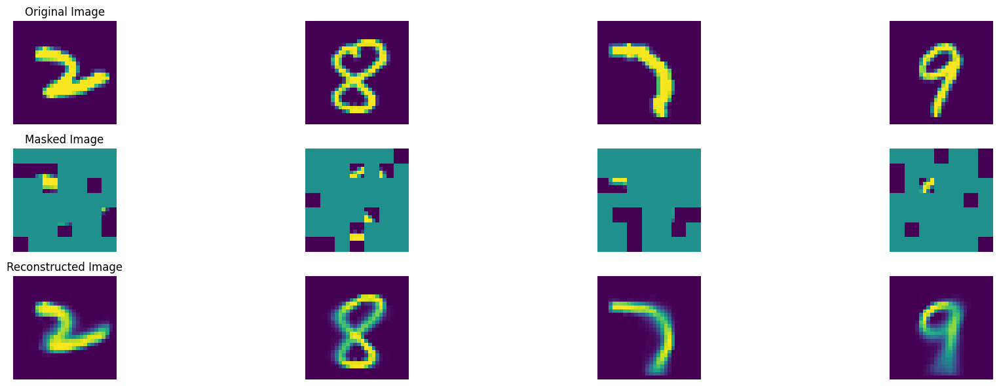

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 672, average traning loss is 0.09400364201753697.
=================== EPOCH:  673  ===================


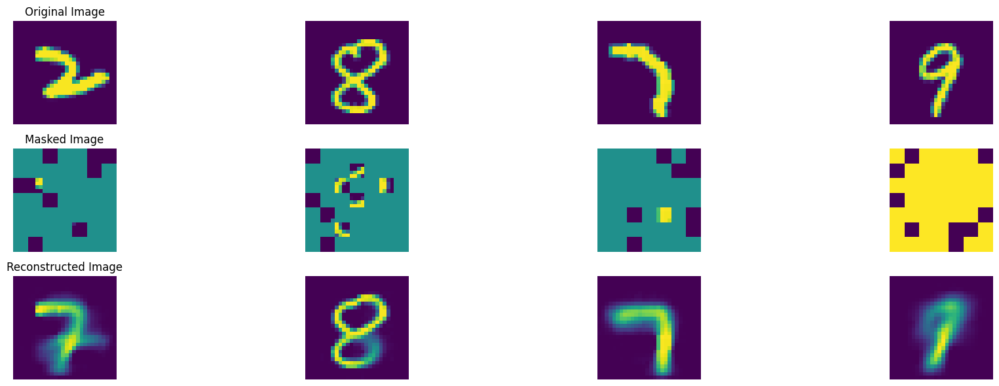

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 673, average traning loss is 0.0940068432308258.
=================== EPOCH:  674  ===================


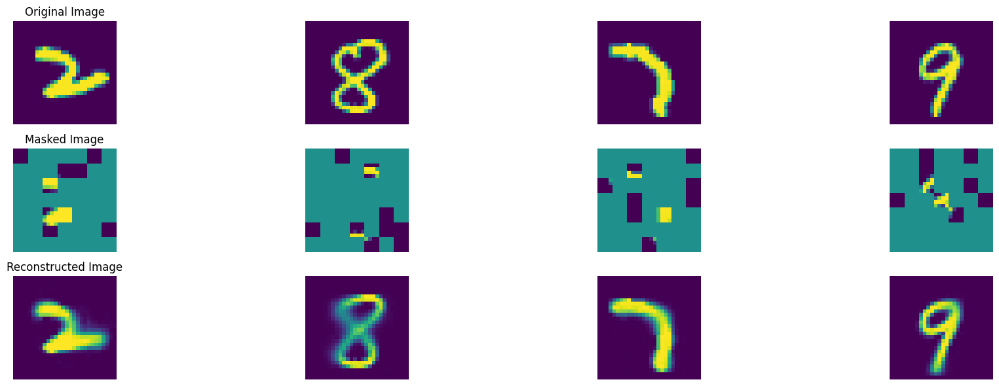

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 674, average traning loss is 0.09370626525041904.
=================== EPOCH:  675  ===================


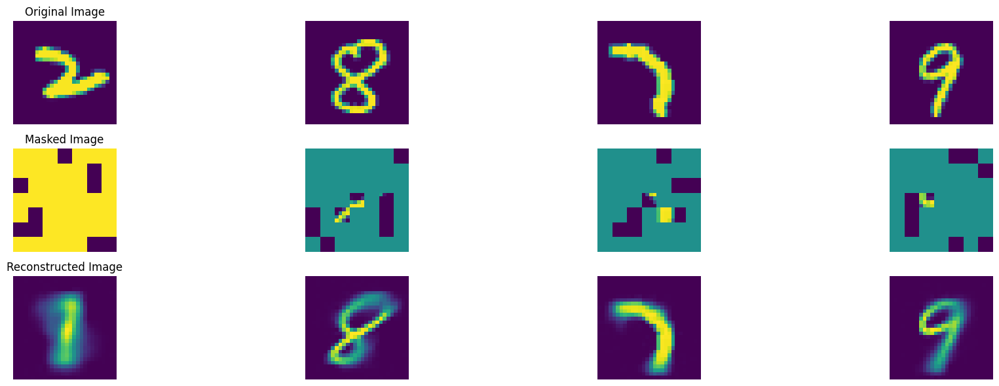

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 675, average traning loss is 0.09405483178635861.
=================== EPOCH:  676  ===================


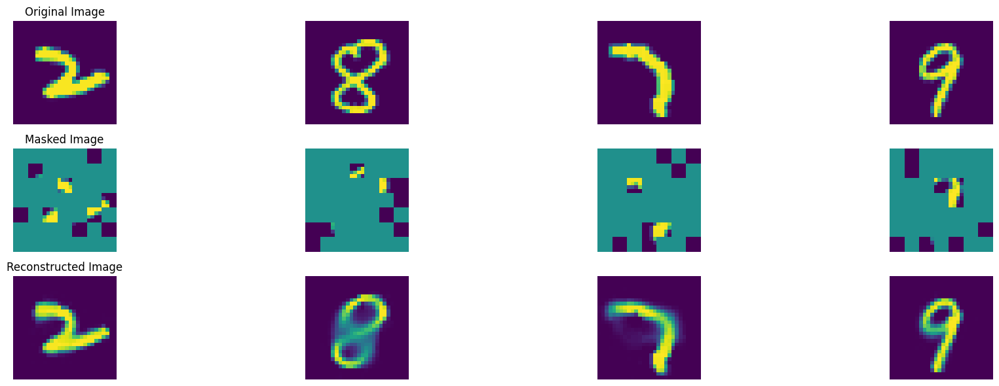

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 676, average traning loss is 0.0943882500237607.
=================== EPOCH:  677  ===================


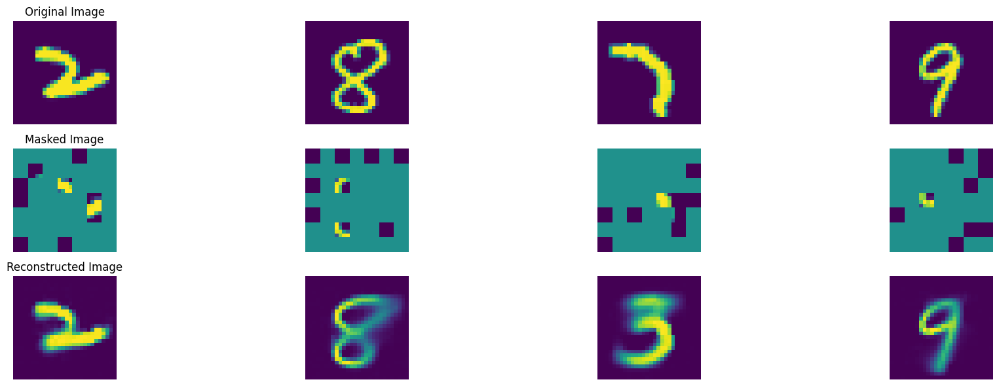

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 677, average traning loss is 0.09430013200704088.
=================== EPOCH:  678  ===================


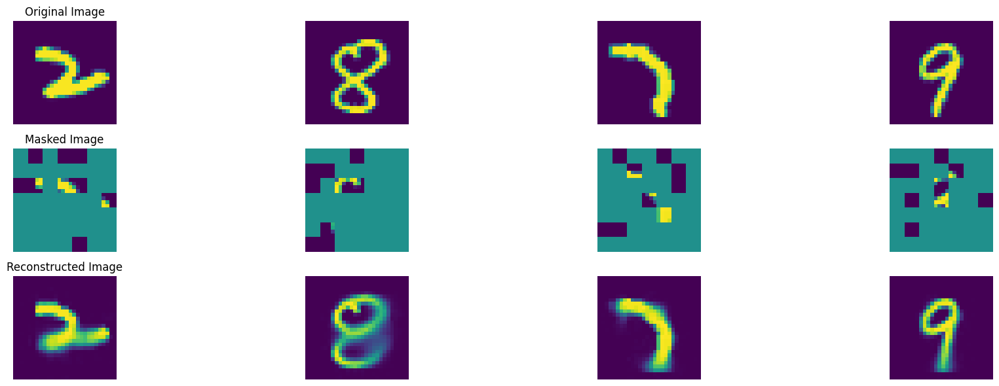

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 678, average traning loss is 0.0944465180026724.
=================== EPOCH:  679  ===================


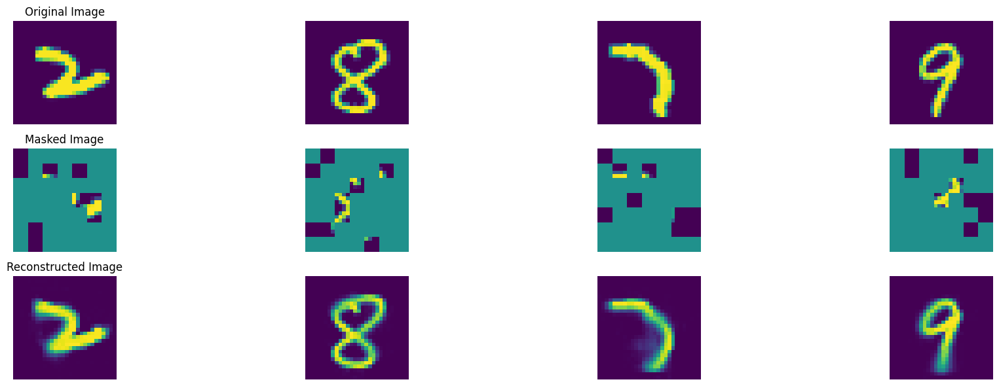

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 679, average traning loss is 0.0942227453627485.
=================== EPOCH:  680  ===================


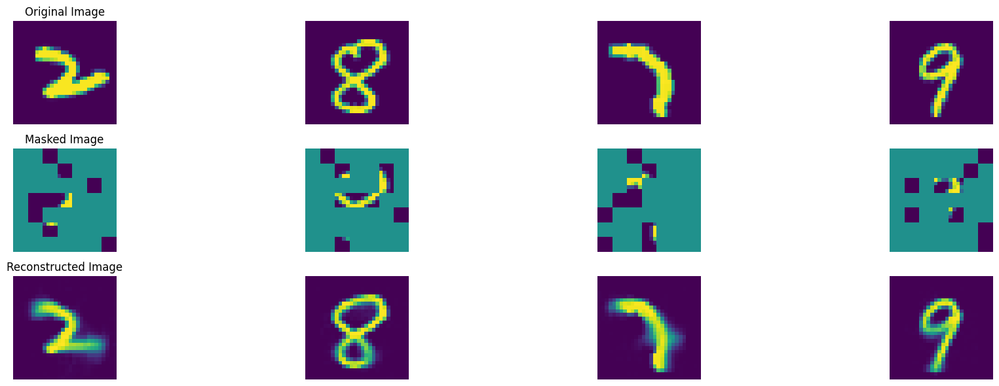

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 680, average traning loss is 0.09429706411158785.
=================== EPOCH:  681  ===================


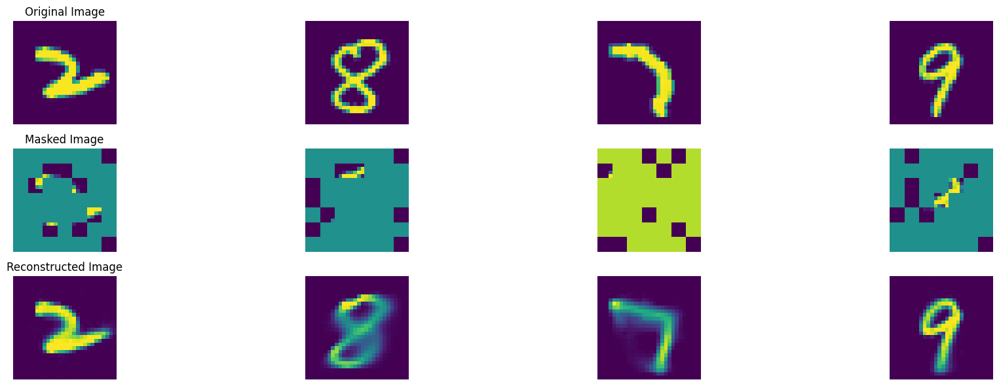

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 681, average traning loss is 0.09450408467587004.
=================== EPOCH:  682  ===================


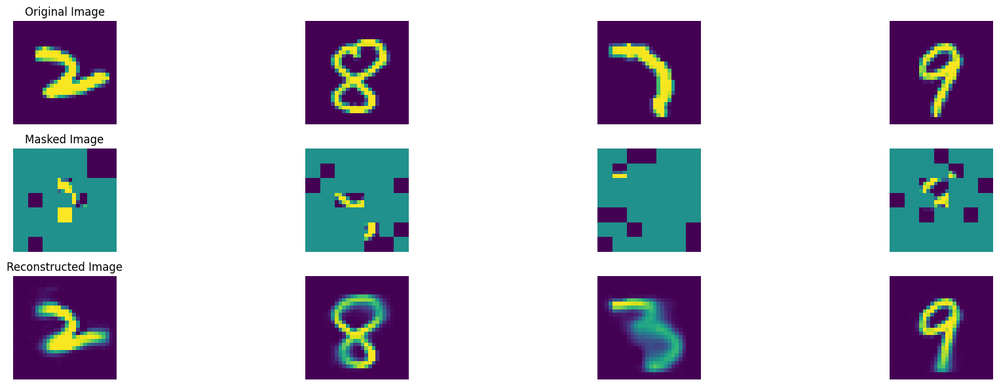

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 682, average traning loss is 0.09431288438908597.
=================== EPOCH:  683  ===================


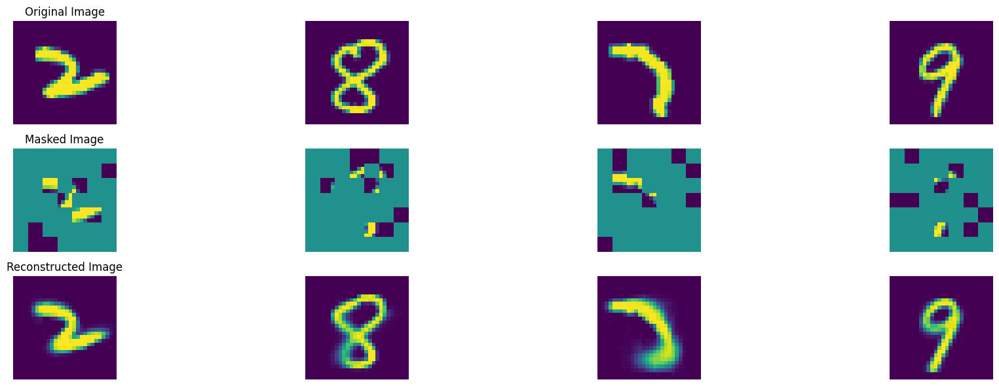

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 683, average traning loss is 0.09446477065695093.
=================== EPOCH:  684  ===================


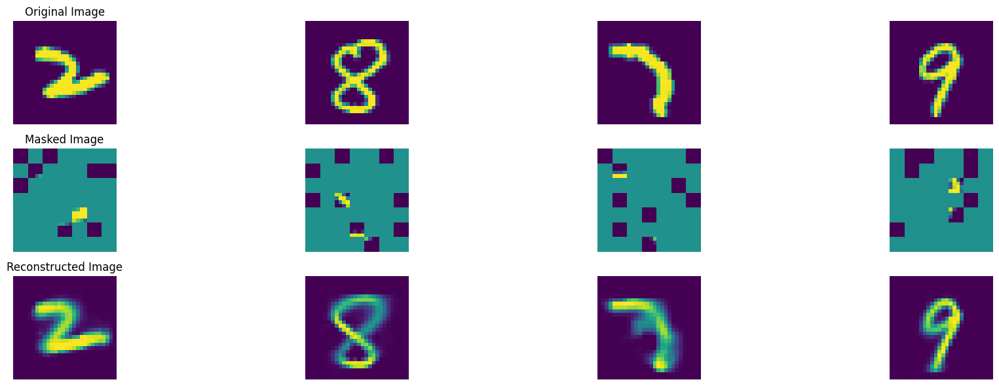

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 684, average traning loss is 0.09333597424816578.
=================== EPOCH:  685  ===================


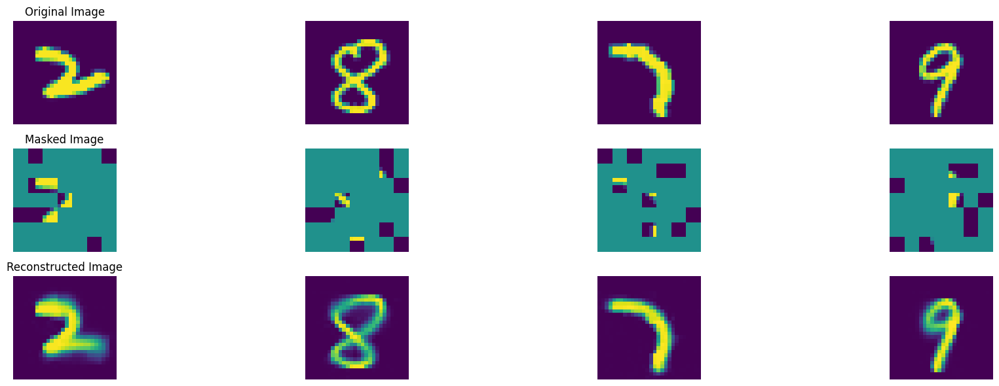

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 685, average traning loss is 0.09389564363246268.
=================== EPOCH:  686  ===================


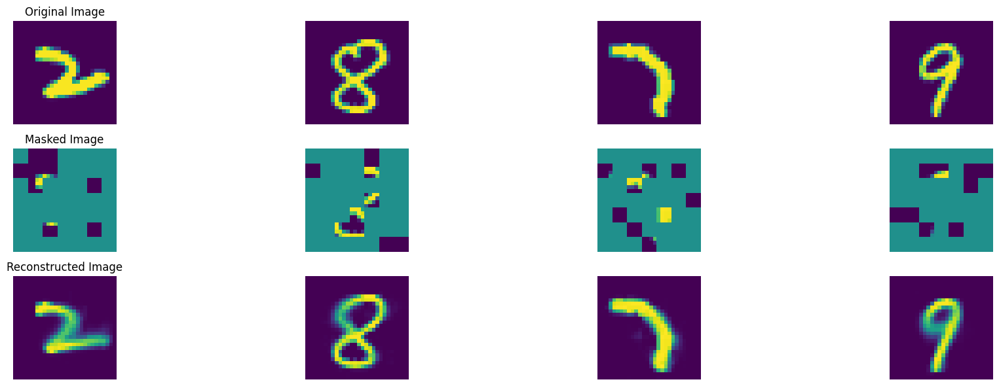

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 686, average traning loss is 0.09426381423118267.
=================== EPOCH:  687  ===================


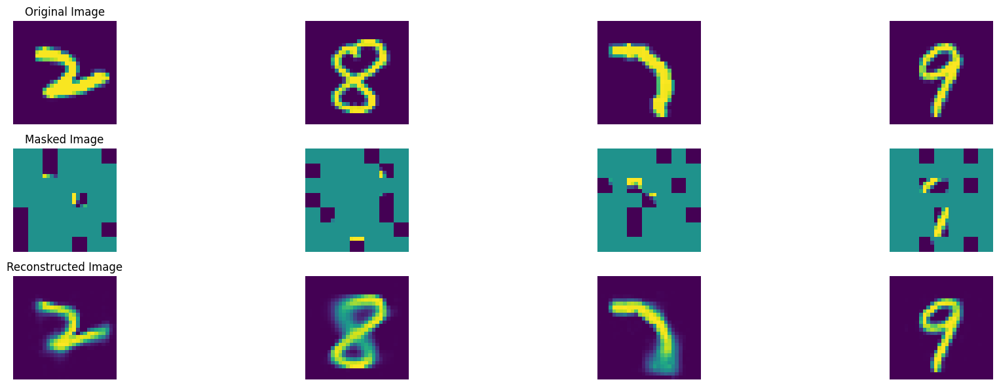

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 687, average traning loss is 0.09394451690481063.
=================== EPOCH:  688  ===================


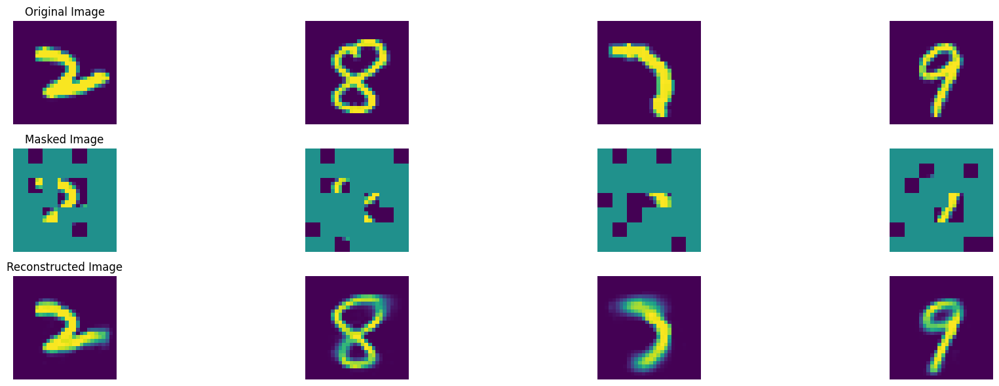

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 688, average traning loss is 0.09425923212411556.
=================== EPOCH:  689  ===================


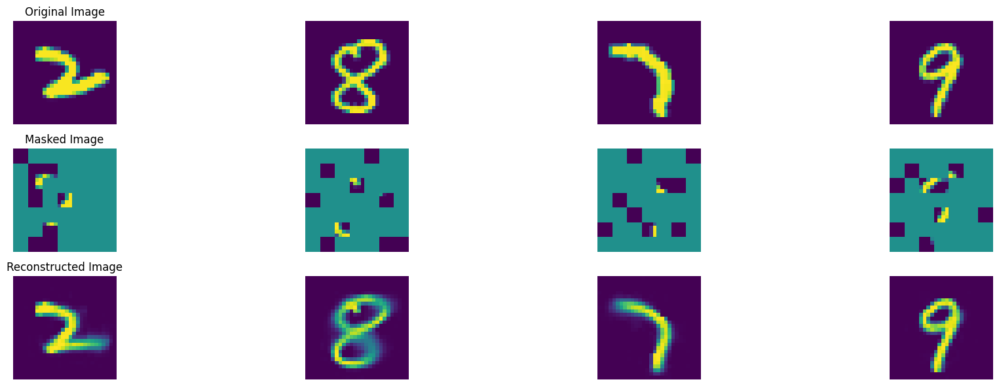

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 689, average traning loss is 0.0936495674417374.
=================== EPOCH:  690  ===================


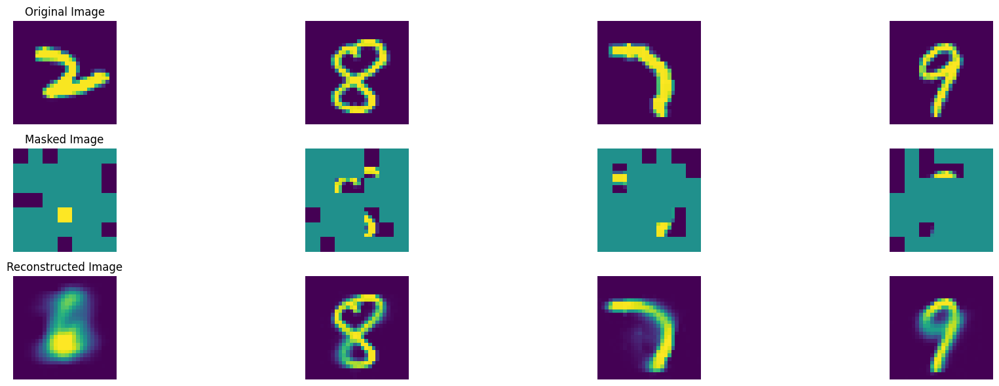

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 690, average traning loss is 0.09373344465139065.
=================== EPOCH:  691  ===================


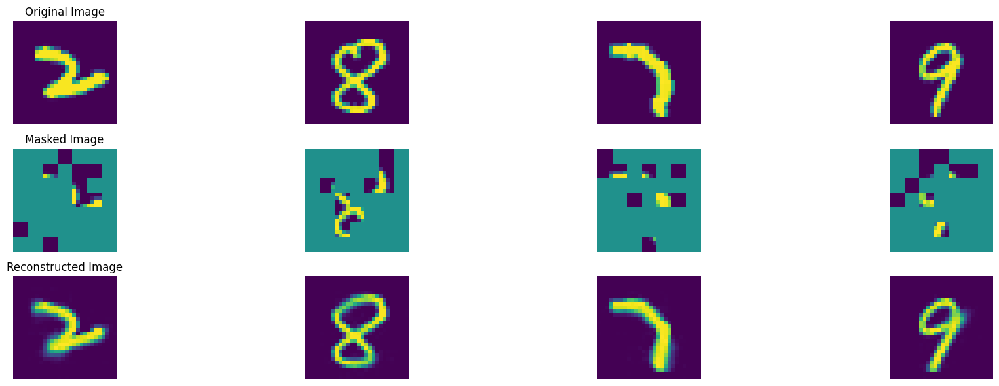

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 691, average traning loss is 0.09298947707135627.
=================== EPOCH:  692  ===================


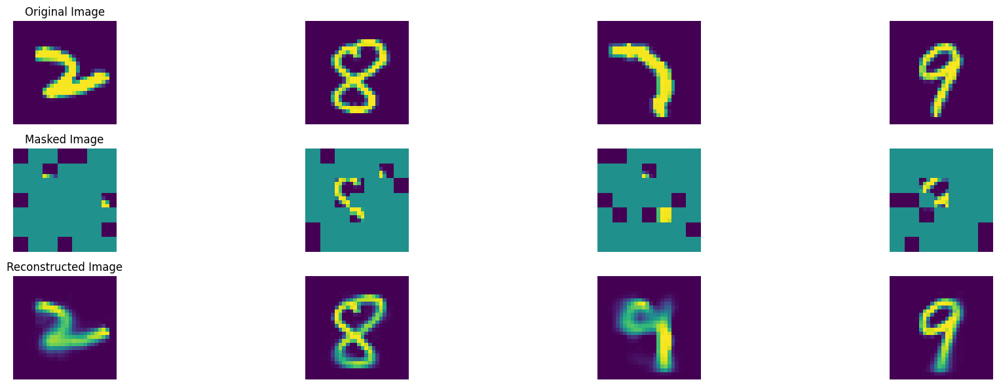

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 692, average traning loss is 0.09373930746570547.
=================== EPOCH:  693  ===================


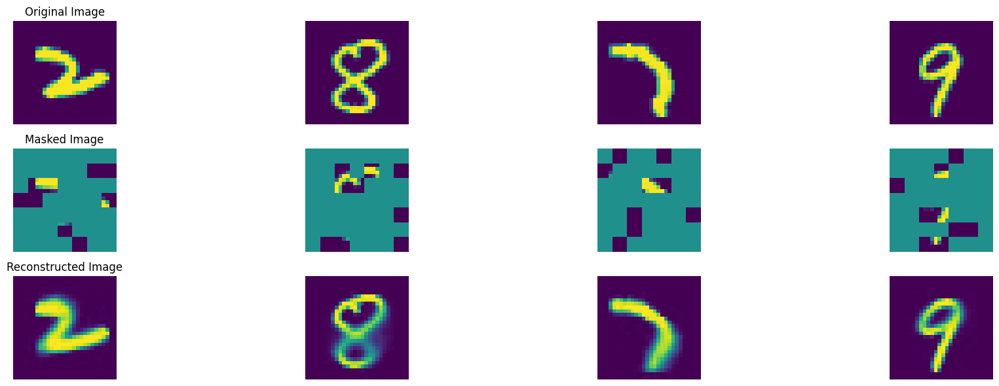

100%|██████████| 47/47 [00:08<00:00,  5.31it/s]


In epoch 693, average traning loss is 0.09373871062664275.
=================== EPOCH:  694  ===================


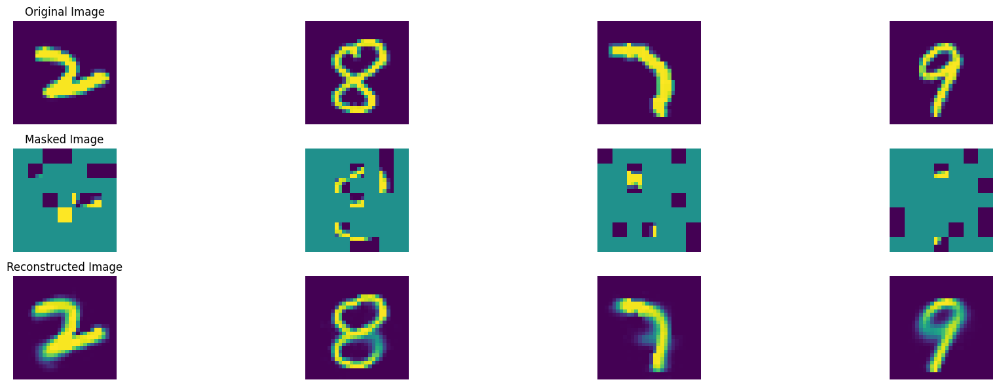

100%|██████████| 47/47 [00:08<00:00,  5.29it/s]


In epoch 694, average traning loss is 0.09320881724991698.
=================== EPOCH:  695  ===================


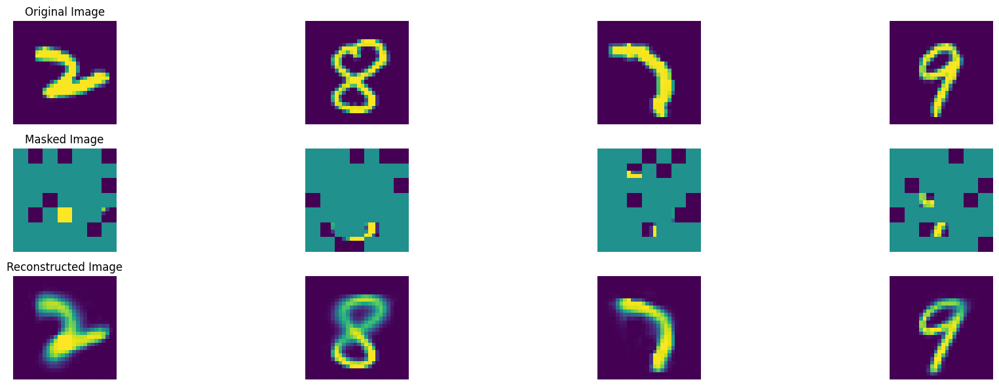

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 695, average traning loss is 0.09368709871109496.
=================== EPOCH:  696  ===================


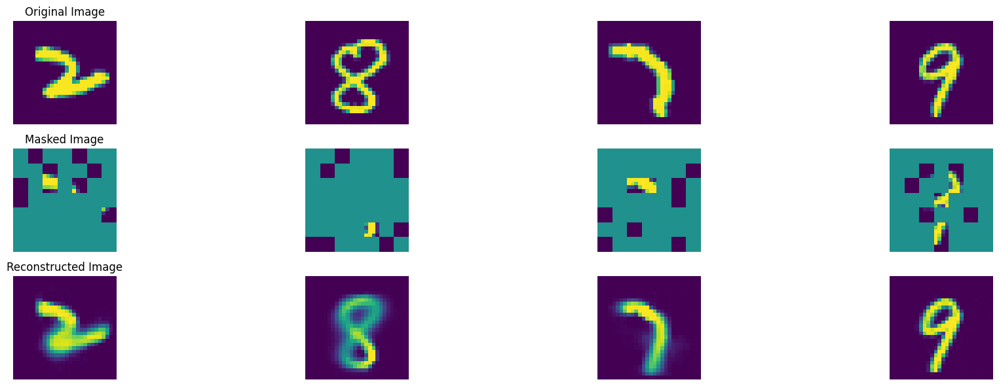

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 696, average traning loss is 0.09303366424555475.
=================== EPOCH:  697  ===================


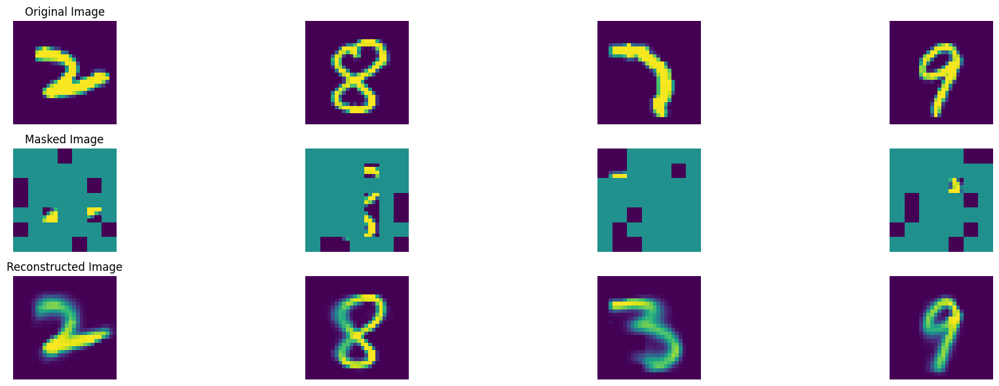

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 697, average traning loss is 0.09362637108944832.
=================== EPOCH:  698  ===================


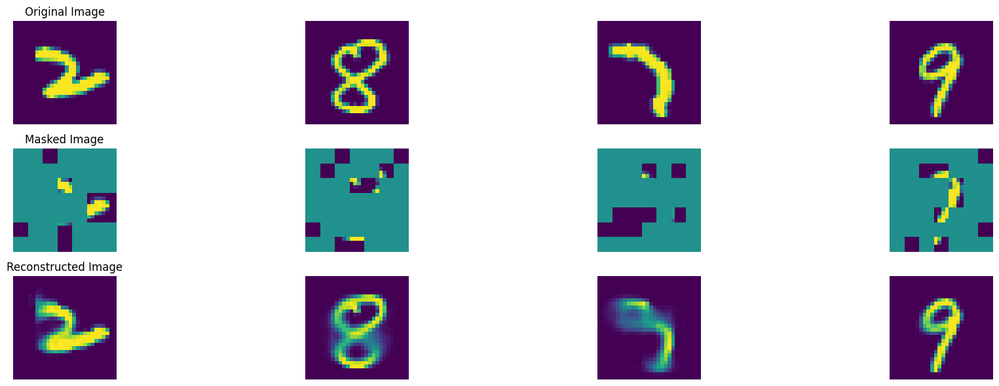

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 698, average traning loss is 0.09349844319389221.
=================== EPOCH:  699  ===================


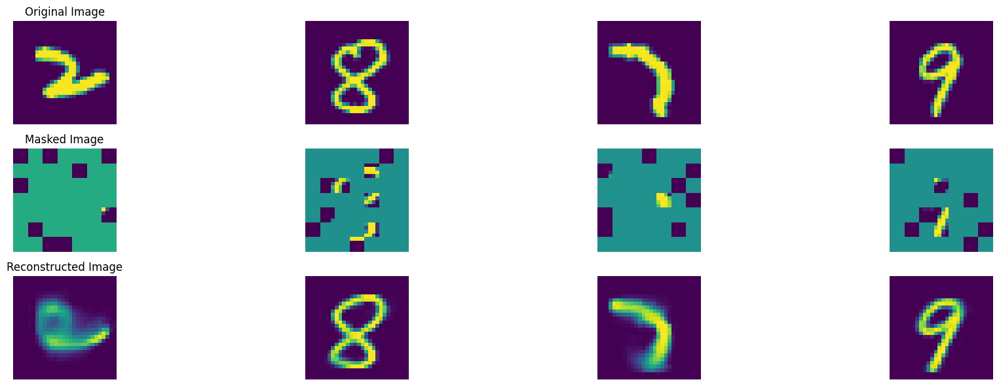

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 699, average traning loss is 0.0933951366137951.
=================== EPOCH:  700  ===================


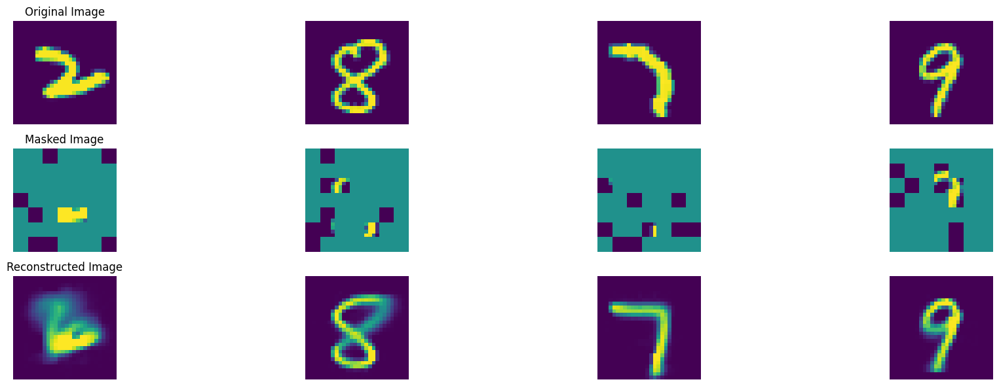

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 700, average traning loss is 0.09353647999306942.
=================== EPOCH:  701  ===================


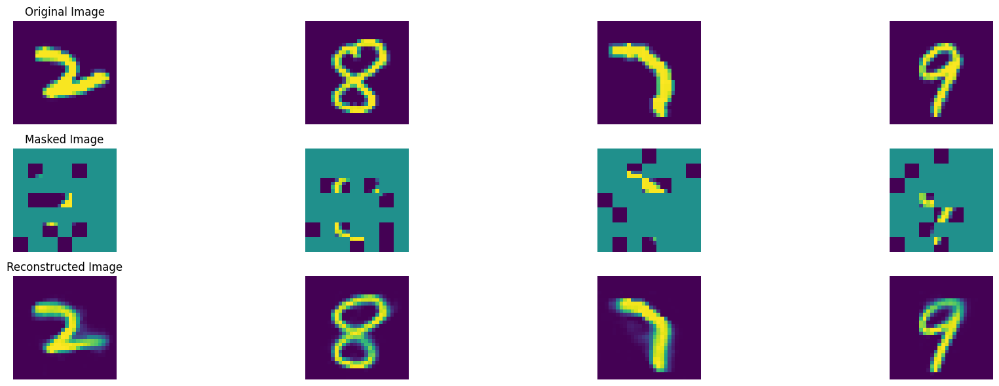

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 701, average traning loss is 0.0935920442038394.
=================== EPOCH:  702  ===================


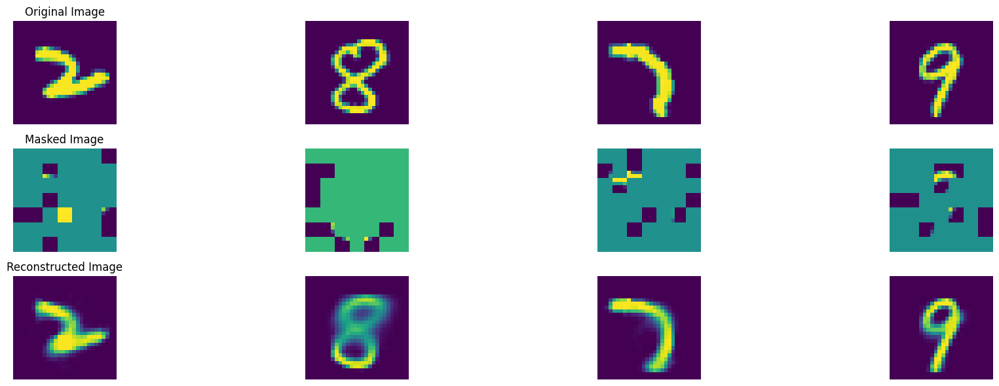

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 702, average traning loss is 0.09310967189834472.
=================== EPOCH:  703  ===================


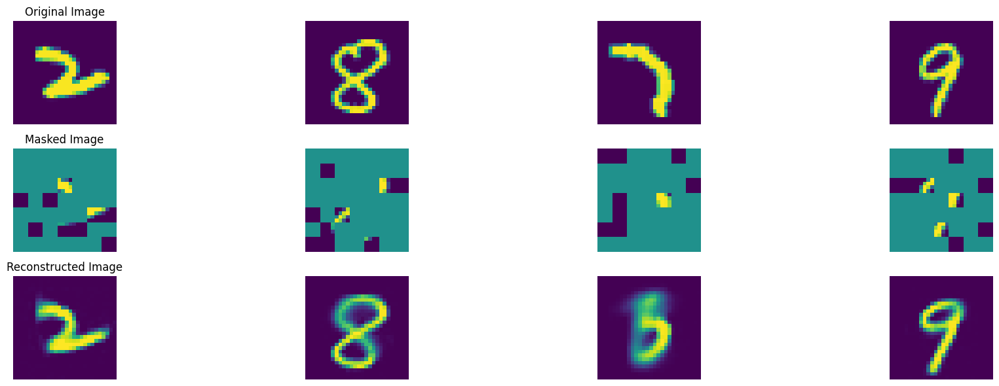

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 703, average traning loss is 0.09328413437655632.
=================== EPOCH:  704  ===================


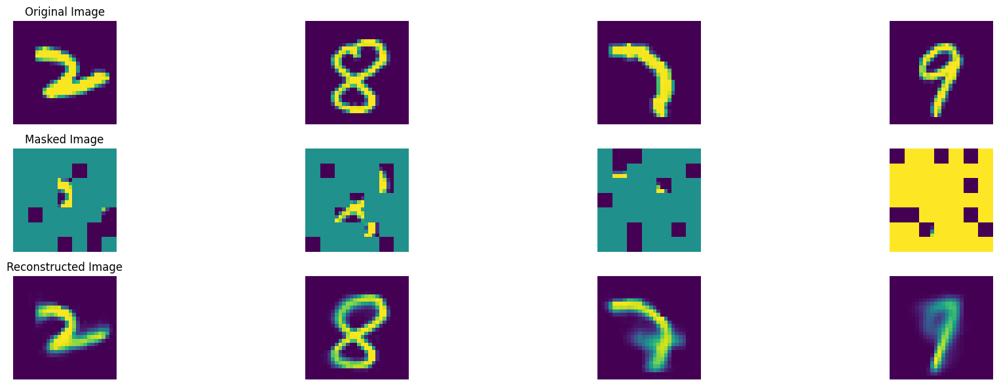

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 704, average traning loss is 0.0930183968962507.
=================== EPOCH:  705  ===================


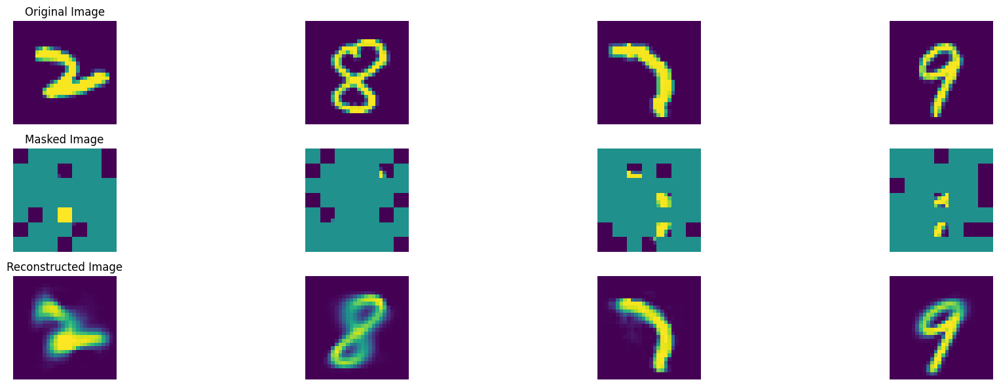

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 705, average traning loss is 0.09342306979159092.
=================== EPOCH:  706  ===================


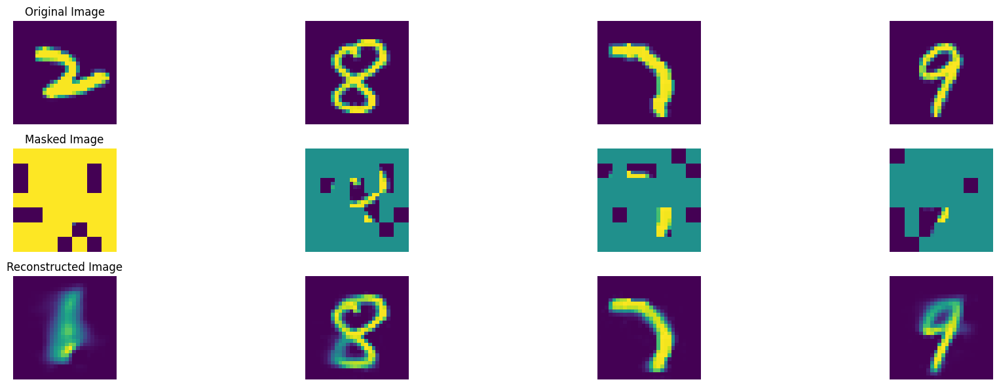

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 706, average traning loss is 0.09303721246567179.
=================== EPOCH:  707  ===================


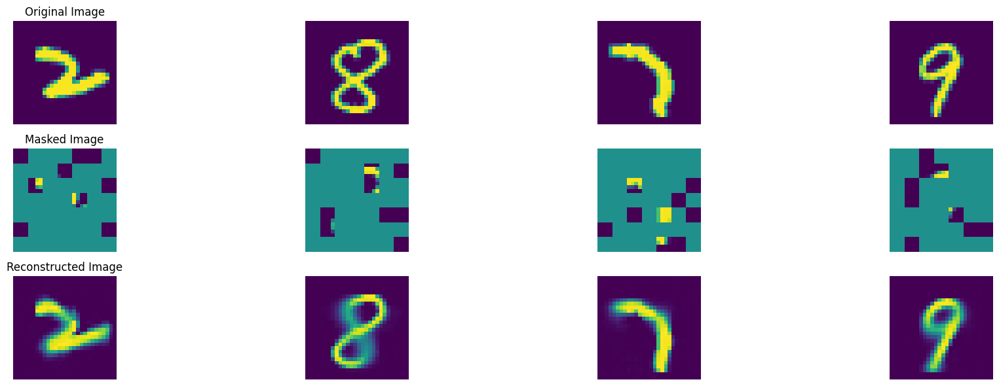

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 707, average traning loss is 0.09281949651368121.
=================== EPOCH:  708  ===================


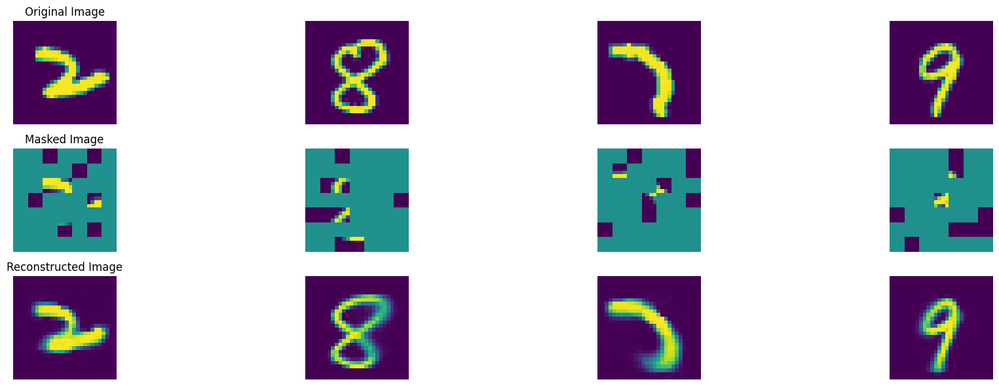

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 708, average traning loss is 0.09330114230830619.
=================== EPOCH:  709  ===================


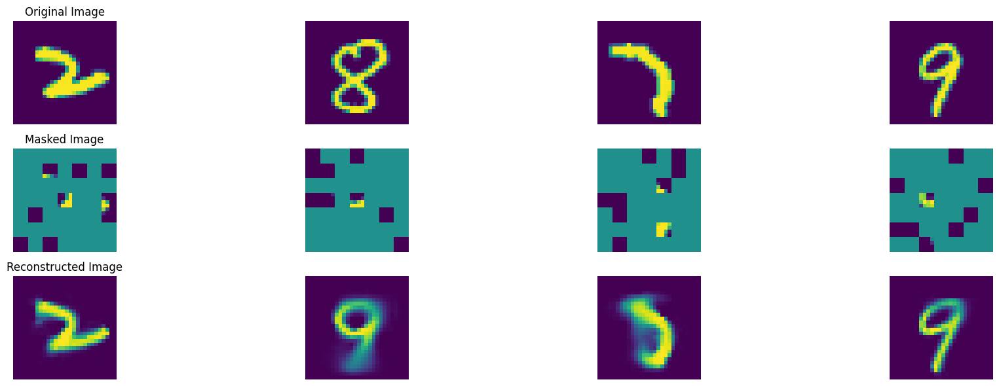

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 709, average traning loss is 0.09286869935532834.
=================== EPOCH:  710  ===================


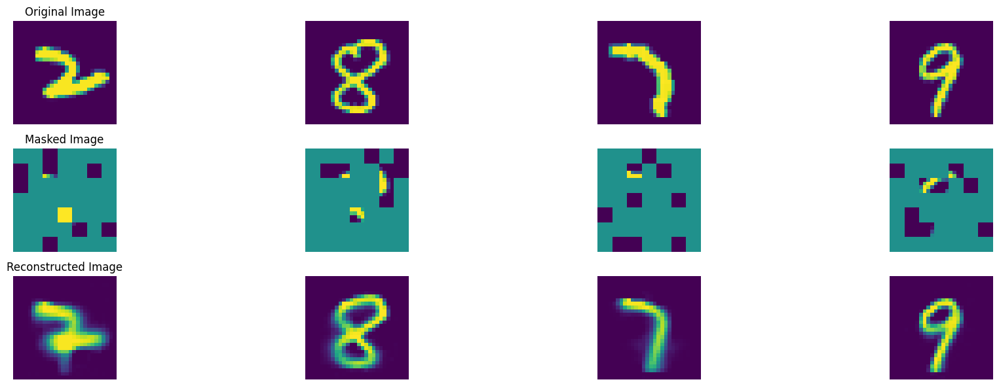

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 710, average traning loss is 0.09356535035879054.
=================== EPOCH:  711  ===================


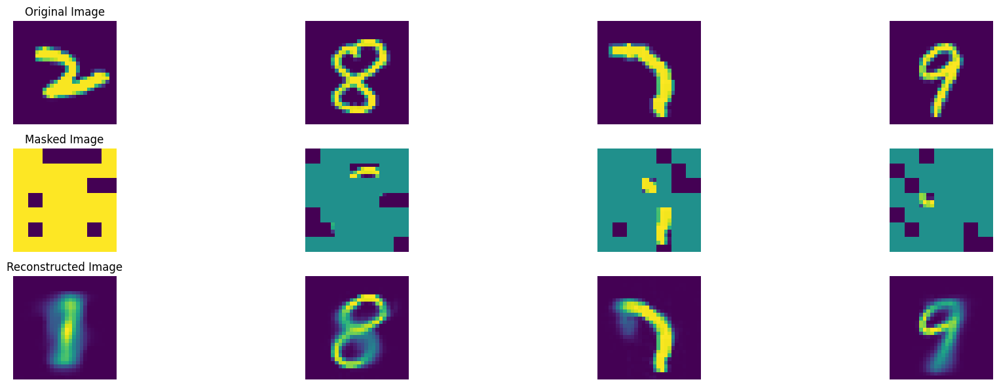

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 711, average traning loss is 0.0927577554545504.
=================== EPOCH:  712  ===================


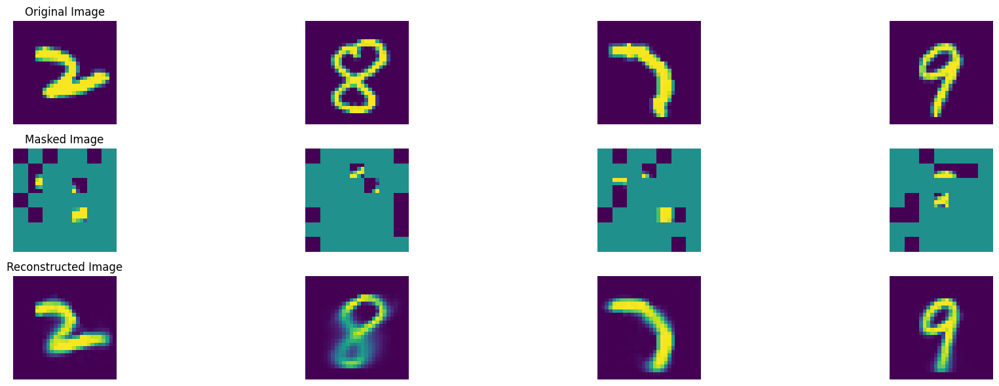

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 712, average traning loss is 0.0925766205851068.
=================== EPOCH:  713  ===================


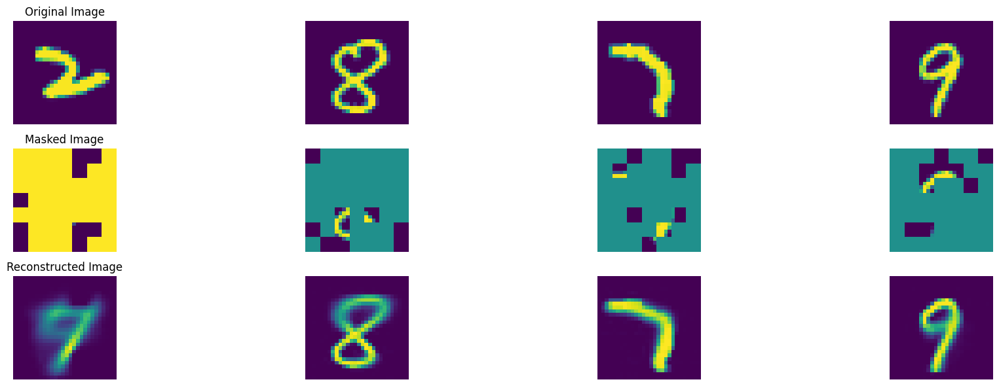

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 713, average traning loss is 0.09352647402185074.
=================== EPOCH:  714  ===================


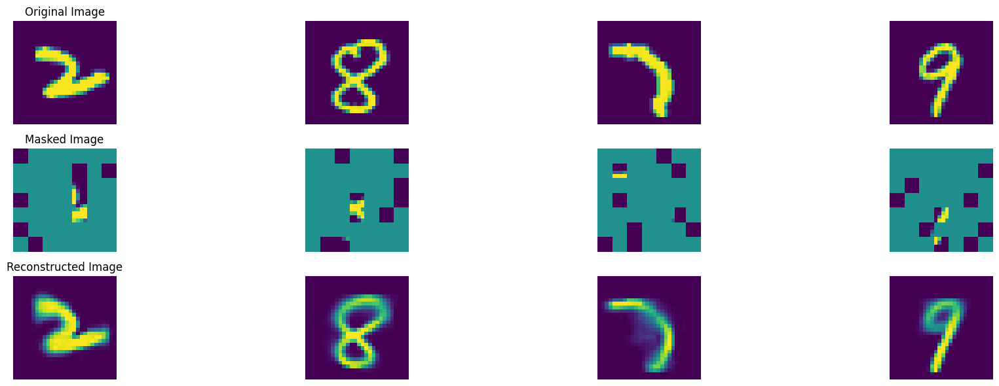

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 714, average traning loss is 0.09324310038318025.
=================== EPOCH:  715  ===================


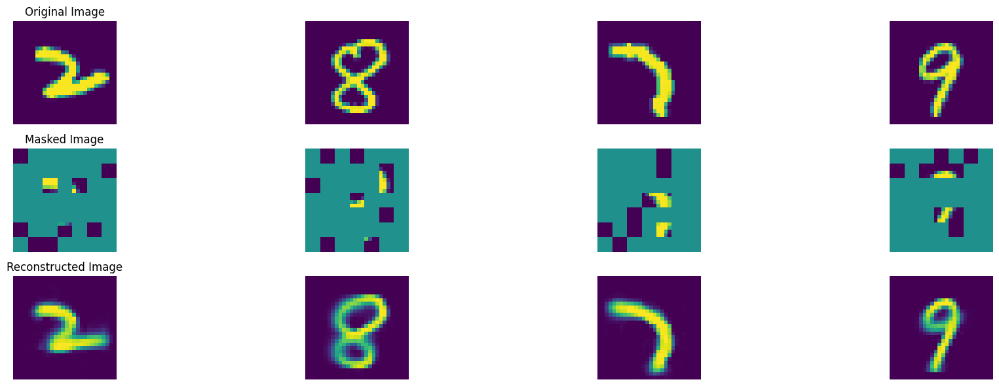

100%|██████████| 47/47 [00:08<00:00,  5.50it/s]


In epoch 715, average traning loss is 0.0923570803505309.
=================== EPOCH:  716  ===================


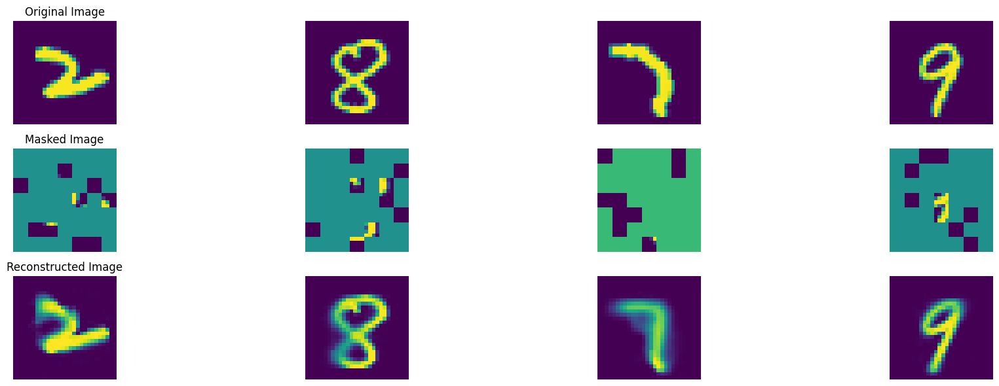

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 716, average traning loss is 0.09264090086551423.
=================== EPOCH:  717  ===================


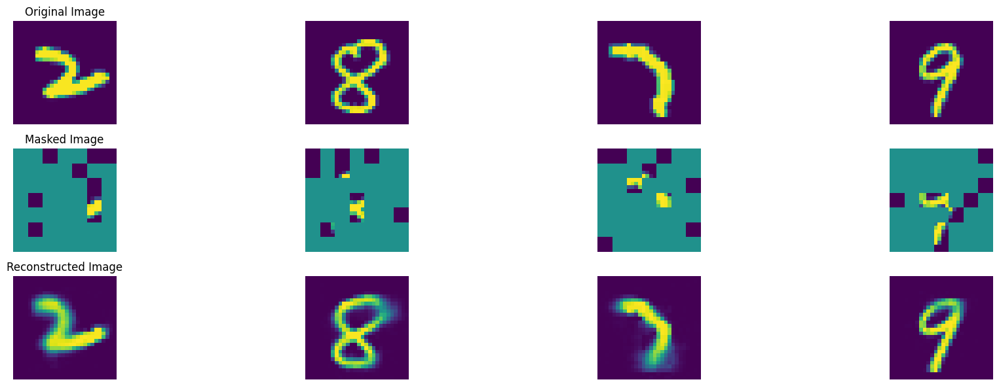

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 717, average traning loss is 0.0930168628692627.
=================== EPOCH:  718  ===================


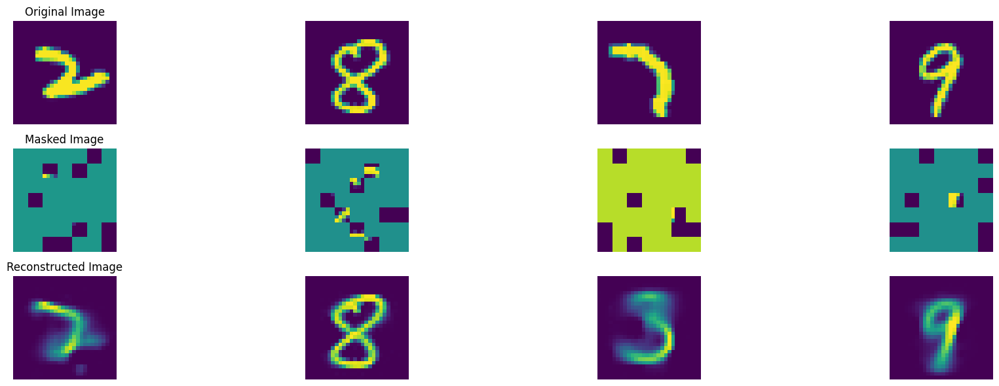

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 718, average traning loss is 0.09265457585136941.
=================== EPOCH:  719  ===================


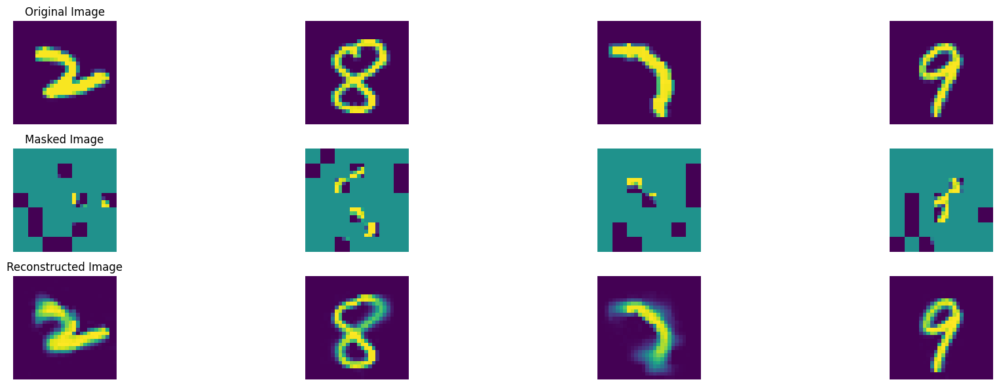

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 719, average traning loss is 0.09251149299931019.
=================== EPOCH:  720  ===================


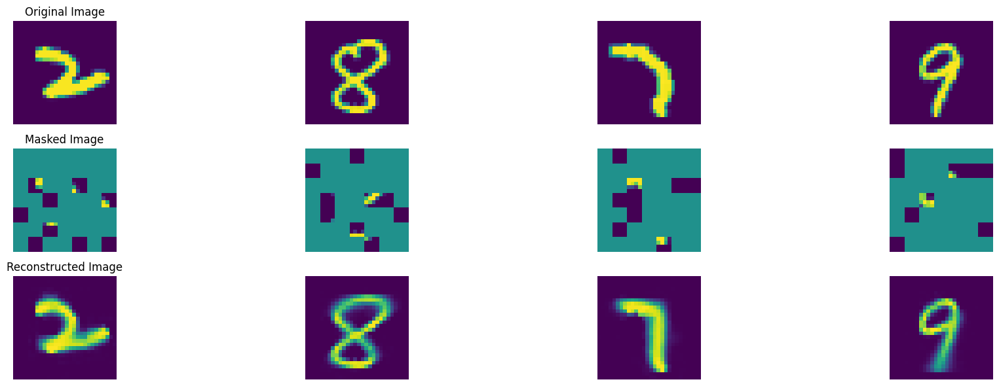

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 720, average traning loss is 0.09316782653331757.
=================== EPOCH:  721  ===================


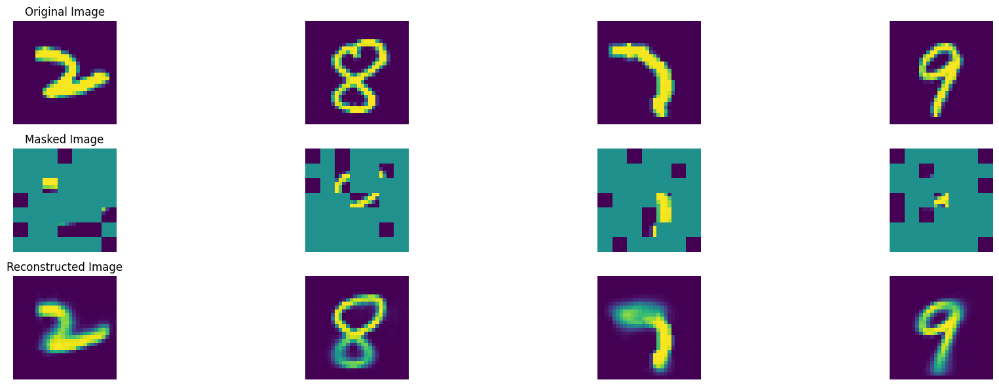

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 721, average traning loss is 0.09241420775651932.
=================== EPOCH:  722  ===================


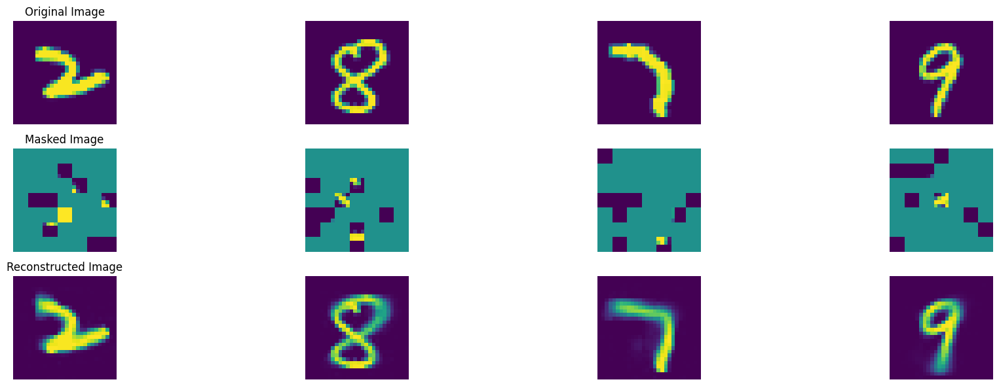

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 722, average traning loss is 0.09282492576761449.
=================== EPOCH:  723  ===================


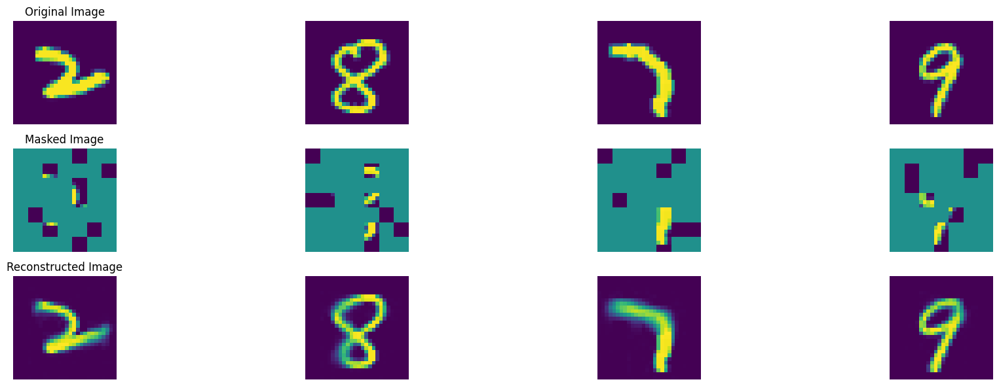

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 723, average traning loss is 0.09210738698218732.
=================== EPOCH:  724  ===================


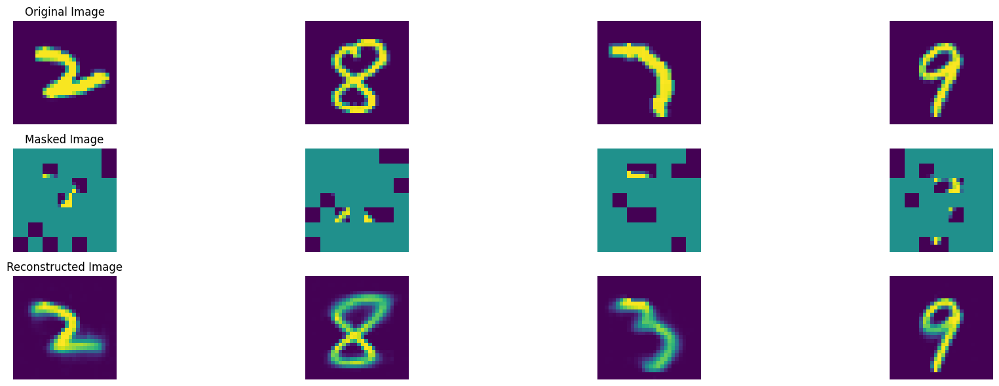

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 724, average traning loss is 0.09225893020629883.
=================== EPOCH:  725  ===================


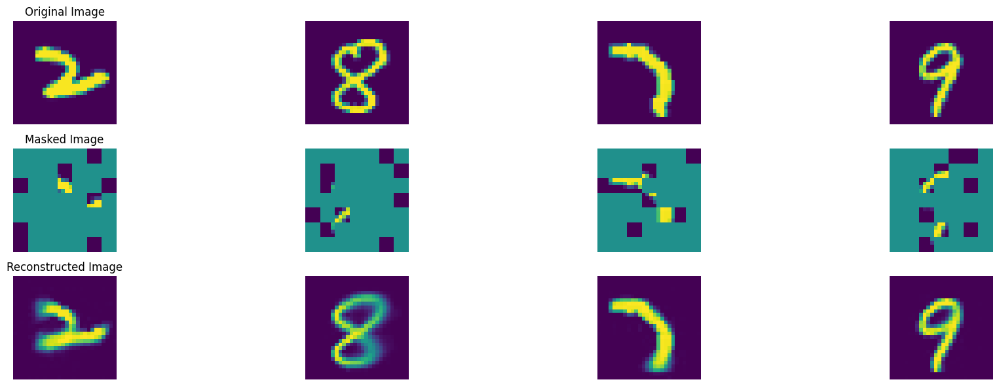

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 725, average traning loss is 0.09275931484521703.
=================== EPOCH:  726  ===================


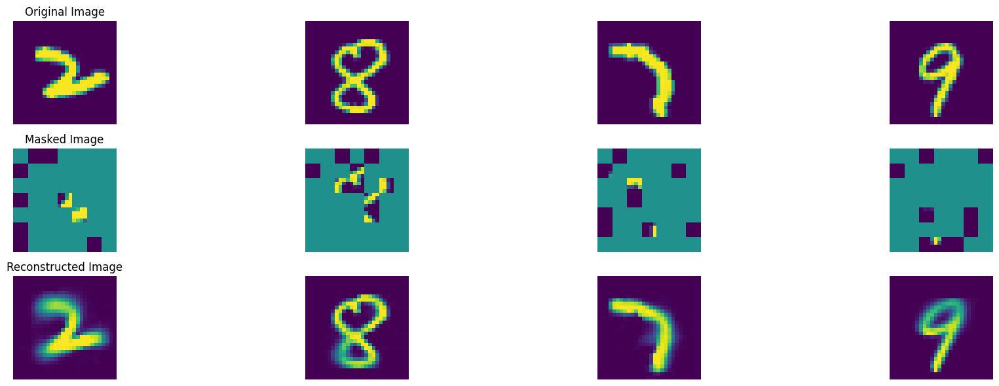

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 726, average traning loss is 0.09278836196407358.
=================== EPOCH:  727  ===================


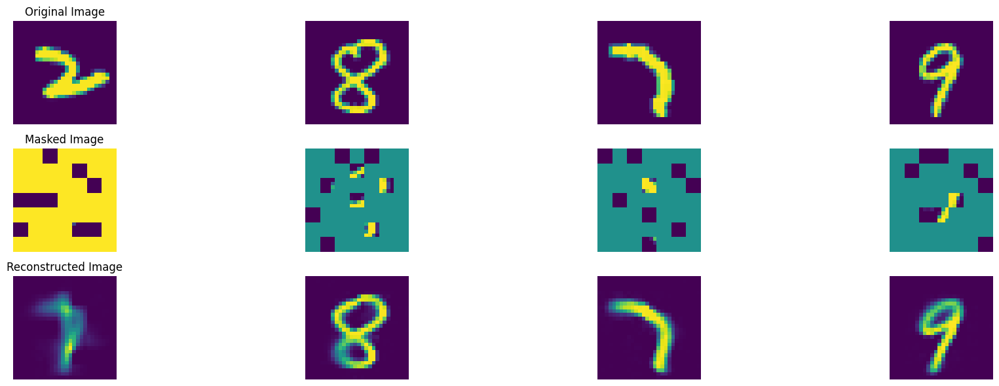

100%|██████████| 47/47 [00:08<00:00,  5.28it/s]


In epoch 727, average traning loss is 0.09241239568020435.
=================== EPOCH:  728  ===================


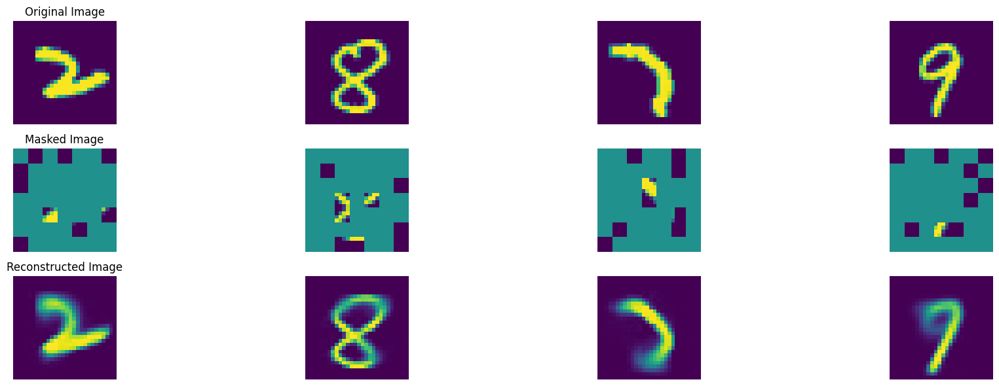

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 728, average traning loss is 0.09249928435112567.
=================== EPOCH:  729  ===================


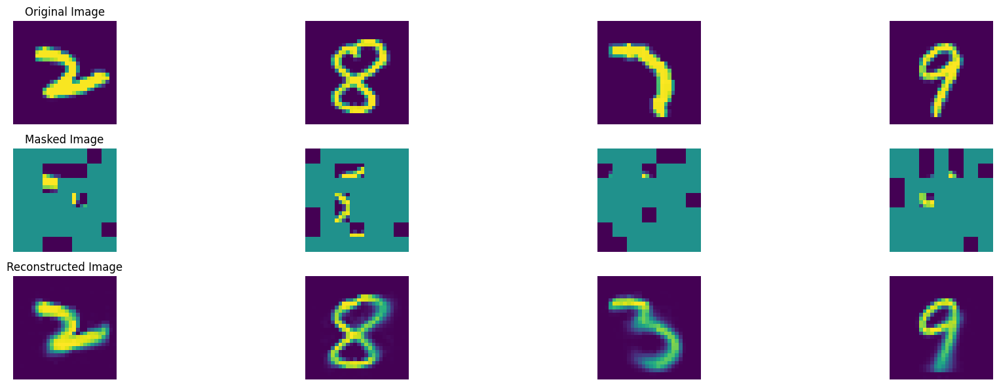

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 729, average traning loss is 0.09194154593538731.
=================== EPOCH:  730  ===================


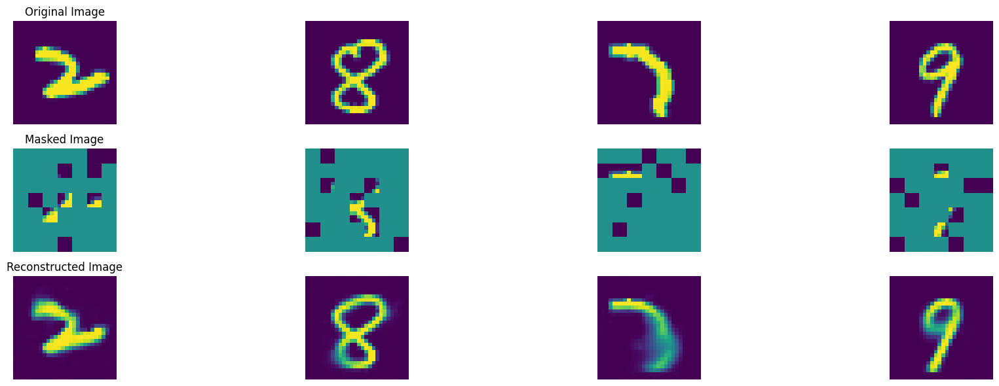

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 730, average traning loss is 0.09237615938516373.
=================== EPOCH:  731  ===================


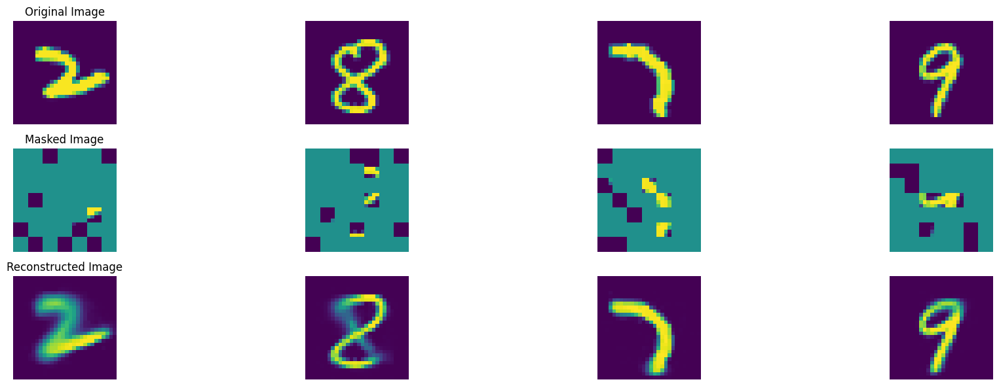

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 731, average traning loss is 0.09283742673219518.
=================== EPOCH:  732  ===================


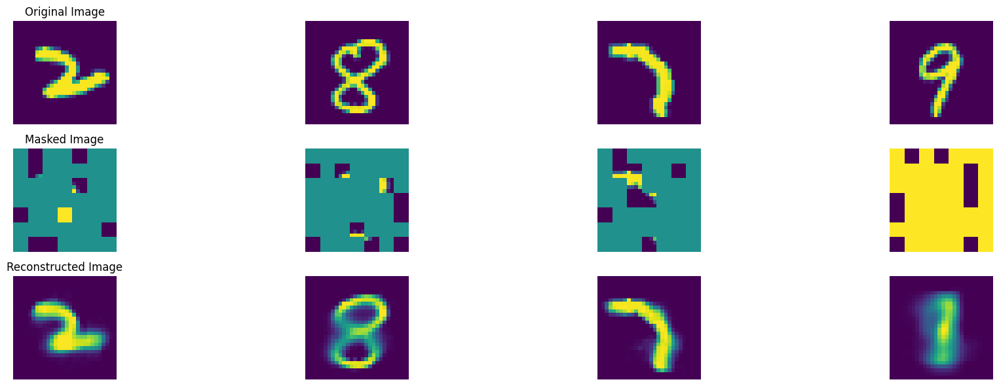

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 732, average traning loss is 0.09232121293849134.
=================== EPOCH:  733  ===================


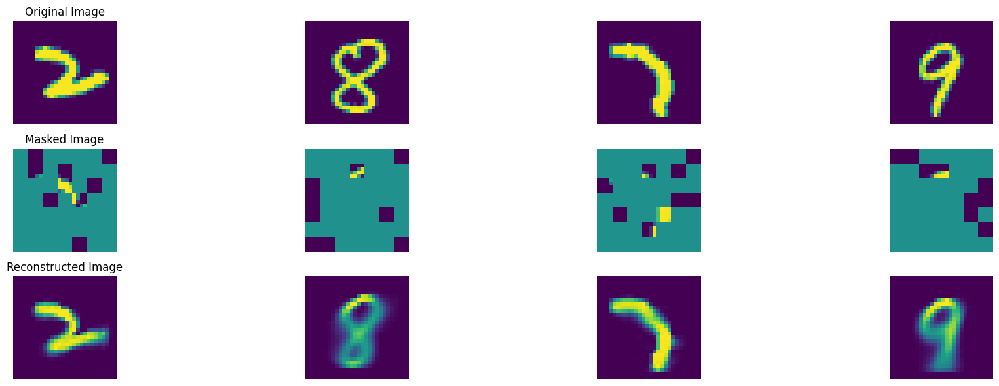

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 733, average traning loss is 0.0921145905839636.
=================== EPOCH:  734  ===================


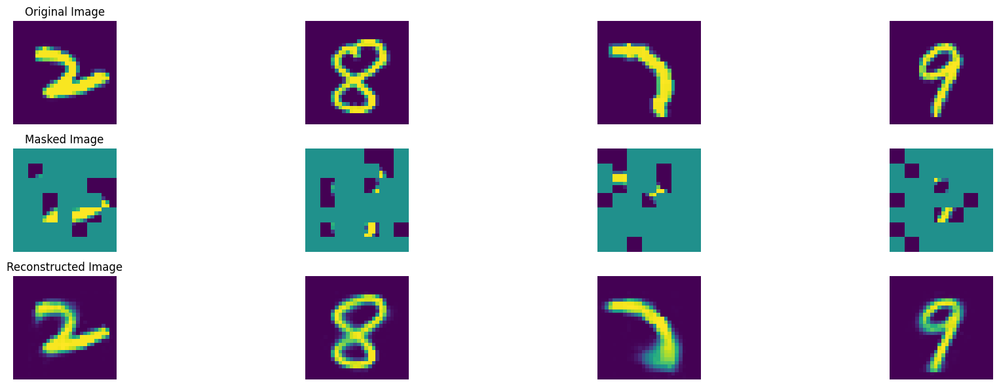

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 734, average traning loss is 0.092029204235432.
=================== EPOCH:  735  ===================


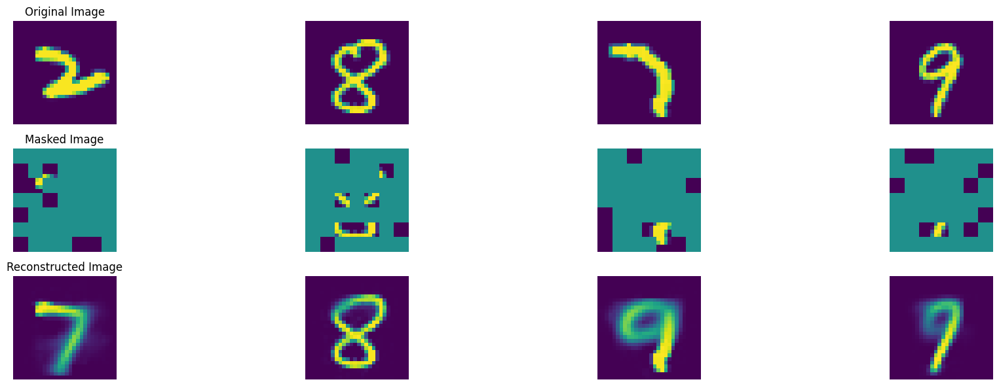

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 735, average traning loss is 0.09216044779787673.
=================== EPOCH:  736  ===================


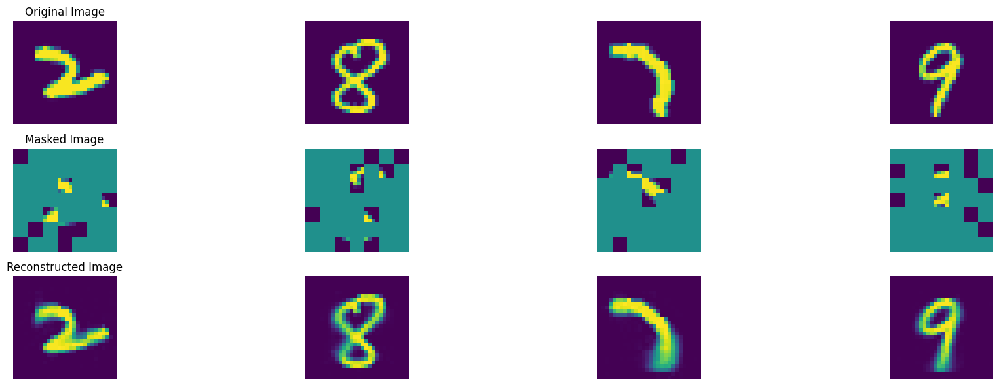

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 736, average traning loss is 0.0924597274749837.
=================== EPOCH:  737  ===================


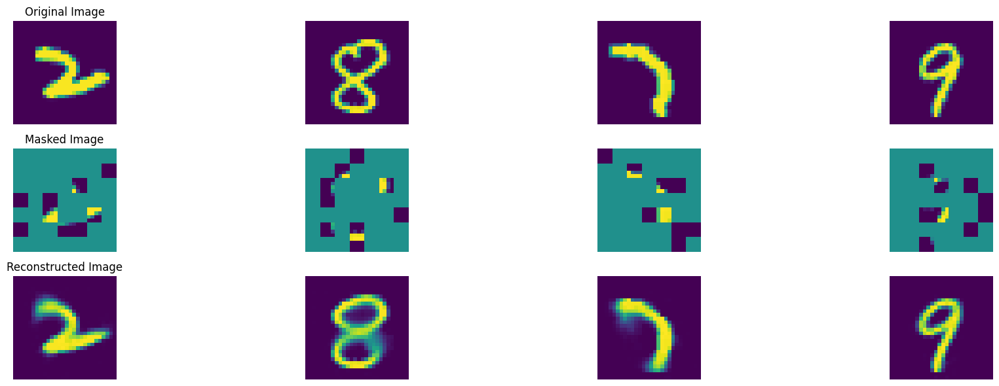

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 737, average traning loss is 0.09197876681672766.
=================== EPOCH:  738  ===================


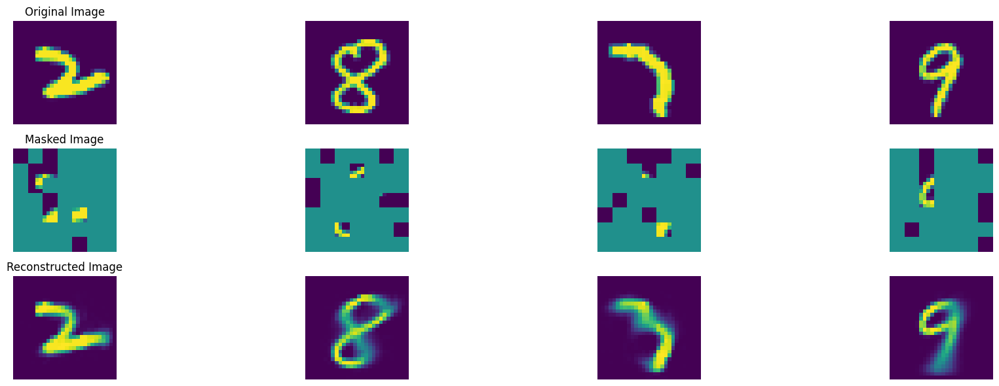

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 738, average traning loss is 0.09149685930064384.
=================== EPOCH:  739  ===================


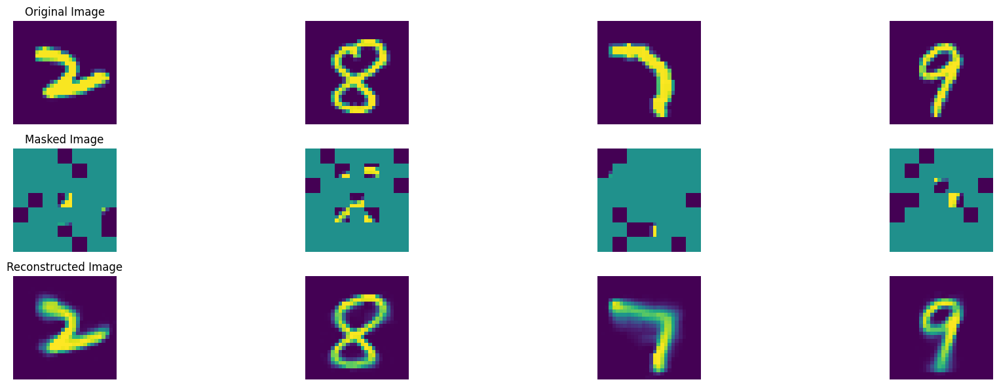

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 739, average traning loss is 0.0921995259345846.
=================== EPOCH:  740  ===================


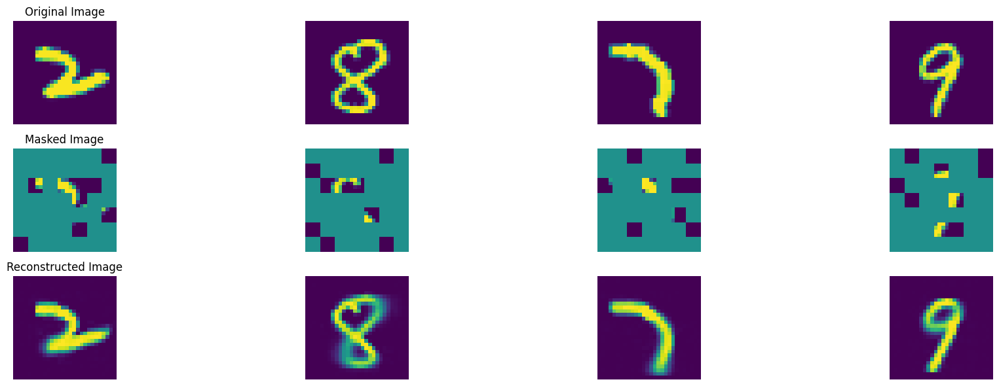

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 740, average traning loss is 0.09215392172336578.
=================== EPOCH:  741  ===================


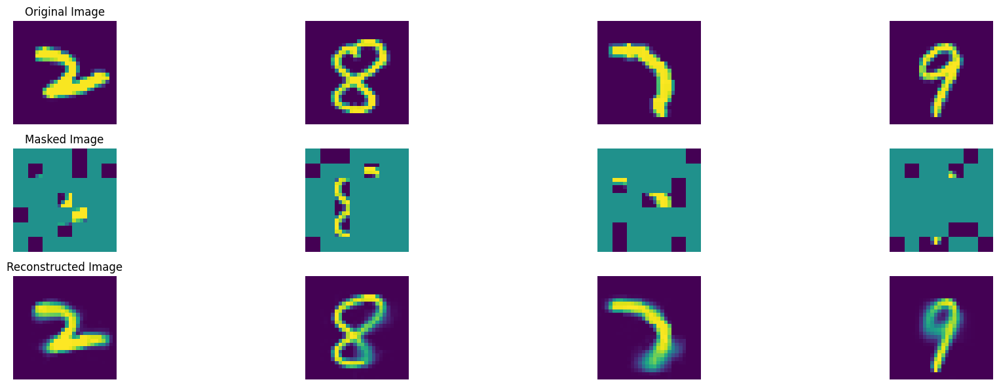

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 741, average traning loss is 0.09211577268991064.
=================== EPOCH:  742  ===================


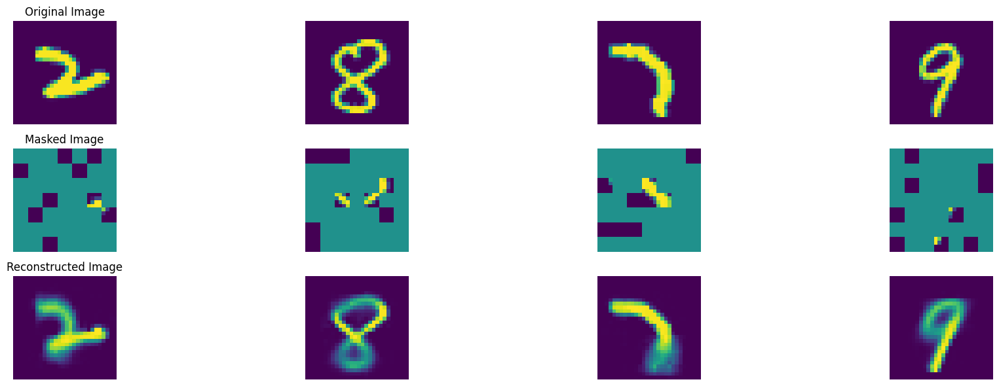

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 742, average traning loss is 0.09121876542872571.
=================== EPOCH:  743  ===================


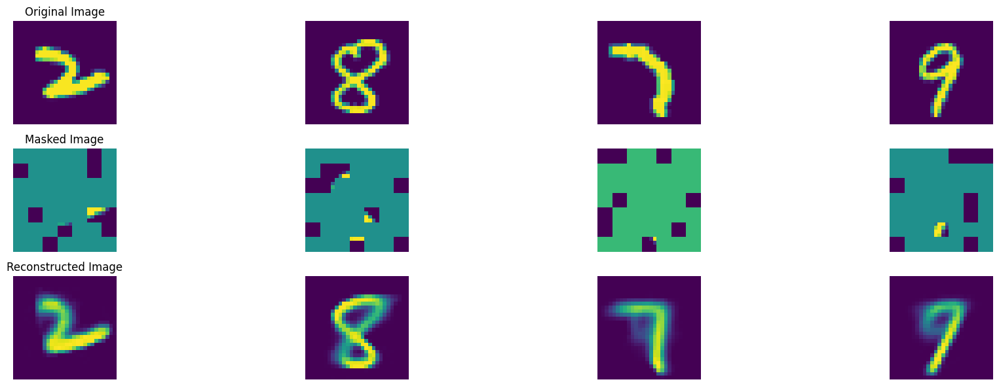

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 743, average traning loss is 0.0918382021023872.
=================== EPOCH:  744  ===================


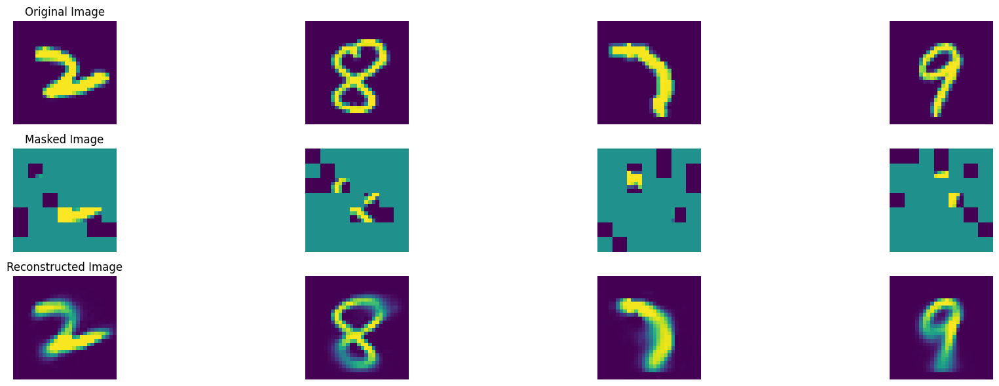

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 744, average traning loss is 0.091559388694611.
=================== EPOCH:  745  ===================


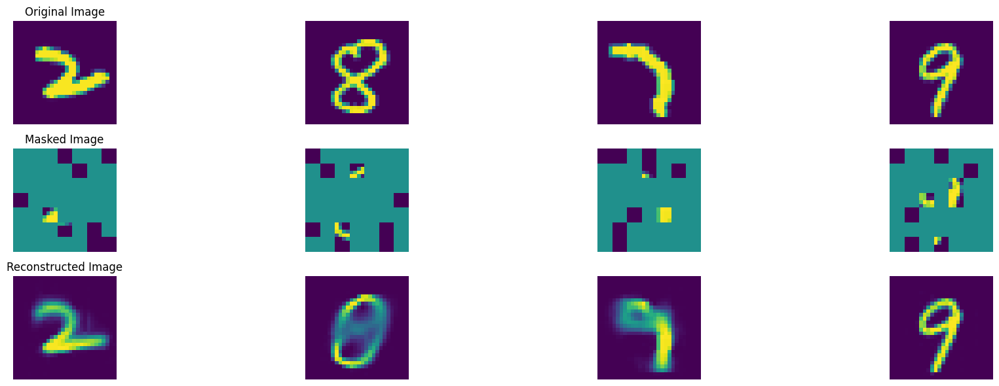

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 745, average traning loss is 0.09174798191227812.
=================== EPOCH:  746  ===================


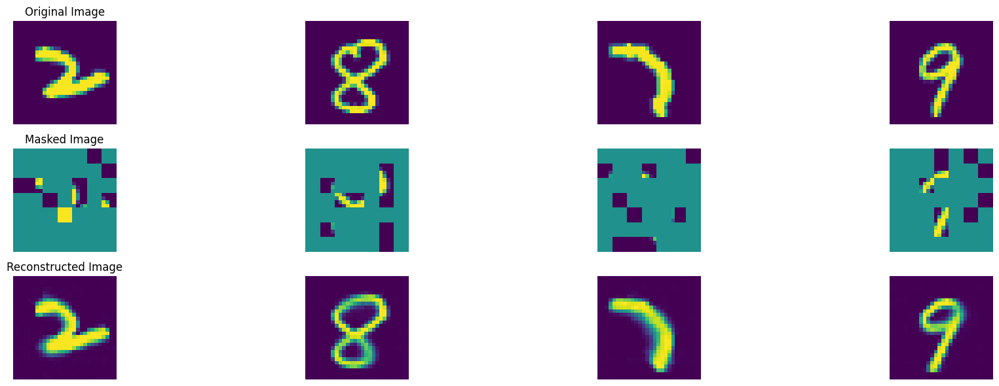

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 746, average traning loss is 0.09163326785919514.
=================== EPOCH:  747  ===================


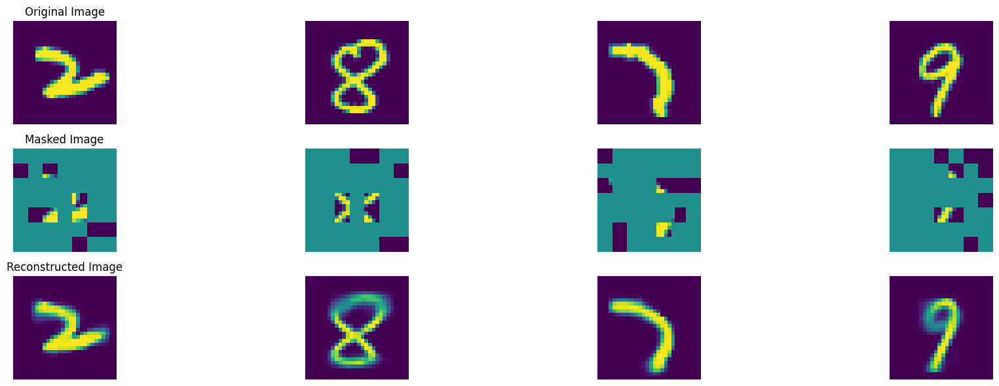

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 747, average traning loss is 0.09164853409883823.
=================== EPOCH:  748  ===================


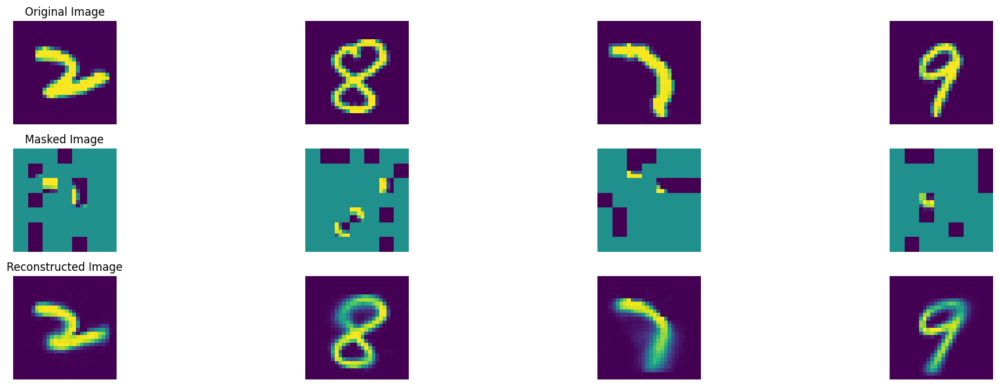

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 748, average traning loss is 0.09159858239457962.
=================== EPOCH:  749  ===================


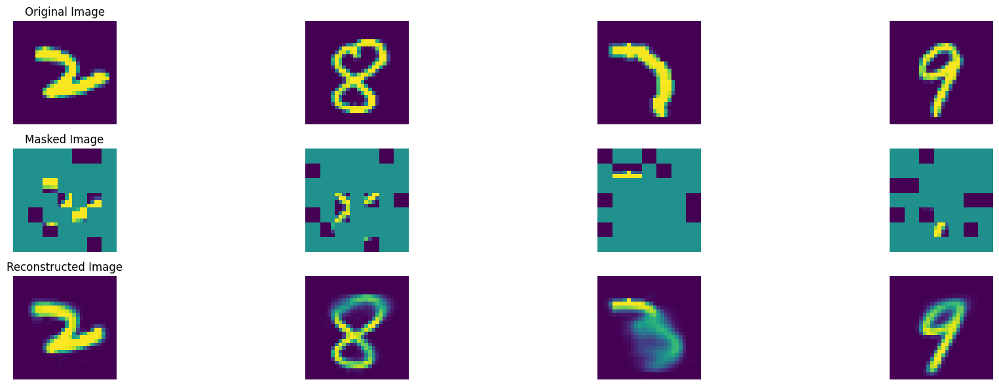

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 749, average traning loss is 0.09159549579341361.
=================== EPOCH:  750  ===================


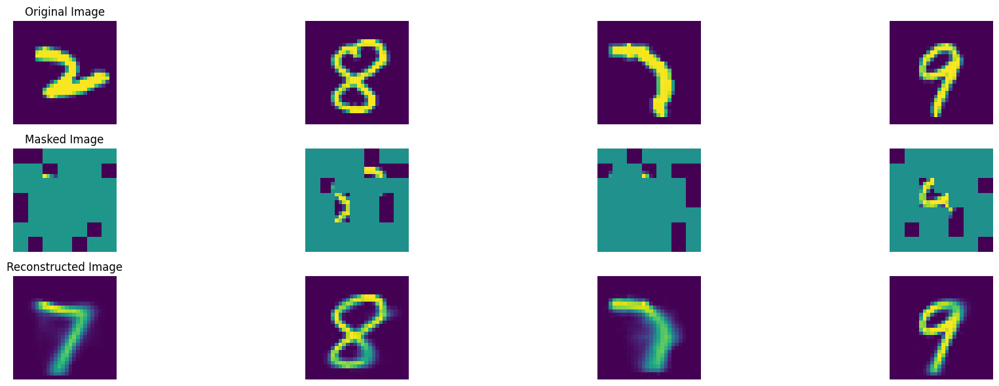

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 750, average traning loss is 0.09118610255895777.
=================== EPOCH:  751  ===================


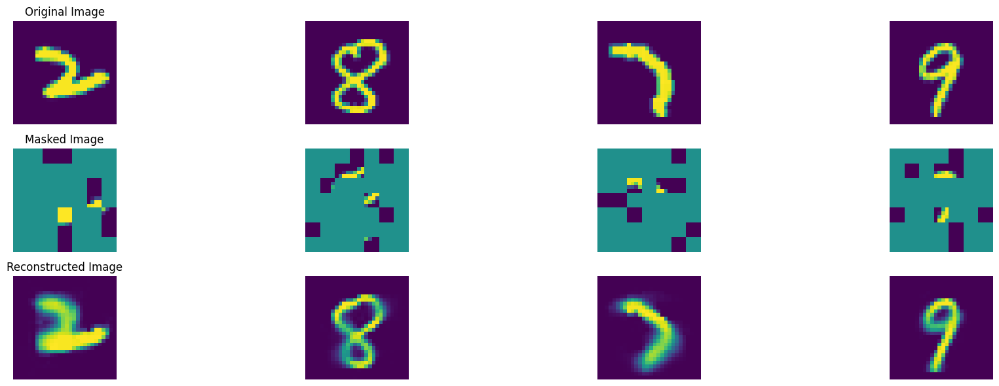

100%|██████████| 47/47 [00:08<00:00,  5.28it/s]


In epoch 751, average traning loss is 0.09152547761480859.
=================== EPOCH:  752  ===================


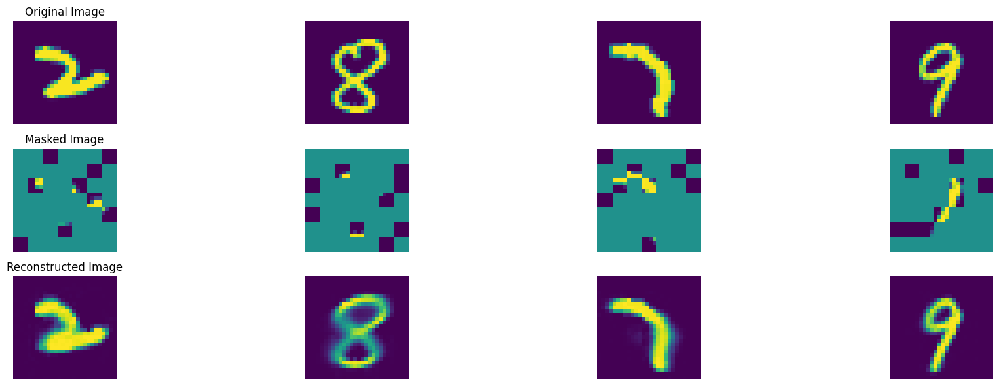

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 752, average traning loss is 0.09106771663782444.
=================== EPOCH:  753  ===================


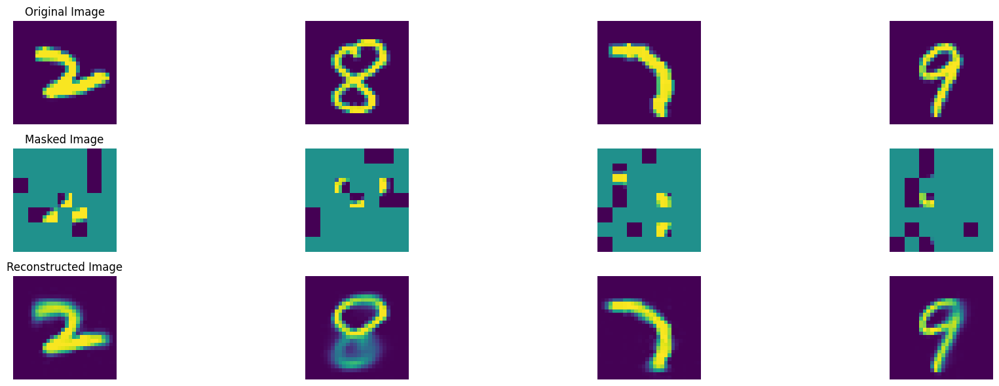

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 753, average traning loss is 0.09146146967690041.
=================== EPOCH:  754  ===================


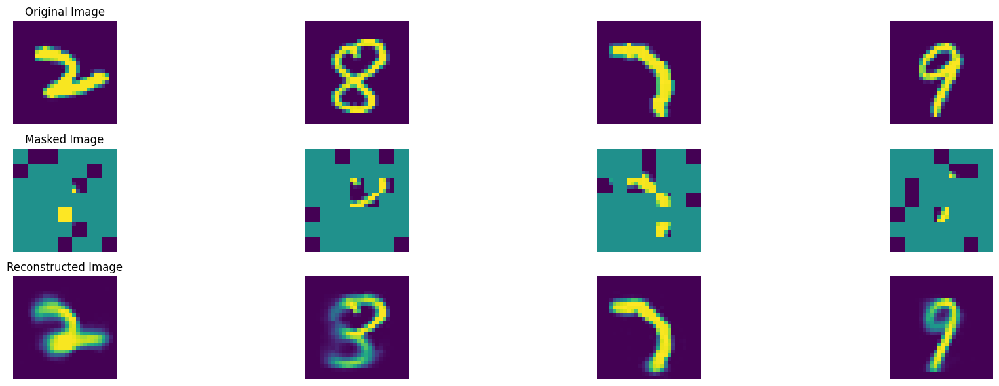

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 754, average traning loss is 0.09152657808141505.
=================== EPOCH:  755  ===================


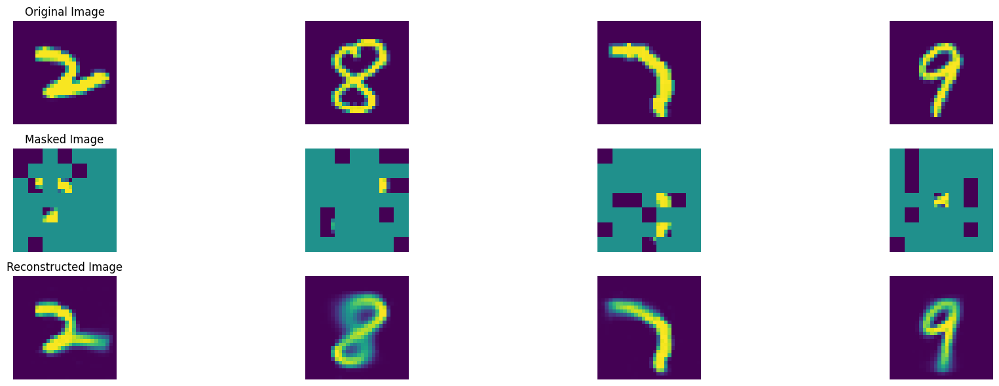

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 755, average traning loss is 0.0918664001721017.
=================== EPOCH:  756  ===================


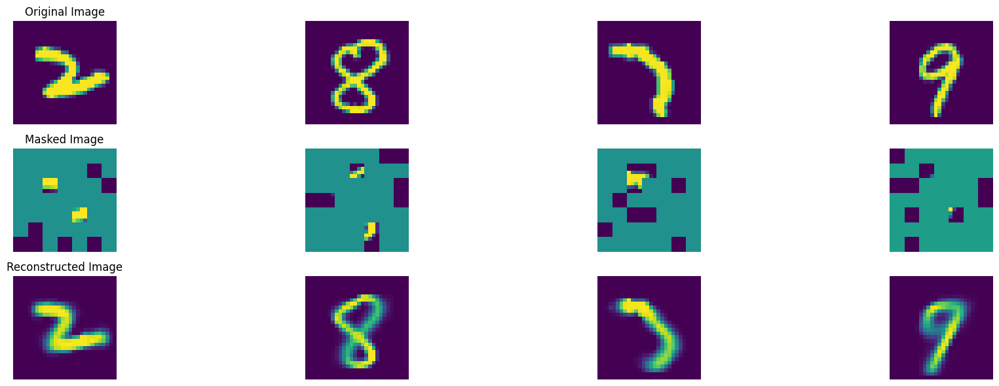

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 756, average traning loss is 0.09160927318512126.
=================== EPOCH:  757  ===================


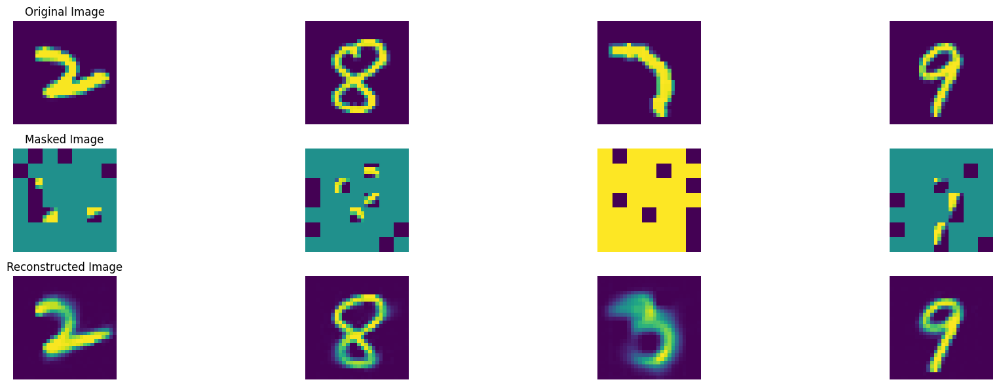

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 757, average traning loss is 0.09116722912864482.
=================== EPOCH:  758  ===================


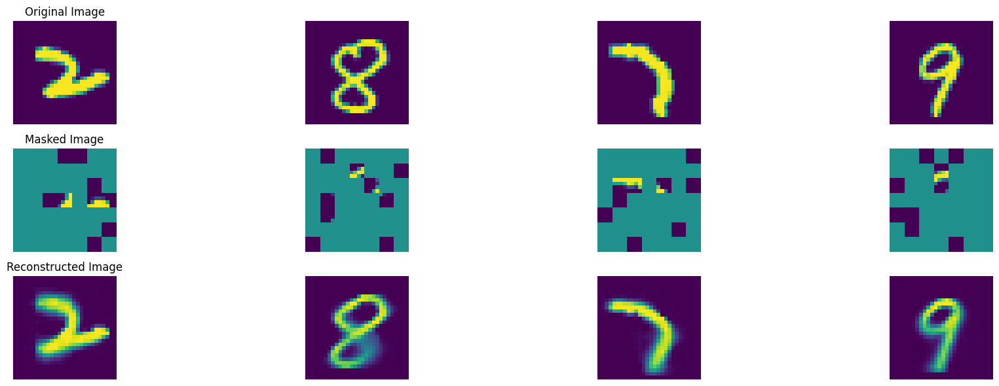

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 758, average traning loss is 0.09127729084897548.
=================== EPOCH:  759  ===================


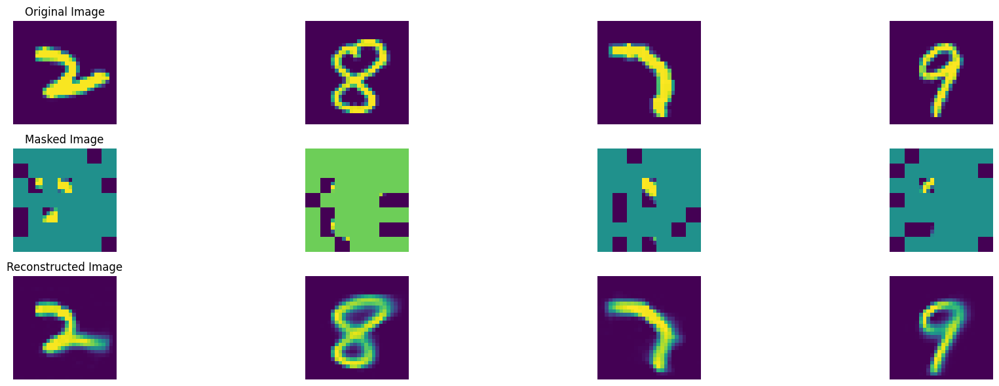

100%|██████████| 47/47 [00:08<00:00,  5.50it/s]


In epoch 759, average traning loss is 0.09139355145236279.
=================== EPOCH:  760  ===================


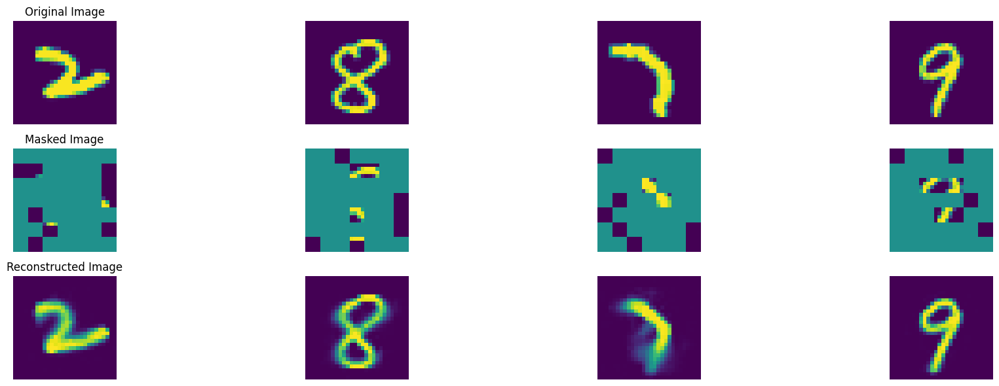

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 760, average traning loss is 0.09162993095022567.
=================== EPOCH:  761  ===================


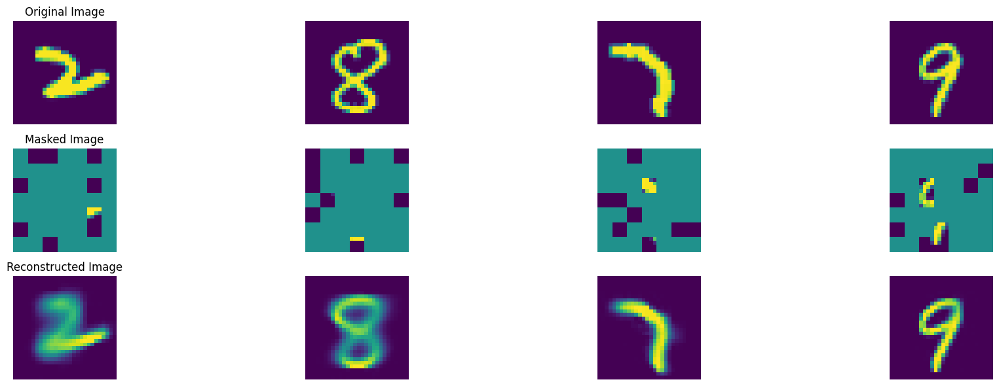

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 761, average traning loss is 0.0912713183367506.
=================== EPOCH:  762  ===================


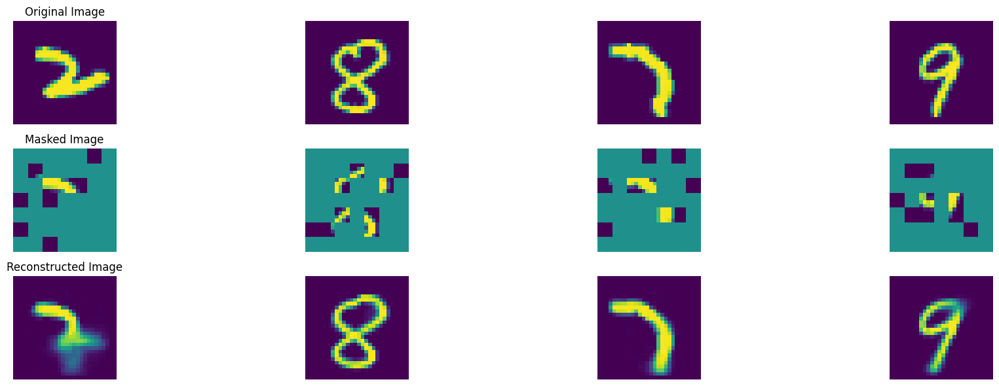

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 762, average traning loss is 0.09131795469116658.
=================== EPOCH:  763  ===================


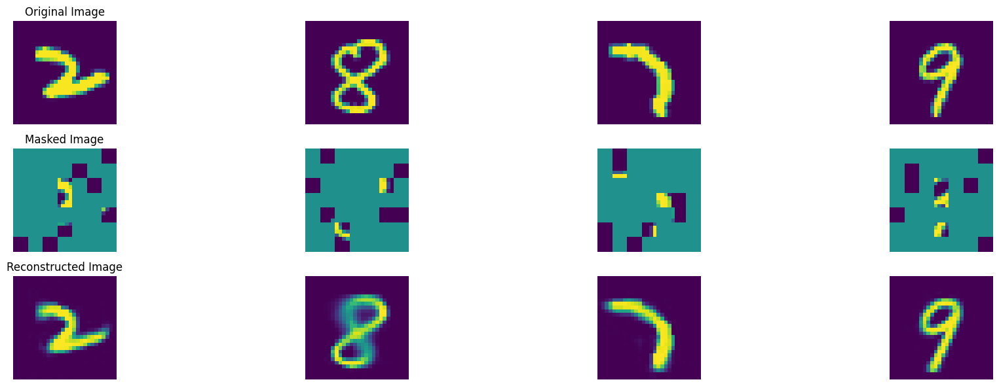

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 763, average traning loss is 0.09139359266834056.
=================== EPOCH:  764  ===================


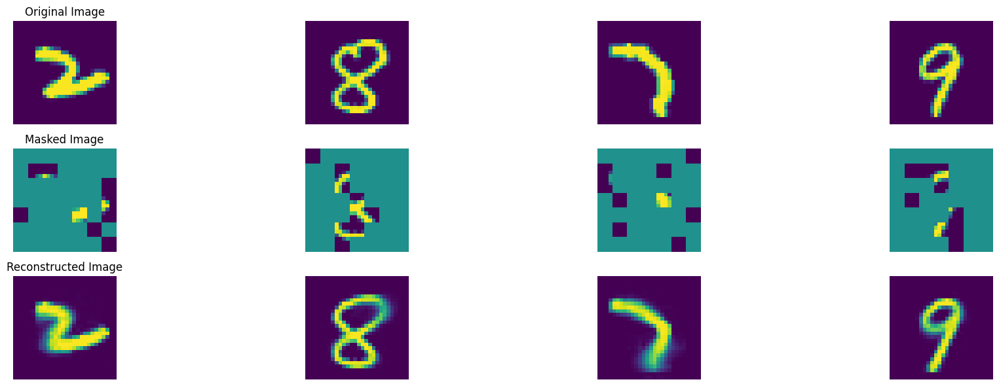

100%|██████████| 47/47 [00:08<00:00,  5.51it/s]


In epoch 764, average traning loss is 0.09136052017516279.
=================== EPOCH:  765  ===================


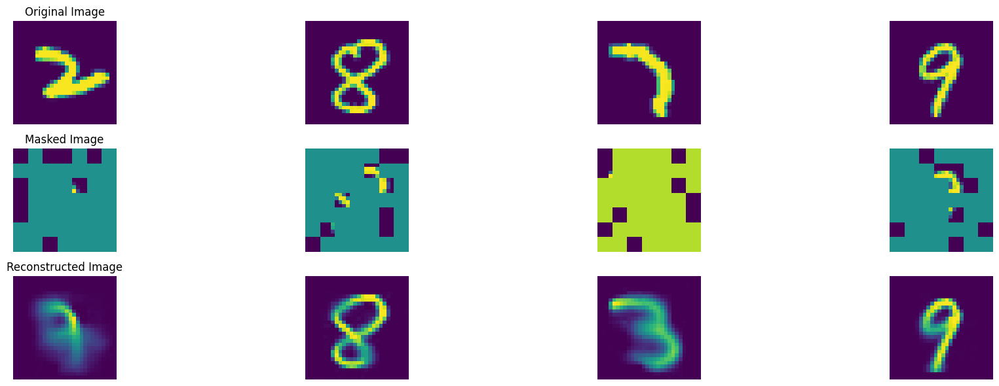

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 765, average traning loss is 0.09080645267633682.
=================== EPOCH:  766  ===================


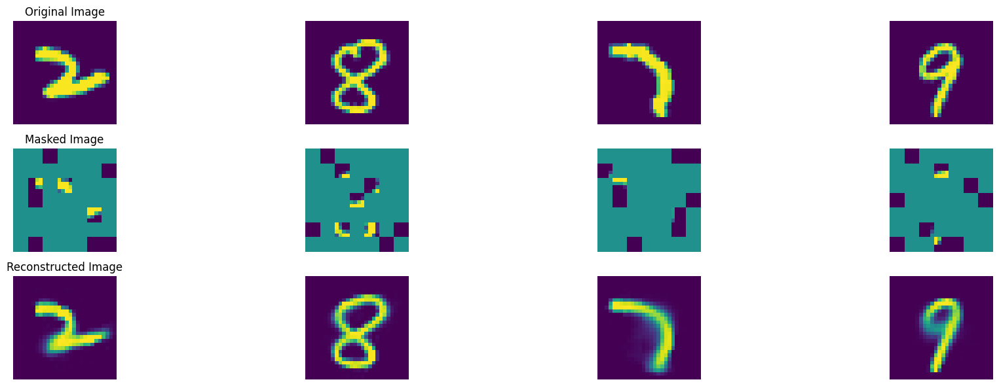

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 766, average traning loss is 0.09103908389806747.
=================== EPOCH:  767  ===================


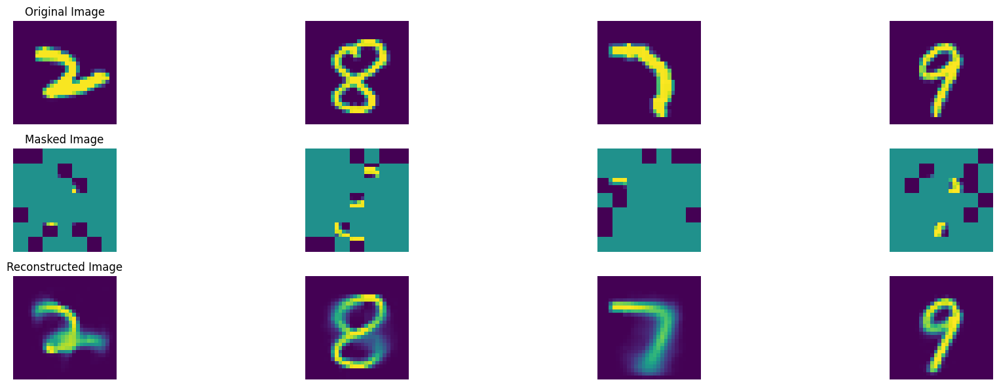

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 767, average traning loss is 0.0909914380692421.
=================== EPOCH:  768  ===================


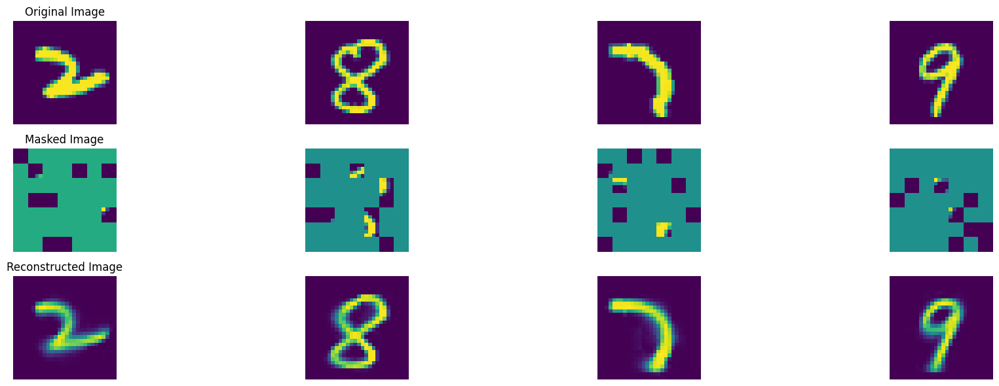

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 768, average traning loss is 0.09149018881168772.
=================== EPOCH:  769  ===================


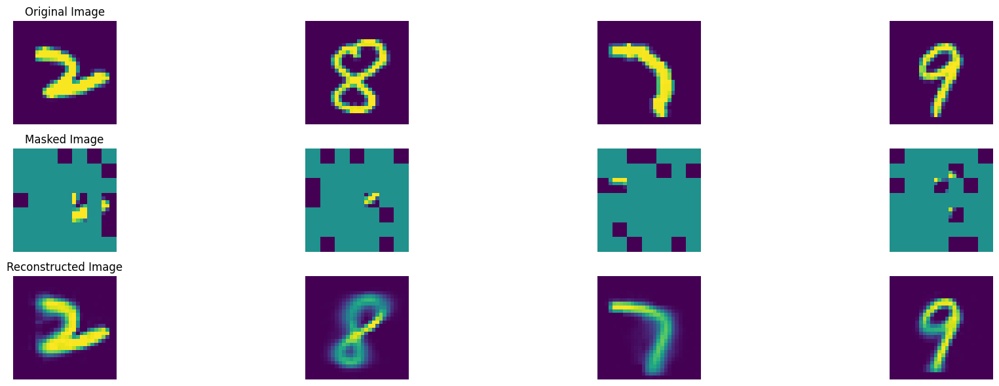

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 769, average traning loss is 0.09132863914078855.
=================== EPOCH:  770  ===================


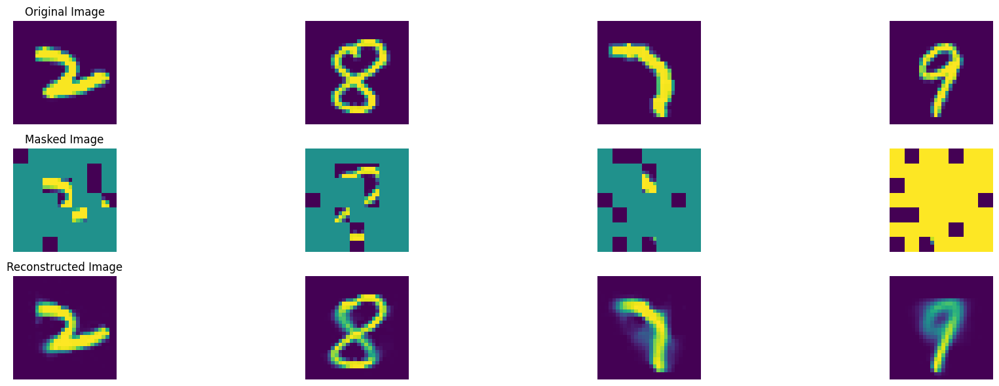

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 770, average traning loss is 0.09097798628375885.
=================== EPOCH:  771  ===================


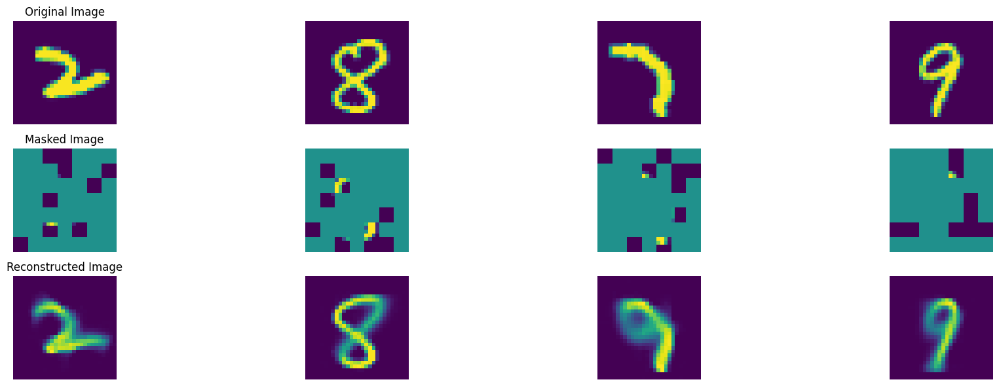

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 771, average traning loss is 0.09100366431347867.
=================== EPOCH:  772  ===================


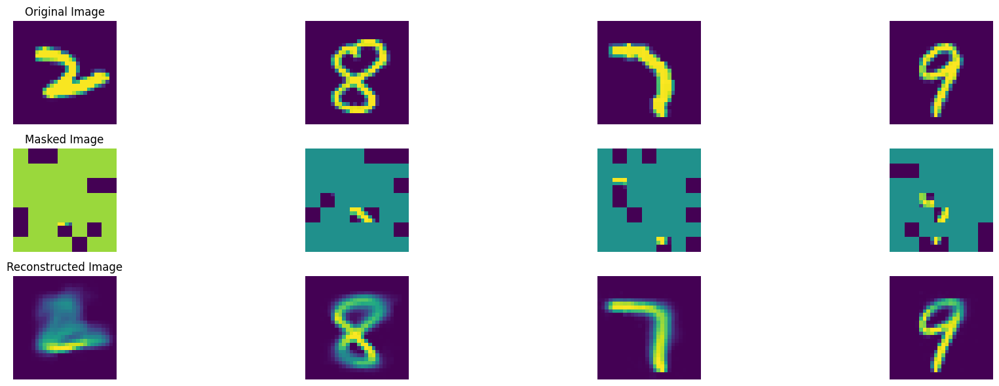

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 772, average traning loss is 0.09106432392876199.
=================== EPOCH:  773  ===================


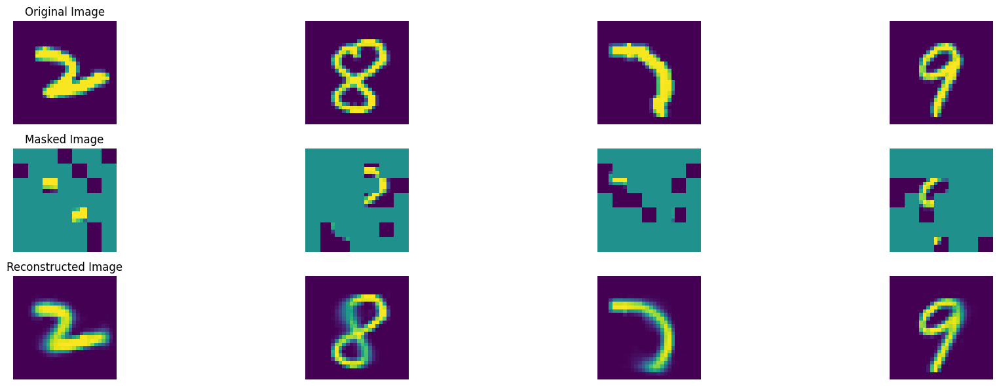

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 773, average traning loss is 0.09095796467141902.
=================== EPOCH:  774  ===================


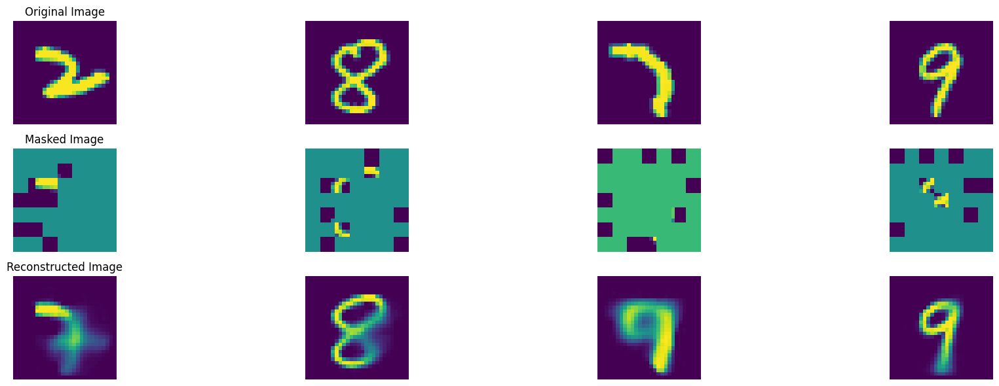

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 774, average traning loss is 0.09082327751403159.
=================== EPOCH:  775  ===================


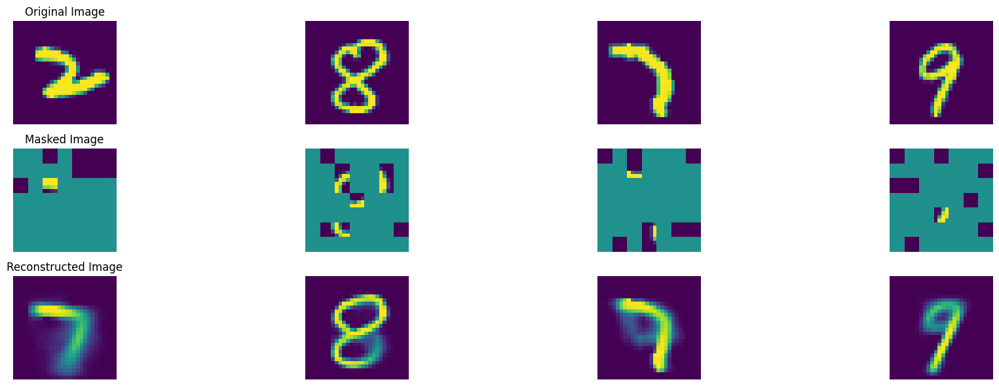

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 775, average traning loss is 0.091136985636772.
=================== EPOCH:  776  ===================


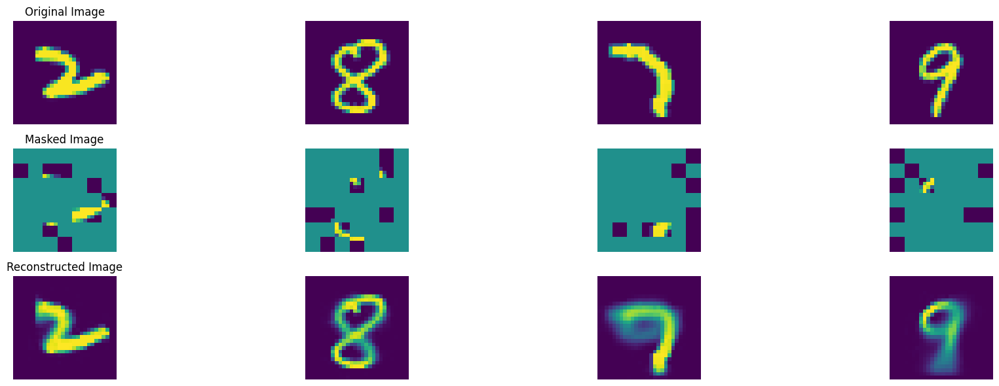

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 776, average traning loss is 0.09074900949254949.
=================== EPOCH:  777  ===================


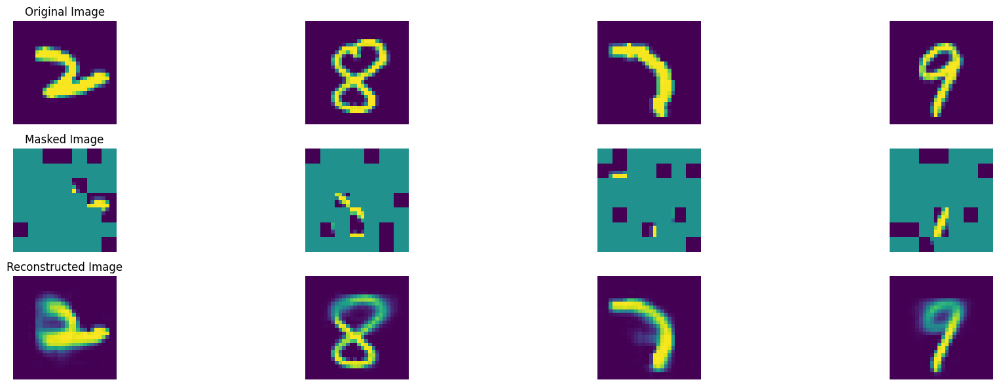

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 777, average traning loss is 0.09068960759868012.
=================== EPOCH:  778  ===================


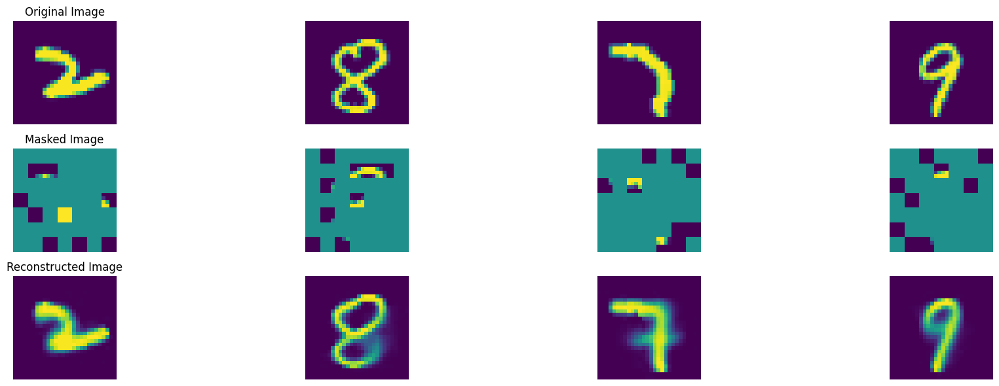

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 778, average traning loss is 0.0907716396007132.
=================== EPOCH:  779  ===================


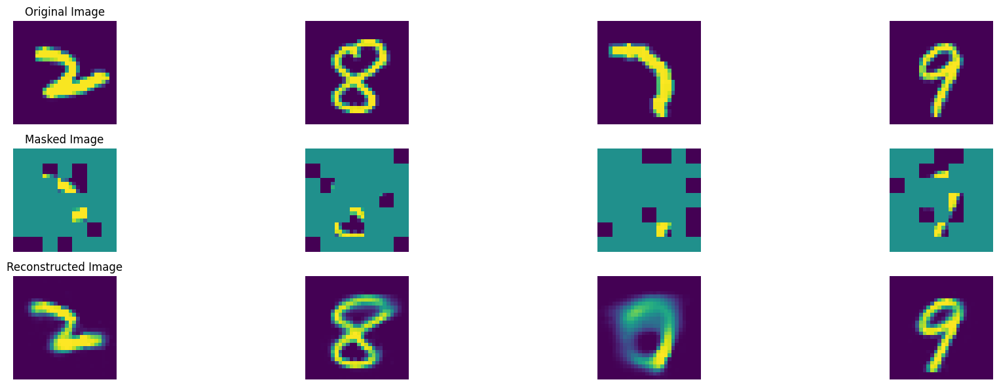

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 779, average traning loss is 0.09100303418458776.
=================== EPOCH:  780  ===================


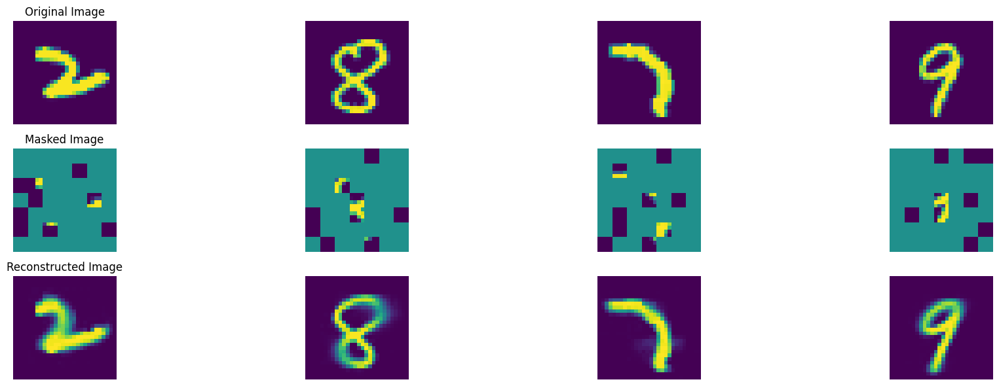

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 780, average traning loss is 0.09068931433114599.
=================== EPOCH:  781  ===================


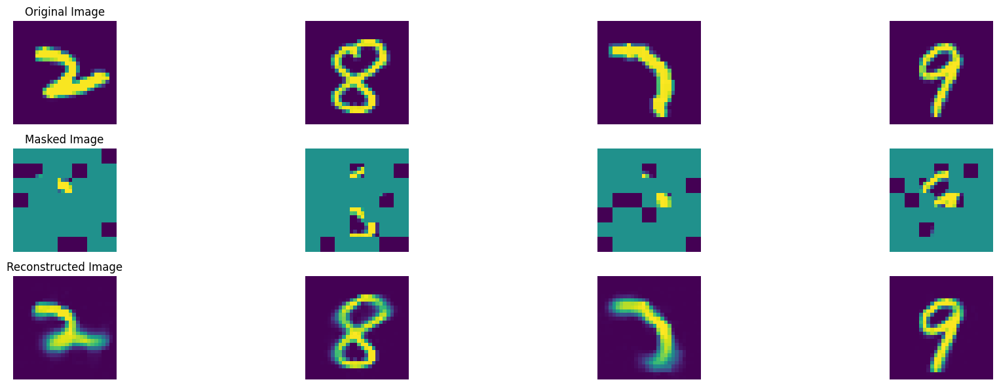

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 781, average traning loss is 0.09089090738524781.
=================== EPOCH:  782  ===================


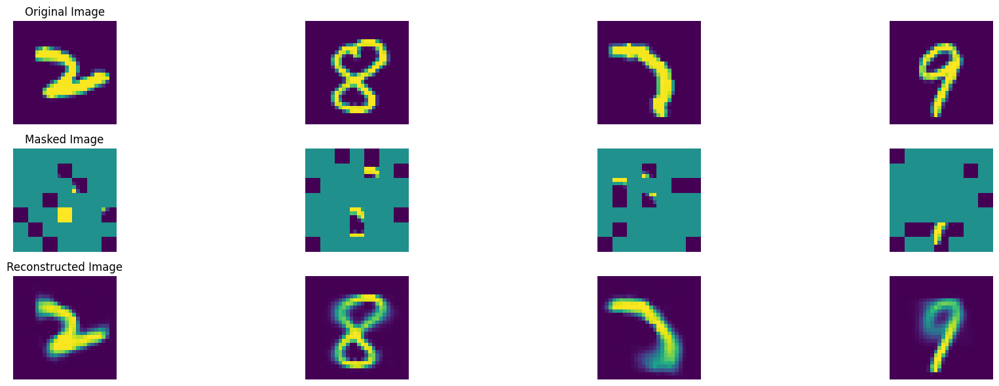

100%|██████████| 47/47 [00:08<00:00,  5.52it/s]


In epoch 782, average traning loss is 0.0905334454901675.
=================== EPOCH:  783  ===================


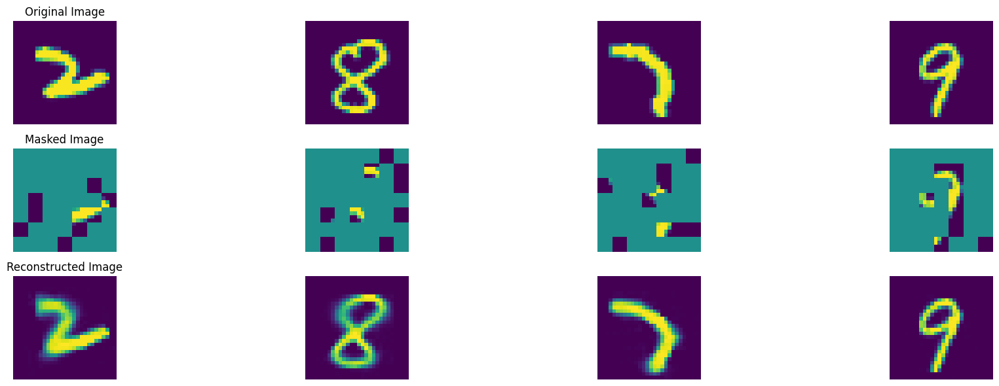

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 783, average traning loss is 0.09068626704368185.
=================== EPOCH:  784  ===================


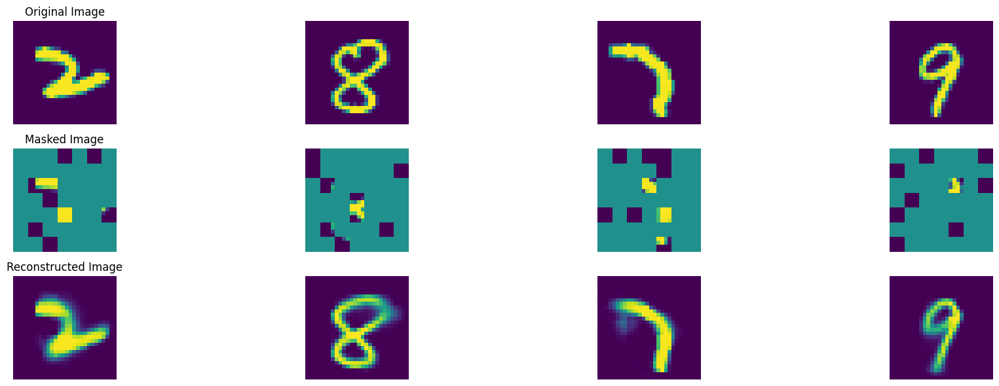

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 784, average traning loss is 0.09028823103042359.
=================== EPOCH:  785  ===================


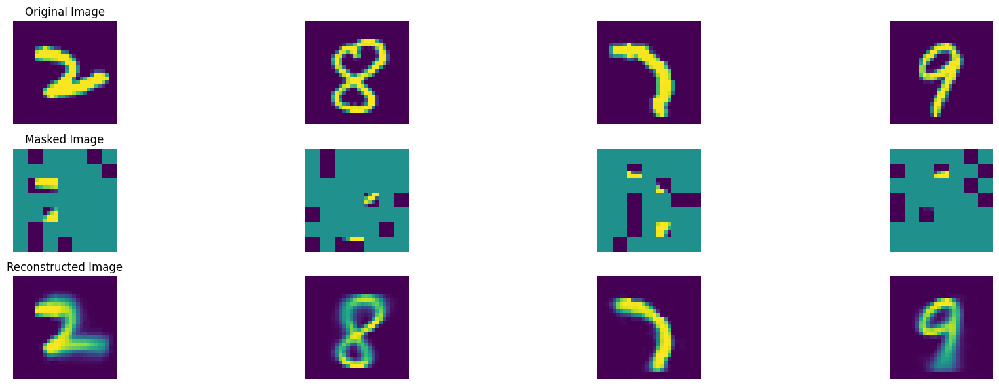

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 785, average traning loss is 0.09013961128731991.
=================== EPOCH:  786  ===================


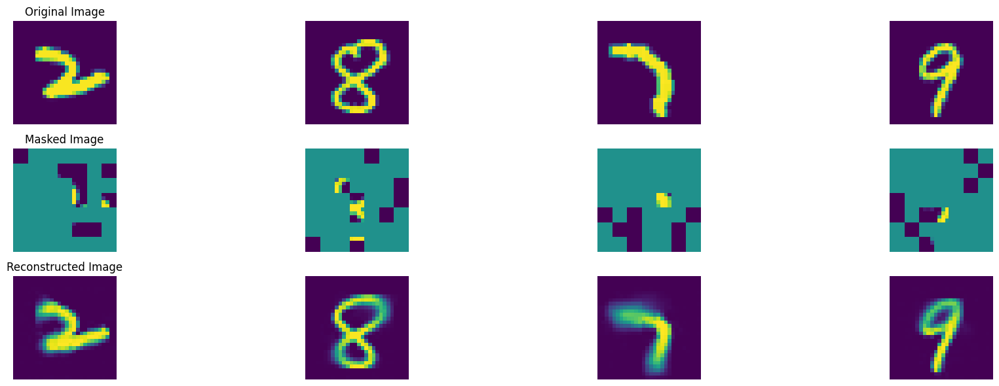

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 786, average traning loss is 0.0903758409809559.
=================== EPOCH:  787  ===================


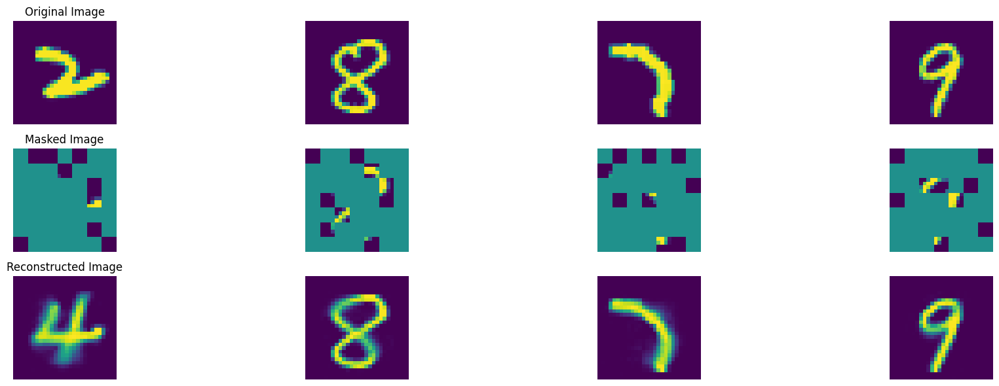

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 787, average traning loss is 0.09052279797640253.
=================== EPOCH:  788  ===================


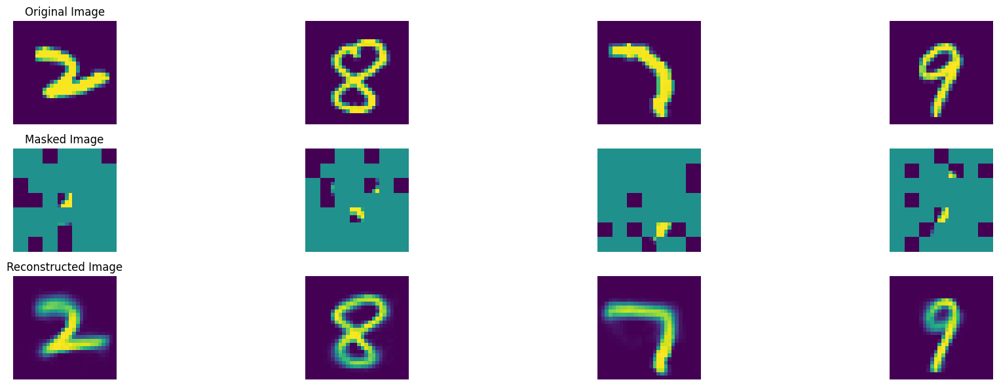

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 788, average traning loss is 0.09063063910666933.
=================== EPOCH:  789  ===================


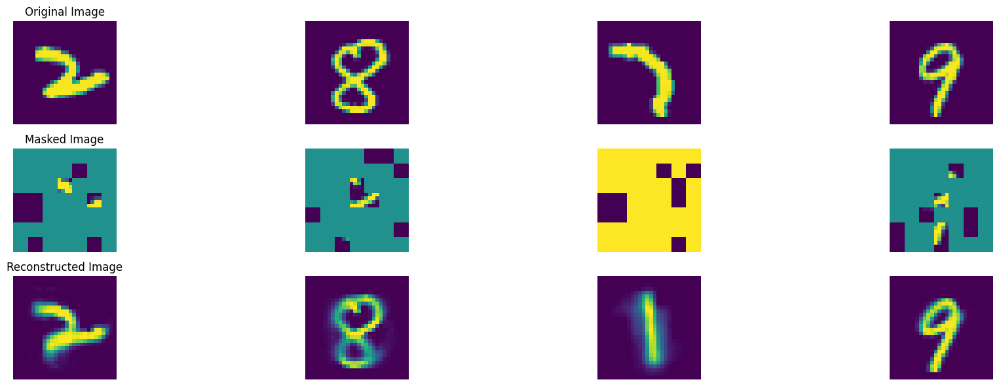

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 789, average traning loss is 0.09095332882505783.
=================== EPOCH:  790  ===================


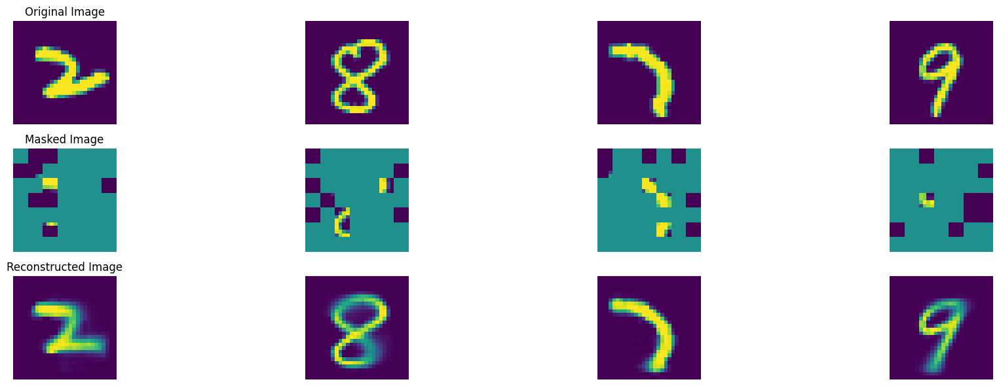

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 790, average traning loss is 0.09034773326934652.
=================== EPOCH:  791  ===================


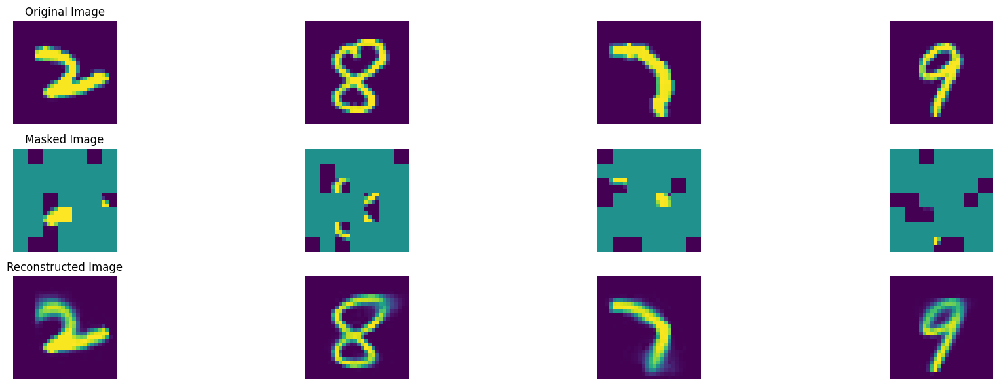

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 791, average traning loss is 0.09002169776470104.
=================== EPOCH:  792  ===================


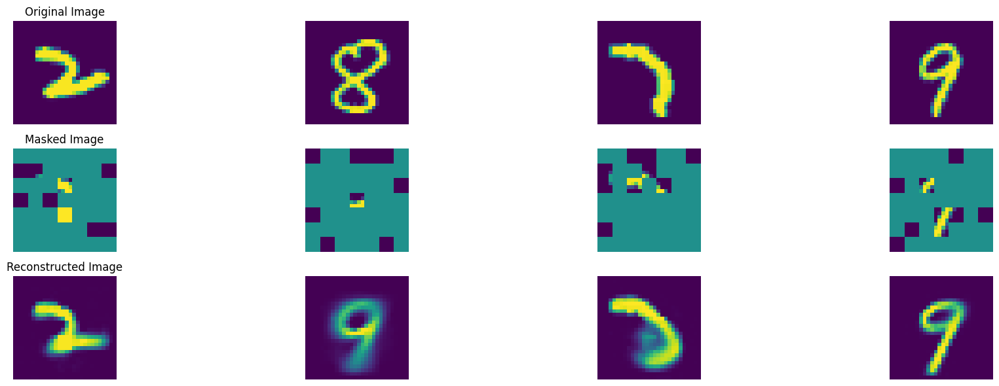

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 792, average traning loss is 0.09106294826624241.
=================== EPOCH:  793  ===================


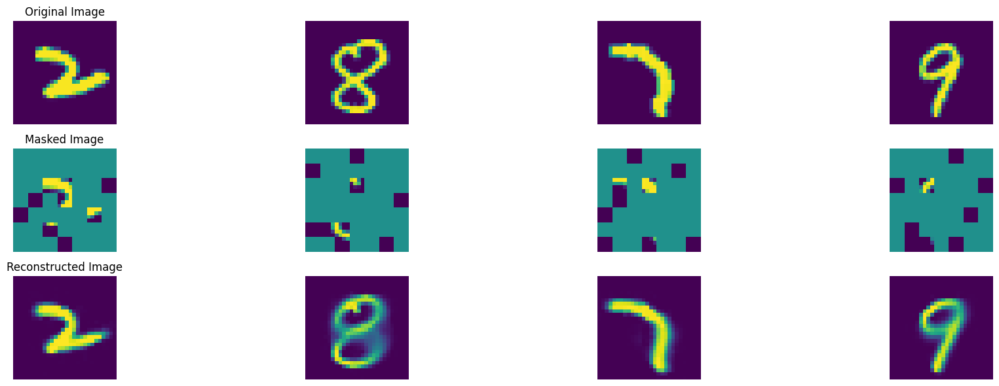

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 793, average traning loss is 0.09071696739881596.
=================== EPOCH:  794  ===================


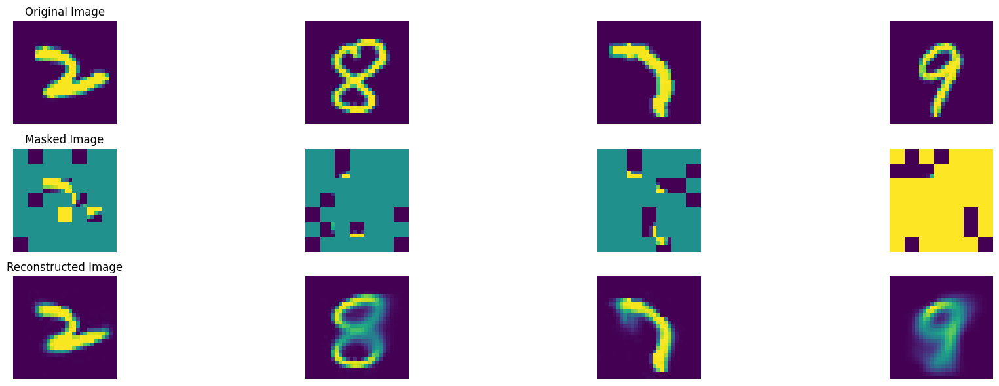

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 794, average traning loss is 0.09027120471000671.
=================== EPOCH:  795  ===================


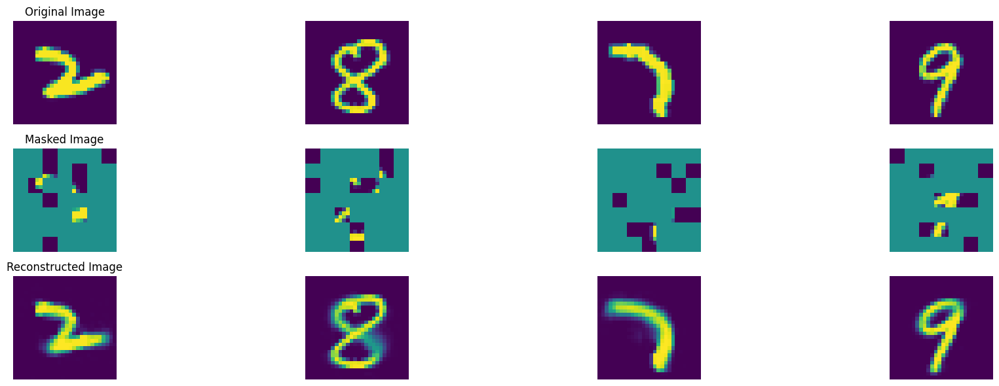

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 795, average traning loss is 0.08993020701281568.
=================== EPOCH:  796  ===================


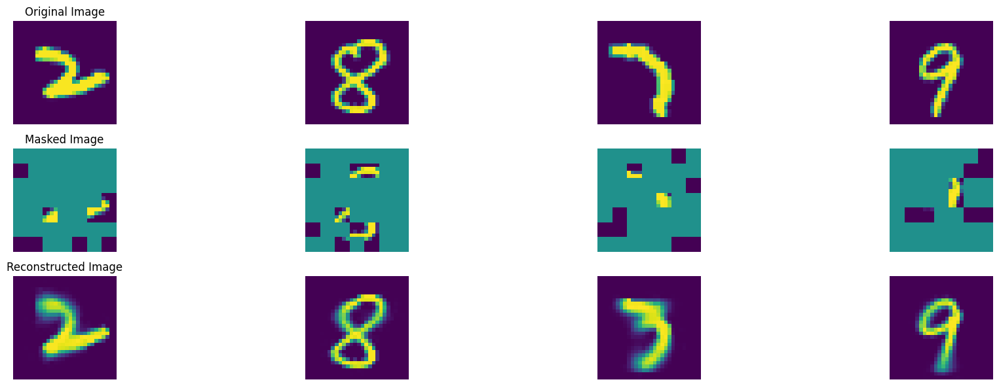

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 796, average traning loss is 0.08975930179053164.
=================== EPOCH:  797  ===================


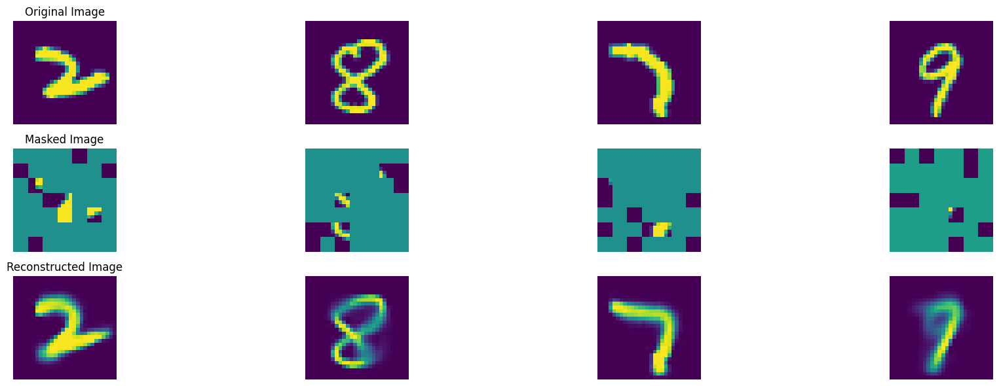

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 797, average traning loss is 0.09064325008620606.
=================== EPOCH:  798  ===================


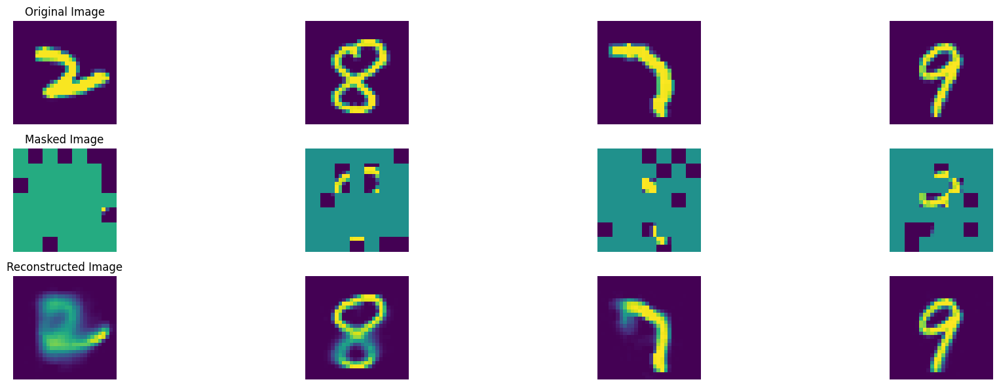

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 798, average traning loss is 0.09031598365053217.
=================== EPOCH:  799  ===================


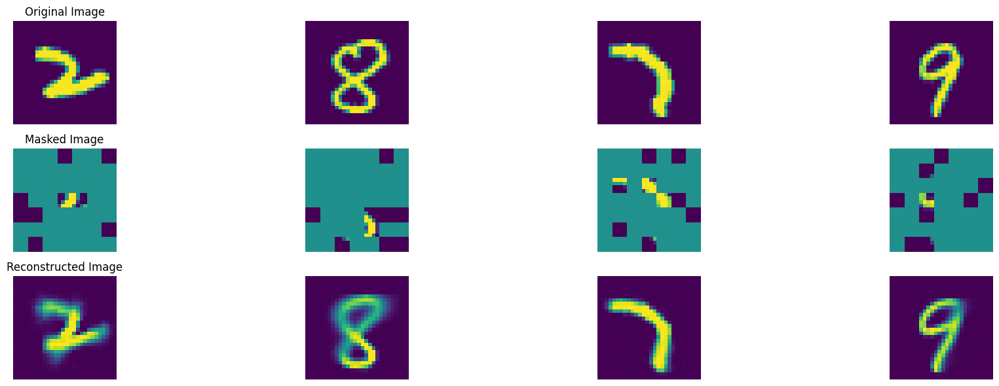

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 799, average traning loss is 0.09051498009803448.
=================== EPOCH:  800  ===================


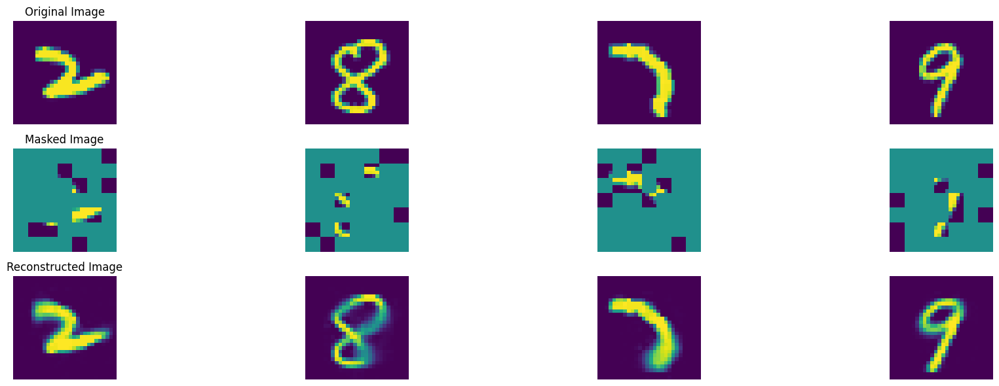

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 800, average traning loss is 0.09021209877856234.
=================== EPOCH:  801  ===================


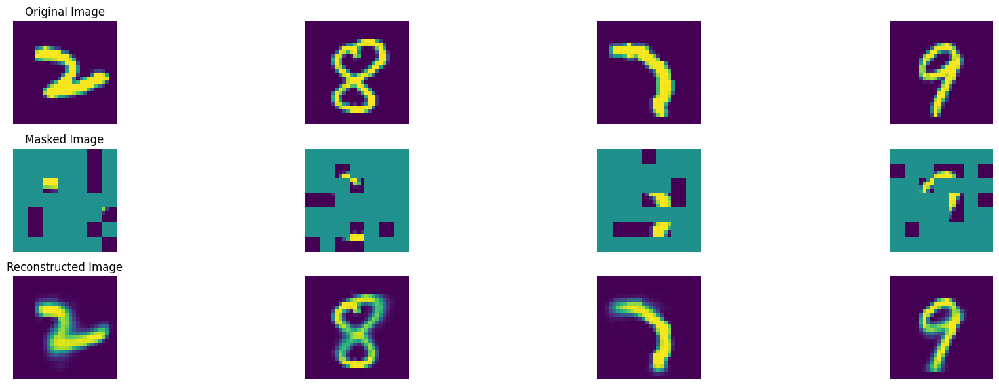

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 801, average traning loss is 0.08999126388671551.
=================== EPOCH:  802  ===================


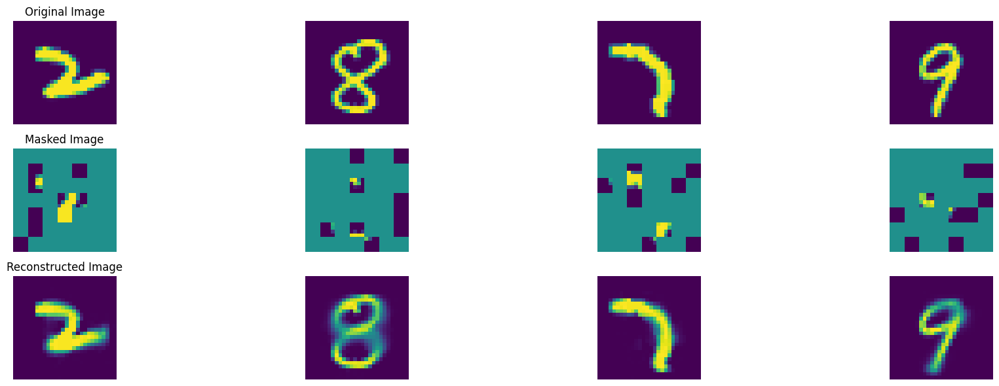

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 802, average traning loss is 0.09029568541557231.
=================== EPOCH:  803  ===================


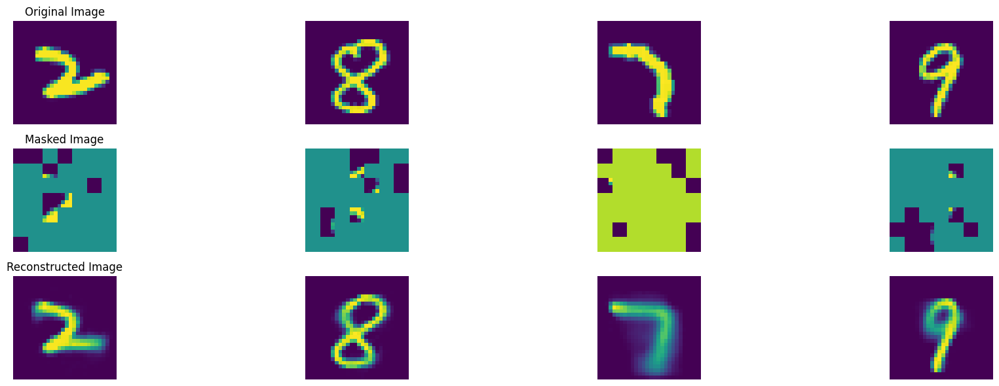

100%|██████████| 47/47 [00:08<00:00,  5.29it/s]


In epoch 803, average traning loss is 0.08998636441661957.
=================== EPOCH:  804  ===================


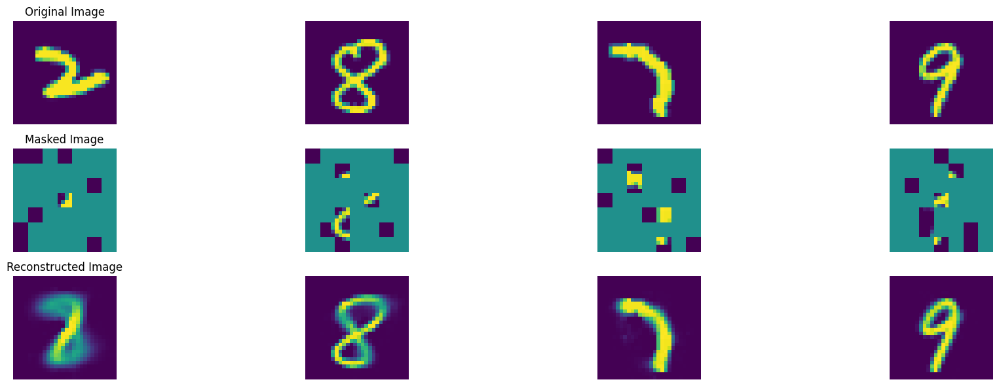

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 804, average traning loss is 0.09004829570334008.
=================== EPOCH:  805  ===================


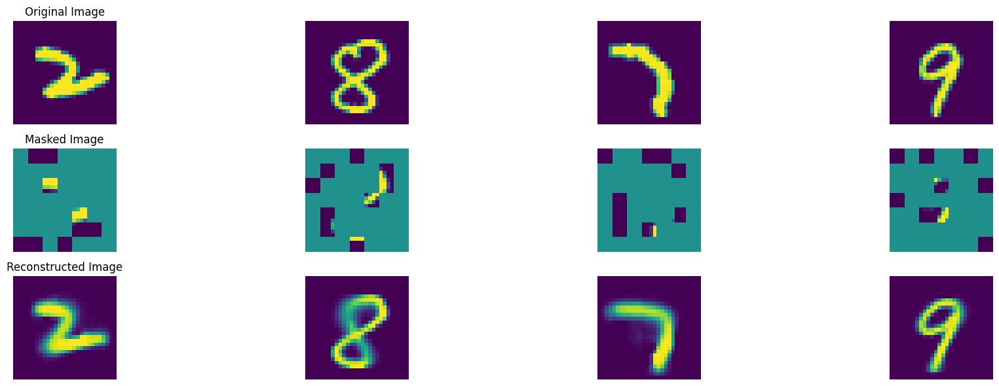

100%|██████████| 47/47 [00:08<00:00,  5.29it/s]


In epoch 805, average traning loss is 0.08996338983799548.
=================== EPOCH:  806  ===================


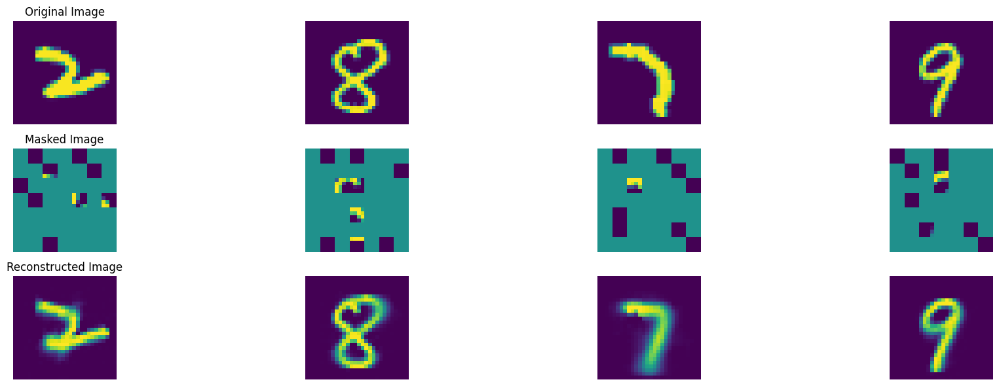

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 806, average traning loss is 0.08995673488429252.
=================== EPOCH:  807  ===================


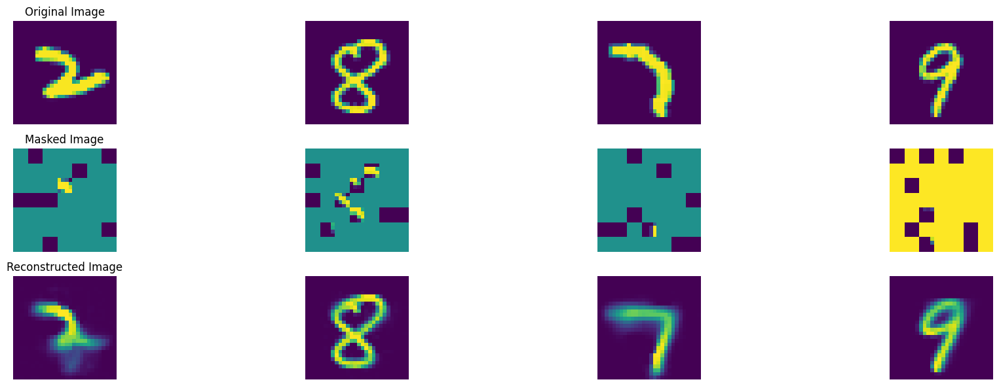

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 807, average traning loss is 0.08958457584710831.
=================== EPOCH:  808  ===================


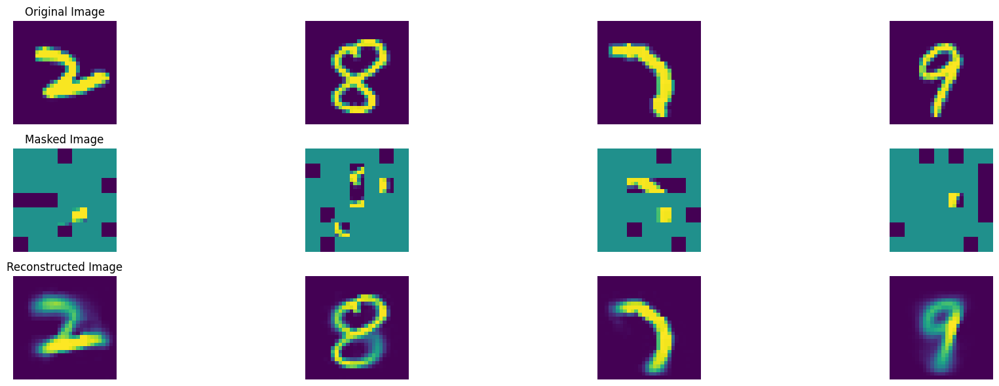

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 808, average traning loss is 0.08984974961965642.
=================== EPOCH:  809  ===================


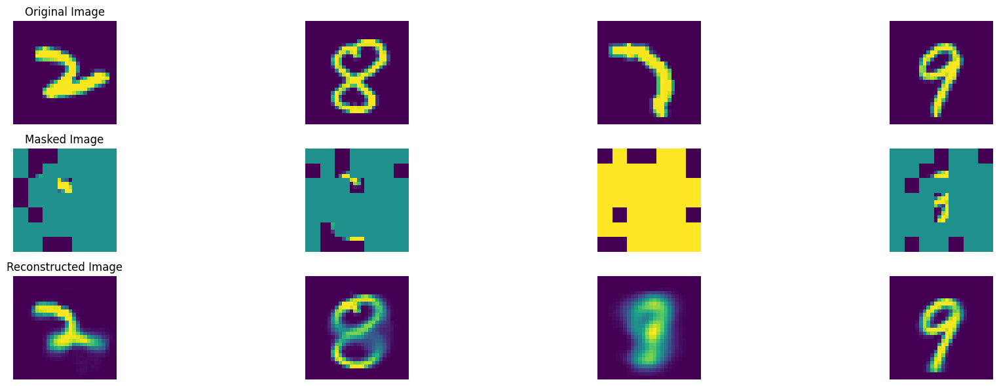

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 809, average traning loss is 0.09009613128418618.
=================== EPOCH:  810  ===================


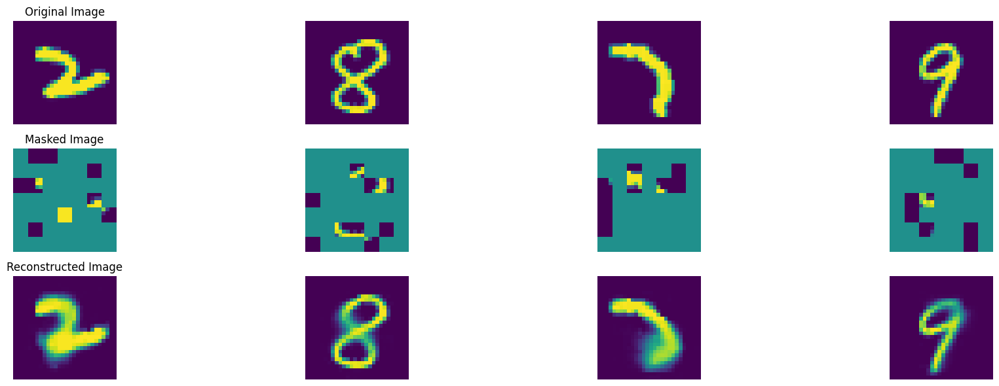

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 810, average traning loss is 0.08928449436071072.
=================== EPOCH:  811  ===================


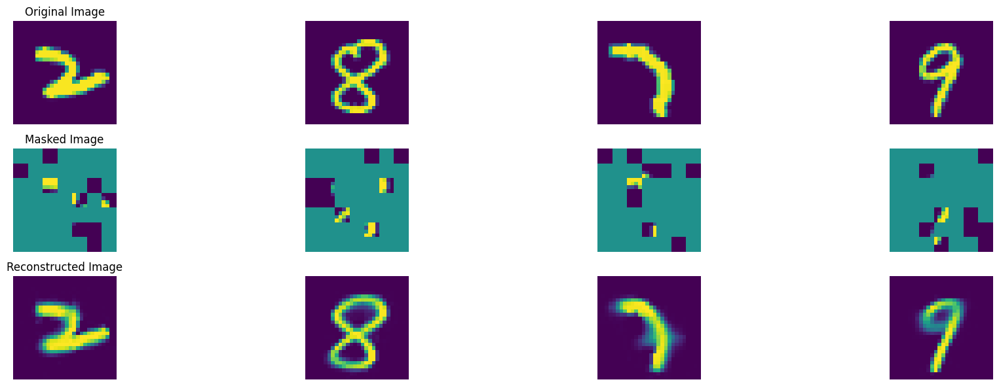

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 811, average traning loss is 0.09002138357213203.
=================== EPOCH:  812  ===================


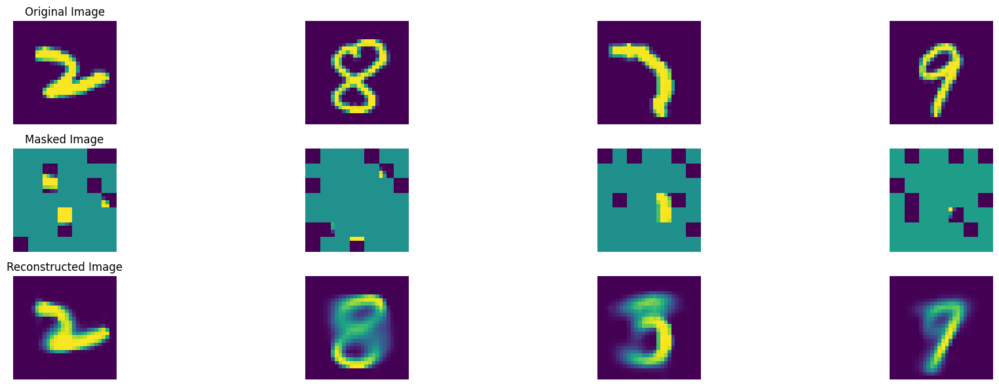

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 812, average traning loss is 0.089569979050058.
=================== EPOCH:  813  ===================


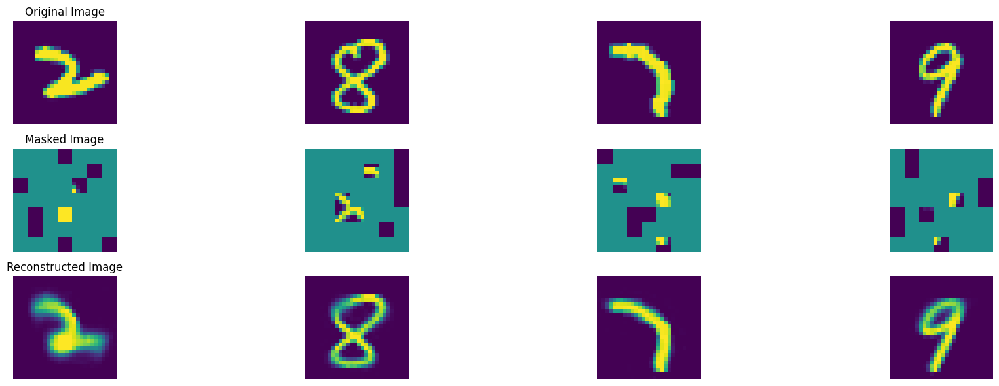

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 813, average traning loss is 0.08957674734769984.
=================== EPOCH:  814  ===================


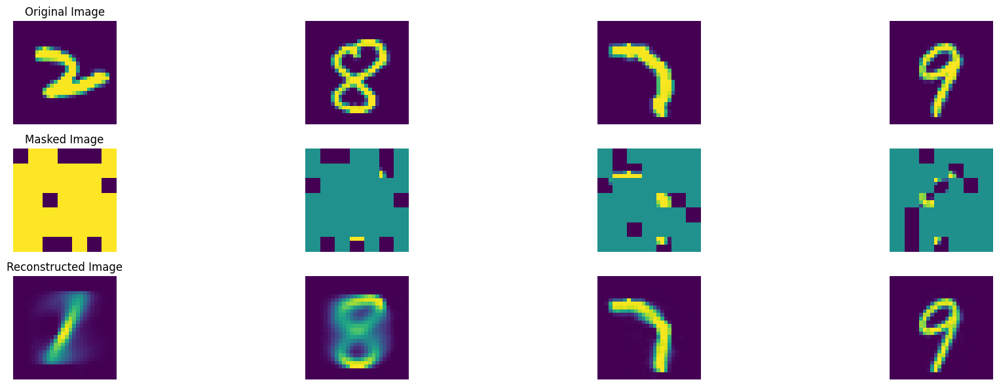

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 814, average traning loss is 0.09012615442910094.
=================== EPOCH:  815  ===================


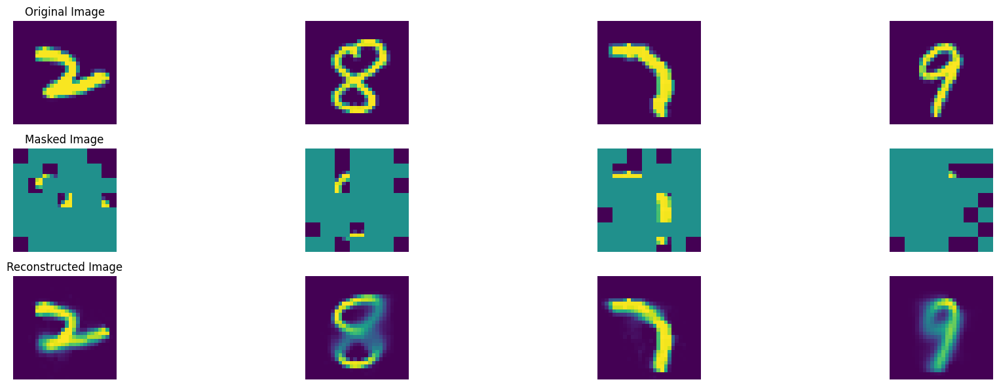

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 815, average traning loss is 0.08943497183475088.
=================== EPOCH:  816  ===================


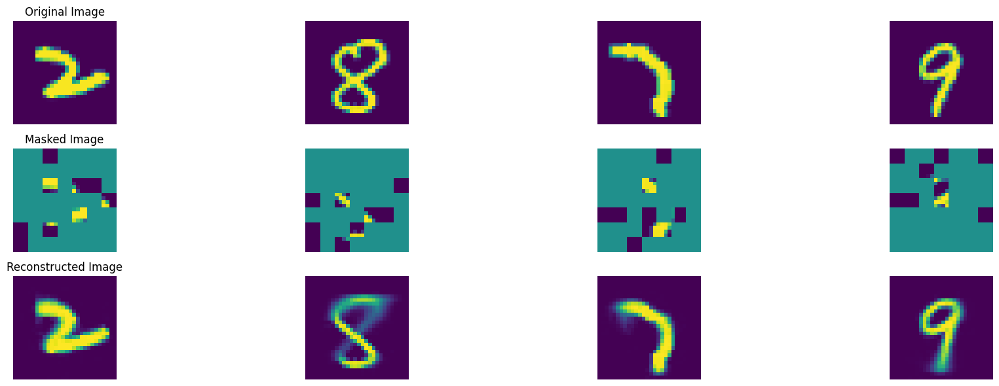

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 816, average traning loss is 0.09003518331558147.
=================== EPOCH:  817  ===================


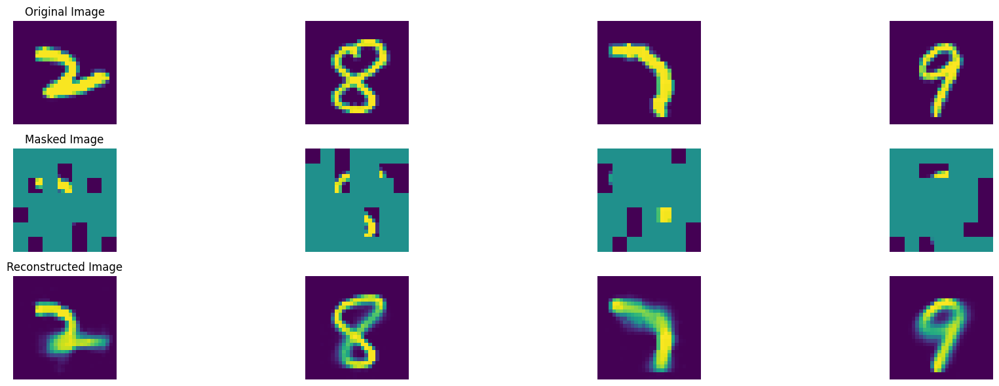

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 817, average traning loss is 0.08950375083913194.
=================== EPOCH:  818  ===================


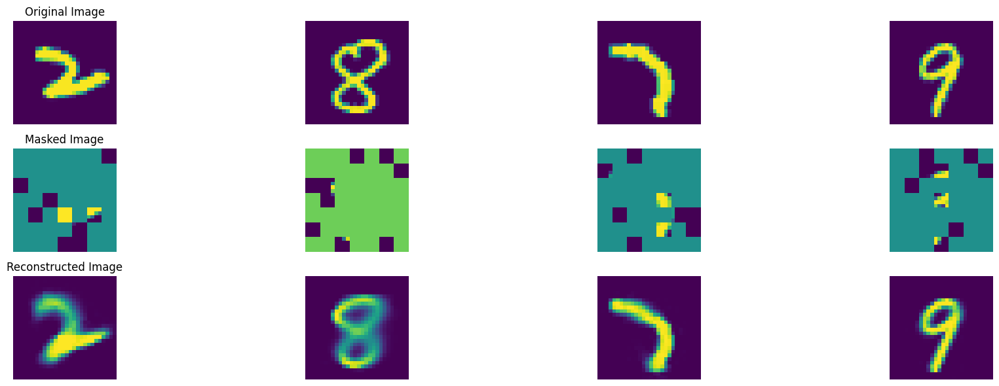

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 818, average traning loss is 0.08977116866314665.
=================== EPOCH:  819  ===================


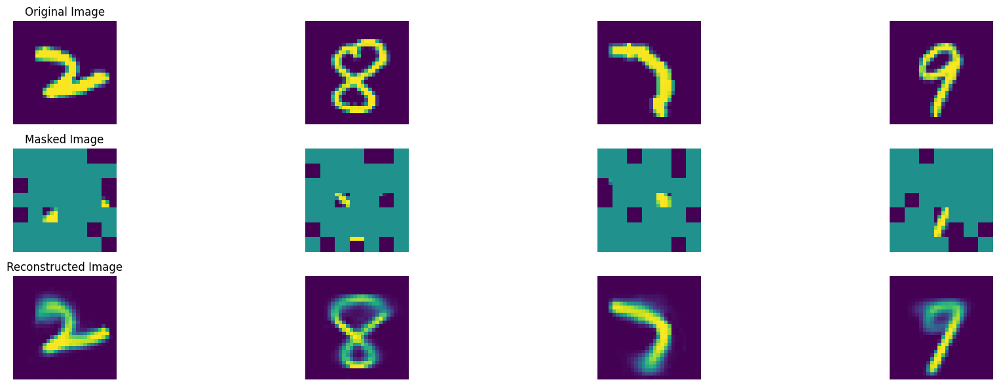

100%|██████████| 47/47 [00:08<00:00,  5.30it/s]


In epoch 819, average traning loss is 0.0898722692372951.
=================== EPOCH:  820  ===================


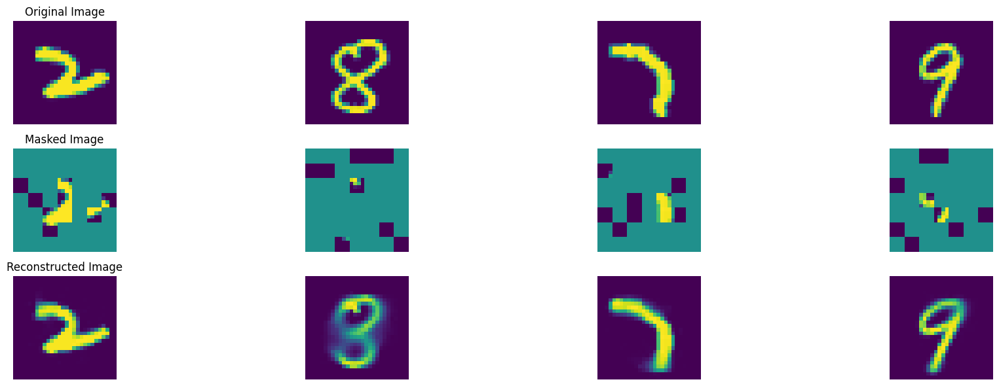

100%|██████████| 47/47 [00:08<00:00,  5.28it/s]


In epoch 820, average traning loss is 0.0894572673008797.
=================== EPOCH:  821  ===================


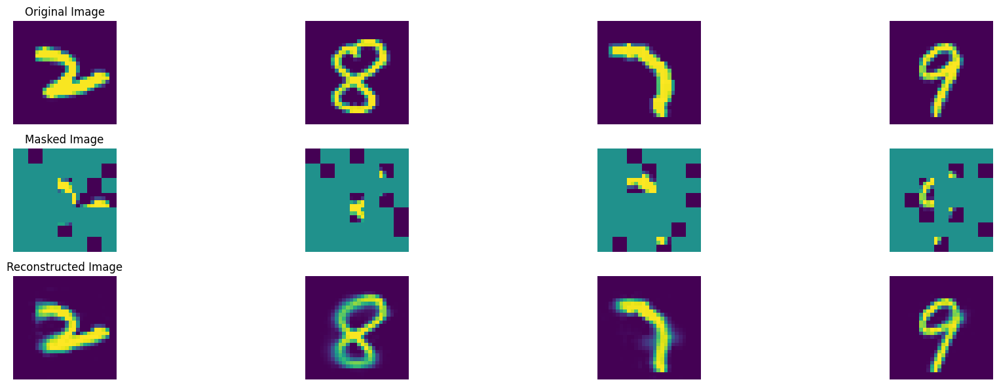

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 821, average traning loss is 0.08986140882715266.
=================== EPOCH:  822  ===================


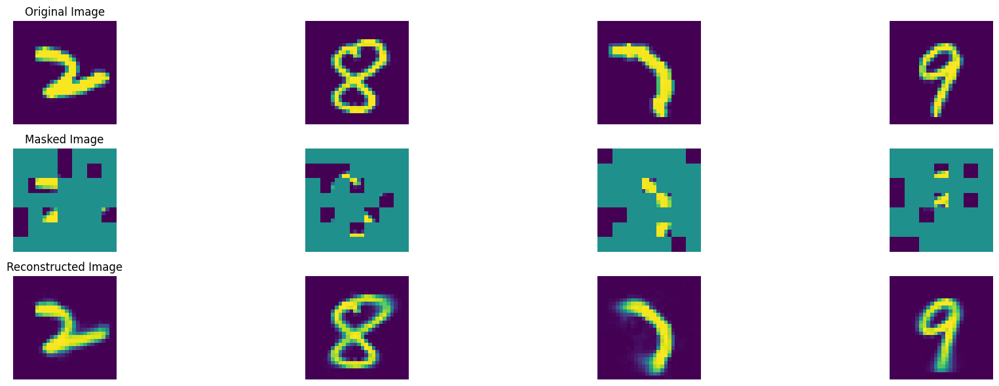

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 822, average traning loss is 0.0898953265649207.
=================== EPOCH:  823  ===================


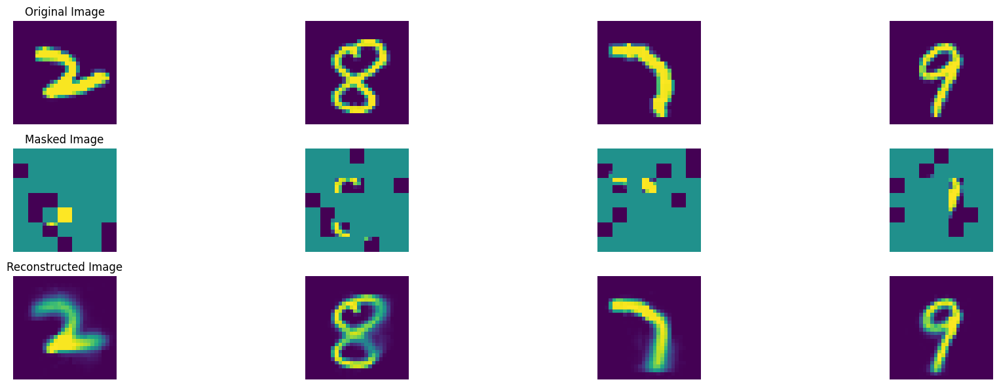

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 823, average traning loss is 0.08932888317615428.
=================== EPOCH:  824  ===================


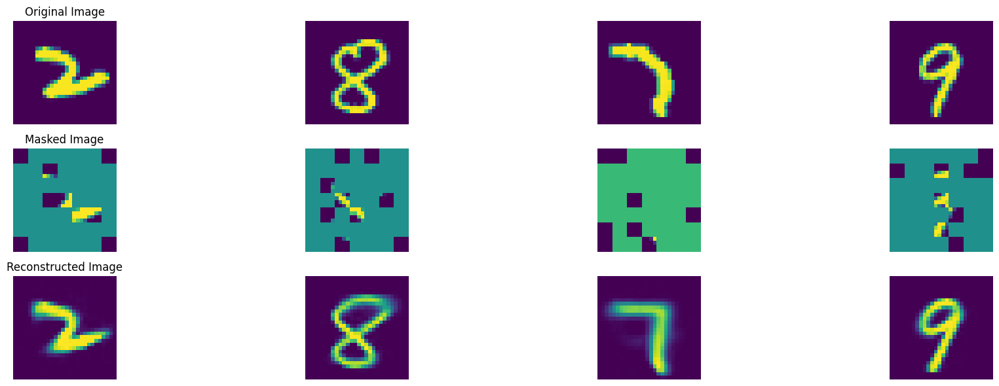

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 824, average traning loss is 0.08948066339213798.
=================== EPOCH:  825  ===================


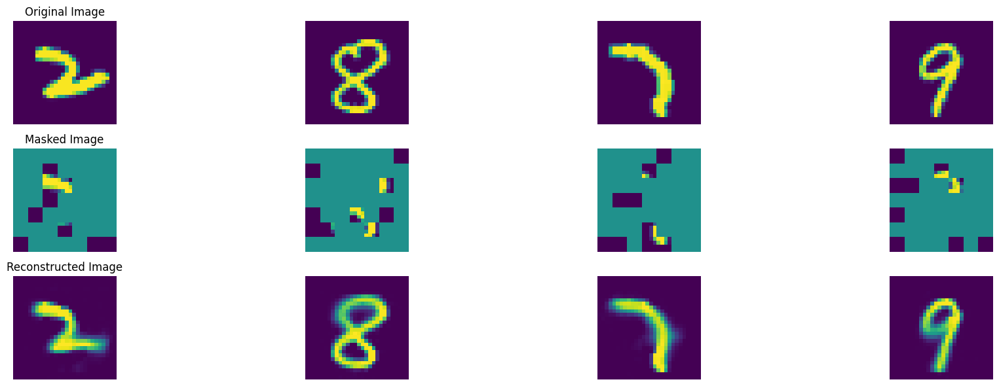

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 825, average traning loss is 0.08941902806784244.
=================== EPOCH:  826  ===================


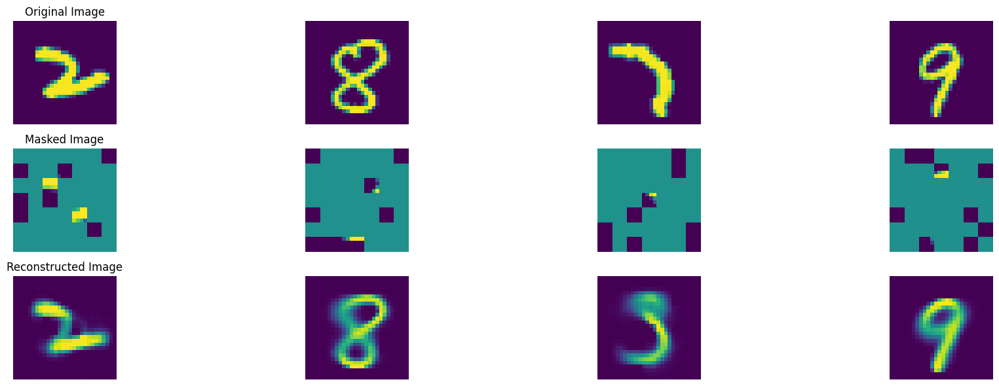

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 826, average traning loss is 0.08948291473566218.
=================== EPOCH:  827  ===================


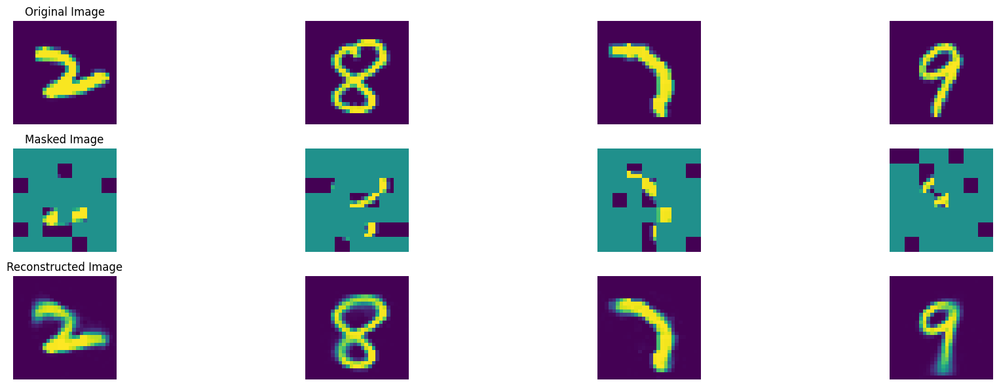

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 827, average traning loss is 0.08968584461415068.
=================== EPOCH:  828  ===================


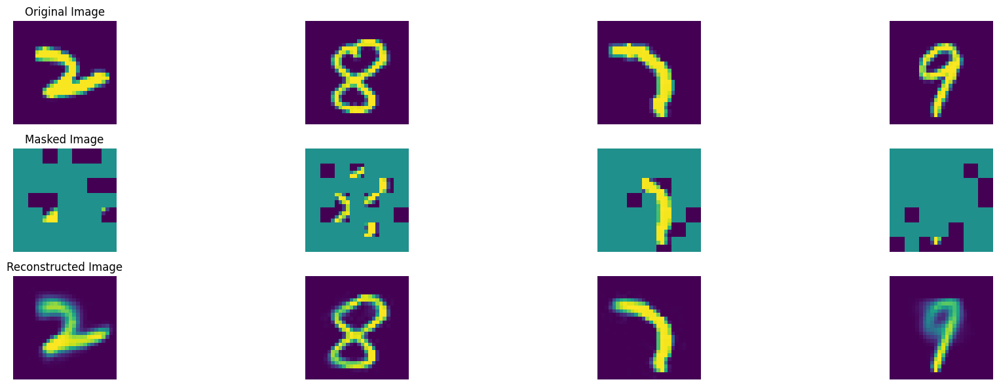

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 828, average traning loss is 0.08945489246794518.
=================== EPOCH:  829  ===================


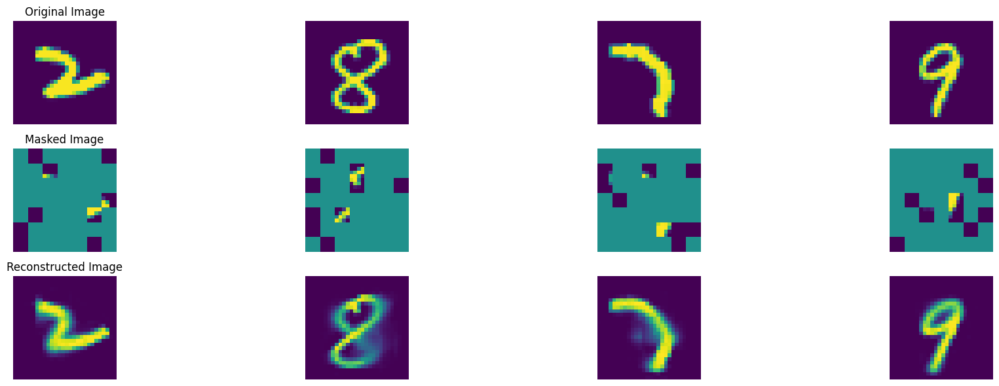

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 829, average traning loss is 0.08985079000604913.
=================== EPOCH:  830  ===================


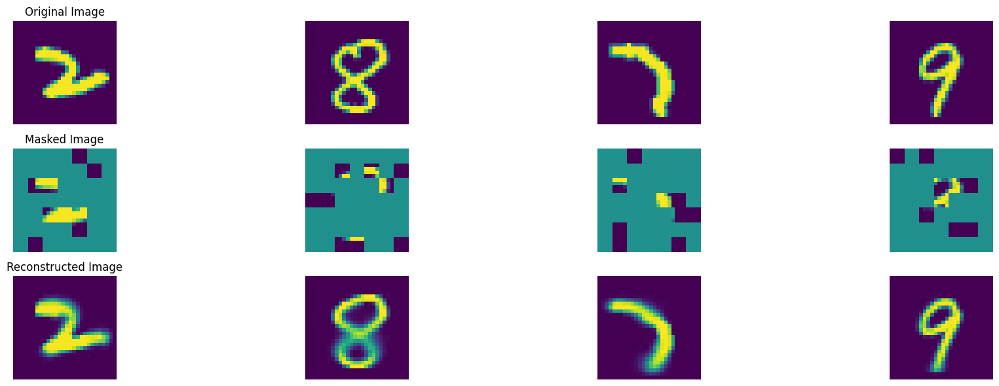

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 830, average traning loss is 0.08953200772087624.
=================== EPOCH:  831  ===================


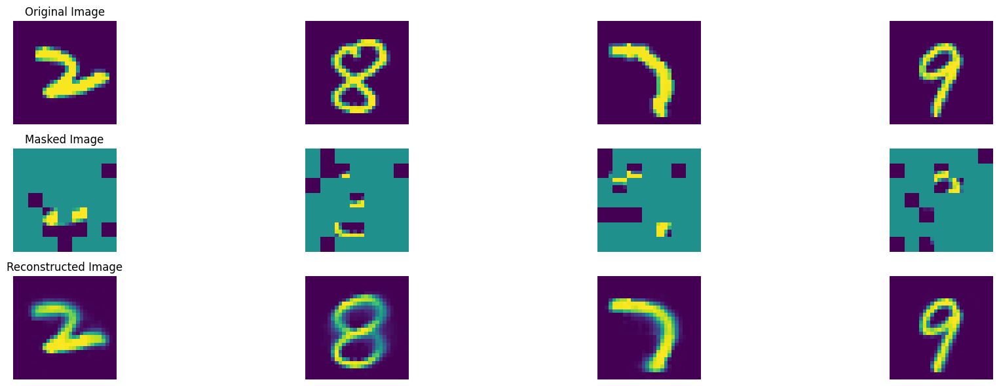

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 831, average traning loss is 0.08962664166663556.
=================== EPOCH:  832  ===================


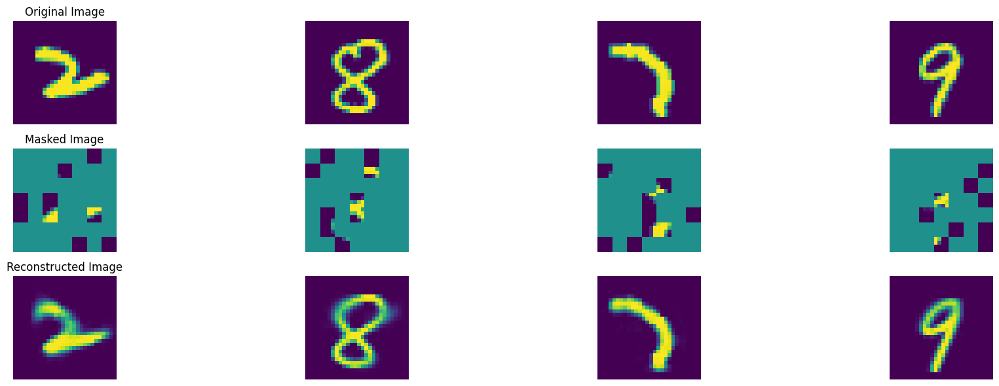

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 832, average traning loss is 0.08893231524431959.
=================== EPOCH:  833  ===================


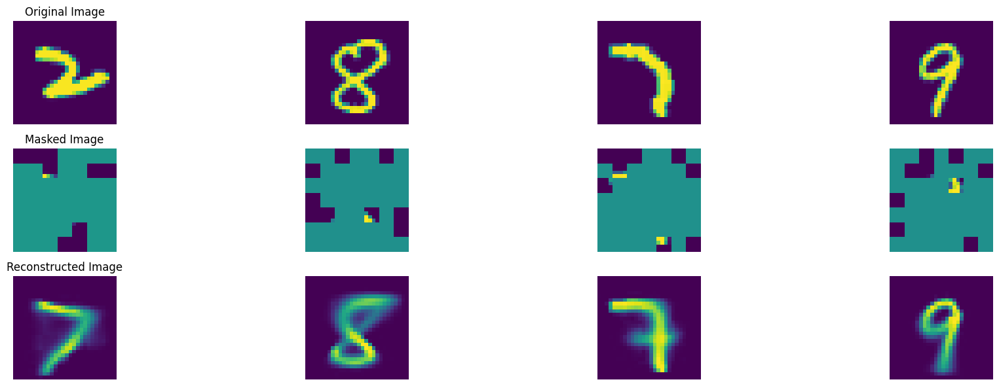

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 833, average traning loss is 0.08968032056346853.
=================== EPOCH:  834  ===================


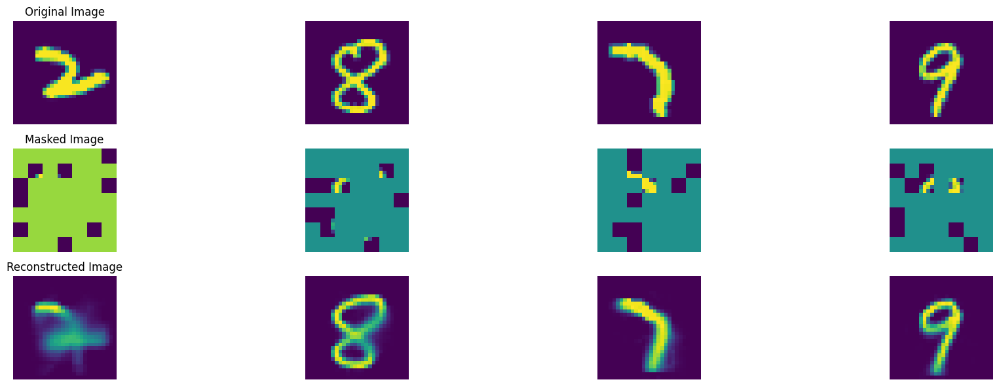

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 834, average traning loss is 0.08947363273894533.
=================== EPOCH:  835  ===================


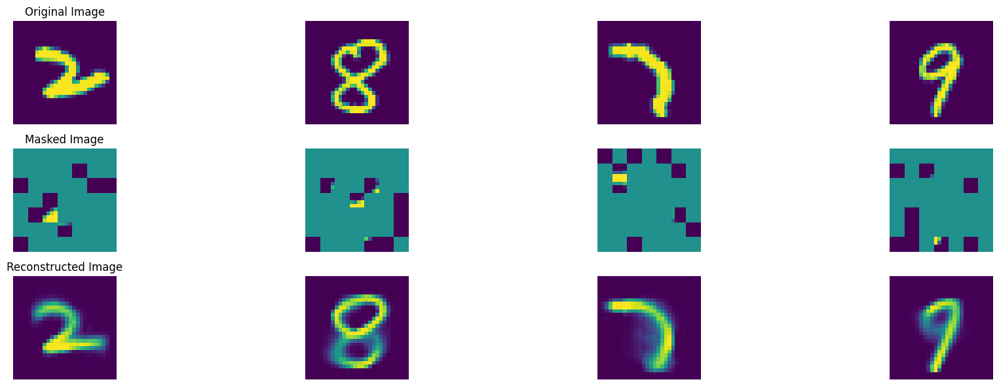

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 835, average traning loss is 0.08921625909019024.
=================== EPOCH:  836  ===================


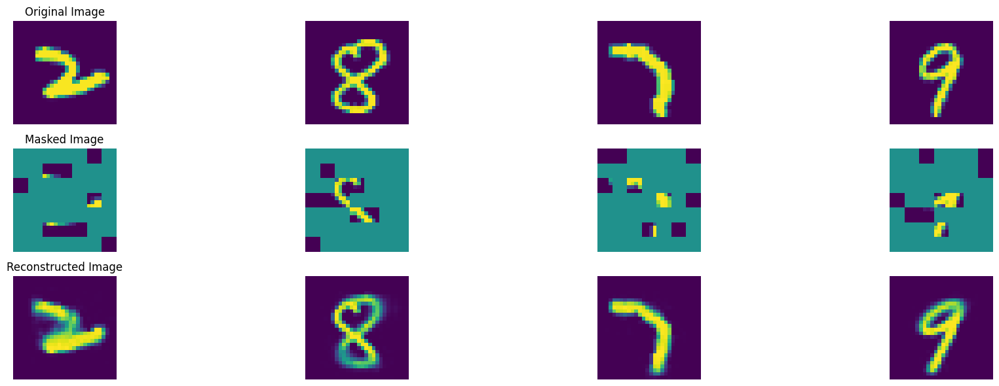

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 836, average traning loss is 0.0894686462397271.
=================== EPOCH:  837  ===================


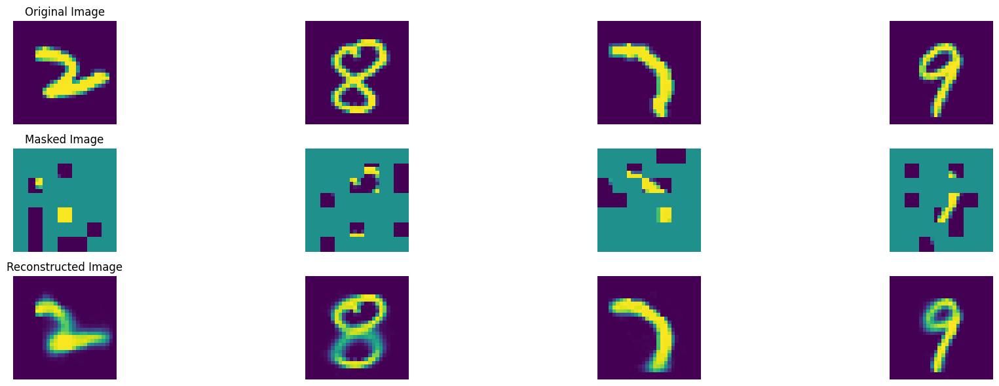

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 837, average traning loss is 0.08954456464407291.
=================== EPOCH:  838  ===================


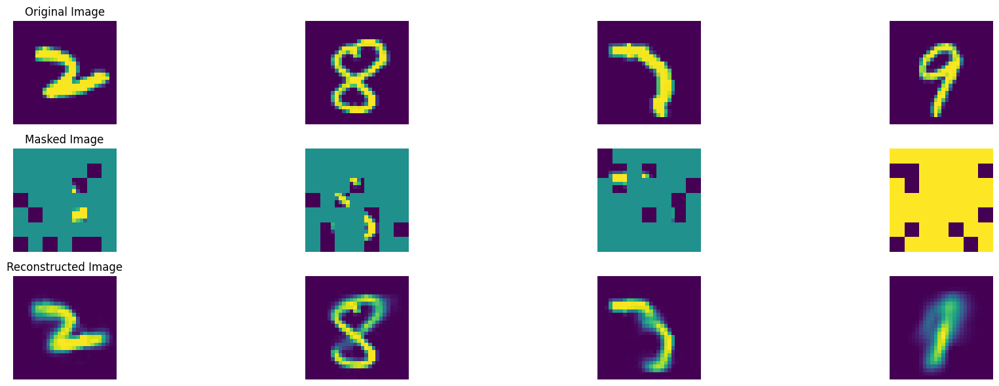

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 838, average traning loss is 0.08899799845320114.
=================== EPOCH:  839  ===================


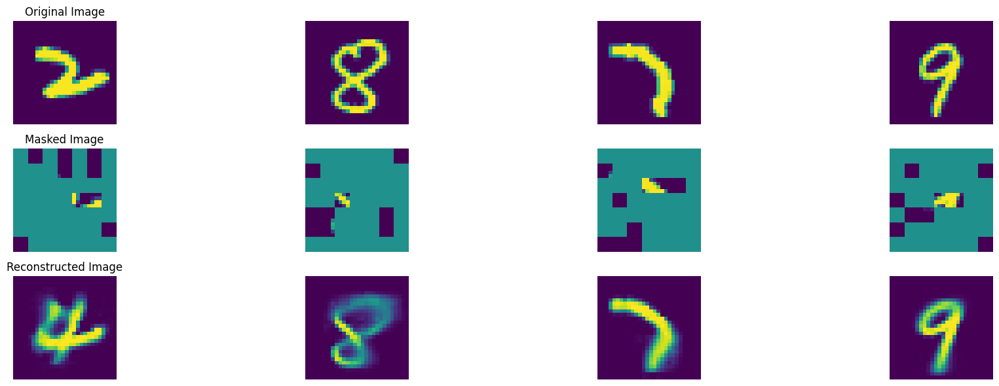

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 839, average traning loss is 0.08939283563101545.
=================== EPOCH:  840  ===================


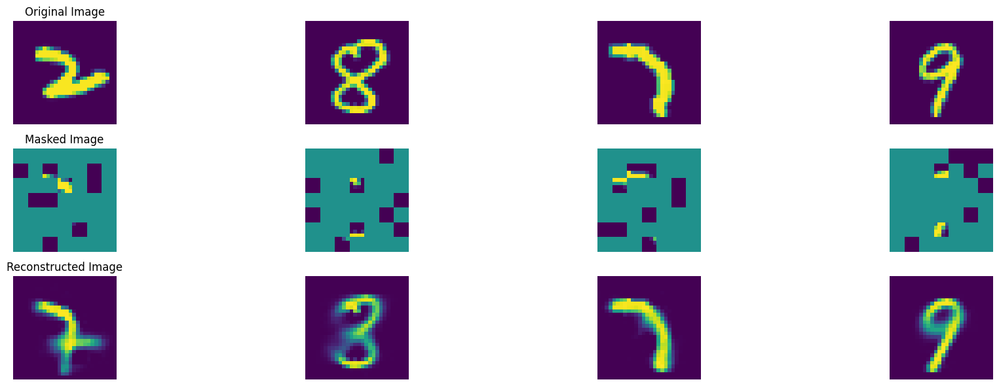

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 840, average traning loss is 0.08936044288442489.
=================== EPOCH:  841  ===================


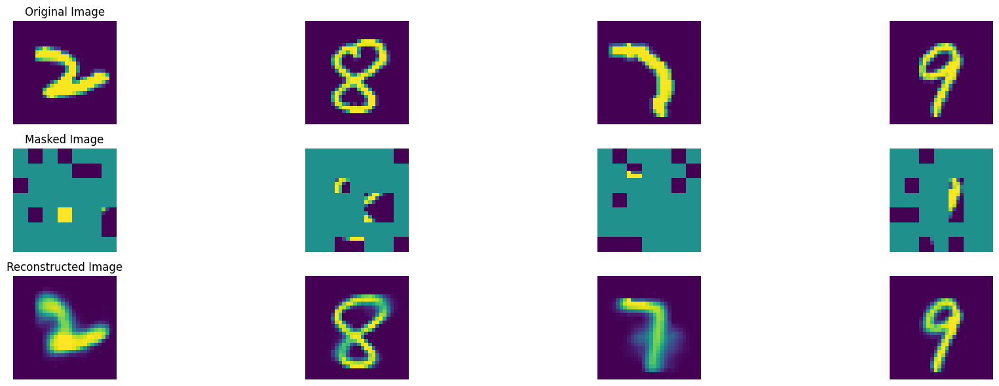

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 841, average traning loss is 0.08916848263841995.
=================== EPOCH:  842  ===================


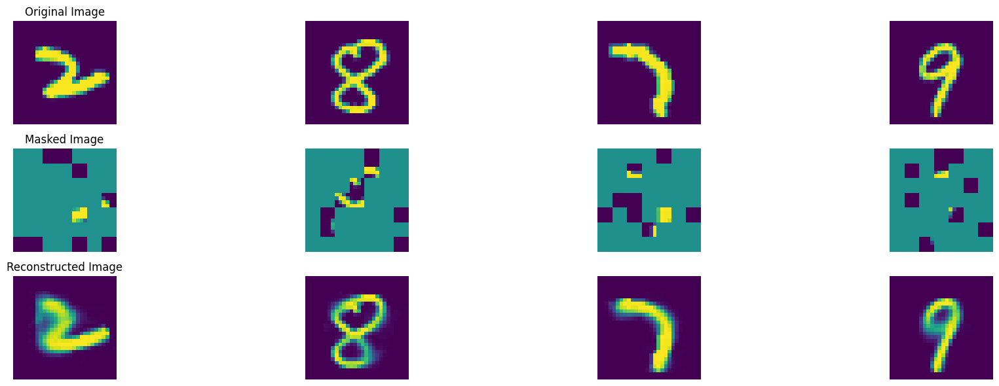

100%|██████████| 47/47 [00:09<00:00,  5.21it/s]


In epoch 842, average traning loss is 0.08918791327704774.
=================== EPOCH:  843  ===================


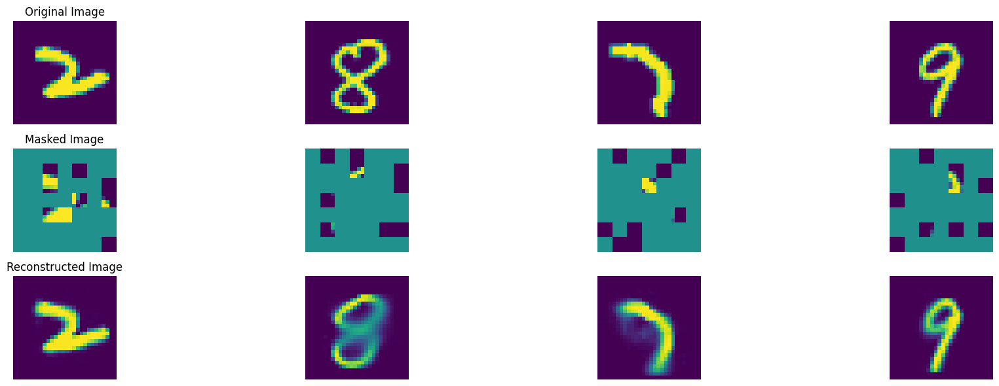

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 843, average traning loss is 0.08969343057338228.
=================== EPOCH:  844  ===================


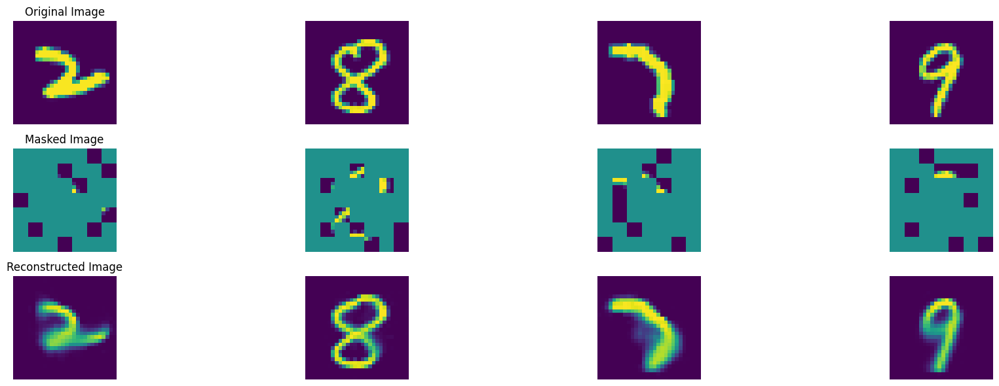

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 844, average traning loss is 0.08896045053892947.
=================== EPOCH:  845  ===================


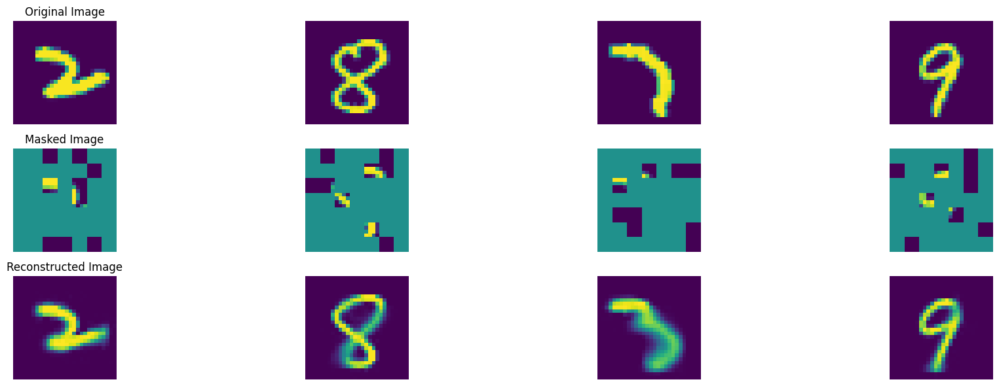

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 845, average traning loss is 0.08879314283741281.
=================== EPOCH:  846  ===================


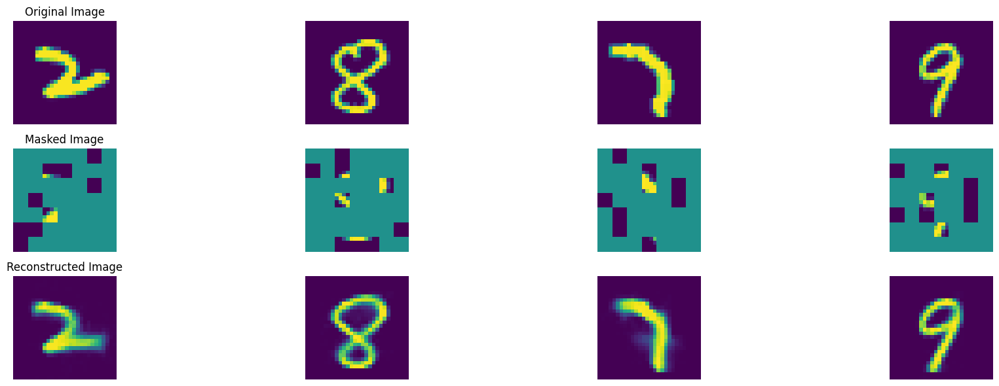

100%|██████████| 47/47 [00:08<00:00,  5.50it/s]


In epoch 846, average traning loss is 0.08943918062017318.
=================== EPOCH:  847  ===================


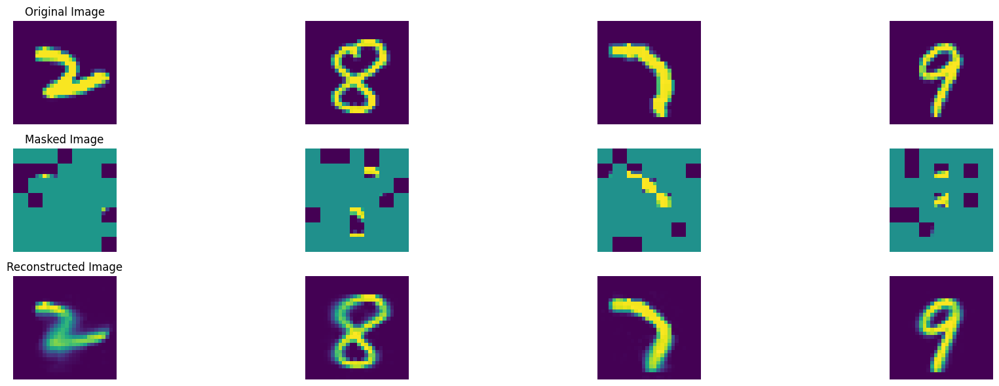

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 847, average traning loss is 0.08871324265256841.
=================== EPOCH:  848  ===================


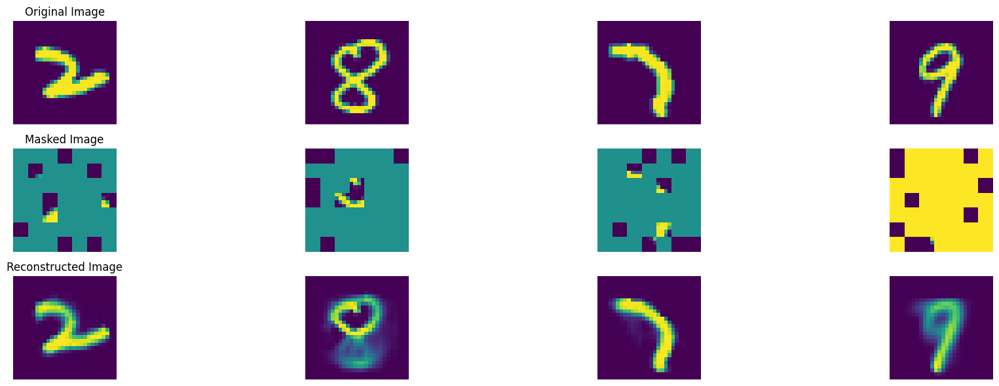

100%|██████████| 47/47 [00:09<00:00,  5.21it/s]


In epoch 848, average traning loss is 0.08918210737248684.
=================== EPOCH:  849  ===================


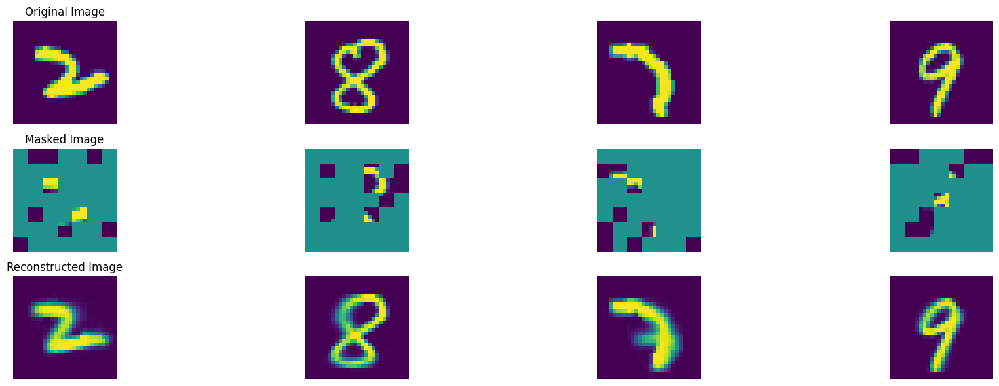

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 849, average traning loss is 0.08877382601829285.
=================== EPOCH:  850  ===================


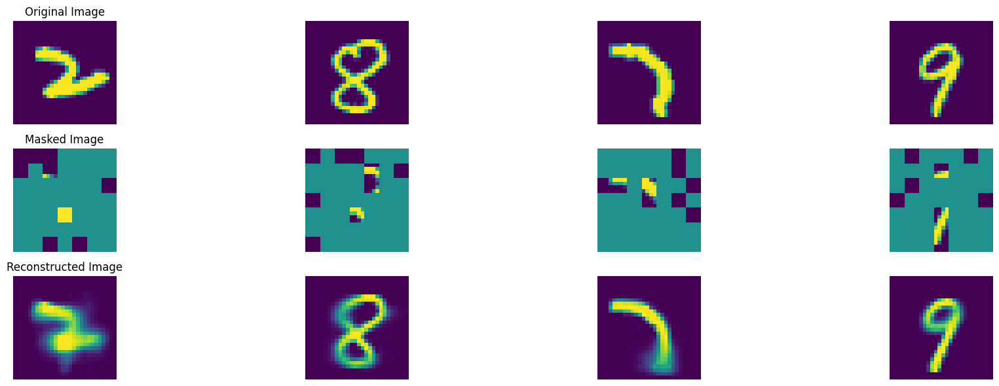

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 850, average traning loss is 0.08859317575363403.
=================== EPOCH:  851  ===================


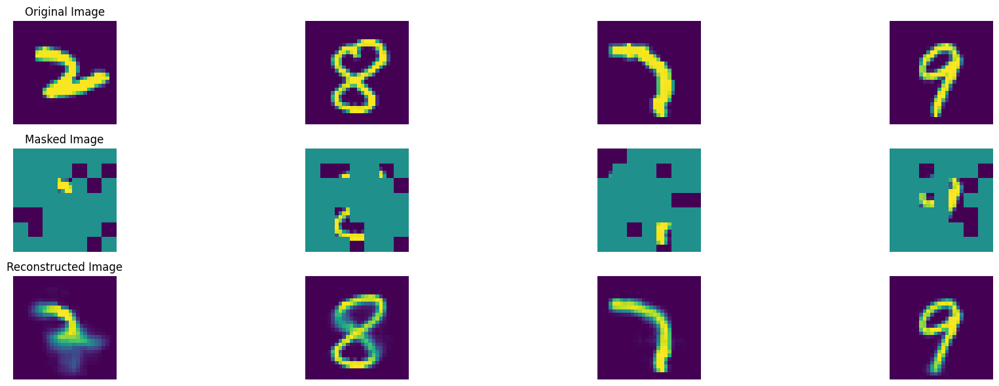

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 851, average traning loss is 0.08927467132502413.
=================== EPOCH:  852  ===================


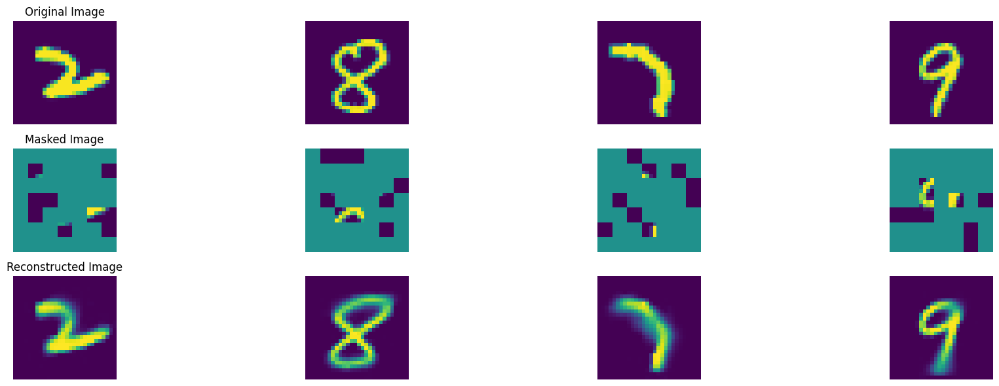

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 852, average traning loss is 0.08873076356471853.
=================== EPOCH:  853  ===================


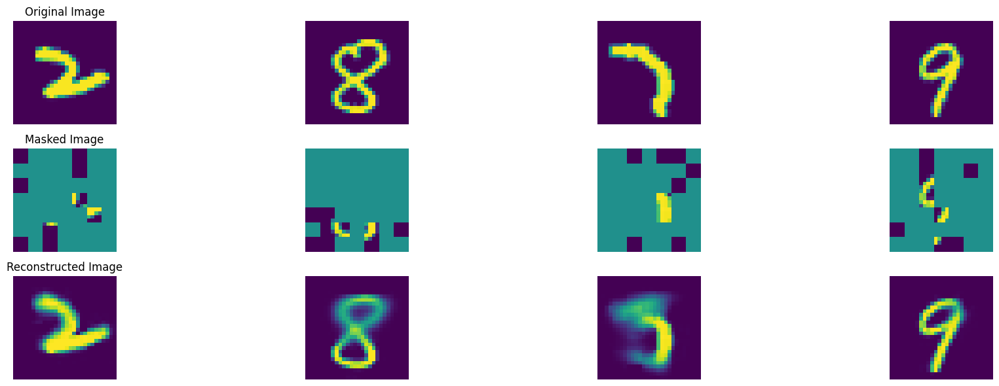

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 853, average traning loss is 0.08878511428198915.
=================== EPOCH:  854  ===================


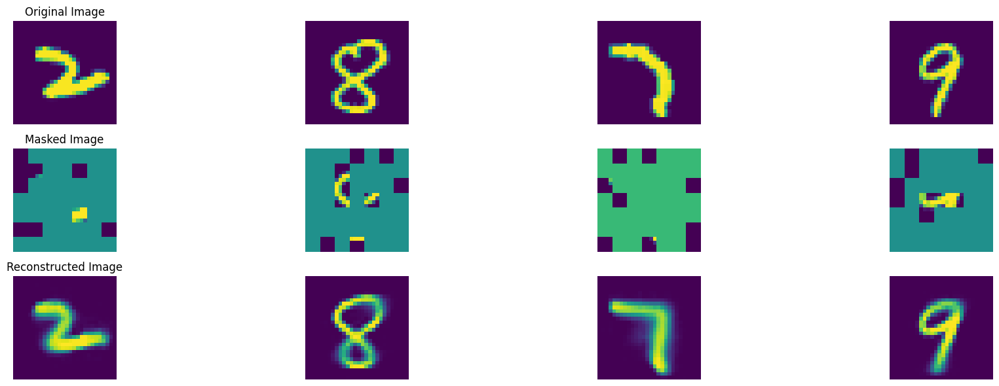

100%|██████████| 47/47 [00:09<00:00,  5.05it/s]


In epoch 854, average traning loss is 0.08866839903466245.
=================== EPOCH:  855  ===================


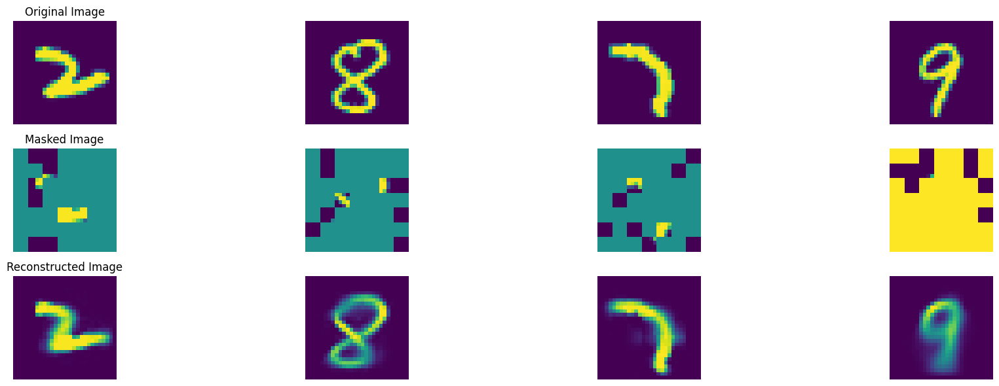

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 855, average traning loss is 0.0889809878265604.
=================== EPOCH:  856  ===================


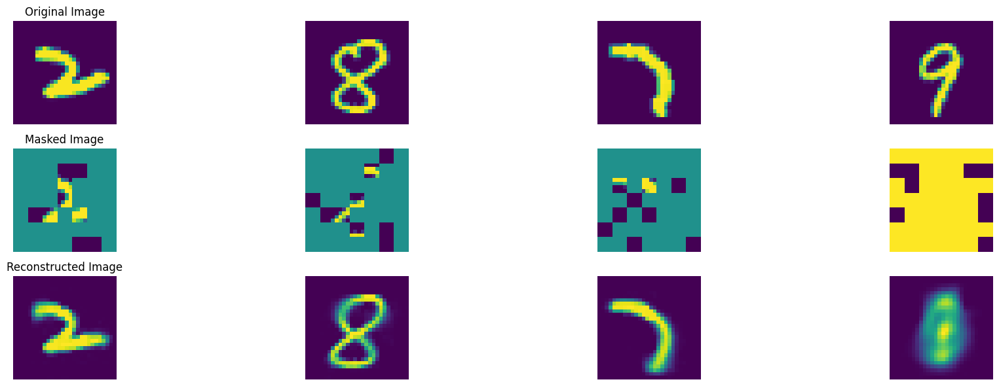

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 856, average traning loss is 0.08877361232930041.
=================== EPOCH:  857  ===================


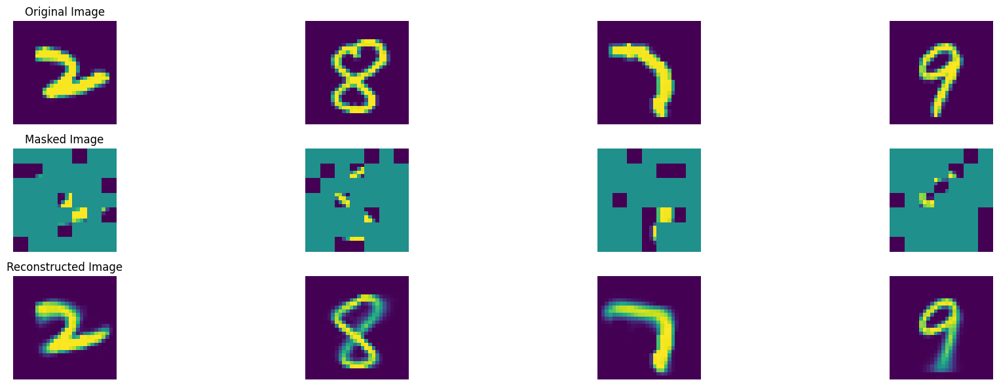

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 857, average traning loss is 0.08866209948950625.
=================== EPOCH:  858  ===================


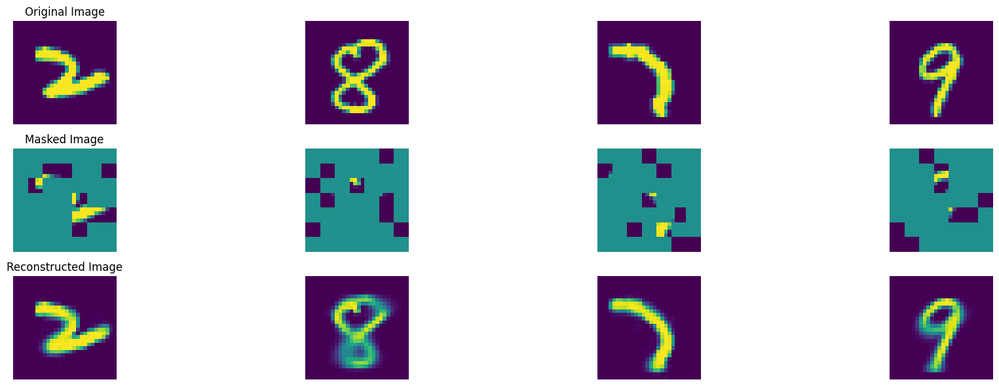

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 858, average traning loss is 0.08859709539311997.
=================== EPOCH:  859  ===================


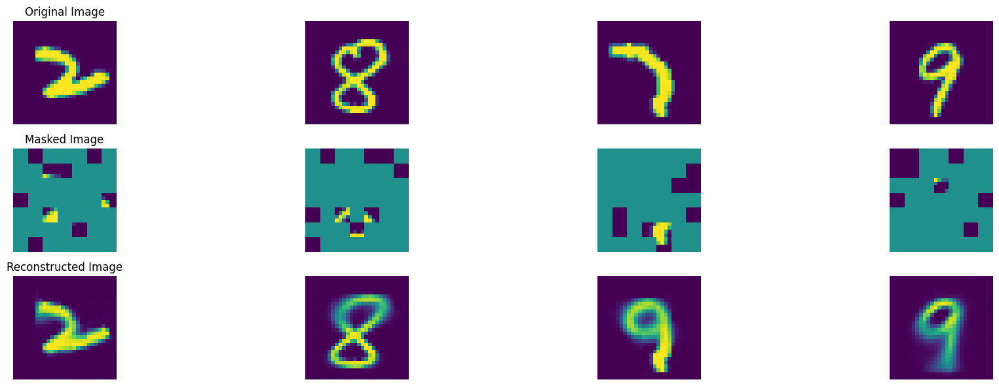

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 859, average traning loss is 0.08841109053885683.
=================== EPOCH:  860  ===================


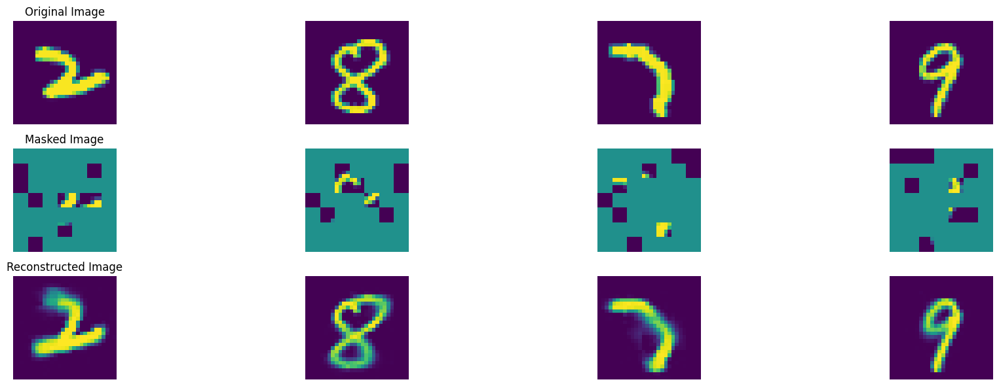

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 860, average traning loss is 0.08849186862402773.
=================== EPOCH:  861  ===================


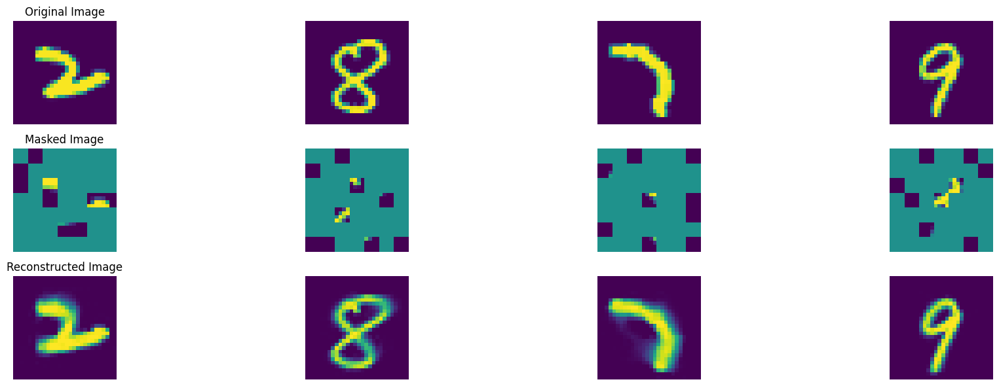

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 861, average traning loss is 0.08877627694226325.
=================== EPOCH:  862  ===================


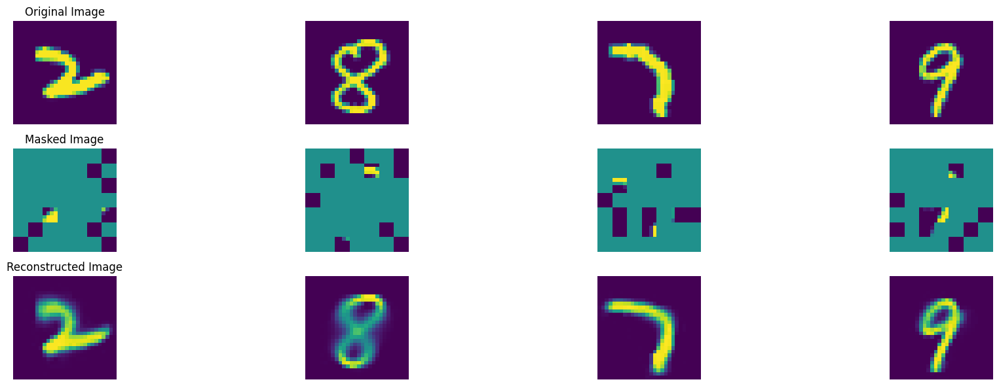

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 862, average traning loss is 0.088855135789577.
=================== EPOCH:  863  ===================


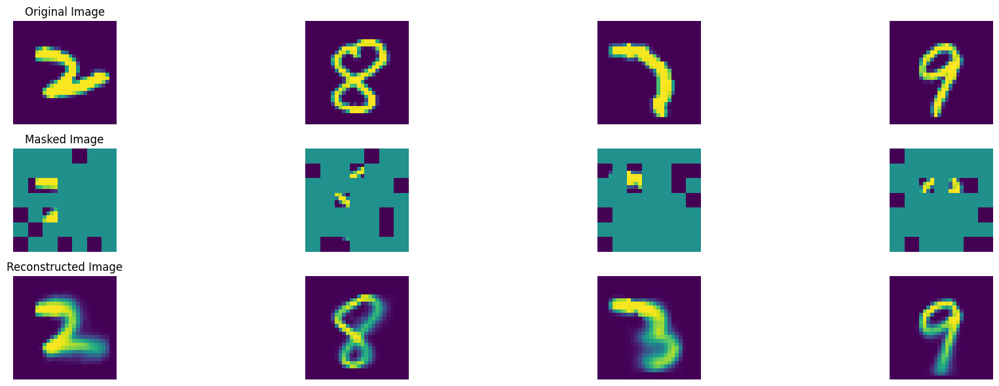

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 863, average traning loss is 0.08880138745967378.
=================== EPOCH:  864  ===================


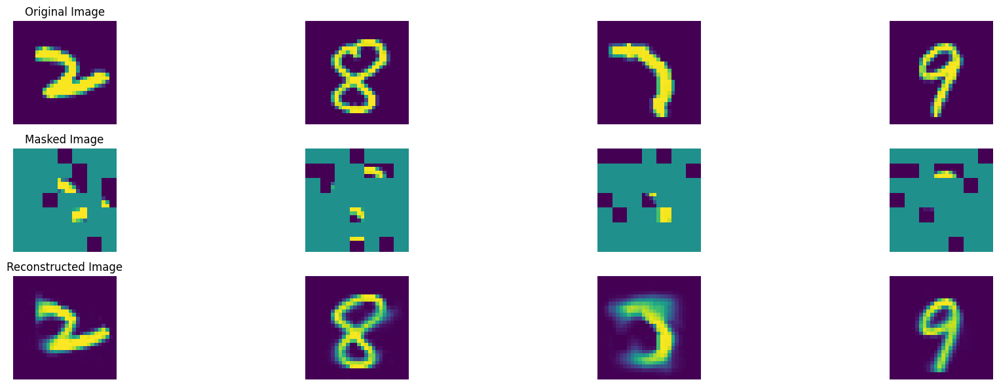

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 864, average traning loss is 0.08876780975372234.
=================== EPOCH:  865  ===================


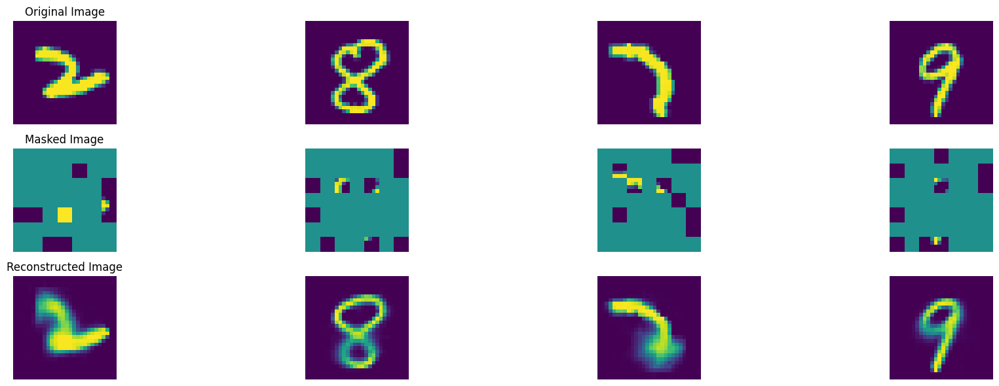

100%|██████████| 47/47 [00:08<00:00,  5.50it/s]


In epoch 865, average traning loss is 0.08829158988404781.
=================== EPOCH:  866  ===================


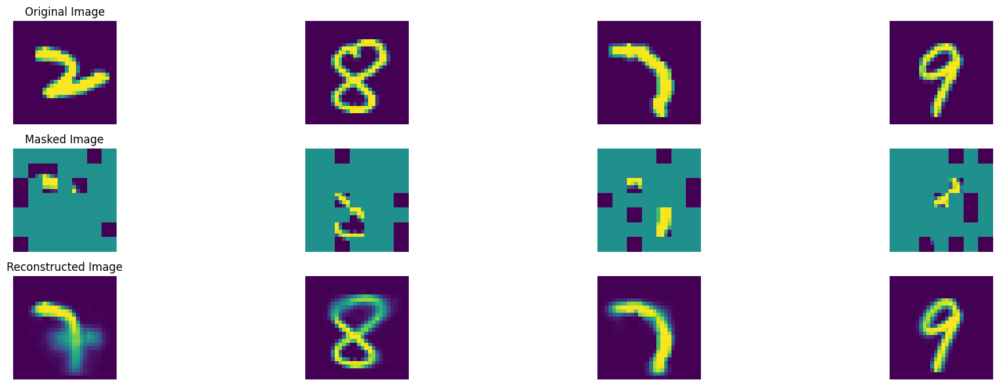

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 866, average traning loss is 0.088573767625271.
=================== EPOCH:  867  ===================


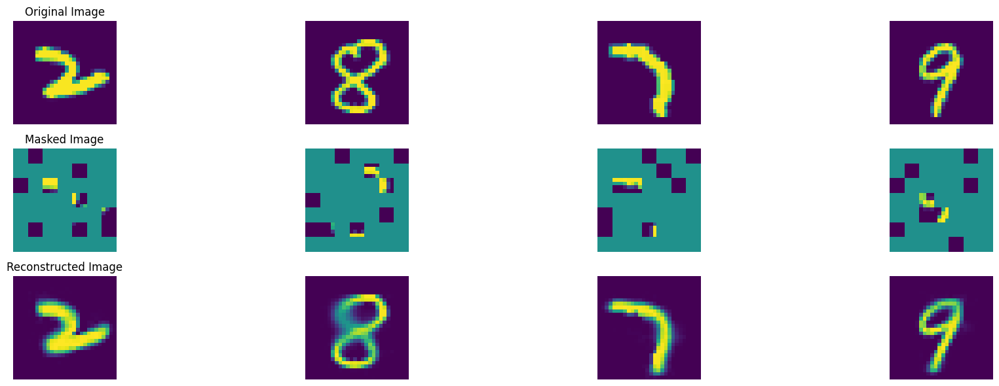

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 867, average traning loss is 0.08850463923621685.
=================== EPOCH:  868  ===================


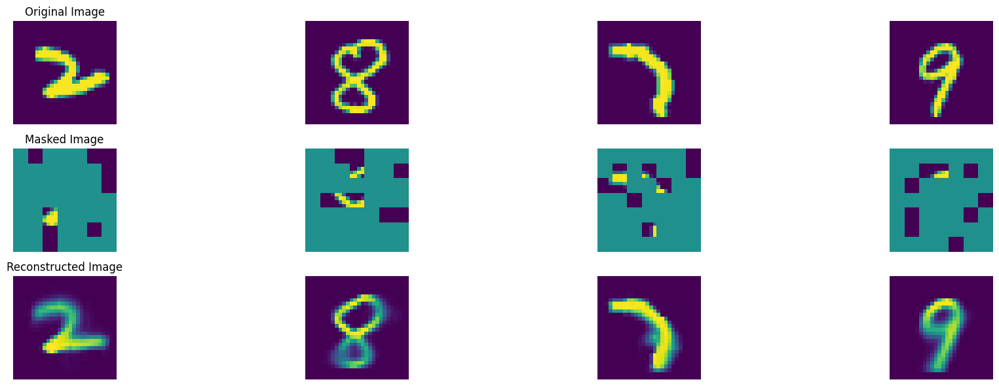

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 868, average traning loss is 0.0890057291439239.
=================== EPOCH:  869  ===================


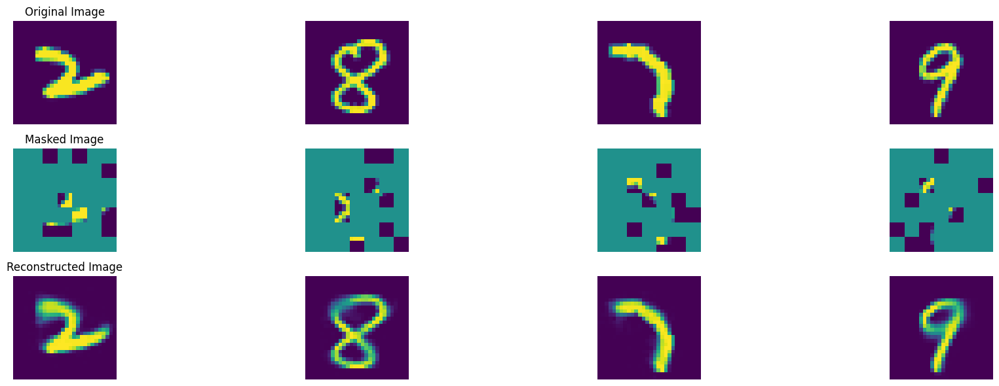

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 869, average traning loss is 0.08861049550010804.
=================== EPOCH:  870  ===================


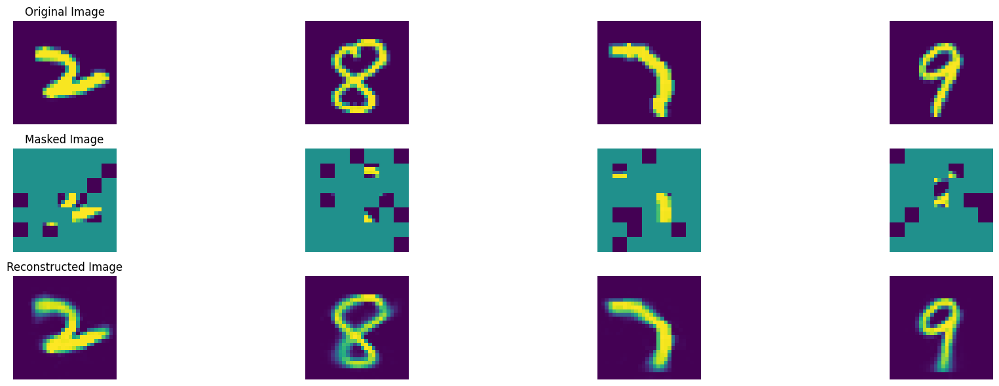

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 870, average traning loss is 0.088518647595923.
=================== EPOCH:  871  ===================


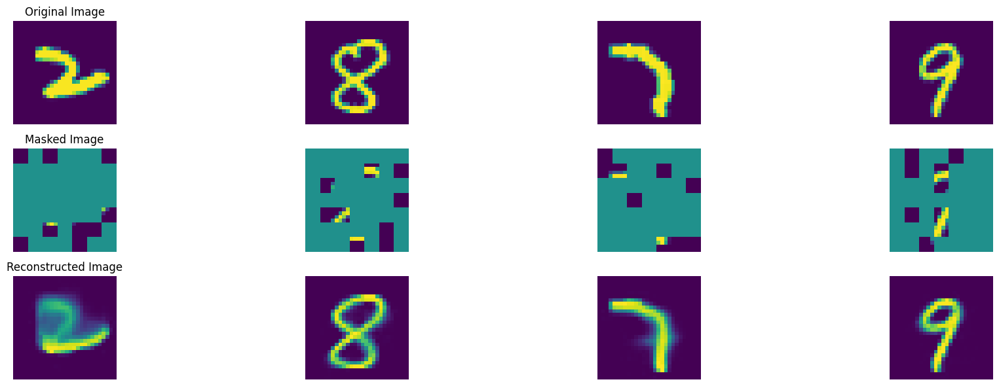

100%|██████████| 47/47 [00:08<00:00,  5.52it/s]


In epoch 871, average traning loss is 0.08832533847778401.
=================== EPOCH:  872  ===================


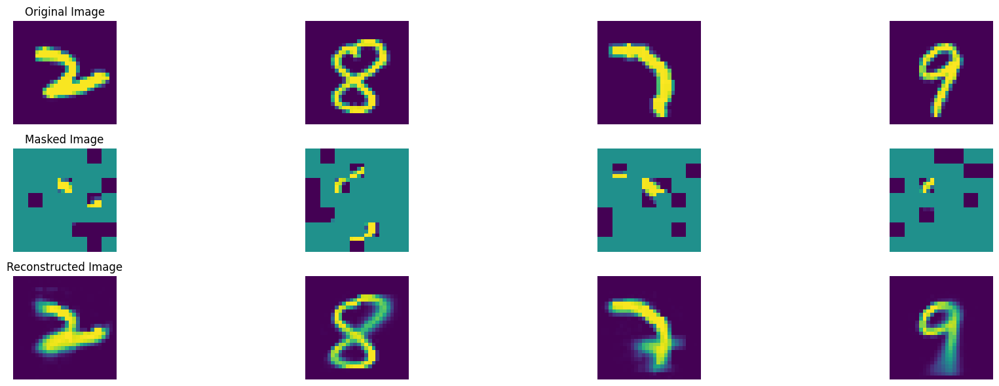

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 872, average traning loss is 0.08877493869116966.
=================== EPOCH:  873  ===================


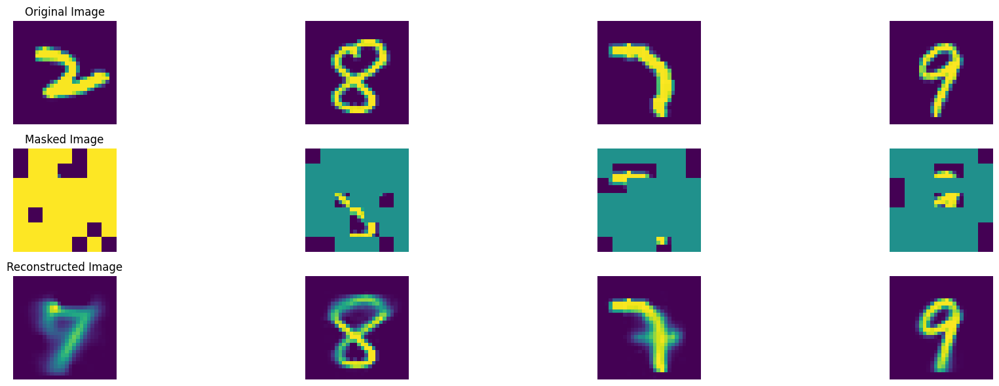

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 873, average traning loss is 0.08864724937271565.
=================== EPOCH:  874  ===================


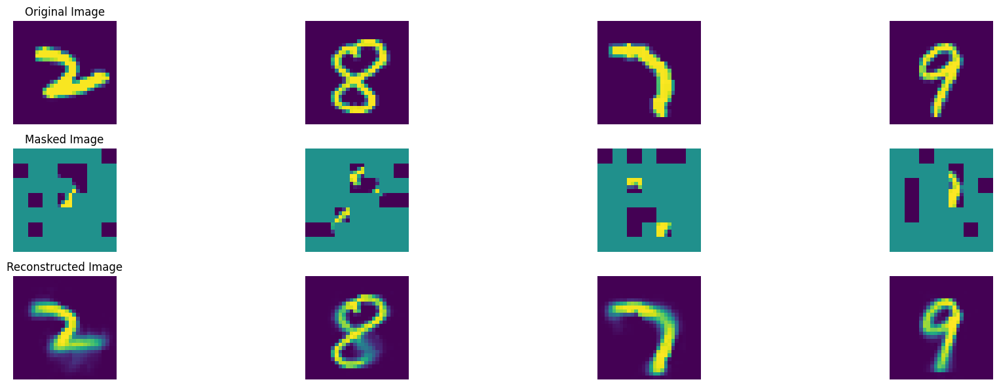

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 874, average traning loss is 0.08831715599653568.
=================== EPOCH:  875  ===================


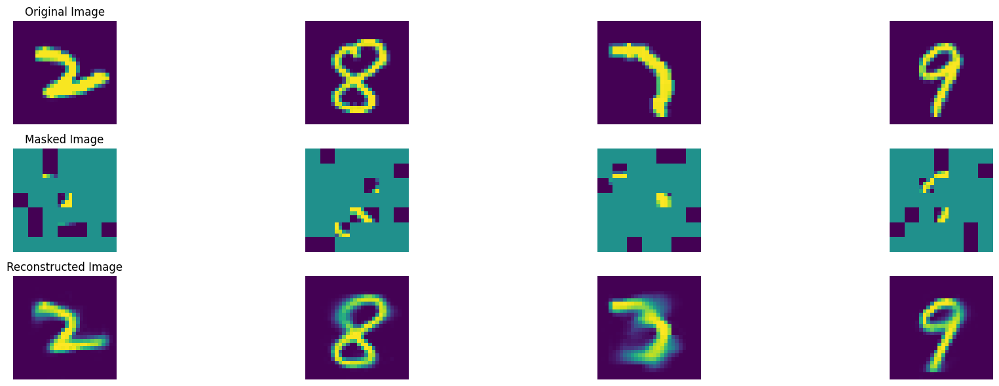

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 875, average traning loss is 0.08841349739343562.
=================== EPOCH:  876  ===================


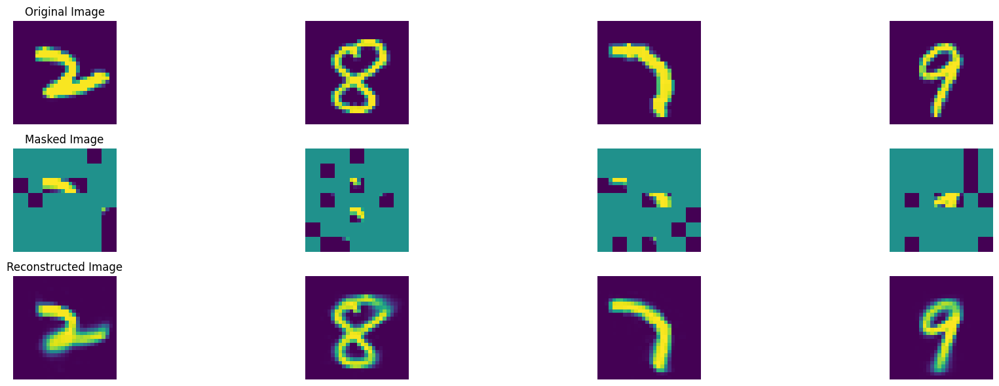

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 876, average traning loss is 0.08828399520605168.
=================== EPOCH:  877  ===================


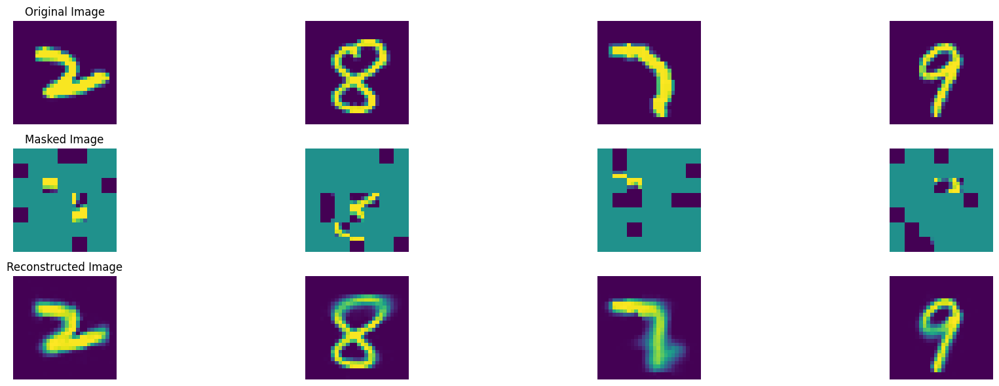

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 877, average traning loss is 0.08865080203147645.
=================== EPOCH:  878  ===================


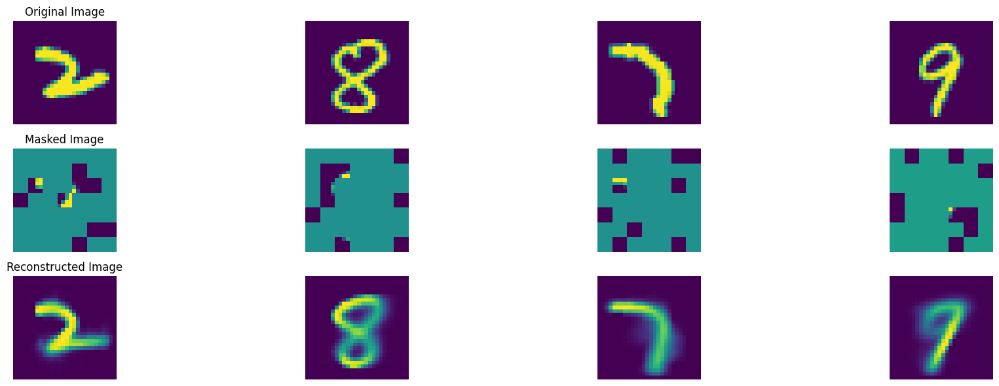

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 878, average traning loss is 0.08843114670920879.
=================== EPOCH:  879  ===================


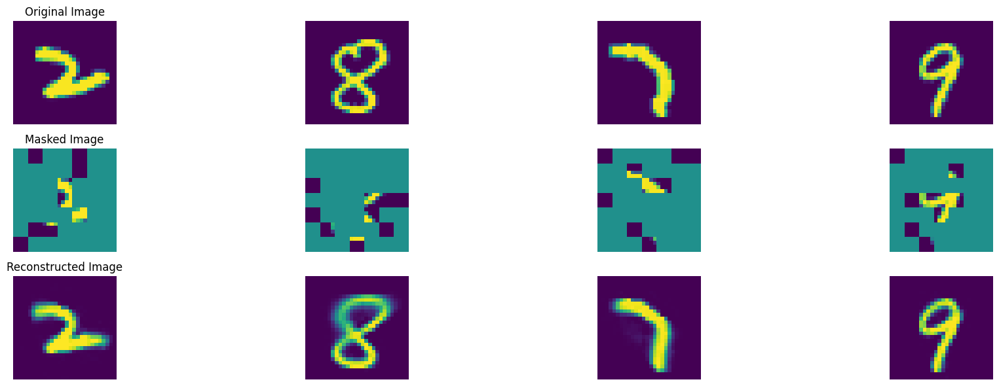

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 879, average traning loss is 0.08844980724314426.
=================== EPOCH:  880  ===================


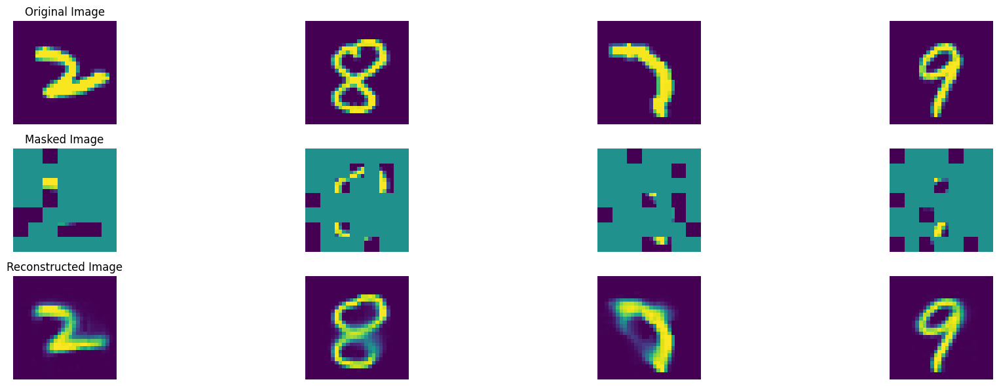

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 880, average traning loss is 0.08841178597922021.
=================== EPOCH:  881  ===================


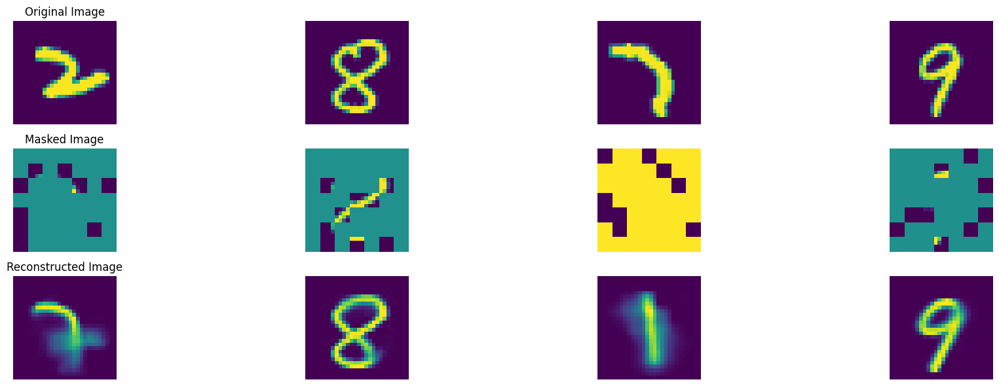

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 881, average traning loss is 0.08821209504249249.
=================== EPOCH:  882  ===================


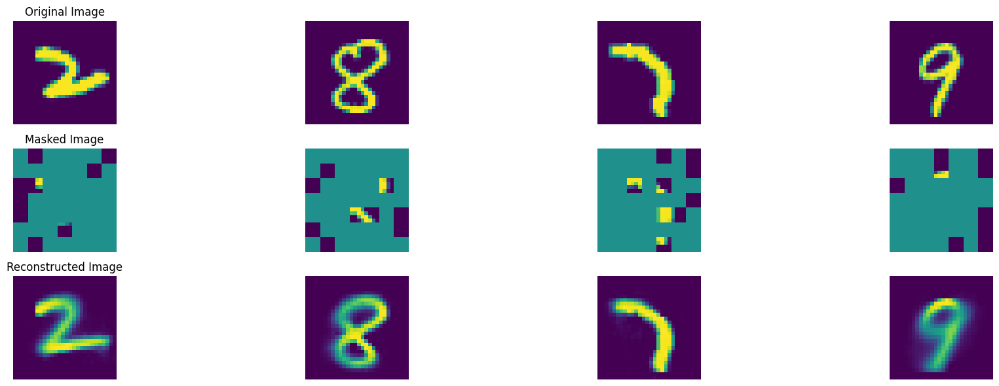

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 882, average traning loss is 0.08830180700789107.
=================== EPOCH:  883  ===================


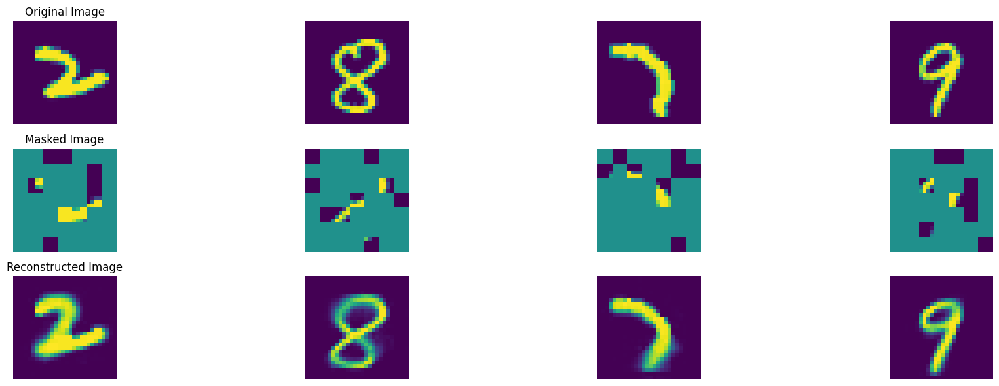

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 883, average traning loss is 0.08849228760029407.
=================== EPOCH:  884  ===================


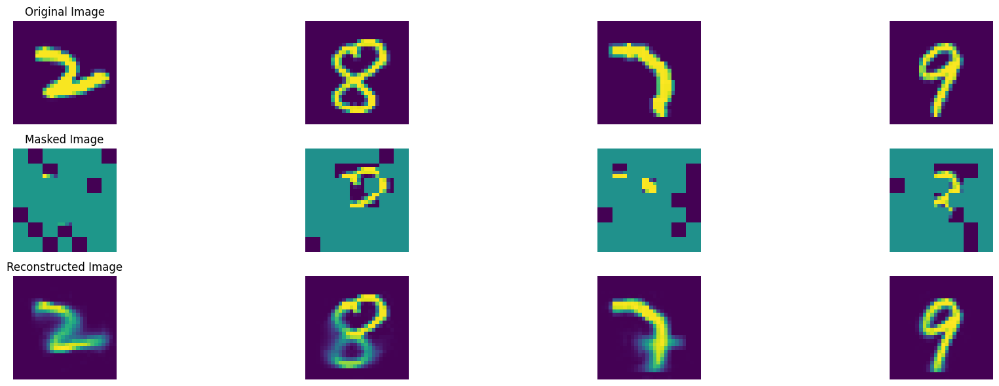

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 884, average traning loss is 0.08778204499407018.
=================== EPOCH:  885  ===================


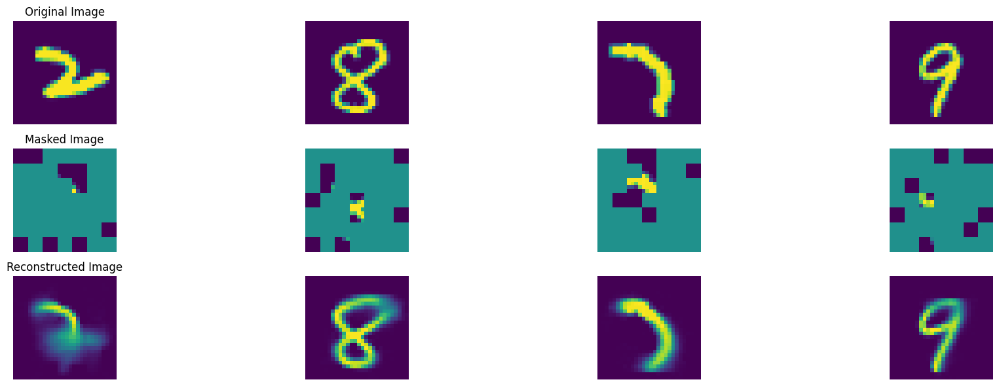

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 885, average traning loss is 0.08848957210145098.
=================== EPOCH:  886  ===================


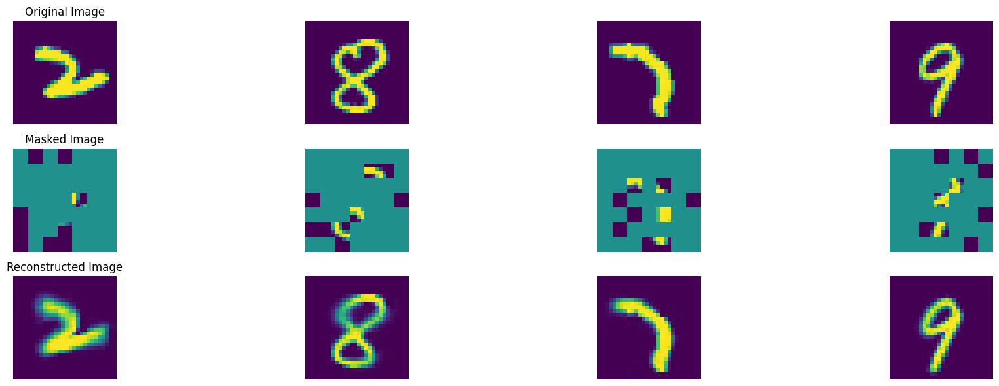

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 886, average traning loss is 0.08831802581218963.
=================== EPOCH:  887  ===================


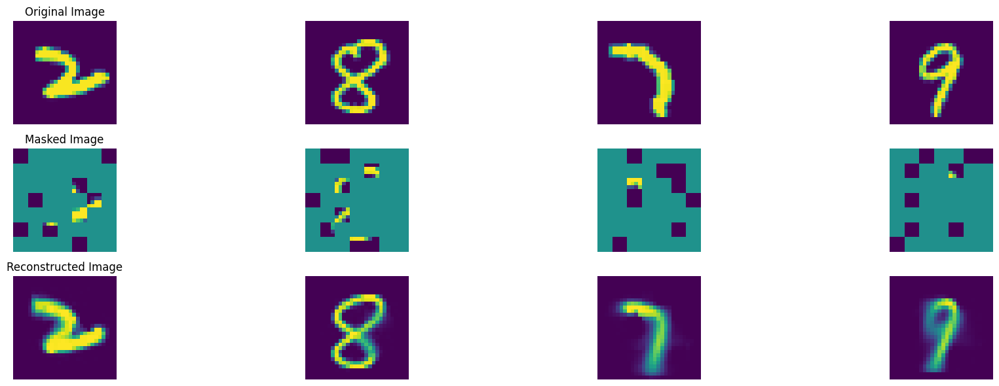

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 887, average traning loss is 0.0881207750198689.
=================== EPOCH:  888  ===================


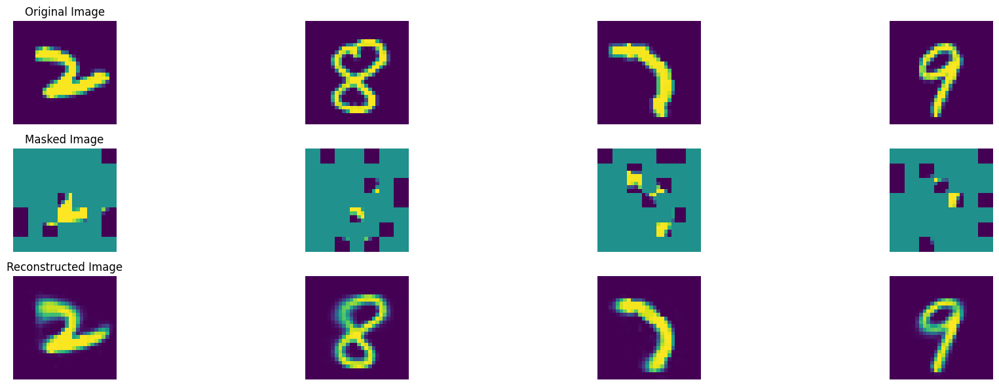

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 888, average traning loss is 0.08875270282968561.
=================== EPOCH:  889  ===================


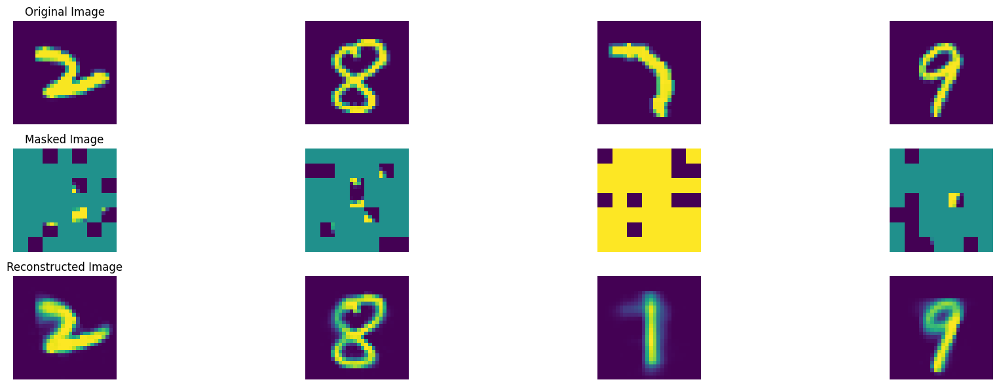

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 889, average traning loss is 0.08780440846656232.
=================== EPOCH:  890  ===================


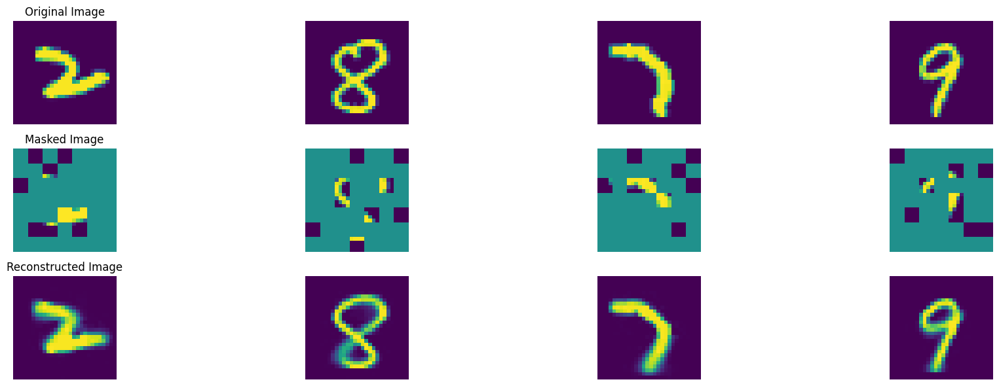

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 890, average traning loss is 0.08889419553761786.
=================== EPOCH:  891  ===================


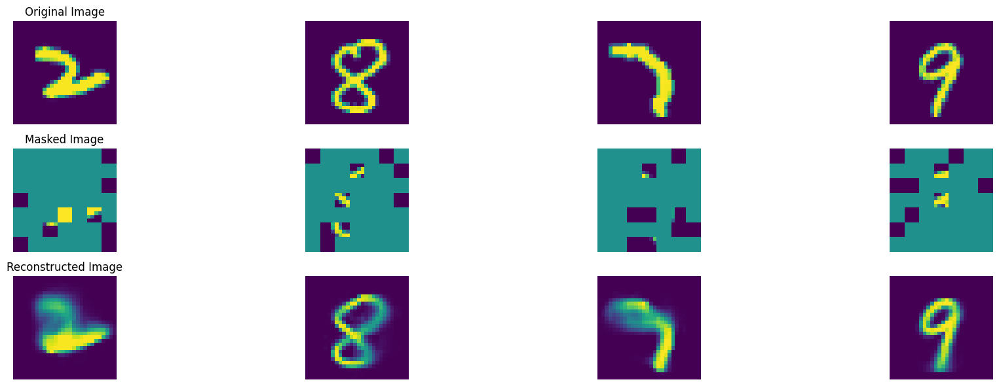

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 891, average traning loss is 0.08850116409519886.
=================== EPOCH:  892  ===================


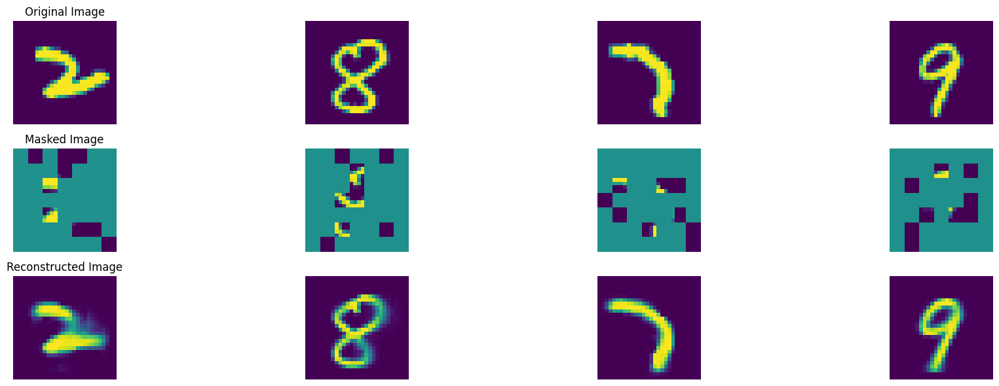

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 892, average traning loss is 0.08806932765118619.
=================== EPOCH:  893  ===================


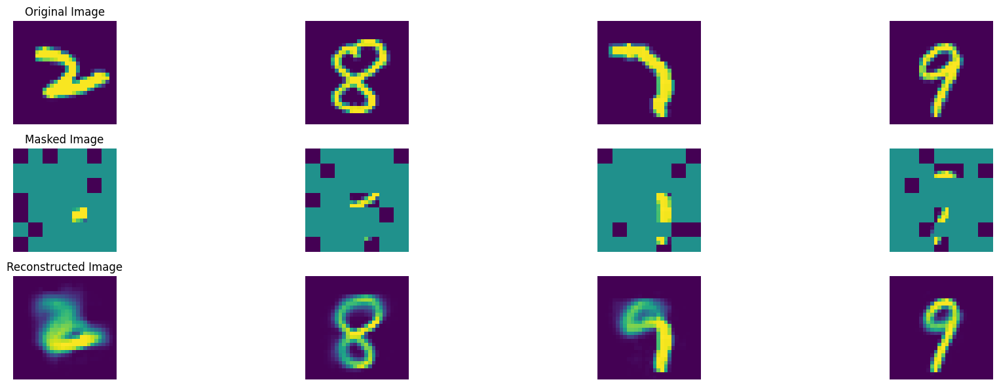

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 893, average traning loss is 0.08867672989343076.
=================== EPOCH:  894  ===================


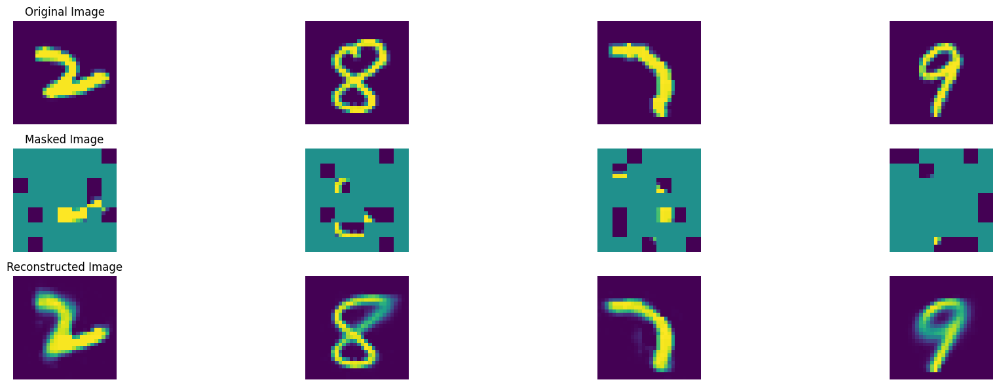

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 894, average traning loss is 0.08809247803180775.
=================== EPOCH:  895  ===================


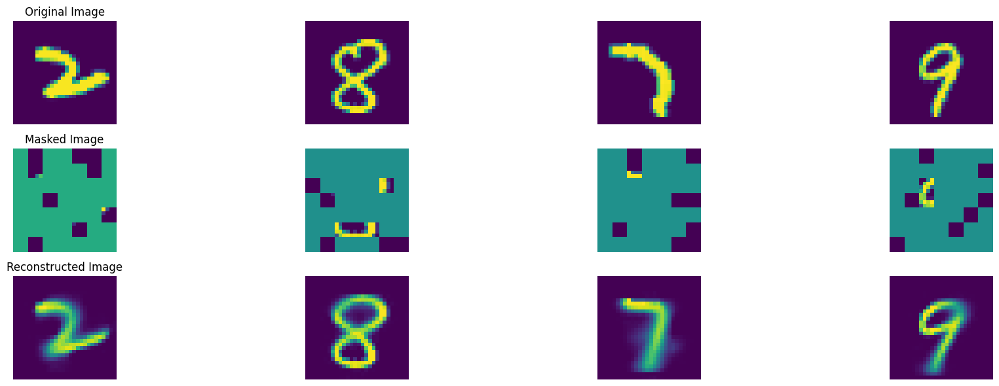

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 895, average traning loss is 0.08797085887574135.
=================== EPOCH:  896  ===================


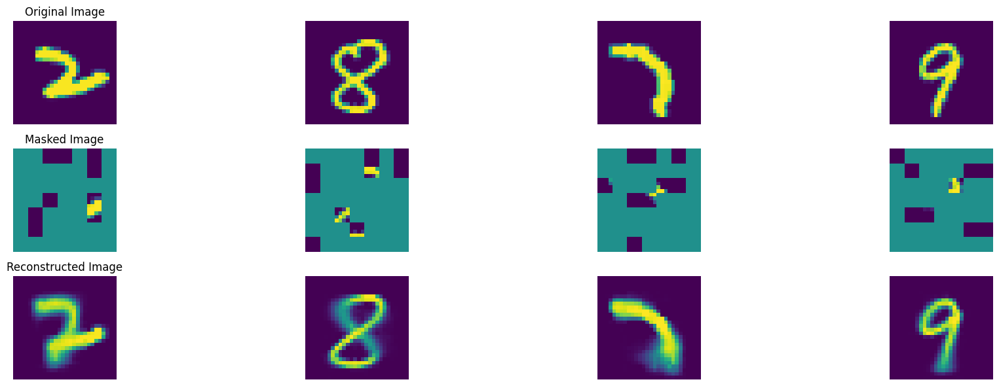

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 896, average traning loss is 0.08785678795043458.
=================== EPOCH:  897  ===================


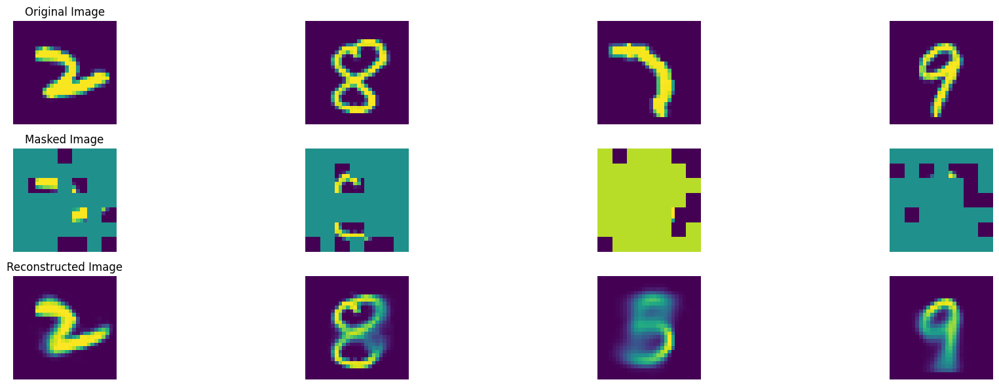

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 897, average traning loss is 0.08817887607407063.
=================== EPOCH:  898  ===================


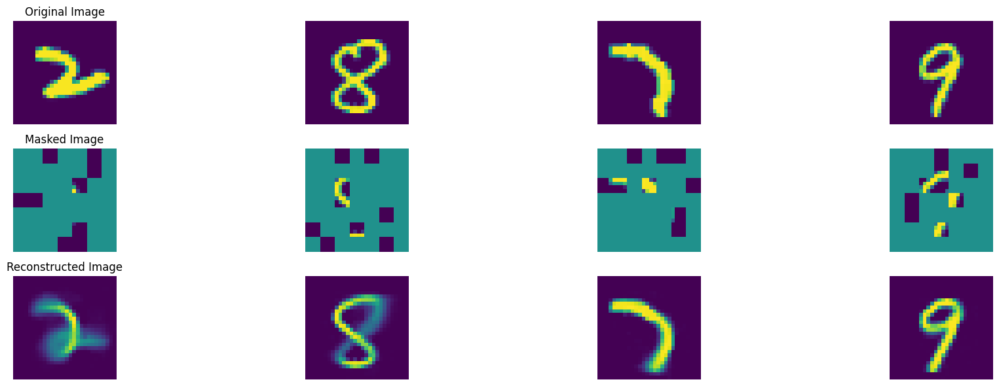

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 898, average traning loss is 0.08811670319831118.
=================== EPOCH:  899  ===================


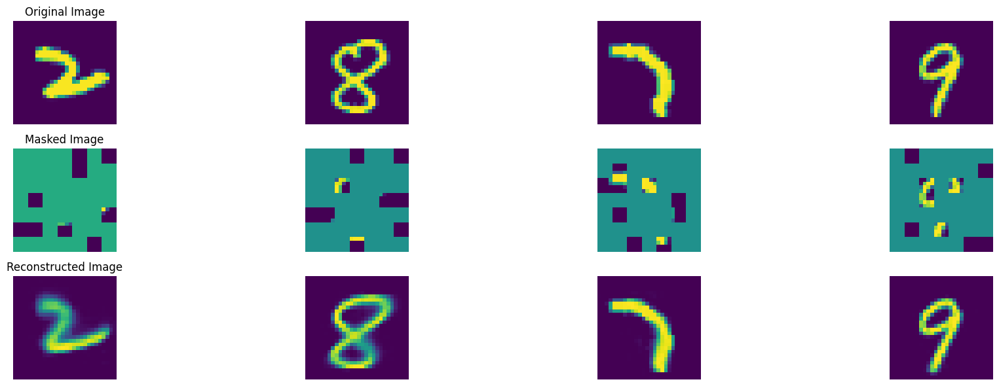

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 899, average traning loss is 0.08853980565958834.
=================== EPOCH:  900  ===================


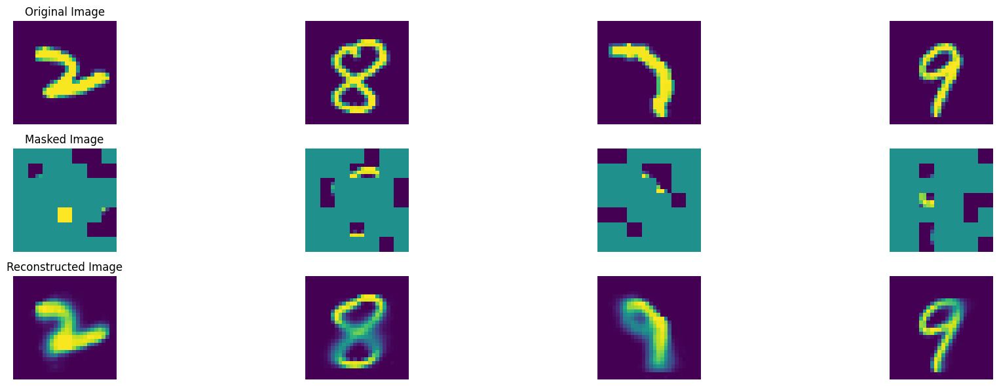

100%|██████████| 47/47 [00:08<00:00,  5.33it/s]


In epoch 900, average traning loss is 0.08804167220567136.
=================== EPOCH:  901  ===================


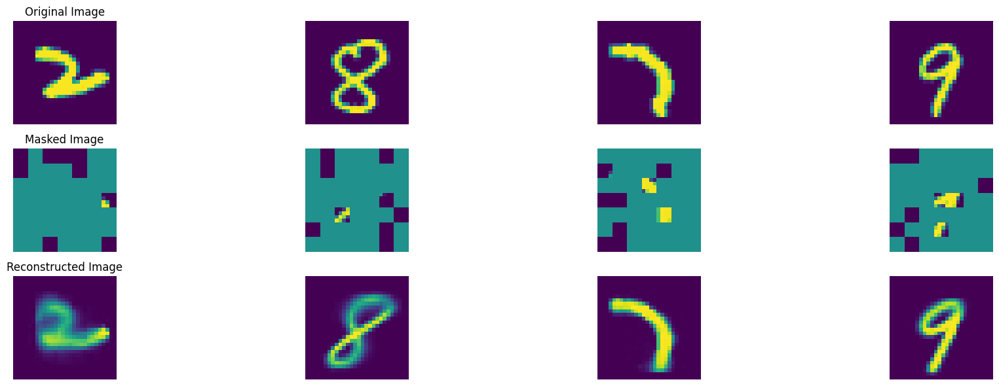

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 901, average traning loss is 0.0880489152796725.
=================== EPOCH:  902  ===================


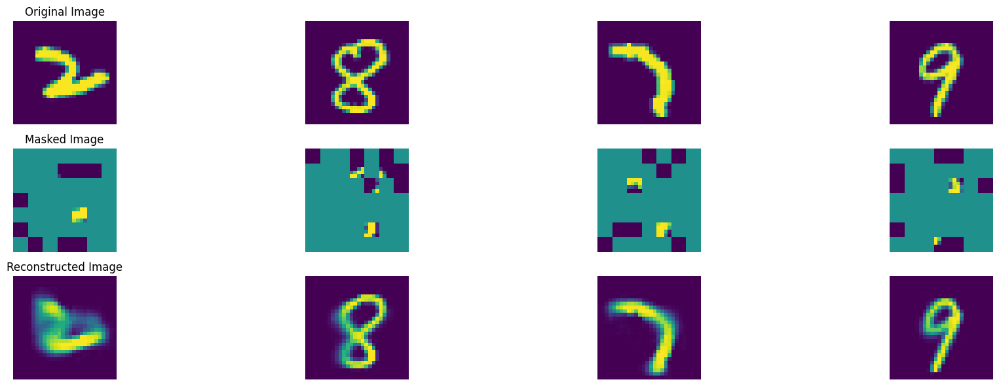

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 902, average traning loss is 0.08857447733270361.
=================== EPOCH:  903  ===================


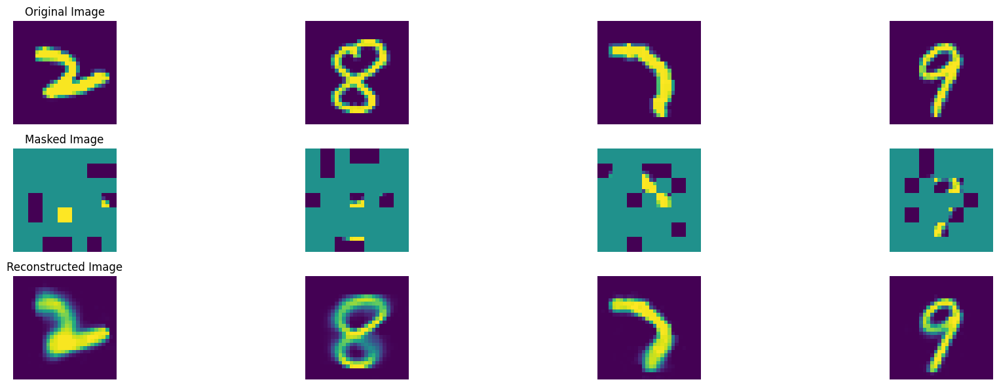

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 903, average traning loss is 0.08781060259392921.
=================== EPOCH:  904  ===================


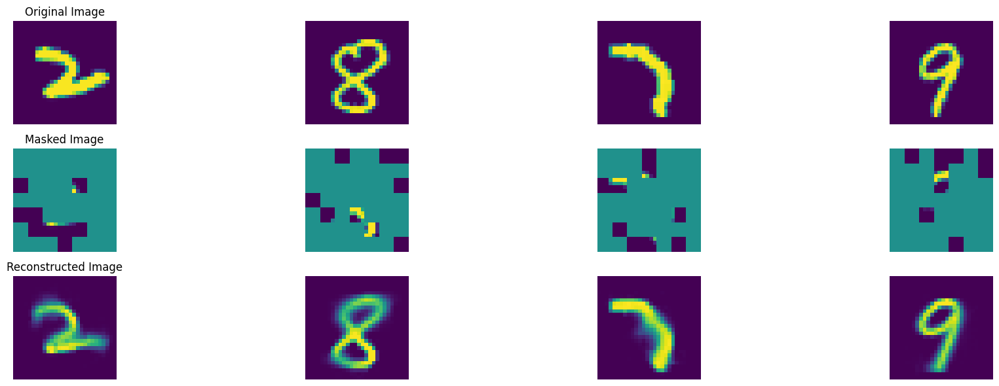

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 904, average traning loss is 0.08817316021056885.
=================== EPOCH:  905  ===================


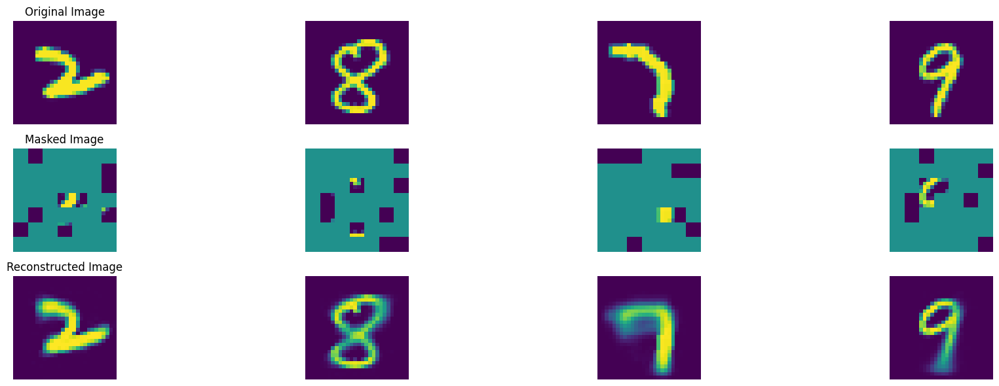

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 905, average traning loss is 0.08818337463952125.
=================== EPOCH:  906  ===================


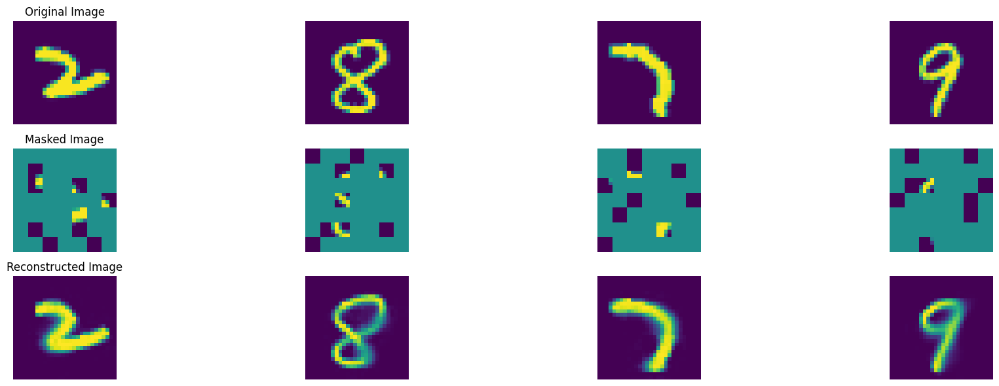

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 906, average traning loss is 0.08800374019019147.
=================== EPOCH:  907  ===================


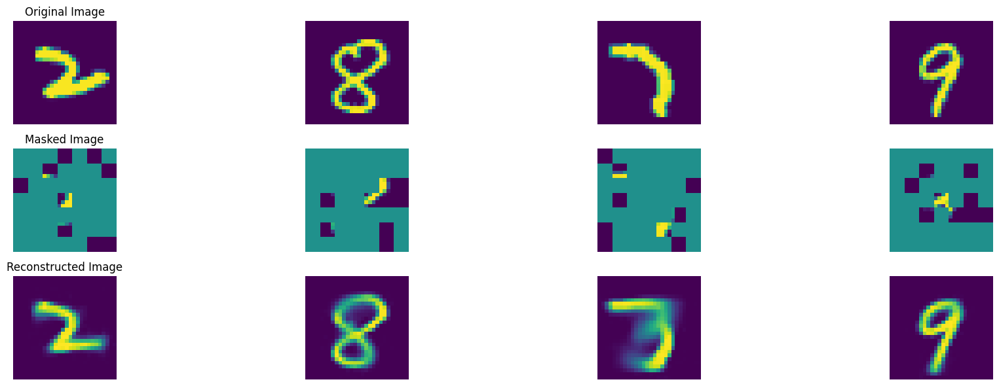

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 907, average traning loss is 0.08845149170845112.
=================== EPOCH:  908  ===================


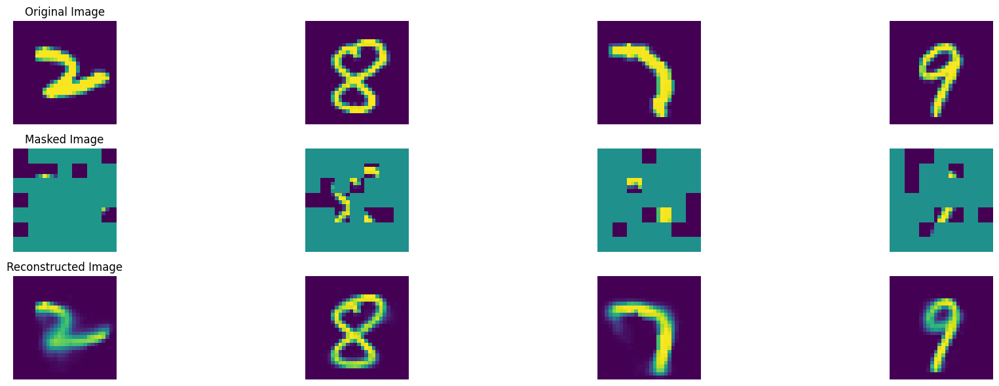

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 908, average traning loss is 0.08795932712073022.
=================== EPOCH:  909  ===================


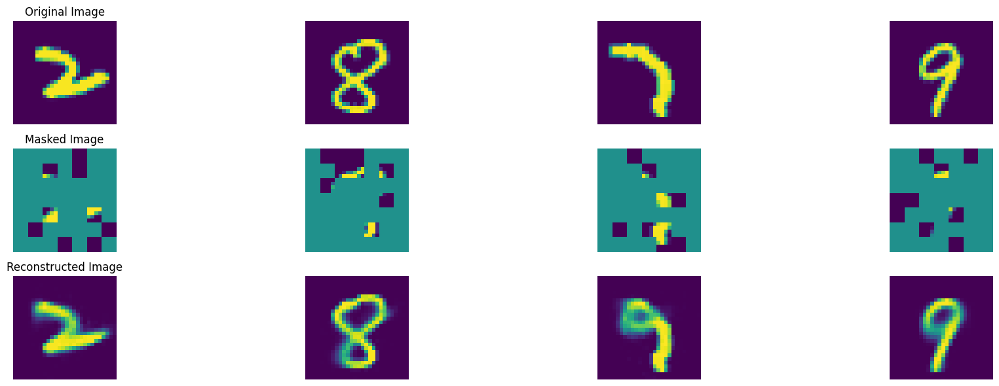

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 909, average traning loss is 0.08790804081140681.
=================== EPOCH:  910  ===================


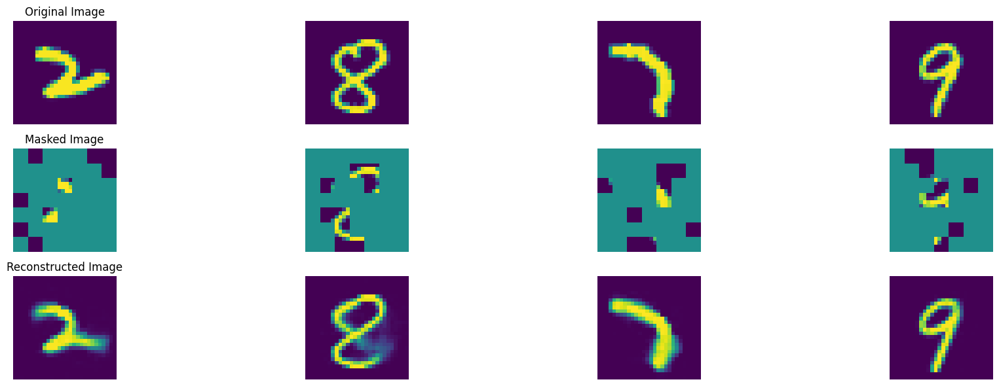

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 910, average traning loss is 0.08791152593937326.
=================== EPOCH:  911  ===================


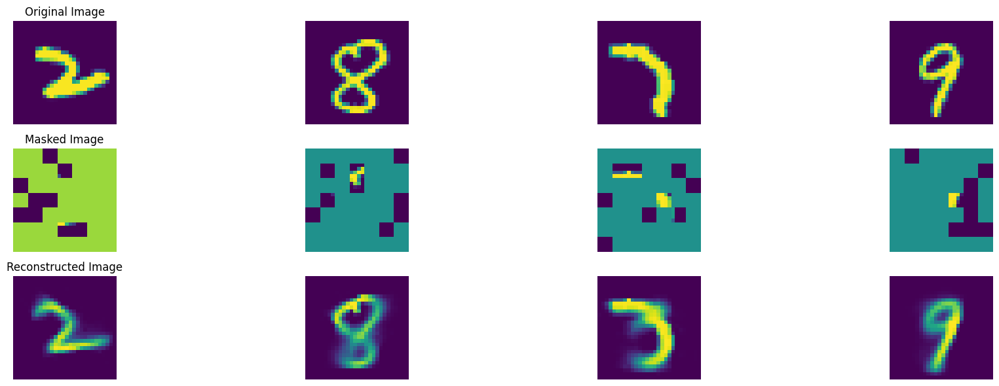

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 911, average traning loss is 0.0881154586343055.
=================== EPOCH:  912  ===================


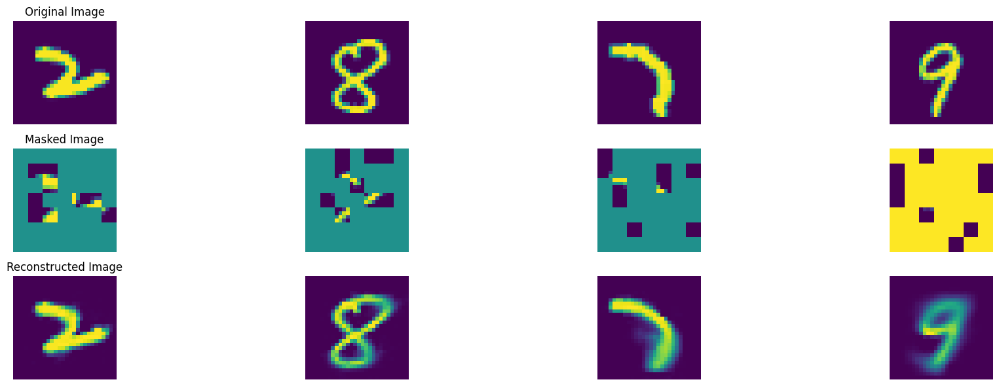

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 912, average traning loss is 0.08813705453847318.
=================== EPOCH:  913  ===================


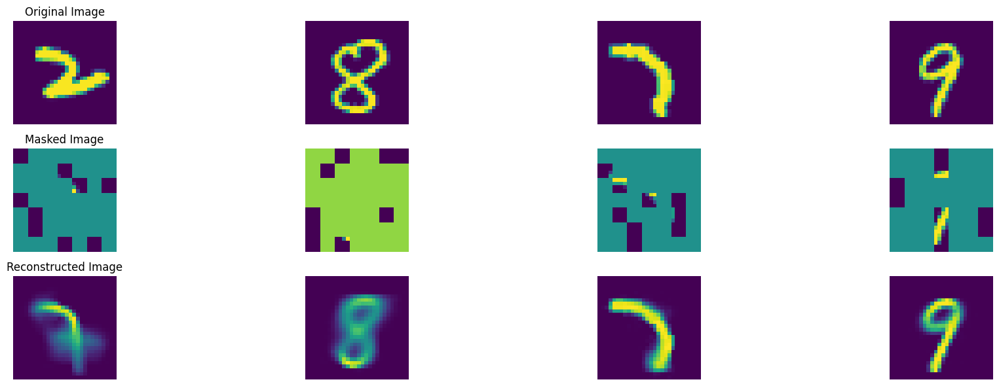

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 913, average traning loss is 0.0875646194561999.
=================== EPOCH:  914  ===================


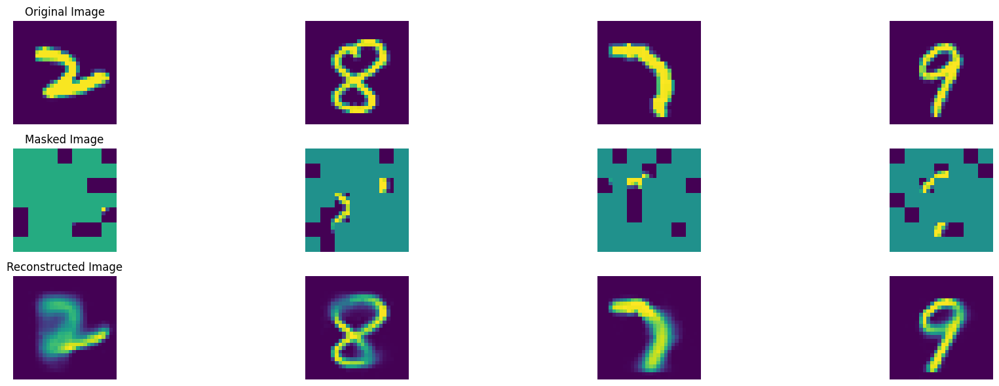

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 914, average traning loss is 0.08799239327298834.
=================== EPOCH:  915  ===================


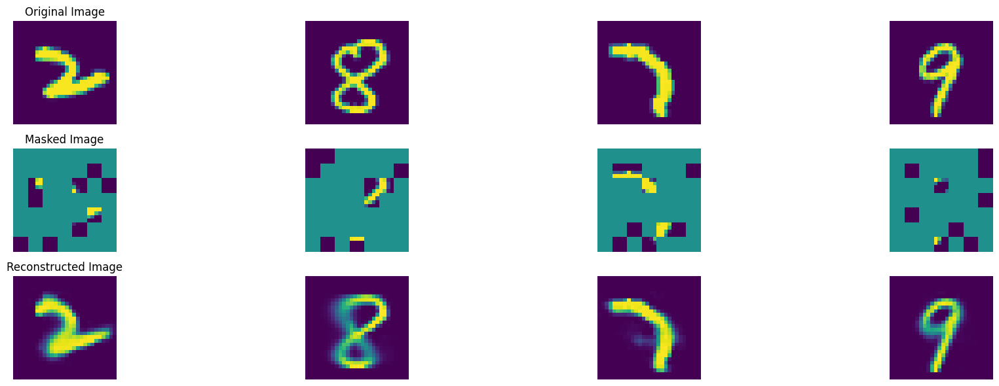

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 915, average traning loss is 0.08808647508316851.
=================== EPOCH:  916  ===================


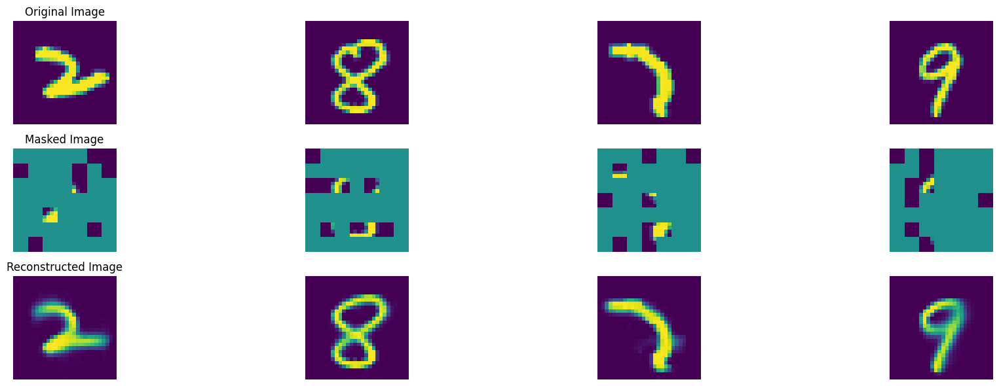

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 916, average traning loss is 0.08778462352904867.
=================== EPOCH:  917  ===================


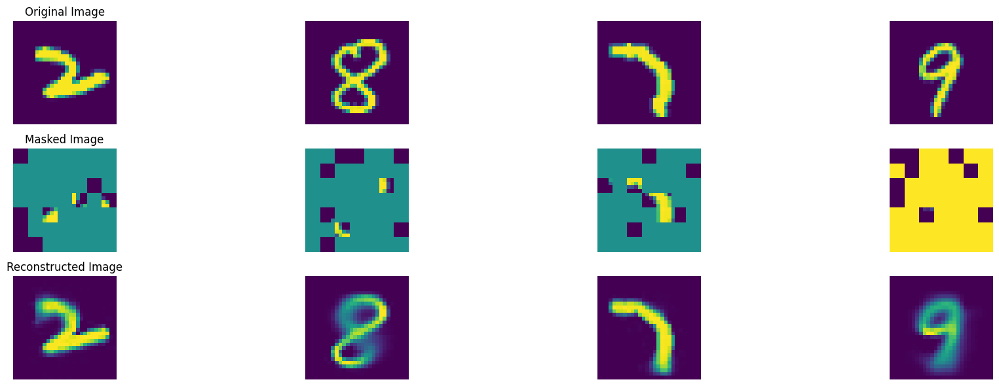

100%|██████████| 47/47 [00:08<00:00,  5.37it/s]


In epoch 917, average traning loss is 0.08846837567522171.
=================== EPOCH:  918  ===================


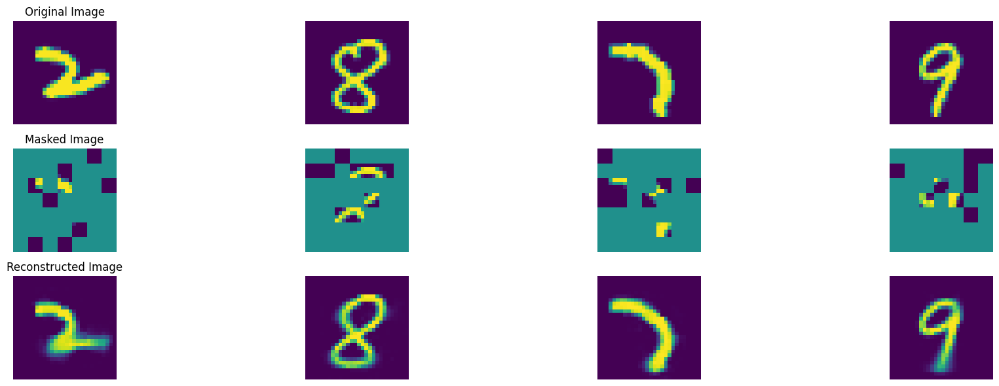

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 918, average traning loss is 0.08805744698707094.
=================== EPOCH:  919  ===================


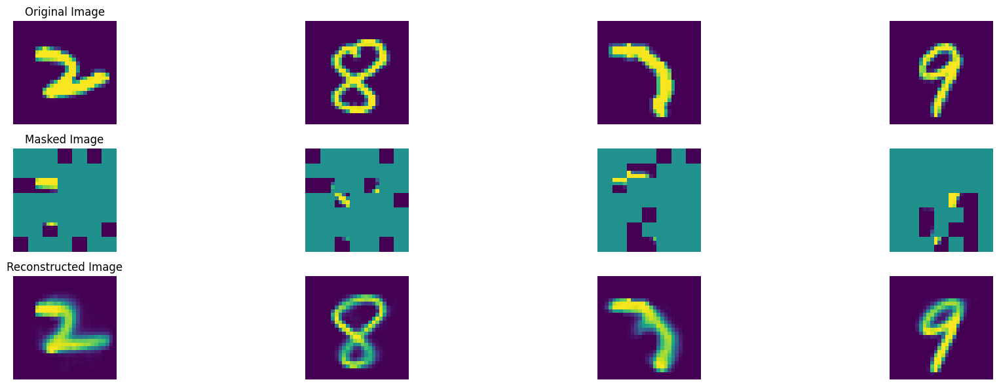

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 919, average traning loss is 0.08823036465873109.
=================== EPOCH:  920  ===================


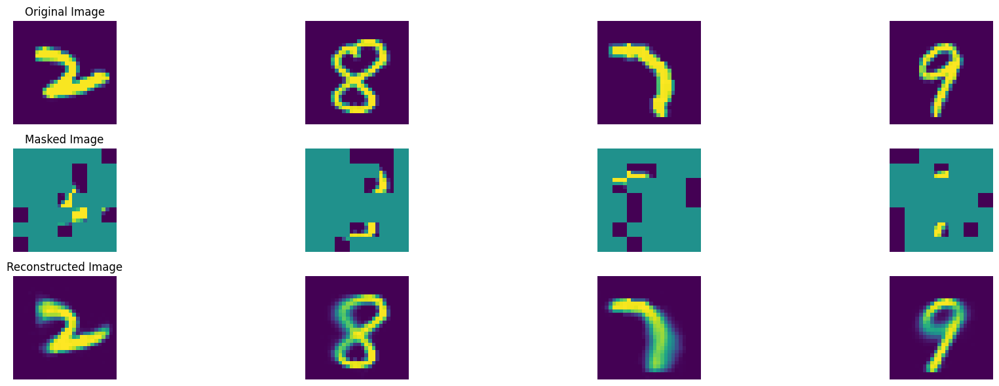

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 920, average traning loss is 0.08741339010761139.
=================== EPOCH:  921  ===================


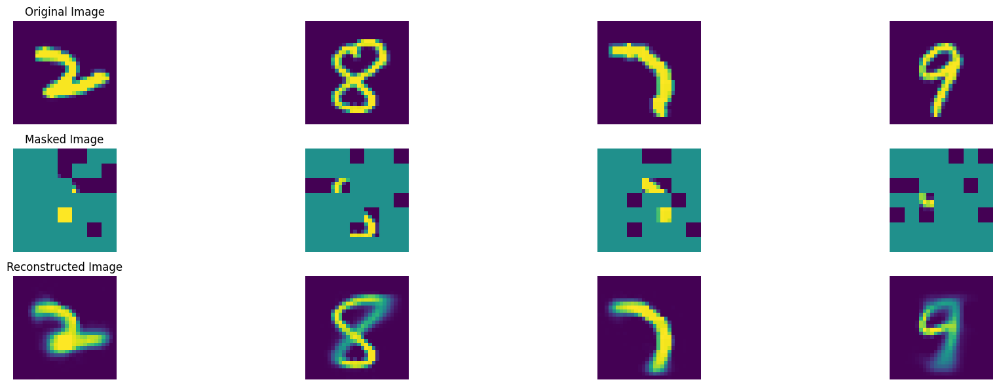

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 921, average traning loss is 0.08834134549536604.
=================== EPOCH:  922  ===================


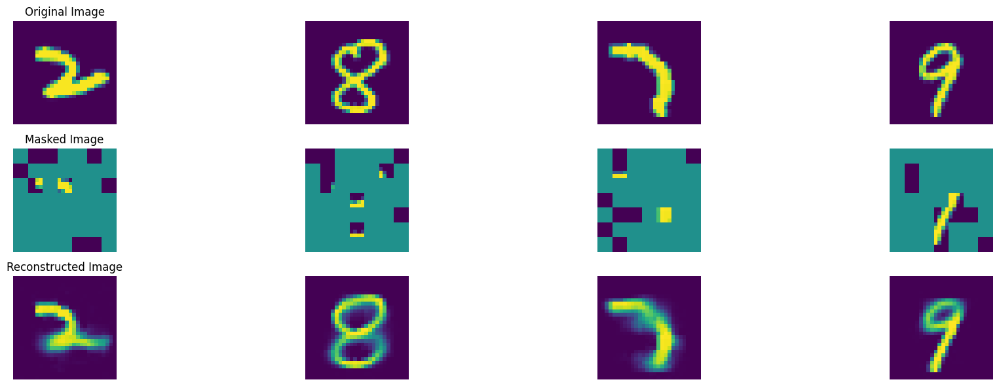

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 922, average traning loss is 0.08809570365763725.
=================== EPOCH:  923  ===================


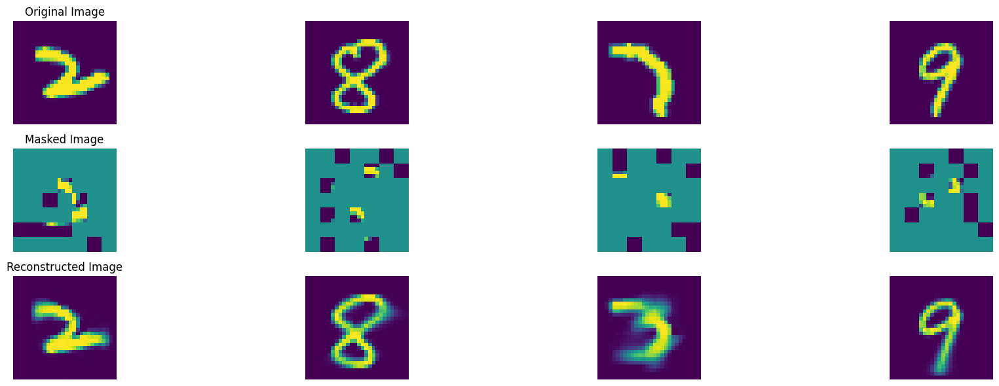

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 923, average traning loss is 0.0876818614754271.
=================== EPOCH:  924  ===================


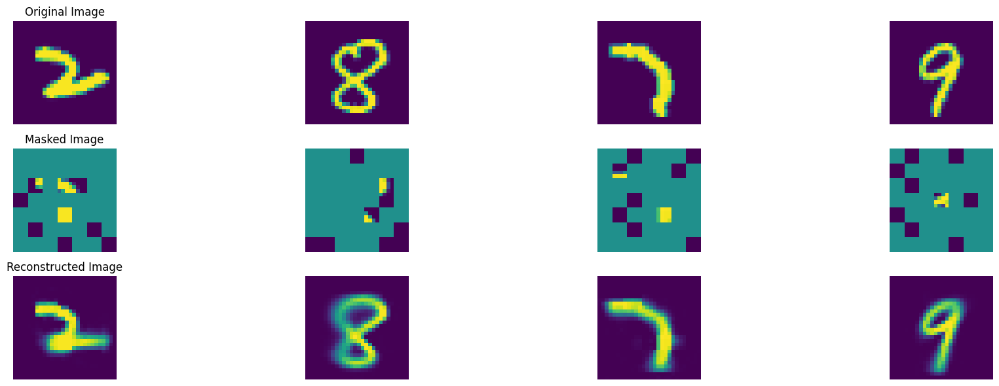

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 924, average traning loss is 0.08801063847668628.
=================== EPOCH:  925  ===================


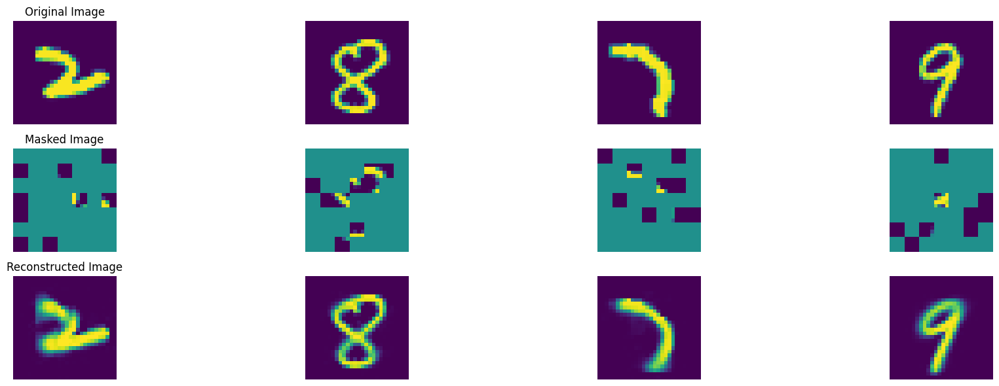

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 925, average traning loss is 0.08779151341382493.
=================== EPOCH:  926  ===================


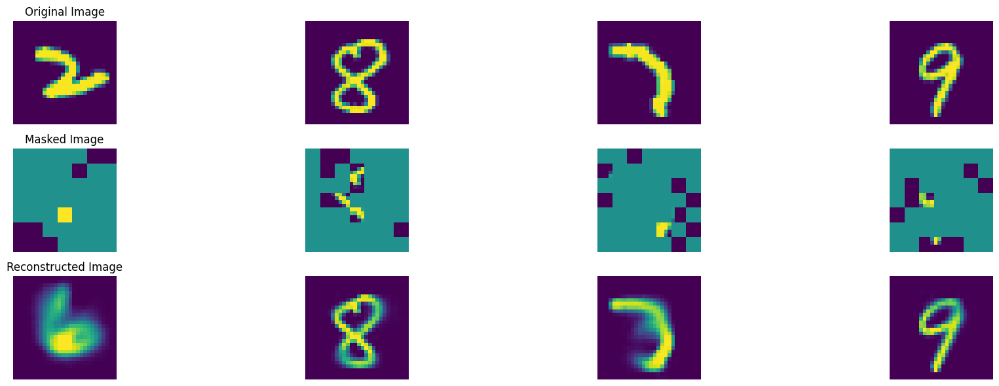

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 926, average traning loss is 0.08826259254141057.
=================== EPOCH:  927  ===================


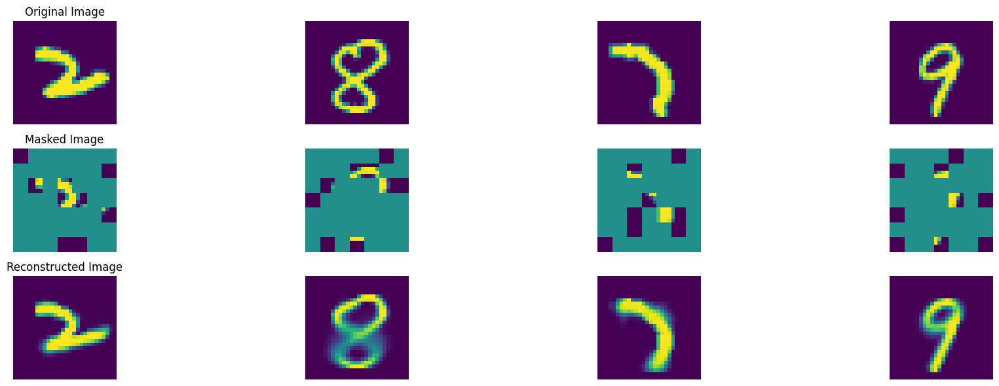

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 927, average traning loss is 0.08803348401759534.
=================== EPOCH:  928  ===================


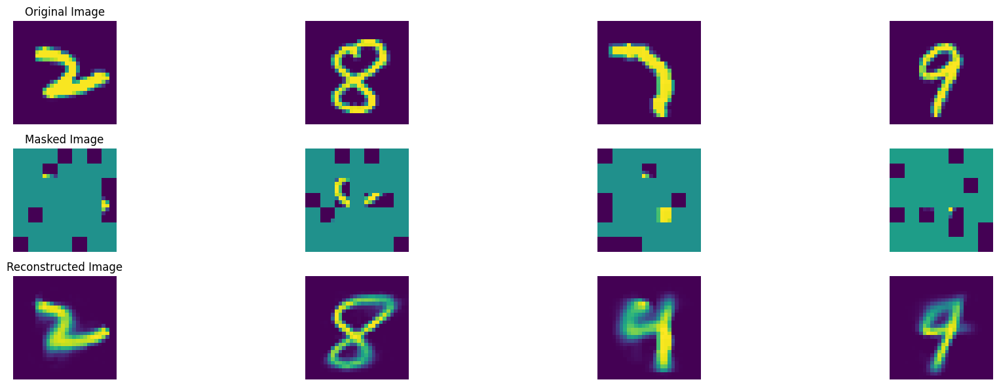

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 928, average traning loss is 0.08806238703905268.
=================== EPOCH:  929  ===================


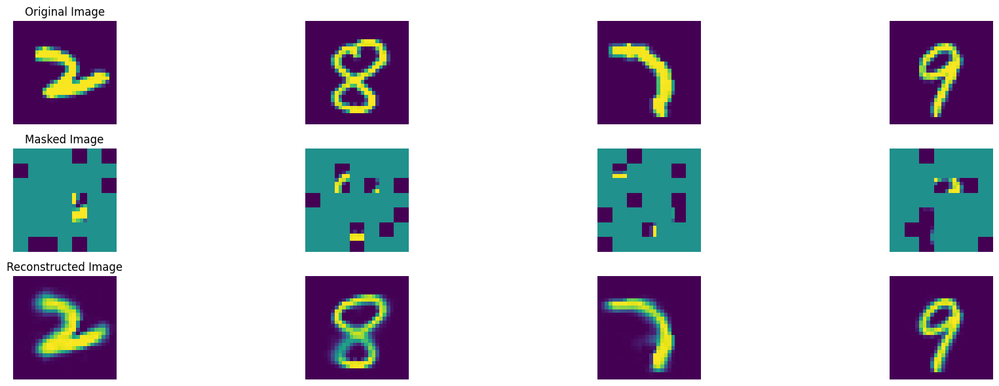

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 929, average traning loss is 0.08820948179097886.
=================== EPOCH:  930  ===================


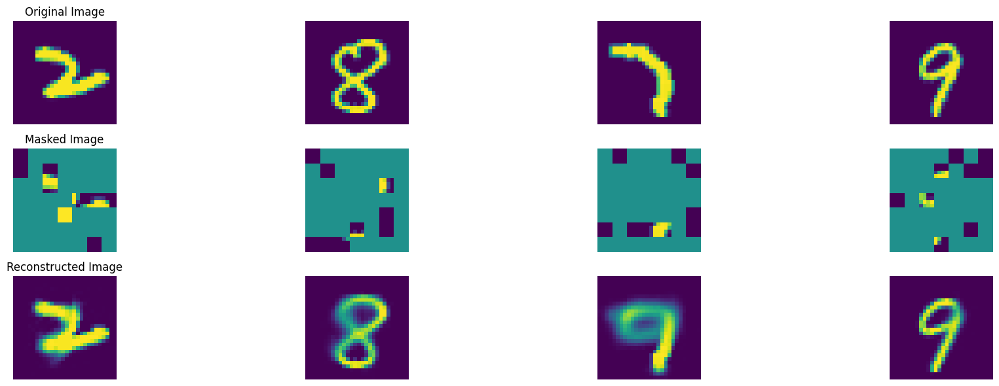

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 930, average traning loss is 0.0875539743202798.
=================== EPOCH:  931  ===================


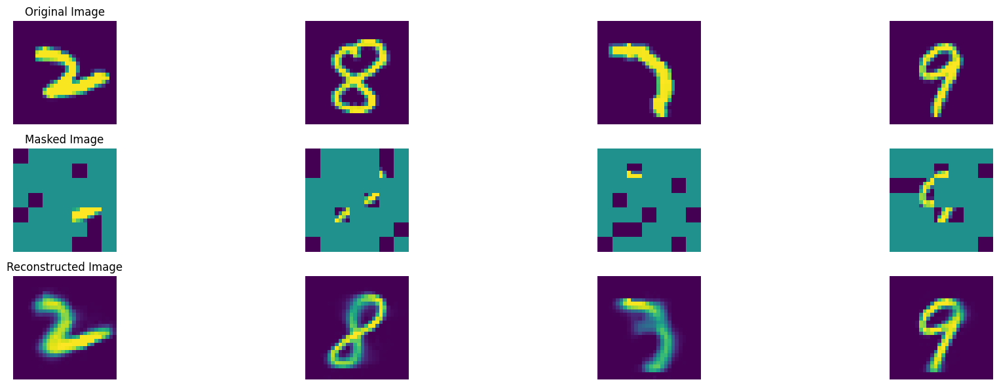

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 931, average traning loss is 0.08821773021779161.
=================== EPOCH:  932  ===================


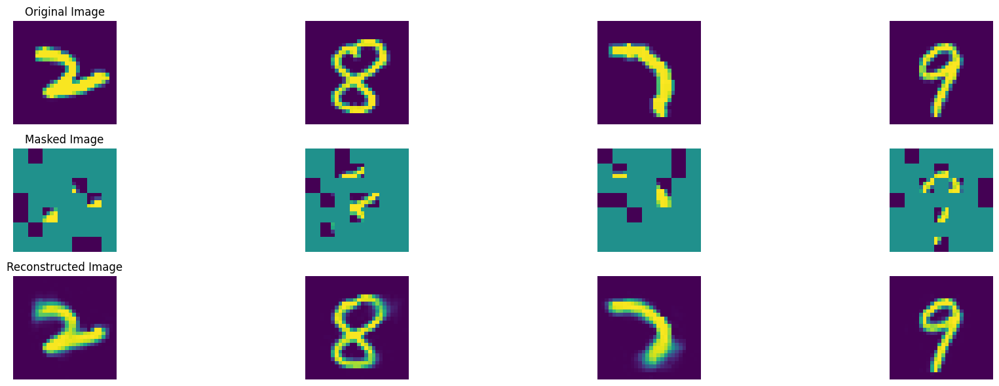

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 932, average traning loss is 0.0875596580036143.
=================== EPOCH:  933  ===================


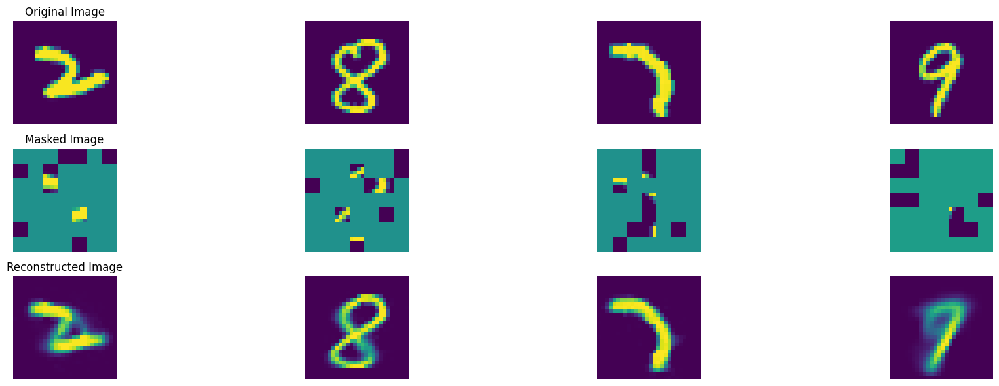

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 933, average traning loss is 0.08808729908567794.
=================== EPOCH:  934  ===================


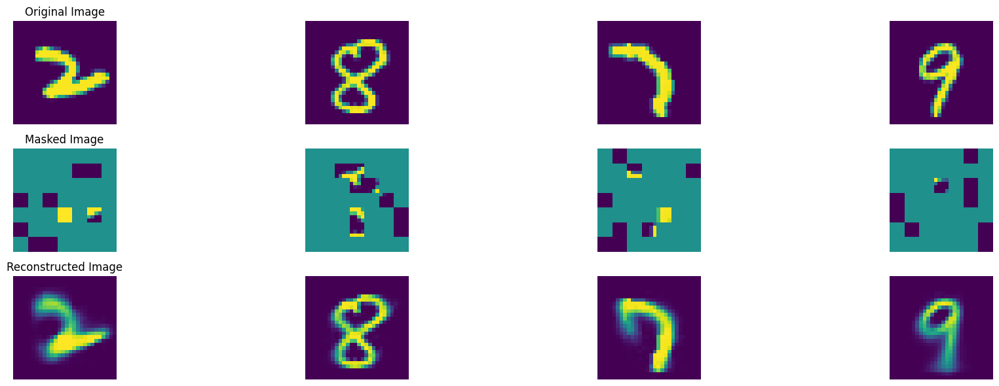

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 934, average traning loss is 0.0874877947759121.
=================== EPOCH:  935  ===================


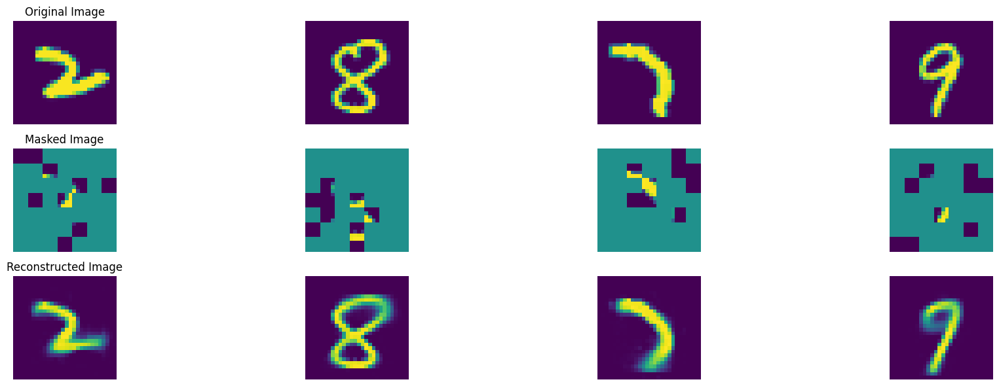

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 935, average traning loss is 0.08786821444617941.
=================== EPOCH:  936  ===================


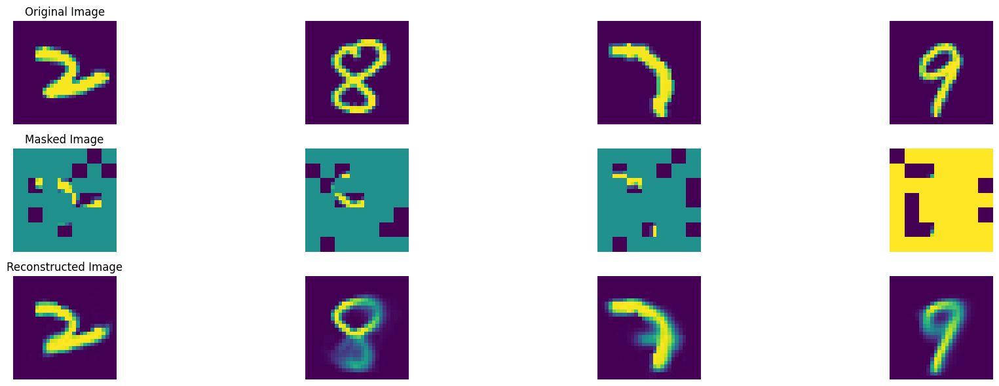

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 936, average traning loss is 0.08758313494159821.
=================== EPOCH:  937  ===================


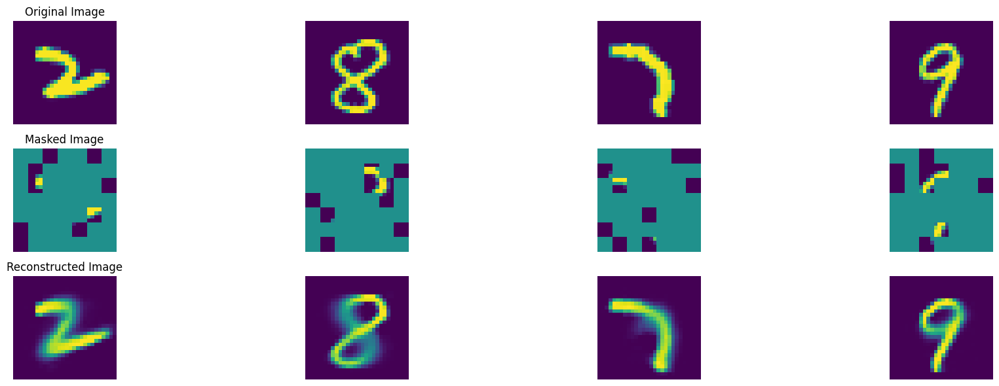

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 937, average traning loss is 0.08794464583092547.
=================== EPOCH:  938  ===================


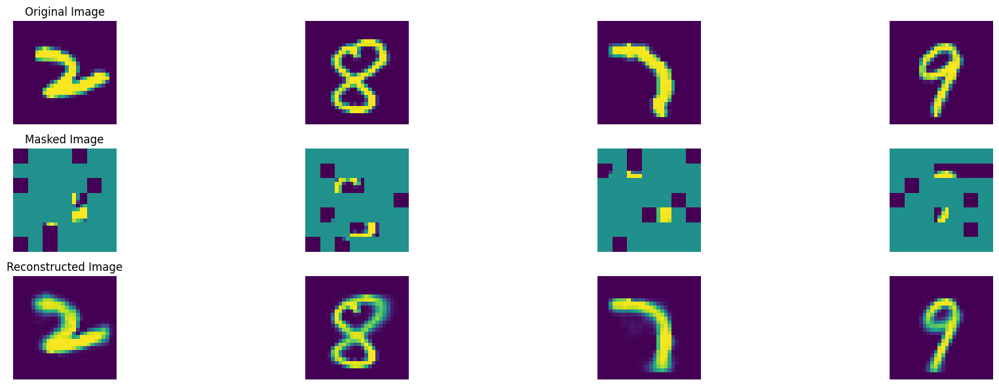

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 938, average traning loss is 0.08779918053682814.
=================== EPOCH:  939  ===================


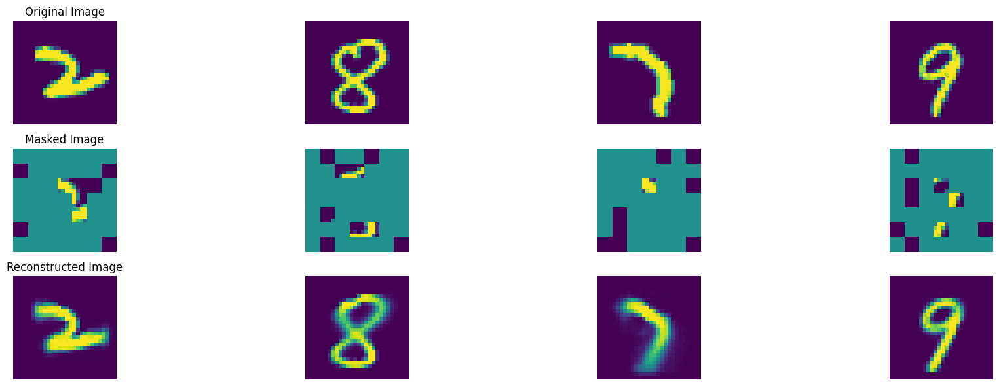

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 939, average traning loss is 0.08821522682271105.
=================== EPOCH:  940  ===================


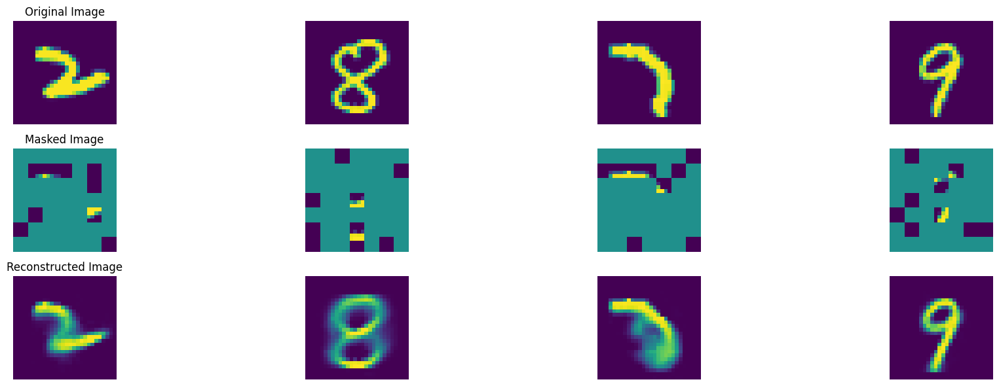

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 940, average traning loss is 0.08782355170300667.
=================== EPOCH:  941  ===================


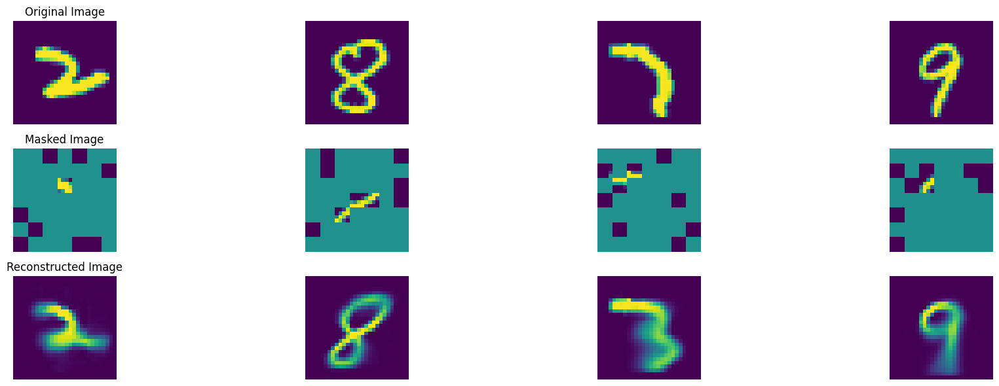

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 941, average traning loss is 0.08799107705659055.
=================== EPOCH:  942  ===================


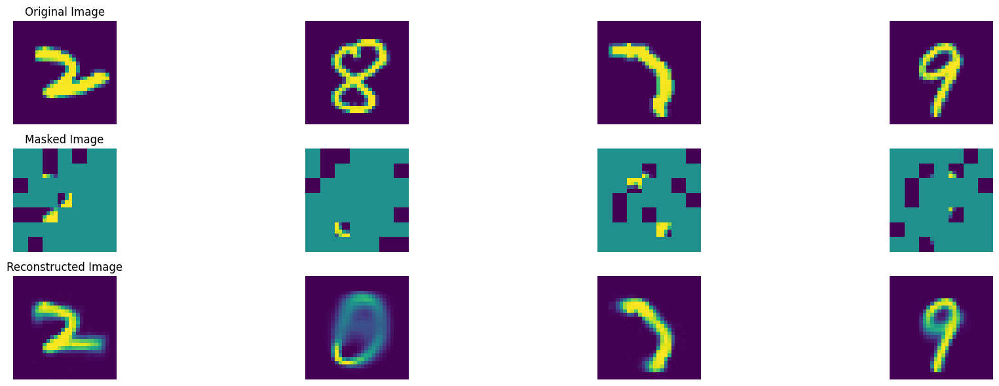

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 942, average traning loss is 0.08824642874459003.
=================== EPOCH:  943  ===================


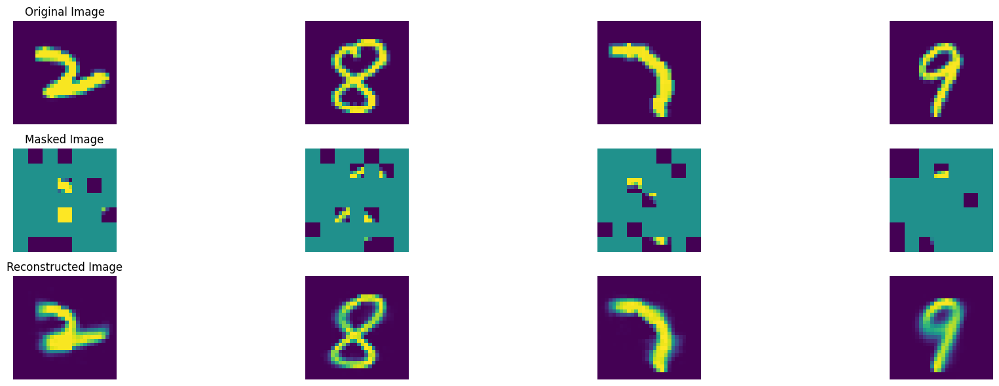

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 943, average traning loss is 0.08759004908039215.
=================== EPOCH:  944  ===================


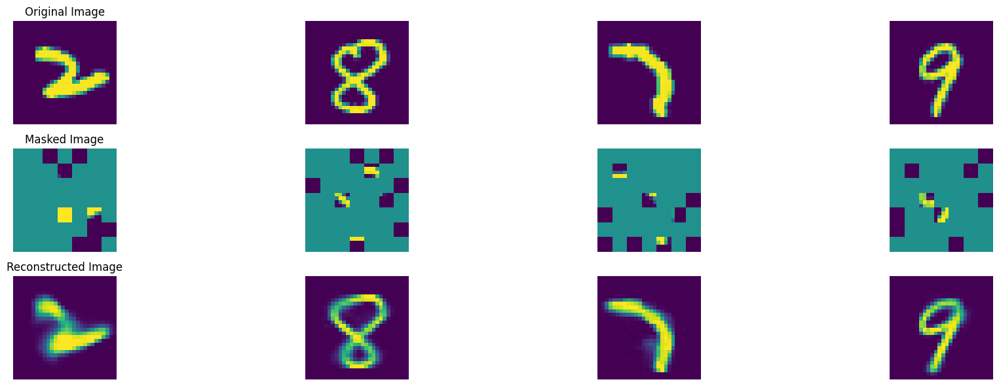

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 944, average traning loss is 0.08780686953600417.
=================== EPOCH:  945  ===================


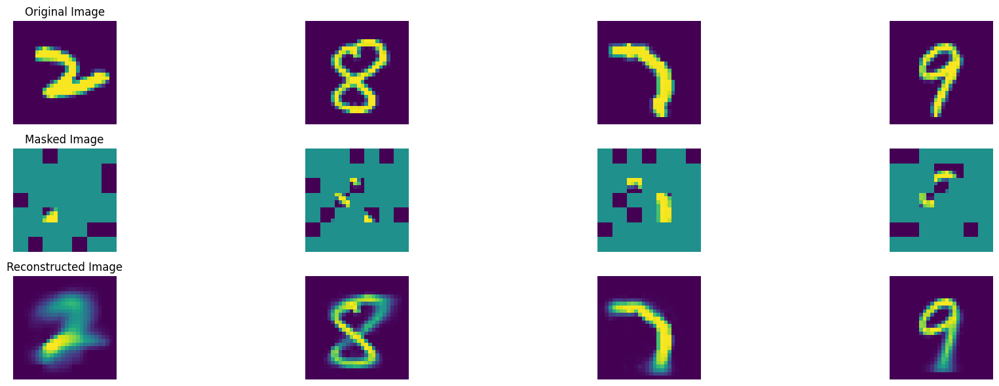

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 945, average traning loss is 0.08760280875449485.
=================== EPOCH:  946  ===================


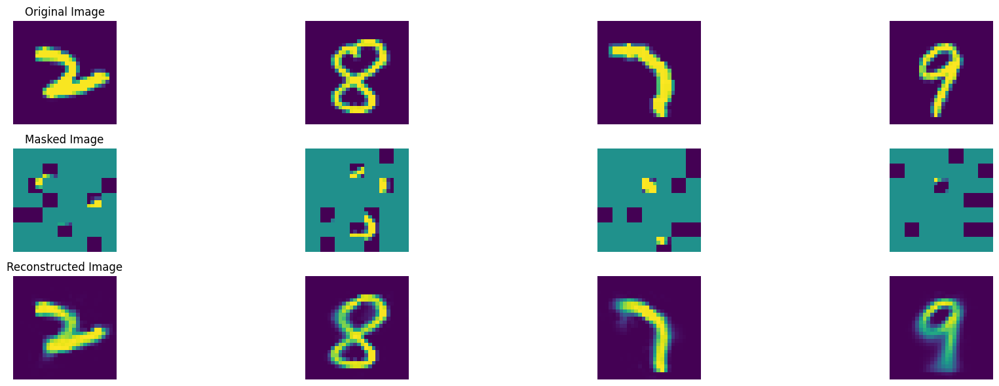

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 946, average traning loss is 0.08733521100688488.
=================== EPOCH:  947  ===================


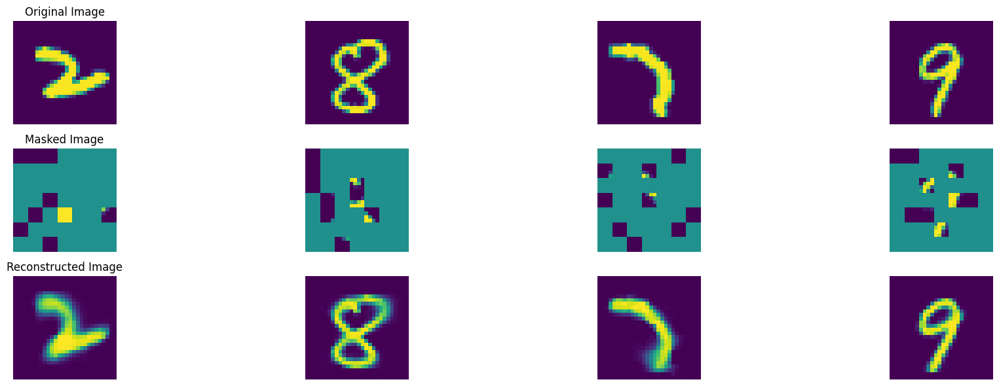

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 947, average traning loss is 0.08795546122053836.
=================== EPOCH:  948  ===================


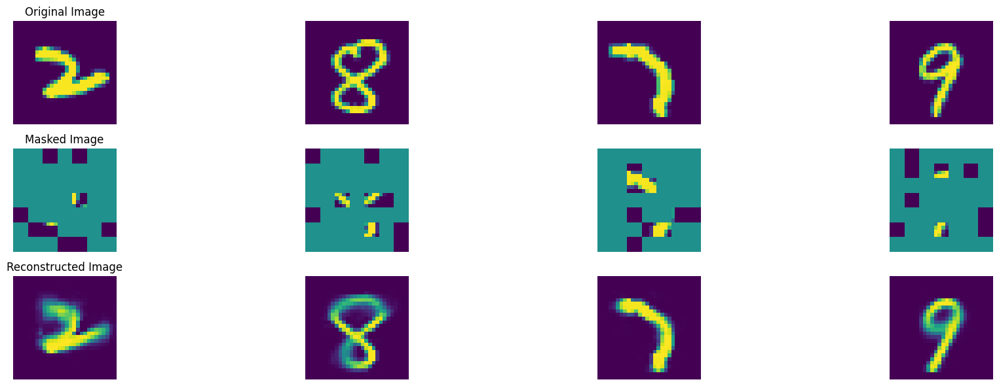

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 948, average traning loss is 0.08770240637216162.
=================== EPOCH:  949  ===================


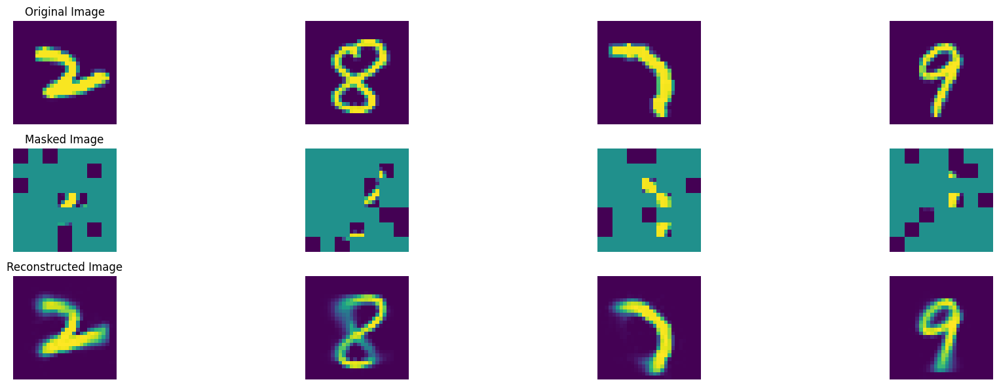

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 949, average traning loss is 0.08775517867600664.
=================== EPOCH:  950  ===================


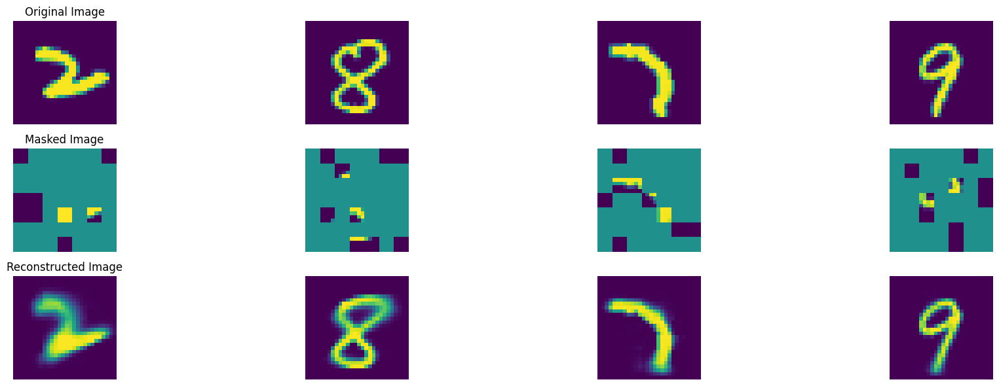

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 950, average traning loss is 0.08818190386320682.
=================== EPOCH:  951  ===================


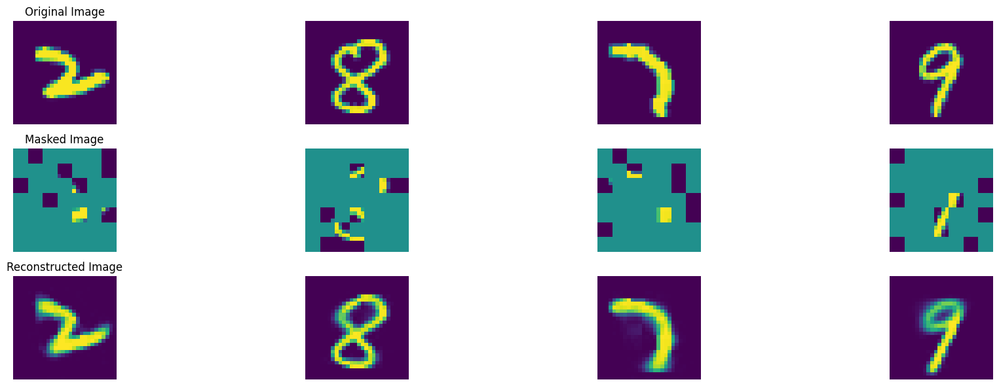

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 951, average traning loss is 0.08809259502177542.
=================== EPOCH:  952  ===================


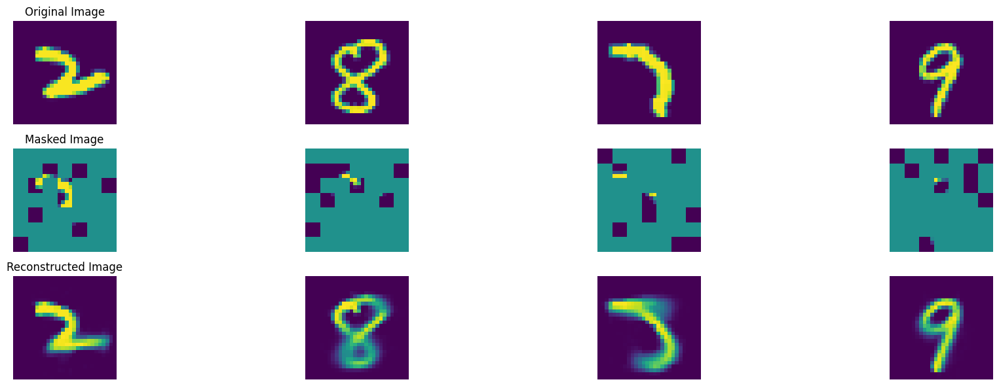

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 952, average traning loss is 0.08764786717105419.
=================== EPOCH:  953  ===================


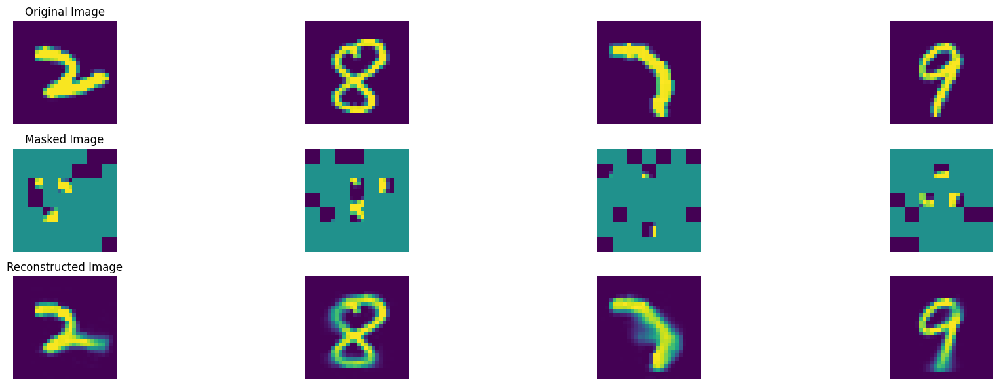

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 953, average traning loss is 0.08742949889695391.
=================== EPOCH:  954  ===================


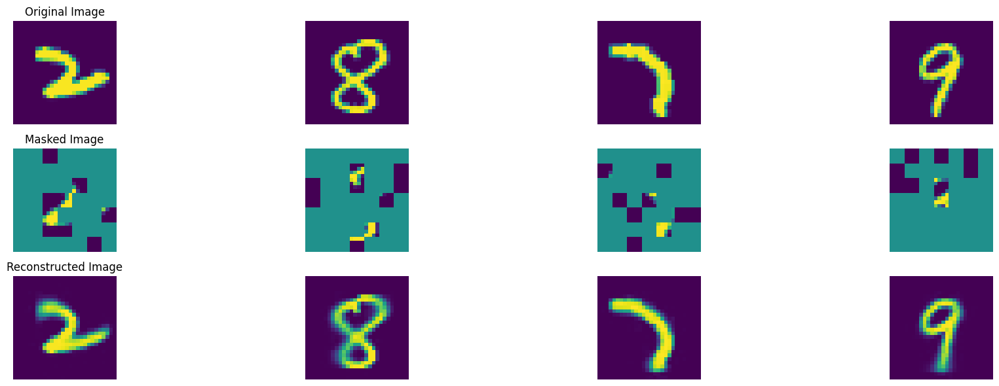

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 954, average traning loss is 0.08789880224998961.
=================== EPOCH:  955  ===================


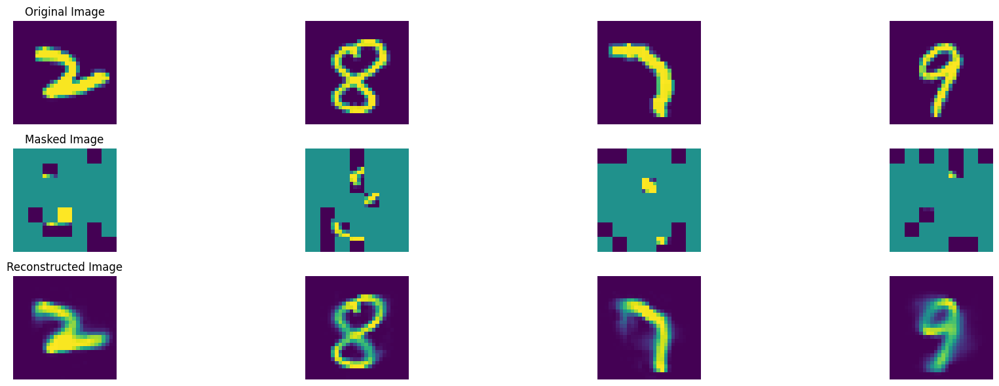

100%|██████████| 47/47 [00:08<00:00,  5.47it/s]


In epoch 955, average traning loss is 0.08776114484731187.
=================== EPOCH:  956  ===================


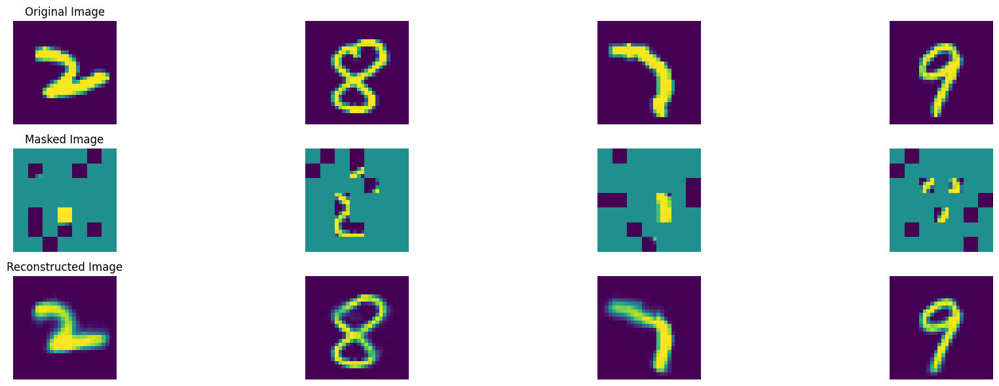

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 956, average traning loss is 0.08714352024996534.
=================== EPOCH:  957  ===================


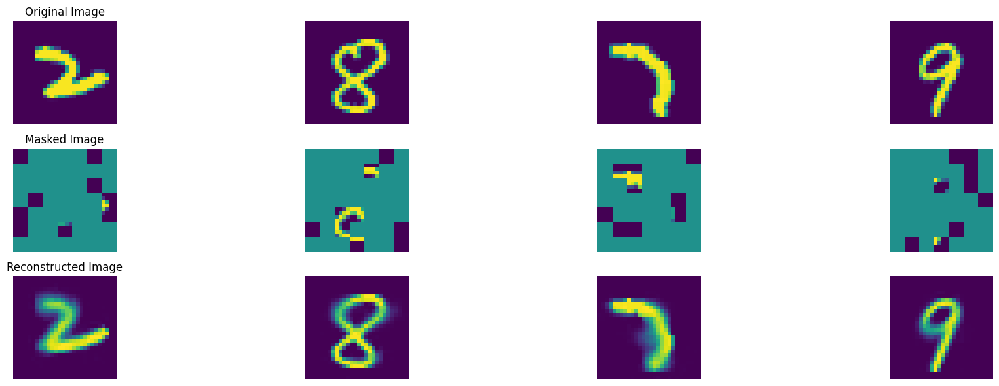

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 957, average traning loss is 0.08767422225247039.
=================== EPOCH:  958  ===================


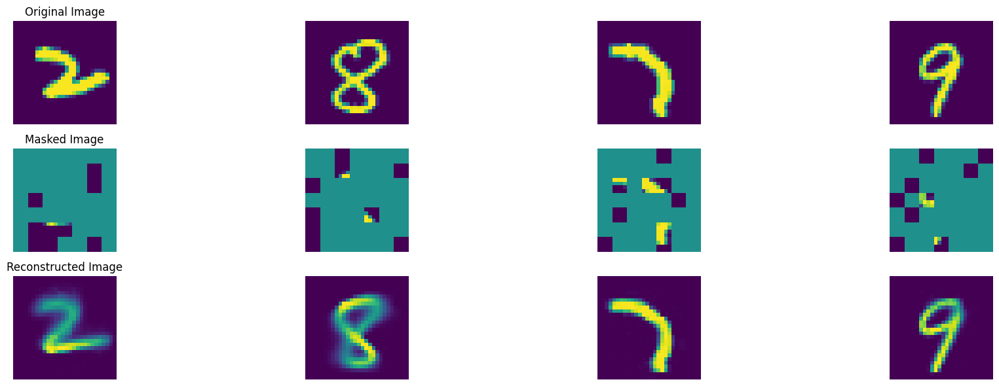

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 958, average traning loss is 0.08778515600777687.
=================== EPOCH:  959  ===================


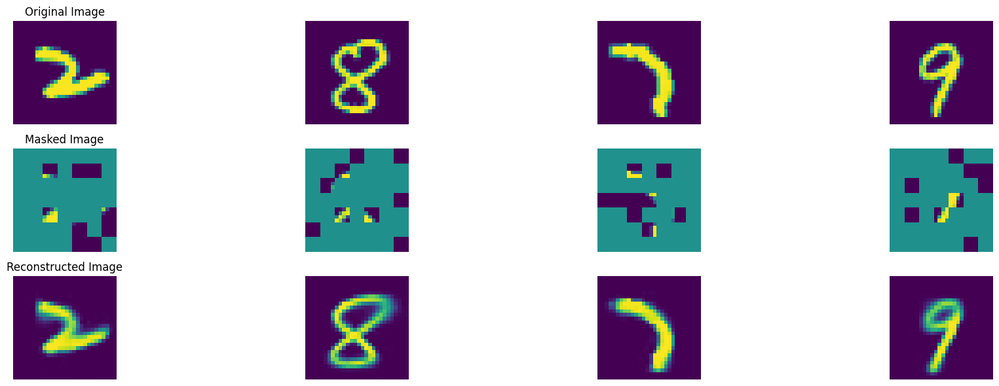

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 959, average traning loss is 0.08740540546305636.
=================== EPOCH:  960  ===================


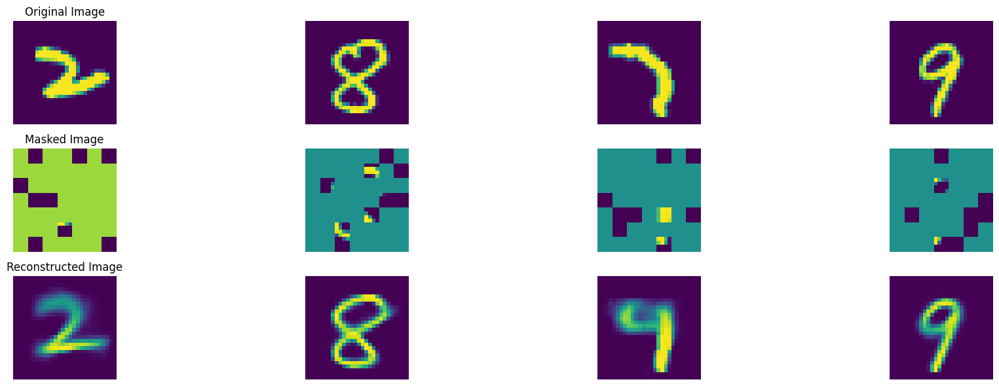

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 960, average traning loss is 0.08836617669526567.
=================== EPOCH:  961  ===================


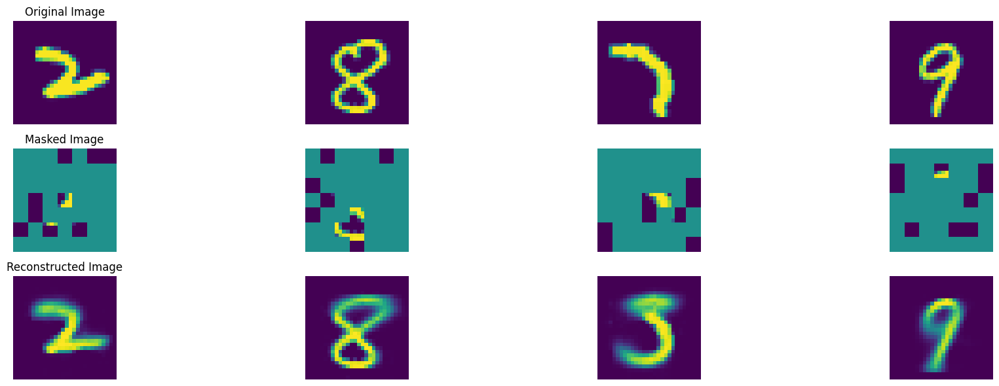

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 961, average traning loss is 0.08748866237224416.
=================== EPOCH:  962  ===================


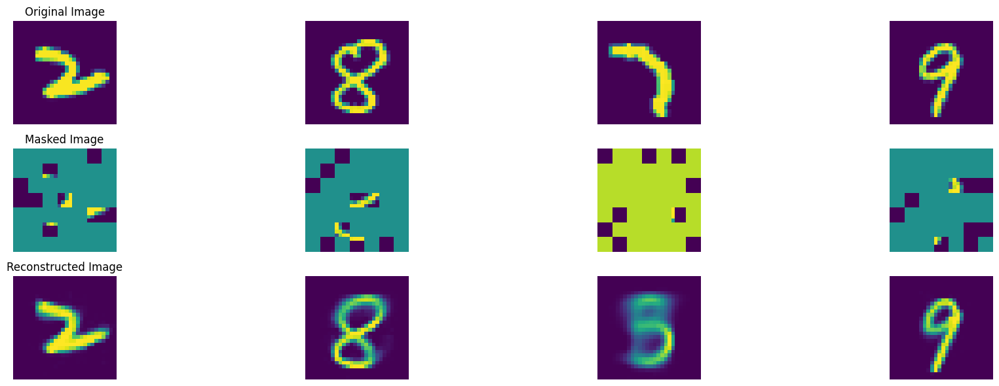

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 962, average traning loss is 0.08802891744578138.
=================== EPOCH:  963  ===================


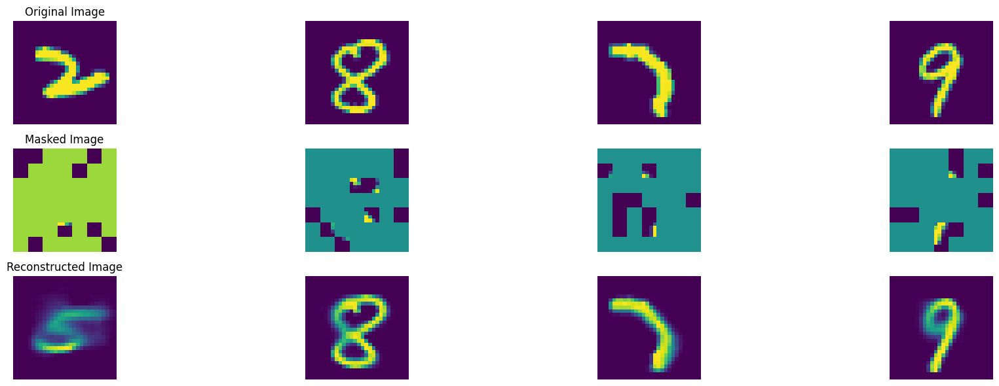

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 963, average traning loss is 0.08722810732557419.
=================== EPOCH:  964  ===================


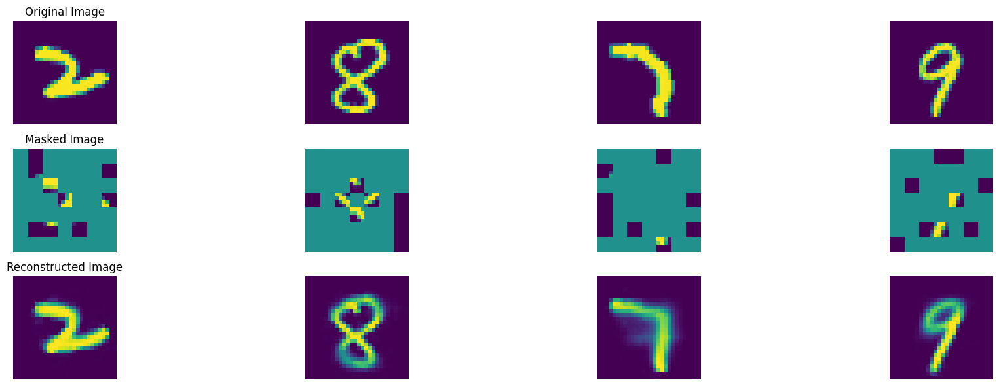

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 964, average traning loss is 0.08774768022146631.
=================== EPOCH:  965  ===================


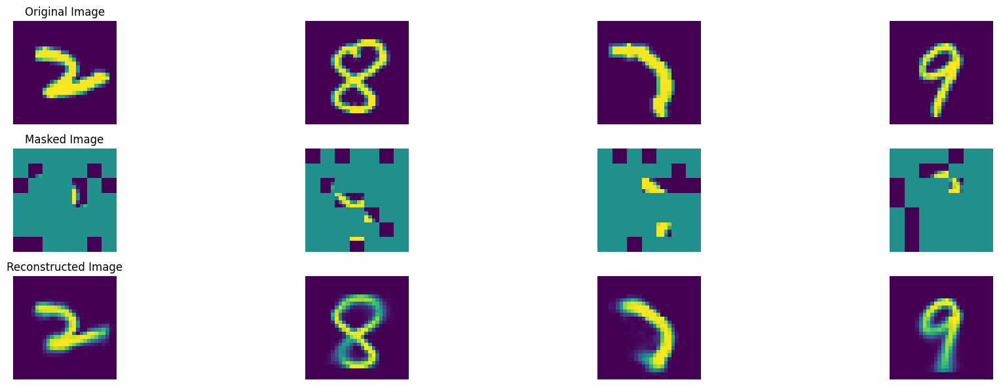

100%|██████████| 47/47 [00:08<00:00,  5.49it/s]


In epoch 965, average traning loss is 0.08768899992425391.
=================== EPOCH:  966  ===================


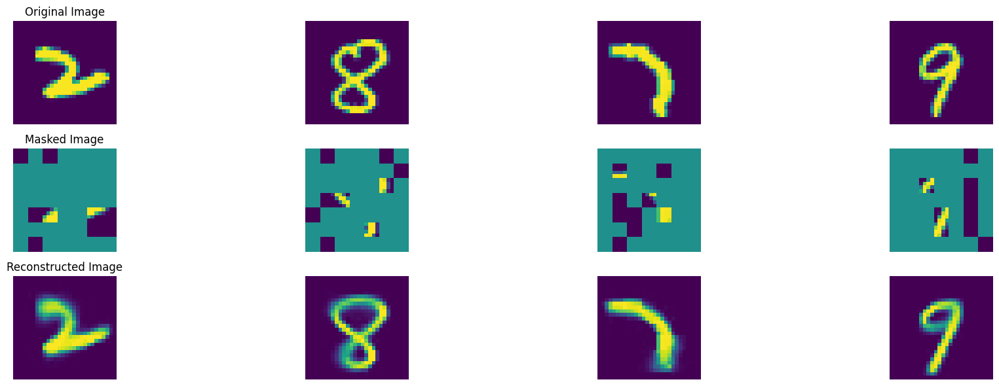

100%|██████████| 47/47 [00:08<00:00,  5.32it/s]


In epoch 966, average traning loss is 0.08745333695031227.
=================== EPOCH:  967  ===================


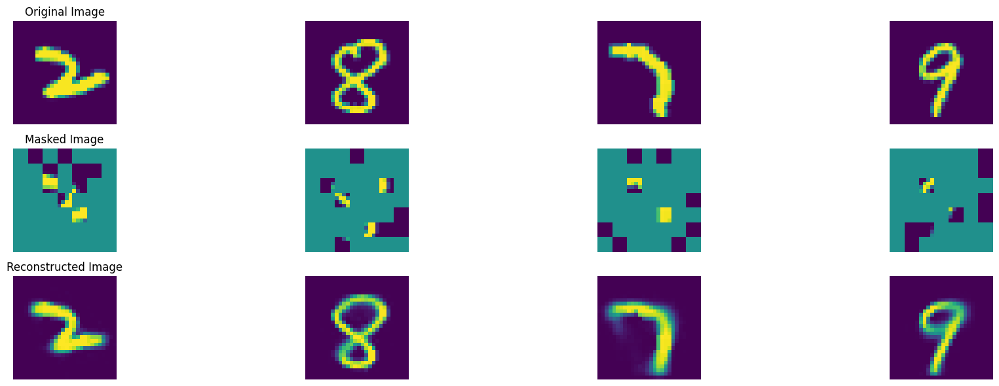

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 967, average traning loss is 0.08770008401033726.
=================== EPOCH:  968  ===================


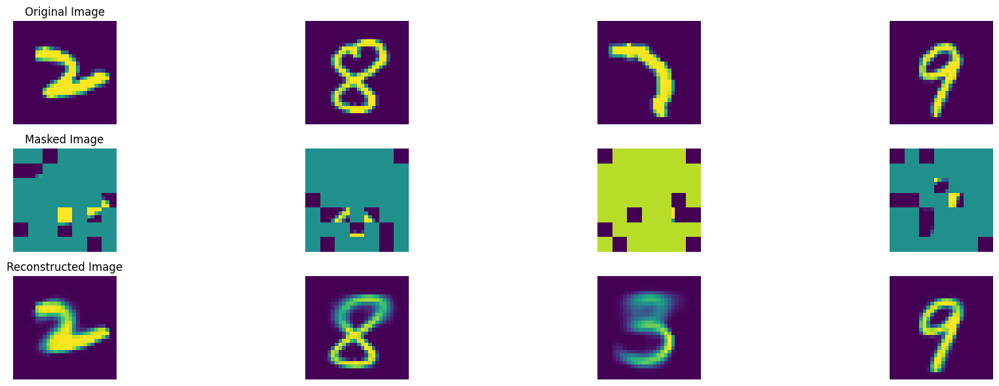

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 968, average traning loss is 0.0879518357997245.
=================== EPOCH:  969  ===================


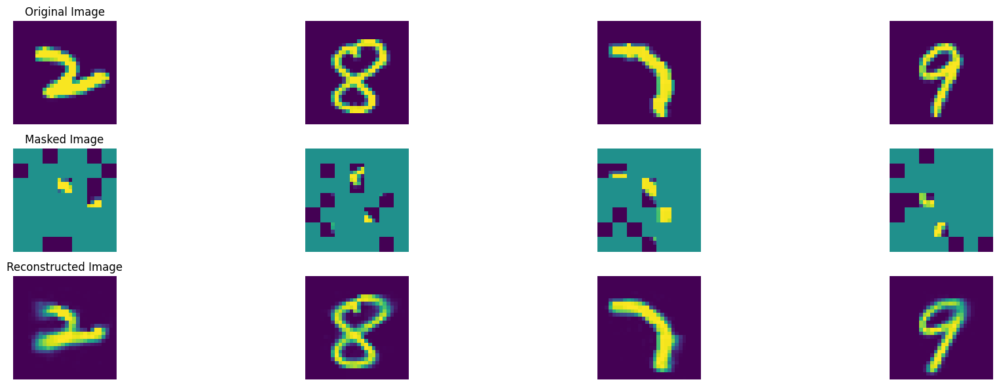

100%|██████████| 47/47 [00:08<00:00,  5.46it/s]


In epoch 969, average traning loss is 0.08790646778776291.
=================== EPOCH:  970  ===================


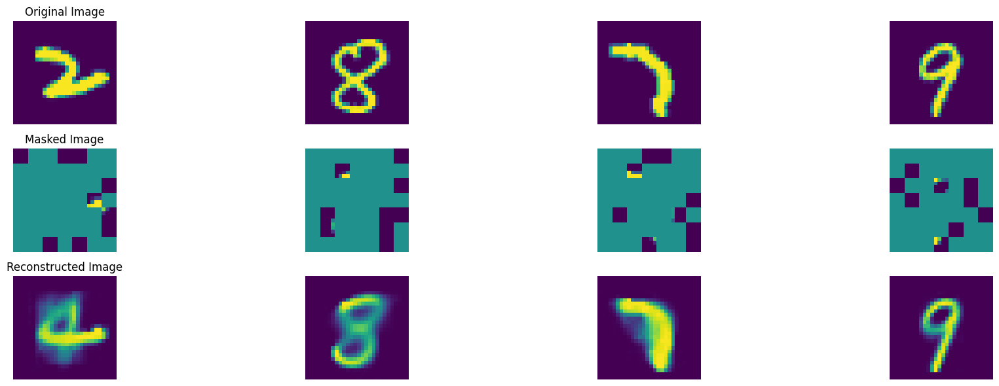

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 970, average traning loss is 0.0876982903226893.
=================== EPOCH:  971  ===================


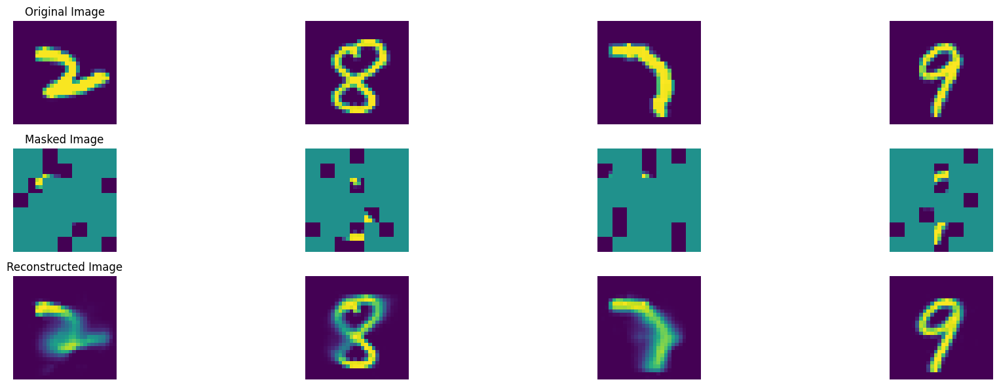

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 971, average traning loss is 0.0880879579072303.
=================== EPOCH:  972  ===================


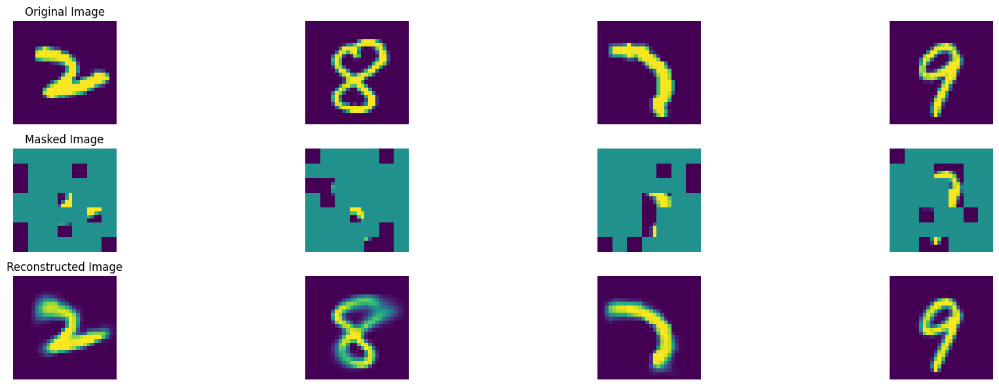

100%|██████████| 47/47 [00:08<00:00,  5.34it/s]


In epoch 972, average traning loss is 0.08791966149781613.
=================== EPOCH:  973  ===================


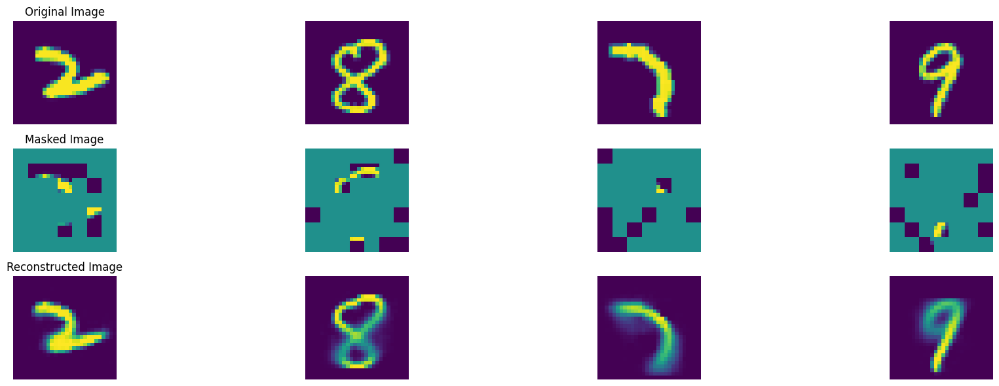

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 973, average traning loss is 0.08754185111598765.
=================== EPOCH:  974  ===================


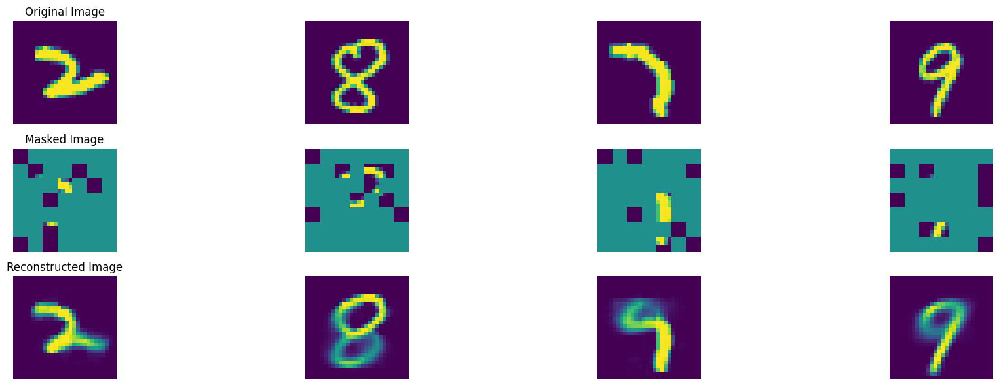

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 974, average traning loss is 0.08772285900851513.
=================== EPOCH:  975  ===================


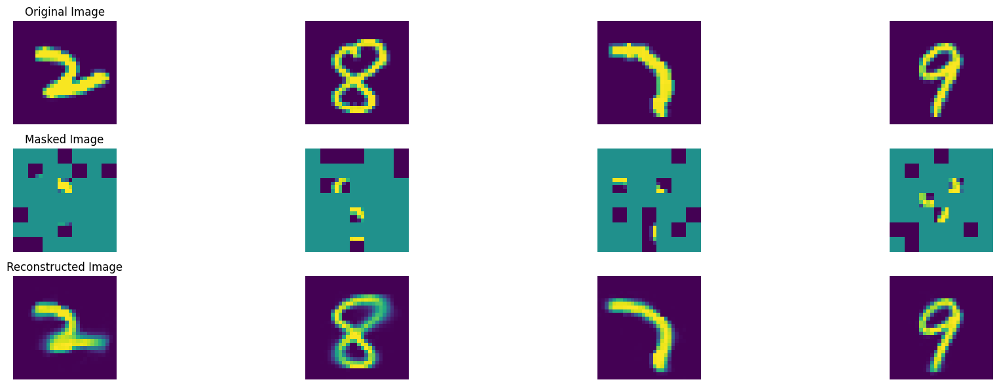

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 975, average traning loss is 0.0879156231246096.
=================== EPOCH:  976  ===================


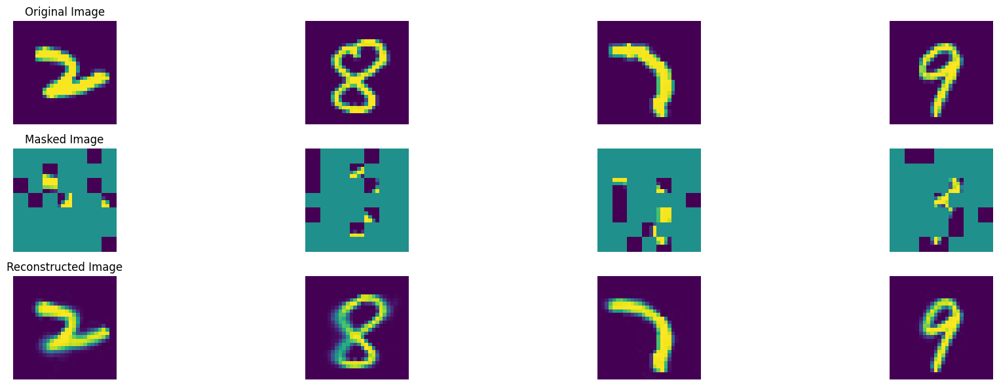

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 976, average traning loss is 0.0875423585480832.
=================== EPOCH:  977  ===================


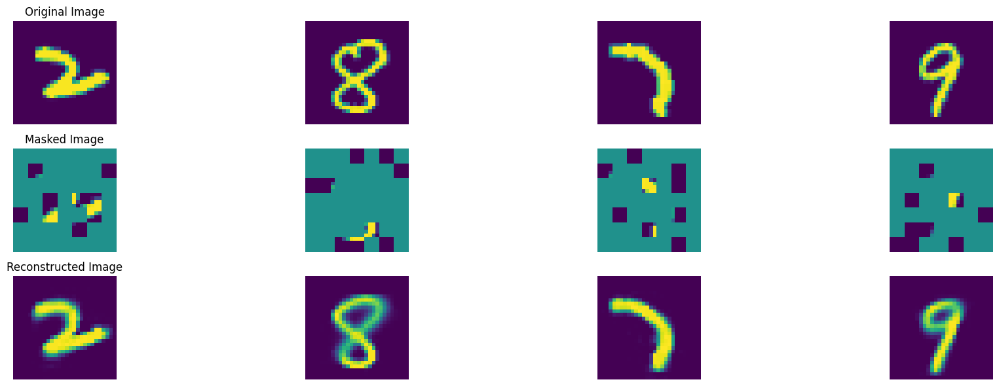

100%|██████████| 47/47 [00:08<00:00,  5.51it/s]


In epoch 977, average traning loss is 0.08798183595880549.
=================== EPOCH:  978  ===================


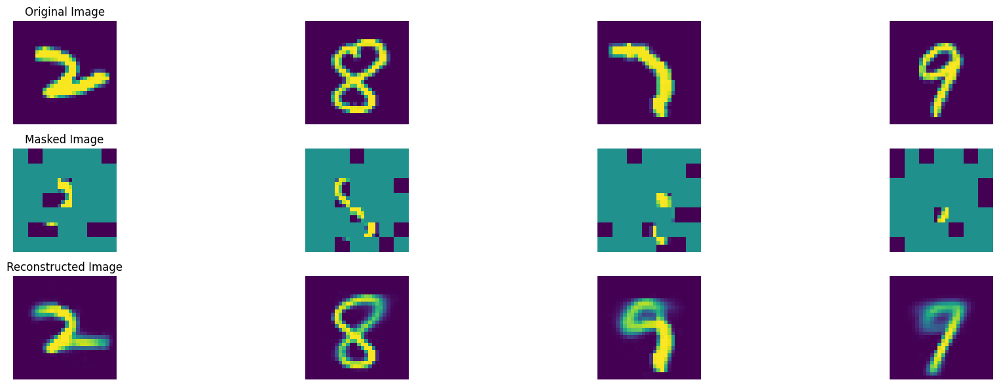

100%|██████████| 47/47 [00:08<00:00,  5.50it/s]


In epoch 978, average traning loss is 0.08809088788768078.
=================== EPOCH:  979  ===================


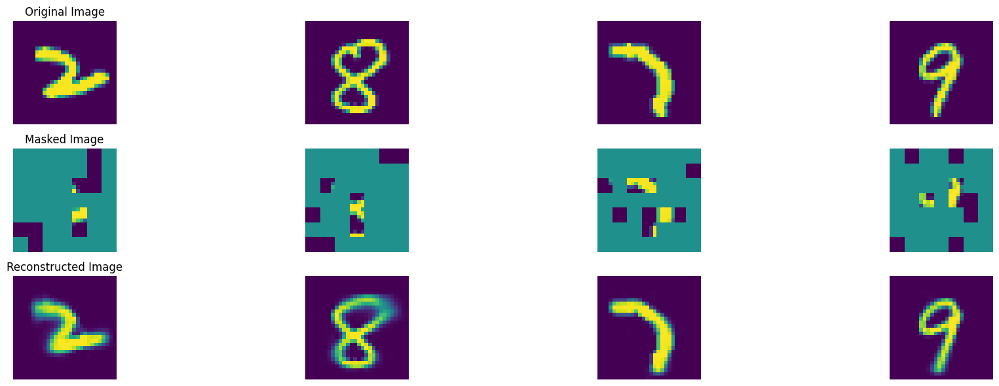

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 979, average traning loss is 0.08790846850643767.
=================== EPOCH:  980  ===================


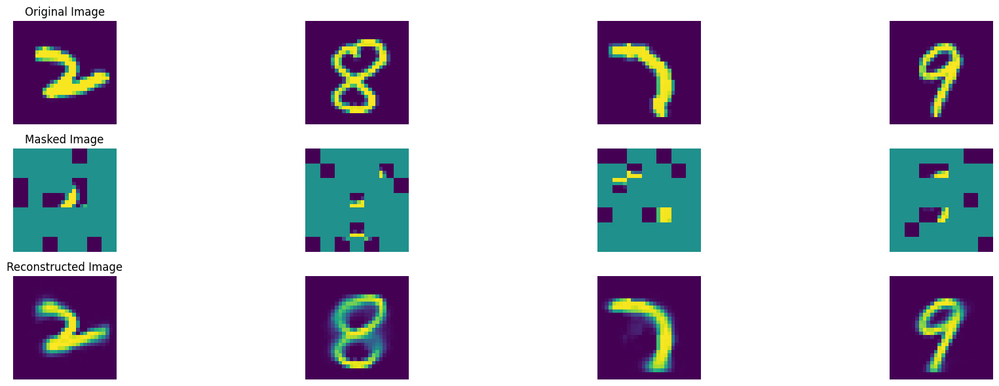

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 980, average traning loss is 0.08804837915491551.
=================== EPOCH:  981  ===================


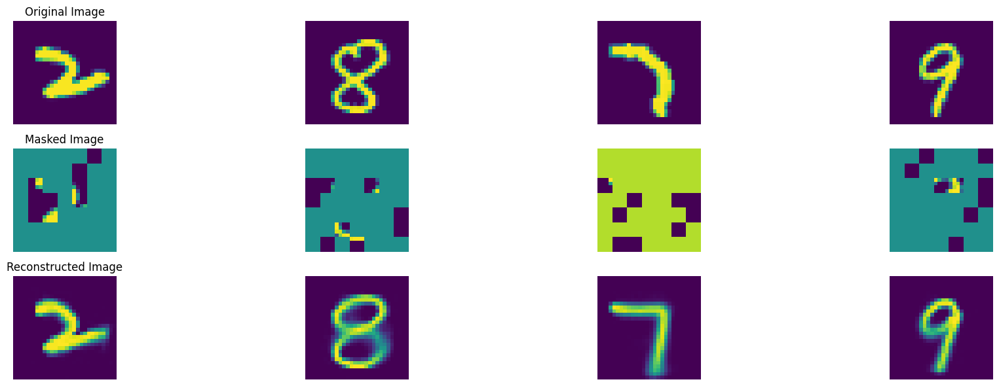

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 981, average traning loss is 0.08816967904567719.
=================== EPOCH:  982  ===================


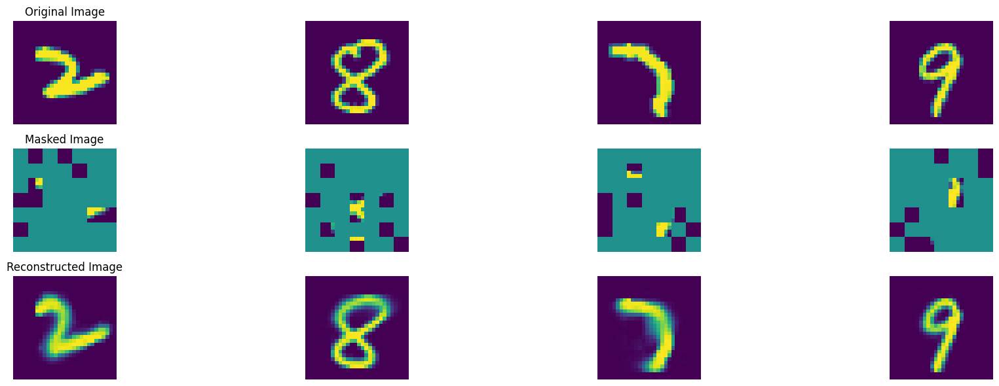

100%|██████████| 47/47 [00:08<00:00,  5.38it/s]


In epoch 982, average traning loss is 0.08767512884545833.
=================== EPOCH:  983  ===================


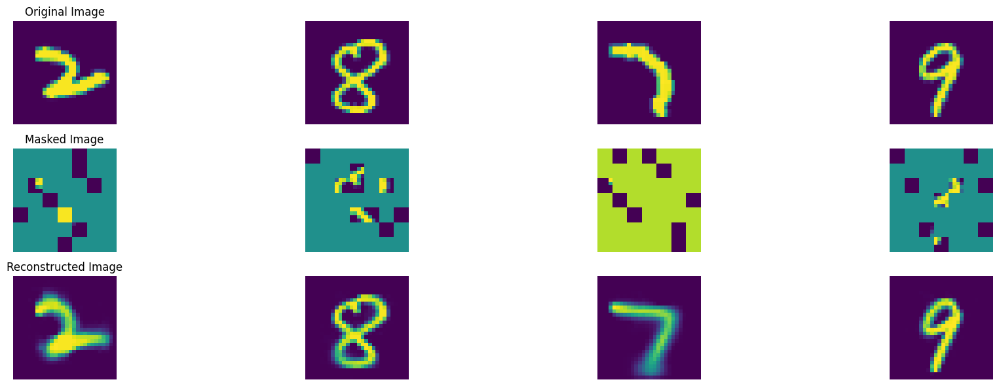

100%|██████████| 47/47 [00:08<00:00,  5.40it/s]


In epoch 983, average traning loss is 0.08847046183778885.
=================== EPOCH:  984  ===================


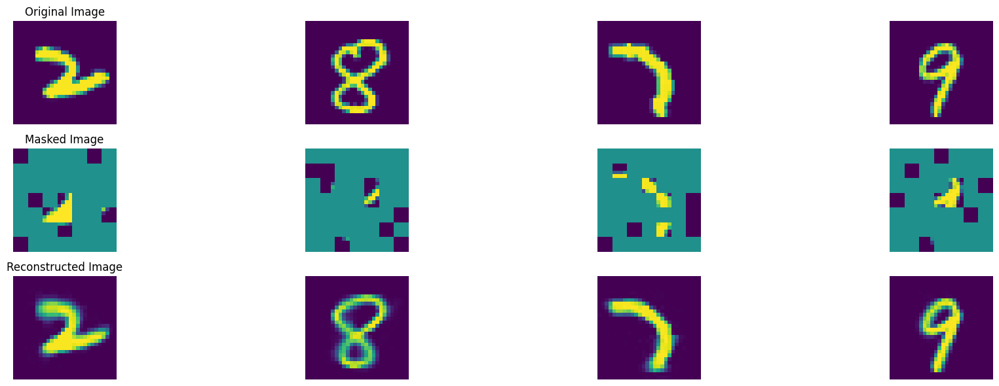

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 984, average traning loss is 0.087734598904214.
=================== EPOCH:  985  ===================


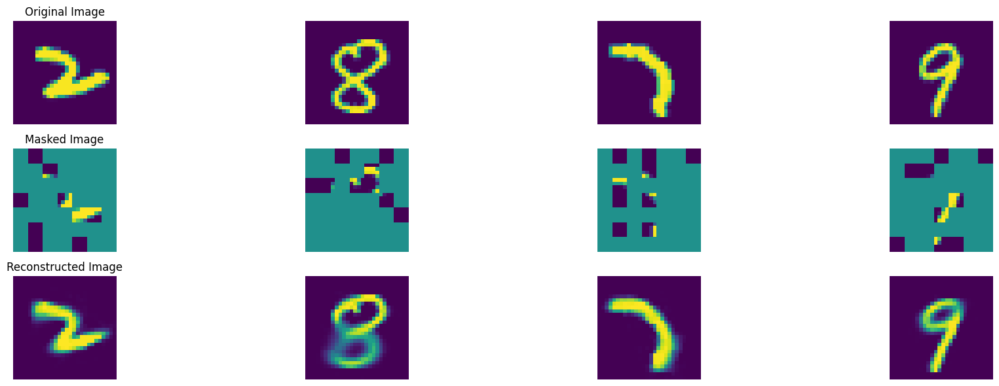

100%|██████████| 47/47 [00:08<00:00,  5.36it/s]


In epoch 985, average traning loss is 0.08791143130114738.
=================== EPOCH:  986  ===================


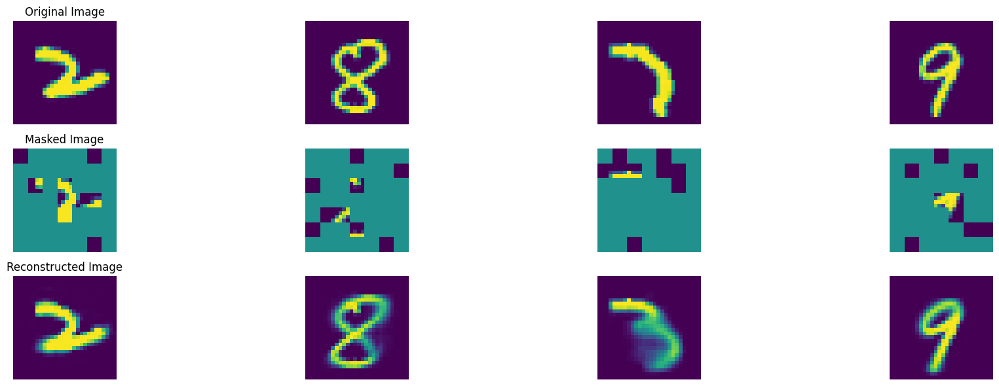

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 986, average traning loss is 0.08745994513973276.
=================== EPOCH:  987  ===================


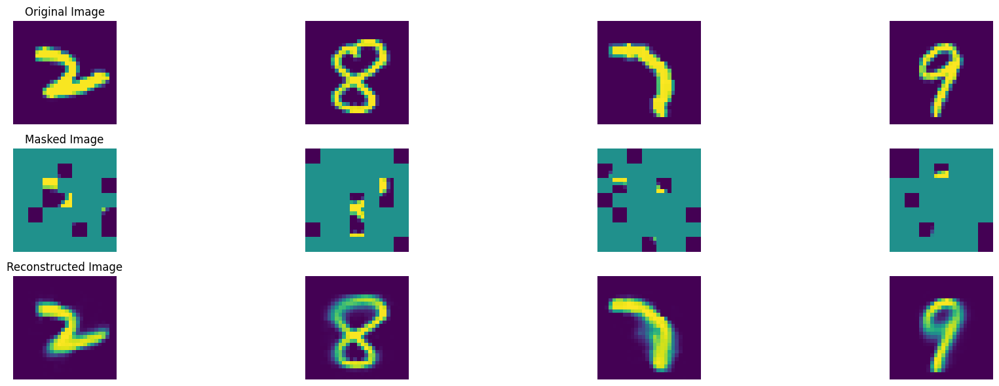

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 987, average traning loss is 0.08747392480677747.
=================== EPOCH:  988  ===================


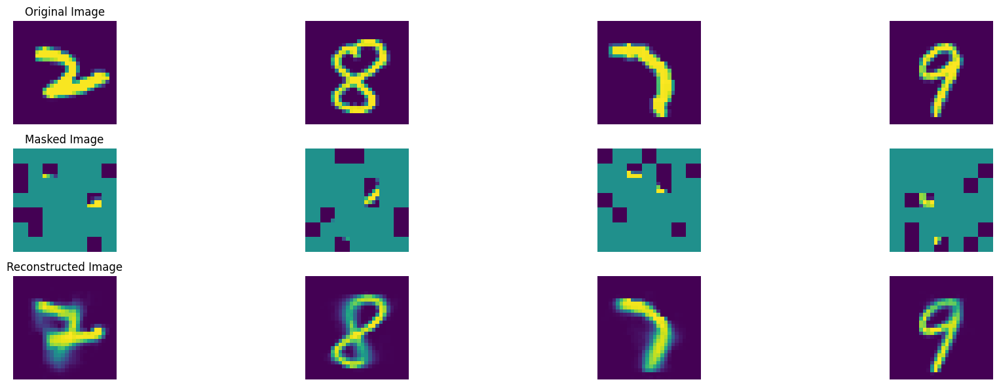

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 988, average traning loss is 0.08742410832263053.
=================== EPOCH:  989  ===================


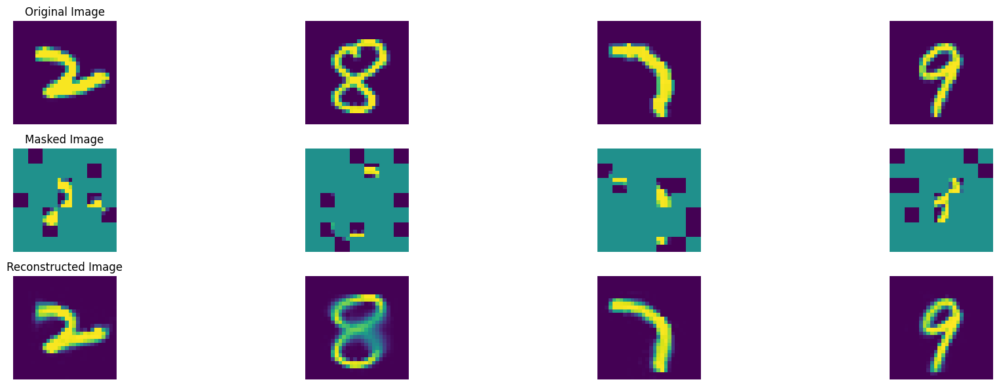

100%|██████████| 47/47 [00:08<00:00,  5.41it/s]


In epoch 989, average traning loss is 0.08743607649143706.
=================== EPOCH:  990  ===================


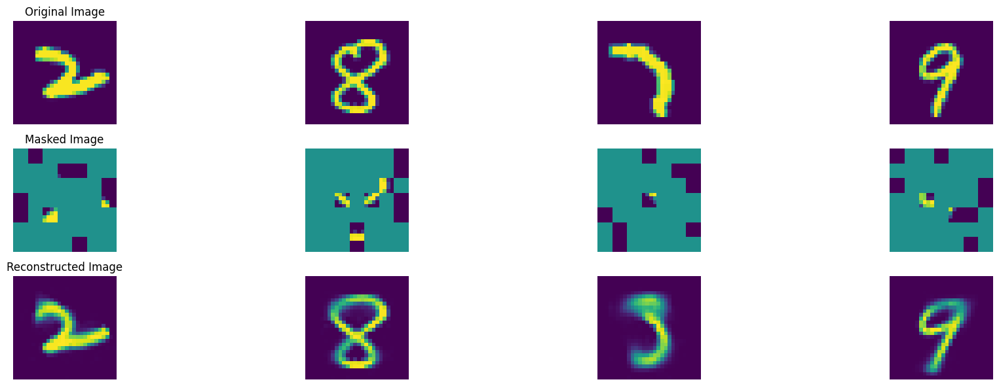

100%|██████████| 47/47 [00:08<00:00,  5.39it/s]


In epoch 990, average traning loss is 0.08803143970509793.
=================== EPOCH:  991  ===================


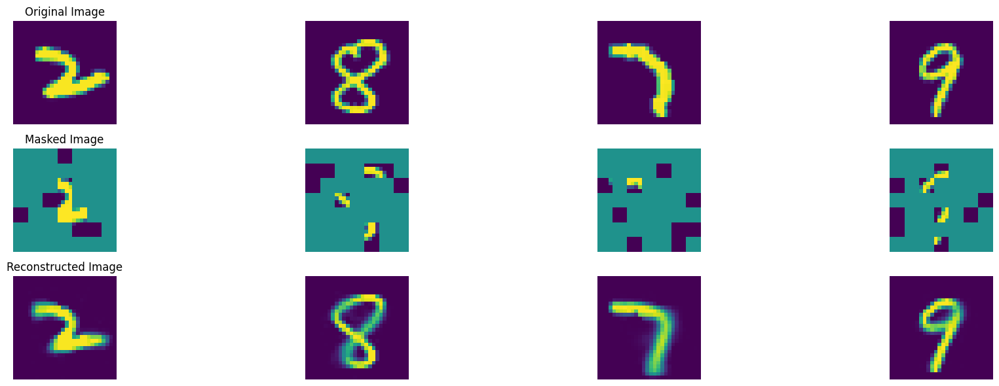

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 991, average traning loss is 0.08749338207726783.
=================== EPOCH:  992  ===================


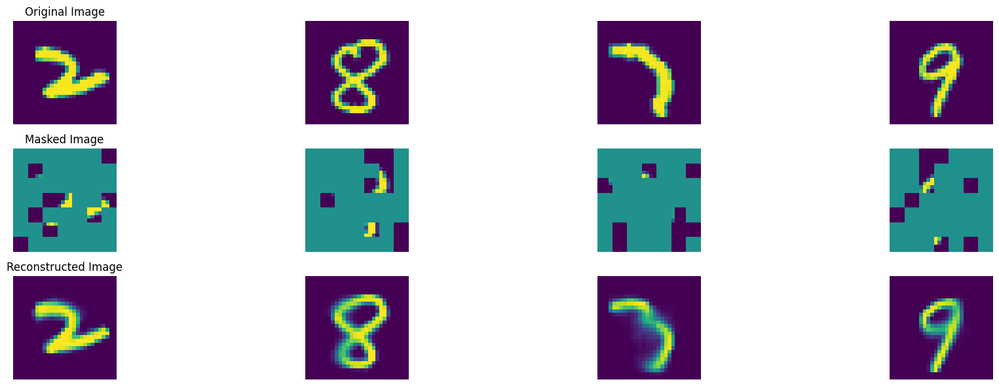

100%|██████████| 47/47 [00:08<00:00,  5.50it/s]


In epoch 992, average traning loss is 0.087834599170279.
=================== EPOCH:  993  ===================


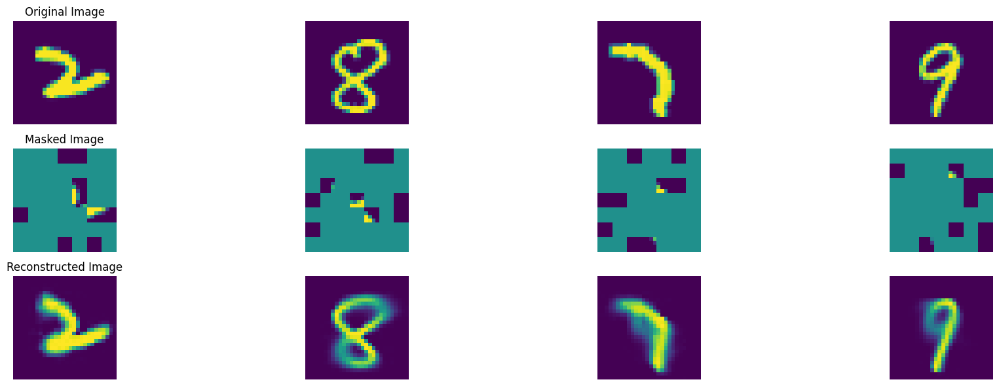

100%|██████████| 47/47 [00:08<00:00,  5.44it/s]


In epoch 993, average traning loss is 0.08784373532584373.
=================== EPOCH:  994  ===================


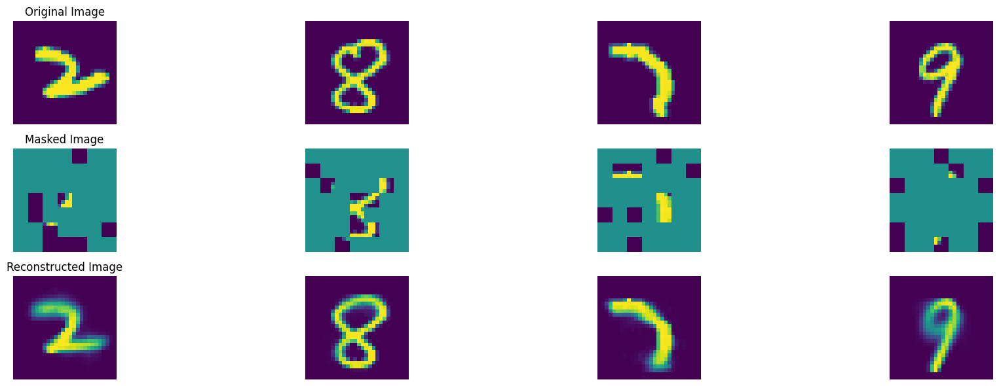

100%|██████████| 47/47 [00:08<00:00,  5.45it/s]


In epoch 994, average traning loss is 0.08782699038373663.
=================== EPOCH:  995  ===================


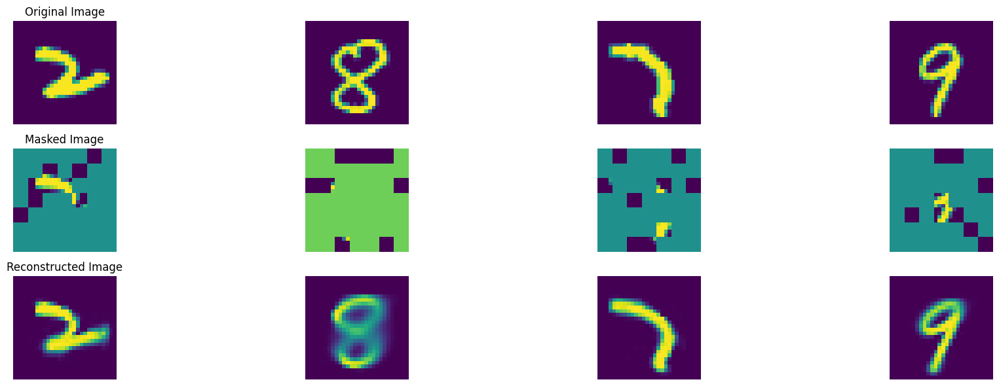

100%|██████████| 47/47 [00:08<00:00,  5.43it/s]


In epoch 995, average traning loss is 0.0880239745403858.
=================== EPOCH:  996  ===================


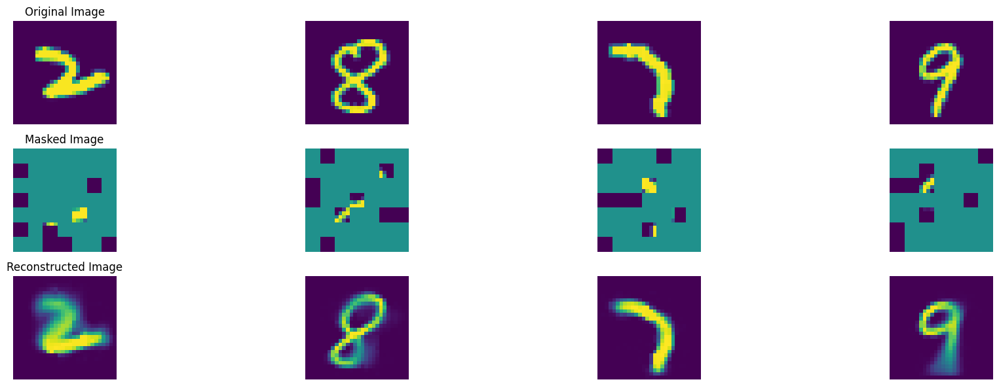

100%|██████████| 47/47 [00:08<00:00,  5.48it/s]


In epoch 996, average traning loss is 0.0872027189173597.
=================== EPOCH:  997  ===================


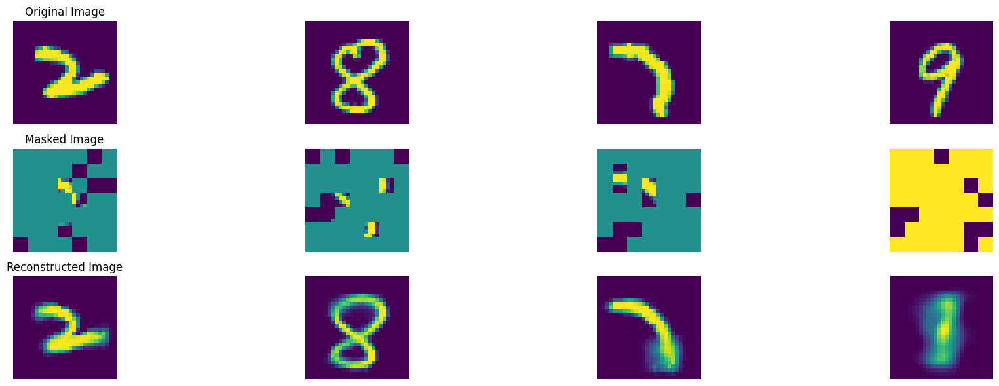

100%|██████████| 47/47 [00:08<00:00,  5.50it/s]


In epoch 997, average traning loss is 0.08750778912229741.
=================== EPOCH:  998  ===================


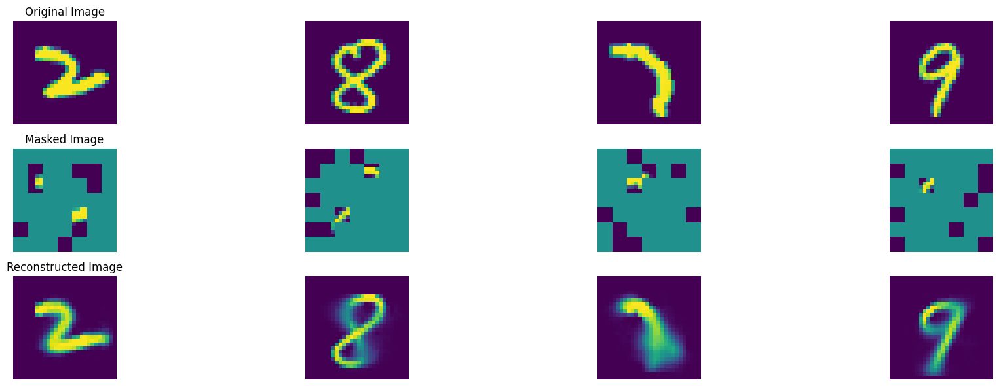

100%|██████████| 47/47 [00:08<00:00,  5.42it/s]


In epoch 998, average traning loss is 0.08739544086633845.
=================== EPOCH:  999  ===================


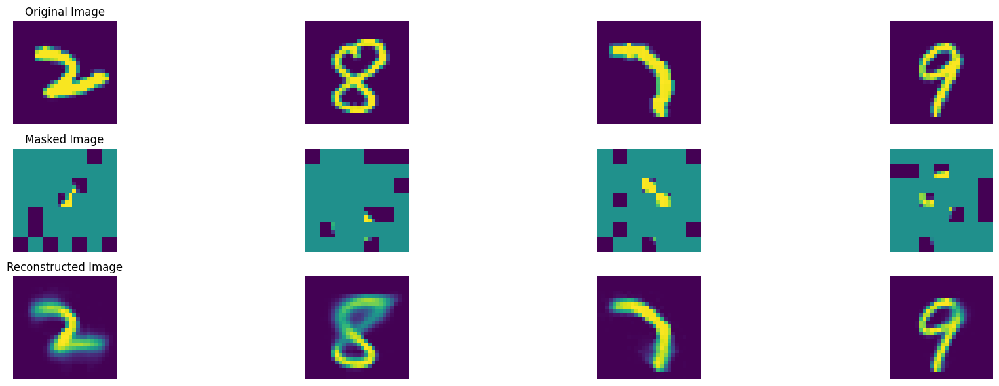

100%|██████████| 47/47 [00:08<00:00,  5.35it/s]


In epoch 999, average traning loss is 0.0876779984286491.
=================== EPOCH:  1000  ===================


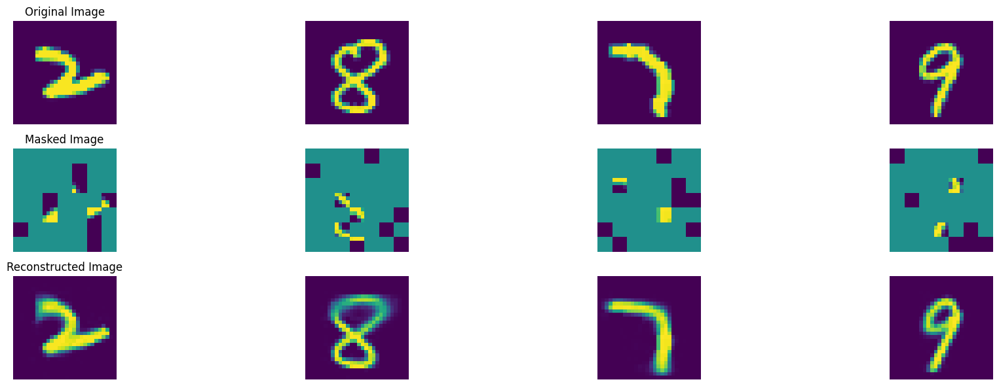

In [9]:
# GPU 6660MiB
import matplotlib.pyplot as plt
step_count = 0
optim.zero_grad()
for e in range(total_epoch):
    model.train()
    losses = []
    for img, label in tqdm(iter(dataloader)):
        step_count += 1
        img = img.to(device)
        predicted_img, mask = model(img)
        loss = torch.mean((predicted_img - img) ** 2 * mask) / mask_ratio
        loss.backward()
        if step_count % steps_per_update == 0:
            optim.step()
            optim.zero_grad()
        losses.append(loss.item())
    lr_scheduler.step()
    avg_loss = sum(losses) / len(losses)
    writer.add_scalar('mae_loss', avg_loss, global_step=e)
    print(f'In epoch {e}, average traning loss is {avg_loss}.')
    
    model.eval()
    with torch.no_grad():
        val_img = torch.stack([val_dataset[i][0] for i in range(16)])
        val_img = val_img.to(device)
        predicted_val_img, mask = model(val_img)
        predicted_val_img = predicted_val_img * mask + val_img * (1 - mask)
        img = torch.cat([val_img * (1 - mask), predicted_val_img, val_img], dim=0)
        img = rearrange(img, '(v h1 w1) c h w -> c (h1 h) (w1 v w)', w1=2, v=3)
        writer.add_image('mae_image', (img + 1) / 2, global_step=e)

        # Inside the visualization block, apply denormalization before displaying
        fig, axes = plt.subplots(3, 4, figsize=(20, 6))
        print("=================== EPOCH: ", e+1, " ===================")
        for i in range(4):
            # Denormalize and clip to [0, 1] for safe visualization
            original_img = denormalize(val_img[i]).clamp(0, 1)
            masked_img = denormalize(val_img[i] * (1 - mask[i])).clamp(0, 1)
            reconstructed_img = denormalize(predicted_val_img[i]).clamp(0, 1)
        
            # Original Image
            axes[0, i].imshow(original_img.permute(1, 2, 0).cpu().numpy())
            axes[0, i].axis('off')
            if i == 0:
                axes[0, i].set_title("Original Image")
        
            # Masked Image
            axes[1, i].imshow(masked_img.permute(1, 2, 0).cpu().numpy())
            axes[1, i].axis('off')
            if i == 0:
                axes[1, i].set_title("Masked Image")
        
            # Reconstructed Image
            axes[2, i].imshow(reconstructed_img.permute(1, 2, 0).cpu().numpy())
            axes[2, i].axis('off')
            if i == 0:
                axes[2, i].set_title("Reconstructed Image")
        plt.tight_layout()
        plt.show()
        
    ''' save model '''
    torch.save(model.state_dict(), model_path)

### Exercises
1) With MNIST dataset, experiment with different patch_sizes, masking ratio on the reconstruction part. Describe what you have learnt

Here is my best results, see if you can beat me

The original images
<img src="img/MAE_original.png" title="MAE - Original" style="width: 1080px;" />

My reconstructed images
<img src="img/MAE_recon.png" title="MAE - recon" style="width: 1080px;" />

2) Now since we have trained our MAE. Let's make use of it!

Once the autoencoder is trained, the learned encoder can be repurposed for downstream tasks like image classification.

**How It Works:**

Encoder Extraction: After pretraining, the encoder is detached from the decoder and fine-tuned for classification.

Class Token Addition: A classification token (CLS) is added to the input patch sequence. This token interacts with other patches during encoding and aggregates the final representation.

Linear Classifier: A linear classifier (MLP head) is attached on top of the encoder to map the latent representation to class labels.

With MNIST dataset, train a classifier (Part2)and report results. (Classifier class is already given below)


## Transition to a downstream task

In [8]:
class ViT_Classifier(torch.nn.Module):
    def __init__(self, encoder : MAE_Encoder, num_classes=10) -> None:
        super().__init__()
        self.cls_token = encoder.cls_token
        self.pos_embedding = encoder.pos_embedding
        self.patchify = encoder.patchify
        self.transformer = encoder.transformer
        self.layer_norm = encoder.layer_norm
        self.head = torch.nn.Linear(self.pos_embedding.shape[-1], num_classes)

    def forward(self, img):
        patches = self.patchify(img)
        patches = rearrange(patches, 'b c h w -> (h w) b c')
        patches = patches + self.pos_embedding
        patches = torch.cat([self.cls_token.expand(-1, patches.shape[1], -1), patches], dim=0)
        patches = rearrange(patches, 't b c -> b t c')
        features = self.layer_norm(self.transformer(patches))
        features = rearrange(features, 'b t c -> t b c')
        logits = self.head(features[0])
        return logits

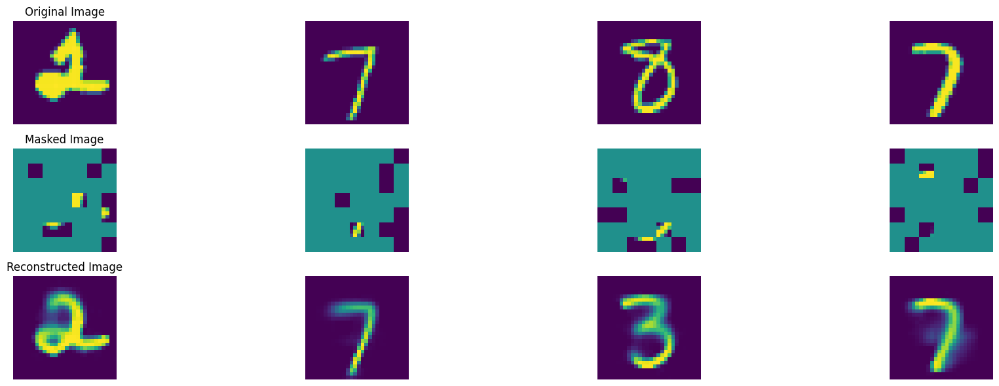

In [20]:
import matplotlib.pyplot as plt

mask_ratio = 0.8
model_pretrained = MAE_ViT(image_size = 28, patch_size = 4, mask_ratio=mask_ratio)
model_path = 'saved/vit-t-mae-mnist-lab_Tue Feb 25 04:35:03 2025.pt'
state_dict = torch.load(model_path, map_location=torch.device('cuda:2'))
model_pretrained.load_state_dict(state_dict)
model_pretrained.to('cuda:2')

model_pretrained.eval()
with torch.no_grad():
    val_img = torch.stack([val_dataset[i][0] for i in range(16)])
    val_img = val_img.to(device)
    predicted_val_img, mask = model_pretrained(val_img)
    predicted_val_img = predicted_val_img * mask + val_img * (1 - mask)
    img = torch.cat([val_img * (1 - mask), predicted_val_img, val_img], dim=0)
    img = rearrange(img, '(v h1 w1) c h w -> c (h1 h) (w1 v w)', w1=2, v=3)
    # writer.add_image('mae_image', (img + 1) / 2, global_step=e)

    # Inside the visualization block, apply denormalization before displaying
    fig, axes = plt.subplots(3, 4, figsize=(20, 6))
    for i in range(4):
        # Denormalize and clip to [0, 1] for safe visualization
        original_img = denormalize(val_img[i]).clamp(0, 1)
        masked_img = denormalize(val_img[i] * (1 - mask[i])).clamp(0, 1)
        reconstructed_img = denormalize(predicted_val_img[i]).clamp(0, 1)
    
        # Original Image
        axes[0, i].imshow(original_img.permute(1, 2, 0).cpu().numpy())
        axes[0, i].axis('off')
        if i == 0:
            axes[0, i].set_title("Original Image")
    
        # Masked Image
        axes[1, i].imshow(masked_img.permute(1, 2, 0).cpu().numpy())
        axes[1, i].axis('off')
        if i == 0:
            axes[1, i].set_title("Masked Image")
    
        # Reconstructed Image
        axes[2, i].imshow(reconstructed_img.permute(1, 2, 0).cpu().numpy())
        axes[2, i].axis('off')
        if i == 0:
            axes[2, i].set_title("Reconstructed Image")
    plt.tight_layout()
    plt.show()

In [22]:
# MNIST transfering to classification
# ----------------------------
# 1. Set Up Data Loaders
# ----------------------------
batch_size = 64
device = 'cuda:2' if torch.cuda.is_available() else 'cpu'

# Define transforms
transform = Compose([ToTensor(), Normalize(0.5, 0.5)])

# Load MNIST dataset
dataset = torchvision.datasets.MNIST('data', train=True, download=True, transform=transform)
test_dataset = torchvision.datasets.MNIST('data', train=False, download=True, transform=transform)

# Split dataset
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# Create data loaders
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=load_batch_size, shuffle=True, num_workers=4)
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=load_batch_size, shuffle=False, num_workers=4)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=load_batch_size, shuffle=False, num_workers=4)

# ----------------------------
# 2. Initialize Model
# ----------------------------
num_classes = 10
model = ViT_Classifier(model_pretrained.encoder, num_classes=num_classes).to(device)

# ----------------------------
# 3. Loss Function & Optimizer
# ----------------------------
criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-3, betas=(0.9, 0.95), weight_decay=0.05)

# Learning rate scheduler
total_epochs = 20
warmup_epochs = 5
lr_lambda = lambda epoch: min((epoch + 1) / (warmup_epochs + 1e-8), 0.5 * (math.cos(epoch / total_epochs * math.pi) + 1))
lr_scheduler = torch.optim.lr_scheduler.LambdaLR(optimizer, lr_lambda=lr_lambda)

# ----------------------------
# 4. Set Up TensorBoard
# ----------------------------
writer = SummaryWriter(os.path.join('logs', 'mnist', 'vit-classification'))

# ----------------------------
# 5. Training Loop
# ----------------------------
def train_model(model, train_loader, val_loader, epochs):
    for epoch in range(epochs):
        model.train()
        total_loss, correct, total_samples = 0, 0, 0

        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(images)

            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            total_loss += loss.item()
            correct += (outputs.argmax(1) == labels).sum().item()
            total_samples += labels.size(0)

        train_accuracy = correct / total_samples
        writer.add_scalar("Loss/train", total_loss / len(train_loader), epoch)
        writer.add_scalar("Accuracy/train", train_accuracy, epoch)

        # Validation
        model.eval()
        val_correct, val_samples = 0, 0
        with torch.no_grad():
            for images, labels in val_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                val_correct += (outputs.argmax(1) == labels).sum().item()
                val_samples += labels.size(0)

        val_accuracy = val_correct / val_samples
        writer.add_scalar("Accuracy/val", val_accuracy, epoch)

        lr_scheduler.step()
        print(f"Epoch {epoch+1}/{epochs} - Loss: {total_loss/len(train_loader):.4f}, Train Acc: {train_accuracy:.4f}, Val Acc: {val_accuracy:.4f}")

    writer.close()

# ----------------------------
# 6. Run Training
# ----------------------------
train_model(model, train_loader, val_loader, total_epochs)

# ----------------------------
# 7. Test Model
# ----------------------------
def test_model(model, test_loader):
    model.eval()
    correct, total = 0, 0
    with torch.no_grad():
        for images, labels in test_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            correct += (outputs.argmax(1) == labels).sum().item()
            total += labels.size(0)

    print(f"Test Accuracy: {correct / total:.4f}")

test_model(model, test_loader)

Epoch 1/20 - Loss: 0.4388, Train Acc: 0.9464, Val Acc: 0.9892
Epoch 2/20 - Loss: 0.0568, Train Acc: 0.9920, Val Acc: 0.9886
Epoch 3/20 - Loss: 0.0357, Train Acc: 0.9926, Val Acc: 0.9867
Epoch 4/20 - Loss: 0.0310, Train Acc: 0.9918, Val Acc: 0.9842
Epoch 5/20 - Loss: 0.0316, Train Acc: 0.9913, Val Acc: 0.9879
Epoch 6/20 - Loss: 0.0231, Train Acc: 0.9933, Val Acc: 0.9868
Epoch 7/20 - Loss: 0.0206, Train Acc: 0.9938, Val Acc: 0.9875
Epoch 8/20 - Loss: 0.0143, Train Acc: 0.9957, Val Acc: 0.9886
Epoch 9/20 - Loss: 0.0134, Train Acc: 0.9960, Val Acc: 0.9897
Epoch 10/20 - Loss: 0.0102, Train Acc: 0.9971, Val Acc: 0.9910
Epoch 11/20 - Loss: 0.0058, Train Acc: 0.9982, Val Acc: 0.9908
Epoch 12/20 - Loss: 0.0049, Train Acc: 0.9985, Val Acc: 0.9900
Epoch 13/20 - Loss: 0.0030, Train Acc: 0.9991, Val Acc: 0.9918
Epoch 14/20 - Loss: 0.0020, Train Acc: 0.9994, Val Acc: 0.9909
Epoch 15/20 - Loss: 0.0013, Train Acc: 0.9997, Val Acc: 0.9908
Epoch 16/20 - Loss: 0.0008, Train Acc: 0.9997, Val Acc: 0.9921
E

In [23]:
model_path = f'./saved/mae_mnist_classification.pt'
torch.save(model.state_dict(), model_path)

3) Experiment with a different dataset, CIFAR-10. Discuss the similarity and differences of the results of both datasets. Suggest possible improvements you could potentially make to CIFAR-10 in the future.

### The report
Describe your experiments and their results. The report should be turned in on Teal Classroom before the deadline.

In [31]:
import matplotlib.pyplot as plt

mask_ratio = 0.8
model_pretrained = MAE_ViT(image_size = 28, patch_size = 4, mask_ratio=mask_ratio)
model_path = 'saved/vit-t-mae-mnist-lab_Tue Feb 25 04:35:03 2025.pt'
state_dict = torch.load(model_path, map_location=torch.device('cuda:2'))
model_pretrained.load_state_dict(state_dict)
model_pretrained.to('cuda:2')

model_pretrained.eval()

MAE_ViT(
  (encoder): MAE_Encoder(
    (shuffle): PatchShuffle()
    (patchify): Conv2d(1, 192, kernel_size=(4, 4), stride=(4, 4))
    (transformer): Sequential(
      (0): Block(
        (norm1): LayerNorm((192,), eps=1e-05, elementwise_affine=True)
        (attn): Attention(
          (qkv): Linear(in_features=192, out_features=576, bias=False)
          (q_norm): Identity()
          (k_norm): Identity()
          (attn_drop): Dropout(p=0.0, inplace=False)
          (proj): Linear(in_features=192, out_features=192, bias=True)
          (proj_drop): Dropout(p=0.0, inplace=False)
        )
        (ls1): Identity()
        (drop_path1): Identity()
        (norm2): LayerNorm((192,), eps=1e-05, elementwise_affine=True)
        (mlp): Mlp(
          (fc1): Linear(in_features=192, out_features=768, bias=True)
          (act): GELU(approximate='none')
          (drop1): Dropout(p=0.0, inplace=False)
          (norm): Identity()
          (fc2): Linear(in_features=768, out_features=192, bia

In [32]:
# ----------------------------
# 1. Set Up Data Loaders
# ----------------------------
batch_size = 64
device = 'cuda:2' if torch.cuda.is_available() else 'cpu'

# Define transforms
transform = Compose([
    # Resize((28, 28)),  # Ensure input shape is 28x28
    ToTensor(),
    Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

# Load CIFAR-10 dataset
dataset = torchvision.datasets.CIFAR10('data', train=True, download=True, transform=transform)
test_dataset = torchvision.datasets.CIFAR10('data', train=False, download=True, transform=transform)

# Split dataset
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# Create data loaders
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4)

# ----------------------------
# 2. Update Encoder for CIFAR-10 Classification
# ----------------------------
class ViT_Classifier(torch.nn.Module):
    def __init__(self, encoder: MAE_Encoder, num_classes=10, image_size=32, emb_dim=192, patch_size=4) -> None:
        super().__init__()
        self.cls_token = encoder.cls_token

        self.pos_embedding = torch.nn.Parameter(torch.zeros((image_size // patch_size) ** 2, 1, emb_dim))
        self.patchify = torch.nn.Conv2d(3, emb_dim, patch_size, patch_size)
        
        # self.pos_embedding = encoder.pos_embedding
        # self.patchify = encoder.patchify
        self.transformer = encoder.transformer
        self.layer_norm = encoder.layer_norm
        self.head = torch.nn.Linear(self.pos_embedding.shape[-1], num_classes)

    def forward(self, img):
        patches = self.patchify(img)
        patches = rearrange(patches, 'b c h w -> (h w) b c')
        patches = patches + self.pos_embedding
        patches = torch.cat([self.cls_token.expand(-1, patches.shape[1], -1), patches], dim=0)
        patches = rearrange(patches, 't b c -> b t c')
        features = self.layer_norm(self.transformer(patches))
        features = rearrange(features, 'b t c -> t b c')
        logits = self.head(features[0])
        return logits

# ----------------------------
# 3. Initialize Model
# ----------------------------
num_classes = 10
model = ViT_Classifier(model_pretrained.encoder, num_classes=num_classes).to(device)

# ----------------------------
# 4. Loss Function & Optimizer
# ----------------------------
criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-3, betas=(0.9, 0.95), weight_decay=0.05)

# Learning rate scheduler
total_epochs = 20
warmup_epochs = 5
lr_lambda = lambda epoch: min((epoch + 1) / (warmup_epochs + 1e-8), 0.5 * (math.cos(epoch / total_epochs * math.pi) + 1))
lr_scheduler = torch.optim.lr_scheduler.LambdaLR(optimizer, lr_lambda=lr_lambda)

# ----------------------------
# 5. Set Up TensorBoard
# ----------------------------
writer = SummaryWriter(os.path.join('logs', 'cifar10', 'vit-classification_cifar10'))

# ----------------------------
# 6. Training Loop
# ----------------------------
def train_model(model, train_loader, val_loader, epochs):
    for epoch in range(epochs):
        model.train()
        total_loss, correct, total_samples = 0, 0, 0

        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(images)

            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            total_loss += loss.item()
            correct += (outputs.argmax(1) == labels).sum().item()
            total_samples += labels.size(0)

        train_accuracy = correct / total_samples
        writer.add_scalar("Loss/train", total_loss / len(train_loader), epoch)
        writer.add_scalar("Accuracy/train", train_accuracy, epoch)

        # Validation
        model.eval()
        val_correct, val_samples = 0, 0
        with torch.no_grad():
            for images, labels in val_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                val_correct += (outputs.argmax(1) == labels).sum().item()
                val_samples += labels.size(0)

        val_accuracy = val_correct / val_samples
        writer.add_scalar("Accuracy/val", val_accuracy, epoch)

        lr_scheduler.step()
        print(f"Epoch {epoch+1}/{epochs} - Loss: {total_loss/len(train_loader):.4f}, Train Acc: {train_accuracy:.4f}, Val Acc: {val_accuracy:.4f}")

    writer.close()

# ----------------------------
# 7. Run Training
# ----------------------------
train_model(model, train_loader, val_loader, total_epochs)

# ----------------------------
# 8. Test Model
# ----------------------------
def test_model(model, test_loader):
    model.eval()
    correct, total = 0, 0
    with torch.no_grad():
        for images, labels in test_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            correct += (outputs.argmax(1) == labels).sum().item()
            total += labels.size(0)

    print(f"Test Accuracy: {correct / total:.4f}")

test_model(model, test_loader)

Epoch 1/20 - Loss: 1.5792, Train Acc: 0.4204, Val Acc: 0.5233
Epoch 2/20 - Loss: 1.2658, Train Acc: 0.5440, Val Acc: 0.5921
Epoch 3/20 - Loss: 1.1338, Train Acc: 0.5955, Val Acc: 0.6190
Epoch 4/20 - Loss: 1.0373, Train Acc: 0.6267, Val Acc: 0.6114
Epoch 5/20 - Loss: 0.9517, Train Acc: 0.6585, Val Acc: 0.6448
Epoch 6/20 - Loss: 0.8343, Train Acc: 0.7046, Val Acc: 0.6860
Epoch 7/20 - Loss: 0.7368, Train Acc: 0.7381, Val Acc: 0.6937
Epoch 8/20 - Loss: 0.6392, Train Acc: 0.7725, Val Acc: 0.7146
Epoch 9/20 - Loss: 0.5416, Train Acc: 0.8099, Val Acc: 0.7246
Epoch 10/20 - Loss: 0.4399, Train Acc: 0.8460, Val Acc: 0.7226
Epoch 11/20 - Loss: 0.3329, Train Acc: 0.8813, Val Acc: 0.7204
Epoch 12/20 - Loss: 0.2433, Train Acc: 0.9145, Val Acc: 0.7369
Epoch 13/20 - Loss: 0.1587, Train Acc: 0.9445, Val Acc: 0.7266
Epoch 14/20 - Loss: 0.0940, Train Acc: 0.9685, Val Acc: 0.7363
Epoch 15/20 - Loss: 0.0508, Train Acc: 0.9836, Val Acc: 0.7350
Epoch 16/20 - Loss: 0.0243, Train Acc: 0.9928, Val Acc: 0.7424
E

Test Accuracy: 0.7656


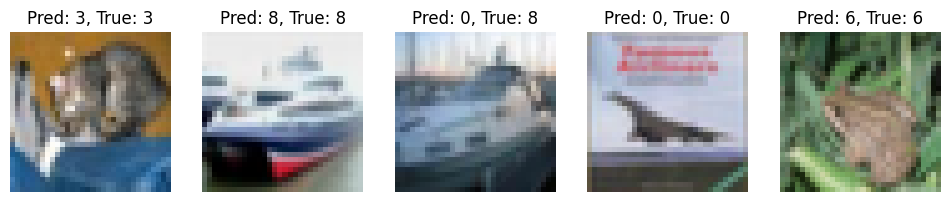

In [33]:
def test_model(model, test_loader):
    model.eval()
    correct, total = 0, 0
    images_batch, labels_batch = next(iter(test_loader))
    images_batch, labels_batch = images_batch.to(device), labels_batch.to(device)
    with torch.no_grad():
        outputs = model(images_batch)
        predictions = outputs.argmax(1)
        correct += (predictions == labels_batch).sum().item()
        total += labels_batch.size(0)

    print(f"Test Accuracy: {correct / total:.4f}")
    
    # Visualization
    fig, axes = plt.subplots(1, 5, figsize=(12, 3))
    for i in range(5):
        ax = axes[i]
        img = images_batch[i].cpu().permute(1, 2, 0) * 0.5 + 0.5  # Unnormalize
        ax.imshow(img.numpy())
        ax.set_title(f"Pred: {predictions[i].item()}, True: {labels_batch[i].item()}")
        ax.axis('off')
    plt.show()

test_model(model, test_loader)

### **Experiment Report: MNIST and CIFAR-10 Classification using ViT**
This report details the experiments conducted on MNIST and CIFAR-10 classification using a Vision Transformer (ViT) architecture. Initially, the model was trained on MNIST, achieving high accuracy. Subsequently, transfer learning was applied to CIFAR-10 by modifying the input structure, resulting in a significant drop in performance. Various optimizations are suggested to improve the CIFAR-10 results.

---

### **Experimental Setup**

#### **Model Architecture**
The ViT model consists of:
- **Patch Embedding Layer**: Converts input images into patches.
- **Transformer Encoder**: A stack of self-attention layers.
- **Classification Head**: A linear layer mapping embeddings to class logits.

Initially, the model was trained on MNIST with **image size = 28x28, patch size = 2**. Then I played with patch_size and changed it to be 4. Later, it was adapted to CIFAR-10 with **image size = 32x32, patch size = 4**.

#### **Training Details**
- **Optimizer**: AdamW (learning rate = 1e-3, weight decay = 0.05).
- **Loss Function**: Cross-Entropy Loss.
- **Scheduler**: Cosine Annealing with Warmup.
- **Batch Size**: 64.
- **Training Epochs**: 20.

---

### **Results and Observations**

#### **MNIST Results**
| Epoch | Loss  | Train Accuracy | Val Accuracy |
|-------|-------|----------------|--------------|
| 1     | 0.4388 | 94.64%         | 98.92%       |
| 5     | 0.0316 | 99.13%         | 98.79%       |
| 10    | 0.0102 | 99.71%         | 99.10%       |
| 15    | 0.0013 | 99.97%         | 99.08%       |
| 20    | 0.0001 | 100.00%        | 99.22%       |

**Test Accuracy: 99.27%**

**Key Takeaways:**
- The model achieved near-perfect accuracy on MNIST.
- Minimal overfitting was observed due to the simplicity of the dataset.

---

#### **CIFAR-10 Results**
| Epoch | Loss  | Train Accuracy | Val Accuracy |
|-------|-------|----------------|--------------|
| 1     | 1.5792 | 42.04%         | 52.33%       |
| 5     | 0.9517 | 65.85%         | 64.48%       |
| 10    | 0.4399 | 84.60%         | 72.26%       |
| 15    | 0.0508 | 98.36%         | 73.50%       |
| 20    | 0.0003 | 100.00%        | 75.10%       |

**Test Accuracy: 75.12%**

**Key Observations:**
- Significant overfitting: Training accuracy reached **100%**, while validation accuracy stagnated at **~75%**.
- CIFAR-10 is more complex than MNIST, requiring a different training approach.
- Modifications such as changing patch size and initializing new positional embeddings led to a performance drop.

---

### Conclusion

- MNIST Training: The ViT model successfully achieved high accuracy with minimal overfitting.
- CIFAR-10 Training: The model overfits due to dataset complexity and changes in patch representation.

### Final Thoughts
This experiment demonstrates how Vision Transformers excel on simpler datasets like MNIST but require careful tuning to generalize well to more complex datasets like CIFAR-10. Future improvements could push performance beyond 75%, making ViTs competitive for small-scale image classification tasks.
